In [1]:
import xml.etree.ElementTree
import os,glob,sys
import pandas as pd
from sklearn.decomposition import PCA
import pylab as plt
import seaborn as sns
import numpy as np

%load_ext autoreload
%autoreload 2

sys.path.append("..")
from mzmine import pick_peaks, align, match_aligned_to_original, load_aligned_peaks


In [2]:
MZMINE_COMMAND = '/Users/anamaria/Documents/git/MZmine-2.40.1/startMZmine_MacOSX.command'

In [3]:
MNET_PATH = '/Users/anamaria/Documents/git/molnet/code/'

## Peak detection using MZmine

At the moment, this part is performed directly in MZmine.

In [4]:
#for patients
# Directory holding mzml files of interest
input_dir = '/Volumes/Transcend/Metabolomics_datasets/Zika/Positive/Control'
# grab the list -- in this case all the T10 mzML files
file_list = glob.glob(os.path.join(input_dir,'**.mzXML'))

# # Directory to store all output
output_dir = '/Volumes/Transcend/Metabolomics_datasets/Zika/mzmine'

In [5]:
from mzmine import pick_peaks
pick_peaks(file_list,output_dir=output_dir, xml_template = '/Users/anamaria/Desktop/mzmine/peak_picking_to_mztab_csv.xml', mzmine_command=MZMINE_COMMAND)

## Alignment

In [7]:
allfiles = '/Users/anamaria/Desktop/mzmine/221119/samples_alignment_without_preprocessing/'
xml_template ='/Users/anamaria/Documents/git/pymzmine/batch_files/align_from_mztab.xml'

align(allfiles, xml_template = xml_template, mzmine_command = MZMINE_COMMAND, rt_window = 0.5)


['/Users/anamaria/Desktop/mzmine/221119/samples_alignment_without_preprocessing/ZIK10_pp.mzTab', '/Users/anamaria/Desktop/mzmine/221119/samples_alignment_without_preprocessing/ZIK7_pp.mzTab', '/Users/anamaria/Desktop/mzmine/221119/samples_alignment_without_preprocessing/ZIK6_pp.mzTab', '/Users/anamaria/Desktop/mzmine/221119/samples_alignment_without_preprocessing/C7_2_pp.mzTab', '/Users/anamaria/Desktop/mzmine/221119/samples_alignment_without_preprocessing/C10_2_pp.mzTab', '/Users/anamaria/Desktop/mzmine/221119/samples_alignment_without_preprocessing/VL7_pp.mzTab', '/Users/anamaria/Desktop/mzmine/221119/samples_alignment_without_preprocessing/C1_pp.mzTab', '/Users/anamaria/Desktop/mzmine/221119/samples_alignment_without_preprocessing/KM_10_pp.mzTab', '/Users/anamaria/Desktop/mzmine/221119/samples_alignment_without_preprocessing/KM_11_pp.mzTab', '/Users/anamaria/Desktop/mzmine/221119/samples_alignment_without_preprocessing/KM_9_pp.mzTab', '/Users/anamaria/Desktop/mzmine/221119/samples_a

If files already aligned.

In [8]:
all_df = pd.read_csv('/Users/anamaria/Desktop/mzmine/221119/samples_alignment_without_preprocessing/pp_aligned.csv', index_col=0)
feature_description = all_df.iloc[:,:2]
all_samples = all_df.iloc[:,2:-1]
all_samples.columns = [x.split(" ")[0] for x in list(all_samples.columns)]

In [9]:
condition = []
dataset = []
for name in np.array(all_samples.columns):
    value = name.split('.')[0].split('_')[0][0]
    value2 = name.split('.')[0].split('_')[0][0]
    
    if (value == 'C' and len(name.split('.')[0].split('_')) == 2 and name.split('.')[0].split('_')[1] == '2'):
        condition.append('control')
        dataset.append('VL')
    elif  (value == 'C'):   
        condition.append('control')
        dataset.append('Zika')
    elif (value == 'Z'):
        condition.append('infected')
        dataset.append('Zika')
    elif (value[0] == 'V'):
        condition.append('infected')
        dataset.append('VL')
        
    elif (value == 'K' and int(name.split('.')[0].split('_')[1])%3 == 1 ):
        condition.append('control')
        dataset.append('Malaria')
    else:
        condition.append('infected')
        dataset.append('Malaria')
        

In [10]:
sample_description = pd.DataFrame(data=[list(all_samples.columns),condition,dataset] )
sample_description = sample_description.transpose()
sample_description.columns = ['Sample Name', 'Condition', 'Dataset']
sample_description["ConditionDataset"] = sample_description["Condition"]+sample_description["Dataset"]

In [82]:
all_samples_log = np.log2(all_samples+1)

In [83]:
len(all_samples_log)

38197

In [84]:
all_samples_log

,ZIK6.mzXML,ZIK10.mzXML,ZIK7.mzXML,C7_2.mzXML,C1.mzXML,KM_10.mzXML,C10_2.mzXML,VL7.mzXML,KM_11.mzXML,KM_9.mzXML,...,C4_2.mzXML,C13_2.mzXML,KM_7.mzXML,C10.mzXML,KM_6.mzXML,VL13.mzXML,C9_2.mzXML,VL12.mzXML,VL19.mzXML,VL18.mzXML
row ID,,,,,,,,,,,,,,,,,,,,,
1,24.770584,24.976324,24.554527,0.000000,24.313839,24.034782,0.000000,0.000000,23.742537,23.717935,...,0.000000,0.000000,24.066574,24.852681,24.185432,19.679291,0.000000,0.000000,0.000000,0.000000
2,21.139783,20.126250,20.080888,0.000000,21.221154,0.000000,0.000000,0.000000,19.012199,19.003391,...,0.000000,0.000000,18.071586,20.972182,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
3,18.721152,18.052387,0.000000,18.276002,19.201274,18.607040,16.997642,18.773472,19.014408,18.400118,...,17.180884,19.472957,18.442055,19.694221,18.541040,16.697166,18.153269,16.868158,19.067775,0.000000
4,19.555428,19.952683,19.838900,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,19.920609,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,20.532139,20.583330,20.232179,0.000000,0.000000,19.746629,0.000000,0.000000,19.385975,19.701582,...,0.000000,0.000000,19.260501,18.803943,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,24.585562,25.154208,24.663895,0.000000,24.866218,23.938543,0.000000,0.000000,23.978617,23.991582,...,0.000000,0.000000,23.657217,25.137707,24.150456,0.000000,0.000000,0.000000,0.000000,0.000000
7,17.648891,0.000000,0.000000,18.749839,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,18.712239,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
8,17.750494,0.000000,17.403738,0.000000,0.000000,0.000000,18.349517,0.000000,0.000000,0.000000,...,20.063964,0.000000,0.000000,18.005558,0.000000,19.667811,0.000000,0.000000,0.000000,0.000000
9,19.307789,20.388158,19.831240,0.000000,20.198539,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,20.606755,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [13]:
#DENSITY PLOTS
def plot_density(all_samples):
    # List of five airlines to plot
    datasets = ['Zika', 'Malaria', 'VL']
    colors = ['r','b','g']
    # Iterate through the five airlines
    for dataset, color in zip(datasets, colors):
        # Subset to the airline

        subset = all_samples.transpose()[np.array(sample_description['Dataset'] == dataset)].transpose()
        colordataset= color
        # Draw the density plot
        for col in list(subset.columns):
            sns.distplot(subset[col] ,hist = False, kde = True, color = colordataset,
                     kde_kws = {'linewidth': 3, "alpha":0.2})
   
    # Plot formatting
    plt.xlabel('Intensity')
    plt.legend(all_samples.columns)
    

In [20]:
sample_description["ConditionDataset"] 

0        infectedZika
1        infectedZika
2        infectedZika
3           controlVL
4         controlZika
5      controlMalaria
6           controlVL
7          infectedVL
8     infectedMalaria
9     infectedMalaria
10    infectedMalaria
11          controlVL
12    infectedMalaria
13    infectedMalaria
14          controlVL
15         infectedVL
16         infectedVL
17          controlVL
18          controlVL
19     controlMalaria
20    infectedMalaria
21          controlVL
22         infectedVL
23         infectedVL
24         infectedVL
25       infectedZika
26        controlZika
27          controlVL
28          controlVL
29    infectedMalaria
           ...       
46    infectedMalaria
47       infectedZika
48       infectedZika
49         infectedVL
50         infectedVL
51        controlZika
52        controlZika
53       infectedZika
54       infectedZika
55         infectedVL
56         infectedVL
57    infectedMalaria
58    infectedMalaria
59    infectedMalaria
60    infe

In [14]:
#all_samples_condition = all_samples_log
#all_samples_condition.columns = list(sample_description["ConditionDataset"])

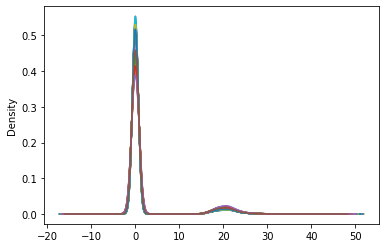

In [15]:
all_samples_condition.plot.density(legend = False)

In [86]:
# rearranging the dataframe
Zik = all_samples_log.transpose()[np.array(sample_description['Dataset'] == 'Zika')].transpose()
zik_con = Zik.transpose()[np.array(sample_description[sample_description["Dataset"] == "Zika"]['Condition'] =="control")].transpose()
zik_inf = Zik.transpose()[np.array(sample_description[sample_description["Dataset"] == "Zika"]['Condition'] =="infected")].transpose()
Mal = all_samples_log.transpose()[np.array(sample_description['Dataset'] == 'Malaria')].transpose()
mal_con = Mal.transpose()[np.array(sample_description[sample_description["Dataset"] == "Malaria"]['Condition'] =="control")].transpose()
mal_inf = Mal.transpose()[np.array(sample_description[sample_description["Dataset"] == "Malaria"]['Condition'] =="infected")].transpose()
vl = all_samples_log.transpose()[np.array(sample_description['Dataset'] == 'VL')].transpose()
vl_con = vl.transpose()[np.array(sample_description[sample_description["Dataset"] == "VL"]['Condition'] =="control")].transpose()
vl_inf = vl.transpose()[np.array(sample_description[sample_description["Dataset"] == "VL"]['Condition'] =="infected")].transpose()

In [90]:
pdList = [vl_inf,vl_con,zik_inf, zik_con, mal_inf,mal_con]  
all_samples_log_rearanged = pd.concat(pdList, axis = 1)

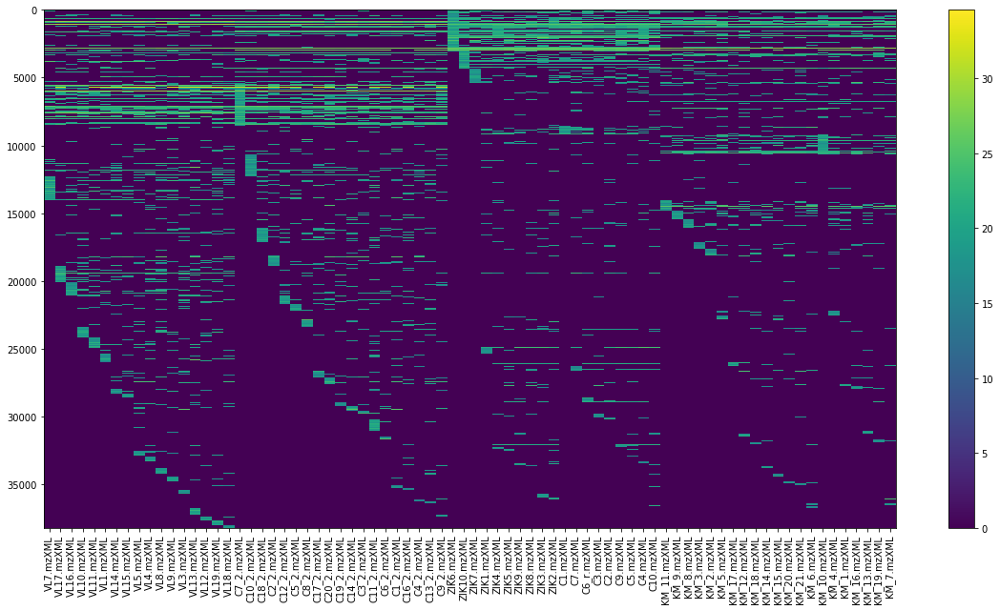

In [91]:
plt.figure(figsize=(20,10))
plt.imshow(all_samples_log_rearanged,aspect='auto')
plt.xticks(list(range(0,len(all_samples_log_rearanged.columns))), all_samples_log_rearanged.columns, rotation = 90)
plt.colorbar()
plt.show()


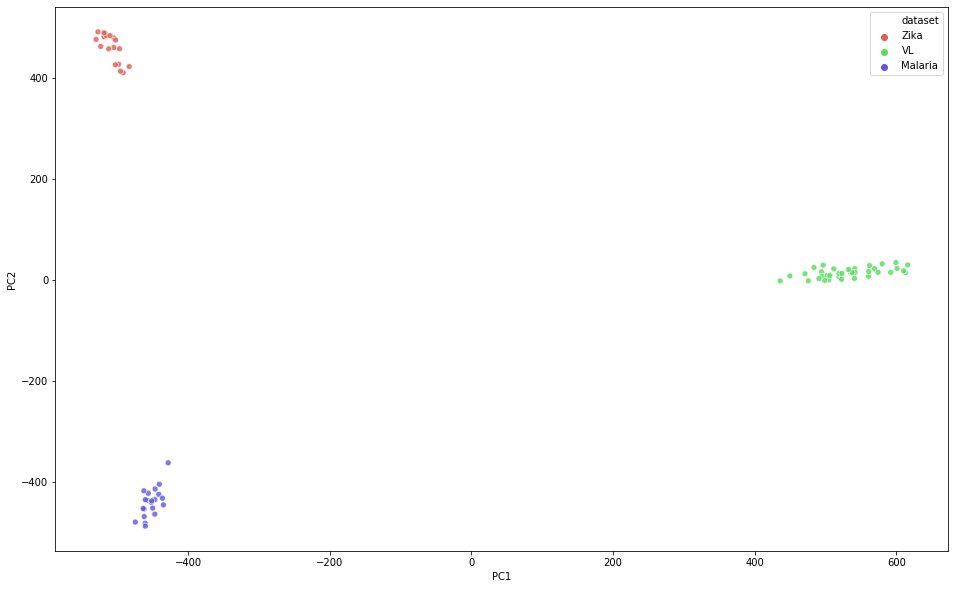

In [19]:
pca_samples = PCA(n_components=3)

principalComponents = pca_samples.fit_transform(all_samples_log.transpose())
principalComponents_df = pd.DataFrame(data = principalComponents, columns= ['PC1','PC2', 'PC3'])
principalComponents_df['condition'] = list(sample_description['Condition'])
principalComponents_df['dataset'] = list(sample_description['Dataset'])

plt.figure(figsize=(16,10))
sns.scatterplot(x="PC1", y="PC2",hue="dataset",
    palette=sns.color_palette("hls", 3),
    data=principalComponents_df,
    legend="full",
    alpha=0.8
)

Filter data, so that 50% of the peaks are not 0s.

In [28]:
def get_ids_for_50_percent(dataframe):
    idlist = []
    for rowid,row in dataframe.iterrows():
        total_zero = 0
        for i in range(len(row)):
            if row[i] == 0.0:
                total_zero += 1
                
        percentage = total_zero*100/len(row)
        print(rowid, percentage)
        if percentage <= 50:
            idlist.append(rowid)
            
    return np.array(idlist)

In [29]:
idzik = get_ids_for_50_percent(all_samples_log_rearanged[Zik.columns])


1 0.0
2 0.0
3 10.497237569060774
4 26.519337016574585
5 4.972375690607735
6 0.0
7 62.98342541436464
8 83.97790055248619
9 0.0
10 0.0
11 88.95027624309392
12 64.08839779005525
13 83.97790055248619
14 0.0
15 68.50828729281768
16 83.97790055248619
17 74.58563535911603
18 0.0
19 61.87845303867403
20 0.0
21 94.47513812154696
22 79.00552486187846
23 5.524861878453039
24 47.51381215469613
25 74.03314917127072
26 62.98342541436464
27 94.47513812154696
28 77.90055248618785
29 88.95027624309392
30 94.47513812154696
31 62.98342541436464
32 0.0
33 0.0
34 36.46408839779006
35 15.469613259668508
36 0.0
37 94.47513812154696
38 0.0
39 89.50276243093923
40 5.524861878453039
41 5.524861878453039
42 5.524861878453039
43 27.07182320441989
44 35.91160220994475
45 0.0
46 83.97790055248619
47 0.0
48 46.96132596685083
49 10.497237569060774
50 0.0
51 74.03314917127072
52 72.92817679558011
53 63.53591160220994
54 88.95027624309392
55 79.00552486187846
56 89.50276243093923
57 78.45303867403315
58 9.9447513812154

469 46.96132596685083
470 83.97790055248619
471 5.524861878453039
472 73.48066298342542
473 46.96132596685083
474 84.5303867403315
475 4.972375690607735
476 0.0
477 89.50276243093923
478 5.524861878453039
479 32.59668508287293
480 0.0
481 0.0
482 0.0
483 41.988950276243095
484 31.49171270718232
485 32.04419889502763
486 72.37569060773481
487 0.0
488 0.0
489 16.022099447513813
490 0.0
491 0.0
492 0.0
493 72.92817679558011
494 83.42541436464089
495 94.47513812154696
496 0.0
497 5.524861878453039
498 0.0
499 0.0
500 38.67403314917127
501 47.51381215469613
502 47.51381215469613
503 4.972375690607735
504 47.51381215469613
505 94.47513812154696
506 89.50276243093923
507 0.0
508 74.03314917127072
509 88.95027624309392
510 0.0
511 20.994475138121548
512 10.497237569060774
513 0.0
514 94.47513812154696
515 94.47513812154696
516 0.0
517 51.93370165745856
518 37.01657458563536
519 58.011049723756905
520 94.47513812154696
521 52.48618784530387
522 41.988950276243095
523 94.47513812154696
524 89.50

941 0.0
942 58.011049723756905
943 4.972375690607735
944 0.0
945 58.011049723756905
946 94.47513812154696
947 88.95027624309392
948 67.40331491712708
949 94.47513812154696
950 78.45303867403315
951 0.0
952 0.0
953 0.0
954 0.0
955 16.022099447513813
956 0.0
957 41.988950276243095
958 94.47513812154696
959 52.48618784530387
960 83.42541436464089
961 84.5303867403315
962 74.03314917127072
963 58.011049723756905
964 42.5414364640884
965 35.91160220994475
966 78.45303867403315
967 0.0
968 10.497237569060774
969 30.939226519337016
970 0.0
971 88.95027624309392
972 83.97790055248619
973 69.06077348066299
974 94.47513812154696
975 41.988950276243095
976 88.95027624309392
977 32.59668508287293
978 73.48066298342542
979 73.48066298342542
980 79.00552486187846
981 89.50276243093923
982 47.51381215469613
983 16.022099447513813
984 62.98342541436464
985 94.47513812154696
986 53.591160220994475
987 4.972375690607735
988 11.049723756906078
989 26.519337016574585
990 74.03314917127072
991 94.475138121

1368 58.56353591160221
1369 37.569060773480665
1370 16.574585635359117
1371 89.50276243093923
1372 0.0
1373 48.06629834254144
1374 83.42541436464089
1375 94.47513812154696
1376 0.0
1377 20.994475138121548
1378 79.55801104972376
1379 69.06077348066299
1380 0.0
1381 27.07182320441989
1382 4.972375690607735
1383 0.0
1384 88.95027624309392
1385 72.92817679558011
1386 26.519337016574585
1387 43.0939226519337
1388 0.0
1389 0.0
1390 32.59668508287293
1391 20.994475138121548
1392 0.0
1393 0.0
1394 16.022099447513813
1395 84.5303867403315
1396 73.48066298342542
1397 88.95027624309392
1398 42.5414364640884
1399 46.408839779005525
1400 63.53591160220994
1401 0.0
1402 73.48066298342542
1403 74.03314917127072
1404 94.47513812154696
1405 0.0
1406 0.0
1407 0.0
1408 4.972375690607735
1409 0.0
1410 72.92817679558011
1411 58.011049723756905
1412 94.47513812154696
1413 21.54696132596685
1414 0.0
1415 62.98342541436464
1416 0.0
1417 67.40331491712708
1418 0.0
1419 0.0
1420 0.0
1421 32.04419889502763
1422 

1787 0.0
1788 20.441988950276244
1789 48.06629834254144
1790 73.48066298342542
1791 0.0
1792 5.524861878453039
1793 31.49171270718232
1794 15.469613259668508
1795 89.50276243093923
1796 0.0
1797 26.519337016574585
1798 20.994475138121548
1799 79.00552486187846
1800 0.0
1801 94.47513812154696
1802 83.97790055248619
1803 20.994475138121548
1804 36.46408839779006
1805 57.4585635359116
1806 0.0
1807 0.0
1808 0.0
1809 0.0
1810 89.50276243093923
1811 0.0
1812 26.519337016574585
1813 26.519337016574585
1814 43.0939226519337
1815 83.97790055248619
1816 94.47513812154696
1817 0.0
1818 16.022099447513813
1819 5.524861878453039
1820 69.06077348066299
1821 0.0
1822 58.011049723756905
1823 11.049723756906078
1824 0.0
1825 21.54696132596685
1826 94.47513812154696
1827 62.98342541436464
1828 42.5414364640884
1829 46.96132596685083
1830 0.0
1831 0.0
1832 0.0
1833 0.0
1834 88.95027624309392
1835 94.47513812154696
1836 46.96132596685083
1837 0.0
1838 48.61878453038674
1839 0.0
1840 32.04419889502763
184

2225 0.0
2226 47.51381215469613
2227 16.022099447513813
2228 62.98342541436464
2229 46.408839779005525
2230 0.0
2231 88.95027624309392
2232 15.469613259668508
2233 20.441988950276244
2234 0.0
2235 0.0
2236 74.03314917127072
2237 0.0
2238 0.0
2239 15.469613259668508
2240 78.45303867403315
2241 0.0
2242 0.0
2243 57.4585635359116
2244 68.50828729281768
2245 79.55801104972376
2246 25.96685082872928
2247 0.0
2248 15.469613259668508
2249 41.43646408839779
2250 46.408839779005525
2251 83.97790055248619
2252 89.50276243093923
2253 88.95027624309392
2254 0.0
2255 58.011049723756905
2256 72.92817679558011
2257 88.95027624309392
2258 88.95027624309392
2259 20.994475138121548
2260 78.45303867403315
2261 79.00552486187846
2262 16.022099447513813
2263 0.0
2264 15.469613259668508
2265 25.96685082872928
2266 74.03314917127072
2267 73.48066298342542
2268 41.988950276243095
2269 0.0
2270 31.49171270718232
2271 5.524861878453039
2272 27.07182320441989
2273 4.972375690607735
2274 41.988950276243095
2275 9

2636 20.994475138121548
2637 78.45303867403315
2638 78.45303867403315
2639 16.574585635359117
2640 83.42541436464089
2641 0.0
2642 5.524861878453039
2643 0.0
2644 68.50828729281768
2645 57.4585635359116
2646 20.441988950276244
2647 15.469613259668508
2648 10.497237569060774
2649 15.469613259668508
2650 20.994475138121548
2651 25.96685082872928
2652 46.408839779005525
2653 57.4585635359116
2654 30.939226519337016
2655 0.0
2656 5.524861878453039
2657 5.524861878453039
2658 10.497237569060774
2659 26.519337016574585
2660 9.94475138121547
2661 36.46408839779006
2662 72.92817679558011
2663 72.92817679558011
2664 0.0
2665 0.0
2666 46.96132596685083
2667 0.0
2668 41.43646408839779
2669 0.0
2670 21.54696132596685
2671 46.96132596685083
2672 73.48066298342542
2673 0.0
2674 10.497237569060774
2675 10.497237569060774
2676 89.50276243093923
2677 5.524861878453039
2678 0.0
2679 0.0
2680 10.497237569060774
2681 26.519337016574585
2682 84.5303867403315
2683 94.47513812154696
2684 52.48618784530387
26

3075 16.574585635359117
3076 40.88397790055249
3077 15.469613259668508
3078 20.994475138121548
3079 57.4585635359116
3080 57.4585635359116
3081 77.90055248618785
3082 79.55801104972376
3083 5.524861878453039
3084 0.0
3085 88.95027624309392
3086 77.90055248618785
3087 10.497237569060774
3088 94.47513812154696
3089 26.519337016574585
3090 31.49171270718232
3091 94.47513812154696
3092 52.48618784530387
3093 41.988950276243095
3094 15.469613259668508
3095 79.55801104972376
3096 94.47513812154696
3097 73.48066298342542
3098 67.95580110497238
3099 89.50276243093923
3100 20.994475138121548
3101 41.43646408839779
3102 20.994475138121548
3103 25.96685082872928
3104 46.96132596685083
3105 51.93370165745856
3106 36.46408839779006
3107 67.95580110497238
3108 0.0
3109 0.0
3110 16.574585635359117
3111 53.03867403314917
3112 83.97790055248619
3113 89.50276243093923
3114 94.47513812154696
3115 88.95027624309392
3116 94.47513812154696
3117 94.47513812154696
3118 42.5414364640884
3119 94.47513812154696


3448 78.45303867403315
3449 84.5303867403315
3450 78.45303867403315
3451 78.45303867403315
3452 94.47513812154696
3453 73.48066298342542
3454 62.98342541436464
3455 94.47513812154696
3456 74.03314917127072
3457 94.47513812154696
3458 88.95027624309392
3459 78.45303867403315
3460 83.97790055248619
3461 16.574585635359117
3462 16.574585635359117
3463 25.96685082872928
3464 94.47513812154696
3465 89.50276243093923
3466 83.97790055248619
3467 94.47513812154696
3468 94.47513812154696
3469 84.5303867403315
3470 88.95027624309392
3471 79.55801104972376
3472 83.97790055248619
3473 94.47513812154696
3474 94.47513812154696
3475 94.47513812154696
3476 73.48066298342542
3477 88.95027624309392
3478 94.47513812154696
3479 88.95027624309392
3480 31.49171270718232
3481 52.48618784530387
3482 63.53591160220994
3483 58.011049723756905
3484 43.0939226519337
3485 88.95027624309392
3486 37.01657458563536
3487 48.06629834254144
3488 83.42541436464089
3489 67.95580110497238
3490 89.50276243093923
3491 73.480

3831 94.47513812154696
3832 88.95027624309392
3833 67.95580110497238
3834 58.011049723756905
3835 58.011049723756905
3836 94.47513812154696
3837 27.07182320441989
3838 73.48066298342542
3839 59.11602209944751
3840 63.53591160220994
3841 83.97790055248619
3842 94.47513812154696
3843 94.47513812154696
3844 89.50276243093923
3845 83.97790055248619
3846 78.45303867403315
3847 79.00552486187846
3848 37.569060773480665
3849 69.06077348066299
3850 94.47513812154696
3851 83.97790055248619
3852 78.45303867403315
3853 83.42541436464089
3854 88.95027624309392
3855 53.03867403314917
3856 83.42541436464089
3857 68.50828729281768
3858 74.03314917127072
3859 89.50276243093923
3860 62.98342541436464
3861 53.591160220994475
3862 58.56353591160221
3863 63.53591160220994
3864 79.55801104972376
3865 89.50276243093923
3866 94.47513812154696
3867 79.55801104972376
3868 89.50276243093923
3869 67.95580110497238
3870 94.47513812154696
3871 94.47513812154696
3872 20.441988950276244
3873 69.06077348066299
3874 7

4195 42.5414364640884
4196 32.04419889502763
4197 35.91160220994475
4198 73.48066298342542
4199 67.95580110497238
4200 67.95580110497238
4201 72.92817679558011
4202 67.95580110497238
4203 27.07182320441989
4204 83.97790055248619
4205 83.97790055248619
4206 94.47513812154696
4207 73.48066298342542
4208 72.92817679558011
4209 73.48066298342542
4210 62.98342541436464
4211 67.40331491712708
4212 84.5303867403315
4213 83.97790055248619
4214 27.07182320441989
4215 83.42541436464089
4216 84.5303867403315
4217 83.42541436464089
4218 16.022099447513813
4219 83.97790055248619
4220 94.47513812154696
4221 89.50276243093923
4222 36.46408839779006
4223 37.569060773480665
4224 72.92817679558011
4225 20.994475138121548
4226 52.48618784530387
4227 77.90055248618785
4228 62.98342541436464
4229 72.92817679558011
4230 73.48066298342542
4231 63.53591160220994
4232 88.95027624309392
4233 79.00552486187846
4234 74.03314917127072
4235 89.50276243093923
4236 46.96132596685083
4237 61.87845303867403
4238 62.430

4552 88.95027624309392
4553 83.97790055248619
4554 89.50276243093923
4555 89.50276243093923
4556 83.97790055248619
4557 89.50276243093923
4558 94.47513812154696
4559 58.011049723756905
4560 94.47513812154696
4561 79.55801104972376
4562 89.50276243093923
4563 32.04419889502763
4564 16.022099447513813
4565 77.90055248618785
4566 89.50276243093923
4567 94.47513812154696
4568 94.47513812154696
4569 89.50276243093923
4570 79.00552486187846
4571 94.47513812154696
4572 58.011049723756905
4573 83.97790055248619
4574 62.98342541436464
4575 53.03867403314917
4576 88.95027624309392
4577 83.97790055248619
4578 54.14364640883978
4579 88.95027624309392
4580 89.50276243093923
4581 79.00552486187846
4582 94.47513812154696
4583 83.97790055248619
4584 94.47513812154696
4585 79.00552486187846
4586 84.5303867403315
4587 69.61325966850829
4588 94.47513812154696
4589 94.47513812154696
4590 88.95027624309392
4591 94.47513812154696
4592 83.42541436464089
4593 83.97790055248619
4594 69.61325966850829
4595 78.4

4929 74.03314917127072
4930 94.47513812154696
4931 62.98342541436464
4932 79.00552486187846
4933 94.47513812154696
4934 89.50276243093923
4935 94.47513812154696
4936 88.95027624309392
4937 84.5303867403315
4938 89.50276243093923
4939 52.48618784530387
4940 94.47513812154696
4941 94.47513812154696
4942 79.00552486187846
4943 89.50276243093923
4944 88.95027624309392
4945 83.42541436464089
4946 84.5303867403315
4947 88.95027624309392
4948 62.98342541436464
4949 89.50276243093923
4950 89.50276243093923
4951 74.03314917127072
4952 79.00552486187846
4953 68.50828729281768
4954 68.50828729281768
4955 94.47513812154696
4956 67.40331491712708
4957 89.50276243093923
4958 77.90055248618785
4959 83.97790055248619
4960 94.47513812154696
4961 73.48066298342542
4962 79.55801104972376
4963 79.00552486187846
4964 89.50276243093923
4965 83.42541436464089
4966 68.50828729281768
4967 89.50276243093923
4968 69.06077348066299
4969 30.939226519337016
4970 83.97790055248619
4971 88.95027624309392
4972 88.9502

5297 69.06077348066299
5298 83.97790055248619
5299 88.95027624309392
5300 53.03867403314917
5301 48.06629834254144
5302 63.53591160220994
5303 68.50828729281768
5304 88.95027624309392
5305 83.97790055248619
5306 73.48066298342542
5307 78.45303867403315
5308 73.48066298342542
5309 94.47513812154696
5310 67.95580110497238
5311 67.95580110497238
5312 67.95580110497238
5313 42.5414364640884
5314 94.47513812154696
5315 83.42541436464089
5316 88.95027624309392
5317 52.48618784530387
5318 79.00552486187846
5319 73.48066298342542
5320 94.47513812154696
5321 78.45303867403315
5322 88.95027624309392
5323 47.51381215469613
5324 78.45303867403315
5325 89.50276243093923
5326 94.47513812154696
5327 88.95027624309392
5328 83.42541436464089
5329 61.87845303867403
5330 62.98342541436464
5331 79.00552486187846
5332 67.95580110497238
5333 83.97790055248619
5334 94.47513812154696
5335 83.97790055248619
5336 94.47513812154696
5337 77.90055248618785
5338 94.47513812154696
5339 78.45303867403315
5340 79.0055

5812 100.0
5813 100.0
5814 100.0
5815 100.0
5816 100.0
5817 95.02762430939227
5818 100.0
5819 100.0
5820 94.47513812154696
5821 83.97790055248619
5822 84.5303867403315
5823 100.0
5824 94.47513812154696
5825 100.0
5826 100.0
5827 100.0
5828 100.0
5829 100.0
5830 94.47513812154696
5831 100.0
5832 100.0
5833 100.0
5834 100.0
5835 78.45303867403315
5836 100.0
5837 100.0
5838 100.0
5839 100.0
5840 100.0
5841 100.0
5842 100.0
5843 95.02762430939227
5844 94.47513812154696
5845 94.47513812154696
5846 100.0
5847 100.0
5848 100.0
5849 100.0
5850 100.0
5851 100.0
5852 100.0
5853 100.0
5854 95.02762430939227
5855 100.0
5856 100.0
5857 100.0
5858 100.0
5859 100.0
5860 100.0
5861 100.0
5862 100.0
5863 95.02762430939227
5864 100.0
5865 100.0
5866 94.47513812154696
5867 100.0
5868 100.0
5869 64.08839779005525
5870 100.0
5871 100.0
5872 100.0
5873 100.0
5874 100.0
5875 100.0
5876 100.0
5877 100.0
5878 100.0
5879 73.48066298342542
5880 100.0
5881 100.0
5882 95.02762430939227
5883 100.0
5884 100.0
5885 1

6423 100.0
6424 100.0
6425 100.0
6426 100.0
6427 100.0
6428 100.0
6429 100.0
6430 100.0
6431 100.0
6432 83.97790055248619
6433 100.0
6434 100.0
6435 100.0
6436 100.0
6437 100.0
6438 100.0
6439 100.0
6440 100.0
6441 100.0
6442 100.0
6443 100.0
6444 100.0
6445 100.0
6446 100.0
6447 100.0
6448 100.0
6449 100.0
6450 100.0
6451 100.0
6452 100.0
6453 100.0
6454 100.0
6455 100.0
6456 74.58563535911603
6457 84.5303867403315
6458 100.0
6459 100.0
6460 100.0
6461 100.0
6462 100.0
6463 90.05524861878453
6464 100.0
6465 84.5303867403315
6466 100.0
6467 94.47513812154696
6468 100.0
6469 100.0
6470 100.0
6471 100.0
6472 100.0
6473 100.0
6474 100.0
6475 100.0
6476 100.0
6477 100.0
6478 100.0
6479 100.0
6480 100.0
6481 100.0
6482 100.0
6483 100.0
6484 100.0
6485 100.0
6486 100.0
6487 100.0
6488 100.0
6489 94.47513812154696
6490 100.0
6491 94.47513812154696
6492 100.0
6493 100.0
6494 100.0
6495 100.0
6496 100.0
6497 100.0
6498 89.50276243093923
6499 100.0
6500 100.0
6501 94.47513812154696
6502 100.0
65

7068 100.0
7069 100.0
7070 100.0
7071 100.0
7072 100.0
7073 100.0
7074 100.0
7075 100.0
7076 94.47513812154696
7077 100.0
7078 100.0
7079 100.0
7080 100.0
7081 100.0
7082 100.0
7083 100.0
7084 100.0
7085 100.0
7086 94.47513812154696
7087 100.0
7088 79.55801104972376
7089 100.0
7090 95.02762430939227
7091 94.47513812154696
7092 100.0
7093 100.0
7094 84.5303867403315
7095 100.0
7096 100.0
7097 79.55801104972376
7098 100.0
7099 100.0
7100 100.0
7101 94.47513812154696
7102 100.0
7103 100.0
7104 100.0
7105 100.0
7106 100.0
7107 100.0
7108 100.0
7109 94.47513812154696
7110 79.00552486187846
7111 100.0
7112 100.0
7113 100.0
7114 94.47513812154696
7115 100.0
7116 88.95027624309392
7117 100.0
7118 100.0
7119 90.05524861878453
7120 100.0
7121 100.0
7122 100.0
7123 100.0
7124 100.0
7125 100.0
7126 100.0
7127 100.0
7128 100.0
7129 100.0
7130 100.0
7131 67.95580110497238
7132 100.0
7133 100.0
7134 100.0
7135 100.0
7136 100.0
7137 94.47513812154696
7138 100.0
7139 100.0
7140 100.0
7141 100.0
7142 10

7715 100.0
7716 100.0
7717 48.61878453038674
7718 100.0
7719 100.0
7720 100.0
7721 100.0
7722 79.55801104972376
7723 100.0
7724 100.0
7725 100.0
7726 100.0
7727 100.0
7728 100.0
7729 100.0
7730 100.0
7731 100.0
7732 100.0
7733 100.0
7734 90.05524861878453
7735 100.0
7736 100.0
7737 100.0
7738 100.0
7739 100.0
7740 100.0
7741 100.0
7742 100.0
7743 100.0
7744 100.0
7745 100.0
7746 100.0
7747 100.0
7748 100.0
7749 100.0
7750 100.0
7751 83.97790055248619
7752 100.0
7753 100.0
7754 100.0
7755 100.0
7756 94.47513812154696
7757 100.0
7758 100.0
7759 89.50276243093923
7760 100.0
7761 100.0
7762 90.05524861878453
7763 100.0
7764 100.0
7765 100.0
7766 100.0
7767 100.0
7768 100.0
7769 100.0
7770 100.0
7771 100.0
7772 100.0
7773 100.0
7774 100.0
7775 100.0
7776 74.58563535911603
7777 100.0
7778 100.0
7779 95.02762430939227
7780 100.0
7781 100.0
7782 100.0
7783 94.47513812154696
7784 100.0
7785 100.0
7786 79.55801104972376
7787 100.0
7788 100.0
7789 100.0
7790 100.0
7791 100.0
7792 100.0
7793 100.0

8385 100.0
8386 100.0
8387 100.0
8388 100.0
8389 100.0
8390 100.0
8391 100.0
8392 100.0
8393 94.47513812154696
8394 100.0
8395 100.0
8396 100.0
8397 53.03867403314917
8398 100.0
8399 100.0
8400 100.0
8401 100.0
8402 94.47513812154696
8403 94.47513812154696
8404 100.0
8405 100.0
8406 100.0
8407 100.0
8408 100.0
8409 100.0
8410 100.0
8411 100.0
8412 100.0
8413 100.0
8414 100.0
8415 100.0
8416 100.0
8417 100.0
8418 74.58563535911603
8419 100.0
8420 100.0
8421 100.0
8422 100.0
8423 100.0
8424 100.0
8425 100.0
8426 100.0
8427 100.0
8428 100.0
8429 100.0
8430 100.0
8431 100.0
8432 100.0
8433 100.0
8434 100.0
8435 100.0
8436 100.0
8437 100.0
8438 100.0
8439 100.0
8440 100.0
8441 100.0
8442 85.0828729281768
8443 100.0
8444 100.0
8445 100.0
8446 100.0
8447 100.0
8448 100.0
8449 100.0
8450 100.0
8451 100.0
8452 100.0
8453 100.0
8454 100.0
8455 100.0
8456 100.0
8457 100.0
8458 100.0
8459 100.0
8460 100.0
8461 100.0
8462 100.0
8463 100.0
8464 100.0
8465 100.0
8466 100.0
8467 100.0
8468 100.0
8469 

8832 78.45303867403315
8833 90.05524861878453
8834 32.59668508287293
8835 79.55801104972376
8836 89.50276243093923
8837 79.00552486187846
8838 95.02762430939227
8839 83.97790055248619
8840 95.02762430939227
8841 68.50828729281768
8842 46.96132596685083
8843 90.05524861878453
8844 85.0828729281768
8845 79.55801104972376
8846 79.00552486187846
8847 83.97790055248619
8848 79.55801104972376
8849 84.5303867403315
8850 89.50276243093923
8851 79.55801104972376
8852 95.02762430939227
8853 79.00552486187846
8854 78.45303867403315
8855 89.50276243093923
8856 90.05524861878453
8857 89.50276243093923
8858 74.58563535911603
8859 74.03314917127072
8860 95.02762430939227
8861 95.02762430939227
8862 64.08839779005525
8863 83.97790055248619
8864 74.58563535911603
8865 90.05524861878453
8866 37.569060773480665
8867 95.02762430939227
8868 89.50276243093923
8869 59.11602209944751
8870 67.95580110497238
8871 73.48066298342542
8872 95.02762430939227
8873 90.05524861878453
8874 73.48066298342542
8875 74.5856

9204 95.02762430939227
9205 79.55801104972376
9206 95.02762430939227
9207 78.45303867403315
9208 79.55801104972376
9209 79.55801104972376
9210 57.4585635359116
9211 89.50276243093923
9212 95.02762430939227
9213 100.0
9214 100.0
9215 100.0
9216 100.0
9217 100.0
9218 100.0
9219 94.47513812154696
9220 100.0
9221 100.0
9222 100.0
9223 95.02762430939227
9224 100.0
9225 89.50276243093923
9226 95.02762430939227
9227 100.0
9228 95.02762430939227
9229 100.0
9230 95.02762430939227
9231 100.0
9232 100.0
9233 100.0
9234 100.0
9235 100.0
9236 94.47513812154696
9237 100.0
9238 100.0
9239 94.47513812154696
9240 84.5303867403315
9241 84.5303867403315
9242 100.0
9243 100.0
9244 100.0
9245 100.0
9246 100.0
9247 100.0
9248 100.0
9249 100.0
9250 100.0
9251 100.0
9252 100.0
9253 100.0
9254 100.0
9255 100.0
9256 100.0
9257 90.05524861878453
9258 100.0
9259 100.0
9260 100.0
9261 100.0
9262 100.0
9263 100.0
9264 100.0
9265 83.97790055248619
9266 100.0
9267 100.0
9268 89.50276243093923
9269 100.0
9270 79.00552

9777 100.0
9778 73.48066298342542
9779 100.0
9780 100.0
9781 79.55801104972376
9782 95.02762430939227
9783 100.0
9784 95.02762430939227
9785 90.05524861878453
9786 100.0
9787 89.50276243093923
9788 100.0
9789 83.97790055248619
9790 94.47513812154696
9791 95.02762430939227
9792 94.47513812154696
9793 90.05524861878453
9794 94.47513812154696
9795 90.05524861878453
9796 89.50276243093923
9797 100.0
9798 100.0
9799 100.0
9800 94.47513812154696
9801 94.47513812154696
9802 94.47513812154696
9803 100.0
9804 100.0
9805 100.0
9806 100.0
9807 89.50276243093923
9808 88.95027624309392
9809 100.0
9810 94.47513812154696
9811 95.02762430939227
9812 100.0
9813 100.0
9814 100.0
9815 100.0
9816 100.0
9817 58.011049723756905
9818 100.0
9819 100.0
9820 79.00552486187846
9821 95.02762430939227
9822 100.0
9823 90.05524861878453
9824 94.47513812154696
9825 79.00552486187846
9826 94.47513812154696
9827 95.02762430939227
9828 94.47513812154696
9829 100.0
9830 89.50276243093923
9831 100.0
9832 58.01104972375690

10286 94.47513812154696
10287 94.47513812154696
10288 95.02762430939227
10289 83.97790055248619
10290 94.47513812154696
10291 100.0
10292 100.0
10293 100.0
10294 100.0
10295 100.0
10296 100.0
10297 94.47513812154696
10298 100.0
10299 95.02762430939227
10300 100.0
10301 100.0
10302 100.0
10303 100.0
10304 100.0
10305 100.0
10306 100.0
10307 95.02762430939227
10308 94.47513812154696
10309 89.50276243093923
10310 100.0
10311 100.0
10312 88.95027624309392
10313 100.0
10314 100.0
10315 100.0
10316 95.02762430939227
10317 94.47513812154696
10318 100.0
10319 100.0
10320 100.0
10321 100.0
10322 100.0
10323 100.0
10324 100.0
10325 100.0
10326 100.0
10327 100.0
10328 100.0
10329 100.0
10330 100.0
10331 100.0
10332 95.02762430939227
10333 95.02762430939227
10334 100.0
10335 94.47513812154696
10336 94.47513812154696
10337 100.0
10338 100.0
10339 100.0
10340 100.0
10341 100.0
10342 100.0
10343 100.0
10344 100.0
10345 100.0
10346 100.0
10347 100.0
10348 100.0
10349 100.0
10350 100.0
10351 100.0
1035

10887 100.0
10888 100.0
10889 100.0
10890 100.0
10891 100.0
10892 100.0
10893 100.0
10894 100.0
10895 84.5303867403315
10896 100.0
10897 100.0
10898 100.0
10899 85.0828729281768
10900 100.0
10901 100.0
10902 100.0
10903 100.0
10904 100.0
10905 100.0
10906 100.0
10907 100.0
10908 94.47513812154696
10909 100.0
10910 100.0
10911 63.53591160220994
10912 100.0
10913 100.0
10914 100.0
10915 100.0
10916 100.0
10917 100.0
10918 100.0
10919 100.0
10920 100.0
10921 100.0
10922 100.0
10923 100.0
10924 100.0
10925 100.0
10926 100.0
10927 100.0
10928 100.0
10929 100.0
10930 100.0
10931 100.0
10932 100.0
10933 100.0
10934 100.0
10935 100.0
10936 100.0
10937 100.0
10938 90.05524861878453
10939 100.0
10940 95.02762430939227
10941 100.0
10942 100.0
10943 84.5303867403315
10944 94.47513812154696
10945 100.0
10946 100.0
10947 95.02762430939227
10948 100.0
10949 100.0
10950 94.47513812154696
10951 100.0
10952 100.0
10953 100.0
10954 100.0
10955 79.55801104972376
10956 100.0
10957 100.0
10958 100.0
10959 1

11493 88.95027624309392
11494 100.0
11495 100.0
11496 100.0
11497 100.0
11498 100.0
11499 100.0
11500 100.0
11501 100.0
11502 100.0
11503 100.0
11504 100.0
11505 100.0
11506 100.0
11507 100.0
11508 100.0
11509 100.0
11510 100.0
11511 100.0
11512 100.0
11513 100.0
11514 100.0
11515 100.0
11516 88.95027624309392
11517 100.0
11518 100.0
11519 100.0
11520 100.0
11521 100.0
11522 100.0
11523 100.0
11524 100.0
11525 100.0
11526 100.0
11527 100.0
11528 100.0
11529 100.0
11530 100.0
11531 100.0
11532 100.0
11533 100.0
11534 100.0
11535 100.0
11536 100.0
11537 94.47513812154696
11538 100.0
11539 100.0
11540 100.0
11541 100.0
11542 85.0828729281768
11543 100.0
11544 100.0
11545 100.0
11546 79.55801104972376
11547 100.0
11548 100.0
11549 100.0
11550 100.0
11551 100.0
11552 95.02762430939227
11553 95.02762430939227
11554 94.47513812154696
11555 100.0
11556 100.0
11557 100.0
11558 79.00552486187846
11559 100.0
11560 100.0
11561 100.0
11562 100.0
11563 100.0
11564 100.0
11565 100.0
11566 100.0
11567

12118 100.0
12119 100.0
12120 100.0
12121 100.0
12122 100.0
12123 100.0
12124 100.0
12125 100.0
12126 100.0
12127 78.45303867403315
12128 100.0
12129 100.0
12130 100.0
12131 100.0
12132 100.0
12133 100.0
12134 100.0
12135 100.0
12136 100.0
12137 100.0
12138 89.50276243093923
12139 100.0
12140 100.0
12141 100.0
12142 100.0
12143 100.0
12144 100.0
12145 100.0
12146 100.0
12147 95.02762430939227
12148 100.0
12149 100.0
12150 100.0
12151 100.0
12152 100.0
12153 100.0
12154 100.0
12155 100.0
12156 100.0
12157 100.0
12158 100.0
12159 100.0
12160 100.0
12161 100.0
12162 100.0
12163 100.0
12164 100.0
12165 100.0
12166 100.0
12167 100.0
12168 100.0
12169 100.0
12170 100.0
12171 100.0
12172 100.0
12173 100.0
12174 100.0
12175 100.0
12176 94.47513812154696
12177 100.0
12178 100.0
12179 100.0
12180 100.0
12181 100.0
12182 100.0
12183 100.0
12184 100.0
12185 100.0
12186 100.0
12187 100.0
12188 100.0
12189 100.0
12190 100.0
12191 100.0
12192 100.0
12193 100.0
12194 100.0
12195 89.50276243093923
1219

12717 100.0
12718 100.0
12719 100.0
12720 100.0
12721 100.0
12722 100.0
12723 100.0
12724 100.0
12725 100.0
12726 100.0
12727 100.0
12728 100.0
12729 100.0
12730 100.0
12731 94.47513812154696
12732 100.0
12733 100.0
12734 100.0
12735 100.0
12736 94.47513812154696
12737 100.0
12738 100.0
12739 100.0
12740 100.0
12741 100.0
12742 100.0
12743 100.0
12744 95.02762430939227
12745 89.50276243093923
12746 100.0
12747 100.0
12748 100.0
12749 100.0
12750 100.0
12751 100.0
12752 100.0
12753 100.0
12754 100.0
12755 100.0
12756 94.47513812154696
12757 100.0
12758 100.0
12759 100.0
12760 100.0
12761 100.0
12762 100.0
12763 94.47513812154696
12764 100.0
12765 100.0
12766 100.0
12767 100.0
12768 100.0
12769 100.0
12770 100.0
12771 100.0
12772 100.0
12773 100.0
12774 100.0
12775 100.0
12776 100.0
12777 100.0
12778 100.0
12779 100.0
12780 100.0
12781 100.0
12782 79.55801104972376
12783 100.0
12784 100.0
12785 100.0
12786 100.0
12787 100.0
12788 100.0
12789 100.0
12790 100.0
12791 100.0
12792 100.0
1279

13319 100.0
13320 94.47513812154696
13321 89.50276243093923
13322 100.0
13323 100.0
13324 100.0
13325 100.0
13326 100.0
13327 100.0
13328 100.0
13329 100.0
13330 100.0
13331 100.0
13332 100.0
13333 100.0
13334 100.0
13335 100.0
13336 100.0
13337 100.0
13338 100.0
13339 100.0
13340 100.0
13341 95.02762430939227
13342 89.50276243093923
13343 100.0
13344 100.0
13345 100.0
13346 100.0
13347 100.0
13348 84.5303867403315
13349 100.0
13350 100.0
13351 100.0
13352 100.0
13353 100.0
13354 100.0
13355 100.0
13356 100.0
13357 100.0
13358 100.0
13359 100.0
13360 100.0
13361 100.0
13362 100.0
13363 100.0
13364 100.0
13365 100.0
13366 100.0
13367 100.0
13368 100.0
13369 100.0
13370 100.0
13371 100.0
13372 90.05524861878453
13373 74.58563535911603
13374 100.0
13375 100.0
13376 100.0
13377 100.0
13378 100.0
13379 100.0
13380 100.0
13381 100.0
13382 94.47513812154696
13383 100.0
13384 100.0
13385 100.0
13386 94.47513812154696
13387 95.02762430939227
13388 100.0
13389 100.0
13390 100.0
13391 100.0
13392

13949 100.0
13950 100.0
13951 100.0
13952 100.0
13953 84.5303867403315
13954 90.05524861878453
13955 100.0
13956 95.02762430939227
13957 100.0
13958 100.0
13959 100.0
13960 89.50276243093923
13961 100.0
13962 100.0
13963 100.0
13964 100.0
13965 100.0
13966 100.0
13967 84.5303867403315
13968 88.95027624309392
13969 100.0
13970 100.0
13971 100.0
13972 100.0
13973 100.0
13974 100.0
13975 73.48066298342542
13976 100.0
13977 57.4585635359116
13978 100.0
13979 100.0
13980 100.0
13981 79.00552486187846
13982 79.55801104972376
13983 84.5303867403315
13984 100.0
13985 100.0
13986 89.50276243093923
13987 100.0
13988 100.0
13989 100.0
13990 100.0
13991 84.5303867403315
13992 100.0
13993 100.0
13994 95.02762430939227
13995 100.0
13996 100.0
13997 94.47513812154696
13998 100.0
13999 100.0
14000 100.0
14001 100.0
14002 100.0
14003 100.0
14004 94.47513812154696
14005 100.0
14006 100.0
14007 100.0
14008 100.0
14009 100.0
14010 100.0
14011 100.0
14012 100.0
14013 100.0
14014 100.0
14015 94.475138121546

14486 100.0
14487 84.5303867403315
14488 100.0
14489 100.0
14490 84.5303867403315
14491 90.05524861878453
14492 94.47513812154696
14493 95.02762430939227
14494 84.5303867403315
14495 100.0
14496 85.0828729281768
14497 100.0
14498 100.0
14499 100.0
14500 100.0
14501 100.0
14502 83.97790055248619
14503 100.0
14504 100.0
14505 100.0
14506 89.50276243093923
14507 95.02762430939227
14508 100.0
14509 100.0
14510 100.0
14511 100.0
14512 100.0
14513 100.0
14514 100.0
14515 100.0
14516 100.0
14517 100.0
14518 100.0
14519 100.0
14520 100.0
14521 100.0
14522 88.95027624309392
14523 100.0
14524 100.0
14525 100.0
14526 69.61325966850829
14527 100.0
14528 100.0
14529 94.47513812154696
14530 95.02762430939227
14531 94.47513812154696
14532 94.47513812154696
14533 100.0
14534 100.0
14535 100.0
14536 94.47513812154696
14537 100.0
14538 100.0
14539 100.0
14540 100.0
14541 100.0
14542 90.05524861878453
14543 89.50276243093923
14544 94.47513812154696
14545 94.47513812154696
14546 95.02762430939227
14547 94

15010 94.47513812154696
15011 90.05524861878453
15012 100.0
15013 100.0
15014 78.45303867403315
15015 100.0
15016 73.48066298342542
15017 89.50276243093923
15018 100.0
15019 83.97790055248619
15020 100.0
15021 100.0
15022 100.0
15023 100.0
15024 100.0
15025 94.47513812154696
15026 100.0
15027 100.0
15028 95.02762430939227
15029 100.0
15030 100.0
15031 100.0
15032 94.47513812154696
15033 95.02762430939227
15034 63.53591160220994
15035 95.02762430939227
15036 69.61325966850829
15037 100.0
15038 94.47513812154696
15039 100.0
15040 95.02762430939227
15041 100.0
15042 95.02762430939227
15043 100.0
15044 100.0
15045 100.0
15046 100.0
15047 100.0
15048 100.0
15049 100.0
15050 100.0
15051 100.0
15052 73.48066298342542
15053 100.0
15054 100.0
15055 100.0
15056 88.95027624309392
15057 95.02762430939227
15058 95.02762430939227
15059 100.0
15060 89.50276243093923
15061 84.5303867403315
15062 94.47513812154696
15063 100.0
15064 94.47513812154696
15065 100.0
15066 100.0
15067 100.0
15068 100.0
15069

15558 100.0
15559 100.0
15560 100.0
15561 90.05524861878453
15562 100.0
15563 100.0
15564 88.95027624309392
15565 89.50276243093923
15566 88.95027624309392
15567 90.05524861878453
15568 100.0
15569 100.0
15570 100.0
15571 100.0
15572 100.0
15573 100.0
15574 100.0
15575 100.0
15576 100.0
15577 89.50276243093923
15578 94.47513812154696
15579 100.0
15580 100.0
15581 100.0
15582 100.0
15583 100.0
15584 84.5303867403315
15585 95.02762430939227
15586 100.0
15587 100.0
15588 100.0
15589 100.0
15590 100.0
15591 100.0
15592 100.0
15593 100.0
15594 100.0
15595 100.0
15596 100.0
15597 100.0
15598 100.0
15599 100.0
15600 100.0
15601 100.0
15602 88.95027624309392
15603 94.47513812154696
15604 100.0
15605 100.0
15606 94.47513812154696
15607 94.47513812154696
15608 95.02762430939227
15609 100.0
15610 100.0
15611 100.0
15612 100.0
15613 89.50276243093923
15614 88.95027624309392
15615 95.02762430939227
15616 100.0
15617 100.0
15618 84.5303867403315
15619 100.0
15620 100.0
15621 100.0
15622 100.0
15623 

16103 100.0
16104 100.0
16105 100.0
16106 100.0
16107 100.0
16108 100.0
16109 100.0
16110 100.0
16111 95.02762430939227
16112 100.0
16113 100.0
16114 95.02762430939227
16115 73.48066298342542
16116 100.0
16117 100.0
16118 100.0
16119 100.0
16120 100.0
16121 100.0
16122 100.0
16123 100.0
16124 100.0
16125 77.90055248618785
16126 100.0
16127 85.0828729281768
16128 100.0
16129 100.0
16130 100.0
16131 100.0
16132 100.0
16133 100.0
16134 100.0
16135 100.0
16136 84.5303867403315
16137 100.0
16138 73.48066298342542
16139 100.0
16140 100.0
16141 100.0
16142 100.0
16143 95.02762430939227
16144 88.95027624309392
16145 100.0
16146 100.0
16147 100.0
16148 100.0
16149 100.0
16150 100.0
16151 100.0
16152 100.0
16153 100.0
16154 100.0
16155 100.0
16156 94.47513812154696
16157 100.0
16158 100.0
16159 100.0
16160 100.0
16161 100.0
16162 100.0
16163 100.0
16164 100.0
16165 79.55801104972376
16166 100.0
16167 100.0
16168 100.0
16169 94.47513812154696
16170 100.0
16171 100.0
16172 100.0
16173 100.0
16174 

16712 100.0
16713 100.0
16714 100.0
16715 100.0
16716 100.0
16717 94.47513812154696
16718 100.0
16719 100.0
16720 100.0
16721 100.0
16722 100.0
16723 100.0
16724 100.0
16725 100.0
16726 100.0
16727 100.0
16728 100.0
16729 100.0
16730 100.0
16731 100.0
16732 100.0
16733 100.0
16734 100.0
16735 100.0
16736 100.0
16737 100.0
16738 100.0
16739 100.0
16740 100.0
16741 100.0
16742 100.0
16743 100.0
16744 100.0
16745 100.0
16746 100.0
16747 95.02762430939227
16748 100.0
16749 100.0
16750 83.97790055248619
16751 100.0
16752 100.0
16753 100.0
16754 100.0
16755 100.0
16756 100.0
16757 100.0
16758 100.0
16759 100.0
16760 75.13812154696133
16761 100.0
16762 100.0
16763 100.0
16764 100.0
16765 100.0
16766 100.0
16767 100.0
16768 100.0
16769 100.0
16770 100.0
16771 100.0
16772 100.0
16773 100.0
16774 100.0
16775 100.0
16776 100.0
16777 100.0
16778 100.0
16779 100.0
16780 100.0
16781 100.0
16782 100.0
16783 100.0
16784 100.0
16785 100.0
16786 100.0
16787 100.0
16788 100.0
16789 100.0
16790 100.0
1679

17291 100.0
17292 100.0
17293 100.0
17294 100.0
17295 100.0
17296 94.47513812154696
17297 94.47513812154696
17298 100.0
17299 100.0
17300 100.0
17301 100.0
17302 95.02762430939227
17303 100.0
17304 94.47513812154696
17305 95.02762430939227
17306 89.50276243093923
17307 100.0
17308 100.0
17309 100.0
17310 94.47513812154696
17311 94.47513812154696
17312 95.02762430939227
17313 100.0
17314 100.0
17315 100.0
17316 100.0
17317 100.0
17318 95.02762430939227
17319 100.0
17320 74.03314917127072
17321 100.0
17322 100.0
17323 100.0
17324 100.0
17325 100.0
17326 100.0
17327 100.0
17328 94.47513812154696
17329 100.0
17330 100.0
17331 100.0
17332 100.0
17333 100.0
17334 100.0
17335 95.02762430939227
17336 100.0
17337 100.0
17338 100.0
17339 100.0
17340 95.02762430939227
17341 100.0
17342 100.0
17343 95.02762430939227
17344 100.0
17345 94.47513812154696
17346 100.0
17347 100.0
17348 89.50276243093923
17349 100.0
17350 100.0
17351 94.47513812154696
17352 100.0
17353 100.0
17354 84.5303867403315
17355

17843 100.0
17844 95.02762430939227
17845 100.0
17846 100.0
17847 100.0
17848 90.05524861878453
17849 100.0
17850 88.95027624309392
17851 85.0828729281768
17852 100.0
17853 100.0
17854 100.0
17855 100.0
17856 100.0
17857 100.0
17858 100.0
17859 100.0
17860 53.03867403314917
17861 89.50276243093923
17862 100.0
17863 89.50276243093923
17864 100.0
17865 100.0
17866 100.0
17867 100.0
17868 84.5303867403315
17869 84.5303867403315
17870 100.0
17871 100.0
17872 100.0
17873 94.47513812154696
17874 89.50276243093923
17875 100.0
17876 100.0
17877 100.0
17878 100.0
17879 100.0
17880 89.50276243093923
17881 100.0
17882 89.50276243093923
17883 100.0
17884 100.0
17885 100.0
17886 100.0
17887 100.0
17888 100.0
17889 100.0
17890 84.5303867403315
17891 95.02762430939227
17892 58.011049723756905
17893 78.45303867403315
17894 100.0
17895 94.47513812154696
17896 100.0
17897 95.02762430939227
17898 100.0
17899 100.0
17900 100.0
17901 95.02762430939227
17902 100.0
17903 100.0
17904 100.0
17905 100.0
17906 1

18410 78.45303867403315
18411 100.0
18412 100.0
18413 100.0
18414 100.0
18415 100.0
18416 100.0
18417 100.0
18418 100.0
18419 100.0
18420 95.02762430939227
18421 100.0
18422 100.0
18423 100.0
18424 94.47513812154696
18425 100.0
18426 100.0
18427 100.0
18428 89.50276243093923
18429 100.0
18430 100.0
18431 100.0
18432 100.0
18433 94.47513812154696
18434 100.0
18435 100.0
18436 94.47513812154696
18437 100.0
18438 100.0
18439 100.0
18440 100.0
18441 100.0
18442 100.0
18443 100.0
18444 100.0
18445 100.0
18446 100.0
18447 100.0
18448 100.0
18449 100.0
18450 100.0
18451 100.0
18452 100.0
18453 100.0
18454 100.0
18455 100.0
18456 100.0
18457 100.0
18458 100.0
18459 95.02762430939227
18460 100.0
18461 100.0
18462 100.0
18463 100.0
18464 100.0
18465 100.0
18466 100.0
18467 100.0
18468 100.0
18469 100.0
18470 100.0
18471 100.0
18472 100.0
18473 100.0
18474 94.47513812154696
18475 100.0
18476 100.0
18477 84.5303867403315
18478 100.0
18479 100.0
18480 89.50276243093923
18481 79.00552486187846
18482

19040 90.05524861878453
19041 100.0
19042 100.0
19043 100.0
19044 94.47513812154696
19045 100.0
19046 100.0
19047 100.0
19048 100.0
19049 100.0
19050 100.0
19051 100.0
19052 100.0
19053 100.0
19054 100.0
19055 100.0
19056 100.0
19057 100.0
19058 100.0
19059 100.0
19060 100.0
19061 100.0
19062 100.0
19063 100.0
19064 100.0
19065 94.47513812154696
19066 100.0
19067 94.47513812154696
19068 100.0
19069 89.50276243093923
19070 32.04419889502763
19071 100.0
19072 100.0
19073 100.0
19074 100.0
19075 100.0
19076 94.47513812154696
19077 100.0
19078 100.0
19079 100.0
19080 83.97790055248619
19081 100.0
19082 100.0
19083 84.5303867403315
19084 100.0
19085 100.0
19086 100.0
19087 100.0
19088 100.0
19089 100.0
19090 100.0
19091 100.0
19092 100.0
19093 95.02762430939227
19094 100.0
19095 100.0
19096 100.0
19097 100.0
19098 100.0
19099 100.0
19100 100.0
19101 100.0
19102 100.0
19103 58.011049723756905
19104 100.0
19105 100.0
19106 100.0
19107 95.02762430939227
19108 100.0
19109 100.0
19110 100.0
1911

19660 100.0
19661 100.0
19662 100.0
19663 100.0
19664 100.0
19665 88.95027624309392
19666 100.0
19667 100.0
19668 78.45303867403315
19669 100.0
19670 100.0
19671 100.0
19672 100.0
19673 100.0
19674 100.0
19675 100.0
19676 100.0
19677 100.0
19678 100.0
19679 88.95027624309392
19680 100.0
19681 100.0
19682 100.0
19683 100.0
19684 100.0
19685 100.0
19686 100.0
19687 100.0
19688 100.0
19689 100.0
19690 100.0
19691 100.0
19692 100.0
19693 100.0
19694 100.0
19695 100.0
19696 100.0
19697 100.0
19698 100.0
19699 100.0
19700 100.0
19701 100.0
19702 100.0
19703 100.0
19704 100.0
19705 100.0
19706 100.0
19707 100.0
19708 100.0
19709 100.0
19710 100.0
19711 100.0
19712 100.0
19713 100.0
19714 100.0
19715 100.0
19716 100.0
19717 100.0
19718 100.0
19719 100.0
19720 100.0
19721 100.0
19722 100.0
19723 100.0
19724 100.0
19725 100.0
19726 100.0
19727 100.0
19728 100.0
19729 100.0
19730 100.0
19731 100.0
19732 100.0
19733 100.0
19734 100.0
19735 100.0
19736 100.0
19737 84.5303867403315
19738 100.0
19739

20315 100.0
20316 94.47513812154696
20317 100.0
20318 100.0
20319 100.0
20320 83.97790055248619
20321 100.0
20322 100.0
20323 100.0
20324 90.05524861878453
20325 79.55801104972376
20326 95.02762430939227
20327 100.0
20328 100.0
20329 100.0
20330 100.0
20331 100.0
20332 100.0
20333 100.0
20334 100.0
20335 100.0
20336 100.0
20337 100.0
20338 100.0
20339 79.55801104972376
20340 100.0
20341 100.0
20342 100.0
20343 100.0
20344 100.0
20345 100.0
20346 100.0
20347 100.0
20348 100.0
20349 100.0
20350 95.02762430939227
20351 95.02762430939227
20352 100.0
20353 100.0
20354 100.0
20355 100.0
20356 100.0
20357 100.0
20358 100.0
20359 100.0
20360 100.0
20361 100.0
20362 100.0
20363 100.0
20364 100.0
20365 100.0
20366 100.0
20367 100.0
20368 79.00552486187846
20369 100.0
20370 100.0
20371 100.0
20372 100.0
20373 89.50276243093923
20374 100.0
20375 100.0
20376 100.0
20377 100.0
20378 100.0
20379 95.02762430939227
20380 100.0
20381 100.0
20382 100.0
20383 100.0
20384 100.0
20385 100.0
20386 100.0
2038

20952 100.0
20953 100.0
20954 100.0
20955 100.0
20956 100.0
20957 100.0
20958 100.0
20959 88.95027624309392
20960 100.0
20961 100.0
20962 100.0
20963 100.0
20964 100.0
20965 100.0
20966 100.0
20967 100.0
20968 100.0
20969 100.0
20970 100.0
20971 100.0
20972 100.0
20973 100.0
20974 100.0
20975 100.0
20976 100.0
20977 100.0
20978 100.0
20979 100.0
20980 100.0
20981 94.47513812154696
20982 100.0
20983 100.0
20984 100.0
20985 100.0
20986 100.0
20987 100.0
20988 100.0
20989 100.0
20990 100.0
20991 100.0
20992 100.0
20993 100.0
20994 100.0
20995 100.0
20996 100.0
20997 100.0
20998 100.0
20999 100.0
21000 100.0
21001 100.0
21002 100.0
21003 100.0
21004 100.0
21005 100.0
21006 100.0
21007 62.98342541436464
21008 100.0
21009 100.0
21010 100.0
21011 100.0
21012 100.0
21013 100.0
21014 94.47513812154696
21015 100.0
21016 100.0
21017 100.0
21018 100.0
21019 100.0
21020 100.0
21021 100.0
21022 100.0
21023 100.0
21024 100.0
21025 100.0
21026 100.0
21027 100.0
21028 100.0
21029 100.0
21030 100.0
2103

21589 100.0
21590 94.47513812154696
21591 100.0
21592 100.0
21593 100.0
21594 100.0
21595 100.0
21596 100.0
21597 100.0
21598 100.0
21599 100.0
21600 100.0
21601 100.0
21602 100.0
21603 100.0
21604 100.0
21605 100.0
21606 100.0
21607 100.0
21608 95.02762430939227
21609 100.0
21610 100.0
21611 100.0
21612 94.47513812154696
21613 100.0
21614 94.47513812154696
21615 100.0
21616 100.0
21617 100.0
21618 100.0
21619 100.0
21620 100.0
21621 100.0
21622 100.0
21623 100.0
21624 94.47513812154696
21625 85.0828729281768
21626 100.0
21627 100.0
21628 100.0
21629 100.0
21630 100.0
21631 100.0
21632 100.0
21633 100.0
21634 100.0
21635 100.0
21636 100.0
21637 100.0
21638 95.02762430939227
21639 100.0
21640 100.0
21641 100.0
21642 100.0
21643 100.0
21644 100.0
21645 100.0
21646 100.0
21647 100.0
21648 100.0
21649 58.011049723756905
21650 100.0
21651 89.50276243093923
21652 100.0
21653 100.0
21654 100.0
21655 100.0
21656 100.0
21657 100.0
21658 94.47513812154696
21659 100.0
21660 100.0
21661 100.0
2166

22188 95.02762430939227
22189 100.0
22190 100.0
22191 95.02762430939227
22192 100.0
22193 95.02762430939227
22194 100.0
22195 80.11049723756906
22196 89.50276243093923
22197 94.47513812154696
22198 89.50276243093923
22199 83.97790055248619
22200 100.0
22201 100.0
22202 100.0
22203 100.0
22204 100.0
22205 100.0
22206 100.0
22207 100.0
22208 100.0
22209 100.0
22210 100.0
22211 94.47513812154696
22212 100.0
22213 90.05524861878453
22214 100.0
22215 100.0
22216 100.0
22217 89.50276243093923
22218 100.0
22219 95.02762430939227
22220 100.0
22221 95.02762430939227
22222 78.45303867403315
22223 89.50276243093923
22224 100.0
22225 100.0
22226 100.0
22227 100.0
22228 100.0
22229 100.0
22230 89.50276243093923
22231 100.0
22232 100.0
22233 100.0
22234 100.0
22235 100.0
22236 83.97790055248619
22237 100.0
22238 100.0
22239 100.0
22240 95.02762430939227
22241 100.0
22242 100.0
22243 100.0
22244 100.0
22245 100.0
22246 100.0
22247 100.0
22248 100.0
22249 100.0
22250 100.0
22251 94.47513812154696
2225

22729 100.0
22730 78.45303867403315
22731 95.02762430939227
22732 83.97790055248619
22733 94.47513812154696
22734 100.0
22735 100.0
22736 100.0
22737 100.0
22738 95.02762430939227
22739 100.0
22740 100.0
22741 90.05524861878453
22742 100.0
22743 100.0
22744 100.0
22745 95.02762430939227
22746 88.95027624309392
22747 100.0
22748 95.02762430939227
22749 89.50276243093923
22750 68.50828729281768
22751 95.02762430939227
22752 100.0
22753 100.0
22754 100.0
22755 100.0
22756 100.0
22757 100.0
22758 95.02762430939227
22759 100.0
22760 100.0
22761 100.0
22762 100.0
22763 100.0
22764 94.47513812154696
22765 100.0
22766 100.0
22767 94.47513812154696
22768 100.0
22769 100.0
22770 100.0
22771 100.0
22772 100.0
22773 100.0
22774 100.0
22775 100.0
22776 89.50276243093923
22777 26.519337016574585
22778 100.0
22779 100.0
22780 100.0
22781 100.0
22782 100.0
22783 100.0
22784 100.0
22785 100.0
22786 100.0
22787 94.47513812154696
22788 100.0
22789 100.0
22790 100.0
22791 100.0
22792 100.0
22793 100.0
227

23339 95.02762430939227
23340 100.0
23341 100.0
23342 100.0
23343 100.0
23344 100.0
23345 100.0
23346 100.0
23347 88.95027624309392
23348 100.0
23349 100.0
23350 100.0
23351 100.0
23352 100.0
23353 100.0
23354 100.0
23355 100.0
23356 100.0
23357 100.0
23358 100.0
23359 100.0
23360 100.0
23361 100.0
23362 100.0
23363 100.0
23364 100.0
23365 100.0
23366 100.0
23367 100.0
23368 100.0
23369 100.0
23370 100.0
23371 100.0
23372 100.0
23373 100.0
23374 100.0
23375 100.0
23376 100.0
23377 100.0
23378 100.0
23379 100.0
23380 100.0
23381 100.0
23382 100.0
23383 100.0
23384 100.0
23385 100.0
23386 100.0
23387 100.0
23388 100.0
23389 100.0
23390 100.0
23391 100.0
23392 100.0
23393 100.0
23394 100.0
23395 100.0
23396 100.0
23397 100.0
23398 100.0
23399 100.0
23400 89.50276243093923
23401 100.0
23402 73.48066298342542
23403 100.0
23404 100.0
23405 88.95027624309392
23406 100.0
23407 88.95027624309392
23408 100.0
23409 100.0
23410 100.0
23411 100.0
23412 100.0
23413 100.0
23414 100.0
23415 89.5027624

23972 100.0
23973 100.0
23974 100.0
23975 100.0
23976 100.0
23977 95.02762430939227
23978 89.50276243093923
23979 95.02762430939227
23980 100.0
23981 100.0
23982 100.0
23983 100.0
23984 100.0
23985 100.0
23986 100.0
23987 100.0
23988 100.0
23989 100.0
23990 100.0
23991 100.0
23992 94.47513812154696
23993 100.0
23994 100.0
23995 95.02762430939227
23996 100.0
23997 100.0
23998 100.0
23999 100.0
24000 100.0
24001 100.0
24002 100.0
24003 100.0
24004 88.95027624309392
24005 90.05524861878453
24006 100.0
24007 100.0
24008 100.0
24009 100.0
24010 100.0
24011 100.0
24012 100.0
24013 100.0
24014 100.0
24015 100.0
24016 100.0
24017 100.0
24018 100.0
24019 100.0
24020 100.0
24021 100.0
24022 100.0
24023 100.0
24024 100.0
24025 100.0
24026 100.0
24027 100.0
24028 100.0
24029 100.0
24030 100.0
24031 100.0
24032 95.02762430939227
24033 100.0
24034 94.47513812154696
24035 100.0
24036 100.0
24037 100.0
24038 95.02762430939227
24039 84.5303867403315
24040 100.0
24041 100.0
24042 100.0
24043 100.0
24044

24591 100.0
24592 100.0
24593 100.0
24594 100.0
24595 100.0
24596 100.0
24597 100.0
24598 100.0
24599 100.0
24600 100.0
24601 100.0
24602 100.0
24603 100.0
24604 100.0
24605 94.47513812154696
24606 100.0
24607 100.0
24608 100.0
24609 100.0
24610 100.0
24611 100.0
24612 94.47513812154696
24613 100.0
24614 100.0
24615 100.0
24616 100.0
24617 100.0
24618 100.0
24619 100.0
24620 100.0
24621 100.0
24622 94.47513812154696
24623 100.0
24624 100.0
24625 100.0
24626 95.02762430939227
24627 100.0
24628 100.0
24629 100.0
24630 100.0
24631 89.50276243093923
24632 95.02762430939227
24633 100.0
24634 100.0
24635 95.02762430939227
24636 100.0
24637 100.0
24638 100.0
24639 100.0
24640 100.0
24641 100.0
24642 100.0
24643 100.0
24644 94.47513812154696
24645 80.11049723756906
24646 100.0
24647 100.0
24648 100.0
24649 100.0
24650 100.0
24651 100.0
24652 100.0
24653 100.0
24654 100.0
24655 100.0
24656 100.0
24657 89.50276243093923
24658 100.0
24659 100.0
24660 89.50276243093923
24661 100.0
24662 100.0
2466

25102 88.95027624309392
25103 83.97790055248619
25104 94.47513812154696
25105 94.47513812154696
25106 94.47513812154696
25107 94.47513812154696
25108 64.64088397790056
25109 94.47513812154696
25110 94.47513812154696
25111 94.47513812154696
25112 94.47513812154696
25113 88.95027624309392
25114 94.47513812154696
25115 94.47513812154696
25116 94.47513812154696
25117 94.47513812154696
25118 83.97790055248619
25119 88.95027624309392
25120 88.95027624309392
25121 62.98342541436464
25122 79.55801104972376
25123 94.47513812154696
25124 89.50276243093923
25125 94.47513812154696
25126 59.11602209944751
25127 94.47513812154696
25128 94.47513812154696
25129 88.95027624309392
25130 88.95027624309392
25131 68.50828729281768
25132 94.47513812154696
25133 78.45303867403315
25134 72.92817679558011
25135 83.97790055248619
25136 94.47513812154696
25137 78.45303867403315
25138 79.00552486187846
25139 88.95027624309392
25140 94.47513812154696
25141 94.47513812154696
25142 94.47513812154696
25143 74.0331491

25507 100.0
25508 100.0
25509 100.0
25510 100.0
25511 100.0
25512 100.0
25513 100.0
25514 100.0
25515 100.0
25516 100.0
25517 100.0
25518 100.0
25519 95.02762430939227
25520 100.0
25521 100.0
25522 100.0
25523 100.0
25524 95.02762430939227
25525 100.0
25526 100.0
25527 100.0
25528 100.0
25529 100.0
25530 100.0
25531 94.47513812154696
25532 100.0
25533 100.0
25534 100.0
25535 100.0
25536 100.0
25537 95.02762430939227
25538 100.0
25539 100.0
25540 100.0
25541 100.0
25542 100.0
25543 100.0
25544 95.02762430939227
25545 100.0
25546 100.0
25547 100.0
25548 100.0
25549 100.0
25550 100.0
25551 100.0
25552 100.0
25553 100.0
25554 100.0
25555 100.0
25556 100.0
25557 100.0
25558 100.0
25559 100.0
25560 94.47513812154696
25561 100.0
25562 79.00552486187846
25563 100.0
25564 100.0
25565 100.0
25566 100.0
25567 100.0
25568 100.0
25569 100.0
25570 100.0
25571 100.0
25572 100.0
25573 100.0
25574 100.0
25575 100.0
25576 100.0
25577 100.0
25578 95.02762430939227
25579 100.0
25580 100.0
25581 100.0
2558

26146 95.02762430939227
26147 100.0
26148 100.0
26149 94.47513812154696
26150 100.0
26151 94.47513812154696
26152 100.0
26153 100.0
26154 100.0
26155 100.0
26156 100.0
26157 94.47513812154696
26158 100.0
26159 100.0
26160 100.0
26161 100.0
26162 100.0
26163 100.0
26164 100.0
26165 100.0
26166 100.0
26167 100.0
26168 95.02762430939227
26169 100.0
26170 100.0
26171 100.0
26172 100.0
26173 100.0
26174 100.0
26175 84.5303867403315
26176 100.0
26177 100.0
26178 100.0
26179 100.0
26180 95.02762430939227
26181 100.0
26182 100.0
26183 100.0
26184 100.0
26185 100.0
26186 100.0
26187 100.0
26188 94.47513812154696
26189 100.0
26190 100.0
26191 100.0
26192 100.0
26193 100.0
26194 100.0
26195 100.0
26196 95.02762430939227
26197 100.0
26198 95.02762430939227
26199 100.0
26200 100.0
26201 100.0
26202 94.47513812154696
26203 100.0
26204 100.0
26205 100.0
26206 100.0
26207 100.0
26208 100.0
26209 100.0
26210 100.0
26211 100.0
26212 100.0
26213 100.0
26214 100.0
26215 100.0
26216 100.0
26217 100.0
26218

26533 85.0828729281768
26534 67.40331491712708
26535 90.05524861878453
26536 95.02762430939227
26537 95.02762430939227
26538 90.05524861878453
26539 95.02762430939227
26540 95.02762430939227
26541 95.02762430939227
26542 37.569060773480665
26543 95.02762430939227
26544 95.02762430939227
26545 85.0828729281768
26546 95.02762430939227
26547 95.02762430939227
26548 69.61325966850829
26549 89.50276243093923
26550 95.02762430939227
26551 89.50276243093923
26552 62.98342541436464
26553 62.98342541436464
26554 95.02762430939227
26555 90.05524861878453
26556 90.05524861878453
26557 90.05524861878453
26558 90.05524861878453
26559 78.45303867403315
26560 68.50828729281768
26561 64.64088397790056
26562 79.00552486187846
26563 95.02762430939227
26564 90.05524861878453
26565 95.02762430939227
26566 95.02762430939227
26567 95.02762430939227
26568 90.05524861878453
26569 69.06077348066299
26570 27.07182320441989
26571 89.50276243093923
26572 79.00552486187846
26573 79.00552486187846
26574 95.02762430

27097 94.47513812154696
27098 100.0
27099 100.0
27100 94.47513812154696
27101 100.0
27102 100.0
27103 100.0
27104 100.0
27105 100.0
27106 100.0
27107 100.0
27108 100.0
27109 100.0
27110 100.0
27111 100.0
27112 89.50276243093923
27113 100.0
27114 100.0
27115 100.0
27116 100.0
27117 100.0
27118 100.0
27119 100.0
27120 100.0
27121 100.0
27122 100.0
27123 100.0
27124 100.0
27125 100.0
27126 100.0
27127 100.0
27128 100.0
27129 100.0
27130 94.47513812154696
27131 100.0
27132 100.0
27133 100.0
27134 90.05524861878453
27135 100.0
27136 100.0
27137 100.0
27138 100.0
27139 100.0
27140 84.5303867403315
27141 100.0
27142 100.0
27143 100.0
27144 100.0
27145 100.0
27146 100.0
27147 100.0
27148 100.0
27149 100.0
27150 100.0
27151 100.0
27152 100.0
27153 100.0
27154 100.0
27155 100.0
27156 100.0
27157 100.0
27158 100.0
27159 94.47513812154696
27160 100.0
27161 94.47513812154696
27162 100.0
27163 100.0
27164 95.02762430939227
27165 100.0
27166 100.0
27167 100.0
27168 100.0
27169 100.0
27170 100.0
27171

27725 94.47513812154696
27726 100.0
27727 100.0
27728 100.0
27729 100.0
27730 100.0
27731 100.0
27732 100.0
27733 100.0
27734 100.0
27735 95.02762430939227
27736 100.0
27737 100.0
27738 100.0
27739 100.0
27740 100.0
27741 100.0
27742 100.0
27743 73.48066298342542
27744 100.0
27745 100.0
27746 100.0
27747 100.0
27748 100.0
27749 100.0
27750 100.0
27751 100.0
27752 100.0
27753 100.0
27754 95.02762430939227
27755 95.02762430939227
27756 94.47513812154696
27757 100.0
27758 100.0
27759 90.05524861878453
27760 100.0
27761 100.0
27762 100.0
27763 100.0
27764 100.0
27765 94.47513812154696
27766 100.0
27767 100.0
27768 100.0
27769 95.02762430939227
27770 100.0
27771 100.0
27772 100.0
27773 100.0
27774 100.0
27775 100.0
27776 100.0
27777 100.0
27778 100.0
27779 100.0
27780 100.0
27781 32.04419889502763
27782 89.50276243093923
27783 32.04419889502763
27784 100.0
27785 84.5303867403315
27786 88.95027624309392
27787 100.0
27788 100.0
27789 100.0
27790 100.0
27791 100.0
27792 100.0
27793 100.0
27794

28346 100.0
28347 100.0
28348 95.02762430939227
28349 89.50276243093923
28350 100.0
28351 100.0
28352 100.0
28353 100.0
28354 100.0
28355 100.0
28356 100.0
28357 100.0
28358 100.0
28359 100.0
28360 100.0
28361 100.0
28362 100.0
28363 100.0
28364 83.97790055248619
28365 100.0
28366 100.0
28367 100.0
28368 100.0
28369 94.47513812154696
28370 94.47513812154696
28371 100.0
28372 100.0
28373 100.0
28374 100.0
28375 100.0
28376 100.0
28377 100.0
28378 100.0
28379 100.0
28380 100.0
28381 100.0
28382 79.00552486187846
28383 100.0
28384 100.0
28385 100.0
28386 100.0
28387 100.0
28388 100.0
28389 100.0
28390 100.0
28391 100.0
28392 94.47513812154696
28393 100.0
28394 100.0
28395 100.0
28396 100.0
28397 100.0
28398 100.0
28399 100.0
28400 100.0
28401 100.0
28402 100.0
28403 100.0
28404 100.0
28405 100.0
28406 100.0
28407 100.0
28408 100.0
28409 100.0
28410 100.0
28411 100.0
28412 89.50276243093923
28413 79.55801104972376
28414 100.0
28415 100.0
28416 100.0
28417 100.0
28418 100.0
28419 79.0055248

28827 90.05524861878453
28828 95.02762430939227
28829 89.50276243093923
28830 95.02762430939227
28831 95.02762430939227
28832 64.08839779005525
28833 95.02762430939227
28834 89.50276243093923
28835 79.55801104972376
28836 90.05524861878453
28837 69.06077348066299
28838 90.05524861878453
28839 95.02762430939227
28840 95.02762430939227
28841 89.50276243093923
28842 95.02762430939227
28843 95.02762430939227
28844 79.00552486187846
28845 95.02762430939227
28846 95.02762430939227
28847 85.0828729281768
28848 90.05524861878453
28849 95.02762430939227
28850 90.05524861878453
28851 84.5303867403315
28852 89.50276243093923
28853 95.02762430939227
28854 90.05524861878453
28855 69.06077348066299
28856 85.0828729281768
28857 95.02762430939227
28858 95.02762430939227
28859 95.02762430939227
28860 95.02762430939227
28861 85.0828729281768
28862 89.50276243093923
28863 89.50276243093923
28864 95.02762430939227
28865 90.05524861878453
28866 84.5303867403315
28867 89.50276243093923
28868 89.502762430939

29399 100.0
29400 100.0
29401 100.0
29402 100.0
29403 100.0
29404 100.0
29405 100.0
29406 100.0
29407 100.0
29408 100.0
29409 100.0
29410 100.0
29411 100.0
29412 100.0
29413 88.95027624309392
29414 100.0
29415 100.0
29416 100.0
29417 100.0
29418 100.0
29419 100.0
29420 100.0
29421 100.0
29422 100.0
29423 100.0
29424 100.0
29425 100.0
29426 100.0
29427 100.0
29428 100.0
29429 100.0
29430 100.0
29431 100.0
29432 100.0
29433 100.0
29434 100.0
29435 100.0
29436 100.0
29437 100.0
29438 100.0
29439 100.0
29440 100.0
29441 100.0
29442 100.0
29443 100.0
29444 100.0
29445 100.0
29446 100.0
29447 100.0
29448 100.0
29449 100.0
29450 100.0
29451 100.0
29452 100.0
29453 100.0
29454 94.47513812154696
29455 100.0
29456 100.0
29457 100.0
29458 100.0
29459 100.0
29460 100.0
29461 100.0
29462 100.0
29463 100.0
29464 100.0
29465 100.0
29466 89.50276243093923
29467 100.0
29468 100.0
29469 100.0
29470 100.0
29471 100.0
29472 100.0
29473 100.0
29474 95.02762430939227
29475 94.47513812154696
29476 100.0
2947

29938 85.0828729281768
29939 95.02762430939227
29940 90.05524861878453
29941 90.05524861878453
29942 95.02762430939227
29943 95.02762430939227
29944 95.02762430939227
29945 89.50276243093923
29946 95.02762430939227
29947 89.50276243093923
29948 79.00552486187846
29949 90.05524861878453
29950 80.11049723756906
29951 95.02762430939227
29952 95.02762430939227
29953 95.02762430939227
29954 84.5303867403315
29955 74.03314917127072
29956 95.02762430939227
29957 90.05524861878453
29958 95.02762430939227
29959 83.97790055248619
29960 95.02762430939227
29961 95.02762430939227
29962 95.02762430939227
29963 95.02762430939227
29964 79.55801104972376
29965 95.02762430939227
29966 89.50276243093923
29967 90.05524861878453
29968 90.05524861878453
29969 95.02762430939227
29970 83.97790055248619
29971 84.5303867403315
29972 95.02762430939227
29973 90.05524861878453
29974 95.02762430939227
29975 89.50276243093923
29976 95.02762430939227
29977 89.50276243093923
29978 89.50276243093923
29979 84.5303867403

30345 100.0
30346 100.0
30347 100.0
30348 100.0
30349 100.0
30350 100.0
30351 100.0
30352 100.0
30353 100.0
30354 100.0
30355 100.0
30356 94.47513812154696
30357 100.0
30358 100.0
30359 100.0
30360 100.0
30361 100.0
30362 100.0
30363 100.0
30364 100.0
30365 100.0
30366 100.0
30367 100.0
30368 100.0
30369 100.0
30370 94.47513812154696
30371 100.0
30372 100.0
30373 100.0
30374 100.0
30375 100.0
30376 100.0
30377 100.0
30378 95.02762430939227
30379 100.0
30380 100.0
30381 100.0
30382 100.0
30383 100.0
30384 100.0
30385 100.0
30386 100.0
30387 100.0
30388 100.0
30389 100.0
30390 95.02762430939227
30391 100.0
30392 100.0
30393 100.0
30394 100.0
30395 100.0
30396 100.0
30397 100.0
30398 100.0
30399 100.0
30400 100.0
30401 100.0
30402 100.0
30403 100.0
30404 100.0
30405 100.0
30406 100.0
30407 100.0
30408 100.0
30409 100.0
30410 100.0
30411 100.0
30412 100.0
30413 100.0
30414 100.0
30415 100.0
30416 100.0
30417 100.0
30418 100.0
30419 100.0
30420 100.0
30421 94.47513812154696
30422 100.0
3042

31011 100.0
31012 100.0
31013 100.0
31014 100.0
31015 100.0
31016 100.0
31017 100.0
31018 100.0
31019 100.0
31020 100.0
31021 100.0
31022 100.0
31023 100.0
31024 94.47513812154696
31025 100.0
31026 100.0
31027 100.0
31028 100.0
31029 100.0
31030 100.0
31031 100.0
31032 100.0
31033 100.0
31034 100.0
31035 100.0
31036 100.0
31037 100.0
31038 100.0
31039 100.0
31040 100.0
31041 100.0
31042 100.0
31043 100.0
31044 100.0
31045 100.0
31046 100.0
31047 100.0
31048 100.0
31049 100.0
31050 94.47513812154696
31051 100.0
31052 100.0
31053 100.0
31054 90.05524861878453
31055 95.02762430939227
31056 100.0
31057 100.0
31058 100.0
31059 100.0
31060 100.0
31061 100.0
31062 100.0
31063 100.0
31064 100.0
31065 95.02762430939227
31066 100.0
31067 100.0
31068 100.0
31069 100.0
31070 100.0
31071 100.0
31072 100.0
31073 100.0
31074 100.0
31075 100.0
31076 100.0
31077 100.0
31078 100.0
31079 100.0
31080 100.0
31081 100.0
31082 94.47513812154696
31083 100.0
31084 95.02762430939227
31085 100.0
31086 100.0
3108

31651 100.0
31652 94.47513812154696
31653 100.0
31654 100.0
31655 100.0
31656 100.0
31657 100.0
31658 100.0
31659 100.0
31660 100.0
31661 100.0
31662 100.0
31663 100.0
31664 100.0
31665 100.0
31666 100.0
31667 100.0
31668 100.0
31669 100.0
31670 100.0
31671 100.0
31672 100.0
31673 94.47513812154696
31674 100.0
31675 100.0
31676 100.0
31677 100.0
31678 100.0
31679 100.0
31680 100.0
31681 100.0
31682 100.0
31683 100.0
31684 100.0
31685 100.0
31686 100.0
31687 100.0
31688 100.0
31689 100.0
31690 100.0
31691 100.0
31692 94.47513812154696
31693 100.0
31694 100.0
31695 100.0
31696 100.0
31697 95.02762430939227
31698 100.0
31699 100.0
31700 100.0
31701 100.0
31702 95.02762430939227
31703 94.47513812154696
31704 94.47513812154696
31705 100.0
31706 100.0
31707 100.0
31708 100.0
31709 100.0
31710 100.0
31711 100.0
31712 100.0
31713 100.0
31714 100.0
31715 100.0
31716 100.0
31717 100.0
31718 100.0
31719 100.0
31720 100.0
31721 84.5303867403315
31722 100.0
31723 100.0
31724 100.0
31725 100.0
31726

32171 52.48618784530387
32172 89.50276243093923
32173 90.05524861878453
32174 95.02762430939227
32175 84.5303867403315
32176 95.02762430939227
32177 89.50276243093923
32178 95.02762430939227
32179 79.55801104972376
32180 95.02762430939227
32181 74.03314917127072
32182 95.02762430939227
32183 95.02762430939227
32184 95.02762430939227
32185 84.5303867403315
32186 89.50276243093923
32187 89.50276243093923
32188 95.02762430939227
32189 95.02762430939227
32190 46.96132596685083
32191 95.02762430939227
32192 46.96132596685083
32193 79.00552486187846
32194 95.02762430939227
32195 95.02762430939227
32196 74.03314917127072
32197 89.50276243093923
32198 90.05524861878453
32199 95.02762430939227
32200 83.97790055248619
32201 46.96132596685083
32202 46.96132596685083
32203 95.02762430939227
32204 79.00552486187846
32205 95.02762430939227
32206 84.5303867403315
32207 95.02762430939227
32208 89.50276243093923
32209 84.5303867403315
32210 79.00552486187846
32211 95.02762430939227
32212 95.02762430939

32514 88.95027624309392
32515 89.50276243093923
32516 94.47513812154696
32517 94.47513812154696
32518 94.47513812154696
32519 94.47513812154696
32520 100.0
32521 100.0
32522 100.0
32523 100.0
32524 100.0
32525 100.0
32526 100.0
32527 100.0
32528 100.0
32529 100.0
32530 100.0
32531 100.0
32532 100.0
32533 100.0
32534 100.0
32535 100.0
32536 100.0
32537 100.0
32538 100.0
32539 100.0
32540 100.0
32541 100.0
32542 100.0
32543 100.0
32544 100.0
32545 100.0
32546 100.0
32547 100.0
32548 100.0
32549 100.0
32550 100.0
32551 100.0
32552 100.0
32553 100.0
32554 100.0
32555 100.0
32556 100.0
32557 100.0
32558 100.0
32559 100.0
32560 100.0
32561 100.0
32562 100.0
32563 100.0
32564 100.0
32565 100.0
32566 100.0
32567 100.0
32568 100.0
32569 100.0
32570 100.0
32571 100.0
32572 100.0
32573 62.98342541436464
32574 100.0
32575 100.0
32576 100.0
32577 100.0
32578 100.0
32579 100.0
32580 100.0
32581 100.0
32582 100.0
32583 100.0
32584 100.0
32585 100.0
32586 100.0
32587 100.0
32588 100.0
32589 100.0
3259

33051 100.0
33052 100.0
33053 100.0
33054 100.0
33055 100.0
33056 100.0
33057 100.0
33058 100.0
33059 100.0
33060 100.0
33061 100.0
33062 100.0
33063 100.0
33064 100.0
33065 100.0
33066 100.0
33067 100.0
33068 100.0
33069 100.0
33070 100.0
33071 100.0
33072 88.95027624309392
33073 100.0
33074 100.0
33075 100.0
33076 100.0
33077 100.0
33078 100.0
33079 100.0
33080 100.0
33081 100.0
33082 100.0
33083 100.0
33084 100.0
33085 100.0
33086 100.0
33087 100.0
33088 100.0
33089 100.0
33090 100.0
33091 100.0
33092 100.0
33093 100.0
33094 100.0
33095 100.0
33096 100.0
33097 100.0
33098 100.0
33099 95.02762430939227
33100 100.0
33101 94.47513812154696
33102 100.0
33103 100.0
33104 100.0
33105 100.0
33106 100.0
33107 100.0
33108 100.0
33109 100.0
33110 100.0
33111 100.0
33112 100.0
33113 100.0
33114 100.0
33115 100.0
33116 100.0
33117 100.0
33118 100.0
33119 100.0
33120 100.0
33121 100.0
33122 100.0
33123 100.0
33124 100.0
33125 100.0
33126 100.0
33127 100.0
33128 100.0
33129 100.0
33130 100.0
3313

33527 88.95027624309392
33528 89.50276243093923
33529 94.47513812154696
33530 94.47513812154696
33531 94.47513812154696
33532 94.47513812154696
33533 94.47513812154696
33534 88.95027624309392
33535 94.47513812154696
33536 94.47513812154696
33537 88.95027624309392
33538 88.95027624309392
33539 94.47513812154696
33540 94.47513812154696
33541 89.50276243093923
33542 94.47513812154696
33543 94.47513812154696
33544 94.47513812154696
33545 94.47513812154696
33546 94.47513812154696
33547 94.47513812154696
33548 88.95027624309392
33549 83.97790055248619
33550 94.47513812154696
33551 94.47513812154696
33552 94.47513812154696
33553 94.47513812154696
33554 94.47513812154696
33555 94.47513812154696
33556 94.47513812154696
33557 94.47513812154696
33558 94.47513812154696
33559 94.47513812154696
33560 94.47513812154696
33561 83.97790055248619
33562 94.47513812154696
33563 88.95027624309392
33564 94.47513812154696
33565 94.47513812154696
33566 94.47513812154696
33567 94.47513812154696
33568 94.4751381

34073 100.0
34074 100.0
34075 100.0
34076 100.0
34077 100.0
34078 100.0
34079 100.0
34080 100.0
34081 100.0
34082 100.0
34083 100.0
34084 100.0
34085 100.0
34086 100.0
34087 100.0
34088 100.0
34089 100.0
34090 100.0
34091 100.0
34092 100.0
34093 100.0
34094 100.0
34095 100.0
34096 100.0
34097 100.0
34098 100.0
34099 100.0
34100 100.0
34101 100.0
34102 100.0
34103 100.0
34104 100.0
34105 100.0
34106 100.0
34107 100.0
34108 100.0
34109 100.0
34110 100.0
34111 100.0
34112 100.0
34113 100.0
34114 100.0
34115 100.0
34116 100.0
34117 100.0
34118 100.0
34119 100.0
34120 100.0
34121 100.0
34122 100.0
34123 100.0
34124 100.0
34125 100.0
34126 100.0
34127 100.0
34128 100.0
34129 100.0
34130 100.0
34131 100.0
34132 100.0
34133 100.0
34134 100.0
34135 100.0
34136 100.0
34137 100.0
34138 100.0
34139 100.0
34140 100.0
34141 100.0
34142 100.0
34143 100.0
34144 100.0
34145 100.0
34146 100.0
34147 100.0
34148 100.0
34149 100.0
34150 100.0
34151 100.0
34152 100.0
34153 100.0
34154 100.0
34155 100.0
3415

34760 100.0
34761 100.0
34762 100.0
34763 100.0
34764 100.0
34765 100.0
34766 100.0
34767 100.0
34768 100.0
34769 100.0
34770 100.0
34771 100.0
34772 100.0
34773 100.0
34774 100.0
34775 100.0
34776 100.0
34777 100.0
34778 100.0
34779 100.0
34780 100.0
34781 100.0
34782 100.0
34783 100.0
34784 100.0
34785 100.0
34786 100.0
34787 100.0
34788 100.0
34789 100.0
34790 100.0
34791 100.0
34792 100.0
34793 100.0
34794 100.0
34795 100.0
34796 100.0
34797 100.0
34798 100.0
34799 94.47513812154696
34800 100.0
34801 100.0
34802 100.0
34803 100.0
34804 100.0
34805 100.0
34806 100.0
34807 100.0
34808 100.0
34809 100.0
34810 100.0
34811 100.0
34812 100.0
34813 100.0
34814 100.0
34815 100.0
34816 100.0
34817 100.0
34818 100.0
34819 100.0
34820 100.0
34821 100.0
34822 100.0
34823 100.0
34824 100.0
34825 100.0
34826 100.0
34827 94.47513812154696
34828 100.0
34829 100.0
34830 100.0
34831 100.0
34832 94.47513812154696
34833 94.47513812154696
34834 100.0
34835 100.0
34836 100.0
34837 100.0
34838 100.0
3483

35434 100.0
35435 100.0
35436 100.0
35437 100.0
35438 100.0
35439 100.0
35440 100.0
35441 100.0
35442 100.0
35443 100.0
35444 100.0
35445 100.0
35446 100.0
35447 100.0
35448 100.0
35449 100.0
35450 100.0
35451 100.0
35452 100.0
35453 100.0
35454 100.0
35455 100.0
35456 100.0
35457 100.0
35458 100.0
35459 100.0
35460 100.0
35461 100.0
35462 100.0
35463 100.0
35464 100.0
35465 100.0
35466 100.0
35467 100.0
35468 100.0
35469 100.0
35470 100.0
35471 100.0
35472 100.0
35473 100.0
35474 100.0
35475 100.0
35476 100.0
35477 100.0
35478 100.0
35479 100.0
35480 100.0
35481 100.0
35482 100.0
35483 100.0
35484 100.0
35485 100.0
35486 100.0
35487 100.0
35488 100.0
35489 100.0
35490 100.0
35491 100.0
35492 100.0
35493 100.0
35494 100.0
35495 100.0
35496 100.0
35497 100.0
35498 100.0
35499 100.0
35500 100.0
35501 100.0
35502 100.0
35503 100.0
35504 100.0
35505 100.0
35506 100.0
35507 100.0
35508 100.0
35509 100.0
35510 100.0
35511 100.0
35512 100.0
35513 100.0
35514 100.0
35515 100.0
35516 100.0
3551

35923 94.47513812154696
35924 94.47513812154696
35925 94.47513812154696
35926 94.47513812154696
35927 94.47513812154696
35928 94.47513812154696
35929 94.47513812154696
35930 94.47513812154696
35931 94.47513812154696
35932 94.47513812154696
35933 94.47513812154696
35934 94.47513812154696
35935 94.47513812154696
35936 94.47513812154696
35937 94.47513812154696
35938 89.50276243093923
35939 94.47513812154696
35940 94.47513812154696
35941 94.47513812154696
35942 94.47513812154696
35943 94.47513812154696
35944 94.47513812154696
35945 94.47513812154696
35946 88.95027624309392
35947 94.47513812154696
35948 94.47513812154696
35949 94.47513812154696
35950 94.47513812154696
35951 94.47513812154696
35952 94.47513812154696
35953 94.47513812154696
35954 94.47513812154696
35955 94.47513812154696
35956 94.47513812154696
35957 94.47513812154696
35958 94.47513812154696
35959 94.47513812154696
35960 94.47513812154696
35961 94.47513812154696
35962 94.47513812154696
35963 94.47513812154696
35964 94.4751381

36462 100.0
36463 100.0
36464 100.0
36465 100.0
36466 100.0
36467 100.0
36468 100.0
36469 100.0
36470 100.0
36471 100.0
36472 100.0
36473 100.0
36474 100.0
36475 100.0
36476 100.0
36477 100.0
36478 100.0
36479 100.0
36480 100.0
36481 100.0
36482 100.0
36483 100.0
36484 100.0
36485 100.0
36486 100.0
36487 100.0
36488 100.0
36489 100.0
36490 100.0
36491 100.0
36492 100.0
36493 100.0
36494 100.0
36495 100.0
36496 100.0
36497 100.0
36498 100.0
36499 100.0
36500 100.0
36501 100.0
36502 100.0
36503 100.0
36504 100.0
36505 95.02762430939227
36506 95.02762430939227
36507 95.02762430939227
36508 95.02762430939227
36509 95.02762430939227
36510 95.02762430939227
36511 95.02762430939227
36512 95.02762430939227
36513 95.02762430939227
36514 95.02762430939227
36515 95.02762430939227
36516 95.02762430939227
36517 95.02762430939227
36518 95.02762430939227
36519 95.02762430939227
36520 95.02762430939227
36521 95.02762430939227
36522 95.02762430939227
36523 95.02762430939227
36524 95.02762430939227
3652

37085 100.0
37086 100.0
37087 100.0
37088 100.0
37089 100.0
37090 100.0
37091 100.0
37092 100.0
37093 100.0
37094 100.0
37095 100.0
37096 100.0
37097 100.0
37098 100.0
37099 100.0
37100 100.0
37101 100.0
37102 100.0
37103 100.0
37104 100.0
37105 100.0
37106 100.0
37107 100.0
37108 100.0
37109 100.0
37110 100.0
37111 100.0
37112 100.0
37113 100.0
37114 100.0
37115 100.0
37116 100.0
37117 100.0
37118 100.0
37119 100.0
37120 100.0
37121 100.0
37122 100.0
37123 100.0
37124 100.0
37125 100.0
37126 100.0
37127 100.0
37128 100.0
37129 100.0
37130 100.0
37131 100.0
37132 100.0
37133 100.0
37134 100.0
37135 100.0
37136 100.0
37137 100.0
37138 100.0
37139 100.0
37140 100.0
37141 100.0
37142 100.0
37143 100.0
37144 100.0
37145 100.0
37146 100.0
37147 100.0
37148 100.0
37149 100.0
37150 100.0
37151 100.0
37152 100.0
37153 100.0
37154 100.0
37155 100.0
37156 100.0
37157 100.0
37158 100.0
37159 100.0
37160 100.0
37161 100.0
37162 100.0
37163 100.0
37164 100.0
37165 100.0
37166 100.0
37167 100.0
3716

37778 100.0
37779 100.0
37780 100.0
37781 100.0
37782 100.0
37783 100.0
37784 100.0
37785 100.0
37786 100.0
37787 100.0
37788 100.0
37789 100.0
37790 100.0
37791 100.0
37792 100.0
37793 100.0
37794 100.0
37795 100.0
37796 100.0
37797 100.0
37798 100.0
37799 100.0
37800 100.0
37801 100.0
37802 100.0
37803 100.0
37804 100.0
37805 100.0
37806 100.0
37807 100.0
37808 100.0
37809 100.0
37810 100.0
37811 100.0
37812 100.0
37813 100.0
37814 100.0
37815 100.0
37816 100.0
37817 100.0
37818 100.0
37819 100.0
37820 100.0
37821 100.0
37822 100.0
37823 100.0
37824 100.0
37825 100.0
37826 100.0
37827 100.0
37828 100.0
37829 100.0
37830 100.0
37831 100.0
37832 100.0
37833 100.0
37834 100.0
37835 100.0
37836 100.0
37837 100.0
37838 100.0
37839 100.0
37840 100.0
37841 100.0
37842 100.0
37843 100.0
37844 100.0
37845 100.0
37846 100.0
37847 100.0
37848 100.0
37849 100.0
37850 100.0
37851 100.0
37852 100.0
37853 100.0
37854 100.0
37855 100.0
37856 100.0
37857 100.0
37858 100.0
37859 100.0
37860 100.0
3786

In [30]:
idmal = get_ids_for_50_percent(all_samples_log_rearanged[Mal.columns])


1 0.0
2 42.857142857142854
3 20.0
4 85.71428571428571
5 54.285714285714285
6 0.0
7 91.42857142857143
8 100.0
9 57.142857142857146
10 25.714285714285715
11 100.0
12 100.0
13 88.57142857142857
14 100.0
15 71.42857142857143
16 100.0
17 100.0
18 0.0
19 91.42857142857143
20 0.0
21 91.42857142857143
22 85.71428571428571
23 94.28571428571429
24 68.57142857142857
25 65.71428571428571
26 91.42857142857143
27 100.0
28 100.0
29 100.0
30 85.71428571428571
31 85.71428571428571
32 100.0
33 0.0
34 100.0
35 25.714285714285715
36 0.0
37 94.28571428571429
38 0.0
39 91.42857142857143
40 60.0
41 60.0
42 100.0
43 20.0
44 5.714285714285714
45 57.142857142857146
46 88.57142857142857
47 100.0
48 100.0
49 71.42857142857143
50 54.285714285714285
51 100.0
52 57.142857142857146
53 94.28571428571429
54 65.71428571428571
55 82.85714285714286
56 91.42857142857143
57 94.28571428571429
58 42.857142857142854
59 100.0
60 80.0
61 100.0
62 100.0
63 60.0
64 71.42857142857143
65 77.14285714285714
66 85.71428571428571
67 0.0

527 77.14285714285714
528 94.28571428571429
529 94.28571428571429
530 0.0
531 14.285714285714286
532 94.28571428571429
533 100.0
534 100.0
535 0.0
536 100.0
537 85.71428571428571
538 68.57142857142857
539 100.0
540 0.0
541 11.428571428571429
542 77.14285714285714
543 100.0
544 91.42857142857143
545 65.71428571428571
546 100.0
547 100.0
548 54.285714285714285
549 85.71428571428571
550 0.0
551 100.0
552 100.0
553 100.0
554 97.14285714285714
555 100.0
556 94.28571428571429
557 71.42857142857143
558 97.14285714285714
559 100.0
560 85.71428571428571
561 100.0
562 85.71428571428571
563 100.0
564 100.0
565 0.0
566 11.428571428571429
567 20.0
568 20.0
569 100.0
570 37.142857142857146
571 68.57142857142857
572 94.28571428571429
573 100.0
574 100.0
575 17.142857142857142
576 48.57142857142857
577 68.57142857142857
578 100.0
579 100.0
580 42.857142857142854
581 100.0
582 80.0
583 0.0
584 77.14285714285714
585 88.57142857142857
586 80.0
587 71.42857142857143
588 0.0
589 88.57142857142857
590 100.0

1053 0.0
1054 54.285714285714285
1055 100.0
1056 100.0
1057 100.0
1058 100.0
1059 100.0
1060 97.14285714285714
1061 97.14285714285714
1062 100.0
1063 0.0
1064 85.71428571428571
1065 100.0
1066 100.0
1067 100.0
1068 11.428571428571429
1069 100.0
1070 65.71428571428571
1071 100.0
1072 0.0
1073 85.71428571428571
1074 100.0
1075 45.714285714285715
1076 100.0
1077 94.28571428571429
1078 94.28571428571429
1079 54.285714285714285
1080 68.57142857142857
1081 5.714285714285714
1082 0.0
1083 2.857142857142857
1084 0.0
1085 71.42857142857143
1086 0.0
1087 100.0
1088 42.857142857142854
1089 0.0
1090 88.57142857142857
1091 91.42857142857143
1092 51.42857142857143
1093 8.571428571428571
1094 0.0
1095 0.0
1096 91.42857142857143
1097 74.28571428571429
1098 82.85714285714286
1099 57.142857142857146
1100 5.714285714285714
1101 8.571428571428571
1102 100.0
1103 97.14285714285714
1104 100.0
1105 0.0
1106 71.42857142857143
1107 97.14285714285714
1108 100.0
1109 80.0
1110 100.0
1111 5.714285714285714
1112 0

1568 100.0
1569 5.714285714285714
1570 0.0
1571 40.0
1572 0.0
1573 100.0
1574 68.57142857142857
1575 48.57142857142857
1576 0.0
1577 85.71428571428571
1578 80.0
1579 80.0
1580 5.714285714285714
1581 74.28571428571429
1582 0.0
1583 31.428571428571427
1584 94.28571428571429
1585 94.28571428571429
1586 97.14285714285714
1587 11.428571428571429
1588 2.857142857142857
1589 100.0
1590 100.0
1591 0.0
1592 100.0
1593 0.0
1594 0.0
1595 100.0
1596 100.0
1597 100.0
1598 100.0
1599 0.0
1600 82.85714285714286
1601 68.57142857142857
1602 94.28571428571429
1603 100.0
1604 100.0
1605 100.0
1606 100.0
1607 88.57142857142857
1608 100.0
1609 97.14285714285714
1610 0.0
1611 100.0
1612 100.0
1613 100.0
1614 88.57142857142857
1615 100.0
1616 45.714285714285715
1617 100.0
1618 100.0
1619 100.0
1620 100.0
1621 100.0
1622 2.857142857142857
1623 91.42857142857143
1624 100.0
1625 97.14285714285714
1626 88.57142857142857
1627 11.428571428571429
1628 88.57142857142857
1629 37.142857142857146
1630 85.71428571428571

2053 80.0
2054 94.28571428571429
2055 91.42857142857143
2056 51.42857142857143
2057 28.571428571428573
2058 20.0
2059 71.42857142857143
2060 88.57142857142857
2061 91.42857142857143
2062 91.42857142857143
2063 100.0
2064 8.571428571428571
2065 91.42857142857143
2066 88.57142857142857
2067 77.14285714285714
2068 88.57142857142857
2069 88.57142857142857
2070 34.285714285714285
2071 91.42857142857143
2072 77.14285714285714
2073 100.0
2074 100.0
2075 100.0
2076 100.0
2077 0.0
2078 100.0
2079 82.85714285714286
2080 100.0
2081 100.0
2082 100.0
2083 97.14285714285714
2084 77.14285714285714
2085 100.0
2086 100.0
2087 100.0
2088 57.142857142857146
2089 0.0
2090 71.42857142857143
2091 100.0
2092 0.0
2093 2.857142857142857
2094 40.0
2095 97.14285714285714
2096 100.0
2097 14.285714285714286
2098 100.0
2099 100.0
2100 100.0
2101 100.0
2102 100.0
2103 68.57142857142857
2104 94.28571428571429
2105 94.28571428571429
2106 91.42857142857143
2107 100.0
2108 100.0
2109 0.0
2110 40.0
2111 40.0
2112 100.0
2

2573 2.857142857142857
2574 100.0
2575 100.0
2576 100.0
2577 100.0
2578 65.71428571428571
2579 71.42857142857143
2580 82.85714285714286
2581 68.57142857142857
2582 80.0
2583 100.0
2584 80.0
2585 77.14285714285714
2586 100.0
2587 100.0
2588 31.428571428571427
2589 31.428571428571427
2590 100.0
2591 77.14285714285714
2592 100.0
2593 100.0
2594 100.0
2595 100.0
2596 100.0
2597 100.0
2598 40.0
2599 97.14285714285714
2600 8.571428571428571
2601 100.0
2602 100.0
2603 100.0
2604 100.0
2605 100.0
2606 100.0
2607 0.0
2608 100.0
2609 100.0
2610 80.0
2611 0.0
2612 100.0
2613 65.71428571428571
2614 100.0
2615 100.0
2616 97.14285714285714
2617 94.28571428571429
2618 100.0
2619 100.0
2620 8.571428571428571
2621 100.0
2622 100.0
2623 100.0
2624 88.57142857142857
2625 88.57142857142857
2626 100.0
2627 100.0
2628 100.0
2629 0.0
2630 100.0
2631 97.14285714285714
2632 51.42857142857143
2633 88.57142857142857
2634 94.28571428571429
2635 100.0
2636 85.71428571428571
2637 100.0
2638 100.0
2639 8.57142857142

3138 100.0
3139 100.0
3140 94.28571428571429
3141 94.28571428571429
3142 37.142857142857146
3143 100.0
3144 100.0
3145 100.0
3146 100.0
3147 100.0
3148 100.0
3149 100.0
3150 88.57142857142857
3151 88.57142857142857
3152 100.0
3153 91.42857142857143
3154 100.0
3155 5.714285714285714
3156 91.42857142857143
3157 71.42857142857143
3158 88.57142857142857
3159 94.28571428571429
3160 100.0
3161 100.0
3162 85.71428571428571
3163 100.0
3164 88.57142857142857
3165 100.0
3166 100.0
3167 88.57142857142857
3168 85.71428571428571
3169 85.71428571428571
3170 94.28571428571429
3171 100.0
3172 77.14285714285714
3173 88.57142857142857
3174 100.0
3175 94.28571428571429
3176 71.42857142857143
3177 80.0
3178 100.0
3179 100.0
3180 85.71428571428571
3181 77.14285714285714
3182 97.14285714285714
3183 100.0
3184 100.0
3185 100.0
3186 100.0
3187 94.28571428571429
3188 94.28571428571429
3189 68.57142857142857
3190 100.0
3191 97.14285714285714
3192 94.28571428571429
3193 88.57142857142857
3194 88.57142857142857
3

3592 100.0
3593 88.57142857142857
3594 97.14285714285714
3595 51.42857142857143
3596 100.0
3597 42.857142857142854
3598 100.0
3599 100.0
3600 100.0
3601 94.28571428571429
3602 82.85714285714286
3603 8.571428571428571
3604 77.14285714285714
3605 100.0
3606 71.42857142857143
3607 94.28571428571429
3608 94.28571428571429
3609 100.0
3610 100.0
3611 100.0
3612 85.71428571428571
3613 74.28571428571429
3614 25.714285714285715
3615 94.28571428571429
3616 100.0
3617 91.42857142857143
3618 5.714285714285714
3619 34.285714285714285
3620 82.85714285714286
3621 100.0
3622 100.0
3623 100.0
3624 100.0
3625 94.28571428571429
3626 91.42857142857143
3627 28.571428571428573
3628 74.28571428571429
3629 100.0
3630 100.0
3631 91.42857142857143
3632 100.0
3633 100.0
3634 80.0
3635 71.42857142857143
3636 100.0
3637 100.0
3638 100.0
3639 100.0
3640 100.0
3641 97.14285714285714
3642 100.0
3643 100.0
3644 82.85714285714286
3645 94.28571428571429
3646 100.0
3647 88.57142857142857
3648 100.0
3649 100.0
3650 100.0


4091 100.0
4092 100.0
4093 100.0
4094 100.0
4095 100.0
4096 8.571428571428571
4097 88.57142857142857
4098 5.714285714285714
4099 82.85714285714286
4100 85.71428571428571
4101 77.14285714285714
4102 94.28571428571429
4103 88.57142857142857
4104 100.0
4105 100.0
4106 100.0
4107 91.42857142857143
4108 88.57142857142857
4109 100.0
4110 100.0
4111 65.71428571428571
4112 100.0
4113 51.42857142857143
4114 100.0
4115 80.0
4116 100.0
4117 94.28571428571429
4118 100.0
4119 100.0
4120 80.0
4121 100.0
4122 100.0
4123 77.14285714285714
4124 100.0
4125 82.85714285714286
4126 0.0
4127 100.0
4128 100.0
4129 94.28571428571429
4130 100.0
4131 94.28571428571429
4132 100.0
4133 54.285714285714285
4134 100.0
4135 100.0
4136 94.28571428571429
4137 94.28571428571429
4138 100.0
4139 100.0
4140 25.714285714285715
4141 100.0
4142 100.0
4143 100.0
4144 100.0
4145 100.0
4146 100.0
4147 100.0
4148 100.0
4149 31.428571428571427
4150 100.0
4151 85.71428571428571
4152 100.0
4153 100.0
4154 100.0
4155 100.0
4156 94.28

4598 88.57142857142857
4599 100.0
4600 80.0
4601 94.28571428571429
4602 100.0
4603 100.0
4604 97.14285714285714
4605 34.285714285714285
4606 68.57142857142857
4607 100.0
4608 100.0
4609 88.57142857142857
4610 100.0
4611 97.14285714285714
4612 80.0
4613 88.57142857142857
4614 100.0
4615 100.0
4616 100.0
4617 100.0
4618 100.0
4619 100.0
4620 85.71428571428571
4621 74.28571428571429
4622 74.28571428571429
4623 60.0
4624 25.714285714285715
4625 94.28571428571429
4626 100.0
4627 100.0
4628 100.0
4629 94.28571428571429
4630 100.0
4631 48.57142857142857
4632 85.71428571428571
4633 82.85714285714286
4634 91.42857142857143
4635 88.57142857142857
4636 100.0
4637 94.28571428571429
4638 100.0
4639 100.0
4640 91.42857142857143
4641 91.42857142857143
4642 91.42857142857143
4643 100.0
4644 77.14285714285714
4645 65.71428571428571
4646 80.0
4647 94.28571428571429
4648 94.28571428571429
4649 85.71428571428571
4650 100.0
4651 100.0
4652 100.0
4653 100.0
4654 94.28571428571429
4655 100.0
4656 88.57142857

5090 88.57142857142857
5091 91.42857142857143
5092 48.57142857142857
5093 17.142857142857142
5094 100.0
5095 100.0
5096 97.14285714285714
5097 77.14285714285714
5098 85.71428571428571
5099 100.0
5100 100.0
5101 100.0
5102 68.57142857142857
5103 62.857142857142854
5104 0.0
5105 68.57142857142857
5106 100.0
5107 100.0
5108 100.0
5109 100.0
5110 100.0
5111 100.0
5112 97.14285714285714
5113 100.0
5114 100.0
5115 100.0
5116 100.0
5117 100.0
5118 85.71428571428571
5119 94.28571428571429
5120 100.0
5121 57.142857142857146
5122 88.57142857142857
5123 71.42857142857143
5124 100.0
5125 31.428571428571427
5126 100.0
5127 100.0
5128 100.0
5129 71.42857142857143
5130 88.57142857142857
5131 91.42857142857143
5132 82.85714285714286
5133 97.14285714285714
5134 100.0
5135 100.0
5136 82.85714285714286
5137 80.0
5138 100.0
5139 100.0
5140 71.42857142857143
5141 68.57142857142857
5142 62.857142857142854
5143 88.57142857142857
5144 88.57142857142857
5145 100.0
5146 97.14285714285714
5147 100.0
5148 100.0
5

5637 62.857142857142854
5638 91.42857142857143
5639 94.28571428571429
5640 100.0
5641 100.0
5642 100.0
5643 100.0
5644 100.0
5645 100.0
5646 100.0
5647 62.857142857142854
5648 85.71428571428571
5649 100.0
5650 100.0
5651 100.0
5652 100.0
5653 97.14285714285714
5654 100.0
5655 100.0
5656 100.0
5657 100.0
5658 100.0
5659 100.0
5660 94.28571428571429
5661 100.0
5662 42.857142857142854
5663 100.0
5664 100.0
5665 0.0
5666 100.0
5667 100.0
5668 100.0
5669 31.428571428571427
5670 100.0
5671 80.0
5672 71.42857142857143
5673 88.57142857142857
5674 85.71428571428571
5675 100.0
5676 100.0
5677 62.857142857142854
5678 100.0
5679 100.0
5680 85.71428571428571
5681 100.0
5682 97.14285714285714
5683 91.42857142857143
5684 100.0
5685 82.85714285714286
5686 100.0
5687 100.0
5688 94.28571428571429
5689 97.14285714285714
5690 100.0
5691 85.71428571428571
5692 94.28571428571429
5693 100.0
5694 94.28571428571429
5695 91.42857142857143
5696 100.0
5697 94.28571428571429
5698 100.0
5699 100.0
5700 94.285714285

6183 100.0
6184 100.0
6185 68.57142857142857
6186 85.71428571428571
6187 100.0
6188 100.0
6189 100.0
6190 100.0
6191 100.0
6192 100.0
6193 94.28571428571429
6194 80.0
6195 25.714285714285715
6196 94.28571428571429
6197 94.28571428571429
6198 100.0
6199 100.0
6200 100.0
6201 100.0
6202 100.0
6203 100.0
6204 100.0
6205 100.0
6206 100.0
6207 100.0
6208 100.0
6209 94.28571428571429
6210 100.0
6211 100.0
6212 94.28571428571429
6213 97.14285714285714
6214 100.0
6215 62.857142857142854
6216 100.0
6217 100.0
6218 100.0
6219 100.0
6220 100.0
6221 85.71428571428571
6222 100.0
6223 100.0
6224 100.0
6225 2.857142857142857
6226 100.0
6227 100.0
6228 100.0
6229 100.0
6230 100.0
6231 40.0
6232 100.0
6233 82.85714285714286
6234 100.0
6235 100.0
6236 100.0
6237 100.0
6238 100.0
6239 88.57142857142857
6240 100.0
6241 100.0
6242 100.0
6243 100.0
6244 82.85714285714286
6245 100.0
6246 88.57142857142857
6247 100.0
6248 100.0
6249 88.57142857142857
6250 85.71428571428571
6251 100.0
6252 100.0
6253 100.0
625

6772 100.0
6773 100.0
6774 100.0
6775 100.0
6776 0.0
6777 100.0
6778 100.0
6779 0.0
6780 94.28571428571429
6781 100.0
6782 100.0
6783 100.0
6784 100.0
6785 100.0
6786 100.0
6787 100.0
6788 100.0
6789 100.0
6790 100.0
6791 100.0
6792 100.0
6793 100.0
6794 85.71428571428571
6795 100.0
6796 100.0
6797 100.0
6798 97.14285714285714
6799 100.0
6800 100.0
6801 100.0
6802 100.0
6803 100.0
6804 100.0
6805 100.0
6806 100.0
6807 100.0
6808 100.0
6809 100.0
6810 100.0
6811 100.0
6812 100.0
6813 100.0
6814 100.0
6815 100.0
6816 5.714285714285714
6817 100.0
6818 100.0
6819 100.0
6820 100.0
6821 100.0
6822 100.0
6823 100.0
6824 100.0
6825 100.0
6826 100.0
6827 100.0
6828 82.85714285714286
6829 88.57142857142857
6830 100.0
6831 100.0
6832 100.0
6833 100.0
6834 100.0
6835 88.57142857142857
6836 85.71428571428571
6837 100.0
6838 88.57142857142857
6839 100.0
6840 94.28571428571429
6841 91.42857142857143
6842 100.0
6843 100.0
6844 100.0
6845 100.0
6846 100.0
6847 94.28571428571429
6848 77.14285714285714
6

7388 100.0
7389 100.0
7390 100.0
7391 100.0
7392 48.57142857142857
7393 100.0
7394 100.0
7395 100.0
7396 100.0
7397 100.0
7398 100.0
7399 100.0
7400 100.0
7401 97.14285714285714
7402 100.0
7403 100.0
7404 88.57142857142857
7405 100.0
7406 100.0
7407 100.0
7408 100.0
7409 5.714285714285714
7410 94.28571428571429
7411 100.0
7412 97.14285714285714
7413 94.28571428571429
7414 100.0
7415 100.0
7416 100.0
7417 100.0
7418 100.0
7419 100.0
7420 100.0
7421 100.0
7422 100.0
7423 100.0
7424 100.0
7425 100.0
7426 85.71428571428571
7427 100.0
7428 68.57142857142857
7429 100.0
7430 100.0
7431 100.0
7432 31.428571428571427
7433 100.0
7434 100.0
7435 100.0
7436 100.0
7437 100.0
7438 100.0
7439 100.0
7440 100.0
7441 100.0
7442 100.0
7443 100.0
7444 100.0
7445 94.28571428571429
7446 100.0
7447 100.0
7448 100.0
7449 100.0
7450 100.0
7451 100.0
7452 100.0
7453 31.428571428571427
7454 100.0
7455 100.0
7456 100.0
7457 94.28571428571429
7458 85.71428571428571
7459 100.0
7460 60.0
7461 91.42857142857143
7462 

8017 100.0
8018 100.0
8019 100.0
8020 100.0
8021 100.0
8022 100.0
8023 100.0
8024 28.571428571428573
8025 100.0
8026 100.0
8027 5.714285714285714
8028 100.0
8029 100.0
8030 100.0
8031 100.0
8032 57.142857142857146
8033 100.0
8034 88.57142857142857
8035 100.0
8036 100.0
8037 100.0
8038 100.0
8039 100.0
8040 100.0
8041 100.0
8042 100.0
8043 100.0
8044 100.0
8045 100.0
8046 100.0
8047 100.0
8048 100.0
8049 100.0
8050 94.28571428571429
8051 100.0
8052 97.14285714285714
8053 100.0
8054 100.0
8055 100.0
8056 100.0
8057 100.0
8058 100.0
8059 100.0
8060 100.0
8061 100.0
8062 80.0
8063 40.0
8064 57.142857142857146
8065 100.0
8066 100.0
8067 100.0
8068 100.0
8069 100.0
8070 100.0
8071 100.0
8072 100.0
8073 100.0
8074 100.0
8075 100.0
8076 100.0
8077 85.71428571428571
8078 100.0
8079 100.0
8080 100.0
8081 54.285714285714285
8082 91.42857142857143
8083 100.0
8084 94.28571428571429
8085 100.0
8086 100.0
8087 100.0
8088 88.57142857142857
8089 100.0
8090 82.85714285714286
8091 100.0
8092 100.0
8093 1

8630 88.57142857142857
8631 100.0
8632 80.0
8633 48.57142857142857
8634 100.0
8635 97.14285714285714
8636 100.0
8637 100.0
8638 100.0
8639 100.0
8640 94.28571428571429
8641 100.0
8642 88.57142857142857
8643 48.57142857142857
8644 94.28571428571429
8645 94.28571428571429
8646 85.71428571428571
8647 100.0
8648 82.85714285714286
8649 94.28571428571429
8650 100.0
8651 74.28571428571429
8652 82.85714285714286
8653 85.71428571428571
8654 88.57142857142857
8655 82.85714285714286
8656 94.28571428571429
8657 94.28571428571429
8658 82.85714285714286
8659 85.71428571428571
8660 97.14285714285714
8661 62.857142857142854
8662 100.0
8663 85.71428571428571
8664 91.42857142857143
8665 77.14285714285714
8666 94.28571428571429
8667 97.14285714285714
8668 88.57142857142857
8669 74.28571428571429
8670 85.71428571428571
8671 94.28571428571429
8672 65.71428571428571
8673 91.42857142857143
8674 94.28571428571429
8675 100.0
8676 100.0
8677 94.28571428571429
8678 88.57142857142857
8679 94.28571428571429
8680 1

9132 100.0
9133 100.0
9134 100.0
9135 100.0
9136 91.42857142857143
9137 100.0
9138 94.28571428571429
9139 100.0
9140 100.0
9141 100.0
9142 82.85714285714286
9143 71.42857142857143
9144 94.28571428571429
9145 100.0
9146 100.0
9147 100.0
9148 17.142857142857142
9149 77.14285714285714
9150 100.0
9151 91.42857142857143
9152 65.71428571428571
9153 94.28571428571429
9154 88.57142857142857
9155 100.0
9156 100.0
9157 100.0
9158 100.0
9159 100.0
9160 94.28571428571429
9161 74.28571428571429
9162 100.0
9163 88.57142857142857
9164 94.28571428571429
9165 100.0
9166 0.0
9167 100.0
9168 100.0
9169 62.857142857142854
9170 65.71428571428571
9171 100.0
9172 94.28571428571429
9173 100.0
9174 100.0
9175 100.0
9176 100.0
9177 100.0
9178 100.0
9179 97.14285714285714
9180 100.0
9181 91.42857142857143
9182 100.0
9183 100.0
9184 100.0
9185 97.14285714285714
9186 20.0
9187 100.0
9188 100.0
9189 100.0
9190 100.0
9191 42.857142857142854
9192 51.42857142857143
9193 100.0
9194 11.428571428571429
9195 100.0
9196 10

9562 91.42857142857143
9563 82.85714285714286
9564 85.71428571428571
9565 91.42857142857143
9566 85.71428571428571
9567 17.142857142857142
9568 20.0
9569 74.28571428571429
9570 94.28571428571429
9571 25.714285714285715
9572 82.85714285714286
9573 77.14285714285714
9574 80.0
9575 91.42857142857143
9576 60.0
9577 85.71428571428571
9578 85.71428571428571
9579 97.14285714285714
9580 91.42857142857143
9581 80.0
9582 31.428571428571427
9583 5.714285714285714
9584 97.14285714285714
9585 85.71428571428571
9586 91.42857142857143
9587 34.285714285714285
9588 88.57142857142857
9589 85.71428571428571
9590 20.0
9591 48.57142857142857
9592 22.857142857142858
9593 48.57142857142857
9594 57.142857142857146
9595 74.28571428571429
9596 82.85714285714286
9597 91.42857142857143
9598 88.57142857142857
9599 74.28571428571429
9600 91.42857142857143
9601 85.71428571428571
9602 97.14285714285714
9603 91.42857142857143
9604 85.71428571428571
9605 5.714285714285714
9606 0.0
9607 62.857142857142854
9608 94.285714

9962 60.0
9963 77.14285714285714
9964 88.57142857142857
9965 97.14285714285714
9966 45.714285714285715
9967 40.0
9968 88.57142857142857
9969 82.85714285714286
9970 80.0
9971 74.28571428571429
9972 68.57142857142857
9973 97.14285714285714
9974 40.0
9975 97.14285714285714
9976 65.71428571428571
9977 60.0
9978 97.14285714285714
9979 37.142857142857146
9980 40.0
9981 85.71428571428571
9982 57.142857142857146
9983 54.285714285714285
9984 48.57142857142857
9985 88.57142857142857
9986 68.57142857142857
9987 77.14285714285714
9988 71.42857142857143
9989 71.42857142857143
9990 68.57142857142857
9991 85.71428571428571
9992 54.285714285714285
9993 68.57142857142857
9994 91.42857142857143
9995 42.857142857142854
9996 54.285714285714285
9997 17.142857142857142
9998 80.0
9999 74.28571428571429
10000 20.0
10001 0.0
10002 20.0
10003 80.0
10004 45.714285714285715
10005 74.28571428571429
10006 74.28571428571429
10007 71.42857142857143
10008 68.57142857142857
10009 28.571428571428573
10010 60.0
10011 82.

10363 45.714285714285715
10364 80.0
10365 80.0
10366 85.71428571428571
10367 97.14285714285714
10368 0.0
10369 8.571428571428571
10370 62.857142857142854
10371 8.571428571428571
10372 91.42857142857143
10373 85.71428571428571
10374 88.57142857142857
10375 91.42857142857143
10376 14.285714285714286
10377 20.0
10378 62.857142857142854
10379 88.57142857142857
10380 97.14285714285714
10381 91.42857142857143
10382 8.571428571428571
10383 82.85714285714286
10384 60.0
10385 74.28571428571429
10386 97.14285714285714
10387 20.0
10388 14.285714285714286
10389 97.14285714285714
10390 22.857142857142858
10391 45.714285714285715
10392 0.0
10393 40.0
10394 5.714285714285714
10395 45.714285714285715
10396 0.0
10397 14.285714285714286
10398 5.714285714285714
10399 5.714285714285714
10400 5.714285714285714
10401 11.428571428571429
10402 0.0
10403 22.857142857142858
10404 42.857142857142854
10405 91.42857142857143
10406 74.28571428571429
10407 77.14285714285714
10408 77.14285714285714
10409 71.428571428

10802 100.0
10803 100.0
10804 100.0
10805 100.0
10806 88.57142857142857
10807 77.14285714285714
10808 88.57142857142857
10809 100.0
10810 100.0
10811 100.0
10812 94.28571428571429
10813 85.71428571428571
10814 100.0
10815 100.0
10816 100.0
10817 100.0
10818 100.0
10819 100.0
10820 100.0
10821 82.85714285714286
10822 94.28571428571429
10823 100.0
10824 100.0
10825 91.42857142857143
10826 100.0
10827 100.0
10828 100.0
10829 100.0
10830 100.0
10831 94.28571428571429
10832 91.42857142857143
10833 100.0
10834 100.0
10835 100.0
10836 100.0
10837 77.14285714285714
10838 74.28571428571429
10839 100.0
10840 94.28571428571429
10841 94.28571428571429
10842 100.0
10843 100.0
10844 100.0
10845 94.28571428571429
10846 82.85714285714286
10847 100.0
10848 100.0
10849 100.0
10850 100.0
10851 100.0
10852 100.0
10853 85.71428571428571
10854 94.28571428571429
10855 100.0
10856 100.0
10857 100.0
10858 100.0
10859 100.0
10860 100.0
10861 100.0
10862 94.28571428571429
10863 100.0
10864 100.0
10865 80.0
10866

11368 100.0
11369 88.57142857142857
11370 100.0
11371 100.0
11372 100.0
11373 100.0
11374 100.0
11375 100.0
11376 100.0
11377 100.0
11378 100.0
11379 100.0
11380 100.0
11381 100.0
11382 100.0
11383 94.28571428571429
11384 85.71428571428571
11385 74.28571428571429
11386 100.0
11387 100.0
11388 100.0
11389 60.0
11390 100.0
11391 100.0
11392 100.0
11393 94.28571428571429
11394 91.42857142857143
11395 100.0
11396 100.0
11397 100.0
11398 100.0
11399 80.0
11400 100.0
11401 100.0
11402 100.0
11403 100.0
11404 100.0
11405 100.0
11406 100.0
11407 100.0
11408 100.0
11409 100.0
11410 94.28571428571429
11411 100.0
11412 94.28571428571429
11413 100.0
11414 100.0
11415 100.0
11416 100.0
11417 100.0
11418 100.0
11419 100.0
11420 100.0
11421 77.14285714285714
11422 94.28571428571429
11423 100.0
11424 100.0
11425 100.0
11426 100.0
11427 100.0
11428 100.0
11429 100.0
11430 94.28571428571429
11431 100.0
11432 100.0
11433 100.0
11434 100.0
11435 100.0
11436 100.0
11437 100.0
11438 100.0
11439 100.0
11440 

11972 100.0
11973 100.0
11974 100.0
11975 100.0
11976 100.0
11977 100.0
11978 100.0
11979 48.57142857142857
11980 100.0
11981 100.0
11982 100.0
11983 100.0
11984 100.0
11985 100.0
11986 100.0
11987 100.0
11988 100.0
11989 100.0
11990 100.0
11991 82.85714285714286
11992 97.14285714285714
11993 91.42857142857143
11994 100.0
11995 100.0
11996 100.0
11997 100.0
11998 100.0
11999 100.0
12000 97.14285714285714
12001 100.0
12002 100.0
12003 100.0
12004 100.0
12005 100.0
12006 100.0
12007 100.0
12008 100.0
12009 68.57142857142857
12010 100.0
12011 100.0
12012 100.0
12013 100.0
12014 100.0
12015 100.0
12016 100.0
12017 100.0
12018 100.0
12019 100.0
12020 91.42857142857143
12021 100.0
12022 100.0
12023 100.0
12024 100.0
12025 100.0
12026 100.0
12027 100.0
12028 100.0
12029 100.0
12030 100.0
12031 100.0
12032 100.0
12033 100.0
12034 100.0
12035 100.0
12036 100.0
12037 100.0
12038 100.0
12039 100.0
12040 100.0
12041 100.0
12042 100.0
12043 100.0
12044 94.28571428571429
12045 100.0
12046 100.0
1204

12564 82.85714285714286
12565 100.0
12566 94.28571428571429
12567 100.0
12568 100.0
12569 94.28571428571429
12570 100.0
12571 100.0
12572 100.0
12573 100.0
12574 100.0
12575 100.0
12576 100.0
12577 100.0
12578 94.28571428571429
12579 100.0
12580 100.0
12581 100.0
12582 94.28571428571429
12583 100.0
12584 100.0
12585 100.0
12586 94.28571428571429
12587 100.0
12588 82.85714285714286
12589 100.0
12590 100.0
12591 94.28571428571429
12592 100.0
12593 85.71428571428571
12594 94.28571428571429
12595 100.0
12596 100.0
12597 94.28571428571429
12598 100.0
12599 100.0
12600 91.42857142857143
12601 91.42857142857143
12602 100.0
12603 100.0
12604 100.0
12605 42.857142857142854
12606 94.28571428571429
12607 100.0
12608 94.28571428571429
12609 100.0
12610 97.14285714285714
12611 100.0
12612 88.57142857142857
12613 100.0
12614 100.0
12615 100.0
12616 100.0
12617 88.57142857142857
12618 74.28571428571429
12619 100.0
12620 100.0
12621 100.0
12622 100.0
12623 100.0
12624 100.0
12625 100.0
12626 100.0
126

13137 100.0
13138 100.0
13139 100.0
13140 100.0
13141 100.0
13142 100.0
13143 100.0
13144 100.0
13145 100.0
13146 100.0
13147 100.0
13148 100.0
13149 100.0
13150 100.0
13151 100.0
13152 100.0
13153 100.0
13154 100.0
13155 94.28571428571429
13156 100.0
13157 100.0
13158 100.0
13159 94.28571428571429
13160 100.0
13161 100.0
13162 97.14285714285714
13163 100.0
13164 100.0
13165 100.0
13166 88.57142857142857
13167 100.0
13168 100.0
13169 100.0
13170 68.57142857142857
13171 100.0
13172 100.0
13173 100.0
13174 100.0
13175 100.0
13176 100.0
13177 100.0
13178 100.0
13179 100.0
13180 100.0
13181 94.28571428571429
13182 100.0
13183 71.42857142857143
13184 100.0
13185 100.0
13186 100.0
13187 100.0
13188 100.0
13189 100.0
13190 100.0
13191 100.0
13192 100.0
13193 100.0
13194 100.0
13195 100.0
13196 94.28571428571429
13197 100.0
13198 97.14285714285714
13199 100.0
13200 100.0
13201 100.0
13202 100.0
13203 100.0
13204 100.0
13205 100.0
13206 100.0
13207 100.0
13208 85.71428571428571
13209 100.0
1321

13738 100.0
13739 100.0
13740 100.0
13741 100.0
13742 100.0
13743 94.28571428571429
13744 100.0
13745 100.0
13746 100.0
13747 100.0
13748 100.0
13749 100.0
13750 100.0
13751 100.0
13752 100.0
13753 100.0
13754 100.0
13755 100.0
13756 100.0
13757 100.0
13758 94.28571428571429
13759 100.0
13760 100.0
13761 100.0
13762 100.0
13763 94.28571428571429
13764 100.0
13765 100.0
13766 100.0
13767 100.0
13768 100.0
13769 100.0
13770 100.0
13771 100.0
13772 100.0
13773 100.0
13774 100.0
13775 100.0
13776 100.0
13777 100.0
13778 100.0
13779 100.0
13780 100.0
13781 100.0
13782 100.0
13783 100.0
13784 40.0
13785 100.0
13786 100.0
13787 100.0
13788 100.0
13789 100.0
13790 100.0
13791 100.0
13792 100.0
13793 100.0
13794 88.57142857142857
13795 100.0
13796 100.0
13797 100.0
13798 100.0
13799 100.0
13800 100.0
13801 100.0
13802 100.0
13803 100.0
13804 100.0
13805 100.0
13806 100.0
13807 100.0
13808 100.0
13809 100.0
13810 100.0
13811 100.0
13812 100.0
13813 100.0
13814 100.0
13815 100.0
13816 100.0
13817

14245 88.57142857142857
14246 68.57142857142857
14247 88.57142857142857
14248 88.57142857142857
14249 91.42857142857143
14250 77.14285714285714
14251 74.28571428571429
14252 62.857142857142854
14253 80.0
14254 85.71428571428571
14255 54.285714285714285
14256 65.71428571428571
14257 80.0
14258 74.28571428571429
14259 94.28571428571429
14260 65.71428571428571
14261 82.85714285714286
14262 80.0
14263 85.71428571428571
14264 80.0
14265 51.42857142857143
14266 80.0
14267 80.0
14268 77.14285714285714
14269 85.71428571428571
14270 68.57142857142857
14271 71.42857142857143
14272 57.142857142857146
14273 68.57142857142857
14274 94.28571428571429
14275 48.57142857142857
14276 42.857142857142854
14277 54.285714285714285
14278 85.71428571428571
14279 82.85714285714286
14280 74.28571428571429
14281 88.57142857142857
14282 80.0
14283 82.85714285714286
14284 88.57142857142857
14285 82.85714285714286
14286 77.14285714285714
14287 88.57142857142857
14288 88.57142857142857
14289 80.0
14290 2.85714285714

14604 77.14285714285714
14605 37.142857142857146
14606 80.0
14607 88.57142857142857
14608 91.42857142857143
14609 94.28571428571429
14610 60.0
14611 94.28571428571429
14612 88.57142857142857
14613 65.71428571428571
14614 60.0
14615 80.0
14616 71.42857142857143
14617 28.571428571428573
14618 82.85714285714286
14619 88.57142857142857
14620 57.142857142857146
14621 77.14285714285714
14622 82.85714285714286
14623 80.0
14624 94.28571428571429
14625 65.71428571428571
14626 88.57142857142857
14627 85.71428571428571
14628 45.714285714285715
14629 74.28571428571429
14630 31.428571428571427
14631 80.0
14632 94.28571428571429
14633 91.42857142857143
14634 88.57142857142857
14635 85.71428571428571
14636 71.42857142857143
14637 80.0
14638 31.428571428571427
14639 80.0
14640 34.285714285714285
14641 57.142857142857146
14642 42.857142857142854
14643 54.285714285714285
14644 82.85714285714286
14645 94.28571428571429
14646 34.285714285714285
14647 88.57142857142857
14648 94.28571428571429
14649 77.1428

14974 91.42857142857143
14975 88.57142857142857
14976 77.14285714285714
14977 85.71428571428571
14978 77.14285714285714
14979 91.42857142857143
14980 77.14285714285714
14981 77.14285714285714
14982 94.28571428571429
14983 74.28571428571429
14984 85.71428571428571
14985 77.14285714285714
14986 94.28571428571429
14987 71.42857142857143
14988 85.71428571428571
14989 94.28571428571429
14990 88.57142857142857
14991 65.71428571428571
14992 85.71428571428571
14993 71.42857142857143
14994 88.57142857142857
14995 82.85714285714286
14996 94.28571428571429
14997 88.57142857142857
14998 74.28571428571429
14999 77.14285714285714
15000 74.28571428571429
15001 80.0
15002 68.57142857142857
15003 74.28571428571429
15004 80.0
15005 80.0
15006 68.57142857142857
15007 62.857142857142854
15008 77.14285714285714
15009 40.0
15010 40.0
15011 88.57142857142857
15012 74.28571428571429
15013 94.28571428571429
15014 82.85714285714286
15015 74.28571428571429
15016 71.42857142857143
15017 82.85714285714286
15018 94

15343 68.57142857142857
15344 85.71428571428571
15345 62.857142857142854
15346 71.42857142857143
15347 88.57142857142857
15348 60.0
15349 80.0
15350 54.285714285714285
15351 82.85714285714286
15352 85.71428571428571
15353 85.71428571428571
15354 82.85714285714286
15355 71.42857142857143
15356 74.28571428571429
15357 80.0
15358 74.28571428571429
15359 88.57142857142857
15360 77.14285714285714
15361 77.14285714285714
15362 80.0
15363 57.142857142857146
15364 94.28571428571429
15365 45.714285714285715
15366 71.42857142857143
15367 82.85714285714286
15368 71.42857142857143
15369 91.42857142857143
15370 91.42857142857143
15371 88.57142857142857
15372 80.0
15373 77.14285714285714
15374 91.42857142857143
15375 94.28571428571429
15376 60.0
15377 85.71428571428571
15378 80.0
15379 91.42857142857143
15380 77.14285714285714
15381 77.14285714285714
15382 37.142857142857146
15383 68.57142857142857
15384 94.28571428571429
15385 45.714285714285715
15386 85.71428571428571
15387 94.28571428571429
15388

15700 88.57142857142857
15701 85.71428571428571
15702 80.0
15703 94.28571428571429
15704 94.28571428571429
15705 94.28571428571429
15706 14.285714285714286
15707 82.85714285714286
15708 94.28571428571429
15709 94.28571428571429
15710 82.85714285714286
15711 88.57142857142857
15712 94.28571428571429
15713 94.28571428571429
15714 82.85714285714286
15715 94.28571428571429
15716 82.85714285714286
15717 94.28571428571429
15718 68.57142857142857
15719 62.857142857142854
15720 88.57142857142857
15721 74.28571428571429
15722 88.57142857142857
15723 71.42857142857143
15724 88.57142857142857
15725 74.28571428571429
15726 74.28571428571429
15727 91.42857142857143
15728 74.28571428571429
15729 51.42857142857143
15730 85.71428571428571
15731 94.28571428571429
15732 68.57142857142857
15733 94.28571428571429
15734 71.42857142857143
15735 85.71428571428571
15736 88.57142857142857
15737 77.14285714285714
15738 68.57142857142857
15739 85.71428571428571
15740 74.28571428571429
15741 94.28571428571429
157

16059 80.0
16060 88.57142857142857
16061 68.57142857142857
16062 77.14285714285714
16063 48.57142857142857
16064 82.85714285714286
16065 94.28571428571429
16066 68.57142857142857
16067 74.28571428571429
16068 91.42857142857143
16069 77.14285714285714
16070 91.42857142857143
16071 77.14285714285714
16072 80.0
16073 91.42857142857143
16074 65.71428571428571
16075 74.28571428571429
16076 62.857142857142854
16077 71.42857142857143
16078 74.28571428571429
16079 91.42857142857143
16080 94.28571428571429
16081 45.714285714285715
16082 100.0
16083 100.0
16084 97.14285714285714
16085 100.0
16086 97.14285714285714
16087 100.0
16088 100.0
16089 100.0
16090 100.0
16091 100.0
16092 100.0
16093 100.0
16094 100.0
16095 100.0
16096 100.0
16097 88.57142857142857
16098 94.28571428571429
16099 100.0
16100 97.14285714285714
16101 100.0
16102 100.0
16103 100.0
16104 100.0
16105 100.0
16106 100.0
16107 100.0
16108 100.0
16109 85.71428571428571
16110 74.28571428571429
16111 94.28571428571429
16112 100.0
1611

16638 88.57142857142857
16639 100.0
16640 100.0
16641 100.0
16642 100.0
16643 100.0
16644 100.0
16645 100.0
16646 88.57142857142857
16647 100.0
16648 100.0
16649 88.57142857142857
16650 100.0
16651 100.0
16652 100.0
16653 100.0
16654 82.85714285714286
16655 100.0
16656 100.0
16657 100.0
16658 100.0
16659 100.0
16660 100.0
16661 97.14285714285714
16662 100.0
16663 94.28571428571429
16664 100.0
16665 100.0
16666 100.0
16667 100.0
16668 100.0
16669 100.0
16670 100.0
16671 100.0
16672 100.0
16673 100.0
16674 88.57142857142857
16675 100.0
16676 100.0
16677 100.0
16678 100.0
16679 100.0
16680 91.42857142857143
16681 100.0
16682 97.14285714285714
16683 100.0
16684 100.0
16685 100.0
16686 100.0
16687 100.0
16688 100.0
16689 91.42857142857143
16690 100.0
16691 100.0
16692 100.0
16693 91.42857142857143
16694 94.28571428571429
16695 100.0
16696 100.0
16697 80.0
16698 100.0
16699 100.0
16700 100.0
16701 45.714285714285715
16702 100.0
16703 100.0
16704 100.0
16705 100.0
16706 94.28571428571429
1670

17196 94.28571428571429
17197 82.85714285714286
17198 94.28571428571429
17199 94.28571428571429
17200 82.85714285714286
17201 85.71428571428571
17202 85.71428571428571
17203 88.57142857142857
17204 94.28571428571429
17205 94.28571428571429
17206 80.0
17207 94.28571428571429
17208 91.42857142857143
17209 91.42857142857143
17210 74.28571428571429
17211 94.28571428571429
17212 91.42857142857143
17213 94.28571428571429
17214 94.28571428571429
17215 54.285714285714285
17216 91.42857142857143
17217 77.14285714285714
17218 82.85714285714286
17219 74.28571428571429
17220 88.57142857142857
17221 85.71428571428571
17222 94.28571428571429
17223 68.57142857142857
17224 91.42857142857143
17225 71.42857142857143
17226 57.142857142857146
17227 94.28571428571429
17228 94.28571428571429
17229 85.71428571428571
17230 65.71428571428571
17231 94.28571428571429
17232 77.14285714285714
17233 68.57142857142857
17234 82.85714285714286
17235 94.28571428571429
17236 94.28571428571429
17237 88.57142857142857
172

17557 94.28571428571429
17558 94.28571428571429
17559 94.28571428571429
17560 94.28571428571429
17561 94.28571428571429
17562 94.28571428571429
17563 94.28571428571429
17564 74.28571428571429
17565 80.0
17566 80.0
17567 94.28571428571429
17568 91.42857142857143
17569 80.0
17570 94.28571428571429
17571 91.42857142857143
17572 94.28571428571429
17573 94.28571428571429
17574 94.28571428571429
17575 94.28571428571429
17576 94.28571428571429
17577 94.28571428571429
17578 94.28571428571429
17579 94.28571428571429
17580 94.28571428571429
17581 88.57142857142857
17582 94.28571428571429
17583 94.28571428571429
17584 88.57142857142857
17585 94.28571428571429
17586 94.28571428571429
17587 94.28571428571429
17588 94.28571428571429
17589 88.57142857142857
17590 94.28571428571429
17591 94.28571428571429
17592 88.57142857142857
17593 94.28571428571429
17594 48.57142857142857
17595 94.28571428571429
17596 82.85714285714286
17597 94.28571428571429
17598 77.14285714285714
17599 94.28571428571429
17600 9

17922 82.85714285714286
17923 88.57142857142857
17924 91.42857142857143
17925 94.28571428571429
17926 94.28571428571429
17927 88.57142857142857
17928 80.0
17929 94.28571428571429
17930 94.28571428571429
17931 94.28571428571429
17932 94.28571428571429
17933 88.57142857142857
17934 94.28571428571429
17935 94.28571428571429
17936 94.28571428571429
17937 82.85714285714286
17938 88.57142857142857
17939 82.85714285714286
17940 88.57142857142857
17941 94.28571428571429
17942 88.57142857142857
17943 71.42857142857143
17944 94.28571428571429
17945 82.85714285714286
17946 91.42857142857143
17947 91.42857142857143
17948 88.57142857142857
17949 94.28571428571429
17950 88.57142857142857
17951 88.57142857142857
17952 77.14285714285714
17953 88.57142857142857
17954 94.28571428571429
17955 82.85714285714286
17956 71.42857142857143
17957 82.85714285714286
17958 94.28571428571429
17959 91.42857142857143
17960 80.0
17961 88.57142857142857
17962 85.71428571428571
17963 94.28571428571429
17964 94.285714285

18416 94.28571428571429
18417 100.0
18418 91.42857142857143
18419 100.0
18420 94.28571428571429
18421 100.0
18422 100.0
18423 100.0
18424 100.0
18425 100.0
18426 100.0
18427 100.0
18428 100.0
18429 100.0
18430 100.0
18431 100.0
18432 100.0
18433 100.0
18434 100.0
18435 100.0
18436 100.0
18437 100.0
18438 100.0
18439 100.0
18440 100.0
18441 100.0
18442 100.0
18443 100.0
18444 100.0
18445 100.0
18446 100.0
18447 100.0
18448 91.42857142857143
18449 100.0
18450 91.42857142857143
18451 100.0
18452 100.0
18453 100.0
18454 100.0
18455 97.14285714285714
18456 94.28571428571429
18457 100.0
18458 100.0
18459 88.57142857142857
18460 100.0
18461 100.0
18462 100.0
18463 100.0
18464 100.0
18465 100.0
18466 100.0
18467 100.0
18468 100.0
18469 100.0
18470 100.0
18471 100.0
18472 100.0
18473 100.0
18474 100.0
18475 100.0
18476 100.0
18477 100.0
18478 100.0
18479 100.0
18480 100.0
18481 100.0
18482 100.0
18483 91.42857142857143
18484 100.0
18485 100.0
18486 100.0
18487 100.0
18488 100.0
18489 100.0
1849

19021 100.0
19022 100.0
19023 100.0
19024 94.28571428571429
19025 100.0
19026 100.0
19027 100.0
19028 100.0
19029 100.0
19030 100.0
19031 100.0
19032 100.0
19033 100.0
19034 97.14285714285714
19035 100.0
19036 100.0
19037 100.0
19038 100.0
19039 100.0
19040 100.0
19041 100.0
19042 100.0
19043 100.0
19044 100.0
19045 100.0
19046 100.0
19047 100.0
19048 100.0
19049 100.0
19050 100.0
19051 100.0
19052 100.0
19053 100.0
19054 100.0
19055 100.0
19056 91.42857142857143
19057 94.28571428571429
19058 100.0
19059 100.0
19060 88.57142857142857
19061 100.0
19062 100.0
19063 100.0
19064 94.28571428571429
19065 100.0
19066 100.0
19067 100.0
19068 100.0
19069 94.28571428571429
19070 97.14285714285714
19071 100.0
19072 100.0
19073 100.0
19074 100.0
19075 100.0
19076 100.0
19077 100.0
19078 100.0
19079 100.0
19080 94.28571428571429
19081 100.0
19082 100.0
19083 100.0
19084 100.0
19085 100.0
19086 100.0
19087 100.0
19088 100.0
19089 100.0
19090 100.0
19091 88.57142857142857
19092 100.0
19093 100.0
1909

19645 100.0
19646 100.0
19647 100.0
19648 100.0
19649 100.0
19650 100.0
19651 100.0
19652 100.0
19653 100.0
19654 100.0
19655 100.0
19656 100.0
19657 100.0
19658 100.0
19659 100.0
19660 100.0
19661 100.0
19662 100.0
19663 100.0
19664 100.0
19665 100.0
19666 100.0
19667 100.0
19668 100.0
19669 100.0
19670 100.0
19671 100.0
19672 100.0
19673 100.0
19674 100.0
19675 100.0
19676 100.0
19677 100.0
19678 100.0
19679 100.0
19680 94.28571428571429
19681 100.0
19682 100.0
19683 100.0
19684 100.0
19685 100.0
19686 100.0
19687 100.0
19688 100.0
19689 100.0
19690 100.0
19691 100.0
19692 100.0
19693 100.0
19694 100.0
19695 100.0
19696 100.0
19697 100.0
19698 100.0
19699 100.0
19700 100.0
19701 100.0
19702 100.0
19703 100.0
19704 100.0
19705 100.0
19706 100.0
19707 100.0
19708 100.0
19709 100.0
19710 100.0
19711 100.0
19712 100.0
19713 100.0
19714 100.0
19715 100.0
19716 100.0
19717 100.0
19718 100.0
19719 100.0
19720 100.0
19721 100.0
19722 100.0
19723 100.0
19724 100.0
19725 100.0
19726 100.0
1972

20297 94.28571428571429
20298 100.0
20299 94.28571428571429
20300 100.0
20301 100.0
20302 100.0
20303 100.0
20304 100.0
20305 100.0
20306 97.14285714285714
20307 91.42857142857143
20308 100.0
20309 100.0
20310 100.0
20311 100.0
20312 100.0
20313 100.0
20314 94.28571428571429
20315 100.0
20316 85.71428571428571
20317 100.0
20318 100.0
20319 100.0
20320 100.0
20321 100.0
20322 100.0
20323 100.0
20324 91.42857142857143
20325 94.28571428571429
20326 94.28571428571429
20327 100.0
20328 100.0
20329 85.71428571428571
20330 71.42857142857143
20331 100.0
20332 100.0
20333 100.0
20334 100.0
20335 100.0
20336 100.0
20337 100.0
20338 100.0
20339 100.0
20340 100.0
20341 100.0
20342 100.0
20343 100.0
20344 100.0
20345 85.71428571428571
20346 91.42857142857143
20347 100.0
20348 100.0
20349 100.0
20350 100.0
20351 100.0
20352 100.0
20353 100.0
20354 100.0
20355 100.0
20356 100.0
20357 100.0
20358 100.0
20359 100.0
20360 97.14285714285714
20361 100.0
20362 100.0
20363 100.0
20364 100.0
20365 100.0
2036

20922 100.0
20923 100.0
20924 100.0
20925 100.0
20926 100.0
20927 100.0
20928 100.0
20929 100.0
20930 100.0
20931 100.0
20932 100.0
20933 100.0
20934 100.0
20935 100.0
20936 100.0
20937 100.0
20938 100.0
20939 100.0
20940 100.0
20941 100.0
20942 100.0
20943 100.0
20944 100.0
20945 100.0
20946 100.0
20947 100.0
20948 100.0
20949 100.0
20950 100.0
20951 100.0
20952 100.0
20953 100.0
20954 100.0
20955 100.0
20956 100.0
20957 100.0
20958 94.28571428571429
20959 77.14285714285714
20960 100.0
20961 100.0
20962 100.0
20963 100.0
20964 100.0
20965 100.0
20966 100.0
20967 100.0
20968 100.0
20969 100.0
20970 100.0
20971 100.0
20972 100.0
20973 100.0
20974 100.0
20975 100.0
20976 100.0
20977 100.0
20978 100.0
20979 100.0
20980 100.0
20981 100.0
20982 100.0
20983 100.0
20984 100.0
20985 100.0
20986 100.0
20987 100.0
20988 100.0
20989 100.0
20990 100.0
20991 100.0
20992 100.0
20993 100.0
20994 100.0
20995 100.0
20996 100.0
20997 100.0
20998 100.0
20999 100.0
21000 100.0
21001 100.0
21002 100.0
2100

21560 100.0
21561 100.0
21562 100.0
21563 94.28571428571429
21564 100.0
21565 100.0
21566 100.0
21567 100.0
21568 100.0
21569 94.28571428571429
21570 100.0
21571 100.0
21572 100.0
21573 100.0
21574 100.0
21575 100.0
21576 100.0
21577 100.0
21578 100.0
21579 100.0
21580 100.0
21581 100.0
21582 94.28571428571429
21583 94.28571428571429
21584 100.0
21585 100.0
21586 100.0
21587 100.0
21588 100.0
21589 100.0
21590 100.0
21591 100.0
21592 100.0
21593 100.0
21594 100.0
21595 100.0
21596 100.0
21597 94.28571428571429
21598 100.0
21599 100.0
21600 100.0
21601 100.0
21602 100.0
21603 100.0
21604 100.0
21605 100.0
21606 82.85714285714286
21607 100.0
21608 100.0
21609 100.0
21610 100.0
21611 100.0
21612 100.0
21613 100.0
21614 97.14285714285714
21615 100.0
21616 100.0
21617 100.0
21618 100.0
21619 100.0
21620 100.0
21621 100.0
21622 100.0
21623 100.0
21624 100.0
21625 100.0
21626 100.0
21627 100.0
21628 100.0
21629 100.0
21630 100.0
21631 100.0
21632 100.0
21633 100.0
21634 100.0
21635 100.0
2163

22192 91.42857142857143
22193 88.57142857142857
22194 91.42857142857143
22195 97.14285714285714
22196 91.42857142857143
22197 94.28571428571429
22198 60.0
22199 80.0
22200 94.28571428571429
22201 94.28571428571429
22202 97.14285714285714
22203 97.14285714285714
22204 97.14285714285714
22205 85.71428571428571
22206 88.57142857142857
22207 85.71428571428571
22208 40.0
22209 91.42857142857143
22210 91.42857142857143
22211 97.14285714285714
22212 85.71428571428571
22213 97.14285714285714
22214 94.28571428571429
22215 91.42857142857143
22216 97.14285714285714
22217 97.14285714285714
22218 97.14285714285714
22219 97.14285714285714
22220 97.14285714285714
22221 85.71428571428571
22222 91.42857142857143
22223 88.57142857142857
22224 85.71428571428571
22225 97.14285714285714
22226 60.0
22227 97.14285714285714
22228 97.14285714285714
22229 91.42857142857143
22230 94.28571428571429
22231 74.28571428571429
22232 82.85714285714286
22233 91.42857142857143
22234 91.42857142857143
22235 85.71428571428

22544 80.0
22545 94.28571428571429
22546 88.57142857142857
22547 94.28571428571429
22548 94.28571428571429
22549 94.28571428571429
22550 94.28571428571429
22551 94.28571428571429
22552 91.42857142857143
22553 91.42857142857143
22554 85.71428571428571
22555 82.85714285714286
22556 82.85714285714286
22557 88.57142857142857
22558 82.85714285714286
22559 94.28571428571429
22560 82.85714285714286
22561 71.42857142857143
22562 88.57142857142857
22563 94.28571428571429
22564 85.71428571428571
22565 80.0
22566 91.42857142857143
22567 94.28571428571429
22568 94.28571428571429
22569 94.28571428571429
22570 91.42857142857143
22571 88.57142857142857
22572 94.28571428571429
22573 94.28571428571429
22574 94.28571428571429
22575 88.57142857142857
22576 91.42857142857143
22577 88.57142857142857
22578 91.42857142857143
22579 85.71428571428571
22580 82.85714285714286
22581 77.14285714285714
22582 60.0
22583 94.28571428571429
22584 88.57142857142857
22585 82.85714285714286
22586 94.28571428571429
22587 8

22960 100.0
22961 88.57142857142857
22962 100.0
22963 94.28571428571429
22964 100.0
22965 100.0
22966 100.0
22967 100.0
22968 100.0
22969 100.0
22970 100.0
22971 100.0
22972 100.0
22973 100.0
22974 100.0
22975 100.0
22976 100.0
22977 100.0
22978 100.0
22979 100.0
22980 100.0
22981 100.0
22982 100.0
22983 100.0
22984 100.0
22985 100.0
22986 100.0
22987 100.0
22988 100.0
22989 100.0
22990 94.28571428571429
22991 100.0
22992 100.0
22993 100.0
22994 100.0
22995 97.14285714285714
22996 97.14285714285714
22997 100.0
22998 100.0
22999 100.0
23000 100.0
23001 88.57142857142857
23002 100.0
23003 100.0
23004 100.0
23005 100.0
23006 100.0
23007 100.0
23008 100.0
23009 100.0
23010 100.0
23011 100.0
23012 100.0
23013 100.0
23014 100.0
23015 100.0
23016 100.0
23017 100.0
23018 100.0
23019 97.14285714285714
23020 100.0
23021 100.0
23022 100.0
23023 100.0
23024 100.0
23025 100.0
23026 100.0
23027 100.0
23028 100.0
23029 100.0
23030 100.0
23031 100.0
23032 100.0
23033 100.0
23034 100.0
23035 100.0
2303

23587 100.0
23588 100.0
23589 100.0
23590 100.0
23591 100.0
23592 91.42857142857143
23593 100.0
23594 100.0
23595 100.0
23596 100.0
23597 100.0
23598 100.0
23599 100.0
23600 100.0
23601 100.0
23602 100.0
23603 97.14285714285714
23604 100.0
23605 100.0
23606 100.0
23607 100.0
23608 40.0
23609 100.0
23610 100.0
23611 100.0
23612 100.0
23613 100.0
23614 100.0
23615 100.0
23616 100.0
23617 100.0
23618 100.0
23619 97.14285714285714
23620 100.0
23621 100.0
23622 100.0
23623 100.0
23624 100.0
23625 100.0
23626 85.71428571428571
23627 100.0
23628 100.0
23629 100.0
23630 100.0
23631 100.0
23632 94.28571428571429
23633 100.0
23634 100.0
23635 100.0
23636 100.0
23637 100.0
23638 100.0
23639 100.0
23640 94.28571428571429
23641 100.0
23642 100.0
23643 100.0
23644 100.0
23645 100.0
23646 100.0
23647 100.0
23648 100.0
23649 100.0
23650 100.0
23651 100.0
23652 100.0
23653 100.0
23654 100.0
23655 100.0
23656 100.0
23657 94.28571428571429
23658 100.0
23659 100.0
23660 100.0
23661 100.0
23662 100.0
23663

24246 100.0
24247 100.0
24248 94.28571428571429
24249 100.0
24250 100.0
24251 100.0
24252 100.0
24253 97.14285714285714
24254 100.0
24255 82.85714285714286
24256 100.0
24257 97.14285714285714
24258 100.0
24259 100.0
24260 100.0
24261 100.0
24262 100.0
24263 100.0
24264 100.0
24265 100.0
24266 100.0
24267 100.0
24268 100.0
24269 100.0
24270 97.14285714285714
24271 100.0
24272 100.0
24273 97.14285714285714
24274 100.0
24275 100.0
24276 100.0
24277 100.0
24278 100.0
24279 100.0
24280 100.0
24281 100.0
24282 100.0
24283 100.0
24284 100.0
24285 100.0
24286 100.0
24287 100.0
24288 100.0
24289 97.14285714285714
24290 100.0
24291 100.0
24292 100.0
24293 100.0
24294 100.0
24295 100.0
24296 100.0
24297 100.0
24298 100.0
24299 100.0
24300 100.0
24301 100.0
24302 100.0
24303 91.42857142857143
24304 100.0
24305 100.0
24306 100.0
24307 100.0
24308 100.0
24309 100.0
24310 100.0
24311 100.0
24312 100.0
24313 100.0
24314 100.0
24315 80.0
24316 100.0
24317 94.28571428571429
24318 100.0
24319 100.0
24320

24900 100.0
24901 100.0
24902 100.0
24903 100.0
24904 100.0
24905 100.0
24906 100.0
24907 100.0
24908 100.0
24909 100.0
24910 100.0
24911 100.0
24912 100.0
24913 100.0
24914 100.0
24915 100.0
24916 100.0
24917 100.0
24918 97.14285714285714
24919 100.0
24920 100.0
24921 100.0
24922 88.57142857142857
24923 100.0
24924 100.0
24925 94.28571428571429
24926 97.14285714285714
24927 100.0
24928 100.0
24929 91.42857142857143
24930 100.0
24931 94.28571428571429
24932 97.14285714285714
24933 82.85714285714286
24934 100.0
24935 100.0
24936 100.0
24937 94.28571428571429
24938 100.0
24939 100.0
24940 100.0
24941 100.0
24942 100.0
24943 82.85714285714286
24944 100.0
24945 91.42857142857143
24946 100.0
24947 100.0
24948 94.28571428571429
24949 100.0
24950 100.0
24951 100.0
24952 100.0
24953 100.0
24954 100.0
24955 100.0
24956 100.0
24957 91.42857142857143
24958 100.0
24959 100.0
24960 94.28571428571429
24961 97.14285714285714
24962 100.0
24963 100.0
24964 97.14285714285714
24965 100.0
24966 100.0
2496

25509 100.0
25510 100.0
25511 100.0
25512 100.0
25513 100.0
25514 100.0
25515 100.0
25516 100.0
25517 100.0
25518 100.0
25519 100.0
25520 100.0
25521 100.0
25522 100.0
25523 94.28571428571429
25524 100.0
25525 100.0
25526 100.0
25527 100.0
25528 100.0
25529 100.0
25530 100.0
25531 100.0
25532 100.0
25533 100.0
25534 100.0
25535 100.0
25536 100.0
25537 100.0
25538 100.0
25539 100.0
25540 100.0
25541 100.0
25542 100.0
25543 100.0
25544 100.0
25545 100.0
25546 100.0
25547 100.0
25548 100.0
25549 100.0
25550 100.0
25551 100.0
25552 100.0
25553 100.0
25554 100.0
25555 94.28571428571429
25556 100.0
25557 91.42857142857143
25558 100.0
25559 100.0
25560 100.0
25561 100.0
25562 100.0
25563 100.0
25564 100.0
25565 100.0
25566 100.0
25567 100.0
25568 100.0
25569 97.14285714285714
25570 100.0
25571 100.0
25572 100.0
25573 100.0
25574 100.0
25575 100.0
25576 100.0
25577 100.0
25578 100.0
25579 100.0
25580 100.0
25581 100.0
25582 100.0
25583 100.0
25584 94.28571428571429
25585 100.0
25586 100.0
2558

26077 82.85714285714286
26078 85.71428571428571
26079 85.71428571428571
26080 77.14285714285714
26081 51.42857142857143
26082 94.28571428571429
26083 94.28571428571429
26084 82.85714285714286
26085 94.28571428571429
26086 94.28571428571429
26087 88.57142857142857
26088 88.57142857142857
26089 88.57142857142857
26090 94.28571428571429
26091 85.71428571428571
26092 77.14285714285714
26093 94.28571428571429
26094 94.28571428571429
26095 71.42857142857143
26096 94.28571428571429
26097 88.57142857142857
26098 85.71428571428571
26099 71.42857142857143
26100 91.42857142857143
26101 68.57142857142857
26102 85.71428571428571
26103 91.42857142857143
26104 85.71428571428571
26105 88.57142857142857
26106 88.57142857142857
26107 82.85714285714286
26108 94.28571428571429
26109 91.42857142857143
26110 82.85714285714286
26111 94.28571428571429
26112 94.28571428571429
26113 94.28571428571429
26114 91.42857142857143
26115 88.57142857142857
26116 85.71428571428571
26117 85.71428571428571
26118 94.2857142

26573 100.0
26574 100.0
26575 100.0
26576 100.0
26577 88.57142857142857
26578 100.0
26579 100.0
26580 100.0
26581 100.0
26582 100.0
26583 100.0
26584 100.0
26585 100.0
26586 100.0
26587 100.0
26588 100.0
26589 97.14285714285714
26590 100.0
26591 100.0
26592 100.0
26593 100.0
26594 100.0
26595 85.71428571428571
26596 100.0
26597 100.0
26598 77.14285714285714
26599 100.0
26600 100.0
26601 100.0
26602 100.0
26603 94.28571428571429
26604 94.28571428571429
26605 100.0
26606 100.0
26607 100.0
26608 100.0
26609 100.0
26610 100.0
26611 100.0
26612 100.0
26613 100.0
26614 100.0
26615 100.0
26616 100.0
26617 100.0
26618 100.0
26619 100.0
26620 100.0
26621 100.0
26622 97.14285714285714
26623 100.0
26624 100.0
26625 100.0
26626 100.0
26627 100.0
26628 100.0
26629 97.14285714285714
26630 100.0
26631 91.42857142857143
26632 100.0
26633 100.0
26634 100.0
26635 100.0
26636 100.0
26637 100.0
26638 100.0
26639 100.0
26640 100.0
26641 100.0
26642 94.28571428571429
26643 100.0
26644 100.0
26645 100.0
2664

27203 100.0
27204 100.0
27205 100.0
27206 91.42857142857143
27207 100.0
27208 100.0
27209 82.85714285714286
27210 100.0
27211 100.0
27212 100.0
27213 100.0
27214 100.0
27215 100.0
27216 100.0
27217 100.0
27218 100.0
27219 100.0
27220 100.0
27221 100.0
27222 100.0
27223 100.0
27224 100.0
27225 100.0
27226 100.0
27227 100.0
27228 100.0
27229 100.0
27230 100.0
27231 100.0
27232 82.85714285714286
27233 100.0
27234 100.0
27235 100.0
27236 100.0
27237 100.0
27238 100.0
27239 94.28571428571429
27240 100.0
27241 100.0
27242 100.0
27243 100.0
27244 100.0
27245 100.0
27246 100.0
27247 100.0
27248 100.0
27249 100.0
27250 100.0
27251 100.0
27252 100.0
27253 100.0
27254 100.0
27255 100.0
27256 100.0
27257 100.0
27258 100.0
27259 100.0
27260 100.0
27261 100.0
27262 100.0
27263 100.0
27264 100.0
27265 100.0
27266 100.0
27267 100.0
27268 100.0
27269 100.0
27270 100.0
27271 100.0
27272 100.0
27273 100.0
27274 100.0
27275 100.0
27276 100.0
27277 100.0
27278 100.0
27279 100.0
27280 100.0
27281 100.0
2728

27719 94.28571428571429
27720 91.42857142857143
27721 80.0
27722 97.14285714285714
27723 97.14285714285714
27724 97.14285714285714
27725 97.14285714285714
27726 97.14285714285714
27727 91.42857142857143
27728 97.14285714285714
27729 91.42857142857143
27730 88.57142857142857
27731 85.71428571428571
27732 97.14285714285714
27733 85.71428571428571
27734 97.14285714285714
27735 97.14285714285714
27736 97.14285714285714
27737 97.14285714285714
27738 97.14285714285714
27739 94.28571428571429
27740 91.42857142857143
27741 91.42857142857143
27742 91.42857142857143
27743 97.14285714285714
27744 94.28571428571429
27745 97.14285714285714
27746 88.57142857142857
27747 77.14285714285714
27748 97.14285714285714
27749 97.14285714285714
27750 97.14285714285714
27751 91.42857142857143
27752 91.42857142857143
27753 91.42857142857143
27754 97.14285714285714
27755 97.14285714285714
27756 80.0
27757 97.14285714285714
27758 97.14285714285714
27759 74.28571428571429
27760 97.14285714285714
27761 97.142857142

28163 100.0
28164 100.0
28165 100.0
28166 100.0
28167 100.0
28168 100.0
28169 100.0
28170 100.0
28171 100.0
28172 100.0
28173 100.0
28174 100.0
28175 100.0
28176 100.0
28177 100.0
28178 100.0
28179 100.0
28180 100.0
28181 100.0
28182 100.0
28183 100.0
28184 100.0
28185 100.0
28186 100.0
28187 100.0
28188 100.0
28189 100.0
28190 100.0
28191 100.0
28192 100.0
28193 100.0
28194 100.0
28195 100.0
28196 100.0
28197 100.0
28198 100.0
28199 100.0
28200 100.0
28201 100.0
28202 100.0
28203 100.0
28204 100.0
28205 100.0
28206 100.0
28207 100.0
28208 100.0
28209 100.0
28210 100.0
28211 100.0
28212 100.0
28213 100.0
28214 100.0
28215 100.0
28216 100.0
28217 100.0
28218 100.0
28219 100.0
28220 100.0
28221 100.0
28222 100.0
28223 100.0
28224 100.0
28225 100.0
28226 100.0
28227 100.0
28228 100.0
28229 100.0
28230 100.0
28231 100.0
28232 100.0
28233 100.0
28234 100.0
28235 100.0
28236 100.0
28237 100.0
28238 100.0
28239 100.0
28240 100.0
28241 100.0
28242 100.0
28243 100.0
28244 100.0
28245 100.0
2824

28796 100.0
28797 100.0
28798 100.0
28799 100.0
28800 100.0
28801 100.0
28802 100.0
28803 100.0
28804 100.0
28805 94.28571428571429
28806 100.0
28807 100.0
28808 100.0
28809 100.0
28810 100.0
28811 100.0
28812 100.0
28813 100.0
28814 100.0
28815 100.0
28816 100.0
28817 100.0
28818 100.0
28819 97.14285714285714
28820 91.42857142857143
28821 100.0
28822 100.0
28823 100.0
28824 100.0
28825 100.0
28826 94.28571428571429
28827 91.42857142857143
28828 97.14285714285714
28829 100.0
28830 100.0
28831 100.0
28832 100.0
28833 100.0
28834 100.0
28835 100.0
28836 100.0
28837 100.0
28838 100.0
28839 100.0
28840 100.0
28841 100.0
28842 100.0
28843 100.0
28844 100.0
28845 100.0
28846 100.0
28847 100.0
28848 100.0
28849 100.0
28850 100.0
28851 100.0
28852 100.0
28853 88.57142857142857
28854 100.0
28855 100.0
28856 100.0
28857 100.0
28858 100.0
28859 100.0
28860 100.0
28861 94.28571428571429
28862 100.0
28863 100.0
28864 100.0
28865 100.0
28866 100.0
28867 100.0
28868 100.0
28869 94.28571428571429
2887

29439 100.0
29440 100.0
29441 100.0
29442 100.0
29443 100.0
29444 100.0
29445 100.0
29446 100.0
29447 100.0
29448 100.0
29449 100.0
29450 100.0
29451 100.0
29452 100.0
29453 100.0
29454 100.0
29455 100.0
29456 100.0
29457 94.28571428571429
29458 100.0
29459 100.0
29460 100.0
29461 100.0
29462 100.0
29463 100.0
29464 100.0
29465 100.0
29466 100.0
29467 100.0
29468 100.0
29469 100.0
29470 100.0
29471 100.0
29472 100.0
29473 100.0
29474 100.0
29475 85.71428571428571
29476 100.0
29477 100.0
29478 100.0
29479 100.0
29480 100.0
29481 100.0
29482 100.0
29483 100.0
29484 100.0
29485 100.0
29486 100.0
29487 100.0
29488 100.0
29489 100.0
29490 100.0
29491 100.0
29492 100.0
29493 100.0
29494 100.0
29495 94.28571428571429
29496 100.0
29497 100.0
29498 100.0
29499 100.0
29500 100.0
29501 100.0
29502 100.0
29503 100.0
29504 100.0
29505 100.0
29506 100.0
29507 100.0
29508 100.0
29509 100.0
29510 100.0
29511 100.0
29512 100.0
29513 100.0
29514 100.0
29515 100.0
29516 100.0
29517 100.0
29518 100.0
2951

30064 100.0
30065 100.0
30066 100.0
30067 100.0
30068 100.0
30069 100.0
30070 100.0
30071 100.0
30072 100.0
30073 100.0
30074 100.0
30075 100.0
30076 100.0
30077 100.0
30078 100.0
30079 88.57142857142857
30080 100.0
30081 100.0
30082 85.71428571428571
30083 100.0
30084 100.0
30085 100.0
30086 91.42857142857143
30087 94.28571428571429
30088 100.0
30089 100.0
30090 100.0
30091 100.0
30092 100.0
30093 100.0
30094 100.0
30095 100.0
30096 100.0
30097 100.0
30098 82.85714285714286
30099 100.0
30100 100.0
30101 100.0
30102 91.42857142857143
30103 100.0
30104 100.0
30105 100.0
30106 100.0
30107 100.0
30108 100.0
30109 100.0
30110 100.0
30111 100.0
30112 100.0
30113 100.0
30114 100.0
30115 100.0
30116 100.0
30117 100.0
30118 100.0
30119 100.0
30120 100.0
30121 100.0
30122 100.0
30123 74.28571428571429
30124 100.0
30125 100.0
30126 54.285714285714285
30127 100.0
30128 100.0
30129 100.0
30130 100.0
30131 100.0
30132 100.0
30133 100.0
30134 100.0
30135 100.0
30136 100.0
30137 100.0
30138 100.0
301

30701 100.0
30702 100.0
30703 100.0
30704 100.0
30705 100.0
30706 100.0
30707 100.0
30708 100.0
30709 100.0
30710 100.0
30711 100.0
30712 100.0
30713 100.0
30714 94.28571428571429
30715 100.0
30716 100.0
30717 100.0
30718 100.0
30719 100.0
30720 100.0
30721 100.0
30722 100.0
30723 100.0
30724 100.0
30725 100.0
30726 100.0
30727 100.0
30728 100.0
30729 100.0
30730 100.0
30731 100.0
30732 100.0
30733 100.0
30734 100.0
30735 100.0
30736 100.0
30737 100.0
30738 100.0
30739 100.0
30740 100.0
30741 100.0
30742 100.0
30743 100.0
30744 100.0
30745 100.0
30746 100.0
30747 100.0
30748 100.0
30749 100.0
30750 100.0
30751 100.0
30752 100.0
30753 100.0
30754 100.0
30755 100.0
30756 100.0
30757 100.0
30758 100.0
30759 100.0
30760 100.0
30761 100.0
30762 100.0
30763 100.0
30764 100.0
30765 100.0
30766 100.0
30767 100.0
30768 100.0
30769 100.0
30770 100.0
30771 100.0
30772 100.0
30773 100.0
30774 100.0
30775 100.0
30776 100.0
30777 100.0
30778 100.0
30779 100.0
30780 100.0
30781 100.0
30782 100.0
3078

31233 88.57142857142857
31234 88.57142857142857
31235 94.28571428571429
31236 94.28571428571429
31237 94.28571428571429
31238 94.28571428571429
31239 82.85714285714286
31240 88.57142857142857
31241 94.28571428571429
31242 94.28571428571429
31243 68.57142857142857
31244 94.28571428571429
31245 94.28571428571429
31246 94.28571428571429
31247 94.28571428571429
31248 94.28571428571429
31249 88.57142857142857
31250 88.57142857142857
31251 94.28571428571429
31252 80.0
31253 94.28571428571429
31254 88.57142857142857
31255 94.28571428571429
31256 94.28571428571429
31257 94.28571428571429
31258 94.28571428571429
31259 85.71428571428571
31260 88.57142857142857
31261 94.28571428571429
31262 94.28571428571429
31263 94.28571428571429
31264 94.28571428571429
31265 94.28571428571429
31266 94.28571428571429
31267 94.28571428571429
31268 88.57142857142857
31269 94.28571428571429
31270 94.28571428571429
31271 88.57142857142857
31272 88.57142857142857
31273 82.85714285714286
31274 94.28571428571429
31275

31706 91.42857142857143
31707 97.14285714285714
31708 85.71428571428571
31709 91.42857142857143
31710 85.71428571428571
31711 97.14285714285714
31712 97.14285714285714
31713 85.71428571428571
31714 91.42857142857143
31715 77.14285714285714
31716 97.14285714285714
31717 97.14285714285714
31718 88.57142857142857
31719 97.14285714285714
31720 94.28571428571429
31721 97.14285714285714
31722 97.14285714285714
31723 97.14285714285714
31724 97.14285714285714
31725 91.42857142857143
31726 97.14285714285714
31727 91.42857142857143
31728 97.14285714285714
31729 97.14285714285714
31730 97.14285714285714
31731 97.14285714285714
31732 85.71428571428571
31733 97.14285714285714
31734 91.42857142857143
31735 97.14285714285714
31736 97.14285714285714
31737 97.14285714285714
31738 97.14285714285714
31739 97.14285714285714
31740 97.14285714285714
31741 97.14285714285714
31742 97.14285714285714
31743 94.28571428571429
31744 97.14285714285714
31745 97.14285714285714
31746 97.14285714285714
31747 97.1428571

32065 94.28571428571429
32066 100.0
32067 100.0
32068 100.0
32069 100.0
32070 100.0
32071 100.0
32072 100.0
32073 100.0
32074 100.0
32075 94.28571428571429
32076 100.0
32077 100.0
32078 94.28571428571429
32079 100.0
32080 100.0
32081 100.0
32082 100.0
32083 100.0
32084 94.28571428571429
32085 100.0
32086 100.0
32087 100.0
32088 100.0
32089 100.0
32090 100.0
32091 100.0
32092 100.0
32093 100.0
32094 100.0
32095 100.0
32096 100.0
32097 100.0
32098 100.0
32099 100.0
32100 100.0
32101 100.0
32102 100.0
32103 100.0
32104 100.0
32105 100.0
32106 100.0
32107 100.0
32108 100.0
32109 100.0
32110 100.0
32111 100.0
32112 94.28571428571429
32113 100.0
32114 100.0
32115 100.0
32116 100.0
32117 100.0
32118 100.0
32119 100.0
32120 100.0
32121 100.0
32122 100.0
32123 100.0
32124 100.0
32125 100.0
32126 100.0
32127 100.0
32128 100.0
32129 100.0
32130 100.0
32131 100.0
32132 100.0
32133 100.0
32134 100.0
32135 100.0
32136 100.0
32137 100.0
32138 100.0
32139 100.0
32140 100.0
32141 100.0
32142 85.7142857

32697 100.0
32698 100.0
32699 100.0
32700 100.0
32701 100.0
32702 100.0
32703 100.0
32704 100.0
32705 100.0
32706 88.57142857142857
32707 100.0
32708 100.0
32709 100.0
32710 100.0
32711 100.0
32712 100.0
32713 100.0
32714 100.0
32715 100.0
32716 100.0
32717 100.0
32718 100.0
32719 100.0
32720 100.0
32721 100.0
32722 100.0
32723 94.28571428571429
32724 100.0
32725 100.0
32726 100.0
32727 100.0
32728 100.0
32729 100.0
32730 100.0
32731 100.0
32732 100.0
32733 100.0
32734 100.0
32735 100.0
32736 100.0
32737 100.0
32738 100.0
32739 100.0
32740 100.0
32741 100.0
32742 100.0
32743 100.0
32744 100.0
32745 100.0
32746 100.0
32747 100.0
32748 100.0
32749 100.0
32750 100.0
32751 100.0
32752 100.0
32753 100.0
32754 100.0
32755 94.28571428571429
32756 100.0
32757 100.0
32758 100.0
32759 100.0
32760 100.0
32761 100.0
32762 100.0
32763 100.0
32764 100.0
32765 100.0
32766 100.0
32767 100.0
32768 100.0
32769 100.0
32770 100.0
32771 100.0
32772 100.0
32773 100.0
32774 100.0
32775 100.0
32776 100.0
3277

33360 94.28571428571429
33361 100.0
33362 100.0
33363 100.0
33364 100.0
33365 100.0
33366 100.0
33367 94.28571428571429
33368 100.0
33369 94.28571428571429
33370 100.0
33371 100.0
33372 100.0
33373 100.0
33374 100.0
33375 100.0
33376 100.0
33377 100.0
33378 100.0
33379 100.0
33380 100.0
33381 100.0
33382 100.0
33383 100.0
33384 100.0
33385 100.0
33386 100.0
33387 100.0
33388 100.0
33389 100.0
33390 100.0
33391 100.0
33392 100.0
33393 100.0
33394 100.0
33395 100.0
33396 100.0
33397 100.0
33398 100.0
33399 100.0
33400 100.0
33401 100.0
33402 100.0
33403 100.0
33404 100.0
33405 100.0
33406 100.0
33407 100.0
33408 100.0
33409 100.0
33410 100.0
33411 100.0
33412 100.0
33413 100.0
33414 100.0
33415 100.0
33416 100.0
33417 100.0
33418 100.0
33419 100.0
33420 100.0
33421 100.0
33422 100.0
33423 100.0
33424 100.0
33425 100.0
33426 100.0
33427 100.0
33428 100.0
33429 100.0
33430 100.0
33431 100.0
33432 100.0
33433 100.0
33434 100.0
33435 100.0
33436 100.0
33437 100.0
33438 100.0
33439 100.0
3344

33892 100.0
33893 100.0
33894 100.0
33895 100.0
33896 100.0
33897 100.0
33898 100.0
33899 100.0
33900 100.0
33901 100.0
33902 100.0
33903 100.0
33904 100.0
33905 100.0
33906 100.0
33907 100.0
33908 100.0
33909 100.0
33910 100.0
33911 100.0
33912 100.0
33913 100.0
33914 100.0
33915 100.0
33916 100.0
33917 94.28571428571429
33918 100.0
33919 100.0
33920 100.0
33921 100.0
33922 100.0
33923 100.0
33924 100.0
33925 100.0
33926 100.0
33927 100.0
33928 100.0
33929 100.0
33930 100.0
33931 100.0
33932 100.0
33933 100.0
33934 100.0
33935 100.0
33936 100.0
33937 100.0
33938 100.0
33939 100.0
33940 100.0
33941 100.0
33942 100.0
33943 100.0
33944 100.0
33945 100.0
33946 100.0
33947 100.0
33948 100.0
33949 100.0
33950 100.0
33951 100.0
33952 100.0
33953 100.0
33954 97.14285714285714
33955 100.0
33956 100.0
33957 100.0
33958 100.0
33959 100.0
33960 100.0
33961 100.0
33962 100.0
33963 100.0
33964 100.0
33965 100.0
33966 100.0
33967 100.0
33968 100.0
33969 100.0
33970 100.0
33971 100.0
33972 100.0
3397

34398 94.28571428571429
34399 94.28571428571429
34400 94.28571428571429
34401 94.28571428571429
34402 94.28571428571429
34403 94.28571428571429
34404 88.57142857142857
34405 100.0
34406 100.0
34407 100.0
34408 100.0
34409 100.0
34410 100.0
34411 100.0
34412 100.0
34413 100.0
34414 100.0
34415 100.0
34416 100.0
34417 100.0
34418 100.0
34419 100.0
34420 100.0
34421 100.0
34422 100.0
34423 100.0
34424 100.0
34425 100.0
34426 100.0
34427 100.0
34428 100.0
34429 100.0
34430 100.0
34431 100.0
34432 100.0
34433 100.0
34434 100.0
34435 100.0
34436 100.0
34437 100.0
34438 100.0
34439 100.0
34440 100.0
34441 100.0
34442 100.0
34443 100.0
34444 100.0
34445 100.0
34446 100.0
34447 100.0
34448 100.0
34449 100.0
34450 94.28571428571429
34451 100.0
34452 100.0
34453 100.0
34454 100.0
34455 100.0
34456 100.0
34457 100.0
34458 100.0
34459 100.0
34460 100.0
34461 100.0
34462 100.0
34463 100.0
34464 100.0
34465 100.0
34466 100.0
34467 100.0
34468 100.0
34469 100.0
34470 100.0
34471 94.28571428571429
3447

34930 94.28571428571429
34931 94.28571428571429
34932 94.28571428571429
34933 94.28571428571429
34934 94.28571428571429
34935 94.28571428571429
34936 91.42857142857143
34937 94.28571428571429
34938 94.28571428571429
34939 94.28571428571429
34940 94.28571428571429
34941 94.28571428571429
34942 94.28571428571429
34943 94.28571428571429
34944 94.28571428571429
34945 94.28571428571429
34946 94.28571428571429
34947 94.28571428571429
34948 94.28571428571429
34949 94.28571428571429
34950 94.28571428571429
34951 94.28571428571429
34952 94.28571428571429
34953 88.57142857142857
34954 94.28571428571429
34955 94.28571428571429
34956 94.28571428571429
34957 94.28571428571429
34958 94.28571428571429
34959 88.57142857142857
34960 94.28571428571429
34961 94.28571428571429
34962 88.57142857142857
34963 94.28571428571429
34964 91.42857142857143
34965 91.42857142857143
34966 94.28571428571429
34967 94.28571428571429
34968 94.28571428571429
34969 94.28571428571429
34970 94.28571428571429
34971 94.2857142

35534 100.0
35535 100.0
35536 100.0
35537 100.0
35538 100.0
35539 100.0
35540 100.0
35541 100.0
35542 100.0
35543 100.0
35544 100.0
35545 100.0
35546 100.0
35547 100.0
35548 100.0
35549 100.0
35550 100.0
35551 100.0
35552 100.0
35553 100.0
35554 100.0
35555 100.0
35556 100.0
35557 100.0
35558 100.0
35559 100.0
35560 100.0
35561 100.0
35562 100.0
35563 100.0
35564 100.0
35565 100.0
35566 100.0
35567 100.0
35568 100.0
35569 100.0
35570 100.0
35571 100.0
35572 100.0
35573 100.0
35574 100.0
35575 100.0
35576 100.0
35577 100.0
35578 100.0
35579 100.0
35580 100.0
35581 100.0
35582 100.0
35583 100.0
35584 100.0
35585 100.0
35586 100.0
35587 100.0
35588 100.0
35589 100.0
35590 100.0
35591 100.0
35592 100.0
35593 100.0
35594 100.0
35595 100.0
35596 100.0
35597 100.0
35598 100.0
35599 100.0
35600 100.0
35601 100.0
35602 100.0
35603 100.0
35604 100.0
35605 100.0
35606 100.0
35607 100.0
35608 100.0
35609 100.0
35610 100.0
35611 100.0
35612 100.0
35613 100.0
35614 100.0
35615 100.0
35616 100.0
3561

36216 100.0
36217 100.0
36218 100.0
36219 100.0
36220 94.28571428571429
36221 100.0
36222 100.0
36223 100.0
36224 100.0
36225 100.0
36226 100.0
36227 100.0
36228 100.0
36229 100.0
36230 100.0
36231 100.0
36232 100.0
36233 100.0
36234 100.0
36235 100.0
36236 100.0
36237 100.0
36238 100.0
36239 100.0
36240 100.0
36241 100.0
36242 100.0
36243 100.0
36244 100.0
36245 100.0
36246 100.0
36247 100.0
36248 100.0
36249 100.0
36250 100.0
36251 100.0
36252 100.0
36253 100.0
36254 100.0
36255 100.0
36256 100.0
36257 100.0
36258 100.0
36259 100.0
36260 100.0
36261 100.0
36262 100.0
36263 100.0
36264 100.0
36265 100.0
36266 100.0
36267 100.0
36268 100.0
36269 100.0
36270 100.0
36271 100.0
36272 100.0
36273 100.0
36274 100.0
36275 100.0
36276 100.0
36277 100.0
36278 100.0
36279 100.0
36280 100.0
36281 100.0
36282 100.0
36283 100.0
36284 100.0
36285 100.0
36286 100.0
36287 100.0
36288 100.0
36289 100.0
36290 100.0
36291 100.0
36292 100.0
36293 100.0
36294 100.0
36295 100.0
36296 100.0
36297 100.0
3629

36698 94.28571428571429
36699 94.28571428571429
36700 94.28571428571429
36701 94.28571428571429
36702 94.28571428571429
36703 94.28571428571429
36704 94.28571428571429
36705 94.28571428571429
36706 100.0
36707 100.0
36708 100.0
36709 100.0
36710 100.0
36711 100.0
36712 100.0
36713 100.0
36714 100.0
36715 100.0
36716 100.0
36717 100.0
36718 100.0
36719 100.0
36720 100.0
36721 100.0
36722 100.0
36723 100.0
36724 100.0
36725 100.0
36726 100.0
36727 100.0
36728 100.0
36729 100.0
36730 100.0
36731 100.0
36732 100.0
36733 100.0
36734 100.0
36735 100.0
36736 100.0
36737 100.0
36738 100.0
36739 100.0
36740 100.0
36741 100.0
36742 100.0
36743 100.0
36744 100.0
36745 100.0
36746 100.0
36747 100.0
36748 100.0
36749 100.0
36750 100.0
36751 100.0
36752 100.0
36753 100.0
36754 100.0
36755 100.0
36756 100.0
36757 100.0
36758 100.0
36759 100.0
36760 100.0
36761 100.0
36762 100.0
36763 100.0
36764 100.0
36765 100.0
36766 100.0
36767 100.0
36768 100.0
36769 100.0
36770 100.0
36771 100.0
36772 100.0
3677

37373 100.0
37374 100.0
37375 100.0
37376 100.0
37377 100.0
37378 100.0
37379 100.0
37380 100.0
37381 100.0
37382 100.0
37383 100.0
37384 100.0
37385 100.0
37386 100.0
37387 100.0
37388 100.0
37389 100.0
37390 100.0
37391 100.0
37392 100.0
37393 100.0
37394 100.0
37395 100.0
37396 100.0
37397 100.0
37398 100.0
37399 100.0
37400 100.0
37401 100.0
37402 100.0
37403 100.0
37404 100.0
37405 100.0
37406 100.0
37407 100.0
37408 100.0
37409 100.0
37410 100.0
37411 100.0
37412 100.0
37413 100.0
37414 100.0
37415 100.0
37416 100.0
37417 100.0
37418 100.0
37419 100.0
37420 100.0
37421 100.0
37422 100.0
37423 100.0
37424 100.0
37425 100.0
37426 100.0
37427 100.0
37428 100.0
37429 100.0
37430 100.0
37431 100.0
37432 100.0
37433 100.0
37434 100.0
37435 100.0
37436 100.0
37437 100.0
37438 100.0
37439 100.0
37440 100.0
37441 100.0
37442 100.0
37443 100.0
37444 100.0
37445 100.0
37446 100.0
37447 100.0
37448 100.0
37449 100.0
37450 100.0
37451 100.0
37452 100.0
37453 100.0
37454 100.0
37455 100.0
3745

38066 100.0
38067 100.0
38068 100.0
38069 100.0
38070 100.0
38071 100.0
38072 100.0
38073 100.0
38074 100.0
38075 100.0
38076 100.0
38077 100.0
38078 100.0
38079 100.0
38080 100.0
38081 100.0
38082 100.0
38083 100.0
38084 100.0
38085 100.0
38086 100.0
38087 100.0
38088 100.0
38089 100.0
38090 100.0
38091 100.0
38092 100.0
38093 100.0
38094 100.0
38095 100.0
38096 100.0
38097 100.0
38098 100.0
38099 100.0
38100 100.0
38101 100.0
38102 100.0
38103 100.0
38104 100.0
38105 100.0
38106 100.0
38107 100.0
38108 100.0
38109 100.0
38110 100.0
38111 100.0
38112 100.0
38113 100.0
38114 100.0
38115 100.0
38116 100.0
38117 100.0
38118 100.0
38119 100.0
38120 100.0
38121 100.0
38122 100.0
38123 100.0
38124 100.0
38125 100.0
38126 100.0
38127 100.0
38128 100.0
38129 100.0
38130 100.0
38131 100.0
38132 100.0
38133 100.0
38134 100.0
38135 100.0
38136 100.0
38137 100.0
38138 100.0
38139 100.0
38140 100.0
38141 100.0
38142 100.0
38143 100.0
38144 100.0
38145 100.0
38146 100.0
38147 100.0
38148 100.0
3814

In [31]:
idvl = get_ids_for_50_percent(all_samples_log_rearanged[vl.columns])



1 92.15384615384616
2 100.0
3 21.846153846153847
4 100.0
5 100.0
6 94.46153846153847
7 91.23076923076923
8 83.38461538461539
9 100.0
10 88.61538461538461
11 97.07692307692308
12 100.0
13 0.0
14 94.46153846153847
15 83.38461538461539
16 100.0
17 100.0
18 100.0
19 100.0
20 100.0
21 100.0
22 100.0
23 100.0
24 69.38461538461539
25 100.0
26 100.0
27 88.92307692307692
28 94.15384615384616
29 100.0
30 100.0
31 100.0
32 91.53846153846153
33 100.0
34 80.46153846153847
35 38.46153846153846
36 100.0
37 80.15384615384616
38 94.46153846153847
39 86.3076923076923
40 100.0
41 100.0
42 70.0
43 30.307692307692307
44 100.0
45 42.0
46 92.15384615384616
47 100.0
48 100.0
49 94.46153846153847
50 91.53846153846153
51 88.61538461538461
52 88.3076923076923
53 91.84615384615384
54 91.84615384615384
55 97.07692307692308
56 100.0
57 100.0
58 100.0
59 100.0
60 100.0
61 100.0
62 97.07692307692308
63 44.0
64 94.46153846153847
65 77.84615384615384
66 86.61538461538461
67 94.76923076923077
68 100.0
69 100.0
70 88.615

507 7.846153846153846
508 75.23076923076923
509 80.76923076923077
510 97.07692307692308
511 84.0
512 100.0
513 100.0
514 97.38461538461539
515 97.38461538461539
516 100.0
517 0.0
518 10.76923076923077
519 74.92307692307692
520 94.46153846153847
521 100.0
522 97.07692307692308
523 86.0
524 89.23076923076923
525 97.38461538461539
526 100.0
527 100.0
528 100.0
529 100.0
530 50.30769230769231
531 88.92307692307692
532 100.0
533 91.53846153846153
534 97.38461538461539
535 0.0
536 58.30769230769231
537 64.15384615384616
538 52.76923076923077
539 77.53846153846153
540 100.0
541 100.0
542 100.0
543 100.0
544 78.15384615384616
545 14.0
546 100.0
547 100.0
548 88.3076923076923
549 100.0
550 0.0
551 66.46153846153847
552 100.0
553 100.0
554 100.0
555 97.38461538461539
556 77.53846153846153
557 88.92307692307692
558 85.38461538461539
559 77.23076923076923
560 19.23076923076923
561 97.38461538461539
562 2.923076923076923
563 91.84615384615384
564 80.76923076923077
565 97.07692307692308
566 97.07692

1005 2.6153846153846154
1006 100.0
1007 94.76923076923077
1008 89.53846153846153
1009 86.0
1010 97.38461538461539
1011 44.30769230769231
1012 94.15384615384616
1013 100.0
1014 77.53846153846153
1015 27.692307692307693
1016 100.0
1017 18.923076923076923
1018 100.0
1019 97.38461538461539
1020 2.923076923076923
1021 11.692307692307692
1022 100.0
1023 97.38461538461539
1024 97.38461538461539
1025 100.0
1026 97.38461538461539
1027 100.0
1028 62.76923076923077
1029 100.0
1030 100.0
1031 39.23076923076923
1032 100.0
1033 10.461538461538462
1034 97.07692307692308
1035 50.15384615384615
1036 42.15384615384615
1037 100.0
1038 100.0
1039 100.0
1040 100.0
1041 0.0
1042 89.23076923076923
1043 63.84615384615385
1044 80.15384615384616
1045 85.38461538461539
1046 33.84615384615385
1047 97.38461538461539
1048 85.6923076923077
1049 100.0
1050 100.0
1051 97.38461538461539
1052 100.0
1053 94.46153846153847
1054 0.0
1055 89.23076923076923
1056 100.0
1057 80.46153846153847
1058 100.0
1059 94.46153846153847


1471 100.0
1472 2.6153846153846154
1473 100.0
1474 83.38461538461539
1475 100.0
1476 100.0
1477 100.0
1478 94.76923076923077
1479 100.0
1480 100.0
1481 71.07692307692308
1482 94.15384615384616
1483 100.0
1484 100.0
1485 100.0
1486 7.846153846153846
1487 83.38461538461539
1488 97.07692307692308
1489 92.15384615384616
1490 86.3076923076923
1491 100.0
1492 88.61538461538461
1493 97.38461538461539
1494 69.07692307692308
1495 45.23076923076923
1496 68.15384615384616
1497 100.0
1498 100.0
1499 27.692307692307693
1500 55.07692307692308
1501 38.46153846153846
1502 94.46153846153847
1503 0.0
1504 86.3076923076923
1505 80.76923076923077
1506 100.0
1507 100.0
1508 83.07692307692308
1509 100.0
1510 100.0
1511 86.3076923076923
1512 94.15384615384616
1513 85.6923076923077
1514 100.0
1515 74.92307692307692
1516 100.0
1517 100.0
1518 94.15384615384616
1519 97.38461538461539
1520 14.0
1521 62.92307692307692
1522 94.15384615384616
1523 100.0
1524 97.07692307692308
1525 97.07692307692308
1526 37.23076923

1942 100.0
1943 100.0
1944 97.38461538461539
1945 97.07692307692308
1946 88.92307692307692
1947 74.0
1948 100.0
1949 100.0
1950 94.76923076923077
1951 97.38461538461539
1952 83.38461538461539
1953 91.84615384615384
1954 100.0
1955 94.46153846153847
1956 100.0
1957 94.76923076923077
1958 97.38461538461539
1959 97.07692307692308
1960 2.923076923076923
1961 100.0
1962 97.07692307692308
1963 100.0
1964 100.0
1965 80.76923076923077
1966 100.0
1967 100.0
1968 100.0
1969 97.07692307692308
1970 0.0
1971 100.0
1972 94.46153846153847
1973 89.23076923076923
1974 0.0
1975 94.15384615384616
1976 100.0
1977 0.0
1978 100.0
1979 100.0
1980 97.38461538461539
1981 100.0
1982 100.0
1983 78.15384615384616
1984 97.38461538461539
1985 49.23076923076923
1986 86.92307692307692
1987 86.3076923076923
1988 80.76923076923077
1989 100.0
1990 97.38461538461539
1991 54.46153846153846
1992 100.0
1993 46.61538461538461
1994 46.30769230769231
1995 100.0
1996 100.0
1997 100.0
1998 100.0
1999 100.0
2000 100.0
2001 18.307

2435 94.46153846153847
2436 100.0
2437 68.46153846153847
2438 54.15384615384615
2439 35.53846153846154
2440 77.23076923076923
2441 0.0
2442 83.07692307692308
2443 100.0
2444 100.0
2445 26.46153846153846
2446 100.0
2447 100.0
2448 100.0
2449 100.0
2450 100.0
2451 0.0
2452 100.0
2453 100.0
2454 100.0
2455 100.0
2456 100.0
2457 100.0
2458 100.0
2459 100.0
2460 94.76923076923077
2461 94.15384615384616
2462 100.0
2463 91.84615384615384
2464 21.53846153846154
2465 97.07692307692308
2466 100.0
2467 100.0
2468 100.0
2469 34.92307692307692
2470 74.0
2471 100.0
2472 100.0
2473 97.07692307692308
2474 100.0
2475 63.23076923076923
2476 8.461538461538462
2477 100.0
2478 43.69230769230769
2479 91.84615384615384
2480 37.53846153846154
2481 82.46153846153847
2482 100.0
2483 100.0
2484 100.0
2485 85.6923076923077
2486 97.07692307692308
2487 100.0
2488 100.0
2489 100.0
2490 84.3076923076923
2491 91.53846153846153
2492 76.61538461538461
2493 100.0
2494 100.0
2495 100.0
2496 97.07692307692308
2497 100.0
24

2924 48.30769230769231
2925 94.46153846153847
2926 50.30769230769231
2927 100.0
2928 100.0
2929 80.15384615384616
2930 100.0
2931 100.0
2932 15.692307692307692
2933 97.07692307692308
2934 28.76923076923077
2935 100.0
2936 0.0
2937 2.6153846153846154
2938 0.0
2939 0.0
2940 97.07692307692308
2941 94.15384615384616
2942 0.0
2943 29.076923076923077
2944 0.0
2945 54.76923076923077
2946 27.692307692307693
2947 62.92307692307692
2948 83.38461538461539
2949 0.0
2950 76.61538461538461
2951 19.23076923076923
2952 62.30769230769231
2953 0.0
2954 65.23076923076923
2955 82.46153846153847
2956 13.384615384615385
2957 97.07692307692308
2958 41.84615384615385
2959 73.6923076923077
2960 23.53846153846154
2961 23.53846153846154
2962 53.23076923076923
2963 91.84615384615384
2964 29.076923076923077
2965 91.23076923076923
2966 31.692307692307693
2967 97.07692307692308
2968 67.84615384615384
2969 97.07692307692308
2970 97.07692307692308
2971 59.69230769230769
2972 100.0
2973 97.07692307692308
2974 56.153846

3360 100.0
3361 80.46153846153847
3362 97.07692307692308
3363 91.53846153846153
3364 100.0
3365 100.0
3366 94.76923076923077
3367 100.0
3368 46.61538461538461
3369 97.38461538461539
3370 100.0
3371 100.0
3372 97.38461538461539
3373 0.0
3374 100.0
3375 97.38461538461539
3376 83.07692307692308
3377 50.46153846153846
3378 8.153846153846153
3379 100.0
3380 100.0
3381 94.46153846153847
3382 100.0
3383 100.0
3384 65.84615384615384
3385 97.07692307692308
3386 100.0
3387 100.0
3388 100.0
3389 97.38461538461539
3390 100.0
3391 100.0
3392 100.0
3393 73.23076923076923
3394 68.0
3395 74.0
3396 100.0
3397 100.0
3398 88.92307692307692
3399 100.0
3400 97.07692307692308
3401 97.07692307692308
3402 100.0
3403 100.0
3404 100.0
3405 100.0
3406 83.38461538461539
3407 64.15384615384616
3408 94.46153846153847
3409 59.23076923076923
3410 86.3076923076923
3411 82.76923076923077
3412 88.92307692307692
3413 97.07692307692308
3414 86.0
3415 97.38461538461539
3416 72.61538461538461
3417 0.0
3418 81.07692307692308

3831 100.0
3832 97.07692307692308
3833 94.76923076923077
3834 100.0
3835 40.46153846153846
3836 94.46153846153847
3837 100.0
3838 91.84615384615384
3839 100.0
3840 40.76923076923077
3841 100.0
3842 100.0
3843 100.0
3844 100.0
3845 100.0
3846 0.0
3847 97.07692307692308
3848 100.0
3849 100.0
3850 91.23076923076923
3851 100.0
3852 89.23076923076923
3853 86.0
3854 100.0
3855 100.0
3856 52.15384615384615
3857 100.0
3858 89.23076923076923
3859 100.0
3860 94.46153846153847
3861 100.0
3862 100.0
3863 100.0
3864 97.38461538461539
3865 100.0
3866 100.0
3867 97.38461538461539
3868 97.07692307692308
3869 100.0
3870 97.38461538461539
3871 100.0
3872 97.38461538461539
3873 88.92307692307692
3874 97.07692307692308
3875 100.0
3876 100.0
3877 94.76923076923077
3878 91.23076923076923
3879 86.0
3880 89.53846153846153
3881 100.0
3882 91.84615384615384
3883 77.53846153846153
3884 71.38461538461539
3885 100.0
3886 97.38461538461539
3887 72.0
3888 100.0
3889 100.0
3890 97.38461538461539
3891 70.3076923076923

4327 97.07692307692308
4328 91.84615384615384
4329 91.53846153846153
4330 97.07692307692308
4331 100.0
4332 91.53846153846153
4333 92.15384615384616
4334 91.84615384615384
4335 74.3076923076923
4336 94.46153846153847
4337 97.38461538461539
4338 100.0
4339 70.0
4340 47.23076923076923
4341 56.0
4342 84.0
4343 69.6923076923077
4344 62.61538461538461
4345 100.0
4346 100.0
4347 100.0
4348 100.0
4349 73.23076923076923
4350 100.0
4351 62.92307692307692
4352 89.23076923076923
4353 100.0
4354 97.38461538461539
4355 76.61538461538461
4356 82.76923076923077
4357 97.07692307692308
4358 100.0
4359 100.0
4360 85.38461538461539
4361 100.0
4362 81.6923076923077
4363 79.07692307692308
4364 100.0
4365 100.0
4366 83.38461538461539
4367 64.15384615384616
4368 54.30769230769231
4369 68.61538461538461
4370 100.0
4371 97.07692307692308
4372 86.0
4373 97.07692307692308
4374 91.53846153846153
4375 100.0
4376 97.38461538461539
4377 97.38461538461539
4378 94.76923076923077
4379 100.0
4380 100.0
4381 100.0
4382 8

4791 97.07692307692308
4792 32.15384615384615
4793 57.69230769230769
4794 100.0
4795 100.0
4796 91.84615384615384
4797 94.46153846153847
4798 94.76923076923077
4799 82.76923076923077
4800 100.0
4801 100.0
4802 100.0
4803 89.23076923076923
4804 94.46153846153847
4805 68.76923076923077
4806 100.0
4807 97.38461538461539
4808 100.0
4809 100.0
4810 100.0
4811 100.0
4812 100.0
4813 100.0
4814 100.0
4815 57.23076923076923
4816 66.46153846153847
4817 100.0
4818 72.3076923076923
4819 100.0
4820 51.84615384615385
4821 100.0
4822 100.0
4823 100.0
4824 100.0
4825 100.0
4826 100.0
4827 97.38461538461539
4828 97.38461538461539
4829 72.3076923076923
4830 60.61538461538461
4831 77.23076923076923
4832 50.30769230769231
4833 73.6923076923077
4834 91.23076923076923
4835 85.6923076923077
4836 83.07692307692308
4837 82.76923076923077
4838 80.46153846153847
4839 100.0
4840 100.0
4841 100.0
4842 100.0
4843 97.07692307692308
4844 89.53846153846153
4845 100.0
4846 100.0
4847 100.0
4848 86.61538461538461
4849 8

5283 94.46153846153847
5284 97.38461538461539
5285 69.07692307692308
5286 88.61538461538461
5287 97.07692307692308
5288 91.53846153846153
5289 100.0
5290 97.38461538461539
5291 58.30769230769231
5292 94.76923076923077
5293 97.07692307692308
5294 100.0
5295 100.0
5296 100.0
5297 100.0
5298 88.61538461538461
5299 100.0
5300 40.46153846153846
5301 60.0
5302 25.076923076923077
5303 26.76923076923077
5304 100.0
5305 91.84615384615384
5306 18.307692307692307
5307 76.92307692307692
5308 74.0
5309 42.15384615384615
5310 100.0
5311 100.0
5312 7.846153846153846
5313 74.0
5314 97.07692307692308
5315 91.53846153846153
5316 97.38461538461539
5317 100.0
5318 77.84615384615384
5319 78.15384615384616
5320 36.76923076923077
5321 83.07692307692308
5322 100.0
5323 71.07692307692308
5324 82.46153846153847
5325 68.15384615384616
5326 100.0
5327 97.07692307692308
5328 100.0
5329 34.30769230769231
5330 39.53846153846154
5331 100.0
5332 100.0
5333 51.84615384615385
5334 100.0
5335 89.23076923076923
5336 94.15

5694 60.92307692307692
5695 91.23076923076923
5696 86.3076923076923
5697 77.53846153846153
5698 94.46153846153847
5699 88.92307692307692
5700 58.0
5701 2.6153846153846154
5702 88.92307692307692
5703 83.07692307692308
5704 91.53846153846153
5705 91.84615384615384
5706 91.23076923076923
5707 88.61538461538461
5708 2.6153846153846154
5709 69.38461538461539
5710 24.46153846153846
5711 57.07692307692308
5712 0.0
5713 19.23076923076923
5714 86.0
5715 91.53846153846153
5716 80.46153846153847
5717 97.07692307692308
5718 44.30769230769231
5719 38.76923076923077
5720 15.692307692307692
5721 13.692307692307692
5722 94.15384615384616
5723 28.0
5724 0.0
5725 80.76923076923077
5726 2.6153846153846154
5727 2.923076923076923
5728 82.46153846153847
5729 0.0
5730 0.0
5731 75.53846153846153
5732 80.76923076923077
5733 77.84615384615384
5734 83.38461538461539
5735 91.23076923076923
5736 83.07692307692308
5737 74.61538461538461
5738 83.07692307692308
5739 94.15384615384616
5740 88.61538461538461
5741 60.61

6113 50.46153846153846
6114 83.38461538461539
6115 80.76923076923077
6116 72.0
6117 19.846153846153847
6118 31.53846153846154
6119 80.46153846153847
6120 51.07692307692308
6121 88.92307692307692
6122 80.46153846153847
6123 66.46153846153847
6124 88.61538461538461
6125 67.07692307692308
6126 39.07692307692308
6127 2.6153846153846154
6128 11.384615384615385
6129 91.53846153846153
6130 80.15384615384616
6131 45.23076923076923
6132 0.0
6133 58.30769230769231
6134 82.76923076923077
6135 5.538461538461538
6136 80.46153846153847
6137 97.07692307692308
6138 85.6923076923077
6139 2.6153846153846154
6140 58.30769230769231
6141 97.07692307692308
6142 83.07692307692308
6143 45.84615384615385
6144 75.23076923076923
6145 88.92307692307692
6146 80.15384615384616
6147 27.692307692307693
6148 88.92307692307692
6149 94.15384615384616
6150 86.0
6151 5.846153846153846
6152 85.6923076923077
6153 20.46153846153846
6154 14.615384615384615
6155 74.92307692307692
6156 83.07692307692308
6157 89.23076923076923
6

6514 7.846153846153846
6515 30.615384615384617
6516 5.230769230769231
6517 44.61538461538461
6518 88.61538461538461
6519 88.3076923076923
6520 65.84615384615384
6521 94.15384615384616
6522 97.07692307692308
6523 94.46153846153847
6524 52.15384615384615
6525 94.46153846153847
6526 94.46153846153847
6527 58.30769230769231
6528 97.07692307692308
6529 32.30769230769231
6530 2.923076923076923
6531 2.923076923076923
6532 49.23076923076923
6533 86.3076923076923
6534 83.38461538461539
6535 68.46153846153847
6536 80.46153846153847
6537 94.15384615384616
6538 37.69230769230769
6539 54.61538461538461
6540 44.92307692307692
6541 94.15384615384616
6542 94.15384615384616
6543 86.61538461538461
6544 88.92307692307692
6545 0.0
6546 7.846153846153846
6547 63.53846153846154
6548 83.38461538461539
6549 61.23076923076923
6550 18.307692307692307
6551 0.0
6552 38.76923076923077
6553 63.23076923076923
6554 42.30769230769231
6555 22.46153846153846
6556 31.23076923076923
6557 18.307692307692307
6558 21.8461538

6907 16.0
6908 97.07692307692308
6909 16.307692307692307
6910 85.38461538461539
6911 77.84615384615384
6912 74.61538461538461
6913 94.15384615384616
6914 86.0
6915 80.76923076923077
6916 88.92307692307692
6917 83.07692307692308
6918 19.23076923076923
6919 0.0
6920 10.461538461538462
6921 0.0
6922 39.23076923076923
6923 74.0
6924 59.69230769230769
6925 83.38461538461539
6926 88.61538461538461
6927 83.38461538461539
6928 91.84615384615384
6929 91.84615384615384
6930 35.23076923076923
6931 77.84615384615384
6932 13.076923076923077
6933 0.0
6934 24.76923076923077
6935 94.15384615384616
6936 97.07692307692308
6937 14.615384615384615
6938 17.53846153846154
6939 0.0
6940 8.461538461538462
6941 0.0
6942 2.6153846153846154
6943 63.23076923076923
6944 44.76923076923077
6945 86.0
6946 97.07692307692308
6947 97.07692307692308
6948 91.53846153846153
6949 49.23076923076923
6950 86.0
6951 91.84615384615384
6952 13.076923076923077
6953 18.923076923076923
6954 28.0
6955 97.07692307692308
6956 97.076923

7319 52.46153846153846
7320 5.846153846153846
7321 36.92307692307692
7322 53.69230769230769
7323 18.923076923076923
7324 74.3076923076923
7325 84.0
7326 86.0
7327 91.53846153846153
7328 88.61538461538461
7329 86.3076923076923
7330 56.46153846153846
7331 83.6923076923077
7332 5.846153846153846
7333 36.92307692307692
7334 97.07692307692308
7335 50.15384615384615
7336 53.07692307692308
7337 97.07692307692308
7338 32.92307692307692
7339 91.84615384615384
7340 91.23076923076923
7341 72.3076923076923
7342 91.23076923076923
7343 0.0
7344 19.53846153846154
7345 67.84615384615384
7346 0.0
7347 8.153846153846153
7348 0.0
7349 7.846153846153846
7350 0.0
7351 68.76923076923077
7352 66.76923076923077
7353 0.0
7354 56.92307692307692
7355 19.53846153846154
7356 61.84615384615385
7357 75.53846153846153
7358 89.23076923076923
7359 13.076923076923077
7360 33.23076923076923
7361 52.46153846153846
7362 80.76923076923077
7363 47.38461538461539
7364 30.0
7365 75.23076923076923
7366 91.84615384615384
7367 68

7717 97.07692307692308
7718 48.61538461538461
7719 88.61538461538461
7720 18.615384615384617
7721 16.307692307692307
7722 71.07692307692308
7723 0.0
7724 34.15384615384615
7725 72.3076923076923
7726 85.6923076923077
7727 58.0
7728 2.6153846153846154
7729 38.46153846153846
7730 42.76923076923077
7731 81.38461538461539
7732 0.0
7733 88.92307692307692
7734 68.15384615384616
7735 21.53846153846154
7736 0.0
7737 7.846153846153846
7738 7.846153846153846
7739 8.76923076923077
7740 7.846153846153846
7741 62.0
7742 85.6923076923077
7743 2.6153846153846154
7744 13.384615384615385
7745 13.384615384615385
7746 8.153846153846153
7747 0.0
7748 11.384615384615385
7749 94.15384615384616
7750 94.15384615384616
7751 0.0
7752 88.3076923076923
7753 97.07692307692308
7754 91.23076923076923
7755 72.0
7756 76.92307692307692
7757 83.07692307692308
7758 23.53846153846154
7759 91.53846153846153
7760 77.23076923076923
7761 88.92307692307692
7762 94.46153846153847
7763 83.38461538461539
7764 97.07692307692308
776

8109 8.153846153846153
8110 91.53846153846153
8111 10.76923076923077
8112 33.84615384615385
8113 60.92307692307692
8114 30.307692307692307
8115 31.846153846153847
8116 36.46153846153846
8117 40.15384615384615
8118 88.92307692307692
8119 86.0
8120 85.6923076923077
8121 91.23076923076923
8122 88.61538461538461
8123 69.07692307692308
8124 74.92307692307692
8125 5.230769230769231
8126 42.92307692307692
8127 70.61538461538461
8128 65.53846153846153
8129 8.76923076923077
8130 0.0
8131 22.153846153846153
8132 88.3076923076923
8133 91.84615384615384
8134 27.384615384615383
8135 0.0
8136 5.230769230769231
8137 80.46153846153847
8138 47.23076923076923
8139 44.0
8140 77.84615384615384
8141 77.53846153846153
8142 91.53846153846153
8143 88.92307692307692
8144 0.0
8145 80.46153846153847
8146 78.15384615384616
8147 88.92307692307692
8148 58.30769230769231
8149 0.0
8150 21.846153846153847
8151 58.30769230769231
8152 2.923076923076923
8153 0.0
8154 94.15384615384616
8155 94.46153846153847
8156 97.07692

8506 38.46153846153846
8507 56.15384615384615
8508 88.3076923076923
8509 71.07692307692308
8510 94.15384615384616
8511 62.92307692307692
8512 55.69230769230769
8513 88.61538461538461
8514 57.38461538461539
8515 88.3076923076923
8516 88.3076923076923
8517 68.76923076923077
8518 5.538461538461538
8519 77.84615384615384
8520 79.53846153846153
8521 42.76923076923077
8522 47.69230769230769
8523 62.0
8524 18.615384615384617
8525 37.53846153846154
8526 94.46153846153847
8527 70.76923076923077
8528 91.23076923076923
8529 86.0
8530 80.15384615384616
8531 94.15384615384616
8532 94.15384615384616
8533 86.0
8534 33.84615384615385
8535 88.3076923076923
8536 47.53846153846154
8537 88.3076923076923
8538 70.0
8539 88.92307692307692
8540 86.3076923076923
8541 62.0
8542 47.23076923076923
8543 85.6923076923077
8544 62.92307692307692
8545 66.15384615384616
8546 94.15384615384616
8547 91.53846153846153
8548 83.07692307692308
8549 91.53846153846153
8550 30.615384615384617
8551 83.07692307692308
8552 30.6153

8956 88.3076923076923
8957 100.0
8958 94.76923076923077
8959 100.0
8960 100.0
8961 88.92307692307692
8962 100.0
8963 97.07692307692308
8964 91.84615384615384
8965 100.0
8966 100.0
8967 94.76923076923077
8968 100.0
8969 100.0
8970 100.0
8971 100.0
8972 100.0
8973 100.0
8974 91.84615384615384
8975 100.0
8976 94.46153846153847
8977 65.84615384615384
8978 88.3076923076923
8979 97.07692307692308
8980 100.0
8981 100.0
8982 100.0
8983 88.92307692307692
8984 55.69230769230769
8985 100.0
8986 86.3076923076923
8987 100.0
8988 100.0
8989 100.0
8990 94.15384615384616
8991 70.3076923076923
8992 100.0
8993 100.0
8994 100.0
8995 100.0
8996 100.0
8997 100.0
8998 100.0
8999 100.0
9000 86.92307692307692
9001 97.07692307692308
9002 94.46153846153847
9003 68.15384615384616
9004 100.0
9005 97.38461538461539
9006 88.61538461538461
9007 47.23076923076923
9008 5.846153846153846
9009 97.07692307692308
9010 82.76923076923077
9011 88.92307692307692
9012 8.153846153846153
9013 86.61538461538461
9014 100.0
9015 94

9466 100.0
9467 100.0
9468 100.0
9469 100.0
9470 100.0
9471 100.0
9472 100.0
9473 100.0
9474 100.0
9475 100.0
9476 100.0
9477 86.61538461538461
9478 88.92307692307692
9479 100.0
9480 100.0
9481 100.0
9482 100.0
9483 100.0
9484 100.0
9485 100.0
9486 94.76923076923077
9487 72.0
9488 100.0
9489 100.0
9490 100.0
9491 100.0
9492 86.3076923076923
9493 100.0
9494 100.0
9495 100.0
9496 100.0
9497 100.0
9498 97.07692307692308
9499 91.53846153846153
9500 97.07692307692308
9501 97.38461538461539
9502 100.0
9503 100.0
9504 100.0
9505 100.0
9506 100.0
9507 91.84615384615384
9508 97.07692307692308
9509 86.3076923076923
9510 100.0
9511 100.0
9512 100.0
9513 100.0
9514 100.0
9515 97.38461538461539
9516 100.0
9517 100.0
9518 100.0
9519 100.0
9520 100.0
9521 100.0
9522 94.46153846153847
9523 100.0
9524 100.0
9525 97.07692307692308
9526 88.61538461538461
9527 94.15384615384616
9528 94.15384615384616
9529 88.3076923076923
9530 88.92307692307692
9531 100.0
9532 97.07692307692308
9533 80.46153846153847
9534

9973 97.38461538461539
9974 94.76923076923077
9975 100.0
9976 89.53846153846153
9977 91.84615384615384
9978 100.0
9979 100.0
9980 97.38461538461539
9981 94.46153846153847
9982 97.38461538461539
9983 88.92307692307692
9984 91.53846153846153
9985 100.0
9986 100.0
9987 100.0
9988 100.0
9989 86.0
9990 88.92307692307692
9991 91.84615384615384
9992 92.15384615384616
9993 91.53846153846153
9994 100.0
9995 100.0
9996 100.0
9997 100.0
9998 100.0
9999 100.0
10000 100.0
10001 100.0
10002 100.0
10003 100.0
10004 100.0
10005 81.6923076923077
10006 100.0
10007 97.38461538461539
10008 88.61538461538461
10009 100.0
10010 100.0
10011 86.3076923076923
10012 94.76923076923077
10013 100.0
10014 100.0
10015 61.84615384615385
10016 97.38461538461539
10017 91.84615384615384
10018 100.0
10019 52.46153846153846
10020 100.0
10021 100.0
10022 100.0
10023 30.615384615384617
10024 100.0
10025 94.46153846153847
10026 100.0
10027 100.0
10028 100.0
10029 100.0
10030 100.0
10031 86.61538461538461
10032 100.0
10033 100

10464 100.0
10465 100.0
10466 100.0
10467 97.38461538461539
10468 100.0
10469 100.0
10470 100.0
10471 100.0
10472 100.0
10473 100.0
10474 100.0
10475 100.0
10476 100.0
10477 100.0
10478 100.0
10479 89.53846153846153
10480 100.0
10481 100.0
10482 100.0
10483 100.0
10484 97.38461538461539
10485 100.0
10486 100.0
10487 100.0
10488 100.0
10489 97.07692307692308
10490 100.0
10491 97.38461538461539
10492 100.0
10493 100.0
10494 100.0
10495 100.0
10496 100.0
10497 100.0
10498 100.0
10499 100.0
10500 100.0
10501 100.0
10502 100.0
10503 100.0
10504 94.15384615384616
10505 100.0
10506 100.0
10507 100.0
10508 100.0
10509 100.0
10510 100.0
10511 100.0
10512 97.07692307692308
10513 100.0
10514 100.0
10515 100.0
10516 100.0
10517 100.0
10518 91.84615384615384
10519 72.3076923076923
10520 69.07692307692308
10521 74.61538461538461
10522 97.07692307692308
10523 54.30769230769231
10524 100.0
10525 100.0
10526 100.0
10527 100.0
10528 100.0
10529 100.0
10530 100.0
10531 100.0
10532 97.38461538461539
10533

10891 88.61538461538461
10892 77.23076923076923
10893 81.07692307692308
10894 94.46153846153847
10895 91.84615384615384
10896 91.84615384615384
10897 39.07692307692308
10898 52.76923076923077
10899 43.53846153846154
10900 91.23076923076923
10901 88.61538461538461
10902 56.0
10903 94.15384615384616
10904 82.76923076923077
10905 94.15384615384616
10906 86.3076923076923
10907 88.92307692307692
10908 86.0
10909 86.0
10910 94.15384615384616
10911 45.53846153846154
10912 62.92307692307692
10913 83.07692307692308
10914 83.6923076923077
10915 77.53846153846153
10916 86.3076923076923
10917 91.84615384615384
10918 94.46153846153847
10919 94.46153846153847
10920 79.84615384615384
10921 86.3076923076923
10922 77.84615384615384
10923 79.53846153846153
10924 77.84615384615384
10925 88.92307692307692
10926 91.53846153846153
10927 74.3076923076923
10928 91.84615384615384
10929 88.92307692307692
10930 61.23076923076923
10931 79.84615384615384
10932 28.0
10933 88.61538461538461
10934 77.53846153846153
1

11245 85.6923076923077
11246 94.15384615384616
11247 52.61538461538461
11248 85.6923076923077
11249 75.23076923076923
11250 77.23076923076923
11251 74.3076923076923
11252 64.46153846153847
11253 91.84615384615384
11254 94.46153846153847
11255 91.23076923076923
11256 28.0
11257 36.15384615384615
11258 86.0
11259 91.23076923076923
11260 94.46153846153847
11261 91.84615384615384
11262 97.07692307692308
11263 94.15384615384616
11264 86.0
11265 91.53846153846153
11266 80.15384615384616
11267 97.07692307692308
11268 76.61538461538461
11269 64.15384615384616
11270 97.07692307692308
11271 66.46153846153847
11272 73.23076923076923
11273 43.69230769230769
11274 69.6923076923077
11275 83.07692307692308
11276 73.53846153846153
11277 77.53846153846153
11278 85.6923076923077
11279 78.15384615384616
11280 97.07692307692308
11281 82.76923076923077
11282 80.46153846153847
11283 56.0
11284 58.30769230769231
11285 91.53846153846153
11286 97.07692307692308
11287 66.46153846153847
11288 94.46153846153847
1

11601 97.07692307692308
11602 88.92307692307692
11603 91.53846153846153
11604 83.6923076923077
11605 97.07692307692308
11606 45.84615384615385
11607 91.53846153846153
11608 80.46153846153847
11609 58.30769230769231
11610 91.53846153846153
11611 52.15384615384615
11612 80.15384615384616
11613 63.23076923076923
11614 97.07692307692308
11615 23.846153846153847
11616 88.61538461538461
11617 41.07692307692308
11618 88.61538461538461
11619 52.76923076923077
11620 91.53846153846153
11621 77.84615384615384
11622 69.07692307692308
11623 94.15384615384616
11624 91.84615384615384
11625 94.46153846153847
11626 91.23076923076923
11627 19.53846153846154
11628 59.84615384615385
11629 50.15384615384615
11630 41.69230769230769
11631 91.53846153846153
11632 97.07692307692308
11633 91.53846153846153
11634 94.15384615384616
11635 55.69230769230769
11636 88.61538461538461
11637 69.07692307692308
11638 86.3076923076923
11639 91.84615384615384
11640 94.15384615384616
11641 86.0
11642 97.07692307692308
11643 

11956 91.53846153846153
11957 40.76923076923077
11958 97.07692307692308
11959 91.53846153846153
11960 97.07692307692308
11961 97.07692307692308
11962 88.3076923076923
11963 97.07692307692308
11964 41.69230769230769
11965 83.07692307692308
11966 94.46153846153847
11967 88.3076923076923
11968 97.07692307692308
11969 94.46153846153847
11970 91.53846153846153
11971 94.46153846153847
11972 67.38461538461539
11973 85.38461538461539
11974 77.53846153846153
11975 79.84615384615384
11976 83.07692307692308
11977 86.61538461538461
11978 85.6923076923077
11979 88.3076923076923
11980 94.46153846153847
11981 85.6923076923077
11982 77.84615384615384
11983 49.53846153846154
11984 94.15384615384616
11985 72.3076923076923
11986 85.38461538461539
11987 82.46153846153847
11988 80.15384615384616
11989 97.07692307692308
11990 86.3076923076923
11991 86.0
11992 94.46153846153847
11993 91.84615384615384
11994 88.3076923076923
11995 80.46153846153847
11996 80.15384615384616
11997 52.61538461538461
11998 78.1538

12308 86.3076923076923
12309 94.76923076923077
12310 86.3076923076923
12311 72.61538461538461
12312 83.6923076923077
12313 77.84615384615384
12314 73.84615384615384
12315 92.15384615384616
12316 77.84615384615384
12317 94.46153846153847
12318 86.0
12319 80.46153846153847
12320 94.46153846153847
12321 92.15384615384616
12322 91.84615384615384
12323 88.61538461538461
12324 97.38461538461539
12325 89.23076923076923
12326 89.53846153846153
12327 92.15384615384616
12328 94.46153846153847
12329 88.61538461538461
12330 94.76923076923077
12331 78.46153846153847
12332 86.0
12333 91.84615384615384
12334 86.3076923076923
12335 89.23076923076923
12336 83.6923076923077
12337 91.84615384615384
12338 94.46153846153847
12339 61.23076923076923
12340 70.3076923076923
12341 80.76923076923077
12342 97.38461538461539
12343 75.23076923076923
12344 91.84615384615384
12345 94.76923076923077
12346 91.53846153846153
12347 83.07692307692308
12348 91.84615384615384
12349 80.15384615384616
12350 94.46153846153847


12661 81.07692307692308
12662 86.3076923076923
12663 97.38461538461539
12664 86.61538461538461
12665 91.84615384615384
12666 86.3076923076923
12667 81.38461538461539
12668 80.46153846153847
12669 88.92307692307692
12670 91.84615384615384
12671 52.61538461538461
12672 94.46153846153847
12673 80.15384615384616
12674 91.53846153846153
12675 80.15384615384616
12676 86.61538461538461
12677 74.61538461538461
12678 83.07692307692308
12679 97.38461538461539
12680 64.15384615384616
12681 92.15384615384616
12682 55.53846153846154
12683 81.6923076923077
12684 91.53846153846153
12685 47.23076923076923
12686 94.46153846153847
12687 58.15384615384615
12688 86.3076923076923
12689 94.76923076923077
12690 83.6923076923077
12691 91.84615384615384
12692 94.76923076923077
12693 57.53846153846154
12694 89.23076923076923
12695 81.07692307692308
12696 97.38461538461539
12697 80.15384615384616
12698 94.46153846153847
12699 75.84615384615384
12700 81.6923076923077
12701 70.92307692307692
12702 88.9230769230769

13014 59.84615384615385
13015 70.61538461538461
13016 97.38461538461539
13017 76.46153846153847
13018 38.0
13019 91.53846153846153
13020 91.84615384615384
13021 92.15384615384616
13022 86.3076923076923
13023 76.46153846153847
13024 66.0
13025 94.76923076923077
13026 79.07692307692308
13027 76.46153846153847
13028 86.3076923076923
13029 86.61538461538461
13030 94.46153846153847
13031 84.0
13032 86.3076923076923
13033 89.53846153846153
13034 86.61538461538461
13035 69.07692307692308
13036 77.84615384615384
13037 86.0
13038 58.15384615384615
13039 83.07692307692308
13040 68.61538461538461
13041 70.92307692307692
13042 91.84615384615384
13043 97.38461538461539
13044 94.76923076923077
13045 81.6923076923077
13046 84.3076923076923
13047 76.46153846153847
13048 60.76923076923077
13049 91.84615384615384
13050 79.07692307692308
13051 97.38461538461539
13052 83.6923076923077
13053 94.46153846153847
13054 83.38461538461539
13055 97.38461538461539
13056 66.76923076923077
13057 86.3076923076923
130

13368 66.0
13369 42.92307692307692
13370 94.76923076923077
13371 97.38461538461539
13372 74.61538461538461
13373 77.53846153846153
13374 86.61538461538461
13375 77.84615384615384
13376 76.15384615384616
13377 97.38461538461539
13378 89.23076923076923
13379 97.38461538461539
13380 92.15384615384616
13381 97.38461538461539
13382 76.46153846153847
13383 89.53846153846153
13384 89.23076923076923
13385 84.3076923076923
13386 86.0
13387 97.38461538461539
13388 91.84615384615384
13389 69.6923076923077
13390 80.76923076923077
13391 91.84615384615384
13392 55.53846153846154
13393 76.46153846153847
13394 81.6923076923077
13395 94.46153846153847
13396 89.53846153846153
13397 89.23076923076923
13398 97.38461538461539
13399 97.38461538461539
13400 84.3076923076923
13401 84.3076923076923
13402 94.76923076923077
13403 89.53846153846153
13404 70.92307692307692
13405 55.53846153846154
13406 94.76923076923077
13407 94.76923076923077
13408 52.61538461538461
13409 86.0
13410 92.15384615384616
13411 84.307

13718 76.46153846153847
13719 84.3076923076923
13720 58.15384615384615
13721 97.38461538461539
13722 97.38461538461539
13723 94.76923076923077
13724 91.84615384615384
13725 91.84615384615384
13726 46.76923076923077
13727 55.53846153846154
13728 94.76923076923077
13729 89.53846153846153
13730 58.30769230769231
13731 88.92307692307692
13732 92.15384615384616
13733 91.84615384615384
13734 91.53846153846153
13735 94.76923076923077
13736 81.38461538461539
13737 79.07692307692308
13738 81.6923076923077
13739 89.53846153846153
13740 97.38461538461539
13741 60.76923076923077
13742 63.38461538461539
13743 91.84615384615384
13744 43.84615384615385
13745 94.76923076923077
13746 70.0
13747 62.61538461538461
13748 97.38461538461539
13749 58.15384615384615
13750 92.15384615384616
13751 69.6923076923077
13752 86.92307692307692
13753 92.15384615384616
13754 97.38461538461539
13755 91.84615384615384
13756 80.76923076923077
13757 97.38461538461539
13758 94.76923076923077
13759 67.38461538461539
13760 54

14076 94.76923076923077
14077 100.0
14078 100.0
14079 97.07692307692308
14080 97.38461538461539
14081 100.0
14082 100.0
14083 100.0
14084 81.07692307692308
14085 91.23076923076923
14086 100.0
14087 100.0
14088 100.0
14089 94.46153846153847
14090 100.0
14091 97.07692307692308
14092 94.46153846153847
14093 94.46153846153847
14094 100.0
14095 100.0
14096 100.0
14097 100.0
14098 100.0
14099 100.0
14100 100.0
14101 92.15384615384616
14102 83.6923076923077
14103 100.0
14104 100.0
14105 86.3076923076923
14106 94.15384615384616
14107 94.46153846153847
14108 100.0
14109 94.76923076923077
14110 97.38461538461539
14111 100.0
14112 100.0
14113 100.0
14114 77.53846153846153
14115 86.61538461538461
14116 94.15384615384616
14117 91.23076923076923
14118 97.38461538461539
14119 94.15384615384616
14120 94.76923076923077
14121 97.07692307692308
14122 100.0
14123 91.84615384615384
14124 97.38461538461539
14125 91.53846153846153
14126 88.61538461538461
14127 92.15384615384616
14128 100.0
14129 100.0
14130 

14551 97.07692307692308
14552 100.0
14553 100.0
14554 100.0
14555 100.0
14556 88.92307692307692
14557 100.0
14558 97.07692307692308
14559 97.38461538461539
14560 92.15384615384616
14561 70.0
14562 100.0
14563 100.0
14564 100.0
14565 89.23076923076923
14566 100.0
14567 84.3076923076923
14568 100.0
14569 94.15384615384616
14570 94.76923076923077
14571 97.07692307692308
14572 97.38461538461539
14573 100.0
14574 100.0
14575 100.0
14576 100.0
14577 100.0
14578 94.15384615384616
14579 86.3076923076923
14580 97.07692307692308
14581 88.61538461538461
14582 100.0
14583 97.38461538461539
14584 97.07692307692308
14585 100.0
14586 88.92307692307692
14587 100.0
14588 86.92307692307692
14589 97.07692307692308
14590 100.0
14591 100.0
14592 97.07692307692308
14593 100.0
14594 97.38461538461539
14595 100.0
14596 100.0
14597 100.0
14598 100.0
14599 97.38461538461539
14600 100.0
14601 97.07692307692308
14602 100.0
14603 100.0
14604 97.07692307692308
14605 100.0
14606 100.0
14607 97.38461538461539
14608 1

15051 100.0
15052 100.0
15053 100.0
15054 82.76923076923077
15055 100.0
15056 100.0
15057 91.23076923076923
15058 97.07692307692308
15059 100.0
15060 100.0
15061 100.0
15062 97.38461538461539
15063 100.0
15064 97.38461538461539
15065 100.0
15066 89.23076923076923
15067 100.0
15068 100.0
15069 100.0
15070 100.0
15071 100.0
15072 88.61538461538461
15073 97.07692307692308
15074 86.0
15075 100.0
15076 100.0
15077 97.38461538461539
15078 97.38461538461539
15079 100.0
15080 100.0
15081 100.0
15082 100.0
15083 100.0
15084 100.0
15085 97.38461538461539
15086 100.0
15087 100.0
15088 97.07692307692308
15089 97.38461538461539
15090 77.84615384615384
15091 100.0
15092 97.38461538461539
15093 89.23076923076923
15094 91.84615384615384
15095 83.38461538461539
15096 94.76923076923077
15097 100.0
15098 100.0
15099 100.0
15100 97.38461538461539
15101 94.46153846153847
15102 89.23076923076923
15103 100.0
15104 100.0
15105 100.0
15106 100.0
15107 97.38461538461539
15108 97.07692307692308
15109 100.0
15110

15561 94.15384615384616
15562 100.0
15563 100.0
15564 88.61538461538461
15565 97.07692307692308
15566 100.0
15567 86.61538461538461
15568 100.0
15569 100.0
15570 100.0
15571 77.53846153846153
15572 94.46153846153847
15573 100.0
15574 97.07692307692308
15575 100.0
15576 100.0
15577 94.46153846153847
15578 97.38461538461539
15579 100.0
15580 100.0
15581 100.0
15582 94.15384615384616
15583 89.23076923076923
15584 97.38461538461539
15585 100.0
15586 100.0
15587 100.0
15588 100.0
15589 100.0
15590 100.0
15591 100.0
15592 100.0
15593 92.15384615384616
15594 100.0
15595 100.0
15596 100.0
15597 100.0
15598 94.46153846153847
15599 100.0
15600 94.15384615384616
15601 100.0
15602 100.0
15603 24.46153846153846
15604 100.0
15605 97.38461538461539
15606 100.0
15607 100.0
15608 100.0
15609 100.0
15610 94.15384615384616
15611 100.0
15612 75.23076923076923
15613 97.07692307692308
15614 88.92307692307692
15615 86.3076923076923
15616 100.0
15617 94.46153846153847
15618 100.0
15619 100.0
15620 100.0
15621

16077 100.0
16078 100.0
16079 100.0
16080 100.0
16081 97.07692307692308
16082 86.3076923076923
16083 77.23076923076923
16084 82.76923076923077
16085 82.76923076923077
16086 91.53846153846153
16087 83.38461538461539
16088 94.46153846153847
16089 97.07692307692308
16090 83.07692307692308
16091 88.92307692307692
16092 72.61538461538461
16093 83.6923076923077
16094 88.3076923076923
16095 91.53846153846153
16096 85.6923076923077
16097 63.23076923076923
16098 91.84615384615384
16099 38.15384615384615
16100 94.15384615384616
16101 41.38461538461539
16102 94.15384615384616
16103 71.6923076923077
16104 97.07692307692308
16105 86.61538461538461
16106 55.07692307692308
16107 83.38461538461539
16108 88.92307692307692
16109 86.3076923076923
16110 82.76923076923077
16111 97.07692307692308
16112 91.53846153846153
16113 81.07692307692308
16114 88.61538461538461
16115 85.6923076923077
16116 94.46153846153847
16117 91.53846153846153
16118 97.07692307692308
16119 86.0
16120 80.15384615384616
16121 97.076

16787 60.92307692307692
16788 69.6923076923077
16789 72.3076923076923
16790 74.61538461538461
16791 88.61538461538461
16792 91.84615384615384
16793 97.07692307692308
16794 97.07692307692308
16795 60.92307692307692
16796 91.53846153846153
16797 83.07692307692308
16798 88.61538461538461
16799 94.15384615384616
16800 69.38461538461539
16801 80.15384615384616
16802 66.76923076923077
16803 94.15384615384616
16804 94.15384615384616
16805 75.23076923076923
16806 94.15384615384616
16807 97.07692307692308
16808 83.07692307692308
16809 70.3076923076923
16810 88.61538461538461
16811 94.15384615384616
16812 94.46153846153847
16813 97.07692307692308
16814 94.46153846153847
16815 91.23076923076923
16816 58.61538461538461
16817 85.38461538461539
16818 86.0
16819 94.15384615384616
16820 88.3076923076923
16821 83.38461538461539
16822 81.38461538461539
16823 94.15384615384616
16824 72.0
16825 77.23076923076923
16826 94.15384615384616
16827 97.07692307692308
16828 86.3076923076923
16829 86.0
16830 94.153

17626 85.6923076923077
17627 86.0
17628 100.0
17629 92.15384615384616
17630 100.0
17631 100.0
17632 97.07692307692308
17633 100.0
17634 64.15384615384616
17635 91.53846153846153
17636 94.15384615384616
17637 100.0
17638 100.0
17639 100.0
17640 100.0
17641 94.15384615384616
17642 94.76923076923077
17643 86.3076923076923
17644 100.0
17645 100.0
17646 100.0
17647 100.0
17648 100.0
17649 94.46153846153847
17650 100.0
17651 97.38461538461539
17652 94.46153846153847
17653 100.0
17654 100.0
17655 100.0
17656 94.15384615384616
17657 97.07692307692308
17658 100.0
17659 97.38461538461539
17660 100.0
17661 100.0
17662 100.0
17663 100.0
17664 97.38461538461539
17665 100.0
17666 100.0
17667 94.76923076923077
17668 100.0
17669 100.0
17670 100.0
17671 100.0
17672 100.0
17673 97.07692307692308
17674 100.0
17675 100.0
17676 94.76923076923077
17677 97.38461538461539
17678 97.07692307692308
17679 86.3076923076923
17680 94.46153846153847
17681 100.0
17682 97.38461538461539
17683 89.53846153846153
17684 89

18123 75.53846153846153
18124 83.6923076923077
18125 91.23076923076923
18126 83.38461538461539
18127 88.61538461538461
18128 88.92307692307692
18129 94.46153846153847
18130 97.07692307692308
18131 94.46153846153847
18132 97.07692307692308
18133 94.46153846153847
18134 97.07692307692308
18135 94.15384615384616
18136 88.61538461538461
18137 83.38461538461539
18138 91.84615384615384
18139 71.6923076923077
18140 91.23076923076923
18141 73.6923076923077
18142 97.07692307692308
18143 91.53846153846153
18144 97.07692307692308
18145 91.53846153846153
18146 94.46153846153847
18147 91.53846153846153
18148 88.92307692307692
18149 91.84615384615384
18150 55.07692307692308
18151 91.53846153846153
18152 72.3076923076923
18153 88.61538461538461
18154 91.84615384615384
18155 88.92307692307692
18156 71.6923076923077
18157 85.38461538461539
18158 94.15384615384616
18159 91.53846153846153
18160 85.6923076923077
18161 94.46153846153847
18162 86.3076923076923
18163 85.38461538461539
18164 83.07692307692308

18476 75.23076923076923
18477 91.53846153846153
18478 86.0
18479 97.07692307692308
18480 89.23076923076923
18481 66.76923076923077
18482 91.53846153846153
18483 94.15384615384616
18484 89.23076923076923
18485 91.23076923076923
18486 86.3076923076923
18487 86.61538461538461
18488 94.15384615384616
18489 91.53846153846153
18490 72.0
18491 91.84615384615384
18492 91.23076923076923
18493 83.38461538461539
18494 88.92307692307692
18495 77.23076923076923
18496 63.84615384615385
18497 91.53846153846153
18498 94.46153846153847
18499 94.15384615384616
18500 94.15384615384616
18501 83.38461538461539
18502 83.6923076923077
18503 94.15384615384616
18504 88.61538461538461
18505 88.92307692307692
18506 88.61538461538461
18507 94.46153846153847
18508 94.46153846153847
18509 85.38461538461539
18510 94.15384615384616
18511 97.07692307692308
18512 97.07692307692308
18513 94.15384615384616
18514 88.61538461538461
18515 97.07692307692308
18516 94.15384615384616
18517 88.3076923076923
18518 97.076923076923

18829 97.07692307692308
18830 94.46153846153847
18831 97.07692307692308
18832 97.07692307692308
18833 85.38461538461539
18834 97.07692307692308
18835 97.07692307692308
18836 89.23076923076923
18837 44.92307692307692
18838 94.15384615384616
18839 91.23076923076923
18840 79.53846153846153
18841 91.53846153846153
18842 73.6923076923077
18843 88.92307692307692
18844 97.07692307692308
18845 88.3076923076923
18846 94.15384615384616
18847 94.15384615384616
18848 91.23076923076923
18849 76.92307692307692
18850 86.3076923076923
18851 94.15384615384616
18852 78.76923076923077
18853 94.46153846153847
18854 97.07692307692308
18855 83.38461538461539
18856 92.15384615384616
18857 97.38461538461539
18858 79.07692307692308
18859 81.6923076923077
18860 86.92307692307692
18861 86.92307692307692
18862 94.76923076923077
18863 86.61538461538461
18864 94.46153846153847
18865 91.84615384615384
18866 94.46153846153847
18867 91.84615384615384
18868 94.76923076923077
18869 94.76923076923077
18870 94.76923076923

19181 75.53846153846153
19182 91.53846153846153
19183 94.76923076923077
19184 91.84615384615384
19185 89.23076923076923
19186 89.23076923076923
19187 86.3076923076923
19188 97.38461538461539
19189 92.15384615384616
19190 97.38461538461539
19191 97.38461538461539
19192 92.15384615384616
19193 97.38461538461539
19194 92.15384615384616
19195 94.76923076923077
19196 86.61538461538461
19197 91.84615384615384
19198 94.76923076923077
19199 92.15384615384616
19200 86.3076923076923
19201 94.76923076923077
19202 71.23076923076923
19203 83.38461538461539
19204 78.15384615384616
19205 78.46153846153847
19206 92.15384615384616
19207 86.0
19208 94.46153846153847
19209 94.76923076923077
19210 72.3076923076923
19211 64.15384615384616
19212 94.46153846153847
19213 86.0
19214 86.92307692307692
19215 91.84615384615384
19216 97.38461538461539
19217 94.46153846153847
19218 86.0
19219 94.76923076923077
19220 86.61538461538461
19221 86.61538461538461
19222 94.76923076923077
19223 92.15384615384616
19224 76.4

19536 92.15384615384616
19537 63.38461538461539
19538 86.3076923076923
19539 86.0
19540 97.38461538461539
19541 92.15384615384616
19542 97.38461538461539
19543 92.15384615384616
19544 84.3076923076923
19545 84.3076923076923
19546 84.3076923076923
19547 86.92307692307692
19548 91.84615384615384
19549 97.38461538461539
19550 86.92307692307692
19551 86.92307692307692
19552 97.38461538461539
19553 97.38461538461539
19554 94.76923076923077
19555 91.84615384615384
19556 94.76923076923077
19557 86.92307692307692
19558 97.38461538461539
19559 81.38461538461539
19560 97.38461538461539
19561 97.38461538461539
19562 91.53846153846153
19563 94.76923076923077
19564 97.38461538461539
19565 97.38461538461539
19566 92.15384615384616
19567 86.3076923076923
19568 58.15384615384615
19569 14.307692307692308
19570 65.38461538461539
19571 83.6923076923077
19572 79.07692307692308
19573 94.76923076923077
19574 83.38461538461539
19575 89.23076923076923
19576 83.38461538461539
19577 91.53846153846153
19578 81.0

19885 81.6923076923077
19886 94.76923076923077
19887 68.61538461538461
19888 76.46153846153847
19889 68.61538461538461
19890 76.46153846153847
19891 81.6923076923077
19892 97.38461538461539
19893 94.76923076923077
19894 97.38461538461539
19895 92.15384615384616
19896 81.6923076923077
19897 84.3076923076923
19898 84.3076923076923
19899 73.84615384615384
19900 97.38461538461539
19901 88.92307692307692
19902 84.0
19903 83.07692307692308
19904 88.92307692307692
19905 76.46153846153847
19906 73.53846153846153
19907 81.07692307692308
19908 86.3076923076923
19909 65.07692307692308
19910 94.76923076923077
19911 78.76923076923077
19912 86.0
19913 92.15384615384616
19914 71.23076923076923
19915 86.92307692307692
19916 60.76923076923077
19917 73.84615384615384
19918 97.38461538461539
19919 94.76923076923077
19920 83.07692307692308
19921 92.15384615384616
19922 80.46153846153847
19923 86.92307692307692
19924 68.3076923076923
19925 68.3076923076923
19926 86.61538461538461
19927 92.15384615384616
19

20240 94.46153846153847
20241 77.84615384615384
20242 94.46153846153847
20243 88.61538461538461
20244 97.38461538461539
20245 94.76923076923077
20246 91.53846153846153
20247 73.84615384615384
20248 94.76923076923077
20249 89.23076923076923
20250 94.46153846153847
20251 88.61538461538461
20252 97.38461538461539
20253 91.53846153846153
20254 94.76923076923077
20255 94.76923076923077
20256 94.76923076923077
20257 94.46153846153847
20258 82.76923076923077
20259 97.38461538461539
20260 97.38461538461539
20261 88.92307692307692
20262 89.23076923076923
20263 86.3076923076923
20264 94.46153846153847
20265 97.38461538461539
20266 88.92307692307692
20267 83.6923076923077
20268 86.3076923076923
20269 89.23076923076923
20270 92.15384615384616
20271 89.23076923076923
20272 94.76923076923077
20273 94.76923076923077
20274 91.84615384615384
20275 91.53846153846153
20276 97.38461538461539
20277 88.92307692307692
20278 94.46153846153847
20279 94.76923076923077
20280 64.15384615384616
20281 97.3846153846

20593 91.53846153846153
20594 91.53846153846153
20595 84.3076923076923
20596 91.84615384615384
20597 86.0
20598 94.46153846153847
20599 80.76923076923077
20600 86.3076923076923
20601 86.0
20602 94.46153846153847
20603 84.3076923076923
20604 94.46153846153847
20605 91.84615384615384
20606 97.38461538461539
20607 83.07692307692308
20608 66.76923076923077
20609 89.53846153846153
20610 97.38461538461539
20611 97.38461538461539
20612 94.46153846153847
20613 81.6923076923077
20614 62.76923076923077
20615 89.53846153846153
20616 94.76923076923077
20617 66.15384615384616
20618 94.46153846153847
20619 94.46153846153847
20620 80.76923076923077
20621 92.15384615384616
20622 94.76923076923077
20623 97.38461538461539
20624 94.46153846153847
20625 89.53846153846153
20626 94.76923076923077
20627 91.84615384615384
20628 89.23076923076923
20629 97.38461538461539
20630 92.15384615384616
20631 94.76923076923077
20632 94.76923076923077
20633 97.38461538461539
20634 97.38461538461539
20635 68.0
20636 94.46

20948 81.38461538461539
20949 89.53846153846153
20950 86.3076923076923
20951 84.0
20952 91.84615384615384
20953 59.84615384615385
20954 81.6923076923077
20955 63.38461538461539
20956 71.23076923076923
20957 68.61538461538461
20958 94.46153846153847
20959 75.53846153846153
20960 97.38461538461539
20961 68.61538461538461
20962 84.3076923076923
20963 86.92307692307692
20964 73.84615384615384
20965 76.46153846153847
20966 89.53846153846153
20967 92.15384615384616
20968 84.3076923076923
20969 89.53846153846153
20970 79.07692307692308
20971 84.3076923076923
20972 89.53846153846153
20973 92.15384615384616
20974 92.15384615384616
20975 89.53846153846153
20976 89.53846153846153
20977 94.76923076923077
20978 70.3076923076923
20979 86.92307692307692
20980 73.53846153846153
20981 94.76923076923077
20982 97.38461538461539
20983 97.38461538461539
20984 92.15384615384616
20985 68.3076923076923
20986 81.6923076923077
20987 97.38461538461539
20988 92.15384615384616
20989 86.3076923076923
20990 86.30769

21298 86.0
21299 85.6923076923077
21300 97.07692307692308
21301 97.07692307692308
21302 66.46153846153847
21303 83.38461538461539
21304 88.61538461538461
21305 85.6923076923077
21306 85.6923076923077
21307 91.23076923076923
21308 91.84615384615384
21309 94.15384615384616
21310 94.15384615384616
21311 94.15384615384616
21312 80.46153846153847
21313 94.46153846153847
21314 97.07692307692308
21315 94.46153846153847
21316 83.38461538461539
21317 94.15384615384616
21318 83.07692307692308
21319 83.07692307692308
21320 85.6923076923077
21321 97.07692307692308
21322 91.53846153846153
21323 94.46153846153847
21324 80.46153846153847
21325 94.46153846153847
21326 86.3076923076923
21327 79.84615384615384
21328 91.84615384615384
21329 88.92307692307692
21330 97.07692307692308
21331 97.07692307692308
21332 97.07692307692308
21333 78.15384615384616
21334 94.46153846153847
21335 94.46153846153847
21336 97.07692307692308
21337 94.46153846153847
21338 80.76923076923077
21339 97.07692307692308
21340 94.4

21647 88.61538461538461
21648 80.15384615384616
21649 94.15384615384616
21650 81.07692307692308
21651 89.23076923076923
21652 94.46153846153847
21653 91.23076923076923
21654 94.15384615384616
21655 88.92307692307692
21656 89.23076923076923
21657 69.07692307692308
21658 94.15384615384616
21659 88.3076923076923
21660 77.84615384615384
21661 91.23076923076923
21662 88.3076923076923
21663 83.6923076923077
21664 86.61538461538461
21665 91.53846153846153
21666 97.07692307692308
21667 94.15384615384616
21668 79.53846153846153
21669 77.84615384615384
21670 94.15384615384616
21671 85.38461538461539
21672 97.07692307692308
21673 71.6923076923077
21674 94.46153846153847
21675 94.15384615384616
21676 88.3076923076923
21677 88.61538461538461
21678 94.15384615384616
21679 77.84615384615384
21680 88.61538461538461
21681 91.84615384615384
21682 88.61538461538461
21683 94.15384615384616
21684 85.38461538461539
21685 94.15384615384616
21686 94.15384615384616
21687 91.23076923076923
21688 94.153846153846

21998 91.23076923076923
21999 97.07692307692308
22000 82.46153846153847
22001 91.23076923076923
22002 91.23076923076923
22003 94.15384615384616
22004 78.15384615384616
22005 94.15384615384616
22006 97.07692307692308
22007 86.0
22008 91.53846153846153
22009 74.61538461538461
22010 88.61538461538461
22011 91.23076923076923
22012 97.07692307692308
22013 86.3076923076923
22014 94.15384615384616
22015 71.6923076923077
22016 77.84615384615384
22017 97.07692307692308
22018 97.07692307692308
22019 97.07692307692308
22020 94.15384615384616
22021 94.15384615384616
22022 94.46153846153847
22023 97.07692307692308
22024 97.07692307692308
22025 91.84615384615384
22026 91.84615384615384
22027 86.3076923076923
22028 86.3076923076923
22029 88.92307692307692
22030 97.07692307692308
22031 97.07692307692308
22032 88.92307692307692
22033 88.92307692307692
22034 75.23076923076923
22035 94.15384615384616
22036 97.07692307692308
22037 97.07692307692308
22038 94.46153846153847
22039 91.53846153846153
22040 97.

22419 97.07692307692308
22420 100.0
22421 89.23076923076923
22422 89.23076923076923
22423 100.0
22424 100.0
22425 100.0
22426 100.0
22427 100.0
22428 100.0
22429 100.0
22430 97.38461538461539
22431 100.0
22432 97.07692307692308
22433 100.0
22434 97.38461538461539
22435 100.0
22436 100.0
22437 100.0
22438 100.0
22439 97.07692307692308
22440 97.07692307692308
22441 100.0
22442 100.0
22443 94.15384615384616
22444 100.0
22445 100.0
22446 100.0
22447 89.23076923076923
22448 100.0
22449 100.0
22450 100.0
22451 100.0
22452 100.0
22453 100.0
22454 100.0
22455 100.0
22456 100.0
22457 100.0
22458 100.0
22459 100.0
22460 100.0
22461 86.3076923076923
22462 100.0
22463 100.0
22464 100.0
22465 88.92307692307692
22466 97.38461538461539
22467 100.0
22468 100.0
22469 94.46153846153847
22470 100.0
22471 100.0
22472 100.0
22473 100.0
22474 91.53846153846153
22475 100.0
22476 100.0
22477 100.0
22478 100.0
22479 100.0
22480 97.07692307692308
22481 100.0
22482 100.0
22483 100.0
22484 100.0
22485 100.0
22486

22910 91.23076923076923
22911 97.07692307692308
22912 97.07692307692308
22913 94.15384615384616
22914 94.15384615384616
22915 86.0
22916 97.07692307692308
22917 97.07692307692308
22918 97.07692307692308
22919 91.84615384615384
22920 94.46153846153847
22921 91.53846153846153
22922 76.92307692307692
22923 81.07692307692308
22924 97.07692307692308
22925 97.07692307692308
22926 91.23076923076923
22927 91.53846153846153
22928 88.92307692307692
22929 88.61538461538461
22930 97.07692307692308
22931 97.07692307692308
22932 88.61538461538461
22933 86.0
22934 83.38461538461539
22935 97.07692307692308
22936 97.07692307692308
22937 97.07692307692308
22938 94.15384615384616
22939 83.07692307692308
22940 94.15384615384616
22941 94.46153846153847
22942 88.92307692307692
22943 79.53846153846153
22944 94.46153846153847
22945 91.23076923076923
22946 83.07692307692308
22947 66.46153846153847
22948 91.53846153846153
22949 88.61538461538461
22950 82.76923076923077
22951 97.07692307692308
22952 91.538461538

23263 94.15384615384616
23264 94.15384615384616
23265 97.07692307692308
23266 94.15384615384616
23267 97.07692307692308
23268 94.46153846153847
23269 94.15384615384616
23270 94.15384615384616
23271 91.53846153846153
23272 91.53846153846153
23273 91.53846153846153
23274 94.15384615384616
23275 94.15384615384616
23276 94.15384615384616
23277 94.15384615384616
23278 91.53846153846153
23279 86.3076923076923
23280 91.53846153846153
23281 88.92307692307692
23282 88.92307692307692
23283 94.46153846153847
23284 91.53846153846153
23285 97.07692307692308
23286 91.84615384615384
23287 91.53846153846153
23288 97.07692307692308
23289 86.3076923076923
23290 97.07692307692308
23291 82.76923076923077
23292 88.92307692307692
23293 94.15384615384616
23294 94.15384615384616
23295 94.15384615384616
23296 94.15384615384616
23297 83.6923076923077
23298 91.23076923076923
23299 66.76923076923077
23300 91.23076923076923
23301 91.23076923076923
23302 91.23076923076923
23303 97.07692307692308
23304 97.0769230769

23613 91.84615384615384
23614 89.23076923076923
23615 88.61538461538461
23616 83.07692307692308
23617 84.0
23618 97.38461538461539
23619 92.15384615384616
23620 94.46153846153847
23621 88.92307692307692
23622 92.15384615384616
23623 75.53846153846153
23624 81.07692307692308
23625 92.15384615384616
23626 78.46153846153847
23627 97.38461538461539
23628 94.76923076923077
23629 94.76923076923077
23630 94.46153846153847
23631 89.23076923076923
23632 89.53846153846153
23633 94.76923076923077
23634 97.38461538461539
23635 97.38461538461539
23636 97.38461538461539
23637 97.38461538461539
23638 89.23076923076923
23639 94.76923076923077
23640 86.0
23641 91.84615384615384
23642 94.46153846153847
23643 94.76923076923077
23644 91.84615384615384
23645 97.38461538461539
23646 97.38461538461539
23647 97.38461538461539
23648 91.53846153846153
23649 91.84615384615384
23650 91.84615384615384
23651 83.38461538461539
23652 94.76923076923077
23653 94.46153846153847
23654 97.38461538461539
23655 92.153846153

23964 97.38461538461539
23965 97.38461538461539
23966 97.38461538461539
23967 81.07692307692308
23968 97.38461538461539
23969 97.38461538461539
23970 86.0
23971 94.76923076923077
23972 91.84615384615384
23973 97.38461538461539
23974 97.38461538461539
23975 92.15384615384616
23976 97.38461538461539
23977 91.53846153846153
23978 94.46153846153847
23979 88.92307692307692
23980 89.23076923076923
23981 84.3076923076923
23982 81.38461538461539
23983 91.53846153846153
23984 97.38461538461539
23985 86.92307692307692
23986 91.84615384615384
23987 97.38461538461539
23988 97.38461538461539
23989 94.76923076923077
23990 78.76923076923077
23991 97.38461538461539
23992 97.38461538461539
23993 97.38461538461539
23994 97.38461538461539
23995 94.76923076923077
23996 97.38461538461539
23997 97.38461538461539
23998 94.76923076923077
23999 94.76923076923077
24000 97.38461538461539
24001 86.61538461538461
24002 97.38461538461539
24003 86.3076923076923
24004 88.92307692307692
24005 86.0
24006 88.61538461538

24317 91.84615384615384
24318 89.53846153846153
24319 91.84615384615384
24320 97.38461538461539
24321 94.76923076923077
24322 94.76923076923077
24323 89.23076923076923
24324 79.07692307692308
24325 86.3076923076923
24326 97.38461538461539
24327 94.76923076923077
24328 89.23076923076923
24329 97.38461538461539
24330 91.84615384615384
24331 97.38461538461539
24332 97.38461538461539
24333 94.76923076923077
24334 97.38461538461539
24335 94.46153846153847
24336 94.46153846153847
24337 97.38461538461539
24338 88.92307692307692
24339 97.38461538461539
24340 78.76923076923077
24341 97.38461538461539
24342 94.76923076923077
24343 91.84615384615384
24344 94.46153846153847
24345 94.46153846153847
24346 94.76923076923077
24347 94.76923076923077
24348 81.38461538461539
24349 94.46153846153847
24350 97.38461538461539
24351 94.76923076923077
24352 88.92307692307692
24353 97.38461538461539
24354 83.6923076923077
24355 94.76923076923077
24356 91.84615384615384
24357 94.76923076923077
24358 89.230769230

24662 94.76923076923077
24663 86.61538461538461
24664 94.76923076923077
24665 97.38461538461539
24666 94.76923076923077
24667 94.76923076923077
24668 94.76923076923077
24669 97.38461538461539
24670 86.92307692307692
24671 88.92307692307692
24672 89.23076923076923
24673 86.0
24674 97.38461538461539
24675 91.53846153846153
24676 94.76923076923077
24677 89.23076923076923
24678 92.15384615384616
24679 89.23076923076923
24680 94.76923076923077
24681 84.3076923076923
24682 94.76923076923077
24683 94.46153846153847
24684 94.76923076923077
24685 91.53846153846153
24686 97.38461538461539
24687 97.38461538461539
24688 97.38461538461539
24689 97.38461538461539
24690 97.38461538461539
24691 97.38461538461539
24692 97.38461538461539
24693 97.38461538461539
24694 97.38461538461539
24695 97.38461538461539
24696 89.23076923076923
24697 91.84615384615384
24698 83.6923076923077
24699 88.92307692307692
24700 97.38461538461539
24701 97.38461538461539
24702 97.38461538461539
24703 86.3076923076923
24704 97

25051 100.0
25052 100.0
25053 100.0
25054 100.0
25055 100.0
25056 100.0
25057 97.07692307692308
25058 100.0
25059 100.0
25060 100.0
25061 100.0
25062 100.0
25063 100.0
25064 100.0
25065 100.0
25066 100.0
25067 100.0
25068 94.15384615384616
25069 97.07692307692308
25070 100.0
25071 97.38461538461539
25072 100.0
25073 97.38461538461539
25074 100.0
25075 94.15384615384616
25076 100.0
25077 100.0
25078 94.46153846153847
25079 100.0
25080 94.46153846153847
25081 100.0
25082 97.07692307692308
25083 100.0
25084 100.0
25085 100.0
25086 100.0
25087 100.0
25088 100.0
25089 100.0
25090 100.0
25091 97.07692307692308
25092 91.23076923076923
25093 100.0
25094 85.6923076923077
25095 97.07692307692308
25096 100.0
25097 100.0
25098 97.38461538461539
25099 100.0
25100 100.0
25101 97.07692307692308
25102 86.61538461538461
25103 100.0
25104 100.0
25105 100.0
25106 100.0
25107 100.0
25108 100.0
25109 100.0
25110 100.0
25111 100.0
25112 100.0
25113 100.0
25114 100.0
25115 100.0
25116 100.0
25117 100.0
25118

25530 97.38461538461539
25531 88.61538461538461
25532 91.84615384615384
25533 97.38461538461539
25534 97.38461538461539
25535 97.38461538461539
25536 97.38461538461539
25537 91.84615384615384
25538 86.3076923076923
25539 94.46153846153847
25540 97.38461538461539
25541 97.38461538461539
25542 94.76923076923077
25543 86.61538461538461
25544 97.38461538461539
25545 88.92307692307692
25546 92.15384615384616
25547 97.38461538461539
25548 88.92307692307692
25549 97.38461538461539
25550 97.38461538461539
25551 97.38461538461539
25552 92.15384615384616
25553 89.53846153846153
25554 97.38461538461539
25555 94.46153846153847
25556 97.38461538461539
25557 86.0
25558 94.76923076923077
25559 97.38461538461539
25560 86.0
25561 91.84615384615384
25562 97.38461538461539
25563 92.15384615384616
25564 91.53846153846153
25565 86.92307692307692
25566 92.15384615384616
25567 97.38461538461539
25568 91.84615384615384
25569 91.53846153846153
25570 91.53846153846153
25571 88.61538461538461
25572 81.0769230769

25877 91.53846153846153
25878 92.15384615384616
25879 97.38461538461539
25880 97.38461538461539
25881 94.46153846153847
25882 86.3076923076923
25883 86.61538461538461
25884 94.46153846153847
25885 94.76923076923077
25886 89.23076923076923
25887 91.84615384615384
25888 89.53846153846153
25889 89.23076923076923
25890 94.76923076923077
25891 92.15384615384616
25892 92.15384615384616
25893 97.38461538461539
25894 97.38461538461539
25895 97.38461538461539
25896 91.84615384615384
25897 89.53846153846153
25898 86.3076923076923
25899 86.0
25900 97.38461538461539
25901 97.38461538461539
25902 97.38461538461539
25903 97.38461538461539
25904 81.6923076923077
25905 81.6923076923077
25906 94.76923076923077
25907 97.38461538461539
25908 86.0
25909 97.38461538461539
25910 89.23076923076923
25911 97.38461538461539
25912 97.38461538461539
25913 97.38461538461539
25914 91.53846153846153
25915 92.15384615384616
25916 97.38461538461539
25917 97.38461538461539
25918 94.76923076923077
25919 97.3846153846153

26362 89.23076923076923
26363 100.0
26364 100.0
26365 100.0
26366 97.38461538461539
26367 100.0
26368 100.0
26369 100.0
26370 100.0
26371 100.0
26372 100.0
26373 100.0
26374 100.0
26375 88.92307692307692
26376 91.53846153846153
26377 100.0
26378 100.0
26379 100.0
26380 100.0
26381 100.0
26382 100.0
26383 100.0
26384 97.07692307692308
26385 100.0
26386 94.46153846153847
26387 80.76923076923077
26388 100.0
26389 100.0
26390 100.0
26391 100.0
26392 100.0
26393 100.0
26394 100.0
26395 100.0
26396 97.38461538461539
26397 97.07692307692308
26398 97.07692307692308
26399 100.0
26400 97.07692307692308
26401 88.92307692307692
26402 100.0
26403 100.0
26404 100.0
26405 100.0
26406 97.07692307692308
26407 97.07692307692308
26408 94.76923076923077
26409 100.0
26410 100.0
26411 100.0
26412 100.0
26413 100.0
26414 100.0
26415 92.15384615384616
26416 100.0
26417 100.0
26418 97.38461538461539
26419 100.0
26420 100.0
26421 100.0
26422 100.0
26423 100.0
26424 100.0
26425 100.0
26426 100.0
26427 100.0
2642

26813 97.07692307692308
26814 88.61538461538461
26815 94.46153846153847
26816 89.23076923076923
26817 88.61538461538461
26818 97.07692307692308
26819 94.15384615384616
26820 91.84615384615384
26821 97.07692307692308
26822 97.07692307692308
26823 94.46153846153847
26824 97.07692307692308
26825 97.07692307692308
26826 97.07692307692308
26827 91.53846153846153
26828 94.46153846153847
26829 94.46153846153847
26830 91.53846153846153
26831 88.61538461538461
26832 97.07692307692308
26833 94.46153846153847
26834 94.46153846153847
26835 88.61538461538461
26836 91.23076923076923
26837 97.07692307692308
26838 94.15384615384616
26839 91.53846153846153
26840 88.92307692307692
26841 88.61538461538461
26842 97.07692307692308
26843 97.07692307692308
26844 94.46153846153847
26845 97.07692307692308
26846 97.07692307692308
26847 91.53846153846153
26848 94.46153846153847
26849 97.07692307692308
26850 94.15384615384616
26851 94.46153846153847
26852 94.15384615384616
26853 97.07692307692308
26854 94.1538461

27160 97.07692307692308
27161 97.07692307692308
27162 97.07692307692308
27163 94.46153846153847
27164 91.23076923076923
27165 88.61538461538461
27166 94.46153846153847
27167 91.23076923076923
27168 94.46153846153847
27169 97.07692307692308
27170 94.15384615384616
27171 91.53846153846153
27172 91.84615384615384
27173 97.07692307692308
27174 86.0
27175 88.3076923076923
27176 97.07692307692308
27177 97.07692307692308
27178 94.15384615384616
27179 85.38461538461539
27180 97.07692307692308
27181 94.46153846153847
27182 94.15384615384616
27183 97.07692307692308
27184 78.15384615384616
27185 97.07692307692308
27186 97.07692307692308
27187 94.15384615384616
27188 97.07692307692308
27189 97.07692307692308
27190 83.07692307692308
27191 85.6923076923077
27192 91.84615384615384
27193 94.15384615384616
27194 97.07692307692308
27195 94.46153846153847
27196 91.53846153846153
27197 91.53846153846153
27198 91.53846153846153
27199 85.6923076923077
27200 91.53846153846153
27201 97.07692307692308
27202 94

27509 94.46153846153847
27510 97.07692307692308
27511 94.46153846153847
27512 97.07692307692308
27513 97.07692307692308
27514 97.07692307692308
27515 83.07692307692308
27516 91.53846153846153
27517 91.84615384615384
27518 94.15384615384616
27519 91.23076923076923
27520 83.6923076923077
27521 94.46153846153847
27522 97.07692307692308
27523 88.61538461538461
27524 94.15384615384616
27525 94.46153846153847
27526 94.15384615384616
27527 94.46153846153847
27528 91.84615384615384
27529 97.07692307692308
27530 97.07692307692308
27531 94.46153846153847
27532 97.07692307692308
27533 97.07692307692308
27534 94.46153846153847
27535 97.07692307692308
27536 97.07692307692308
27537 97.07692307692308
27538 91.23076923076923
27539 97.07692307692308
27540 97.07692307692308
27541 97.07692307692308
27542 97.07692307692308
27543 91.23076923076923
27544 94.46153846153847
27545 97.07692307692308
27546 94.15384615384616
27547 97.07692307692308
27548 88.61538461538461
27549 94.15384615384616
27550 91.23076923

28012 94.76923076923077
28013 91.84615384615384
28014 88.92307692307692
28015 97.38461538461539
28016 97.38461538461539
28017 97.38461538461539
28018 94.76923076923077
28019 97.38461538461539
28020 94.76923076923077
28021 97.38461538461539
28022 94.76923076923077
28023 94.46153846153847
28024 97.38461538461539
28025 94.46153846153847
28026 97.38461538461539
28027 97.38461538461539
28028 97.38461538461539
28029 94.76923076923077
28030 97.38461538461539
28031 94.46153846153847
28032 89.23076923076923
28033 92.15384615384616
28034 94.76923076923077
28035 97.38461538461539
28036 97.38461538461539
28037 91.84615384615384
28038 86.3076923076923
28039 97.38461538461539
28040 94.76923076923077
28041 91.53846153846153
28042 86.3076923076923
28043 94.76923076923077
28044 97.38461538461539
28045 92.15384615384616
28046 97.38461538461539
28047 86.61538461538461
28048 92.15384615384616
28049 97.38461538461539
28050 97.38461538461539
28051 88.92307692307692
28052 83.07692307692308
28053 88.923076923

28355 97.38461538461539
28356 91.84615384615384
28357 83.38461538461539
28358 97.38461538461539
28359 91.84615384615384
28360 94.46153846153847
28361 94.76923076923077
28362 94.76923076923077
28363 92.15384615384616
28364 91.84615384615384
28365 94.76923076923077
28366 94.46153846153847
28367 91.53846153846153
28368 97.38461538461539
28369 91.84615384615384
28370 97.38461538461539
28371 97.38461538461539
28372 91.53846153846153
28373 94.46153846153847
28374 94.46153846153847
28375 97.38461538461539
28376 97.38461538461539
28377 89.23076923076923
28378 94.76923076923077
28379 94.46153846153847
28380 88.92307692307692
28381 97.38461538461539
28382 88.92307692307692
28383 91.53846153846153
28384 97.38461538461539
28385 91.53846153846153
28386 92.15384615384616
28387 97.38461538461539
28388 97.38461538461539
28389 91.53846153846153
28390 97.38461538461539
28391 94.46153846153847
28392 88.92307692307692
28393 88.92307692307692
28394 89.53846153846153
28395 94.46153846153847
28396 92.1538461

28749 88.61538461538461
28750 100.0
28751 89.53846153846153
28752 100.0
28753 100.0
28754 100.0
28755 100.0
28756 100.0
28757 100.0
28758 100.0
28759 100.0
28760 100.0
28761 100.0
28762 97.38461538461539
28763 86.3076923076923
28764 100.0
28765 100.0
28766 100.0
28767 97.38461538461539
28768 100.0
28769 100.0
28770 100.0
28771 100.0
28772 100.0
28773 100.0
28774 97.07692307692308
28775 100.0
28776 100.0
28777 97.38461538461539
28778 100.0
28779 100.0
28780 100.0
28781 100.0
28782 94.15384615384616
28783 97.38461538461539
28784 100.0
28785 100.0
28786 100.0
28787 86.61538461538461
28788 100.0
28789 100.0
28790 100.0
28791 100.0
28792 100.0
28793 100.0
28794 100.0
28795 97.38461538461539
28796 100.0
28797 100.0
28798 100.0
28799 100.0
28800 100.0
28801 97.38461538461539
28802 100.0
28803 100.0
28804 100.0
28805 100.0
28806 100.0
28807 100.0
28808 86.0
28809 97.38461538461539
28810 100.0
28811 100.0
28812 100.0
28813 94.76923076923077
28814 91.84615384615384
28815 100.0
28816 100.0
28817 

29169 91.84615384615384
29170 97.07692307692308
29171 97.07692307692308
29172 94.46153846153847
29173 97.07692307692308
29174 94.46153846153847
29175 97.07692307692308
29176 94.15384615384616
29177 94.46153846153847
29178 91.53846153846153
29179 94.46153846153847
29180 91.53846153846153
29181 91.53846153846153
29182 91.23076923076923
29183 97.07692307692308
29184 91.23076923076923
29185 94.15384615384616
29186 97.07692307692308
29187 88.92307692307692
29188 97.07692307692308
29189 94.46153846153847
29190 91.84615384615384
29191 94.46153846153847
29192 91.23076923076923
29193 91.53846153846153
29194 86.0
29195 89.23076923076923
29196 91.53846153846153
29197 91.84615384615384
29198 97.07692307692308
29199 97.07692307692308
29200 94.46153846153847
29201 97.07692307692308
29202 91.53846153846153
29203 97.07692307692308
29204 94.15384615384616
29205 97.07692307692308
29206 97.07692307692308
29207 97.07692307692308
29208 94.15384615384616
29209 88.61538461538461
29210 97.07692307692308
29211

29514 97.07692307692308
29515 97.07692307692308
29516 97.07692307692308
29517 97.07692307692308
29518 97.07692307692308
29519 83.38461538461539
29520 97.07692307692308
29521 91.53846153846153
29522 94.15384615384616
29523 94.15384615384616
29524 97.07692307692308
29525 91.53846153846153
29526 97.07692307692308
29527 94.46153846153847
29528 97.07692307692308
29529 97.07692307692308
29530 97.07692307692308
29531 91.84615384615384
29532 97.07692307692308
29533 91.84615384615384
29534 97.07692307692308
29535 91.84615384615384
29536 97.07692307692308
29537 94.15384615384616
29538 97.07692307692308
29539 91.23076923076923
29540 97.07692307692308
29541 97.07692307692308
29542 94.46153846153847
29543 88.61538461538461
29544 97.07692307692308
29545 94.15384615384616
29546 86.3076923076923
29547 97.07692307692308
29548 94.15384615384616
29549 94.46153846153847
29550 94.15384615384616
29551 91.53846153846153
29552 97.07692307692308
29553 94.46153846153847
29554 97.07692307692308
29555 97.07692307

29890 100.0
29891 97.38461538461539
29892 100.0
29893 100.0
29894 100.0
29895 100.0
29896 100.0
29897 100.0
29898 100.0
29899 100.0
29900 100.0
29901 100.0
29902 100.0
29903 97.38461538461539
29904 100.0
29905 100.0
29906 100.0
29907 100.0
29908 100.0
29909 100.0
29910 100.0
29911 94.46153846153847
29912 97.38461538461539
29913 100.0
29914 89.23076923076923
29915 97.07692307692308
29916 100.0
29917 97.07692307692308
29918 97.38461538461539
29919 97.07692307692308
29920 100.0
29921 100.0
29922 100.0
29923 100.0
29924 100.0
29925 100.0
29926 100.0
29927 100.0
29928 100.0
29929 100.0
29930 100.0
29931 100.0
29932 100.0
29933 100.0
29934 100.0
29935 100.0
29936 100.0
29937 100.0
29938 100.0
29939 100.0
29940 100.0
29941 100.0
29942 100.0
29943 100.0
29944 100.0
29945 100.0
29946 100.0
29947 100.0
29948 100.0
29949 100.0
29950 100.0
29951 100.0
29952 97.38461538461539
29953 100.0
29954 100.0
29955 100.0
29956 100.0
29957 100.0
29958 100.0
29959 100.0
29960 100.0
29961 100.0
29962 100.0
2996

30366 97.07692307692308
30367 94.15384615384616
30368 97.07692307692308
30369 91.23076923076923
30370 97.07692307692308
30371 88.3076923076923
30372 83.6923076923077
30373 97.07692307692308
30374 89.23076923076923
30375 97.07692307692308
30376 97.07692307692308
30377 97.07692307692308
30378 94.15384615384616
30379 97.07692307692308
30380 91.84615384615384
30381 91.84615384615384
30382 94.46153846153847
30383 97.07692307692308
30384 97.07692307692308
30385 88.92307692307692
30386 97.07692307692308
30387 97.07692307692308
30388 91.84615384615384
30389 91.84615384615384
30390 94.46153846153847
30391 97.07692307692308
30392 97.07692307692308
30393 97.07692307692308
30394 91.84615384615384
30395 97.07692307692308
30396 97.07692307692308
30397 88.61538461538461
30398 97.07692307692308
30399 97.07692307692308
30400 97.07692307692308
30401 97.07692307692308
30402 97.07692307692308
30403 97.07692307692308
30404 97.07692307692308
30405 94.46153846153847
30406 91.53846153846153
30407 89.230769230

30711 97.07692307692308
30712 97.07692307692308
30713 94.15384615384616
30714 97.07692307692308
30715 97.07692307692308
30716 97.07692307692308
30717 97.07692307692308
30718 97.07692307692308
30719 97.07692307692308
30720 97.07692307692308
30721 94.46153846153847
30722 97.07692307692308
30723 97.07692307692308
30724 97.07692307692308
30725 97.07692307692308
30726 97.07692307692308
30727 97.07692307692308
30728 97.07692307692308
30729 97.07692307692308
30730 97.07692307692308
30731 97.07692307692308
30732 97.07692307692308
30733 97.07692307692308
30734 97.07692307692308
30735 97.07692307692308
30736 97.07692307692308
30737 97.07692307692308
30738 97.07692307692308
30739 97.07692307692308
30740 97.07692307692308
30741 97.07692307692308
30742 97.07692307692308
30743 97.07692307692308
30744 97.07692307692308
30745 97.07692307692308
30746 97.07692307692308
30747 97.07692307692308
30748 97.07692307692308
30749 97.07692307692308
30750 97.07692307692308
30751 97.07692307692308
30752 97.0769230

31060 97.07692307692308
31061 97.07692307692308
31062 100.0
31063 100.0
31064 97.38461538461539
31065 97.07692307692308
31066 100.0
31067 100.0
31068 100.0
31069 100.0
31070 100.0
31071 100.0
31072 94.46153846153847
31073 100.0
31074 100.0
31075 100.0
31076 100.0
31077 100.0
31078 97.38461538461539
31079 100.0
31080 100.0
31081 97.07692307692308
31082 84.0
31083 100.0
31084 97.38461538461539
31085 97.38461538461539
31086 100.0
31087 100.0
31088 100.0
31089 97.38461538461539
31090 97.38461538461539
31091 100.0
31092 100.0
31093 100.0
31094 100.0
31095 100.0
31096 100.0
31097 97.07692307692308
31098 100.0
31099 100.0
31100 100.0
31101 100.0
31102 97.38461538461539
31103 100.0
31104 100.0
31105 100.0
31106 100.0
31107 100.0
31108 100.0
31109 92.15384615384616
31110 100.0
31111 100.0
31112 100.0
31113 100.0
31114 100.0
31115 100.0
31116 100.0
31117 100.0
31118 100.0
31119 100.0
31120 100.0
31121 100.0
31122 100.0
31123 100.0
31124 100.0
31125 100.0
31126 100.0
31127 100.0
31128 100.0
31129

31559 97.07692307692308
31560 94.46153846153847
31561 94.15384615384616
31562 97.07692307692308
31563 91.23076923076923
31564 94.46153846153847
31565 97.07692307692308
31566 91.53846153846153
31567 97.07692307692308
31568 91.53846153846153
31569 97.07692307692308
31570 97.07692307692308
31571 94.15384615384616
31572 94.46153846153847
31573 94.46153846153847
31574 94.46153846153847
31575 94.15384615384616
31576 94.15384615384616
31577 97.07692307692308
31578 97.07692307692308
31579 97.07692307692308
31580 94.46153846153847
31581 91.53846153846153
31582 97.07692307692308
31583 91.53846153846153
31584 88.92307692307692
31585 97.07692307692308
31586 94.46153846153847
31587 94.15384615384616
31588 94.15384615384616
31589 94.15384615384616
31590 94.46153846153847
31591 94.15384615384616
31592 97.07692307692308
31593 97.07692307692308
31594 94.46153846153847
31595 94.46153846153847
31596 94.46153846153847
31597 94.46153846153847
31598 97.07692307692308
31599 97.07692307692308
31600 97.0769230

32072 100.0
32073 97.07692307692308
32074 100.0
32075 100.0
32076 100.0
32077 100.0
32078 100.0
32079 100.0
32080 100.0
32081 94.46153846153847
32082 94.76923076923077
32083 86.3076923076923
32084 100.0
32085 100.0
32086 100.0
32087 100.0
32088 100.0
32089 100.0
32090 97.38461538461539
32091 100.0
32092 100.0
32093 97.38461538461539
32094 100.0
32095 94.76923076923077
32096 100.0
32097 100.0
32098 100.0
32099 100.0
32100 100.0
32101 100.0
32102 100.0
32103 100.0
32104 100.0
32105 100.0
32106 100.0
32107 100.0
32108 100.0
32109 100.0
32110 97.38461538461539
32111 100.0
32112 89.23076923076923
32113 97.38461538461539
32114 100.0
32115 100.0
32116 100.0
32117 100.0
32118 97.38461538461539
32119 100.0
32120 100.0
32121 100.0
32122 100.0
32123 100.0
32124 94.76923076923077
32125 100.0
32126 100.0
32127 97.38461538461539
32128 100.0
32129 100.0
32130 100.0
32131 100.0
32132 100.0
32133 100.0
32134 100.0
32135 100.0
32136 100.0
32137 100.0
32138 100.0
32139 100.0
32140 100.0
32141 100.0
32142

32611 97.38461538461539
32612 97.38461538461539
32613 97.38461538461539
32614 97.38461538461539
32615 94.76923076923077
32616 97.38461538461539
32617 97.38461538461539
32618 97.38461538461539
32619 97.38461538461539
32620 91.84615384615384
32621 94.46153846153847
32622 92.15384615384616
32623 94.46153846153847
32624 88.61538461538461
32625 94.76923076923077
32626 89.23076923076923
32627 89.53846153846153
32628 97.38461538461539
32629 97.38461538461539
32630 94.76923076923077
32631 91.84615384615384
32632 97.38461538461539
32633 97.38461538461539
32634 94.46153846153847
32635 73.23076923076923
32636 92.15384615384616
32637 94.46153846153847
32638 94.76923076923077
32639 94.76923076923077
32640 97.38461538461539
32641 92.15384615384616
32642 97.38461538461539
32643 97.38461538461539
32644 94.76923076923077
32645 97.38461538461539
32646 92.15384615384616
32647 92.15384615384616
32648 88.92307692307692
32649 97.38461538461539
32650 89.23076923076923
32651 97.38461538461539
32652 97.3846153

33011 91.84615384615384
33012 97.38461538461539
33013 97.38461538461539
33014 97.38461538461539
33015 94.46153846153847
33016 97.38461538461539
33017 97.38461538461539
33018 97.38461538461539
33019 97.38461538461539
33020 97.38461538461539
33021 94.76923076923077
33022 94.46153846153847
33023 94.76923076923077
33024 97.38461538461539
33025 97.38461538461539
33026 94.76923076923077
33027 92.15384615384616
33028 97.38461538461539
33029 94.46153846153847
33030 94.46153846153847
33031 94.46153846153847
33032 97.38461538461539
33033 97.38461538461539
33034 94.76923076923077
33035 94.76923076923077
33036 94.76923076923077
33037 94.46153846153847
33038 97.38461538461539
33039 94.76923076923077
33040 97.38461538461539
33041 94.76923076923077
33042 97.38461538461539
33043 97.38461538461539
33044 97.38461538461539
33045 97.38461538461539
33046 97.38461538461539
33047 94.76923076923077
33048 97.38461538461539
33049 97.38461538461539
33050 86.3076923076923
33051 97.38461538461539
33052 97.38461538

33381 100.0
33382 100.0
33383 100.0
33384 100.0
33385 100.0
33386 100.0
33387 100.0
33388 100.0
33389 100.0
33390 100.0
33391 97.38461538461539
33392 100.0
33393 100.0
33394 100.0
33395 100.0
33396 100.0
33397 100.0
33398 100.0
33399 100.0
33400 100.0
33401 100.0
33402 100.0
33403 100.0
33404 100.0
33405 100.0
33406 100.0
33407 100.0
33408 100.0
33409 100.0
33410 100.0
33411 100.0
33412 100.0
33413 100.0
33414 100.0
33415 100.0
33416 100.0
33417 100.0
33418 100.0
33419 100.0
33420 100.0
33421 100.0
33422 100.0
33423 100.0
33424 100.0
33425 100.0
33426 100.0
33427 100.0
33428 100.0
33429 100.0
33430 100.0
33431 100.0
33432 94.46153846153847
33433 100.0
33434 100.0
33435 100.0
33436 100.0
33437 97.38461538461539
33438 100.0
33439 100.0
33440 100.0
33441 100.0
33442 100.0
33443 97.38461538461539
33444 100.0
33445 100.0
33446 100.0
33447 100.0
33448 100.0
33449 100.0
33450 97.38461538461539
33451 100.0
33452 100.0
33453 100.0
33454 100.0
33455 100.0
33456 94.46153846153847
33457 91.8461538

33906 97.38461538461539
33907 97.38461538461539
33908 94.46153846153847
33909 92.15384615384616
33910 97.38461538461539
33911 97.38461538461539
33912 97.38461538461539
33913 94.46153846153847
33914 97.38461538461539
33915 94.76923076923077
33916 97.38461538461539
33917 97.38461538461539
33918 91.84615384615384
33919 92.15384615384616
33920 97.38461538461539
33921 97.38461538461539
33922 97.38461538461539
33923 94.76923076923077
33924 97.38461538461539
33925 97.38461538461539
33926 97.38461538461539
33927 97.38461538461539
33928 97.38461538461539
33929 94.76923076923077
33930 97.38461538461539
33931 94.46153846153847
33932 97.38461538461539
33933 97.38461538461539
33934 97.38461538461539
33935 97.38461538461539
33936 97.38461538461539
33937 97.38461538461539
33938 94.76923076923077
33939 94.46153846153847
33940 83.38461538461539
33941 94.46153846153847
33942 97.38461538461539
33943 97.38461538461539
33944 97.38461538461539
33945 97.38461538461539
33946 97.38461538461539
33947 94.7692307

34266 100.0
34267 100.0
34268 100.0
34269 100.0
34270 100.0
34271 100.0
34272 100.0
34273 94.76923076923077
34274 100.0
34275 100.0
34276 100.0
34277 100.0
34278 100.0
34279 100.0
34280 100.0
34281 100.0
34282 100.0
34283 100.0
34284 100.0
34285 100.0
34286 100.0
34287 100.0
34288 100.0
34289 97.38461538461539
34290 100.0
34291 97.38461538461539
34292 100.0
34293 97.38461538461539
34294 100.0
34295 100.0
34296 97.38461538461539
34297 100.0
34298 100.0
34299 100.0
34300 100.0
34301 100.0
34302 97.38461538461539
34303 100.0
34304 100.0
34305 97.38461538461539
34306 97.38461538461539
34307 100.0
34308 100.0
34309 100.0
34310 100.0
34311 100.0
34312 100.0
34313 100.0
34314 100.0
34315 100.0
34316 100.0
34317 100.0
34318 100.0
34319 100.0
34320 100.0
34321 97.38461538461539
34322 97.07692307692308
34323 100.0
34324 94.76923076923077
34325 100.0
34326 100.0
34327 100.0
34328 100.0
34329 100.0
34330 100.0
34331 100.0
34332 100.0
34333 100.0
34334 100.0
34335 100.0
34336 100.0
34337 97.3846153

34674 92.15384615384616
34675 91.53846153846153
34676 94.46153846153847
34677 97.38461538461539
34678 94.76923076923077
34679 97.38461538461539
34680 97.38461538461539
34681 97.38461538461539
34682 97.38461538461539
34683 97.38461538461539
34684 97.38461538461539
34685 94.76923076923077
34686 97.38461538461539
34687 97.38461538461539
34688 91.84615384615384
34689 97.38461538461539
34690 97.38461538461539
34691 91.84615384615384
34692 97.38461538461539
34693 91.84615384615384
34694 97.38461538461539
34695 97.38461538461539
34696 97.38461538461539
34697 97.38461538461539
34698 97.38461538461539
34699 94.76923076923077
34700 97.38461538461539
34701 97.38461538461539
34702 94.76923076923077
34703 94.76923076923077
34704 97.38461538461539
34705 94.76923076923077
34706 89.23076923076923
34707 97.38461538461539
34708 97.38461538461539
34709 94.46153846153847
34710 97.38461538461539
34711 94.76923076923077
34712 97.38461538461539
34713 97.38461538461539
34714 94.76923076923077
34715 97.3846153

35114 94.46153846153847
35115 97.07692307692308
35116 97.07692307692308
35117 97.07692307692308
35118 97.07692307692308
35119 94.15384615384616
35120 97.07692307692308
35121 91.53846153846153
35122 94.15384615384616
35123 97.07692307692308
35124 88.92307692307692
35125 97.07692307692308
35126 97.07692307692308
35127 97.07692307692308
35128 97.07692307692308
35129 88.61538461538461
35130 97.07692307692308
35131 97.07692307692308
35132 97.07692307692308
35133 97.07692307692308
35134 97.07692307692308
35135 97.07692307692308
35136 94.46153846153847
35137 97.07692307692308
35138 97.07692307692308
35139 97.07692307692308
35140 97.07692307692308
35141 97.07692307692308
35142 94.15384615384616
35143 97.07692307692308
35144 97.07692307692308
35145 94.46153846153847
35146 97.07692307692308
35147 97.07692307692308
35148 88.3076923076923
35149 97.07692307692308
35150 97.07692307692308
35151 97.07692307692308
35152 94.15384615384616
35153 97.07692307692308
35154 88.3076923076923
35155 94.153846153

35457 94.46153846153847
35458 94.76923076923077
35459 94.76923076923077
35460 94.76923076923077
35461 97.38461538461539
35462 97.38461538461539
35463 97.38461538461539
35464 97.38461538461539
35465 97.38461538461539
35466 94.76923076923077
35467 94.46153846153847
35468 97.38461538461539
35469 97.38461538461539
35470 94.46153846153847
35471 97.38461538461539
35472 97.38461538461539
35473 97.38461538461539
35474 97.38461538461539
35475 97.38461538461539
35476 97.38461538461539
35477 97.38461538461539
35478 94.76923076923077
35479 94.76923076923077
35480 94.46153846153847
35481 94.76923076923077
35482 97.38461538461539
35483 97.38461538461539
35484 97.38461538461539
35485 97.38461538461539
35486 97.38461538461539
35487 94.76923076923077
35488 94.76923076923077
35489 97.38461538461539
35490 97.38461538461539
35491 97.38461538461539
35492 97.38461538461539
35493 97.38461538461539
35494 97.38461538461539
35495 97.38461538461539
35496 97.38461538461539
35497 97.38461538461539
35498 97.3846153

35900 100.0
35901 100.0
35902 100.0
35903 100.0
35904 100.0
35905 100.0
35906 100.0
35907 100.0
35908 100.0
35909 100.0
35910 100.0
35911 100.0
35912 100.0
35913 100.0
35914 100.0
35915 100.0
35916 100.0
35917 100.0
35918 100.0
35919 100.0
35920 100.0
35921 100.0
35922 100.0
35923 100.0
35924 100.0
35925 100.0
35926 100.0
35927 100.0
35928 100.0
35929 100.0
35930 100.0
35931 100.0
35932 100.0
35933 100.0
35934 100.0
35935 100.0
35936 100.0
35937 100.0
35938 100.0
35939 100.0
35940 100.0
35941 100.0
35942 100.0
35943 100.0
35944 100.0
35945 100.0
35946 100.0
35947 100.0
35948 100.0
35949 100.0
35950 100.0
35951 100.0
35952 100.0
35953 100.0
35954 100.0
35955 100.0
35956 100.0
35957 100.0
35958 100.0
35959 100.0
35960 100.0
35961 100.0
35962 100.0
35963 100.0
35964 100.0
35965 100.0
35966 100.0
35967 100.0
35968 100.0
35969 100.0
35970 100.0
35971 100.0
35972 100.0
35973 100.0
35974 100.0
35975 97.38461538461539
35976 100.0
35977 100.0
35978 100.0
35979 100.0
35980 100.0
35981 100.0
3598

36320 97.07692307692308
36321 97.07692307692308
36322 97.07692307692308
36323 97.07692307692308
36324 97.07692307692308
36325 97.07692307692308
36326 97.07692307692308
36327 94.46153846153847
36328 94.46153846153847
36329 94.46153846153847
36330 94.46153846153847
36331 91.84615384615384
36332 94.46153846153847
36333 94.46153846153847
36334 97.07692307692308
36335 94.46153846153847
36336 97.07692307692308
36337 97.07692307692308
36338 97.07692307692308
36339 97.07692307692308
36340 97.07692307692308
36341 97.07692307692308
36342 97.07692307692308
36343 94.46153846153847
36344 94.15384615384616
36345 97.07692307692308
36346 97.07692307692308
36347 97.07692307692308
36348 97.07692307692308
36349 94.46153846153847
36350 94.46153846153847
36351 97.07692307692308
36352 97.07692307692308
36353 97.07692307692308
36354 97.07692307692308
36355 94.46153846153847
36356 97.07692307692308
36357 97.07692307692308
36358 91.53846153846153
36359 97.07692307692308
36360 97.07692307692308
36361 97.0769230

36805 97.38461538461539
36806 97.38461538461539
36807 97.38461538461539
36808 97.38461538461539
36809 92.15384615384616
36810 97.38461538461539
36811 97.38461538461539
36812 97.38461538461539
36813 97.38461538461539
36814 97.38461538461539
36815 97.38461538461539
36816 97.38461538461539
36817 97.38461538461539
36818 97.38461538461539
36819 97.38461538461539
36820 94.76923076923077
36821 97.38461538461539
36822 97.38461538461539
36823 94.76923076923077
36824 97.38461538461539
36825 97.38461538461539
36826 97.38461538461539
36827 97.38461538461539
36828 97.38461538461539
36829 94.76923076923077
36830 94.46153846153847
36831 97.38461538461539
36832 97.38461538461539
36833 97.38461538461539
36834 97.38461538461539
36835 97.38461538461539
36836 97.38461538461539
36837 97.38461538461539
36838 97.38461538461539
36839 94.76923076923077
36840 97.38461538461539
36841 97.38461538461539
36842 97.38461538461539
36843 97.38461538461539
36844 97.38461538461539
36845 97.38461538461539
36846 97.3846153

37148 97.38461538461539
37149 97.38461538461539
37150 97.38461538461539
37151 97.38461538461539
37152 97.38461538461539
37153 97.38461538461539
37154 97.38461538461539
37155 97.38461538461539
37156 97.38461538461539
37157 97.38461538461539
37158 97.38461538461539
37159 97.38461538461539
37160 97.38461538461539
37161 97.38461538461539
37162 97.38461538461539
37163 97.38461538461539
37164 94.76923076923077
37165 94.76923076923077
37166 97.38461538461539
37167 97.38461538461539
37168 94.76923076923077
37169 97.38461538461539
37170 94.76923076923077
37171 97.38461538461539
37172 92.15384615384616
37173 97.38461538461539
37174 97.38461538461539
37175 97.38461538461539
37176 97.38461538461539
37177 97.38461538461539
37178 97.38461538461539
37179 97.38461538461539
37180 97.38461538461539
37181 97.38461538461539
37182 94.76923076923077
37183 97.07692307692308
37184 97.07692307692308
37185 97.07692307692308
37186 97.07692307692308
37187 97.07692307692308
37188 97.07692307692308
37189 97.0769230

37492 97.38461538461539
37493 94.76923076923077
37494 97.38461538461539
37495 97.38461538461539
37496 97.38461538461539
37497 97.38461538461539
37498 97.38461538461539
37499 97.38461538461539
37500 97.38461538461539
37501 97.38461538461539
37502 97.38461538461539
37503 97.38461538461539
37504 97.38461538461539
37505 97.38461538461539
37506 97.38461538461539
37507 94.76923076923077
37508 94.76923076923077
37509 94.76923076923077
37510 97.38461538461539
37511 94.76923076923077
37512 97.38461538461539
37513 97.38461538461539
37514 94.76923076923077
37515 97.38461538461539
37516 94.76923076923077
37517 97.38461538461539
37518 97.38461538461539
37519 97.38461538461539
37520 97.38461538461539
37521 97.38461538461539
37522 97.38461538461539
37523 97.38461538461539
37524 97.38461538461539
37525 97.38461538461539
37526 97.38461538461539
37527 97.38461538461539
37528 97.38461538461539
37529 94.76923076923077
37530 97.38461538461539
37531 94.76923076923077
37532 97.38461538461539
37533 97.3846153

37840 97.38461538461539
37841 97.38461538461539
37842 97.38461538461539
37843 97.38461538461539
37844 97.38461538461539
37845 97.38461538461539
37846 97.38461538461539
37847 97.38461538461539
37848 97.38461538461539
37849 97.38461538461539
37850 97.38461538461539
37851 97.38461538461539
37852 97.38461538461539
37853 97.38461538461539
37854 97.38461538461539
37855 97.38461538461539
37856 97.38461538461539
37857 97.38461538461539
37858 97.38461538461539
37859 97.38461538461539
37860 97.38461538461539
37861 94.76923076923077
37862 97.38461538461539
37863 97.38461538461539
37864 94.76923076923077
37865 97.38461538461539
37866 97.38461538461539
37867 97.38461538461539
37868 97.38461538461539
37869 97.38461538461539
37870 97.38461538461539
37871 97.38461538461539
37872 97.38461538461539
37873 97.38461538461539
37874 97.38461538461539
37875 97.38461538461539
37876 97.38461538461539
37877 97.38461538461539
37878 97.38461538461539
37879 97.38461538461539
37880 97.38461538461539
37881 97.3846153

38185 97.38461538461539
38186 97.38461538461539
38187 97.38461538461539
38188 97.38461538461539
38189 97.38461538461539
38190 97.38461538461539
38191 97.38461538461539
38192 97.38461538461539
38193 97.38461538461539
38194 97.38461538461539
38195 97.38461538461539
38196 97.38461538461539
38197 97.38461538461539


In [32]:
inters = set(idzik) & set(idmal) & set(idvl)

In [33]:
len(inters)

343

In [92]:
all_samples_log_filtered_50 = all_samples_log.loc[inters]

In [93]:
all_samples_log_filtered_50

,ZIK6.mzXML,ZIK10.mzXML,ZIK7.mzXML,C7_2.mzXML,C1.mzXML,KM_10.mzXML,C10_2.mzXML,VL7.mzXML,KM_11.mzXML,KM_9.mzXML,...,C4_2.mzXML,C13_2.mzXML,KM_7.mzXML,C10.mzXML,KM_6.mzXML,VL13.mzXML,C9_2.mzXML,VL12.mzXML,VL19.mzXML,VL18.mzXML
row ID,,,,,,,,,,,,,,,,,,,,,
2051,25.858805,26.067048,26.034337,27.380196,26.233284,24.367122,28.219406,25.673996,24.470801,24.596861,...,26.579926,27.624715,24.808899,0.000000,24.422379,24.602181,26.829258,26.966120,26.299971,0.000000
3,18.721152,18.052387,0.000000,18.276002,19.201274,18.607040,16.997642,18.773472,19.014408,18.400118,...,17.180884,19.472957,18.442055,19.694221,18.541040,16.697166,18.153269,16.868158,19.067775,0.000000
2058,22.884797,23.181285,22.851204,24.420838,23.204443,20.403362,25.108311,22.655622,19.927335,21.285165,...,23.582659,24.492654,21.135910,22.786143,21.194935,21.186527,23.717050,23.936273,23.482483,0.000000
2070,23.804489,23.639461,23.769680,21.706915,23.698240,0.000000,22.500024,0.000000,22.735343,22.680183,...,22.485848,22.239810,23.252899,23.743851,0.000000,21.955965,22.098338,22.347102,22.001495,22.553952
35,24.476554,0.000000,24.381207,23.502367,24.229399,25.733663,23.588834,0.000000,25.782348,25.022776,...,0.000000,23.366747,26.138824,24.199170,25.002564,23.614271,23.377172,23.391676,0.000000,0.000000
43,23.843068,23.717249,23.755034,22.785491,23.662165,25.158404,23.121631,23.100475,25.242715,24.472280,...,22.534408,0.000000,25.529120,23.748131,24.384882,23.085077,0.000000,22.806690,0.000000,0.000000
2093,21.988517,21.716859,21.729039,21.797607,21.829976,24.749450,21.583896,21.701178,24.943107,24.869933,...,0.000000,22.500028,24.569508,22.815977,23.832862,22.116672,21.069625,20.352479,21.353443,22.595769
2094,17.939970,18.052646,17.373297,25.841026,17.557287,17.620810,24.920448,23.611679,0.000000,0.000000,...,24.860059,26.089530,0.000000,17.307792,16.184998,23.869222,25.184663,23.835853,24.923201,25.858460
2116,22.695695,22.359164,22.270951,0.000000,22.788525,23.356944,19.695019,18.951270,23.466129,23.476400,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,19.966301,0.000000,19.327099,0.000000


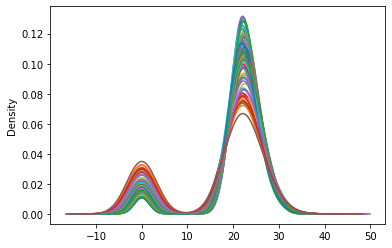

In [35]:
all_samples_log_filtered_50.plot.density(legend=False)

In [38]:
all_samples_log_filtered_na = all_samples_log_filtered_50
all_samples_log_filtered_na.replace(0, np.nan, inplace = True)

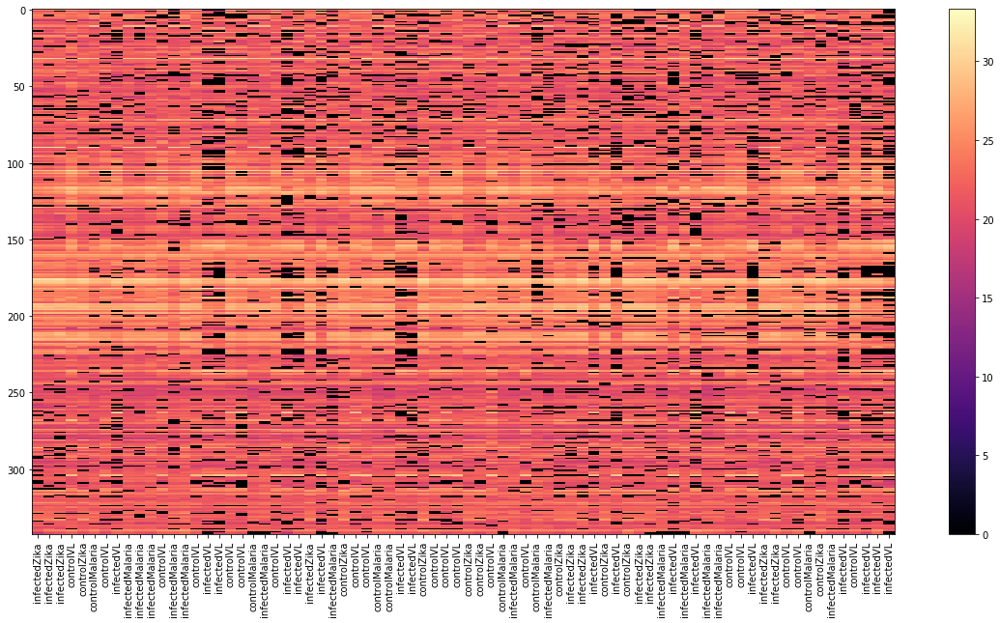

In [52]:
plt.figure(figsize=(20,10))
plt.imshow(all_samples_log_filtered_50,aspect='auto',cmap='magma')
plt.xticks(list(range(0,len(all_samples_log_filtered_50.columns))), all_samples_log_filtered_50.columns, rotation = 90)
plt.colorbar()
plt.show()


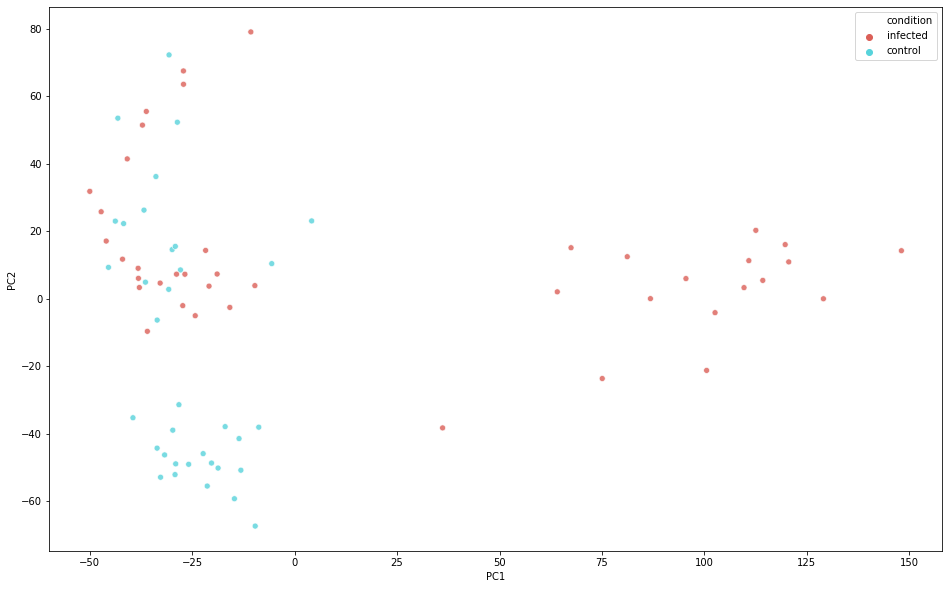

In [124]:
pca_samples = PCA(n_components=3)

principalComponents = pca_samples.fit_transform(all_samples_log_filtered_50.transpose())
principalComponents_df = pd.DataFrame(data = principalComponents, columns= ['PC1','PC2', 'PC3'])
principalComponents_df['condition'] = list(sample_description['Condition'])
principalComponents_df['dataset'] = list(sample_description['Dataset'])

plt.figure(figsize=(16,10))
sns.scatterplot(x="PC1", y="PC2",hue="condition",
    palette=sns.color_palette("hls", 2),
    data=principalComponents_df,
    legend="full",
    alpha=0.8
)

In [96]:
all_samples_log_filtered_50[np.array(zik_con.columns)]

,C1.mzXML,C7.mzXML,C6_r.mzXML,C3.mzXML,C2.mzXML,C9.mzXML,C5.mzXML,C4.mzXML,C10.mzXML
row ID,,,,,,,,,
2051,26.233284,26.259934,25.823591,25.994203,26.429834,25.831940,26.035009,26.037524,0.000000
3,19.201274,20.210023,20.184440,0.000000,18.395444,18.990355,18.598730,20.083202,19.694221
2058,23.204443,23.337613,22.434367,22.962839,0.000000,22.556813,23.091050,22.901970,22.786143
2070,23.698240,23.650423,0.000000,23.629574,23.877756,23.806916,23.632538,23.666871,23.743851
35,24.229399,24.240373,0.000000,0.000000,24.328125,24.061657,24.273050,24.313891,24.199170
43,23.662165,23.633290,22.846148,23.641305,23.692767,0.000000,23.674406,23.723506,23.748131
2093,21.829976,23.114693,22.280583,22.156846,22.002884,21.956466,22.507794,22.194065,22.815977
2094,17.557287,18.246957,18.734943,18.619167,17.721301,18.133179,18.459641,0.000000,17.307792
2116,22.788525,22.715113,0.000000,22.380024,22.597269,22.407220,22.532729,0.000000,0.000000


In [74]:
#imputing missing values with KNN
from fancyimpute import KNN    
def impute_knn(condition_name):
    filt = all_samples_log_filtered_50[condition_name]
    filt.replace(0, np.nan, inplace = True)
    filled_knn = KNN(k=3).fit_transform(filt)
    df = pd.DataFrame(filled_knn, columns=filt.columns, index = filt.index)
    return df


In [97]:
zik_con_filled = impute_knn(np.array(zik_con.columns))
zik_inf_filled = impute_knn(np.array(zik_inf.columns))
vl_con_filled = impute_knn(np.array(vl_con.columns))
vl_inf_filled = impute_knn(np.array(vl_inf.columns))
mal_con_filled = impute_knn(np.array(mal_con.columns))
mal_inf_filled = impute_knn(np.array(mal_inf.columns))


/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/pandas/core/frame.py:4042: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  method=method)
/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/pandas/core/frame.py:4042: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  method=method)


Imputing row 1/343 with 1 missing, elapsed time: 0.025
Imputing row 101/343 with 0 missing, elapsed time: 0.028
Imputing row 201/343 with 2 missing, elapsed time: 0.030
Imputing row 301/343 with 0 missing, elapsed time: 0.031
Imputing row 1/343 with 4 missing, elapsed time: 0.031
Imputing row 101/343 with 0 missing, elapsed time: 0.034
Imputing row 201/343 with 4 missing, elapsed time: 0.036
Imputing row 301/343 with 0 missing, elapsed time: 0.040


/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/pandas/core/frame.py:4042: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  method=method)


Imputing row 1/343 with 0 missing, elapsed time: 0.038
Imputing row 101/343 with 0 missing, elapsed time: 0.045
Imputing row 201/343 with 5 missing, elapsed time: 0.049
Imputing row 301/343 with 5 missing, elapsed time: 0.054


/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/pandas/core/frame.py:4042: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  method=method)


Imputing row 1/343 with 3 missing, elapsed time: 0.053
Imputing row 101/343 with 0 missing, elapsed time: 0.073
Imputing row 201/343 with 5 missing, elapsed time: 0.087
Imputing row 301/343 with 0 missing, elapsed time: 0.101
[KNN] Warning: 17/5831 still missing after imputation, replacing with 0
Imputing row 1/343 with 0 missing, elapsed time: 0.027
Imputing row 101/343 with 0 missing, elapsed time: 0.031
Imputing row 201/343 with 5 missing, elapsed time: 0.033
Imputing row 301/343 with 2 missing, elapsed time: 0.035
Imputing row 1/343 with 1 missing, elapsed time: 0.028
Imputing row 101/343 with 0 missing, elapsed time: 0.031
Imputing row 201/343 with 4 missing, elapsed time: 0.034
Imputing row 301/343 with 5 missing, elapsed time: 0.037


/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/pandas/core/frame.py:4042: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  method=method)
/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/pandas/core/frame.py:4042: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  method=method)


In [98]:
pdList = [vl_inf_filled,vl_con_filled,zik_inf_filled, zik_con_filled, mal_inf_filled,mal_con_filled]  
all_samples_log_filled = pd.concat(pdList, axis = 1)

In [103]:
all_samples_log_filled = all_samples_log_filled[np.array(all_samples_log.columns)]

## Limma analysis in R

In [106]:
#all_samples_log_filtered.to_csv(r'/Users/anamaria/Desktop/mzmine/210120/all_samples_log2.csv', header=True, index=True, sep=',', mode='w')
sample_description.to_csv(r'/Users/anamaria/Desktop/mzmine/210120/sample_description.csv', header=True, index=None, sep=',', mode='w')

In [107]:
#limma with missing values
all_samples_log_filtered_na.to_csv(r'/Users/anamaria/Desktop/mzmine/210120/all_samples_log2_na.csv', header=True, index=True, sep=',', mode='w')
#limma with 50% non-zero
all_samples_log_filtered_50.to_csv(r'/Users/anamaria/Desktop/mzmine/210120/all_samples_log2_50.csv', header=True, index=True, sep=',', mode='w')
all_samples_log_filled.to_csv(r'/Users/anamaria/Desktop/mzmine/210120/all_samples_log2_50_filled.csv', header=True, index=True, sep=',', mode='w')

In [108]:
#toptable = pd.read_csv("/Users/anamaria/Desktop/mzmine/210120/limma_toptable.csv", sep=',')
#toptable_na = pd.read_csv("/Users/anamaria/Desktop/mzmine/210120/limma_toptable_na.csv", sep=',')
#toptable_50 = pd.read_csv("/Users/anamaria/Desktop/mzmine/210120/limma_toptable_50.csv", sep=',')
toptable_50_filled = pd.read_csv("/Users/anamaria/Desktop/mzmine/210120/limma_toptable_50_filled.csv", sep=',')

In [110]:
toptable_50_filled

,logFC,AveExpr,t,P.Value,adj.P.Val,B
1993,-2.025168,22.699452,-6.093520,4.449874e-08,0.000015,8.253510
2726,-0.983305,28.352185,-3.928231,1.893269e-04,0.020295,0.623763
2728,-0.973116,26.525076,-3.881609,2.221530e-04,0.020295,0.479588
2680,-1.140729,23.887016,-3.833066,2.620926e-04,0.020295,0.330655
2729,-1.015417,23.956232,-3.797271,2.958503e-04,0.020295,0.221616
2706,-1.284431,23.351677,-3.731404,3.691077e-04,0.020721,0.022736
2946,-1.633534,23.798300,-3.690582,4.228750e-04,0.020721,-0.099357
870,1.181809,22.482937,3.509599,7.645780e-04,0.032781,-0.629577
4563,-0.898497,20.591976,-3.290787,1.527261e-03,0.058206,-1.245398
2677,-1.003875,23.597560,-3.105247,2.687052e-03,0.092166,-1.744702


In [111]:
#limma_topfeatures = all_samples_log.loc[toptable.index]
limma_topfeatures = all_samples_log.loc[toptable_50_filled.index]
limma_topfeatures = limma_topfeatures.transpose()
limma_topfeatures["Condition"] = np.array(sample_description["ConditionDataset"])

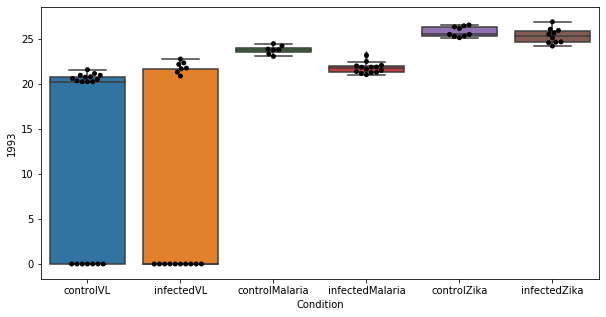

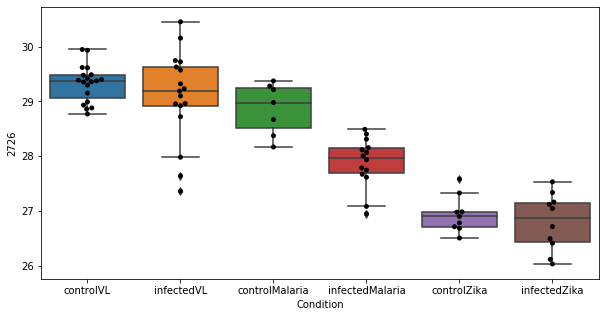

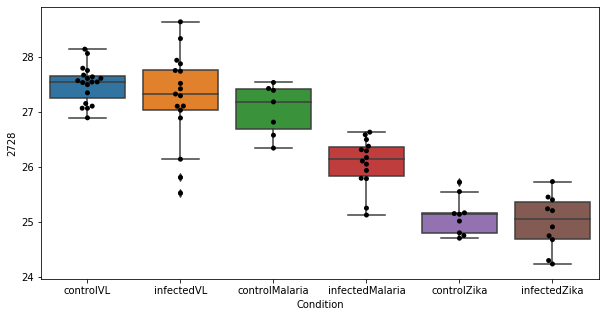

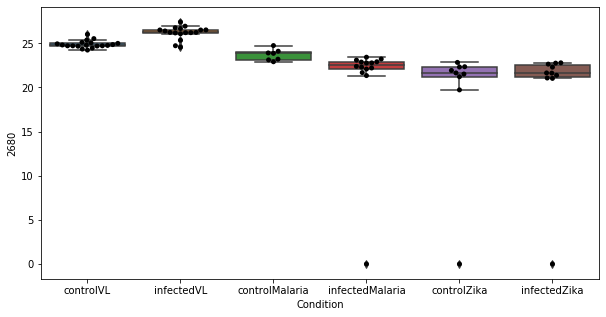

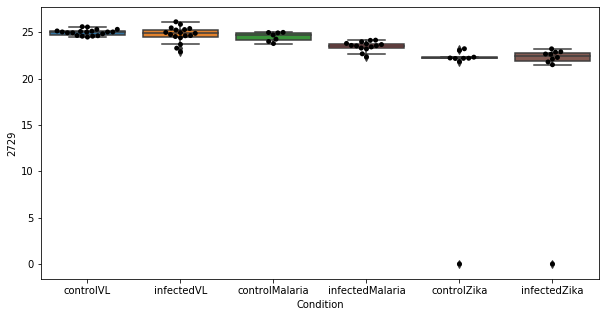

...

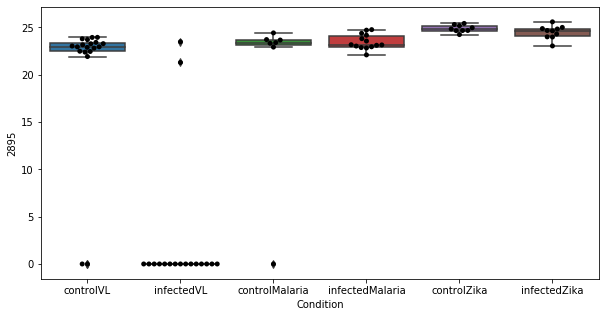

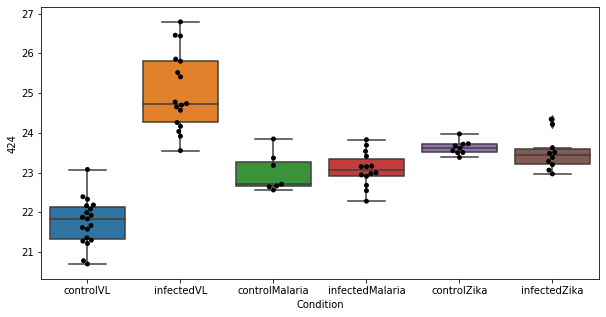

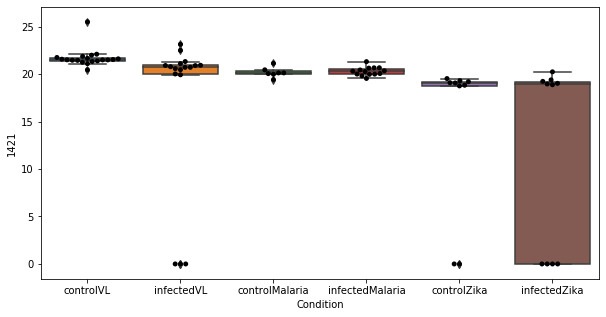

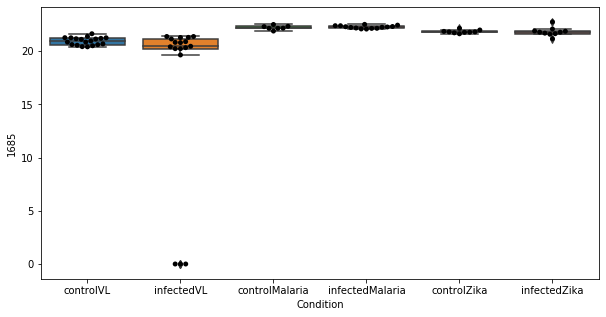

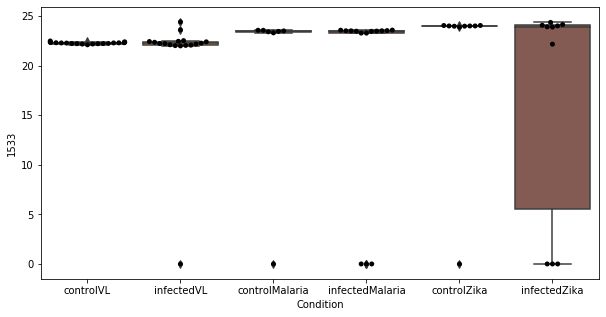

KeyboardInterrupt: 

In [112]:
for i in range(len(list(limma_topfeatures.columns))):
    plt.figure(figsize=(10,5))
    ax = sns.boxplot(y=list(limma_topfeatures.columns)[i], x="Condition", data = limma_topfeatures, order = ['controlVL','infectedVL','controlMalaria', 'infectedMalaria', 'controlZika','infectedZika'] )
    ax = sns.swarmplot(y=list(limma_topfeatures.columns)[i], x="Condition", data = limma_topfeatures, order = ['controlVL','infectedVL','controlMalaria', 'infectedMalaria', 'controlZika','infectedZika'], color="black")
    plt.show()

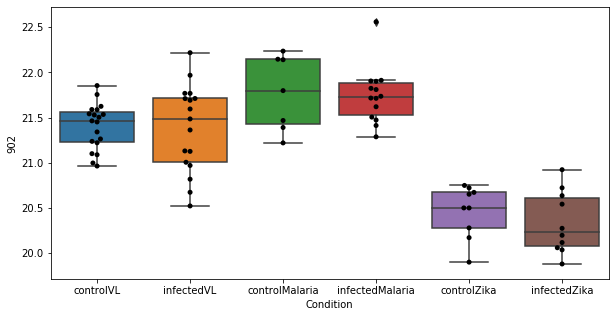

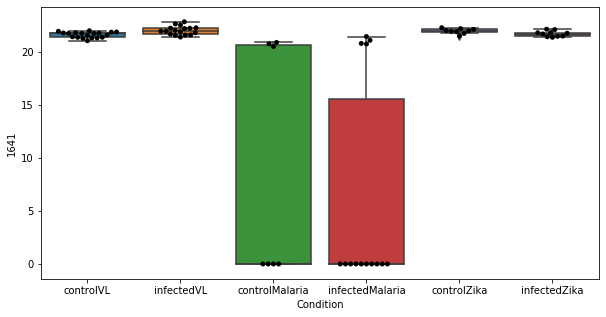

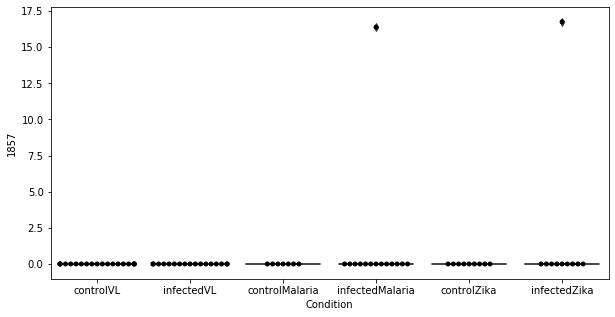

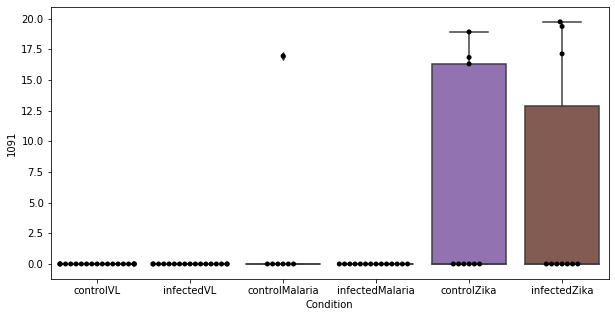

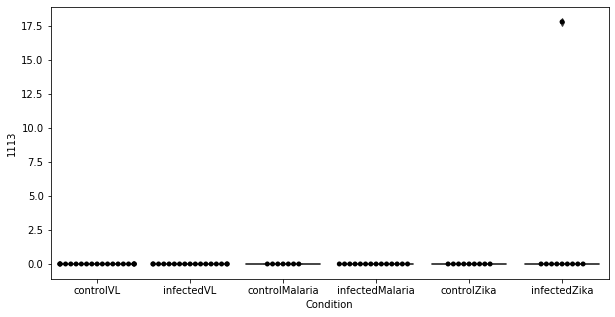

...

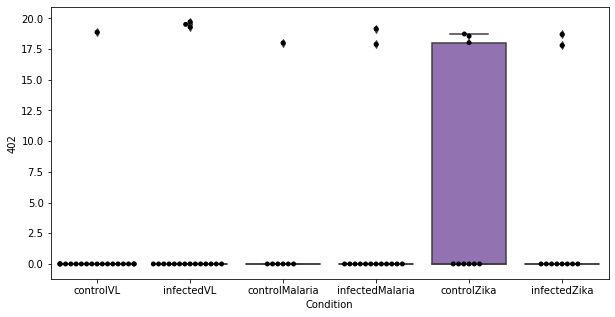

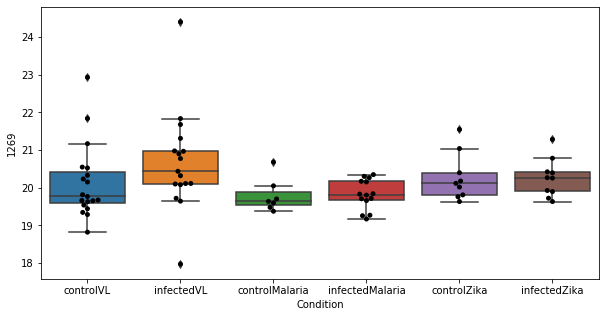

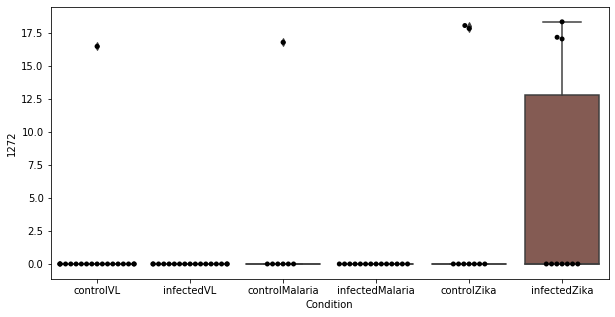

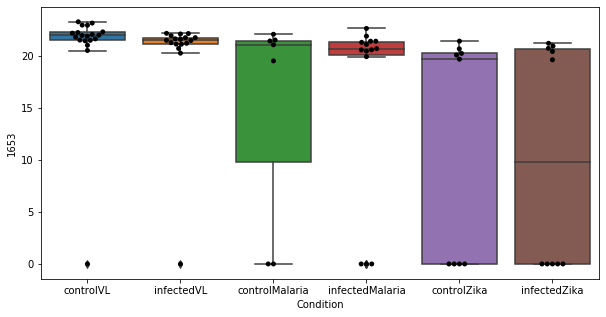

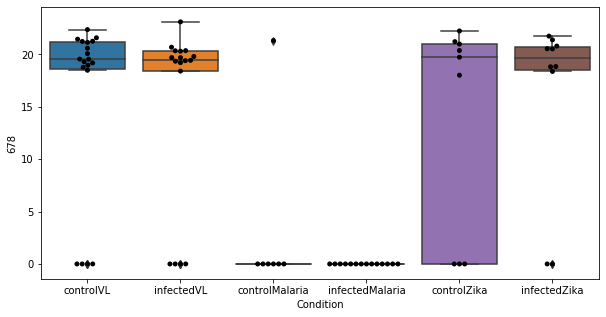

KeyboardInterrupt: 

In [35]:
#for 10% non-zero values 
for i in range(len(list(limma_topfeatures.columns))):
    plt.figure(figsize=(10,5))
    ax = sns.boxplot(y=list(limma_topfeatures.columns)[i], x="Condition", data = limma_topfeatures, order = ['controlVL','infectedVL','controlMalaria', 'infectedMalaria', 'controlZika','infectedZika'] )
    ax = sns.swarmplot(y=list(limma_topfeatures.columns)[i], x="Condition", data = limma_topfeatures, order = ['controlVL','infectedVL','controlMalaria', 'infectedMalaria', 'controlZika','infectedZika'], color="black")
    plt.show()

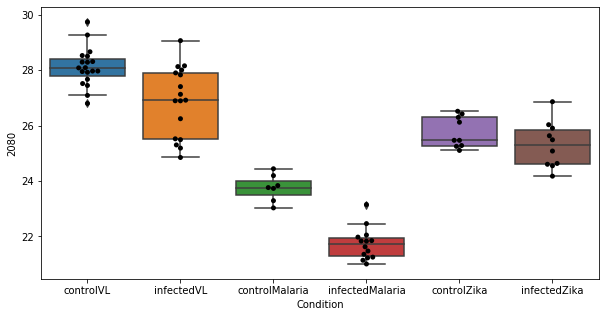

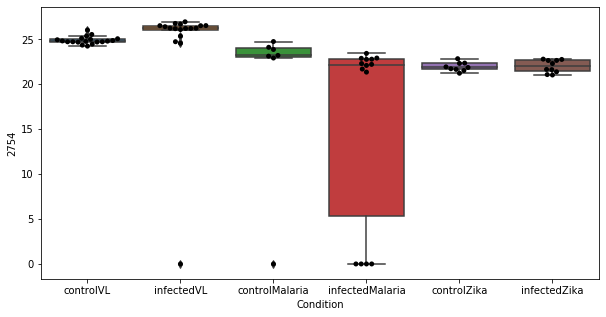

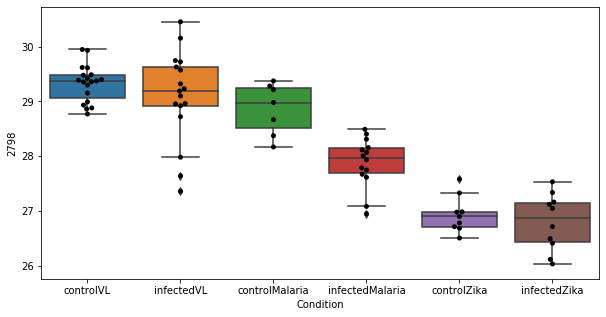

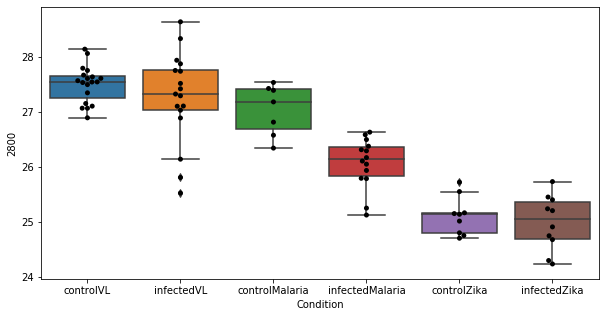

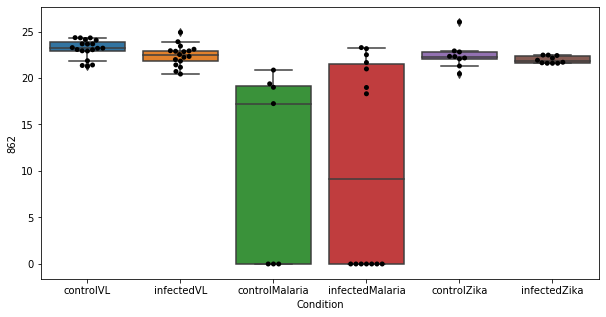

...

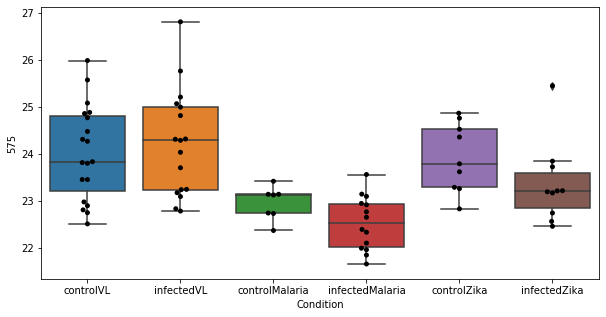

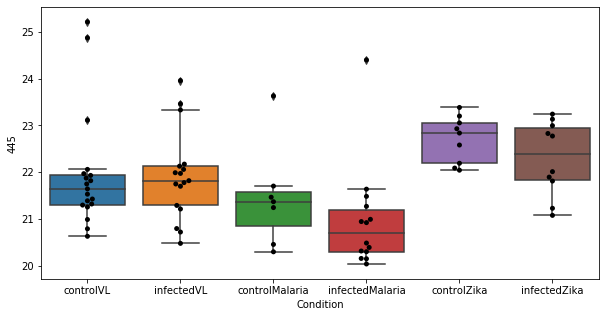

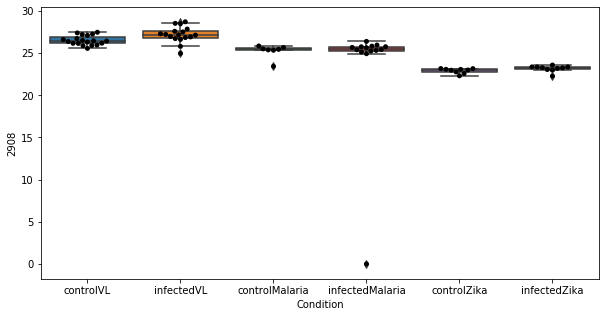

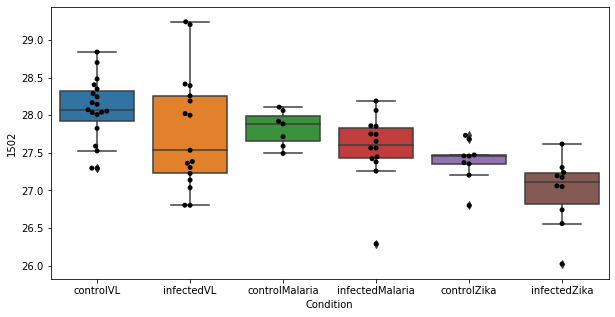

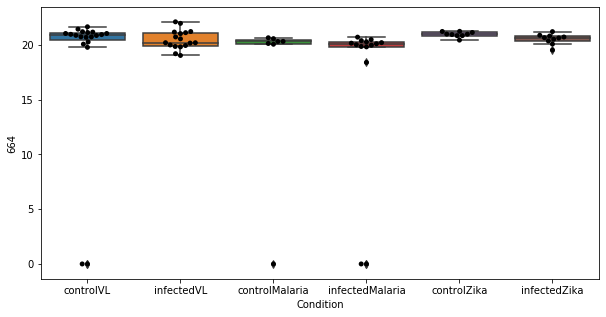

KeyboardInterrupt: 

In [214]:
#for 50% non-zero values
for i in range(len(list(limma_topfeatures.columns))):
    plt.figure(figsize=(10,5))
    ax = sns.boxplot(y=list(limma_topfeatures.columns)[i], x="Condition", data = limma_topfeatures, order = ['controlVL','infectedVL','controlMalaria', 'infectedMalaria', 'controlZika','infectedZika'] )
    ax = sns.swarmplot(y=list(limma_topfeatures.columns)[i], x="Condition", data = limma_topfeatures, order = ['controlVL','infectedVL','controlMalaria', 'infectedMalaria', 'controlZika','infectedZika'], color="black")
    plt.show()

In [91]:
limma_topfeatures

,584,9,241,431,255,126,256,104,174,344,...,242,605,583,95,226,212,15,529,68,Condition
ZIK10.mzXML,20.561902,20.388158,26.844279,19.122619,24.106804,16.658967,22.869547,19.570646,23.660171,17.912564,...,22.662808,18.671188,23.681614,19.578446,18.973433,19.501633,19.358731,15.585411,20.565806,infectedZika
ZIK6.mzXML,21.887242,19.307789,26.941892,0.000000,24.576371,0.000000,22.908194,19.655611,23.076085,0.000000,...,21.910750,0.000000,24.481392,19.745973,18.647416,0.000000,0.000000,0.000000,0.000000,infectedZika
ZIK7.mzXML,21.374661,19.831240,27.304239,0.000000,23.899899,0.000000,23.219933,19.575473,23.435993,0.000000,...,19.564158,0.000000,23.643720,19.246465,18.446003,19.250143,0.000000,17.227712,0.000000,infectedZika
C7_2.mzXML,22.387390,21.404574,28.189089,0.000000,19.213314,0.000000,24.087428,0.000000,26.336947,0.000000,...,21.723311,18.312975,22.937727,18.827073,20.320984,0.000000,0.000000,0.000000,0.000000,controlVL
C1.mzXML,21.803592,20.198539,27.519133,0.000000,25.096383,0.000000,23.349565,19.020603,22.950323,0.000000,...,0.000000,0.000000,24.395283,19.729902,18.629225,0.000000,0.000000,0.000000,0.000000,controlZika
KM_10.mzXML,20.965082,0.000000,25.239077,0.000000,24.630074,0.000000,0.000000,0.000000,23.421905,0.000000,...,0.000000,0.000000,23.089732,19.897299,16.870521,20.077639,0.000000,0.000000,0.000000,controlMalaria
C10_2.mzXML,22.285970,20.934347,27.313138,0.000000,0.000000,0.000000,23.282154,20.653575,26.292951,0.000000,...,20.494109,0.000000,22.553331,20.357066,19.869752,0.000000,0.000000,0.000000,0.000000,controlVL
VL7.mzXML,23.647678,20.789353,28.366262,0.000000,0.000000,0.000000,24.301376,0.000000,26.089403,0.000000,...,0.000000,0.000000,0.000000,20.694990,0.000000,0.000000,0.000000,0.000000,0.000000,infectedVL
KM_11.mzXML,20.465807,0.000000,26.006961,0.000000,24.974797,0.000000,22.372627,0.000000,23.173568,0.000000,...,22.943666,0.000000,22.742501,0.000000,18.277986,20.123221,20.825051,0.000000,0.000000,infectedMalaria
KM_9.mzXML,20.081843,0.000000,24.318862,0.000000,24.537548,0.000000,0.000000,0.000000,22.209860,0.000000,...,0.000000,0.000000,23.811299,0.000000,0.000000,20.551939,21.252397,0.000000,0.000000,infectedMalaria


ModuleNotFoundError: No module named 'fancyimpute'

In [ ]:
limma_topfeatures

In [46]:
def plot_boxplots(limma_topfeatures, metab_id, ylim, y = False ):
    plt.figure(figsize=(10,5))
   
    ax = sns.boxplot(y=limma_topfeatures[metab_id], x="Condition", data = limma_topfeatures, order = ['controlVL','infectedVL','controlMalaria', 'infectedMalaria', 'controlZika','infectedZika'] )
    ax = sns.swarmplot(y=limma_topfeatures[metab_id], x="Condition", data = limma_topfeatures, order = ['controlVL','infectedVL','controlMalaria', 'infectedMalaria', 'controlZika','infectedZika'], color="black")
    if y:
        plt.ylim(ylim)
    plt.show()

## Preparing file for mummichog

In [113]:
import scipy
data = feature_description.loc[toptable_50_filled.index]
#data['row retention time'] = np.zeros(len(data))
data['p-val'] = toptable_50_filled['P.Value']
#data['t-val'] = toptable['t']
data['adj.P.Val'] = toptable_50_filled['adj.P.Val']
data['custom_id'] = list(data.index)
data_without_rt = data.drop(['row retention time'], axis = 1)

In [114]:
data.to_csv(r'/Users/anamaria/Desktop/mzmine/210120/topfeatures50_filled.txt', header=True, index=None, sep='\t', mode='w')
#data_without_rt.to_csv(r'/Users/anamaria/Desktop/mzmine/221119/topfeatures_without_rt.txt', header=True, index=None, sep='\t', mode='w')

In [116]:
os.system('mummichog -f'+'/Users/anamaria/Desktop/mzmine/210120/topfeatures50_filled.txt'+' -m positive -u 3 -o mm')

0

In [69]:
os.system('mummichog -f'+'/Users/anamaria/Desktop/mzmine/221119/topfeatures_without_rt.txt'+' -m positive -u 3 -o mm')

256

In [117]:
compounds = pd.read_csv('1579614835.43.mm/tables/ListOfEmpiricalCompounds.tsv', sep='\t')
featureoutput = pd.read_csv('1579614835.43.mm/tables/userInputData.txt', sep='\t')

In [118]:
matching_ids = {}
for _,row in featureoutput.iterrows():
    key = row['massfeature_rows']
    value = row['CompoundID_from_user']
    matching_ids[key] = value

In [119]:
compounds_dict = {}
for _,row in compounds.iterrows():
    ids = row['massfeature_rows']
    ions = row['str_row_ion']
    compoundlist = row['compound_names']
    
    ids_list = ids.split(';')
    ions_list = ions.split(';')
    for i in range(len(ids_list)):
        compounds_dict[matching_ids[ids_list[i]]] = []
        compounds_dict[matching_ids[ids_list[i]]].append(ions_list[i].split('_')[1])
        compounds_dict[matching_ids[ids_list[i]]].append(compoundlist)
        

In [120]:
for row_id,row in data.iterrows():
    if row_id in list(compounds_dict.keys()):
        
        data.at[row_id,'compound_names'] = compounds_dict[row_id][-1]
    else:
         data.at[row_id,'compound_names'] = 'NaN'
    

In [122]:
#pd.set_option('display.max_rows', 1000)
pdata = data[data['p-val'] <= 1]

In [189]:
data.loc[1521]

row m/z                                                         209.092
row retention time                                              9.32332
p-val                                                         0.0228436
adj.P.Val                                                      0.610573
custom_id                                                          1521
compound_names        L-Kynurenine; 3-Anthraniloyl-L-alanine$Formyl-...
Name: 1521, dtype: object

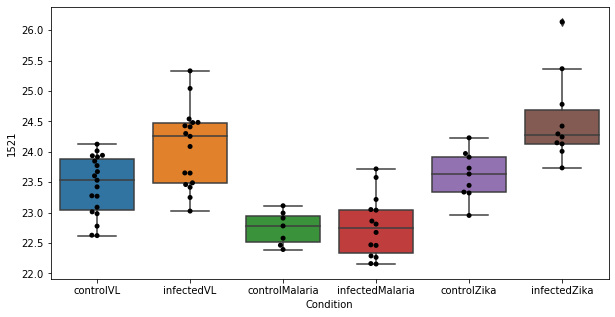

In [183]:
plot_boxplots(limma_topfeatures,1521, (15,30), False)

In [191]:
data.loc[1543]

row m/z                                                         210.096
row retention time                                              9.33432
p-val                                                        0.00406191
adj.P.Val                                                      0.327955
custom_id                                                          1543
compound_names        L-Kynurenine; 3-Anthraniloyl-L-alanine$Formyl-...
Name: 1543, dtype: object

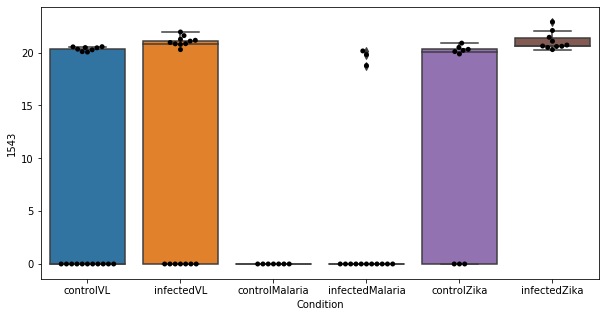

In [43]:
plot_boxplots(limma_topfeatures,1543, (15,30), False)

In [195]:
data.loc[575]

row m/z                                                         141.066
row retention time                                              8.53791
p-val                                                         0.0407753
adj.P.Val                                                      0.743377
custom_id                                                           575
compound_names        Methylimidazoleacetic acid; Tele-methylimidazo...
Name: 575, dtype: object

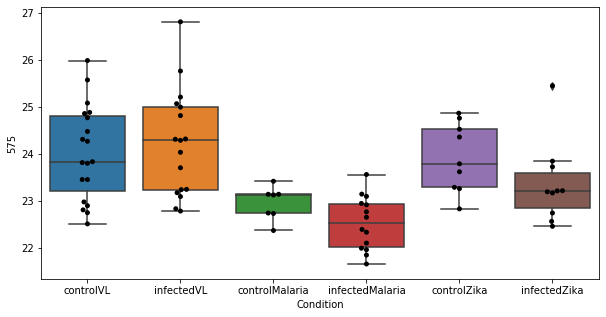

In [196]:
plot_boxplots(limma_topfeatures,575, (15,30), False)

In [198]:
data.loc[1661]

row m/z                           218.139
row retention time                8.41637
p-val                           0.0552375
adj.P.Val                        0.806068
custom_id                            1661
compound_names        propionyl-carnitine
Name: 1661, dtype: object

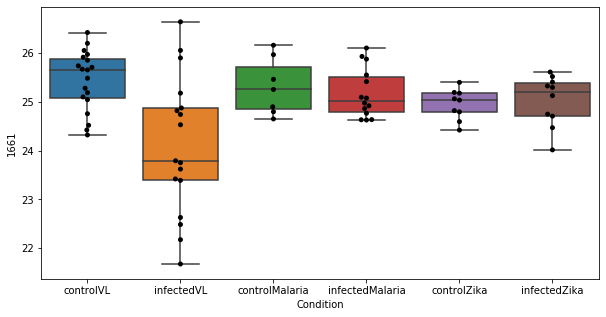

In [199]:
plot_boxplots(limma_topfeatures,1661, (15,30), False)

In [200]:
data.loc[239]

row m/z                                                          115.05
row retention time                                              10.3323
p-val                                                         0.0621256
adj.P.Val                                                      0.860949
custom_id                                                           239
compound_names        5,6-Dihydrouracil; 2,4(1H,3H)-Pyrimidinedione,...
Name: 239, dtype: object

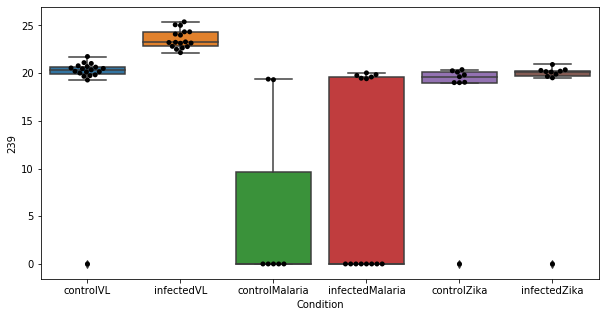

In [201]:
plot_boxplots(limma_topfeatures,239, (15,30), False)

In [59]:
data.loc[902]

row m/z                  160.116
row retention time       10.4075
p-val                 2.8358e-05
adj.P.Val             0.00877682
custom_id                    902
compound_names               NaN
Name: 902, dtype: object

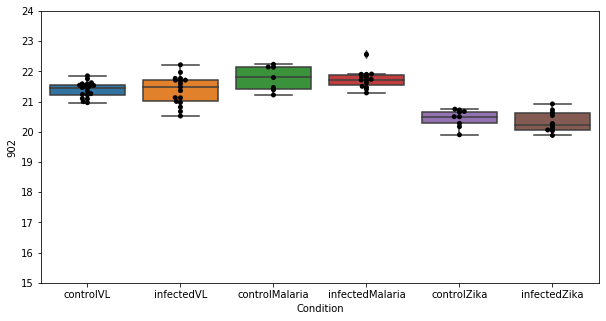

In [60]:
plot_boxplots(limma_topfeatures,902, (15,24), True)

In [108]:
data.loc[457]

row m/z                                                         132.066
row retention time                                              11.5752
p-val                                                          0.536622
adj.P.Val                                                      0.999947
custom_id                                                           457
compound_names        5-Aminolevulinate; 5-Amino-4-oxopentanoate; 5-...
Name: 457, dtype: object

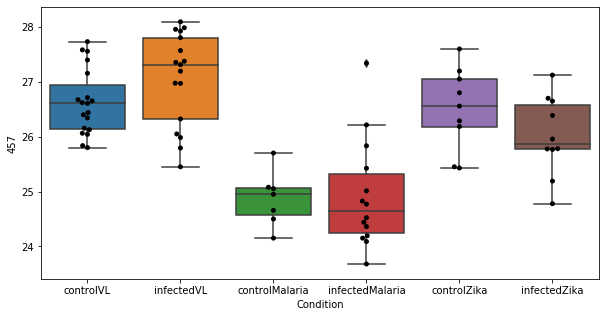

In [109]:
plot_boxplots(limma_topfeatures,457, (15,30), False)

In [135]:
for i in list(toptable_50.index):
    mz = data.loc[i]['row m/z']
    if mz > 100.0 and mz <230.0:
        print(mz)

142.0863576776841
115.0695485064858
130.15906863742404
116.0706210569902
102.06623077392578
116.07047700881958
106.049880680285
123.05527623494464
129.10223881648136
115.07537656511579
115.05025736490887
130.08630989693307
114.09845822477993
114.09138870239258
124.08698785716088
102.0661973953247
129.09101119695922
105.11036726485851
101.0763931274414
113.10729163033622
143.0816130802549
100.07568105061847
127.0866355895996
136.0757680620466
136.06183242797852
114.0550639629364
111.0553207397461
115.0502700805664
106.97155380249023
129.1022192913553
132.1421009751617
141.06590837047946
122.1041380564372
125.09614275322586
101.07160232543946
111.11685180664062
118.05242580837673
133.07975006103516
130.06519063313806
118.08624432538006
123.11681801932198
113.10733677790716
130.08640683081842
126.0219806871916
104.10698776245115
142.12273035551368
130.96070353190106
115.0866195678711
115.12298631668092
122.101953125
131.16241200764978
115.09473750465794
104.10696566944391
116.037513287862

In [260]:
data.loc[1521]

row m/z                                                         209.092
row retention time                                              9.32332
p-val                                                           0.93632
adj.P.Val                                                      0.999793
custom_id                                                          1521
compound_names        L-Kynurenine; 3-Anthraniloyl-L-alanine$Formyl-...
Name: 1521, dtype: object

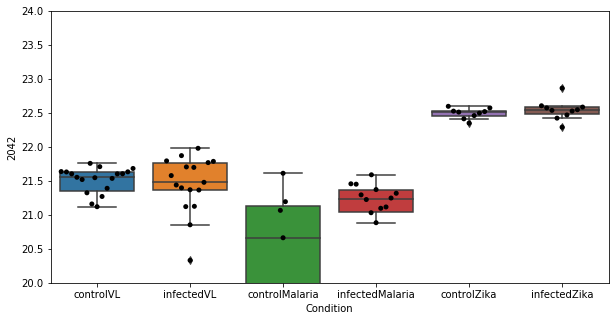

In [251]:
plot_boxplots(limma_topfeatures,2042, (20,24), True)

0 row m/z                   258.109
row retention time        11.3526
p-val                 4.44987e-08
adj.P.Val             1.52631e-05
custom_id                    1993
compound_names                NaN
Name: 1993, dtype: object


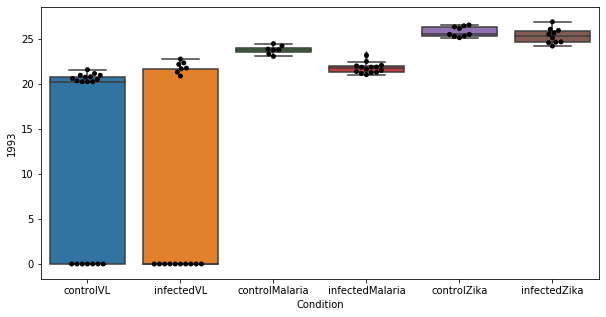

1 row m/z                                                         524.371
row retention time                                              3.87509
p-val                                                       0.000189327
adj.P.Val                                                     0.0202953
custom_id                                                          2726
compound_names        tetracosapentaenoyl carnitine$tetracosapentaen...
Name: 2726, dtype: object


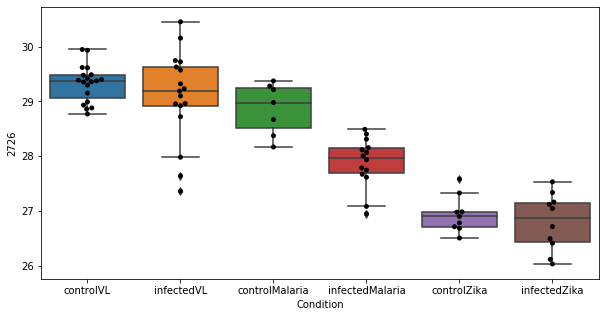

2 row m/z                   525.375
row retention time        3.87329
p-val                 0.000222153
adj.P.Val               0.0202953
custom_id                    2728
compound_names                NaN
Name: 2728, dtype: object


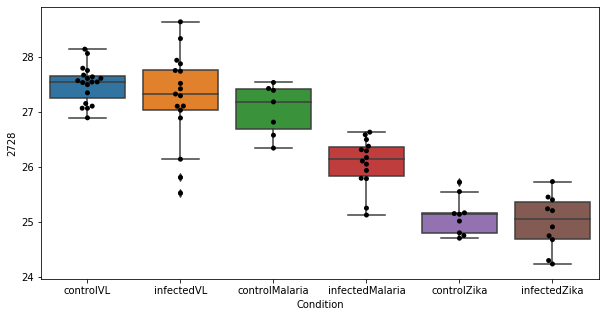

3 row m/z                   482.361
row retention time        4.05389
p-val                 0.000262093
adj.P.Val               0.0202953
custom_id                    2680
compound_names                NaN
Name: 2680, dtype: object


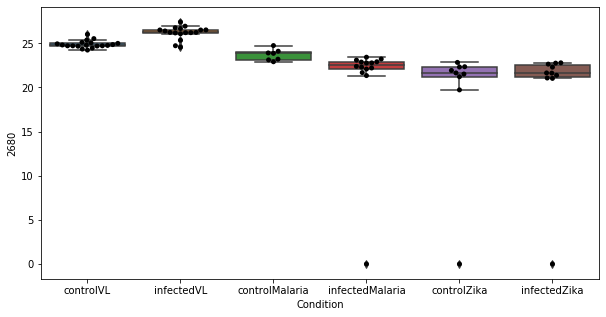

4 row m/z                  526.377
row retention time       3.87943
p-val                 0.00029585
adj.P.Val              0.0202953
custom_id                   2729
compound_names               NaN
Name: 2729, dtype: object


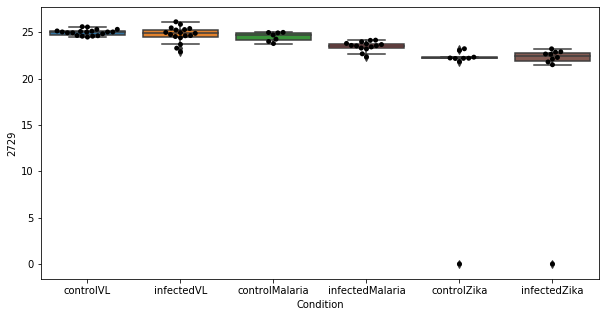

5 row m/z                                                         508.376
row retention time                                              3.95609
p-val                                                       0.000369108
adj.P.Val                                                     0.0207209
custom_id                                                          2706
compound_names        1-Acyl-sn-glycero-3-phosphocholine; 1-Acyl-sn-...
Name: 2706, dtype: object


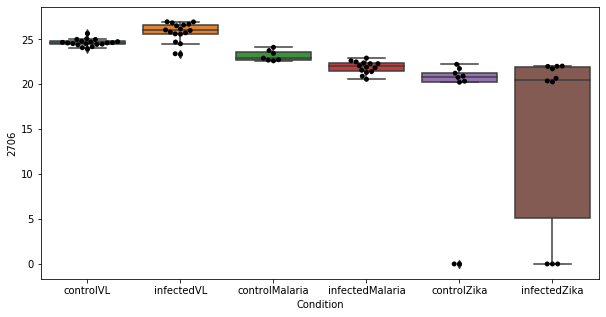

6 row m/z                   787.667
row retention time        3.47537
p-val                 0.000422875
adj.P.Val               0.0207209
custom_id                    2946
compound_names                NaN
Name: 2946, dtype: object


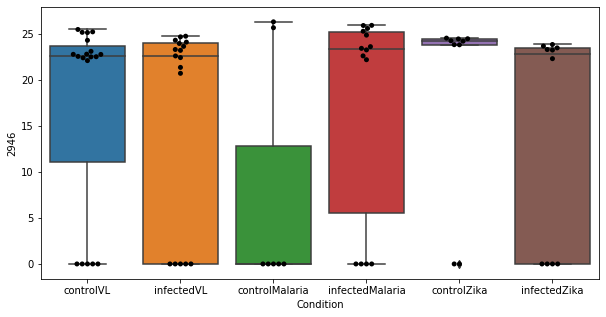

7 row m/z                   164.067
row retention time        4.87729
p-val                 0.000764578
adj.P.Val               0.0327813
custom_id                     870
compound_names                NaN
Name: 870, dtype: object


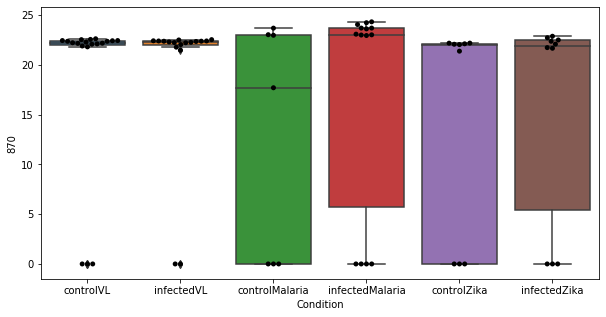

8 row m/z                  139.112
row retention time       4.45612
p-val                 0.00152726
adj.P.Val              0.0582056
custom_id                   4563
compound_names                 $
Name: 4563, dtype: object


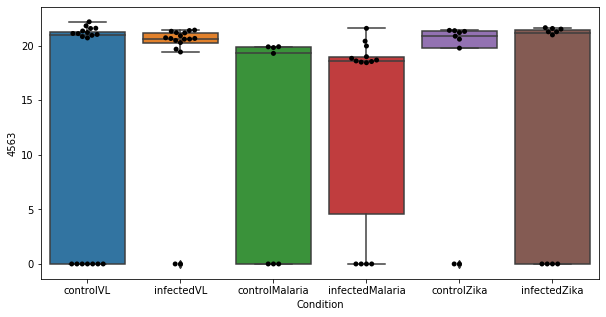

9 row m/z                  480.345
row retention time       3.95054
p-val                 0.00268705
adj.P.Val              0.0921659
custom_id                   2677
compound_names               NaN
Name: 2677, dtype: object


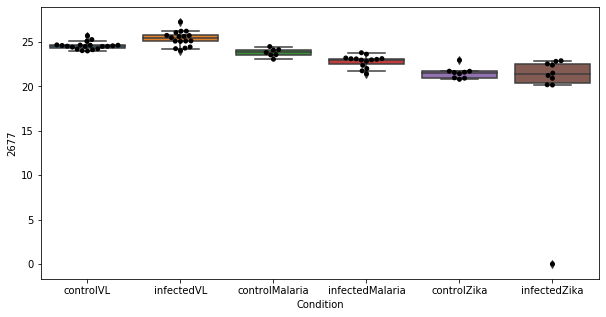

10 row m/z                  510.356
row retention time       3.92654
p-val                 0.00475205
adj.P.Val               0.134551
custom_id                   2711
compound_names               NaN
Name: 2711, dtype: object


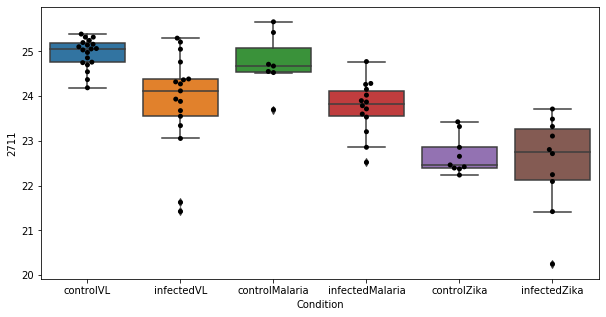

11 row m/z                  499.348
row retention time       4.00354
p-val                 0.00486863
adj.P.Val               0.134551
custom_id                   2703
compound_names               NaN
Name: 2703, dtype: object


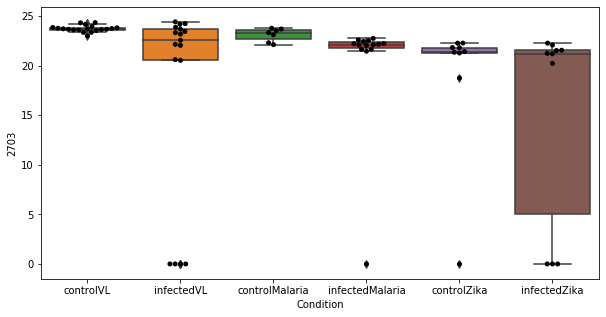

12 row m/z                  498.346
row retention time        3.9835
p-val                 0.00546537
adj.P.Val               0.134551
custom_id                   2701
compound_names               NaN
Name: 2701, dtype: object


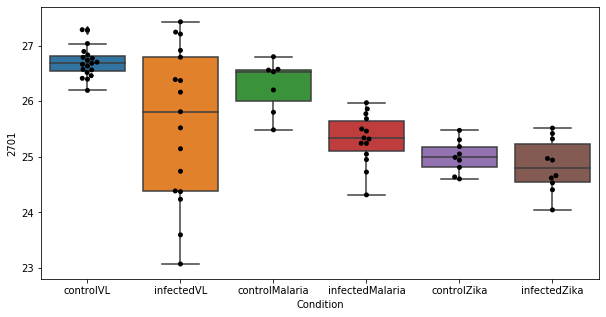

13 row m/z                  97.9913
row retention time       4.87607
p-val                 0.00565429
adj.P.Val               0.134551
custom_id                     83
compound_names               NaN
Name: 83, dtype: object


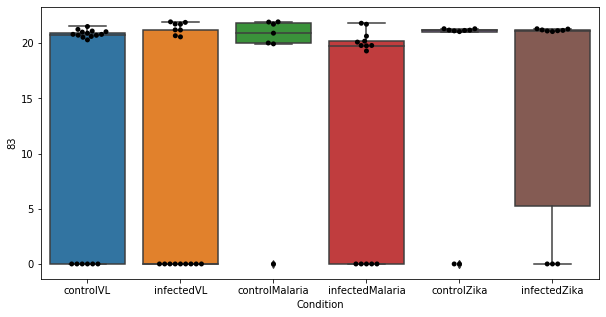

14 row m/z                  497.343
row retention time       3.99209
p-val                 0.00588415
adj.P.Val               0.134551
custom_id                   2698
compound_names               NaN
Name: 2698, dtype: object


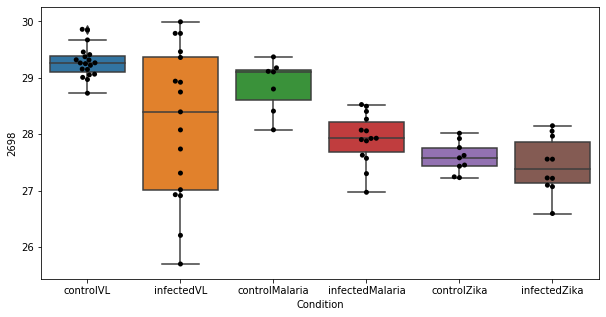

15 row m/z                                                          496.34
row retention time                                              3.98868
p-val                                                        0.00654689
adj.P.Val                                                      0.140349
custom_id                                                          2696
compound_names        docosa-4,7,10,13,16-pentaenoyl carnitine$clupa...
Name: 2696, dtype: object


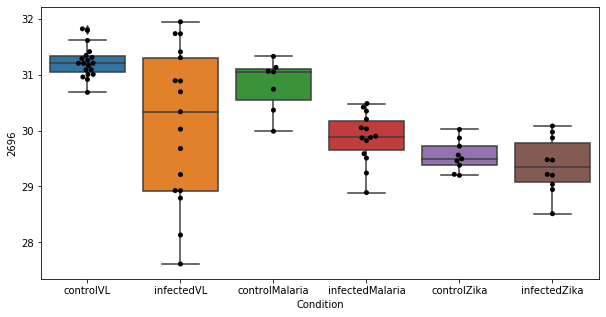

16 row m/z                  495.328
row retention time       4.02291
p-val                 0.00981326
adj.P.Val               0.197997
custom_id                   2695
compound_names               NaN
Name: 2695, dtype: object


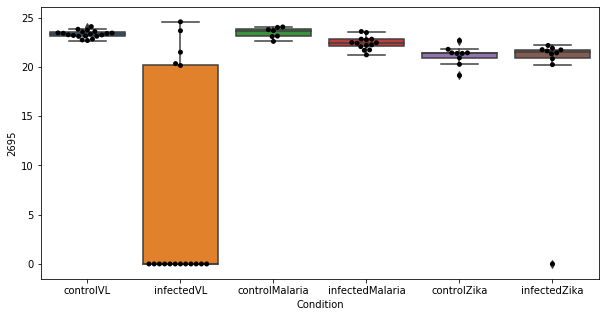

17 row m/z                          494.324
row retention time               4.02921
p-val                           0.010422
adj.P.Val                       0.198597
custom_id                           2693
compound_names        cervonyl carnitine
Name: 2693, dtype: object


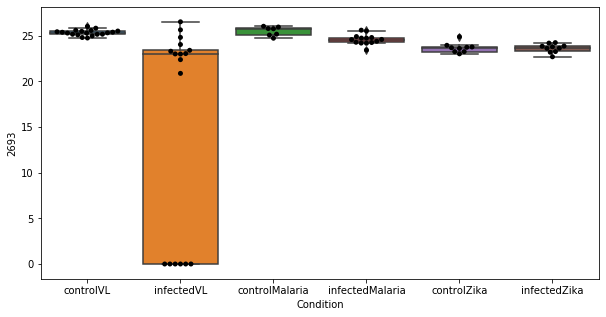

18 row m/z                 469.312
row retention time      4.15258
p-val                 0.0122864
adj.P.Val              0.221802
custom_id                  2666
compound_names              NaN
Name: 2666, dtype: object


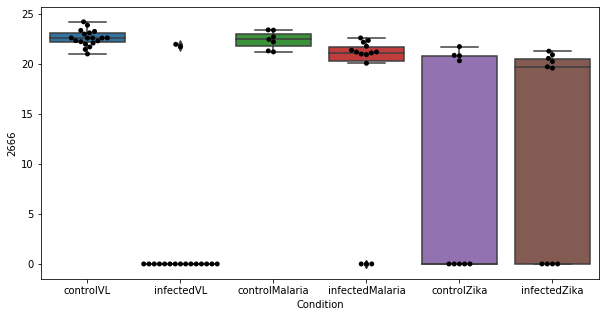

19 row m/z                            468.308
row retention time                  4.1309
p-val                            0.0129402
adj.P.Val                         0.221925
custom_id                             2664
compound_names        Timnodonyl carnitine
Name: 2664, dtype: object


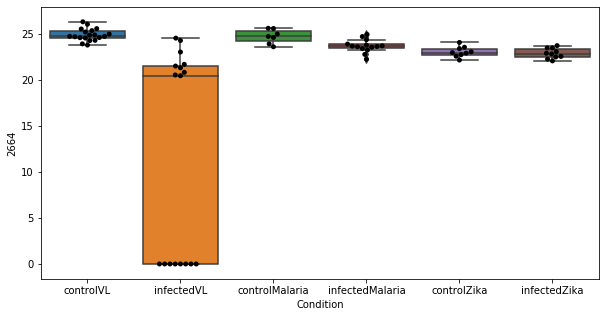

20 row m/z                 268.893
row retention time      13.6097
p-val                 0.0150089
adj.P.Val              0.238589
custom_id                  2070
compound_names              NaN
Name: 2070, dtype: object


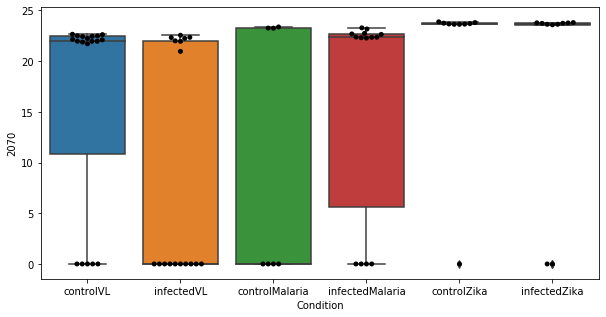

21 row m/z                 482.324
row retention time      4.02668
p-val                 0.0153031
adj.P.Val              0.238589
custom_id                  2678
compound_names              NaN
Name: 2678, dtype: object


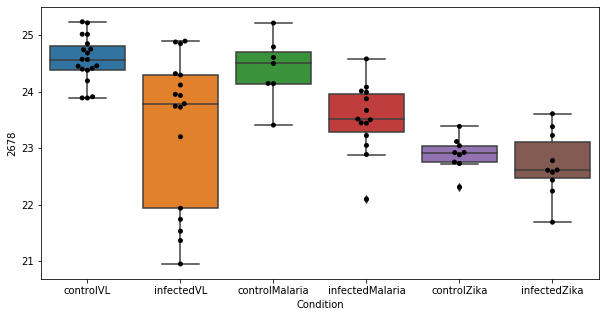

22 row m/z                 123.972
row retention time      4.87982
p-val                 0.0185963
adj.P.Val              0.277328
custom_id                   305
compound_names              NaN
Name: 305, dtype: object


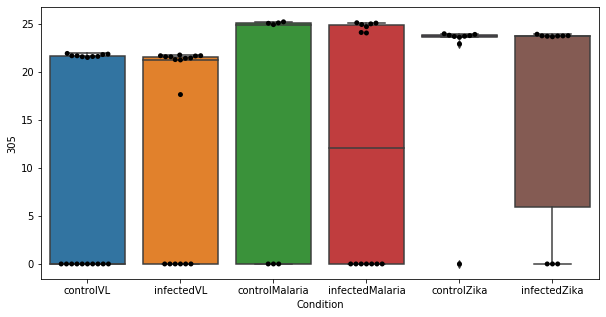

23 row m/z                                                         138.055
row retention time                                              6.92032
p-val                                                         0.0251176
adj.P.Val                                                      0.358972
custom_id                                                           491
compound_names        Anthranilate; Anthranilic acid; o-Aminobenzoic...
Name: 491, dtype: object


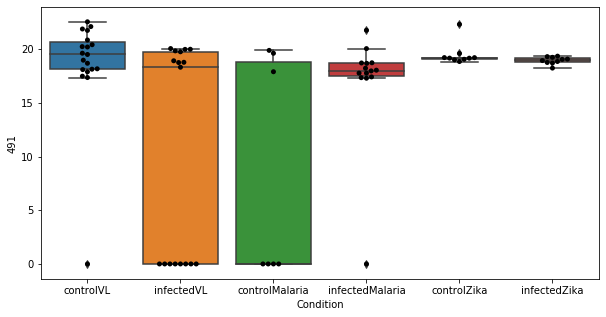

24 row m/z                 186.944
row retention time       4.9359
p-val                 0.0296199
adj.P.Val              0.406385
custom_id                  1166
compound_names              NaN
Name: 1166, dtype: object


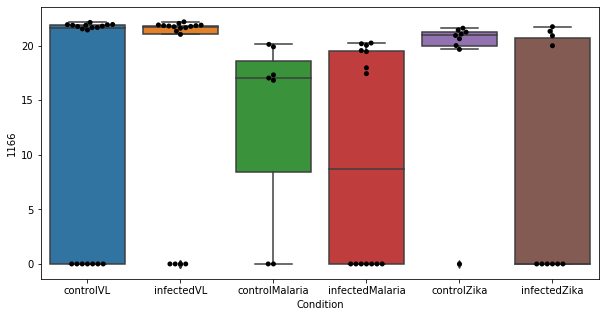

25 row m/z                 832.584
row retention time      3.36202
p-val                 0.0319072
adj.P.Val               0.42093
custom_id                  3022
compound_names              NaN
Name: 3022, dtype: object


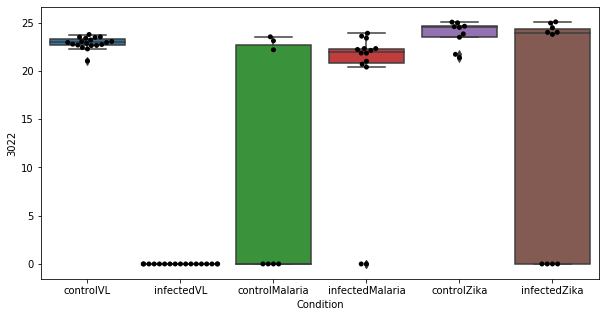

26 row m/z                                                         147.076
row retention time                                               7.0912
p-val                                                         0.0411814
adj.P.Val                                                      0.523156
custom_id                                                           614
compound_names        D-Glutamine; D-2-Aminoglutaramic acid$L-Glutam...
Name: 614, dtype: object


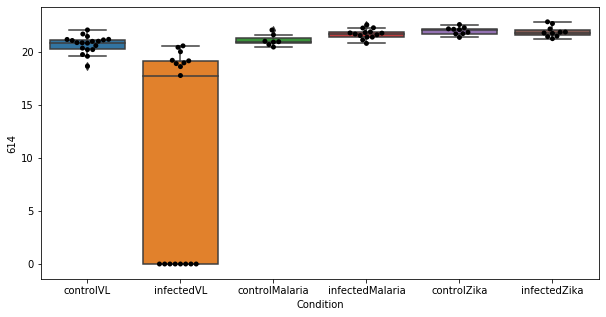

27 row m/z                                                         188.092
row retention time                                              6.92044
p-val                                                         0.0532519
adj.P.Val                                                      0.640768
custom_id                                                          1191
compound_names        6-Acetamido-2-oxohexanoate; 2-Oxo-6-acetamidoc...
Name: 1191, dtype: object


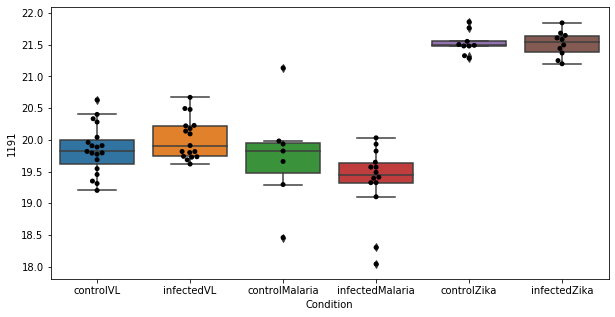

28 row m/z                 191.103
row retention time      11.3352
p-val                 0.0541757
adj.P.Val              0.640768
custom_id                  1240
compound_names              NaN
Name: 1240, dtype: object


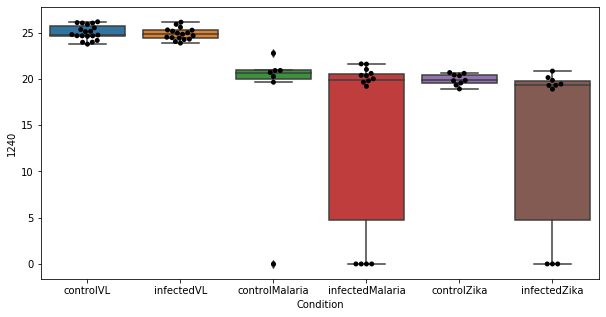

29 row m/z                 148.043
row retention time      6.90866
p-val                 0.0563282
adj.P.Val              0.644019
custom_id                   626
compound_names              NaN
Name: 626, dtype: object


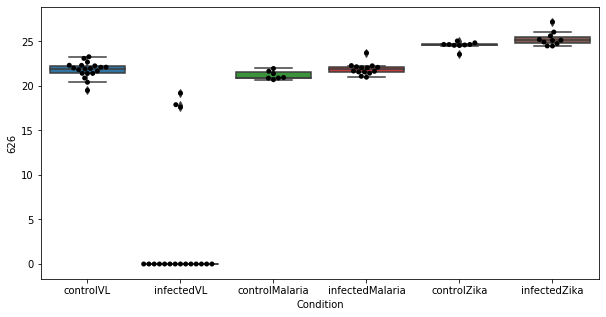

30 row m/z                153.091
row retention time     4.61658
p-val                  0.06573
adj.P.Val             0.720588
custom_id                  706
compound_names             NaN
Name: 706, dtype: object


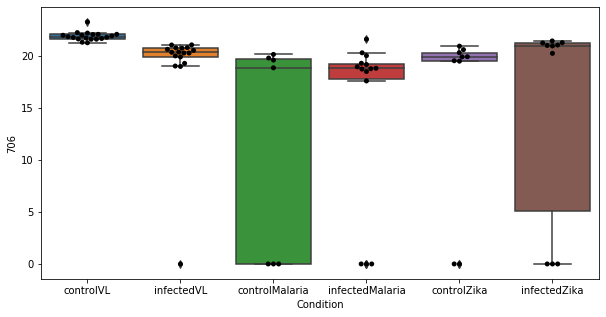

31 row m/z                  568.34
row retention time      3.83936
p-val                 0.0672269
adj.P.Val              0.720588
custom_id                  2763
compound_names              NaN
Name: 2763, dtype: object


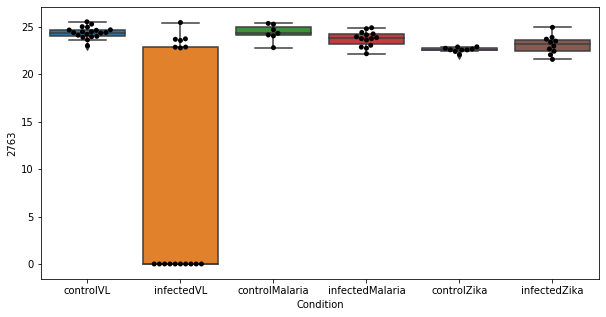

32 row m/z                            253.155
row retention time                  4.2999
p-val                            0.0704876
adj.P.Val                         0.732644
custom_id                             1960
compound_names        histidyl-prolinamide
Name: 1960, dtype: object


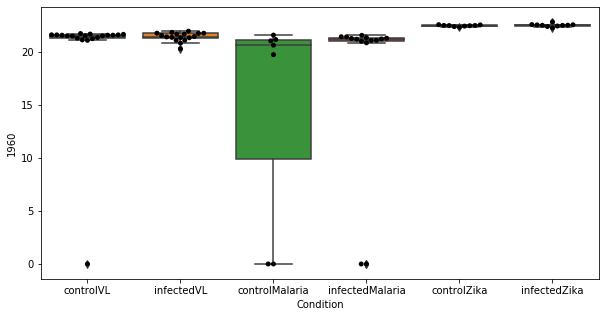

33 row m/z                  123.04
row retention time      4.85825
p-val                 0.0786723
adj.P.Val              0.774501
custom_id                   295
compound_names              NaN
Name: 295, dtype: object


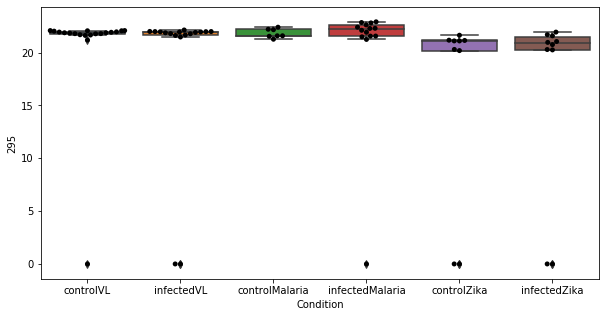

34 row m/z                 240.142
row retention time      6.91202
p-val                 0.0790308
adj.P.Val              0.774501
custom_id                  1832
compound_names              NaN
Name: 1832, dtype: object


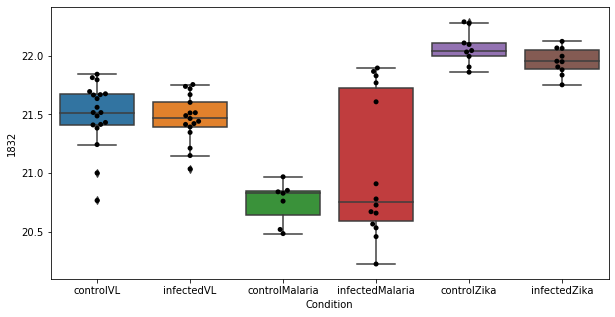

35 row m/z                518.322
row retention time     4.16916
p-val                 0.084794
adj.P.Val             0.807899
custom_id                 2716
compound_names             NaN
Name: 2716, dtype: object


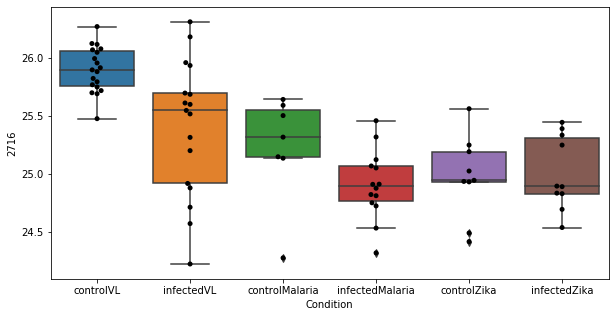

36 row m/z                522.356
row retention time      3.9084
p-val                  0.09193
adj.P.Val             0.852216
custom_id                 2724
compound_names             NaN
Name: 2724, dtype: object


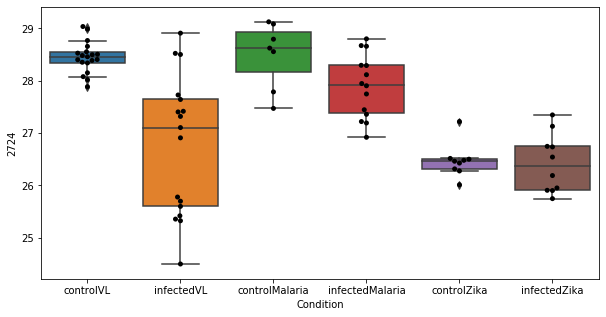

37 row m/z                519.325
row retention time      4.1565
p-val                 0.094751
adj.P.Val             0.855253
custom_id                 2718
compound_names             NaN
Name: 2718, dtype: object


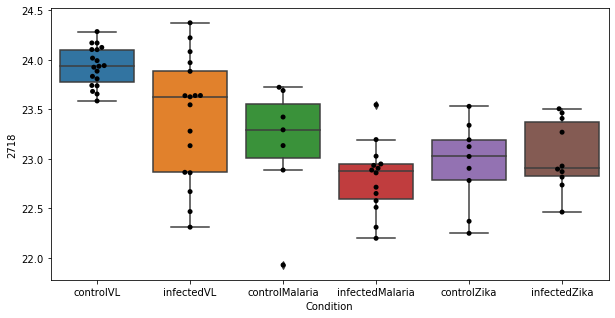

38 row m/z                 523.359
row retention time      3.90763
p-val                 0.0993746
adj.P.Val              0.868636
custom_id                  2725
compound_names              NaN
Name: 2725, dtype: object


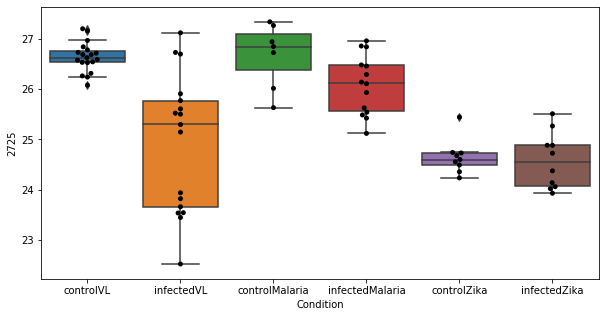

39 row m/z                171.076
row retention time     9.20811
p-val                 0.101299
adj.P.Val             0.868636
custom_id                  952
compound_names             NaN
Name: 952, dtype: object


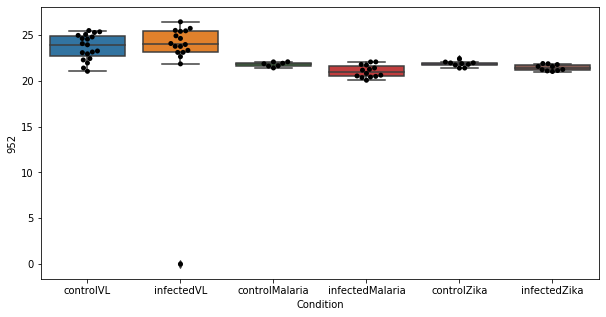

40 row m/z                                                           287.1
row retention time                                              6.92188
p-val                                                          0.109995
adj.P.Val                                                      0.872904
custom_id                                                          4050
compound_names        Formyl-N-acetyl-5-methoxykynurenamine$alpha-N-...
Name: 4050, dtype: object


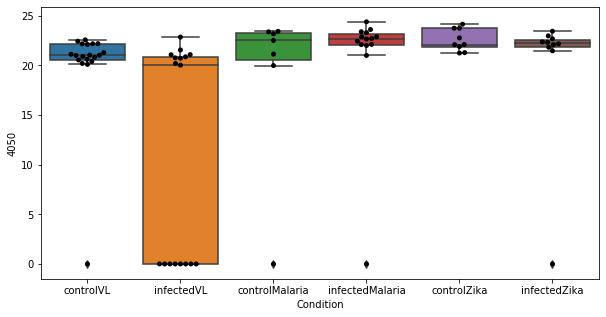

41 row m/z                               190.086
row retention time                    6.91912
p-val                                 0.11035
adj.P.Val                            0.872904
custom_id                                1229
compound_names        methyl indole-3-acetate
Name: 1229, dtype: object


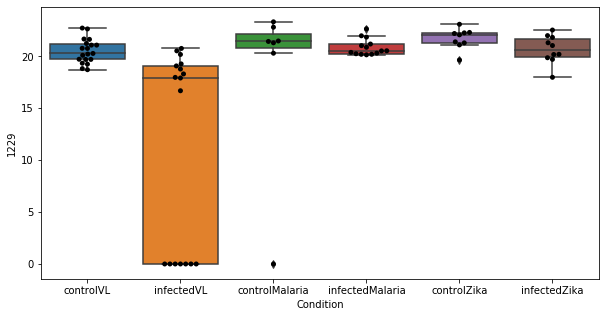

42 row m/z                                                          139.05
row retention time                                              7.27239
p-val                                                           0.11292
adj.P.Val                                                      0.872904
custom_id                                                           499
compound_names        4-Imidazolone-5-propanoate; 4-Imidazolone-5-pr...
Name: 499, dtype: object


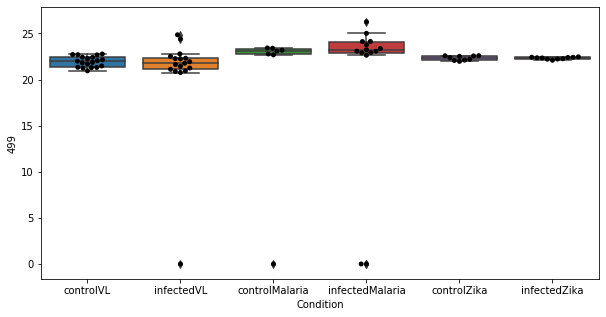

43 row m/z                107.086
row retention time     4.64626
p-val                 0.113787
adj.P.Val             0.872904
custom_id                  156
compound_names             NaN
Name: 156, dtype: object


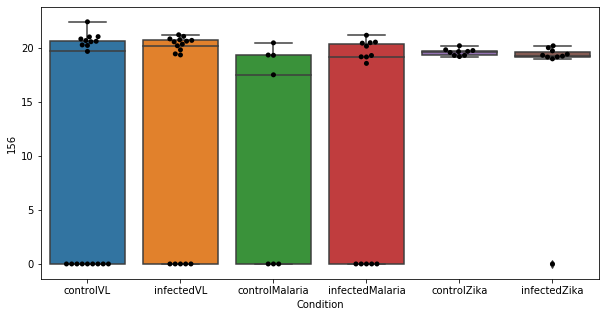

44 row m/z                139.018
row retention time     4.88022
p-val                 0.114521
adj.P.Val             0.872904
custom_id                  497
compound_names             NaN
Name: 497, dtype: object


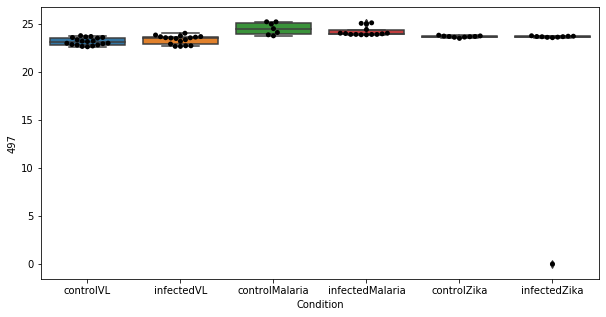

45 row m/z                         134.06
row retention time              7.9154
p-val                         0.119499
adj.P.Val                     0.891046
custom_id                         3336
compound_names        leukoaminochrome
Name: 3336, dtype: object


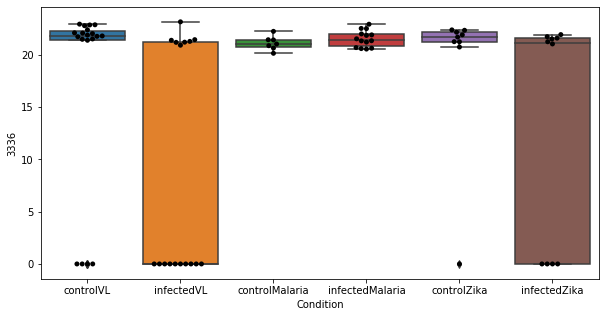

46 row m/z               575.467
row retention time    3.17961
p-val                 0.12676
adj.P.Val             0.91932
custom_id                2767
compound_names            NaN
Name: 2767, dtype: object


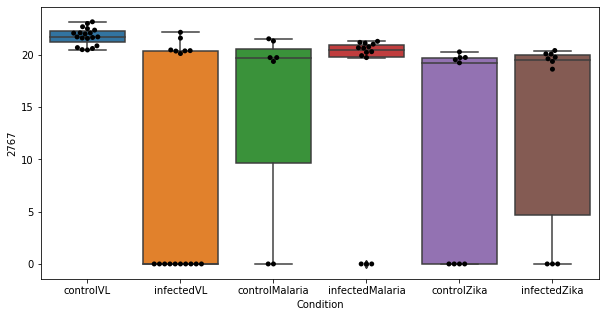

47 row m/z                185.129
row retention time     4.66153
p-val                 0.129224
adj.P.Val              0.91932
custom_id                 1150
compound_names             NaN
Name: 1150, dtype: object


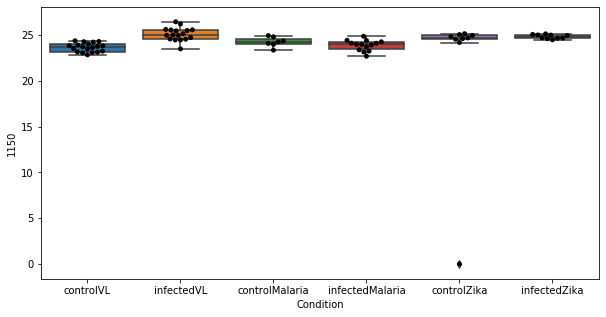

48 row m/z                 82.945
row retention time     4.84215
p-val                 0.134632
adj.P.Val              0.91932
custom_id                   35
compound_names             NaN
Name: 35, dtype: object


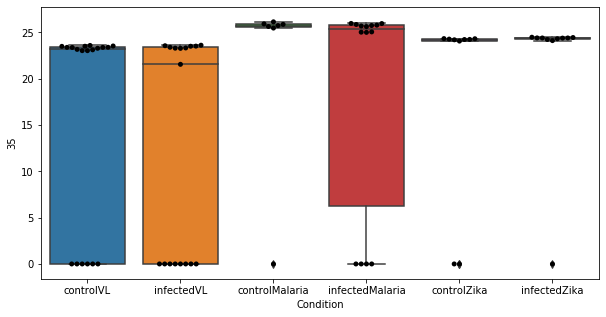

49 row m/z                186.132
row retention time     4.65008
p-val                 0.136671
adj.P.Val              0.91932
custom_id                 1158
compound_names             NaN
Name: 1158, dtype: object


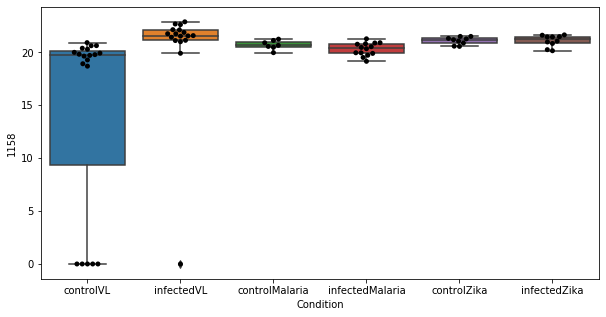

50 row m/z                545.343
row retention time     3.88327
p-val                 0.136692
adj.P.Val              0.91932
custom_id                 2745
compound_names             NaN
Name: 2745, dtype: object


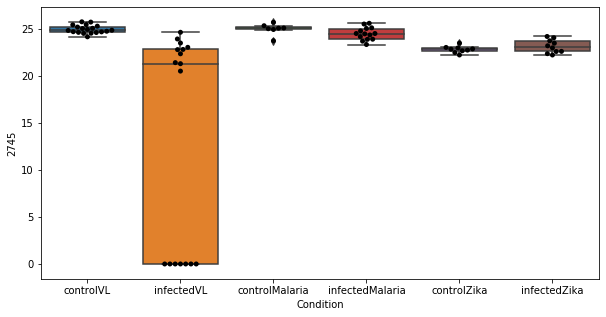

51 row m/z                191.128
row retention time     4.27826
p-val                 0.146399
adj.P.Val              0.94162
custom_id                 1246
compound_names             NaN
Name: 1246, dtype: object


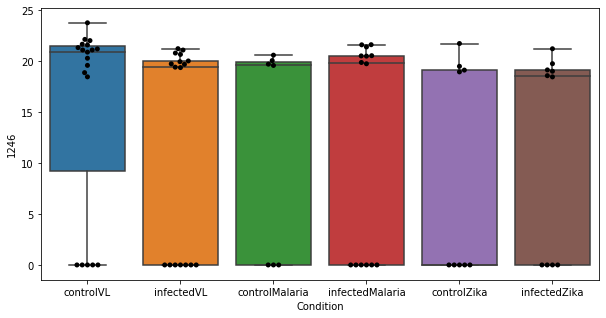

52 row m/z                                                          496.34
row retention time                                               6.8835
p-val                                                          0.146506
adj.P.Val                                                       0.94162
custom_id                                                          2697
compound_names        docosa-4,7,10,13,16-pentaenoyl carnitine$clupa...
Name: 2697, dtype: object


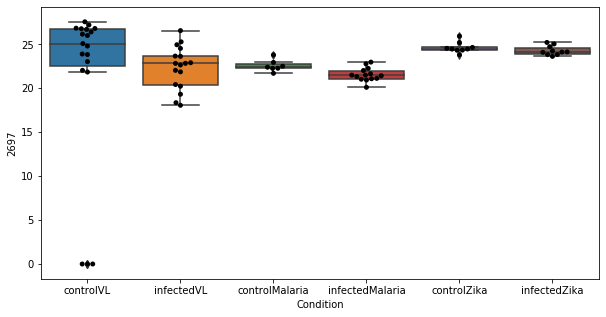

53 row m/z                                                          130.05
row retention time                                              6.91632
p-val                                                          0.148243
adj.P.Val                                                       0.94162
custom_id                                                           367
compound_names        L-4-Hydroxyglutamate semialdehyde$D-Glutamate;...
Name: 367, dtype: object


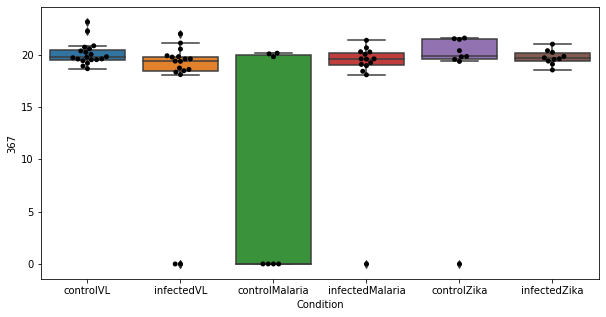

54 row m/z                497.343
row retention time     6.88527
p-val                 0.151921
adj.P.Val             0.947436
custom_id                 2699
compound_names             NaN
Name: 2699, dtype: object


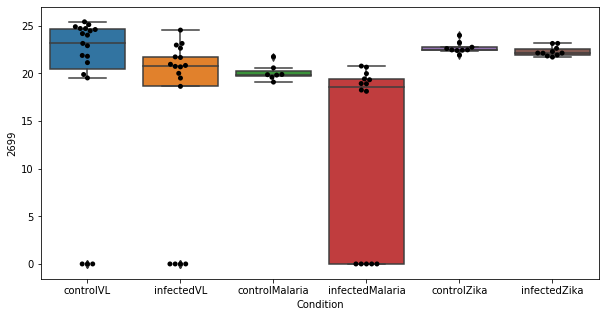

55 row m/z                292.908
row retention time     13.6117
p-val                 0.161855
adj.P.Val             0.991364
custom_id                 2265
compound_names             NaN
Name: 2265, dtype: object


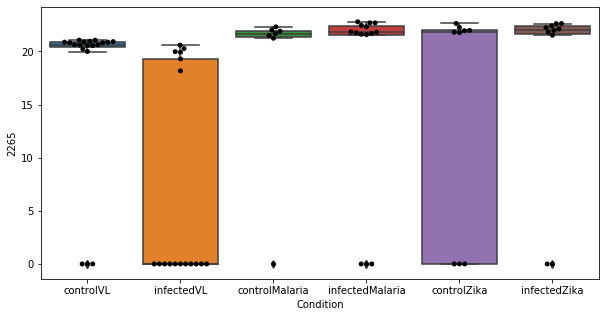

56 row m/z                759.636
row retention time     3.61749
p-val                 0.169743
adj.P.Val             0.994397
custom_id                 4291
compound_names             NaN
Name: 4291, dtype: object


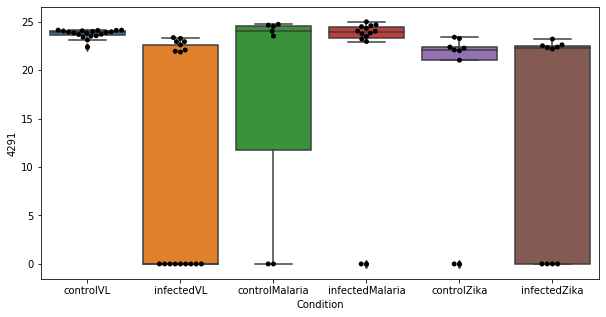

57 row m/z                 544.34
row retention time     3.88333
p-val                 0.169821
adj.P.Val             0.994397
custom_id                 2744
compound_names             NaN
Name: 2744, dtype: object


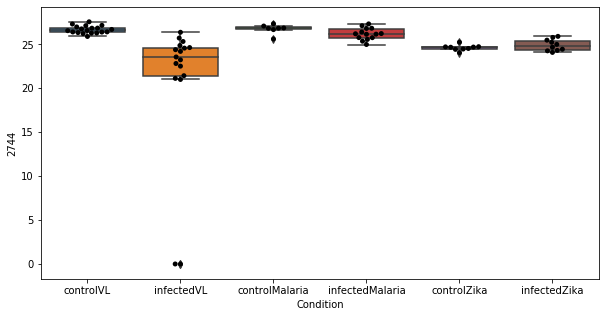

58 row m/z                176.038
row retention time     6.92112
p-val                 0.171048
adj.P.Val             0.994397
custom_id                 1031
compound_names             NaN
Name: 1031, dtype: object


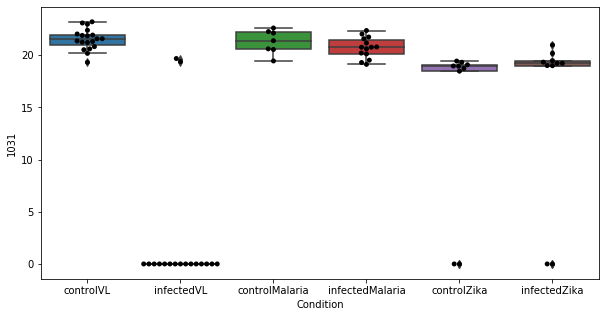

59 row m/z                                                157.097
row retention time                                     6.94511
p-val                                                 0.180814
adj.P.Val                                             0.994953
custom_id                                                  761
compound_names        N-Acetylornithine; N2-Acetyl-L-ornithine
Name: 761, dtype: object


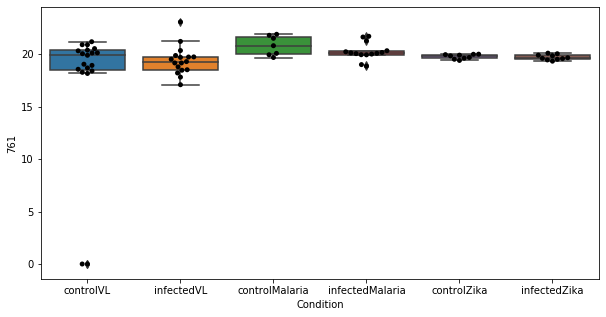

60 row m/z                195.113
row retention time     4.66905
p-val                 0.181403
adj.P.Val             0.994953
custom_id                 1315
compound_names             NaN
Name: 1315, dtype: object


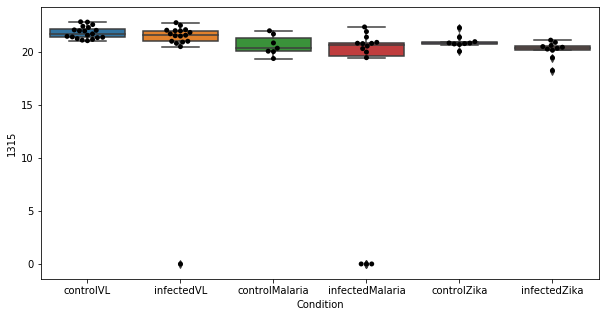

61 row m/z                610.504
row retention time     3.22014
p-val                 0.186512
adj.P.Val             0.994953
custom_id                 2793
compound_names             NaN
Name: 2793, dtype: object


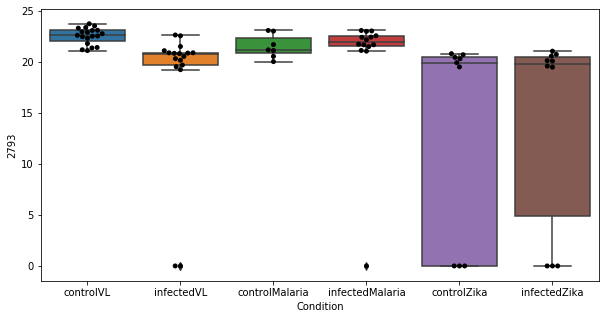

62 row m/z                315.236
row retention time     4.55513
p-val                 0.196794
adj.P.Val             0.994953
custom_id                 2378
compound_names             NaN
Name: 2378, dtype: object


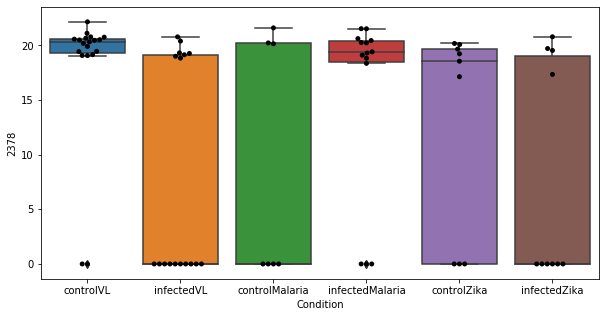

63 row m/z                189.074
row retention time     10.1076
p-val                 0.207004
adj.P.Val             0.994953
custom_id                 1205
compound_names             NaN
Name: 1205, dtype: object


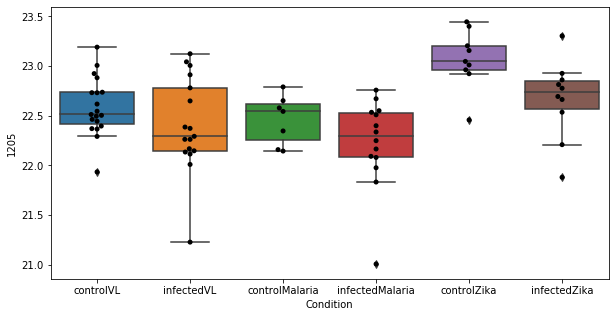

64 row m/z                199.108
row retention time     6.95422
p-val                 0.207779
adj.P.Val             0.994953
custom_id                 4868
compound_names             NaN
Name: 4868, dtype: object


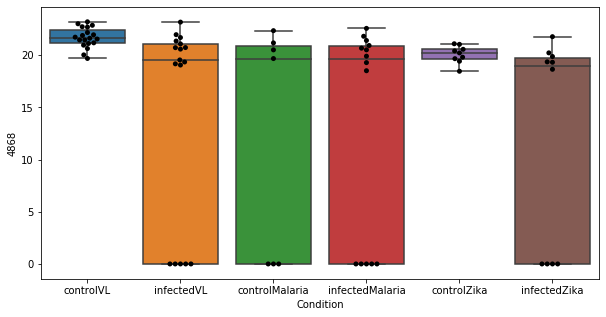

65 row m/z                                                         123.055
row retention time                                              6.92524
p-val                                                          0.215564
adj.P.Val                                                      0.994953
custom_id                                                           298
compound_names        Nicotinamide; Nicotinic acid amide; Niacinamid...
Name: 298, dtype: object


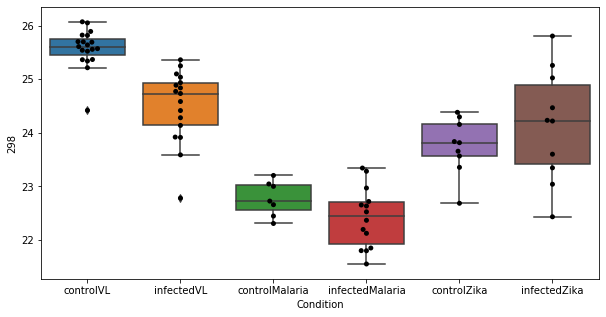

66 row m/z                                                         188.092
row retention time                                              4.66679
p-val                                                           0.21925
adj.P.Val                                                      0.994953
custom_id                                                          1192
compound_names        6-Acetamido-2-oxohexanoate; 2-Oxo-6-acetamidoc...
Name: 1192, dtype: object


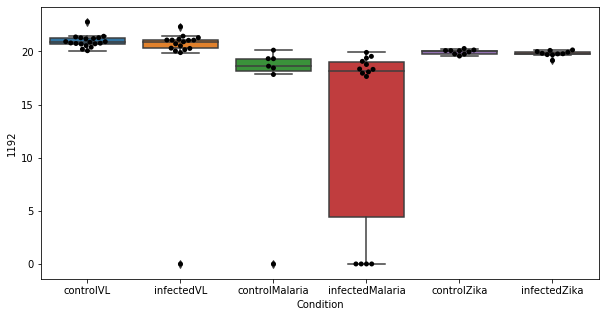

67 row m/z                                                         265.118
row retention time                                              4.59098
p-val                                                          0.222011
adj.P.Val                                                      0.994953
custom_id                                                          3995
compound_names        Formyl-N-acetyl-5-methoxykynurenamine$alpha-N-...
Name: 3995, dtype: object


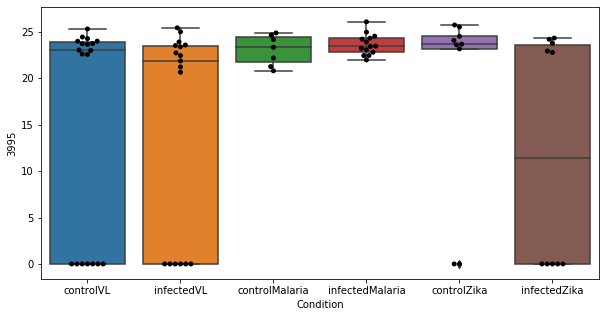

68 row m/z                159.157
row retention time     3.77927
p-val                 0.222292
adj.P.Val             0.994953
custom_id                  810
compound_names             NaN
Name: 810, dtype: object


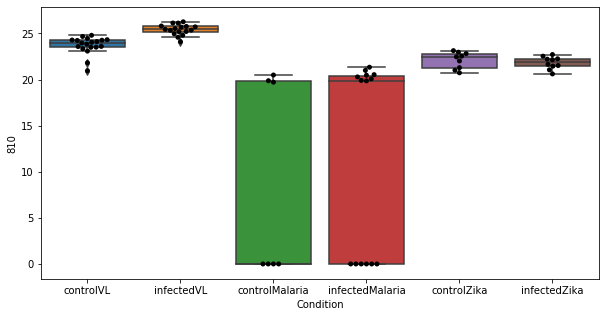

69 row m/z                142.123
row retention time     3.97292
p-val                 0.222468
adj.P.Val             0.994953
custom_id                  535
compound_names             NaN
Name: 535, dtype: object


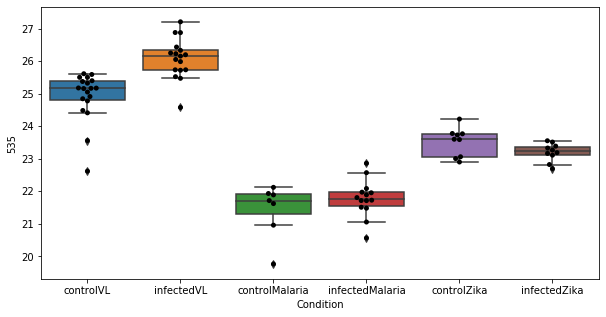

70 row m/z                                                         380.256
row retention time                                              6.91039
p-val                                                          0.223193
adj.P.Val                                                      0.994953
custom_id                                                          2549
compound_names        Sphingosine 1-phosphate; Sphing-4-enine 1-phos...
Name: 2549, dtype: object


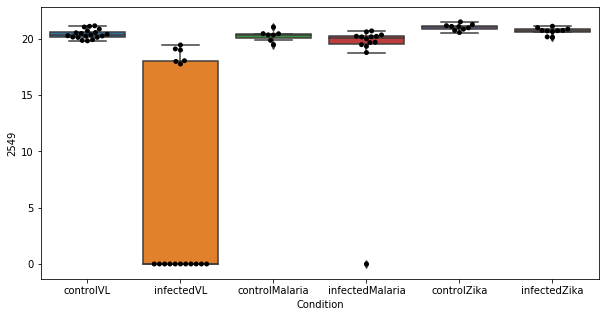

71 row m/z                                                   186.113
row retention time                                        6.91988
p-val                                                    0.225048
adj.P.Val                                                0.994953
custom_id                                                    1155
compound_names        3-Methoxytyramine$Epinine; Deoxyepinephrine
Name: 1155, dtype: object


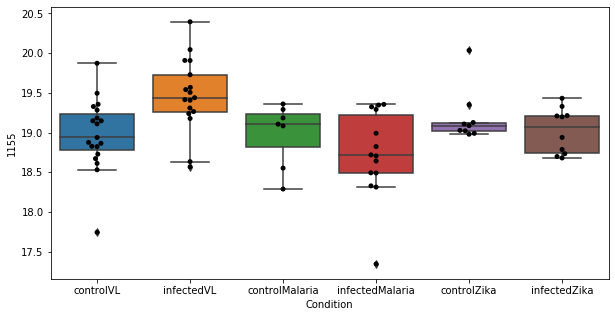

72 row m/z                 84.942
row retention time      4.8113
p-val                 0.225983
adj.P.Val             0.994953
custom_id                   43
compound_names             NaN
Name: 43, dtype: object


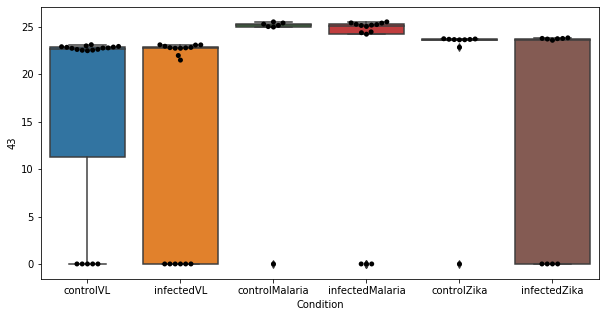

73 row m/z                 880.59
row retention time     3.18656
p-val                 0.234369
adj.P.Val             0.994953
custom_id                 3083
compound_names             NaN
Name: 3083, dtype: object


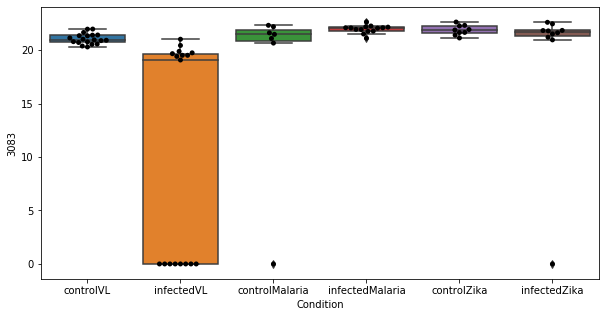

74 row m/z                334.295
row retention time      3.1963
p-val                 0.249597
adj.P.Val             0.994953
custom_id                 2445
compound_names             NaN
Name: 2445, dtype: object


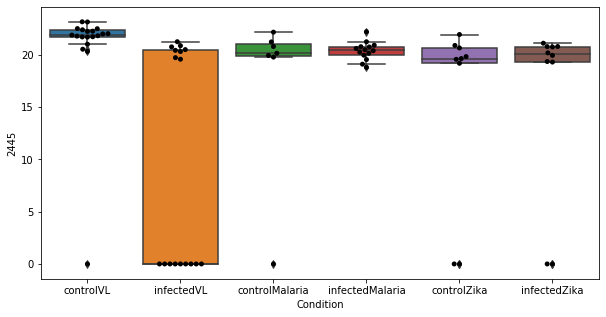

75 row m/z                                                         128.071
row retention time                                              6.93976
p-val                                                          0.251741
adj.P.Val                                                      0.994953
custom_id                                                          5895
compound_names        6-Amino-2-oxohexanoate; 2-Oxo-6-aminocaproate$...
Name: 5895, dtype: object


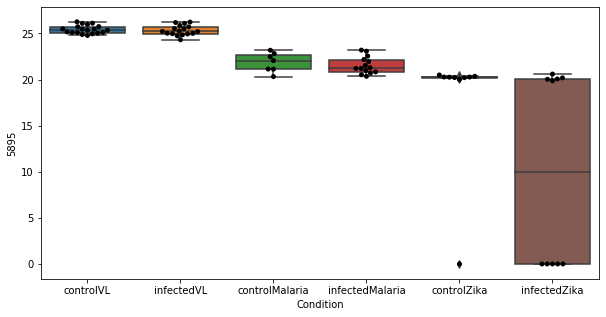

76 row m/z                592.493
row retention time     3.16935
p-val                 0.252607
adj.P.Val             0.994953
custom_id                 2779
compound_names             NaN
Name: 2779, dtype: object


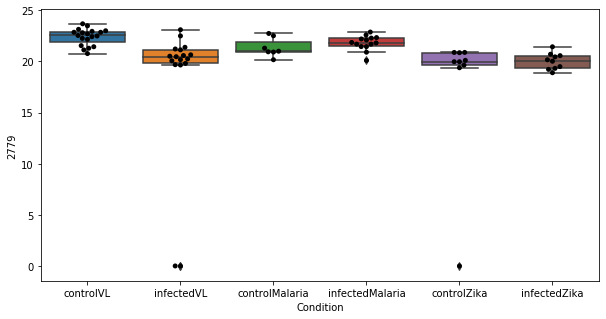

77 row m/z                141.091
row retention time     4.60711
p-val                  0.25466
adj.P.Val             0.994953
custom_id                  518
compound_names             NaN
Name: 518, dtype: object


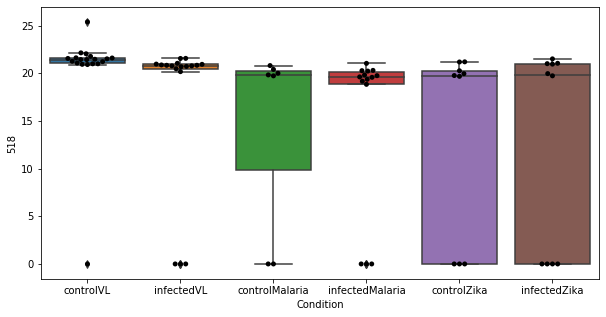

78 row m/z                                                         114.055
row retention time                                              6.93888
p-val                                                          0.262833
adj.P.Val                                                      0.994953
custom_id                                                           181
compound_names        1-Pyrroline-2-carboxylate; 1-Pyrroline-2-carbo...
Name: 181, dtype: object


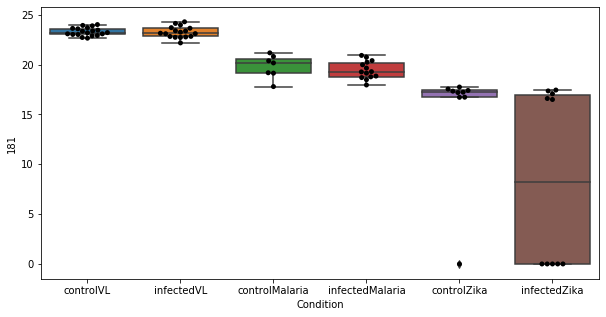

79 row m/z                                                         380.256
row retention time                                              4.40066
p-val                                                          0.265338
adj.P.Val                                                      0.994953
custom_id                                                          2548
compound_names        Sphingosine 1-phosphate; Sphing-4-enine 1-phos...
Name: 2548, dtype: object


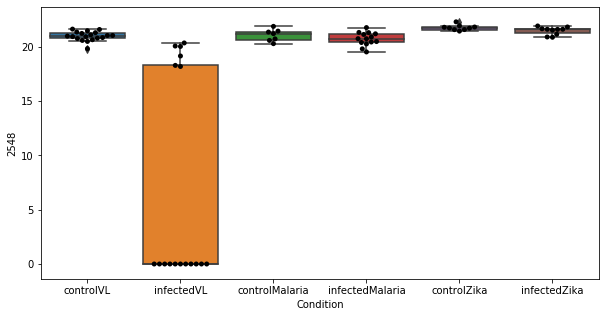

80 row m/z                           310.201
row retention time                  4.599
p-val                            0.272819
adj.P.Val                        0.994953
custom_id                            2351
compound_names        L-Octanoylcarnitine
Name: 2351, dtype: object


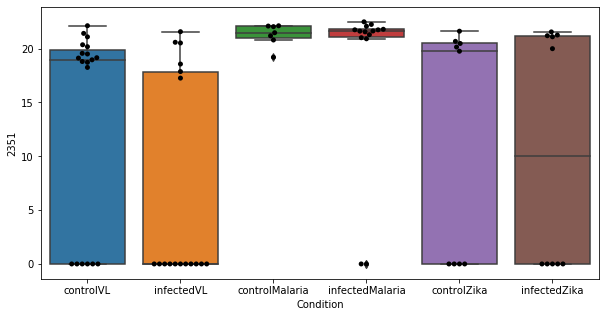

81 row m/z                     167.107
row retention time          4.61638
p-val                      0.274825
adj.P.Val                  0.994953
custom_id                       908
compound_names        Perillic acid
Name: 908, dtype: object


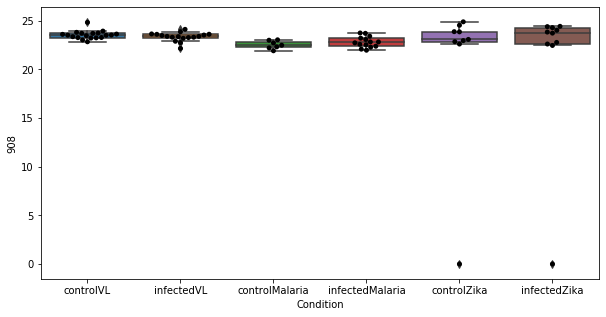

82 row m/z                                                         130.065
row retention time                                              6.91368
p-val                                                          0.276181
adj.P.Val                                                      0.994953
custom_id                                                          3306
compound_names        L-Phenylalanine; (S)-alpha-Amino-beta-phenylpr...
Name: 3306, dtype: object


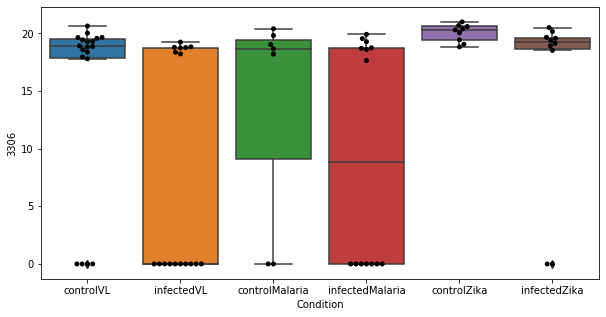

83 row m/z                199.181
row retention time     3.78776
p-val                 0.276503
adj.P.Val             0.994953
custom_id                 1360
compound_names             NaN
Name: 1360, dtype: object


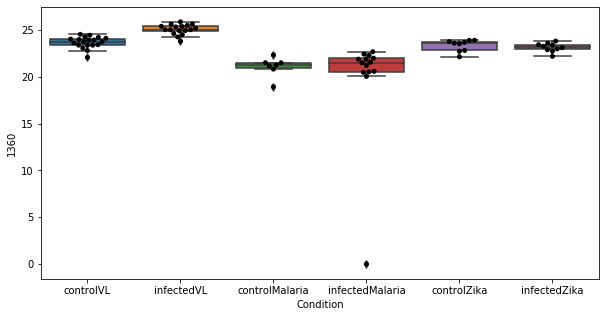

84 row m/z                244.191
row retention time      4.0302
p-val                 0.276942
adj.P.Val             0.994953
custom_id                 1870
compound_names             NaN
Name: 1870, dtype: object


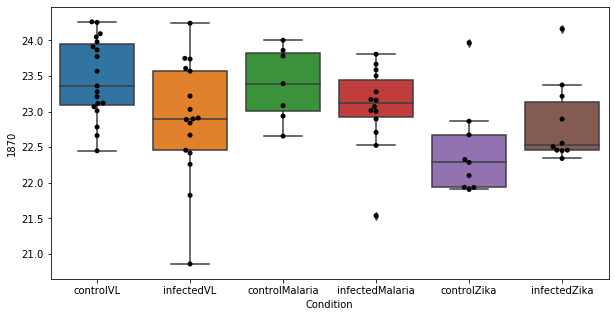

85 row m/z                795.609
row retention time     3.34719
p-val                 0.282712
adj.P.Val             0.994953
custom_id                 2961
compound_names             NaN
Name: 2961, dtype: object


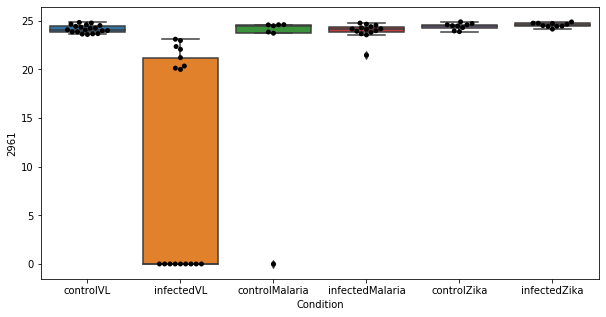

86 row m/z                                                         154.05
row retention time                                             6.92014
p-val                                                         0.284441
adj.P.Val                                                     0.994953
custom_id                                                          712
compound_names        3-Hydroxyanthranilate; 3-Hydroxyanthranilic acid
Name: 712, dtype: object


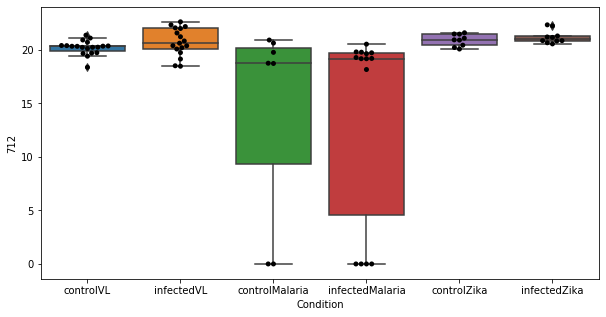

87 row m/z                681.483
row retention time     3.26351
p-val                 0.287601
adj.P.Val             0.994953
custom_id                 2835
compound_names             NaN
Name: 2835, dtype: object


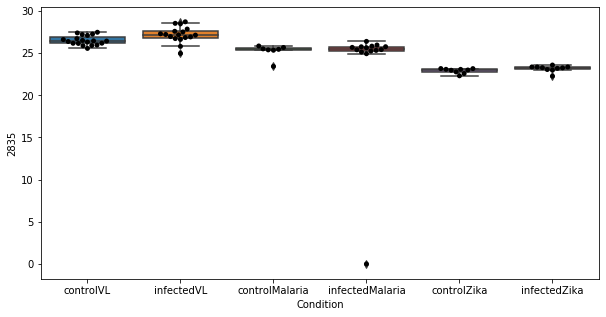

88 row m/z                835.603
row retention time     3.32843
p-val                 0.309219
adj.P.Val             0.994953
custom_id                 3026
compound_names             NaN
Name: 3026, dtype: object


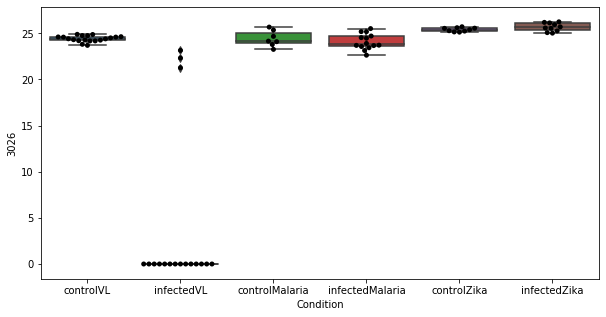

89 row m/z                454.293
row retention time     4.00186
p-val                 0.311804
adj.P.Val             0.994953
custom_id                 2654
compound_names             NaN
Name: 2654, dtype: object


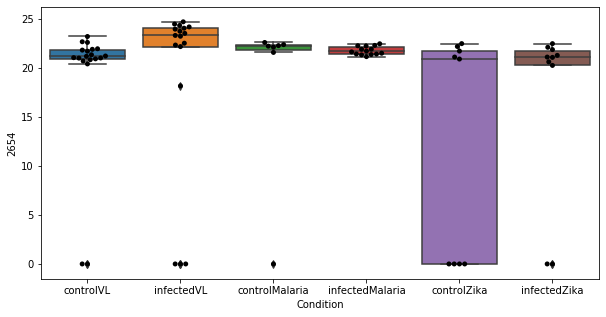

90 row m/z                                             190.05
row retention time                                 6.92017
p-val                                             0.312693
adj.P.Val                                         0.994953
custom_id                                             1221
compound_names        4-(2-Aminophenyl)-2,4-dioxobutanoate
Name: 1221, dtype: object


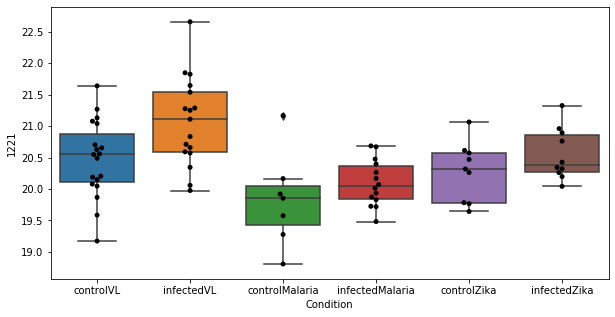

91 row m/z                161.092
row retention time     6.91478
p-val                 0.313862
adj.P.Val             0.994953
custom_id                  835
compound_names             NaN
Name: 835, dtype: object


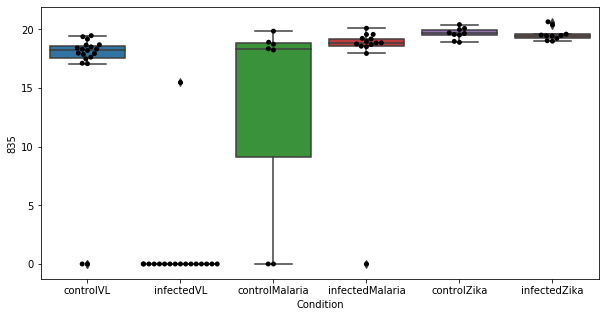

92 row m/z                      194.082
row retention time           4.65868
p-val                       0.315089
adj.P.Val                   0.994953
custom_id                       3661
compound_names        3-O-methyldopa
Name: 3661, dtype: object


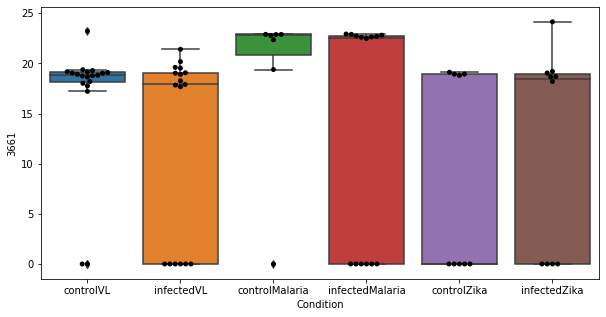

93 row m/z                                                   168.102
row retention time                                        6.93102
p-val                                                     0.31649
adj.P.Val                                                0.994953
custom_id                                                    4731
compound_names        3-Methoxytyramine$Epinine; Deoxyepinephrine
Name: 4731, dtype: object


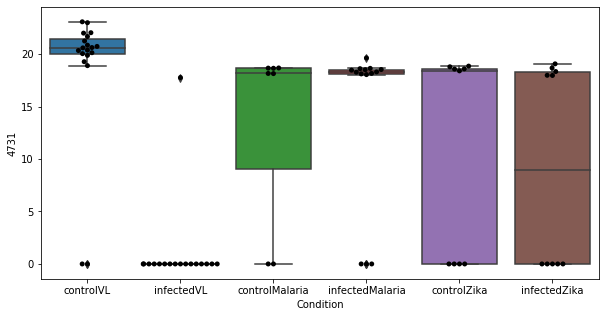

94 row m/z                280.235
row retention time     3.26646
p-val                 0.317712
adj.P.Val             0.994953
custom_id                 2175
compound_names             NaN
Name: 2175, dtype: object


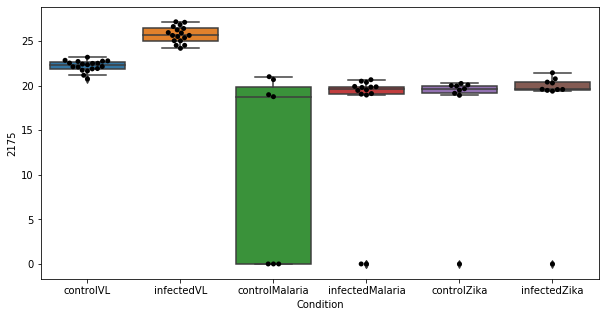

95 row m/z                597.509
row retention time     3.18878
p-val                 0.319248
adj.P.Val             0.994953
custom_id                 4263
compound_names             NaN
Name: 4263, dtype: object


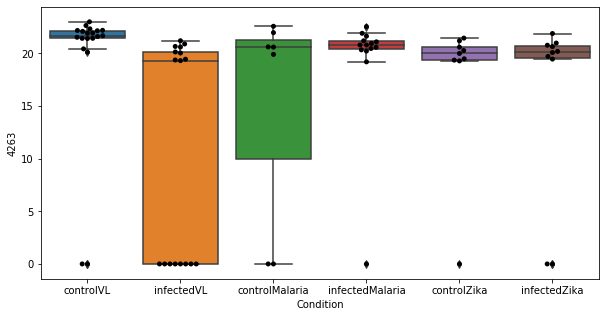

96 row m/z                                                         265.118
row retention time                                              6.92044
p-val                                                          0.319508
adj.P.Val                                                      0.994953
custom_id                                                          2038
compound_names        Formyl-N-acetyl-5-methoxykynurenamine$alpha-N-...
Name: 2038, dtype: object


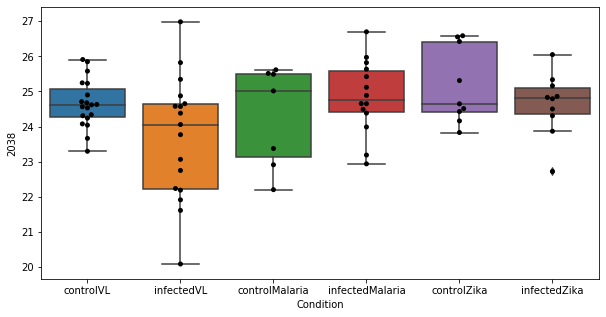

97 row m/z                127.087
row retention time     6.90739
p-val                 0.328534
adj.P.Val             0.994953
custom_id                  330
compound_names             NaN
Name: 330, dtype: object


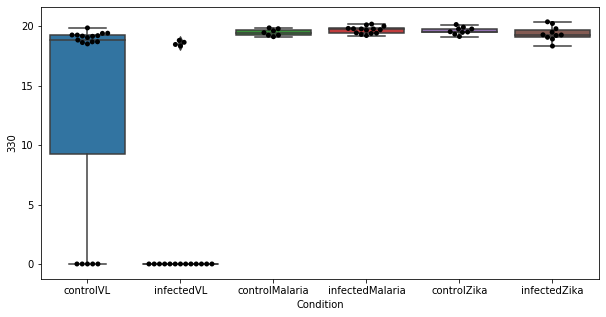

98 row m/z                239.164
row retention time     3.70425
p-val                 0.330995
adj.P.Val             0.994953
custom_id                 1829
compound_names             NaN
Name: 1829, dtype: object


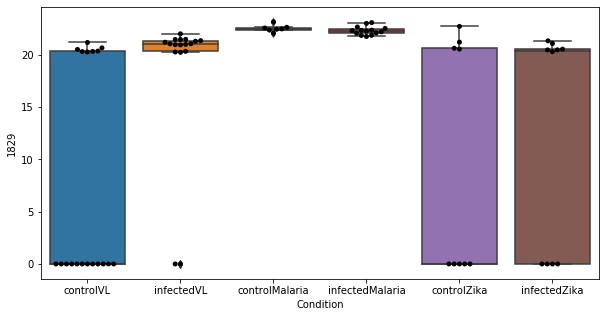

99 row m/z                781.556
row retention time     3.39359
p-val                   0.3328
adj.P.Val             0.994953
custom_id                 2934
compound_names             NaN
Name: 2934, dtype: object


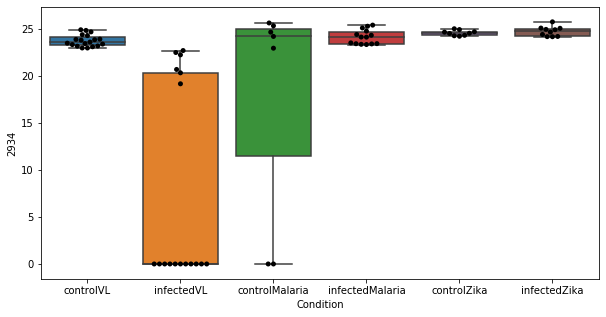

100 row m/z                772.584
row retention time     3.38728
p-val                 0.340366
adj.P.Val             0.994953
custom_id                 2923
compound_names             NaN
Name: 2923, dtype: object


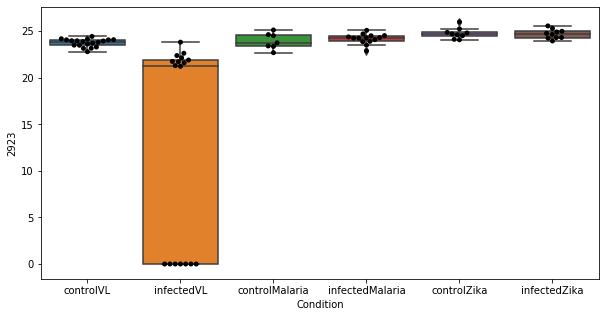

101 row m/z                188.128
row retention time     4.59117
p-val                 0.348711
adj.P.Val             0.994953
custom_id                 1195
compound_names             NaN
Name: 1195, dtype: object


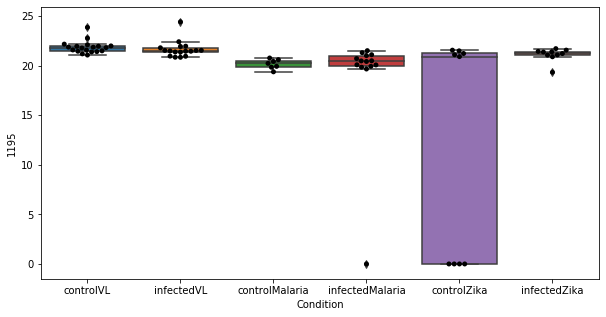

102 row m/z                746.604
row retention time     3.33938
p-val                 0.357947
adj.P.Val             0.994953
custom_id                 2883
compound_names             NaN
Name: 2883, dtype: object


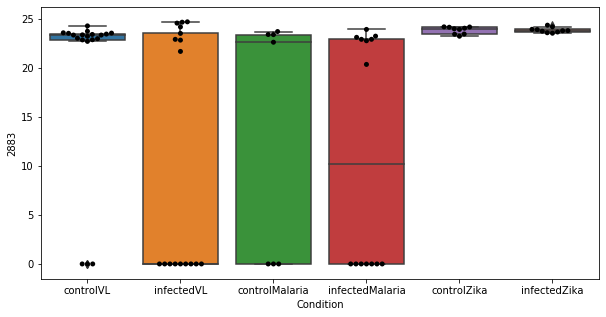

103 row m/z                170.118
row retention time     4.54143
p-val                 0.364341
adj.P.Val             0.994953
custom_id                  943
compound_names             NaN
Name: 943, dtype: object


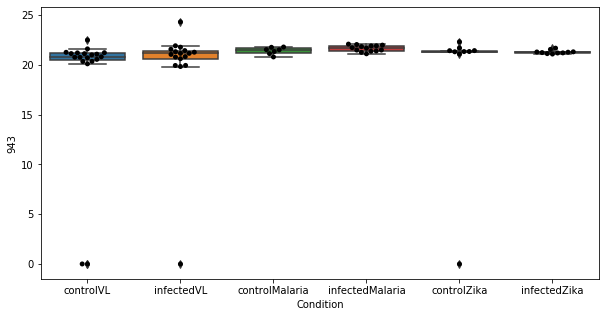

104 row m/z                546.355
row retention time     3.84509
p-val                 0.374388
adj.P.Val             0.994953
custom_id                 2746
compound_names             NaN
Name: 2746, dtype: object


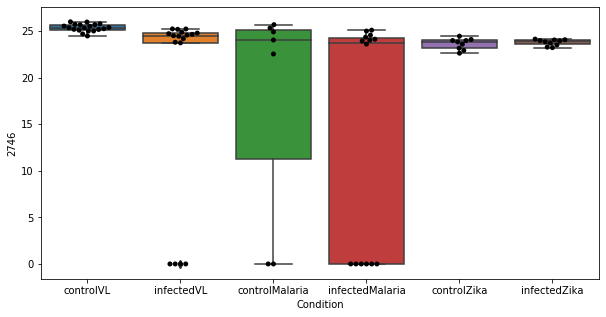

105 row m/z                512.335
row retention time     4.37208
p-val                 0.375933
adj.P.Val             0.994953
custom_id                 4243
compound_names             NaN
Name: 4243, dtype: object


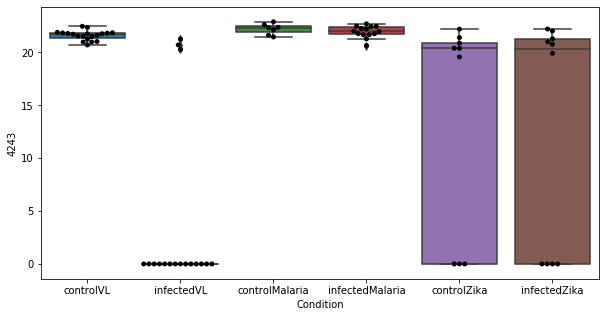

106 row m/z                                                424.342
row retention time                                     3.88592
p-val                                                 0.377611
adj.P.Val                                             0.994953
custom_id                                                 2620
compound_names        Linoleyl carnitine$Linoelaidyl carnitine
Name: 2620, dtype: object


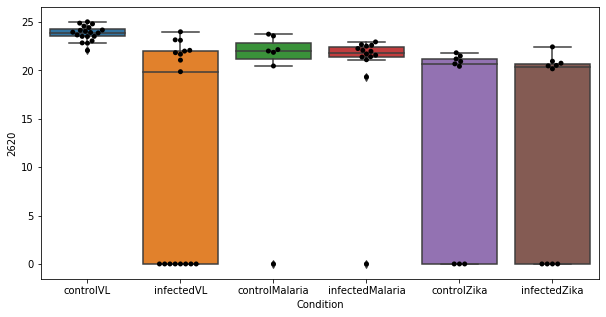

107 row m/z                                                         115.087
row retention time                                              16.4337
p-val                                                          0.393071
adj.P.Val                                                      0.994953
custom_id                                                           197
compound_names        L-Ornithine; (S)-2,5-Diaminovaleric acid; (S)-...
Name: 197, dtype: object


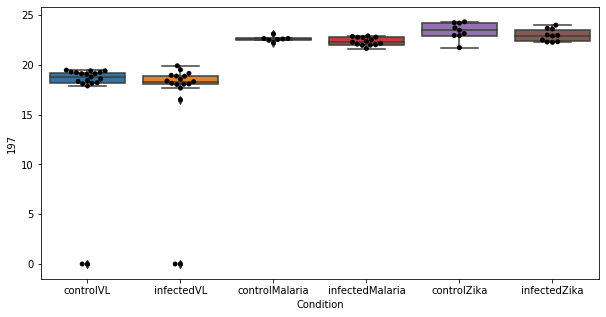

108 row m/z                122.006
row retention time     4.92553
p-val                 0.398843
adj.P.Val             0.994953
custom_id                  280
compound_names             NaN
Name: 280, dtype: object


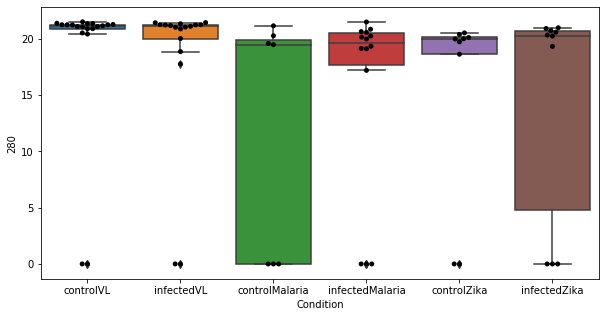

109 row m/z                                                         147.077
row retention time                                              12.0228
p-val                                                          0.403151
adj.P.Val                                                      0.994953
custom_id                                                           613
compound_names        D-Glutamine; D-2-Aminoglutaramic acid$L-Glutam...
Name: 613, dtype: object


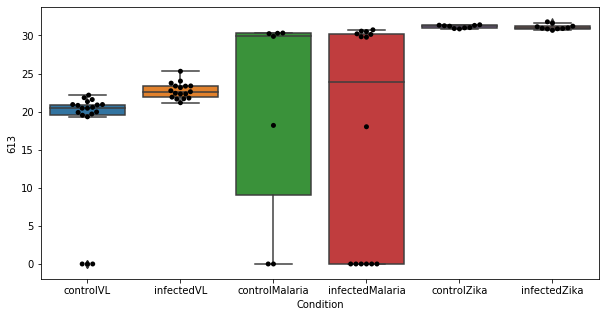

110 row m/z                193.095
row retention time     4.80088
p-val                 0.407798
adj.P.Val             0.994953
custom_id                 1271
compound_names             NaN
Name: 1271, dtype: object


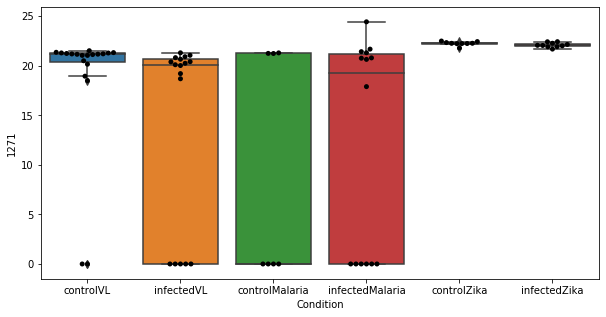

111 row m/z                223.097
row retention time     3.66928
p-val                 0.416171
adj.P.Val             0.994953
custom_id                 1642
compound_names             NaN
Name: 1642, dtype: object


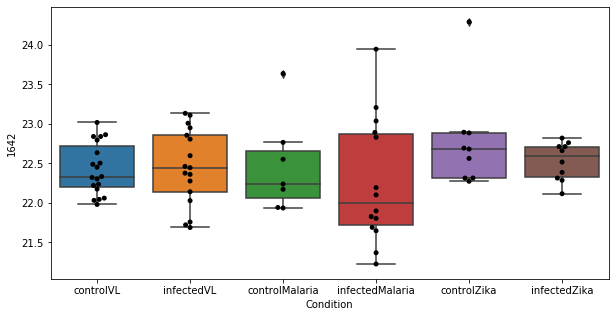

112 row m/z                613.523
row retention time      3.1892
p-val                 0.423748
adj.P.Val             0.994953
custom_id                 2798
compound_names             NaN
Name: 2798, dtype: object


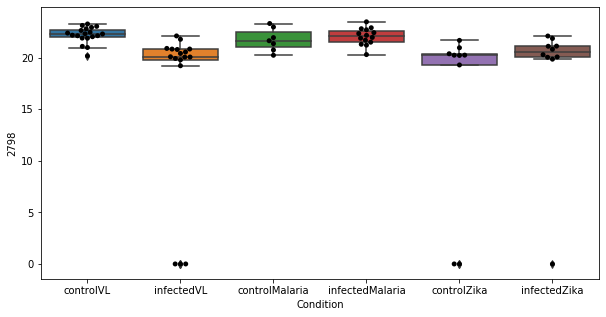

113 row m/z                  834.6
row retention time     3.32996
p-val                 0.430495
adj.P.Val             0.994953
custom_id                 3025
compound_names             NaN
Name: 3025, dtype: object


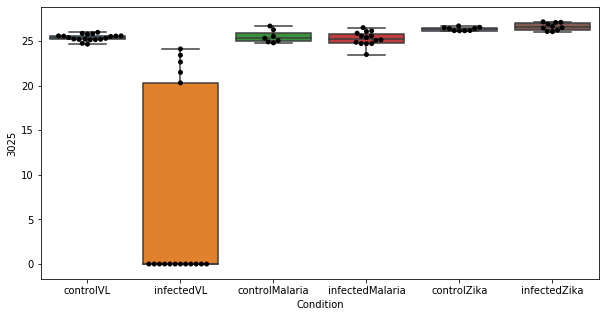

114 row m/z                811.604
row retention time     3.35237
p-val                 0.430899
adj.P.Val             0.994953
custom_id                 2990
compound_names             NaN
Name: 2990, dtype: object


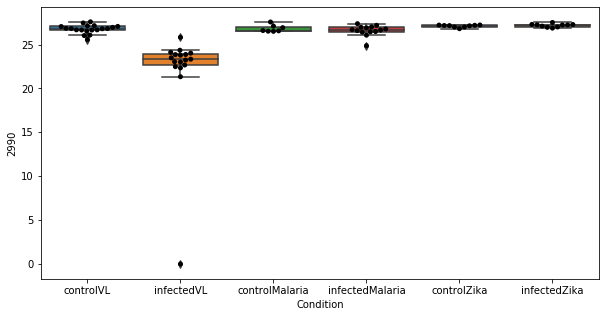

115 row m/z                220.154
row retention time     4.65061
p-val                 0.437188
adj.P.Val             0.994953
custom_id                 1627
compound_names             NaN
Name: 1627, dtype: object


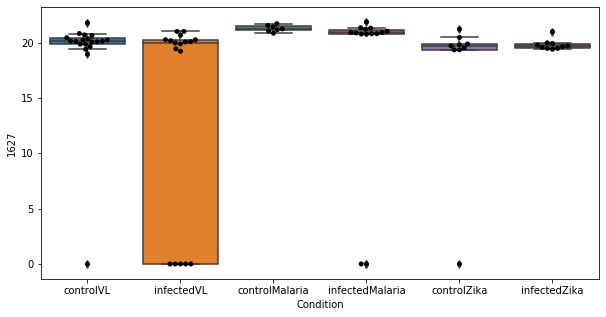

116 row m/z                239.139
row retention time     6.91089
p-val                 0.442258
adj.P.Val             0.994953
custom_id                 1821
compound_names             NaN
Name: 1821, dtype: object


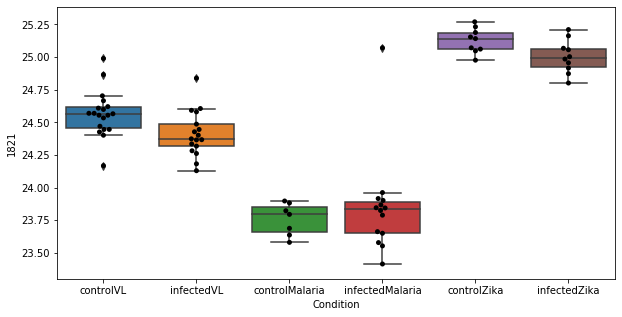

117 row m/z                469.389
row retention time     3.34427
p-val                 0.442746
adj.P.Val             0.994953
custom_id                 2667
compound_names             NaN
Name: 2667, dtype: object


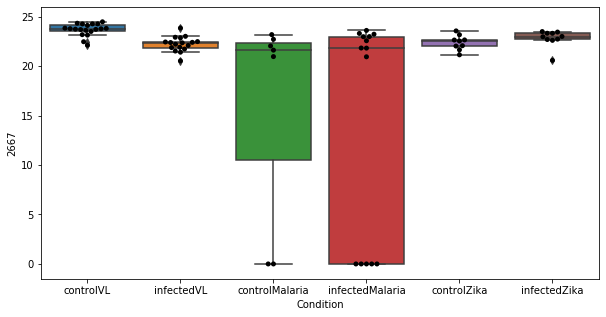

118 row m/z                 222.17
row retention time     3.65974
p-val                 0.447037
adj.P.Val             0.994953
custom_id                 1638
compound_names             NaN
Name: 1638, dtype: object


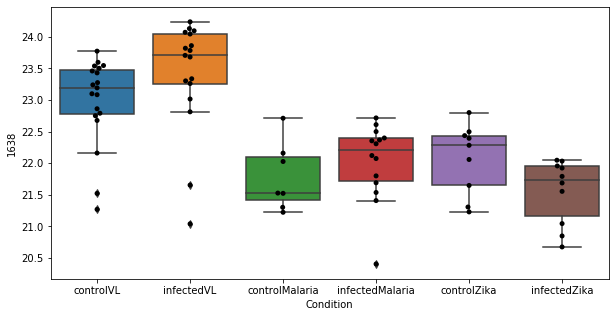

119 row m/z                228.123
row retention time     6.91735
p-val                 0.454125
adj.P.Val             0.994953
custom_id                 1684
compound_names             NaN
Name: 1684, dtype: object


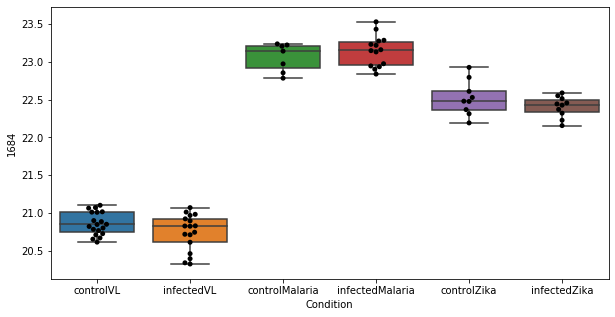

120 row m/z                615.539
row retention time     3.17514
p-val                 0.463998
adj.P.Val             0.994953
custom_id                 2800
compound_names             NaN
Name: 2800, dtype: object


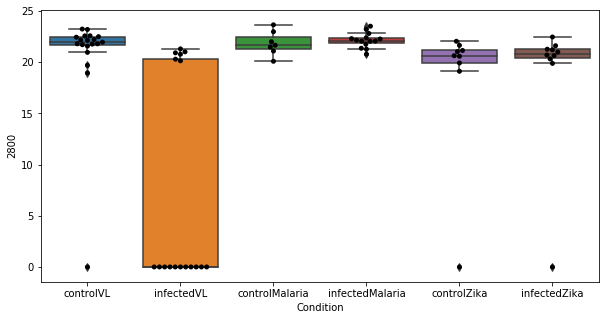

121 row m/z                232.118
row retention time     6.91686
p-val                 0.464643
adj.P.Val             0.994953
custom_id                 1751
compound_names             NaN
Name: 1751, dtype: object


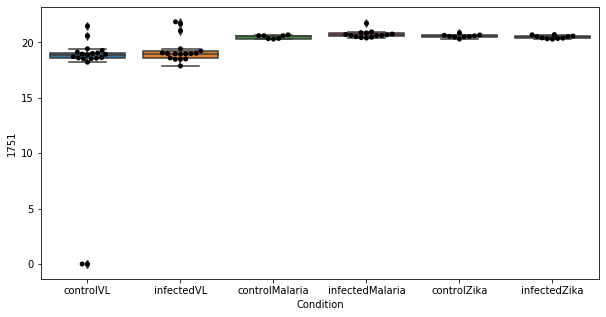

122 row m/z                246.133
row retention time     6.89831
p-val                 0.465583
adj.P.Val             0.994953
custom_id                 1889
compound_names             NaN
Name: 1889, dtype: object


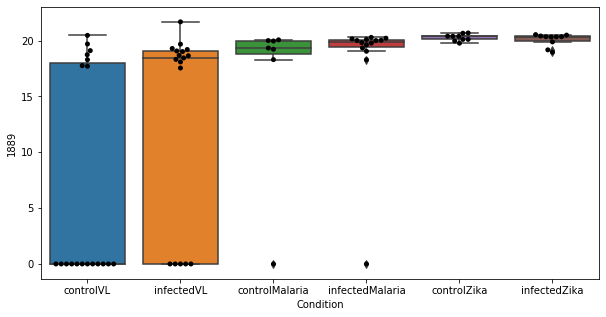

123 row m/z                                                         299.258
row retention time                                              3.27536
p-val                                                          0.465955
adj.P.Val                                                      0.994953
custom_id                                                          2289
compound_names        Linoleate; Linoleic acid; (9Z,12Z)-Octadecadie...
Name: 2289, dtype: object


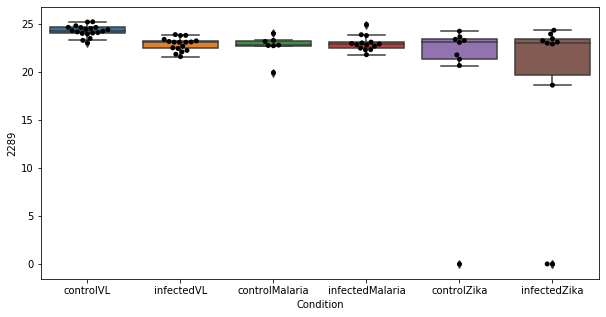

124 row m/z                183.113
row retention time     6.90372
p-val                 0.472893
adj.P.Val             0.994953
custom_id                 1122
compound_names             NaN
Name: 1122, dtype: object


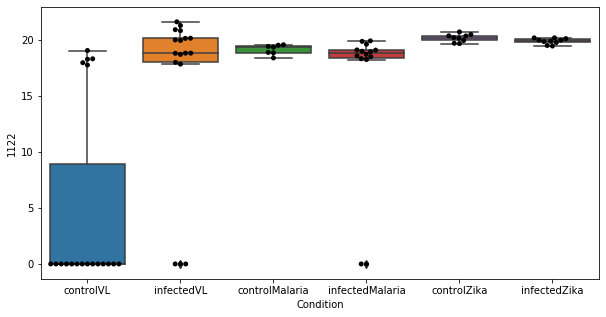

125 row m/z                                       328.248
row retention time                            4.48411
p-val                                        0.474883
adj.P.Val                                    0.994953
custom_id                                        2419
compound_names        2,6 dimethylheptanoyl carnitine
Name: 2419, dtype: object


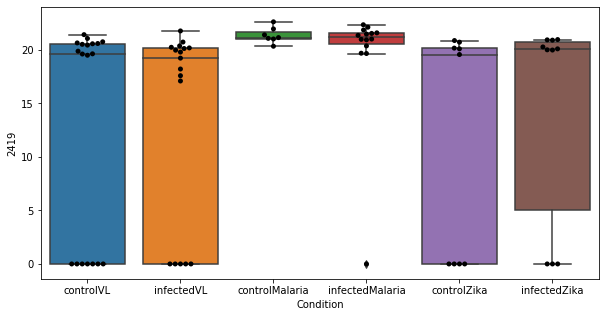

126 row m/z                195.088
row retention time     4.64363
p-val                  0.47617
adj.P.Val             0.994953
custom_id                 1306
compound_names             NaN
Name: 1306, dtype: object


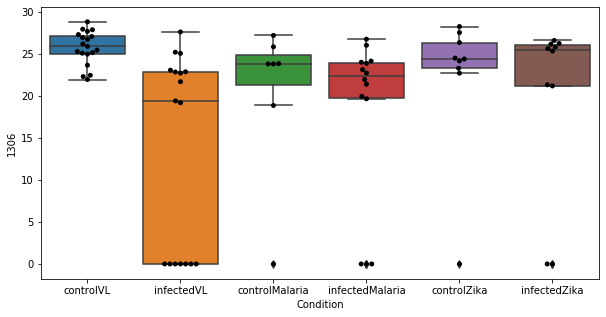

127 row m/z                  380.9
row retention time     11.8491
p-val                 0.482394
adj.P.Val             0.994953
custom_id                 2556
compound_names             NaN
Name: 2556, dtype: object


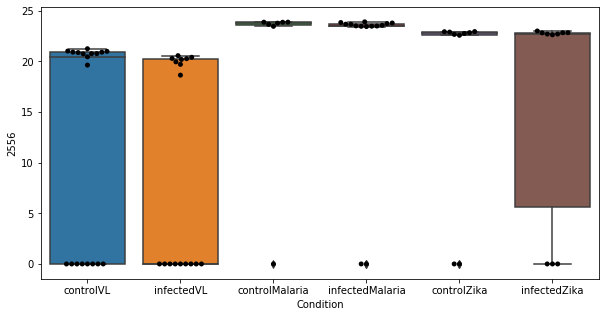

128 row m/z                            400.342
row retention time                 3.92733
p-val                             0.487278
adj.P.Val                         0.994953
custom_id                             2600
compound_names        L-Palmitoylcarnitine
Name: 2600, dtype: object


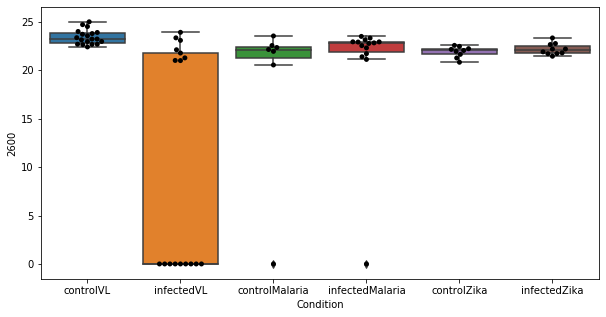

129 row m/z                807.572
row retention time     3.35729
p-val                 0.488182
adj.P.Val             0.994953
custom_id                 2982
compound_names             NaN
Name: 2982, dtype: object


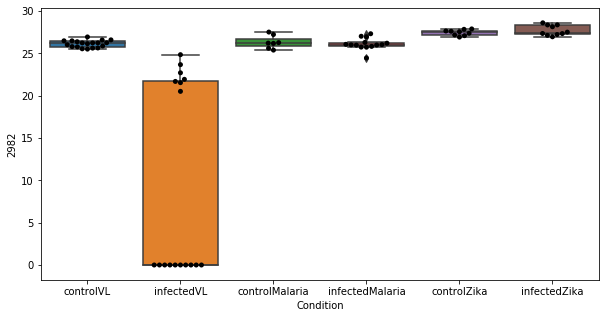

130 row m/z                  810.6
row retention time     3.35792
p-val                  0.49122
adj.P.Val             0.994953
custom_id                 2989
compound_names             NaN
Name: 2989, dtype: object


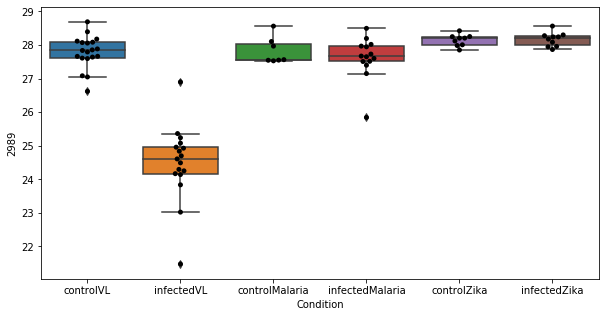

131 row m/z                156.102
row retention time     4.62477
p-val                 0.491888
adj.P.Val             0.994953
custom_id                  740
compound_names             NaN
Name: 740, dtype: object


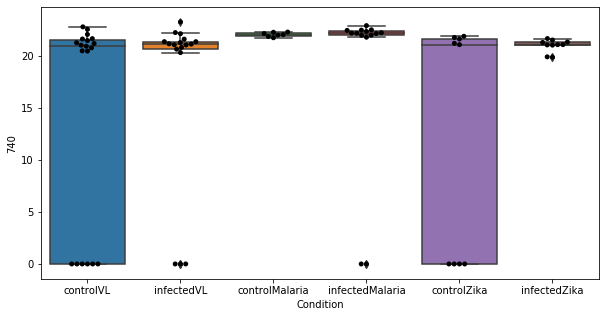

132 row m/z                308.886
row retention time     13.5871
p-val                 0.495169
adj.P.Val             0.994953
custom_id                 2344
compound_names             NaN
Name: 2344, dtype: object


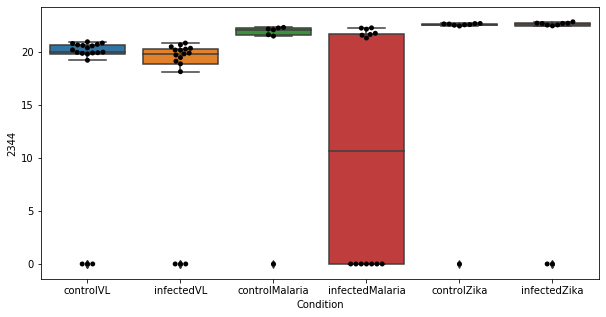

133 row m/z                786.657
row retention time     3.53422
p-val                 0.497885
adj.P.Val             0.994953
custom_id                 2943
compound_names             NaN
Name: 2943, dtype: object


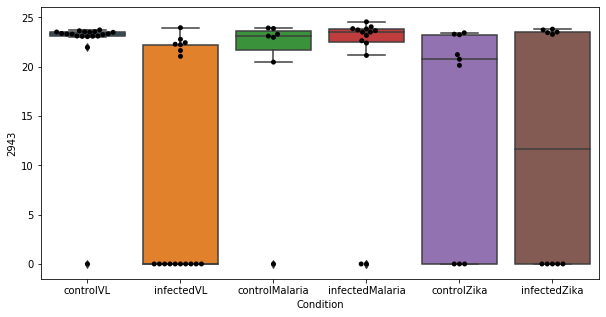

134 row m/z                214.253
row retention time     7.00936
p-val                  0.50272
adj.P.Val             0.994953
custom_id                 1544
compound_names             NaN
Name: 1544, dtype: object


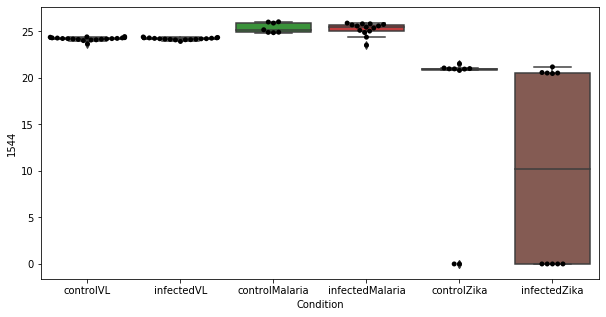

135 row m/z                664.457
row retention time     3.27808
p-val                 0.512393
adj.P.Val             0.994953
custom_id                 2825
compound_names             NaN
Name: 2825, dtype: object


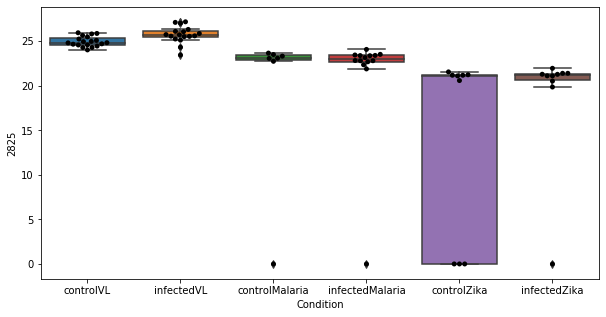

136 row m/z                792.589
row retention time     3.39208
p-val                 0.518371
adj.P.Val             0.994953
custom_id                 2958
compound_names             NaN
Name: 2958, dtype: object


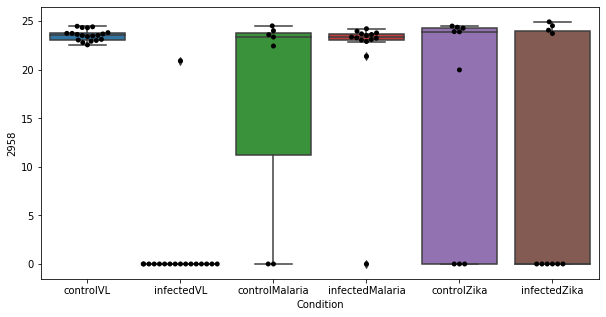

137 row m/z                162.058
row retention time     4.66308
p-val                  0.51888
adj.P.Val             0.994953
custom_id                  844
compound_names             NaN
Name: 844, dtype: object


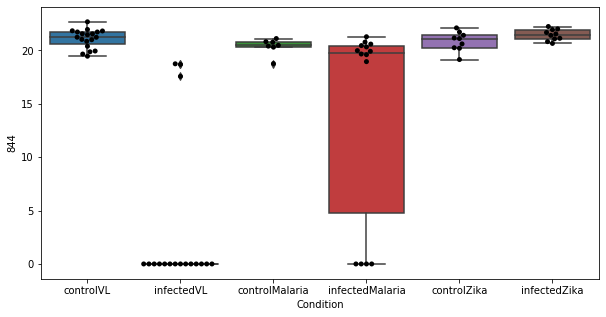

138 row m/z                                                         138.051
row retention time                                              9.36212
p-val                                                           0.52803
adj.P.Val                                                      0.994953
custom_id                                                           488
compound_names        D-Proline$L-Proline; 2-Pyrrolidinecarboxylic acid
Name: 488, dtype: object


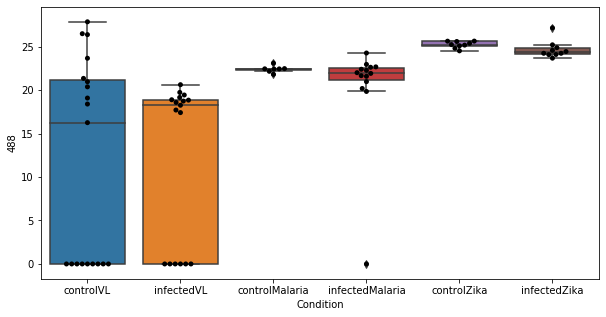

139 row m/z                                                         244.079
row retention time                                              12.2942
p-val                                                          0.534195
adj.P.Val                                                      0.994953
custom_id                                                          1862
compound_names        N-Acetyl-D-mannosamine; 2-Acetamido-2-deoxy-D-...
Name: 1862, dtype: object


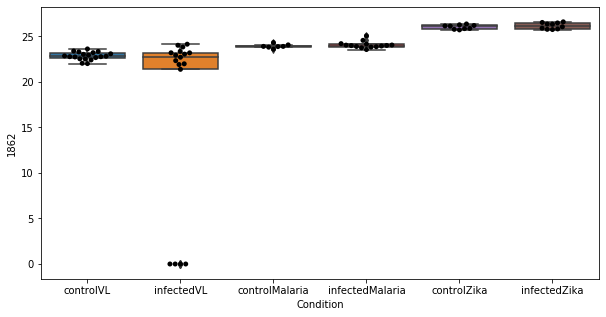

140 row m/z                316.248
row retention time     6.89948
p-val                 0.535939
adj.P.Val             0.994953
custom_id                 2385
compound_names             NaN
Name: 2385, dtype: object


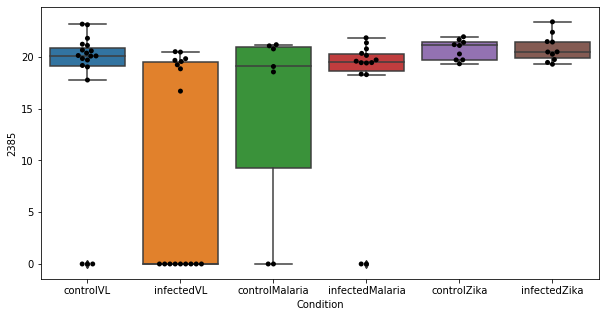

141 row m/z                181.163
row retention time     3.97436
p-val                 0.536594
adj.P.Val             0.994953
custom_id                 1101
compound_names             NaN
Name: 1101, dtype: object


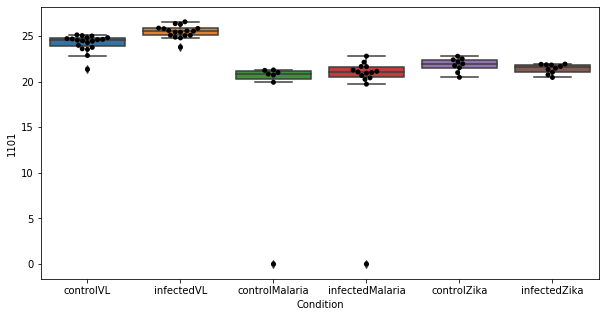

142 row m/z                594.509
row retention time     3.17337
p-val                 0.538391
adj.P.Val             0.994953
custom_id                 2780
compound_names             NaN
Name: 2780, dtype: object


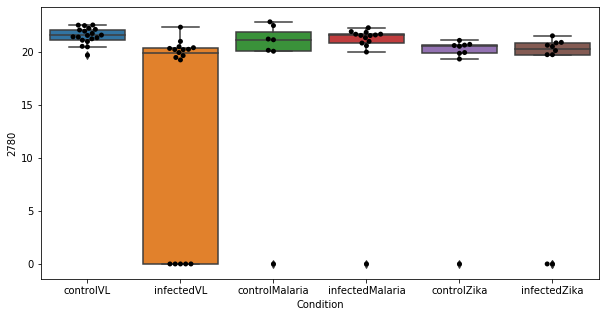

143 row m/z                143.107
row retention time     4.63126
p-val                 0.545784
adj.P.Val             0.994953
custom_id                  550
compound_names             NaN
Name: 550, dtype: object


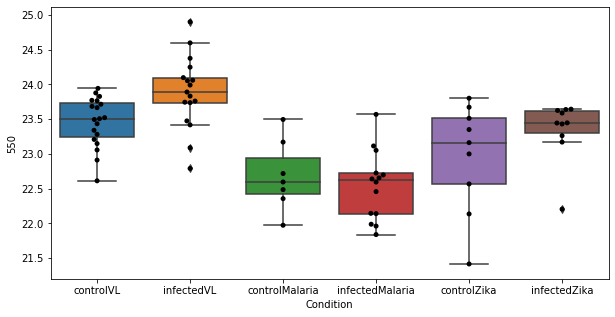

144 row m/z                                                         120.066
row retention time                                              9.70233
p-val                                                          0.546066
adj.P.Val                                                      0.994953
custom_id                                                           259
compound_names        L-Allothreonine; L-allo-Threonine$L-Threonine;...
Name: 259, dtype: object


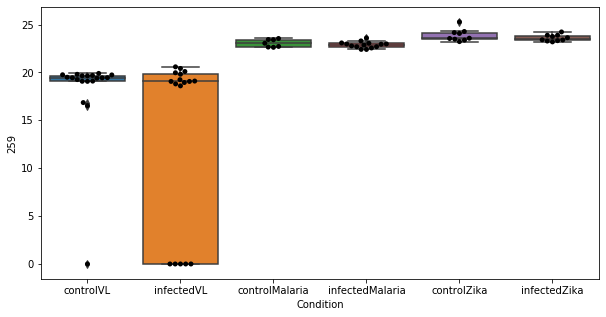

145 row m/z                756.553
row retention time     3.41394
p-val                 0.547392
adj.P.Val             0.994953
custom_id                 2894
compound_names             NaN
Name: 2894, dtype: object


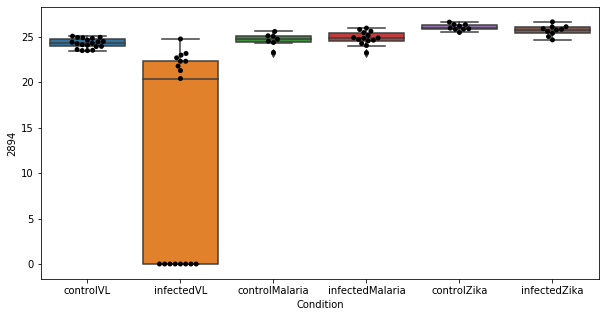

146 row m/z                236.073
row retention time     4.84916
p-val                 0.549642
adj.P.Val             0.994953
custom_id                 1798
compound_names             NaN
Name: 1798, dtype: object


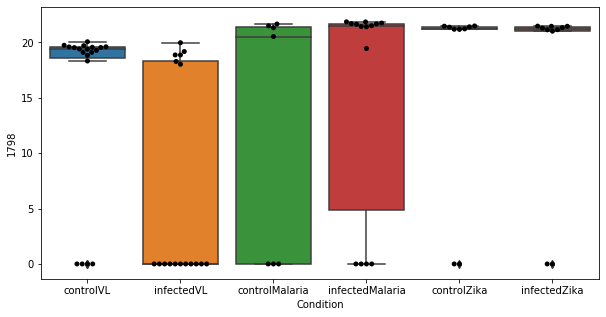

147 row m/z                812.614
row retention time     3.36042
p-val                 0.549738
adj.P.Val             0.994953
custom_id                 2992
compound_names             NaN
Name: 2992, dtype: object


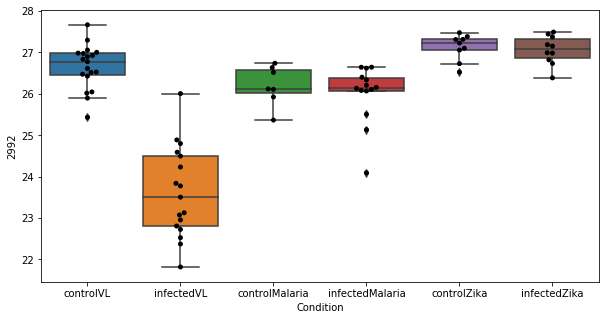

148 row m/z                 904.59
row retention time     3.18137
p-val                 0.549761
adj.P.Val             0.994953
custom_id                 3108
compound_names             NaN
Name: 3108, dtype: object


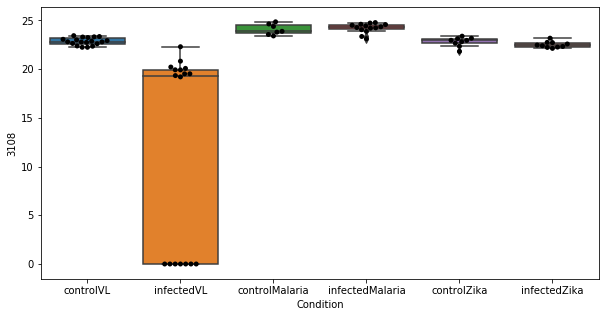

149 row m/z                905.594
row retention time     3.17171
p-val                 0.557646
adj.P.Val             0.994953
custom_id                 3109
compound_names             NaN
Name: 3109, dtype: object


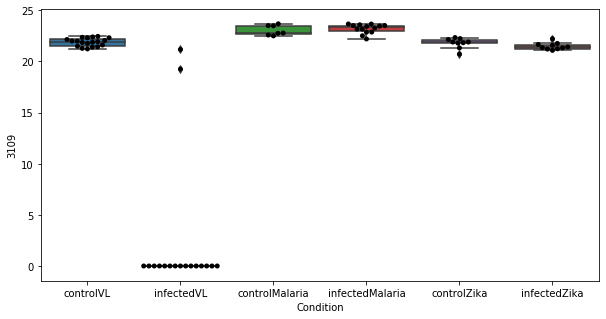

150 row m/z                221.154
row retention time     3.57329
p-val                 0.559694
adj.P.Val             0.994953
custom_id                 1631
compound_names             NaN
Name: 1631, dtype: object


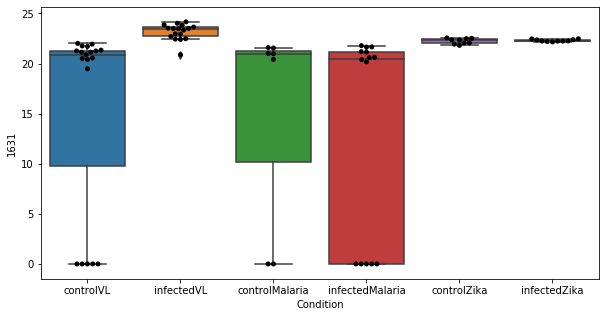

151 row m/z                173.117
row retention time      4.4885
p-val                 0.563689
adj.P.Val             0.994953
custom_id                  993
compound_names             NaN
Name: 993, dtype: object


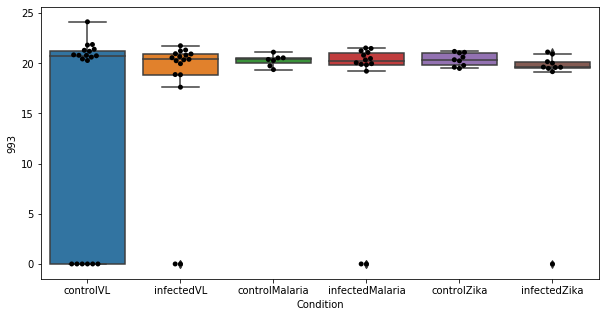

152 row m/z                179.128
row retention time     4.63897
p-val                  0.56731
adj.P.Val             0.994953
custom_id                 1081
compound_names             NaN
Name: 1081, dtype: object


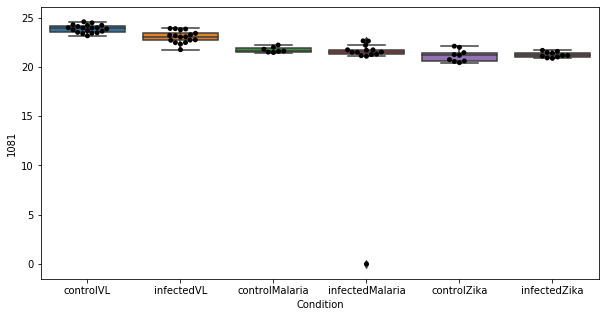

153 row m/z                836.614
row retention time      3.3276
p-val                 0.571725
adj.P.Val             0.994953
custom_id                 3027
compound_names             NaN
Name: 3027, dtype: object


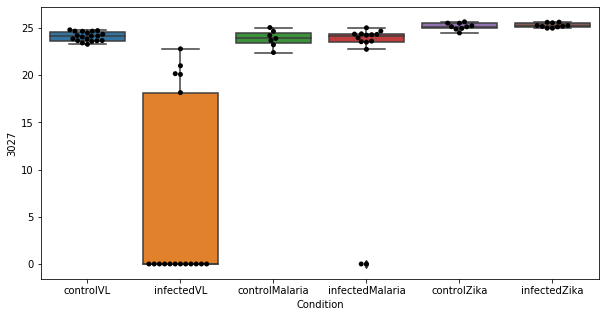

154 row m/z                 612.52
row retention time     3.18654
p-val                 0.573819
adj.P.Val             0.994953
custom_id                 2796
compound_names             NaN
Name: 2796, dtype: object


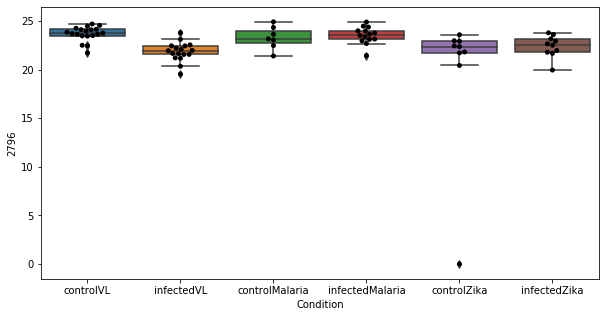

155 row m/z                182.139
row retention time     4.55455
p-val                 0.579867
adj.P.Val             0.994953
custom_id                 1111
compound_names             NaN
Name: 1111, dtype: object


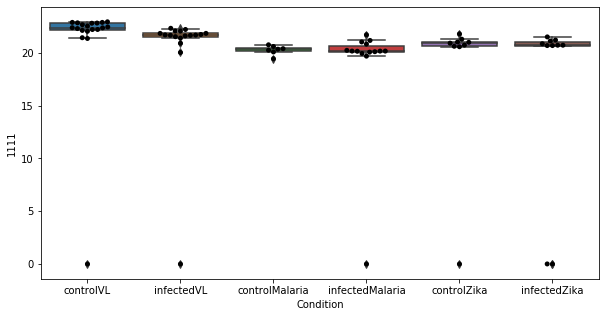

156 row m/z                125.096
row retention time      4.6102
p-val                 0.581608
adj.P.Val             0.994953
custom_id                  317
compound_names             NaN
Name: 317, dtype: object


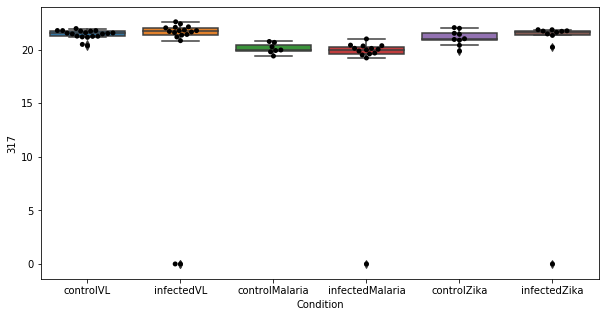

157 row m/z                156.138
row retention time     4.63784
p-val                 0.581651
adj.P.Val             0.994953
custom_id                  745
compound_names             NaN
Name: 745, dtype: object


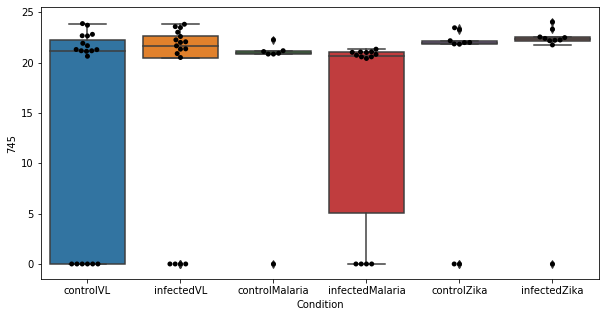

158 row m/z                                                         129.066
row retention time                                              11.1693
p-val                                                          0.581872
adj.P.Val                                                      0.994953
custom_id                                                          4517
compound_names        D-Glutamine; D-2-Aminoglutaramic acid$L-Glutam...
Name: 4517, dtype: object


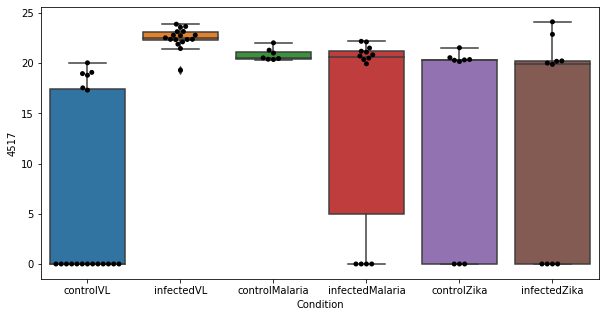

159 row m/z                733.557
row retention time     3.40639
p-val                 0.583745
adj.P.Val             0.994953
custom_id                 2868
compound_names             NaN
Name: 2868, dtype: object


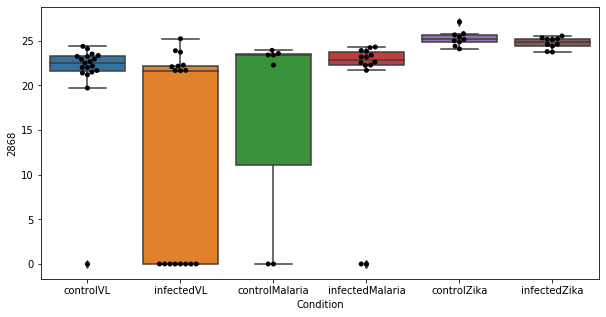

160 row m/z                272.185
row retention time     6.91903
p-val                 0.584959
adj.P.Val             0.994953
custom_id                 2094
compound_names             NaN
Name: 2094, dtype: object


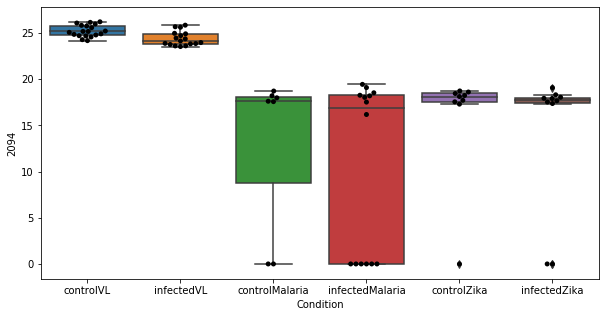

161 row m/z                782.569
row retention time     3.38974
p-val                 0.587503
adj.P.Val             0.994953
custom_id                 2936
compound_names             NaN
Name: 2936, dtype: object


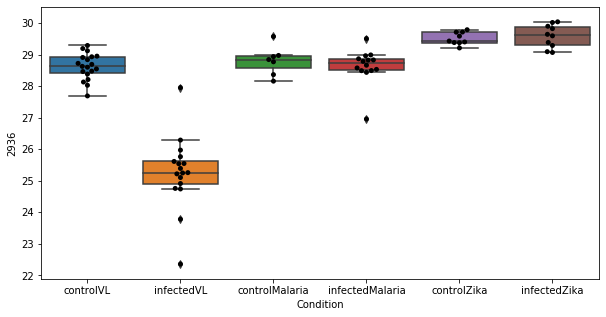

162 row m/z                809.588
row retention time     3.36011
p-val                   0.5894
adj.P.Val             0.994953
custom_id                 2987
compound_names             NaN
Name: 2987, dtype: object


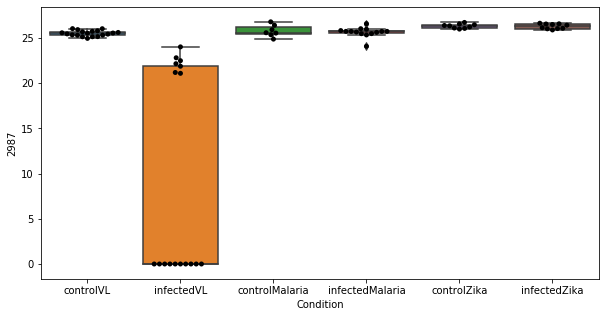

163 row m/z                343.295
row retention time     4.29564
p-val                 0.594439
adj.P.Val             0.994953
custom_id                 2476
compound_names             NaN
Name: 2476, dtype: object


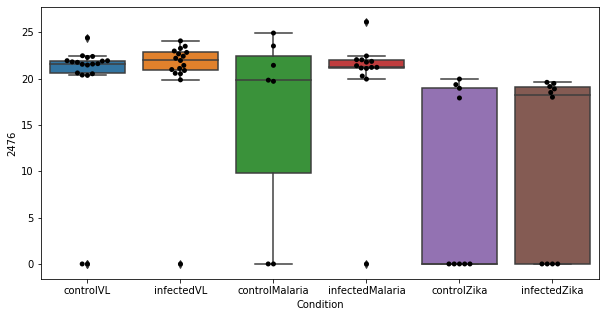

164 row m/z                239.128
row retention time     3.77033
p-val                 0.595437
adj.P.Val             0.994953
custom_id                 1819
compound_names             NaN
Name: 1819, dtype: object


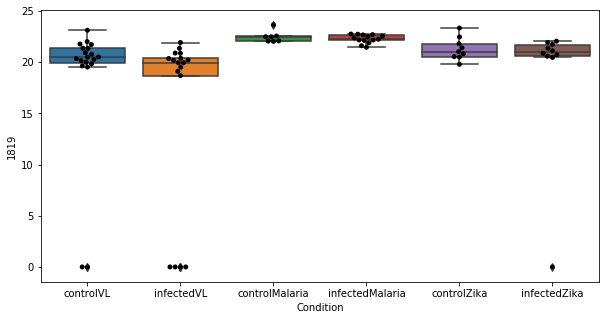

165 row m/z                148.097
row retention time     3.96667
p-val                 0.600217
adj.P.Val             0.994953
custom_id                  637
compound_names             NaN
Name: 637, dtype: object


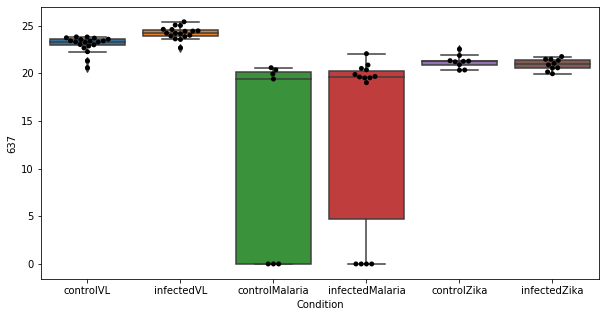

166 row m/z                242.284
row retention time     6.92011
p-val                  0.60179
adj.P.Val             0.994953
custom_id                 1844
compound_names             NaN
Name: 1844, dtype: object


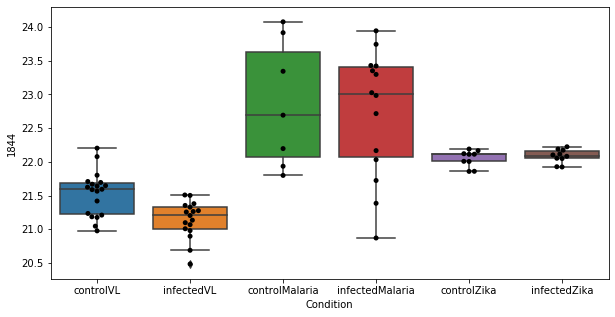

167 row m/z                211.133
row retention time     3.91386
p-val                 0.602643
adj.P.Val             0.994953
custom_id                 3756
compound_names             NaN
Name: 3756, dtype: object


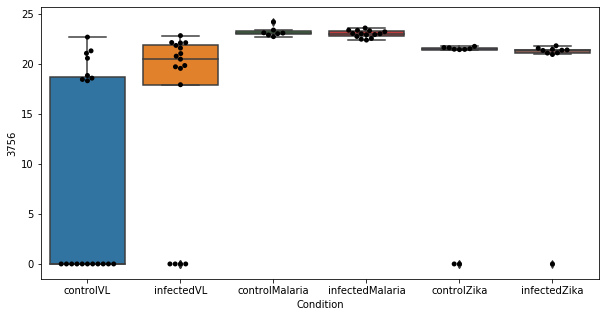

168 row m/z                158.081
row retention time     4.70954
p-val                 0.602735
adj.P.Val             0.994953
custom_id                  768
compound_names             NaN
Name: 768, dtype: object


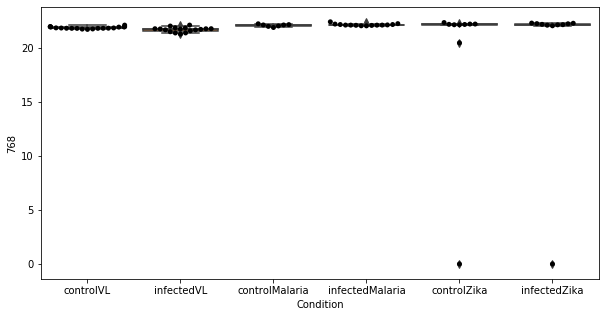

169 row m/z                                                         169.086
row retention time                                              6.91079
p-val                                                          0.606548
adj.P.Val                                                      0.994953
custom_id                                                           929
compound_names        N-Trimethyl-2-aminoethylphosphonate; 2-Trimeth...
Name: 929, dtype: object


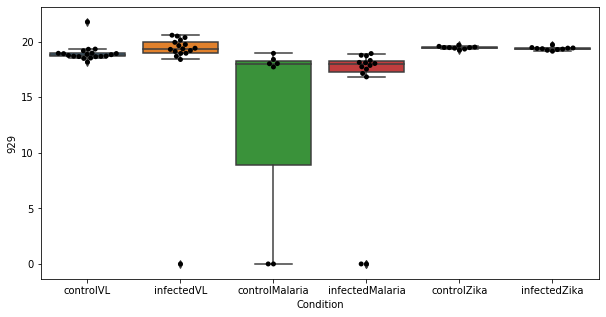

170 row m/z                742.574
row retention time     3.38926
p-val                 0.613246
adj.P.Val             0.994953
custom_id                 2875
compound_names             NaN
Name: 2875, dtype: object


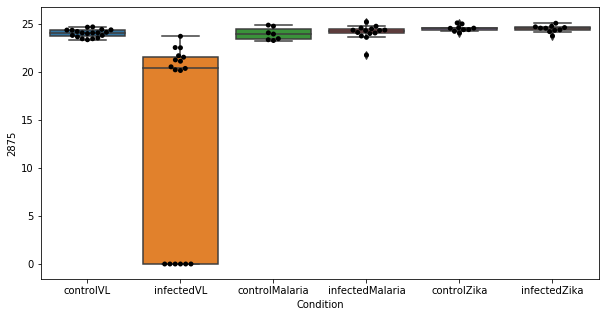

171 row m/z                332.331
row retention time     6.94341
p-val                 0.617668
adj.P.Val             0.994953
custom_id                 2441
compound_names             NaN
Name: 2441, dtype: object


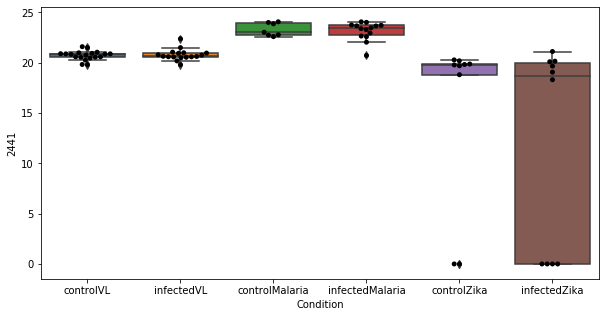

172 row m/z                236.113
row retention time     3.66066
p-val                 0.617996
adj.P.Val             0.994953
custom_id                 1800
compound_names             NaN
Name: 1800, dtype: object


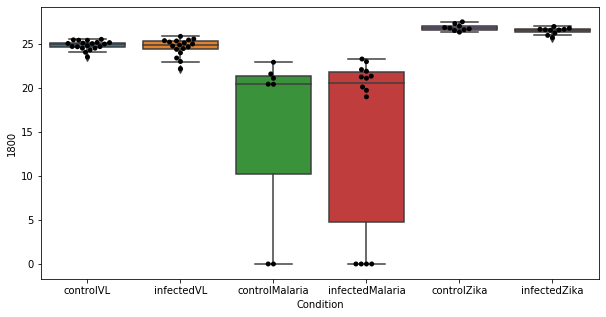

173 row m/z                                                         281.247
row retention time                                              3.20461
p-val                                                          0.618013
adj.P.Val                                                      0.994953
custom_id                                                          2185
compound_names        Linoleate; Linoleic acid; (9Z,12Z)-Octadecadie...
Name: 2185, dtype: object


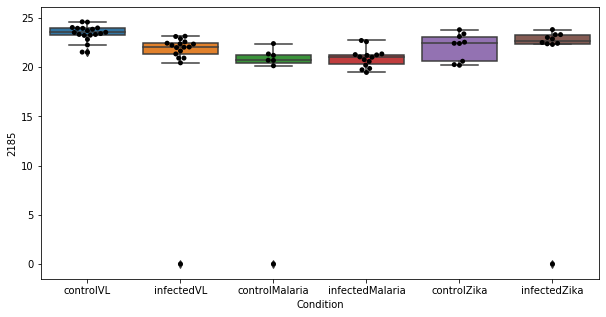

174 row m/z                758.569
row retention time     3.39902
p-val                 0.619073
adj.P.Val             0.994953
custom_id                 2897
compound_names             NaN
Name: 2897, dtype: object


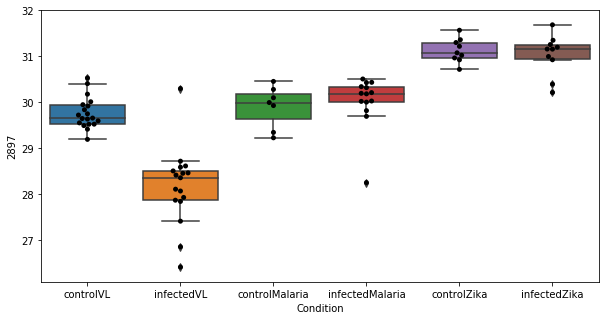

175 row m/z                789.618
row retention time     3.37084
p-val                 0.619572
adj.P.Val             0.994953
custom_id                 2953
compound_names             NaN
Name: 2953, dtype: object


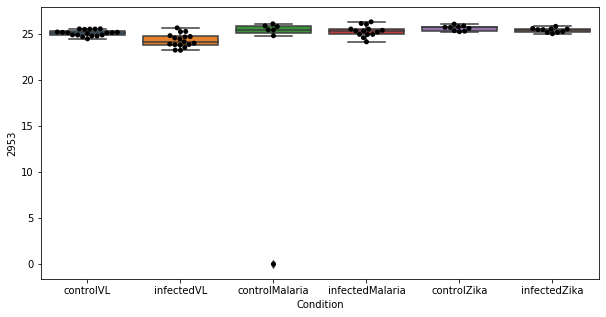

176 row m/z                191.164
row retention time     3.78086
p-val                 0.620895
adj.P.Val             0.994953
custom_id                 1251
compound_names             NaN
Name: 1251, dtype: object


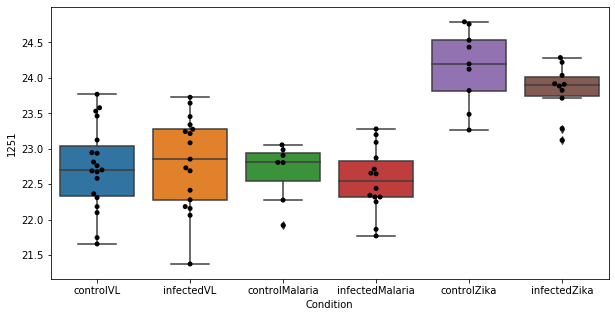

177 row m/z                734.569
row retention time     3.41108
p-val                 0.622408
adj.P.Val             0.994953
custom_id                 2870
compound_names             NaN
Name: 2870, dtype: object


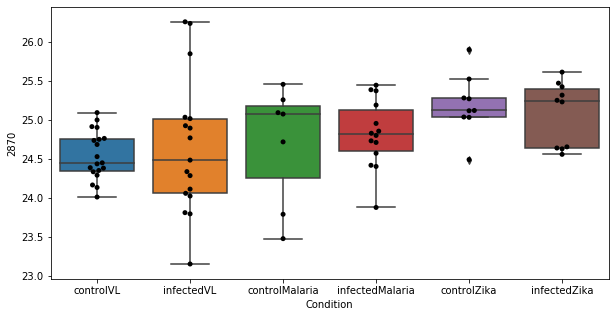

178 row m/z                240.142
row retention time     4.53959
p-val                 0.623876
adj.P.Val             0.994953
custom_id                 1833
compound_names             NaN
Name: 1833, dtype: object


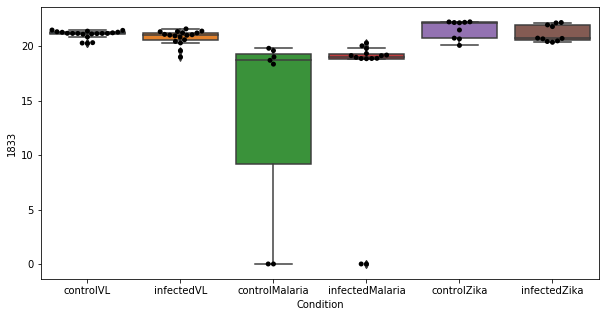

179 row m/z                218.211
row retention time     6.90785
p-val                 0.630434
adj.P.Val             0.994953
custom_id                 1599
compound_names             NaN
Name: 1599, dtype: object


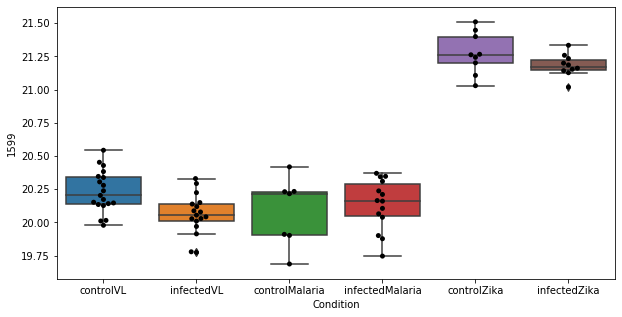

180 row m/z                                                         147.076
row retention time                                              10.3497
p-val                                                          0.630795
adj.P.Val                                                      0.994953
custom_id                                                           615
compound_names        D-Glutamine; D-2-Aminoglutaramic acid$L-Glutam...
Name: 615, dtype: object


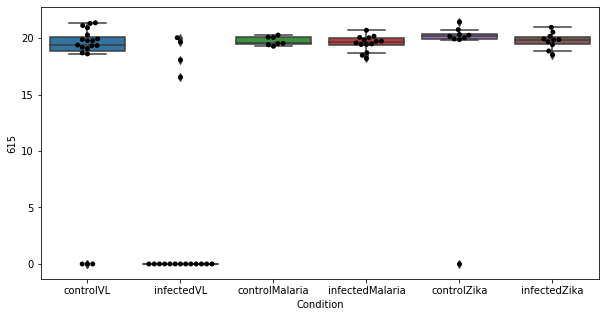

181 row m/z                744.553
row retention time     3.34399
p-val                 0.639788
adj.P.Val             0.994953
custom_id                 2877
compound_names             NaN
Name: 2877, dtype: object


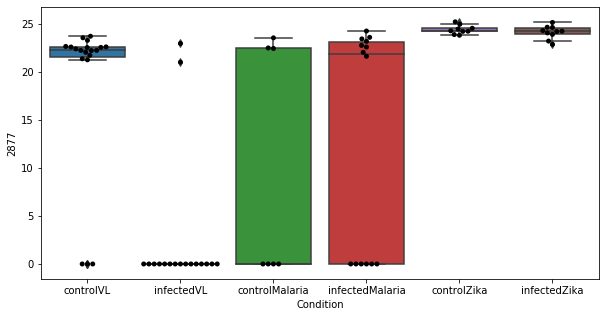

182 row m/z                808.583
row retention time     3.33814
p-val                 0.641423
adj.P.Val             0.994953
custom_id                 2985
compound_names             NaN
Name: 2985, dtype: object


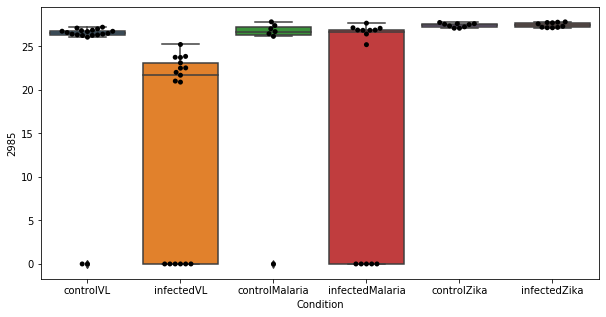

183 row m/z                783.572
row retention time     3.38908
p-val                 0.645128
adj.P.Val             0.994953
custom_id                 2937
compound_names             NaN
Name: 2937, dtype: object


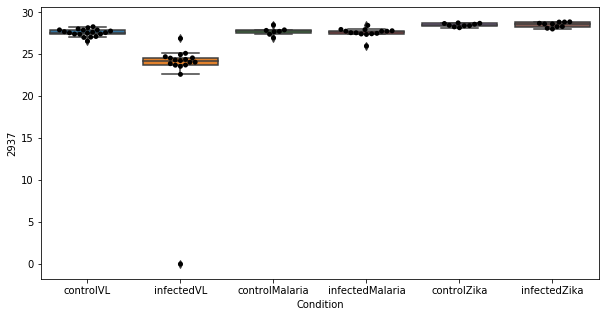

184 row m/z                217.107
row retention time     3.88059
p-val                 0.646322
adj.P.Val             0.994953
custom_id                 1580
compound_names             NaN
Name: 1580, dtype: object


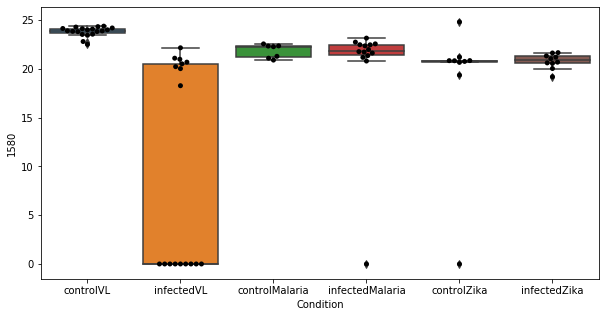

185 row m/z                                                         130.086
row retention time                                              6.92237
p-val                                                           0.64664
adj.P.Val                                                      0.994953
custom_id                                                           374
compound_names        N4-Acetylaminobutanal$L-Pipecolate; Pipecolini...
Name: 374, dtype: object


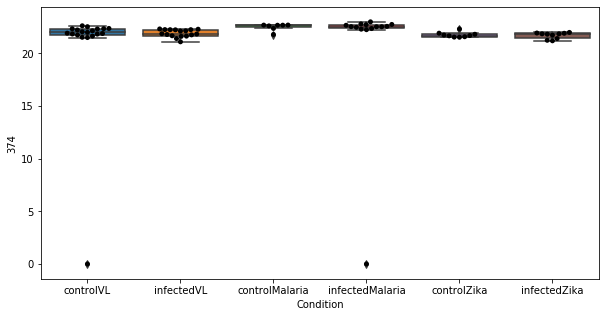

186 row m/z                                                         183.102
row retention time                                              6.91069
p-val                                                          0.650751
adj.P.Val                                                      0.994953
custom_id                                                          1118
compound_names        Ecgonine methyl ester; Methyl ecgonine$ecgonin...
Name: 1118, dtype: object


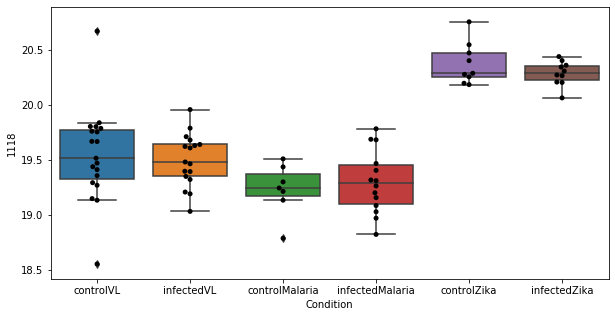

187 row m/z                 520.34
row retention time      3.9353
p-val                 0.652954
adj.P.Val             0.994953
custom_id                 2720
compound_names             NaN
Name: 2720, dtype: object


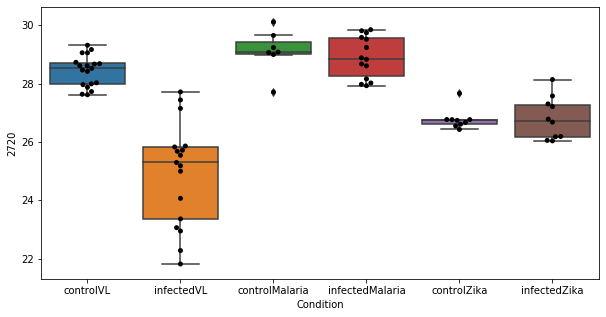

188 row m/z                194.092
row retention time     7.00379
p-val                 0.652978
adj.P.Val             0.994953
custom_id                 1295
compound_names             NaN
Name: 1295, dtype: object


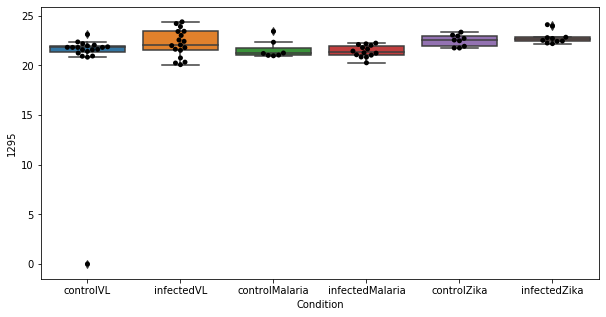

189 row m/z                                                         70.0651
row retention time                                              16.4277
p-val                                                          0.653758
adj.P.Val                                                      0.994953
custom_id                                                             3
compound_names        4-Aminobutanal; 4-Aminobutyraldehyde; Butyrald...
Name: 3, dtype: object


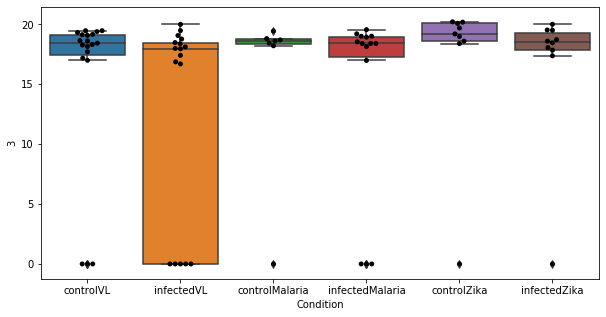

190 row m/z                794.605
row retention time     3.35015
p-val                 0.656881
adj.P.Val             0.994953
custom_id                 2960
compound_names             NaN
Name: 2960, dtype: object


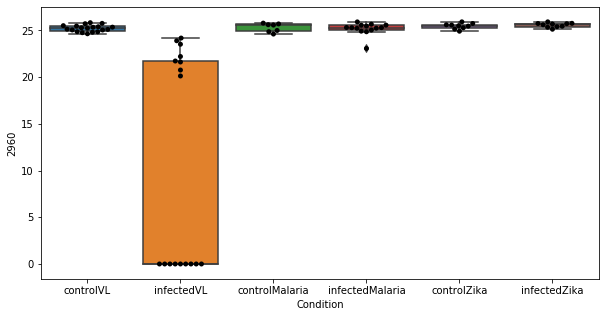

191 row m/z                123.117
row retention time     3.78237
p-val                 0.661004
adj.P.Val             0.994953
custom_id                  301
compound_names             NaN
Name: 301, dtype: object


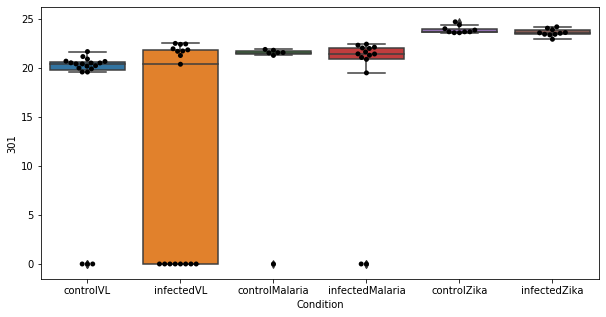

192 row m/z                213.123
row retention time     6.90797
p-val                 0.665084
adj.P.Val             0.994953
custom_id                 1526
compound_names             NaN
Name: 1526, dtype: object


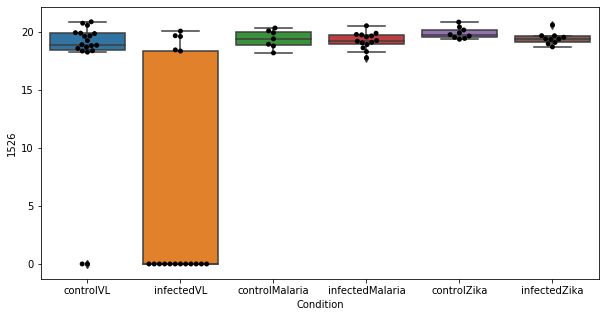

193 row m/z                                                         184.097
row retention time                                              6.93416
p-val                                                          0.670683
adj.P.Val                                                      0.994953
custom_id                                                          3618
compound_names        L-Phenylalanine; (S)-alpha-Amino-beta-phenylpr...
Name: 3618, dtype: object


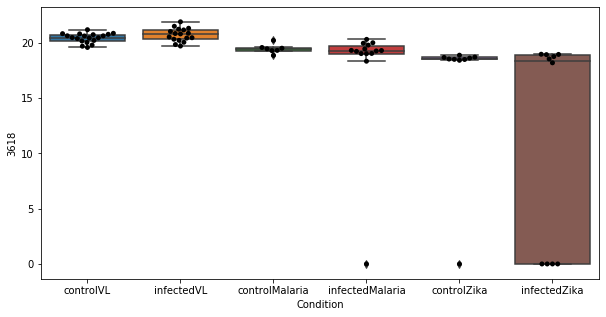

194 row m/z                759.572
row retention time     3.40125
p-val                 0.672184
adj.P.Val             0.994953
custom_id                 2898
compound_names             NaN
Name: 2898, dtype: object


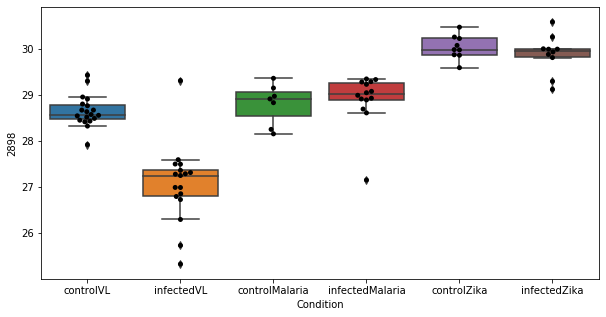

195 row m/z                619.491
row retention time     3.12607
p-val                 0.673234
adj.P.Val             0.994953
custom_id                 2803
compound_names             NaN
Name: 2803, dtype: object


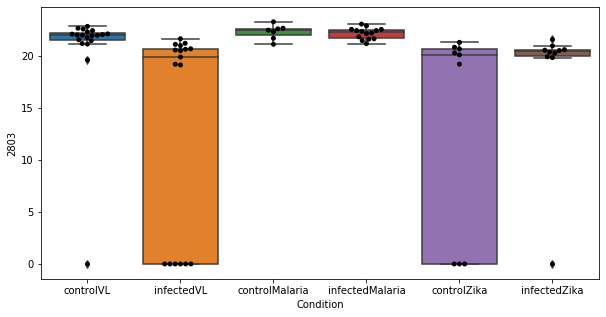

196 row m/z                168.123
row retention time     6.90969
p-val                 0.674216
adj.P.Val             0.994953
custom_id                  922
compound_names             NaN
Name: 922, dtype: object


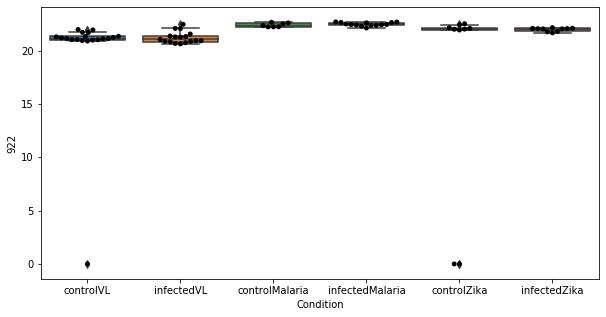

197 row m/z                249.185
row retention time     3.59729
p-val                 0.674998
adj.P.Val             0.994953
custom_id                 1911
compound_names             NaN
Name: 1911, dtype: object


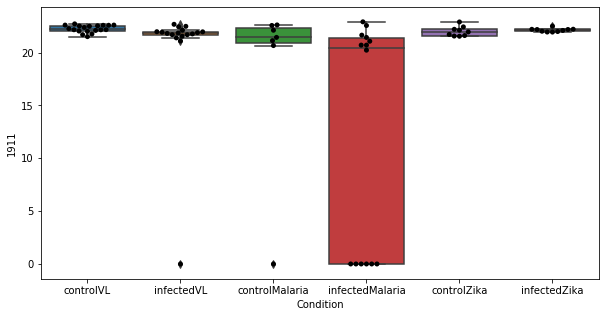

198 row m/z                                                        174.113
row retention time                                             6.91895
p-val                                                         0.676204
adj.P.Val                                                     0.994953
custom_id                                                         1005
compound_names        Pantothenate; Pantothenic acid; (R)-Pantothenate
Name: 1005, dtype: object


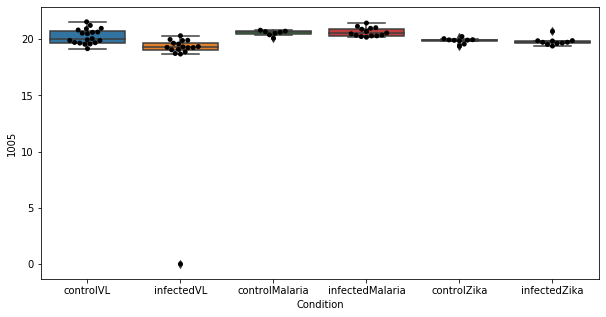

199 row m/z                209.154
row retention time     3.72454
p-val                 0.681585
adj.P.Val             0.994953
custom_id                 1468
compound_names             NaN
Name: 1468, dtype: object


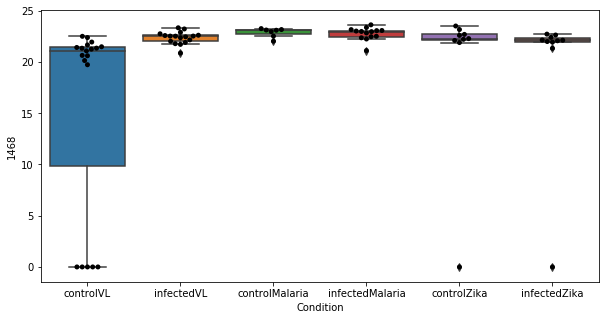

200 row m/z                261.121
row retention time     6.90741
p-val                 0.684739
adj.P.Val             0.994953
custom_id                 2012
compound_names             NaN
Name: 2012, dtype: object


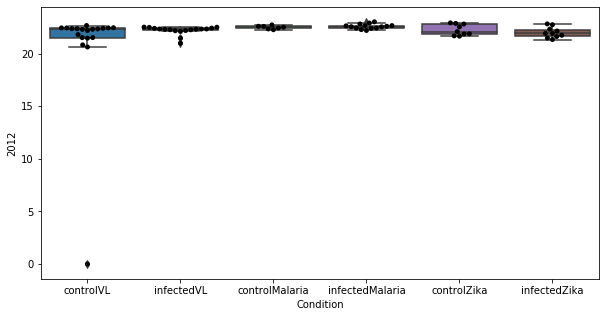

201 row m/z                                                          113.06
row retention time                                              3.63845
p-val                                                          0.686729
adj.P.Val                                                      0.994953
custom_id                                                           172
compound_names        Adipate semialdehyde; Hexan-1-one-6-carboxylat...
Name: 172, dtype: object


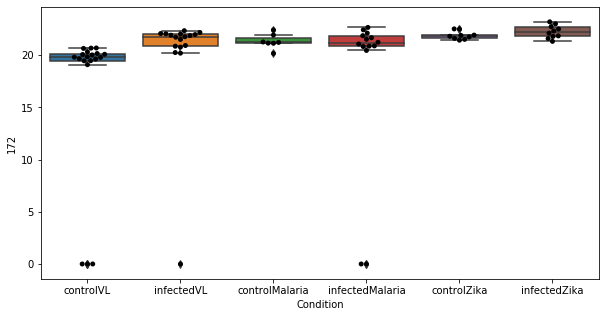

202 row m/z                                                         153.066
row retention time                                              6.97288
p-val                                                          0.687816
adj.P.Val                                                      0.994953
custom_id                                                           704
compound_names        N1-Methyl-2-pyridone-5-carboxamide; N'-Methyl-...
Name: 704, dtype: object


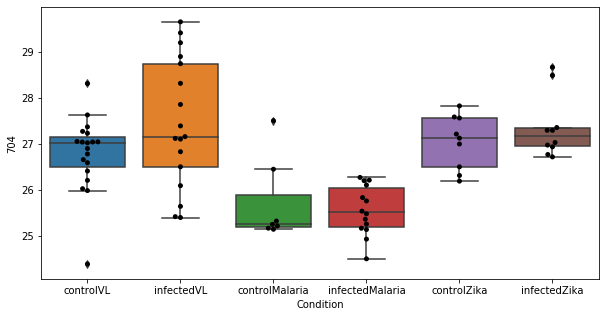

203 row m/z                                                         138.052
row retention time                                              10.0399
p-val                                                          0.688293
adj.P.Val                                                      0.994953
custom_id                                                           490
compound_names        D-Proline$acetamidopropanal$L-Proline; 2-Pyrro...
Name: 490, dtype: object


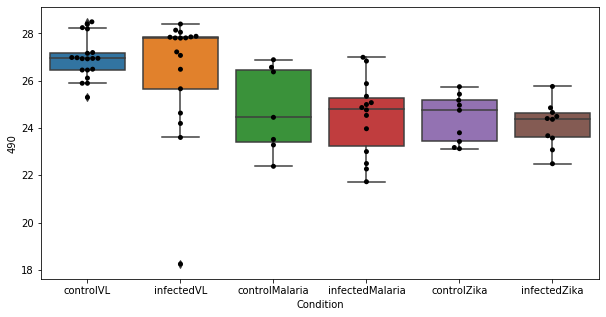

204 row m/z                158.118
row retention time     4.58424
p-val                 0.697349
adj.P.Val             0.994953
custom_id                  778
compound_names             NaN
Name: 778, dtype: object


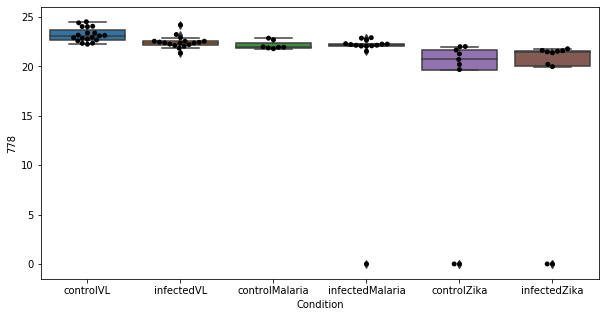

205 row m/z                            107.07
row retention time                3.97781
p-val                             0.70588
adj.P.Val                        0.994953
custom_id                             152
compound_names        1-Methylpyrrolinium
Name: 152, dtype: object


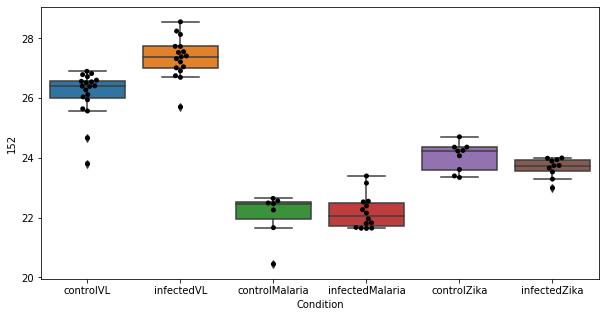

206 row m/z                117.091
row retention time      4.2998
p-val                   0.7095
adj.P.Val             0.994953
custom_id                 3250
compound_names             NaN
Name: 3250, dtype: object


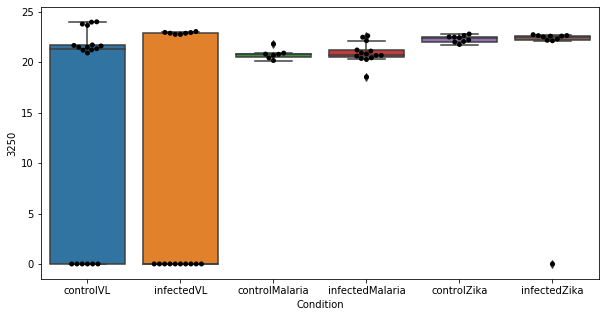

207 row m/z                338.342
row retention time     3.53769
p-val                 0.710214
adj.P.Val             0.994953
custom_id                 2451
compound_names             NaN
Name: 2451, dtype: object


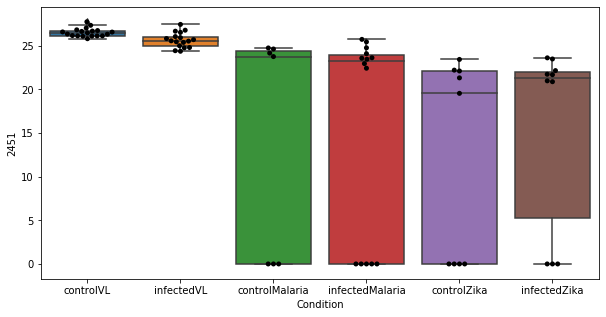

208 row m/z                260.186
row retention time     4.70661
p-val                 0.712252
adj.P.Val             0.994953
custom_id                 2007
compound_names             NaN
Name: 2007, dtype: object


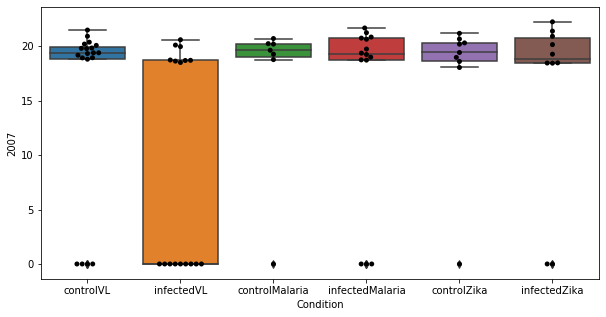

209 row m/z                205.144
row retention time     3.66015
p-val                 0.714796
adj.P.Val             0.994953
custom_id                 1442
compound_names             NaN
Name: 1442, dtype: object


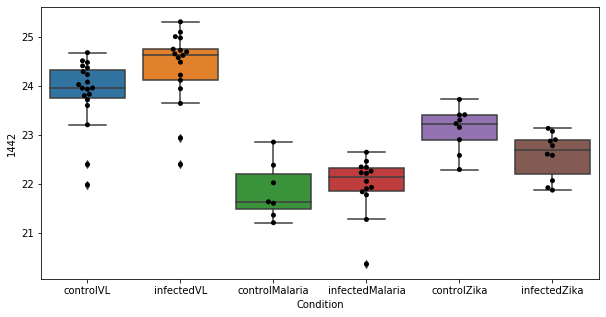

210 row m/z                                                         114.055
row retention time                                              9.73786
p-val                                                          0.718044
adj.P.Val                                                      0.994953
custom_id                                                           177
compound_names        5-Aminolevulinate; 5-Amino-4-oxopentanoate; 5-...
Name: 177, dtype: object


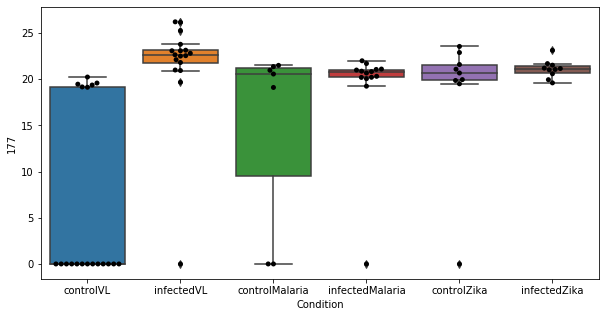

211 row m/z                256.175
row retention time     4.64034
p-val                 0.718941
adj.P.Val             0.994953
custom_id                 1977
compound_names             NaN
Name: 1977, dtype: object


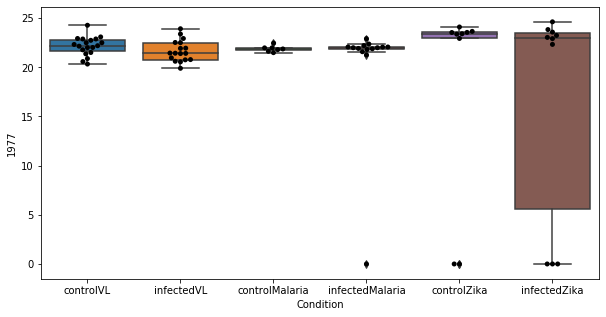

212 row m/z                                                         104.107
row retention time                                              6.77639
p-val                                                          0.720986
adj.P.Val                                                      0.994953
custom_id                                                           125
compound_names        L-Isoleucine; 2-Amino-3-methylvaleric acid$L-L...
Name: 125, dtype: object


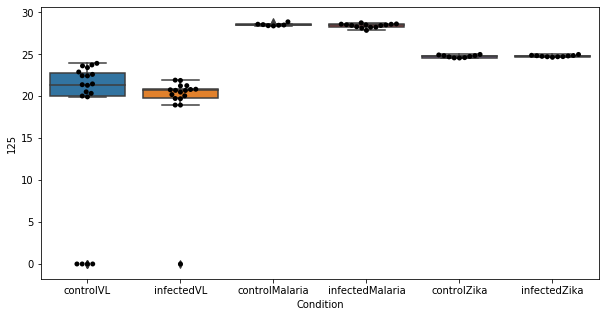

213 row m/z                169.122
row retention time     3.91951
p-val                 0.725644
adj.P.Val             0.994953
custom_id                  932
compound_names             NaN
Name: 932, dtype: object


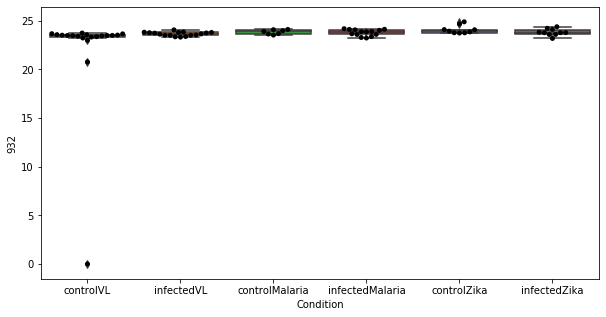

214 row m/z                787.604
row retention time     3.36923
p-val                 0.725988
adj.P.Val             0.994953
custom_id                 2944
compound_names             NaN
Name: 2944, dtype: object


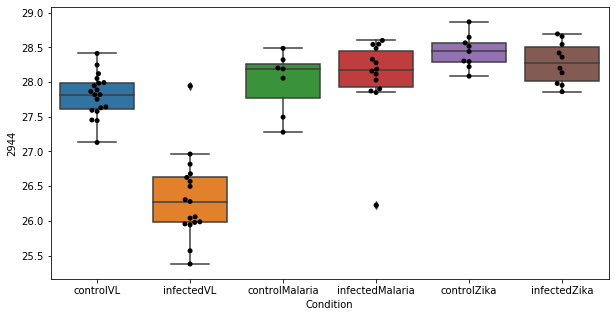

215 row m/z                703.574
row retention time     3.59162
p-val                  0.72818
adj.P.Val             0.994953
custom_id                 2844
compound_names             NaN
Name: 2844, dtype: object


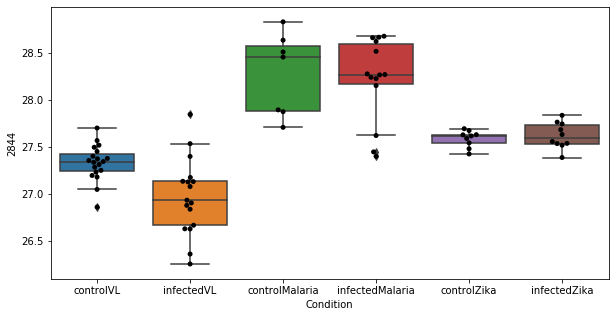

216 row m/z                 202.18
row retention time     7.11457
p-val                 0.729342
adj.P.Val             0.994953
custom_id                 3706
compound_names             NaN
Name: 3706, dtype: object


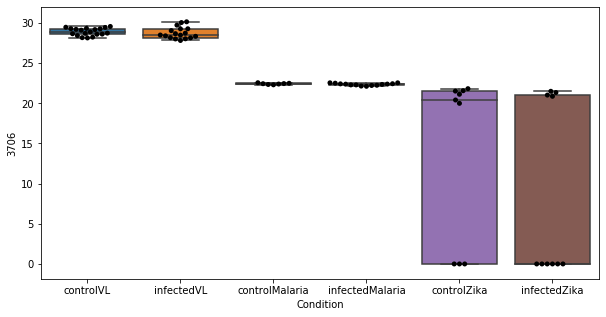

217 row m/z                344.228
row retention time     4.34734
p-val                 0.733423
adj.P.Val             0.994953
custom_id                 2478
compound_names             NaN
Name: 2478, dtype: object


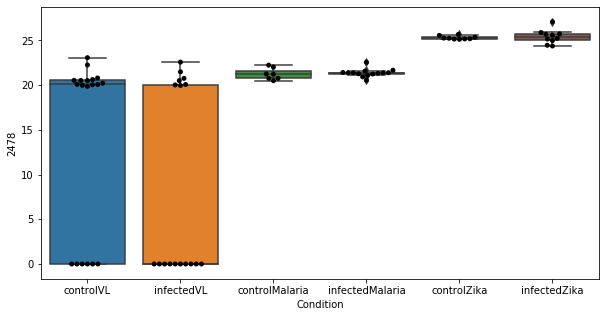

218 row m/z                137.984
row retention time     4.95493
p-val                 0.733856
adj.P.Val             0.994953
custom_id                  485
compound_names             NaN
Name: 485, dtype: object


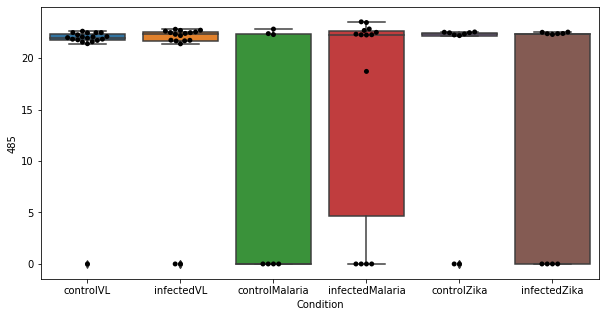

219 row m/z                757.557
row retention time     3.38555
p-val                 0.737292
adj.P.Val             0.994953
custom_id                 2895
compound_names             NaN
Name: 2895, dtype: object


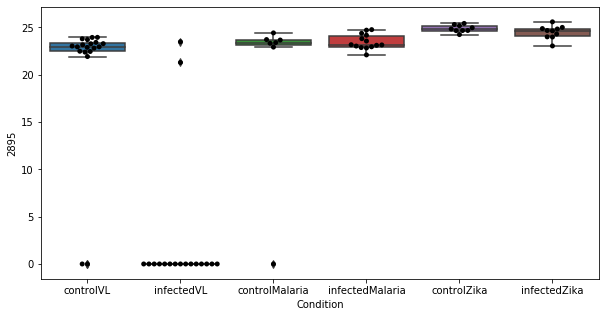

220 row m/z                                                         133.061
row retention time                                              12.3633
p-val                                                           0.74446
adj.P.Val                                                      0.994953
custom_id                                                           424
compound_names        3-Ureidopropionate; 3-Ureidopropanoate; beta-U...
Name: 424, dtype: object


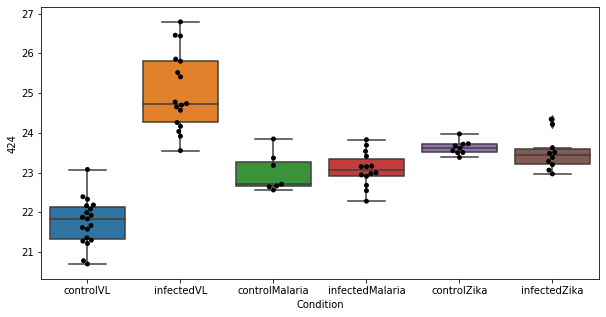

221 row m/z                204.123
row retention time     4.62213
p-val                  0.74891
adj.P.Val             0.994953
custom_id                 1421
compound_names             NaN
Name: 1421, dtype: object


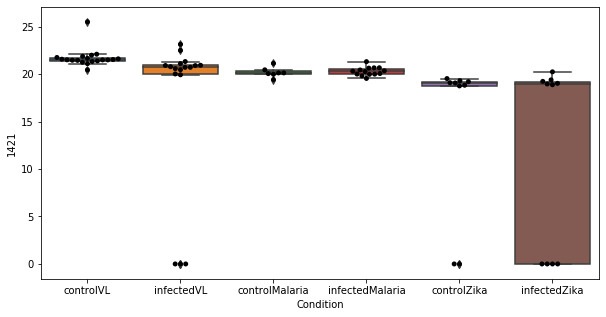

222 row m/z                228.123
row retention time      4.5435
p-val                 0.754472
adj.P.Val             0.994953
custom_id                 1685
compound_names             NaN
Name: 1685, dtype: object


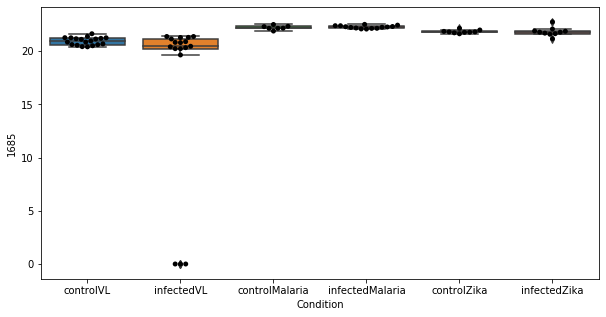

223 row m/z                214.091
row retention time     4.77368
p-val                 0.755049
adj.P.Val             0.994953
custom_id                 1533
compound_names             NaN
Name: 1533, dtype: object


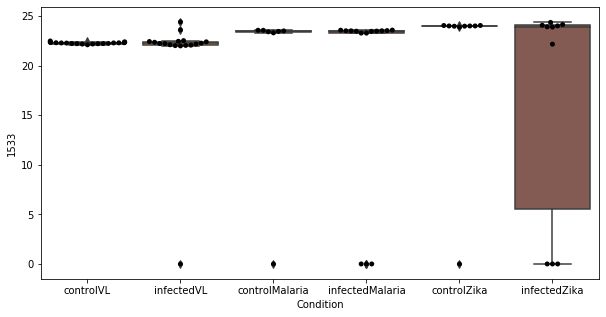

224 row m/z                                                         102.055
row retention time                                              11.7157
p-val                                                          0.755084
adj.P.Val                                                      0.994953
custom_id                                                           107
compound_names        L-Allothreonine; L-allo-Threonine$L-Threonine;...
Name: 107, dtype: object


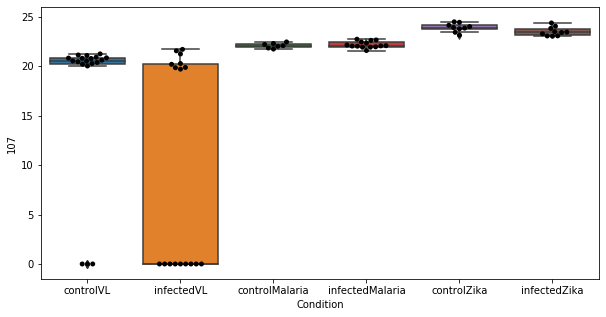

225 row m/z                702.562
row retention time     3.61621
p-val                 0.755106
adj.P.Val             0.994953
custom_id                 2843
compound_names             NaN
Name: 2843, dtype: object


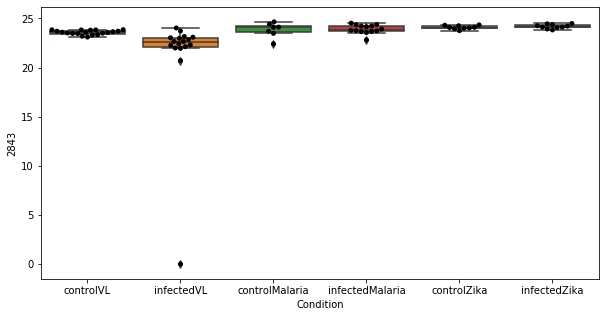

226 row m/z                172.097
row retention time     6.91953
p-val                 0.758494
adj.P.Val             0.994953
custom_id                  970
compound_names             NaN
Name: 970, dtype: object


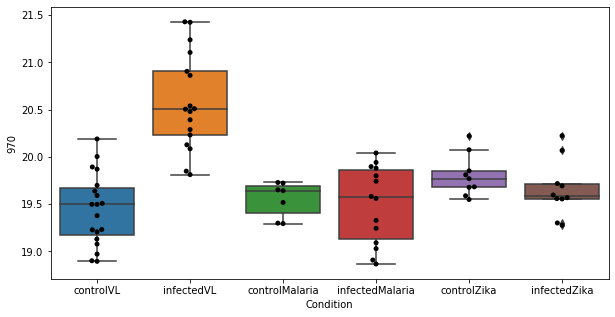

227 row m/z                761.588
row retention time     3.38791
p-val                 0.758503
adj.P.Val             0.994953
custom_id                 2902
compound_names             NaN
Name: 2902, dtype: object


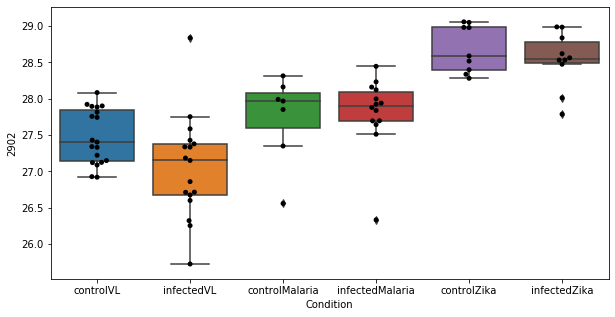

228 row m/z                194.147
row retention time     4.26696
p-val                  0.75979
adj.P.Val             0.994953
custom_id                 1299
compound_names             NaN
Name: 1299, dtype: object


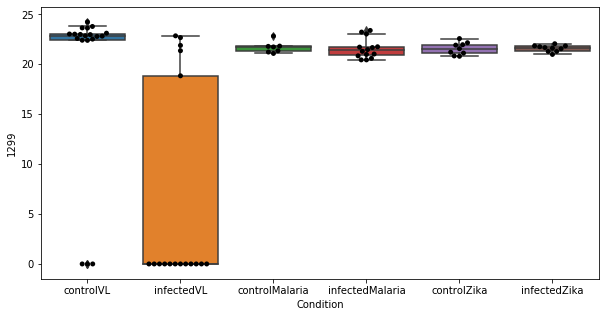

229 row m/z                316.248
row retention time     4.47024
p-val                 0.763647
adj.P.Val             0.994953
custom_id                 2384
compound_names             NaN
Name: 2384, dtype: object


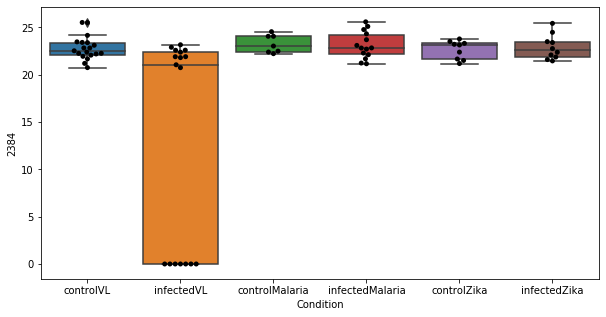

230 row m/z                 179.01
row retention time     4.97637
p-val                  0.76366
adj.P.Val             0.994953
custom_id                 1075
compound_names             NaN
Name: 1075, dtype: object


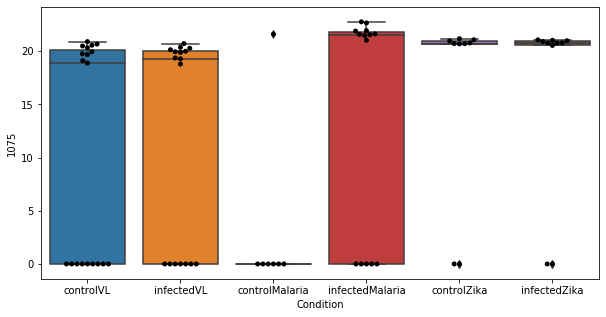

231 row m/z                806.569
row retention time      3.3451
p-val                 0.764377
adj.P.Val             0.994953
custom_id                 2980
compound_names             NaN
Name: 2980, dtype: object


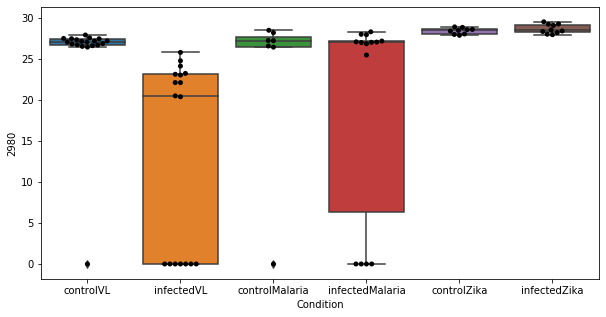

232 row m/z                770.603
row retention time     3.36495
p-val                 0.769141
adj.P.Val             0.994953
custom_id                 2921
compound_names             NaN
Name: 2921, dtype: object


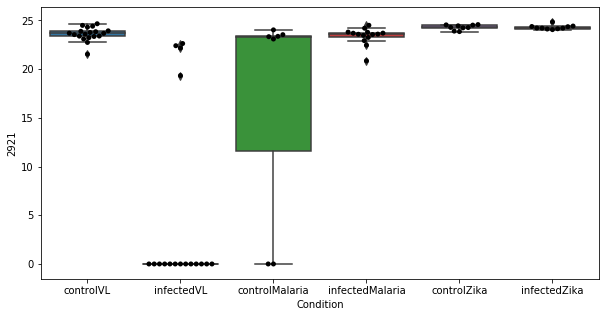

233 row m/z                                                         203.053
row retention time                                              12.3363
p-val                                                          0.769353
adj.P.Val                                                      0.994953
custom_id                                                          1401
compound_names        D-Tagatose; lyxo-Hexulose$1,7-Dimethylxanthine...
Name: 1401, dtype: object


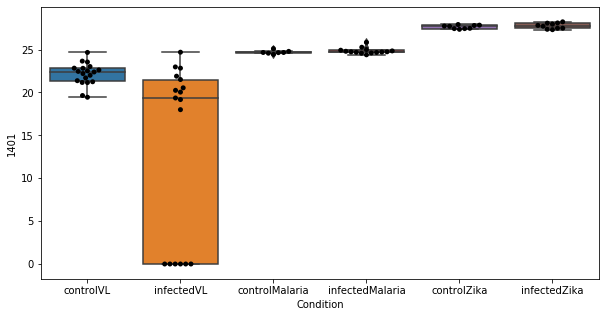

234 row m/z                           288.217
row retention time                6.91199
p-val                            0.773574
adj.P.Val                        0.994953
custom_id                            2235
compound_names        L-Octanoylcarnitine
Name: 2235, dtype: object


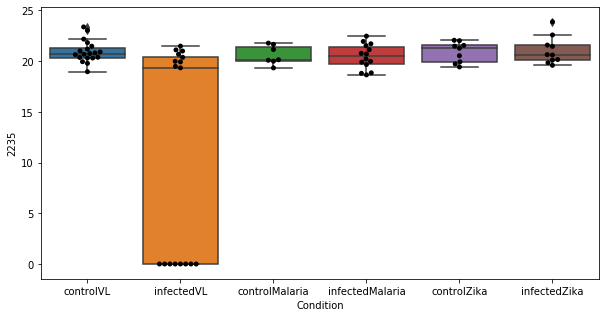

235 row m/z                  786.6
row retention time     3.37321
p-val                 0.773783
adj.P.Val             0.994953
custom_id                 2942
compound_names             NaN
Name: 2942, dtype: object


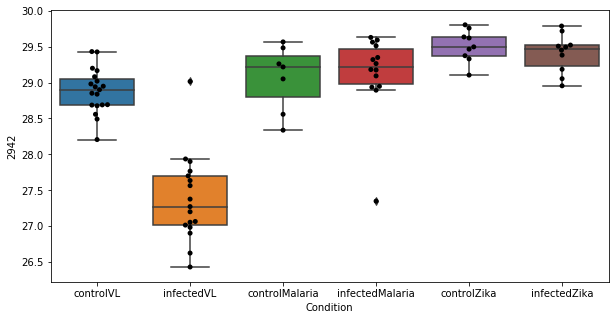

236 row m/z                268.175
row retention time     3.55926
p-val                 0.774427
adj.P.Val             0.994953
custom_id                 2058
compound_names             NaN
Name: 2058, dtype: object


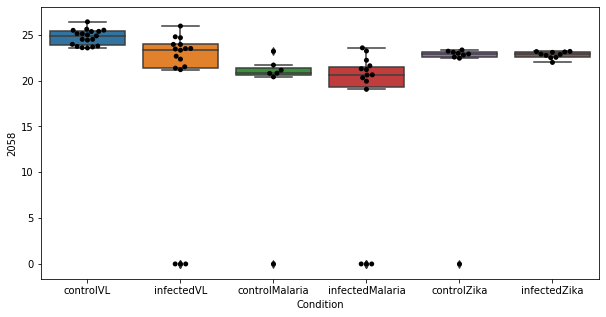

237 row m/z                199.169
row retention time     3.53521
p-val                 0.778844
adj.P.Val             0.994953
custom_id                 1359
compound_names             NaN
Name: 1359, dtype: object


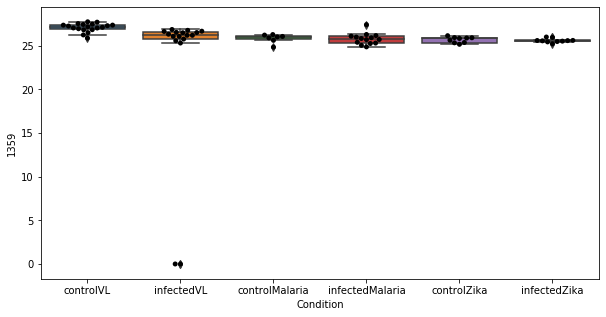

238 row m/z                                                         297.242
row retention time                                              3.41582
p-val                                                          0.781969
adj.P.Val                                                      0.994953
custom_id                                                          2286
compound_names        13(S)-HODE; (13S)-Hydroxyoctadecadienoic acid;...
Name: 2286, dtype: object


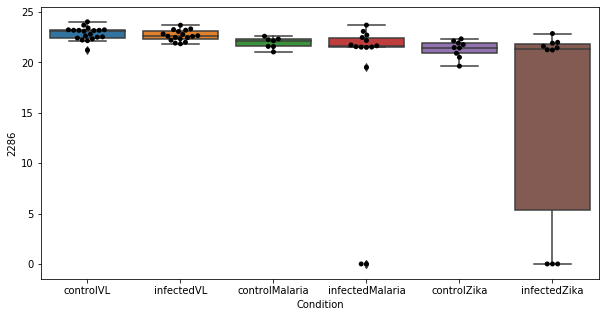

239 row m/z                614.535
row retention time     3.17434
p-val                 0.782788
adj.P.Val             0.994953
custom_id                 2799
compound_names             NaN
Name: 2799, dtype: object


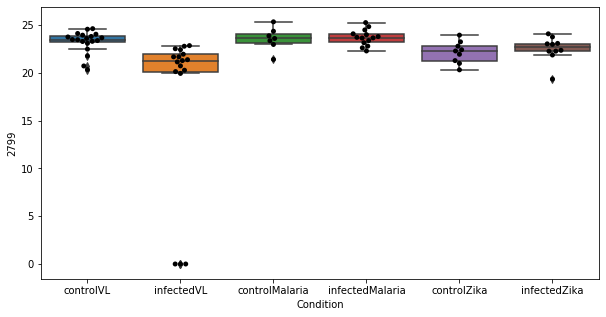

240 row m/z                200.173
row retention time     3.55285
p-val                 0.790844
adj.P.Val             0.994953
custom_id                 1372
compound_names             NaN
Name: 1372, dtype: object


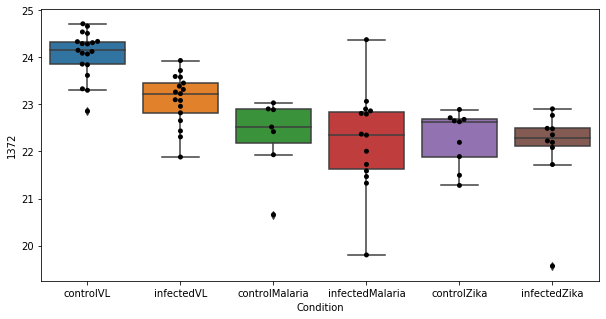

241 row m/z                760.584
row retention time     3.39217
p-val                 0.792779
adj.P.Val             0.994953
custom_id                 2901
compound_names             NaN
Name: 2901, dtype: object


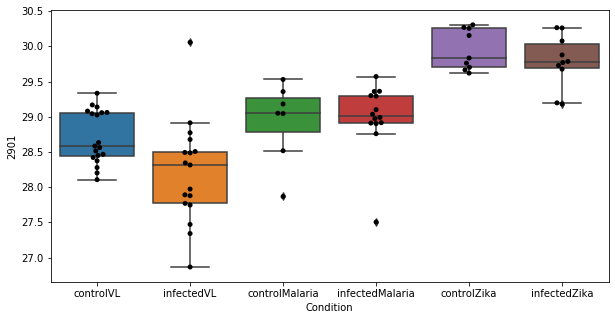

242 row m/z                234.134
row retention time     3.94064
p-val                 0.793941
adj.P.Val             0.994953
custom_id                 1771
compound_names             NaN
Name: 1771, dtype: object


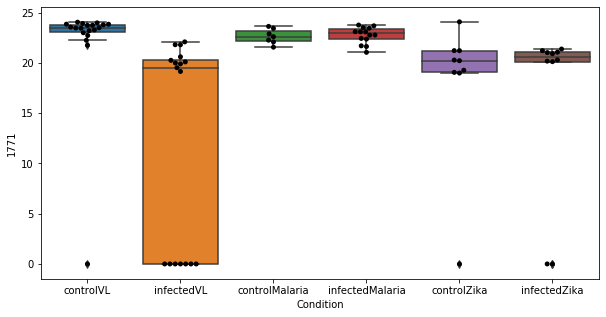

243 row m/z                317.269
row retention time     3.18617
p-val                 0.797463
adj.P.Val             0.994953
custom_id                 2392
compound_names             NaN
Name: 2392, dtype: object


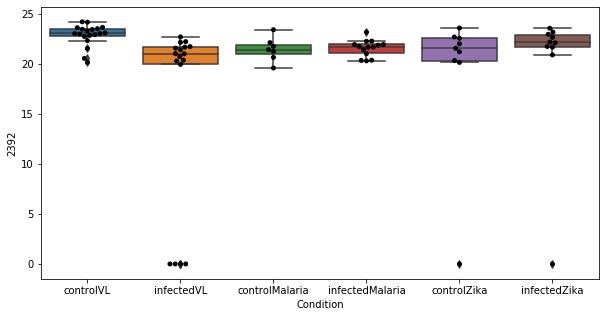

244 row m/z                814.687
row retention time     3.45133
p-val                 0.798604
adj.P.Val             0.994953
custom_id                 2998
compound_names             NaN
Name: 2998, dtype: object


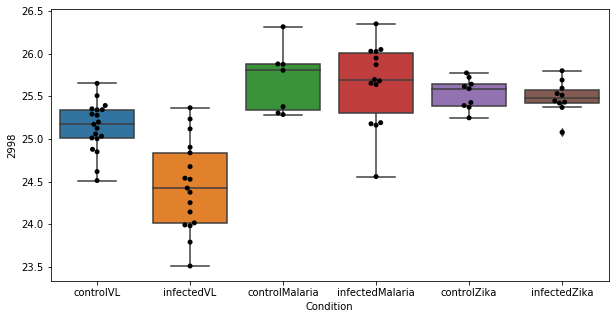

245 row m/z                134.081
row retention time     11.9258
p-val                 0.799203
adj.P.Val             0.994953
custom_id                  443
compound_names             NaN
Name: 443, dtype: object


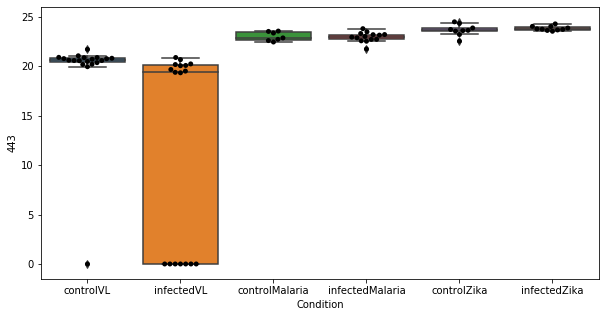

246 row m/z                                                         180.066
row retention time                                              6.91971
p-val                                                          0.799705
adj.P.Val                                                      0.994953
custom_id                                                          3603
compound_names        1,7-Dimethylxanthine; Paraxanthine$adrenochrom...
Name: 3603, dtype: object


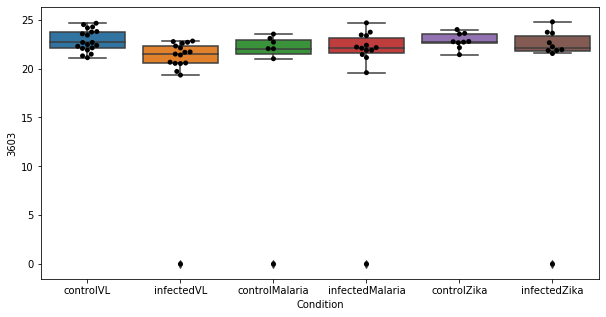

247 row m/z                           218.139
row retention time                6.90729
p-val                            0.801362
adj.P.Val                        0.994953
custom_id                            1593
compound_names        propionyl-carnitine
Name: 1593, dtype: object


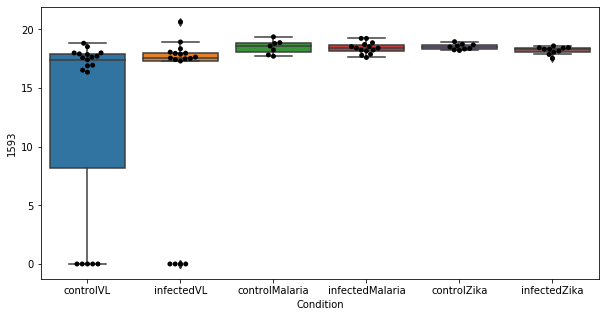

248 row m/z                326.378
row retention time     6.94324
p-val                 0.802364
adj.P.Val             0.994953
custom_id                 2412
compound_names             NaN
Name: 2412, dtype: object


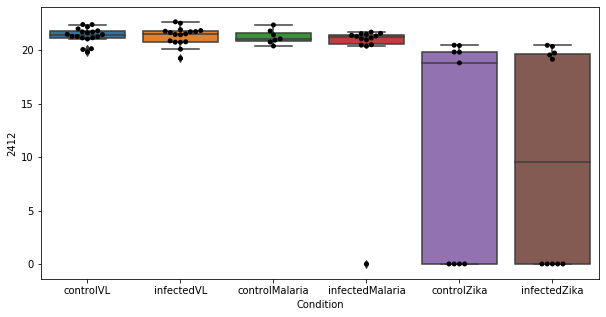

249 row m/z                704.578
row retention time     3.59426
p-val                 0.802452
adj.P.Val             0.994953
custom_id                 2845
compound_names             NaN
Name: 2845, dtype: object


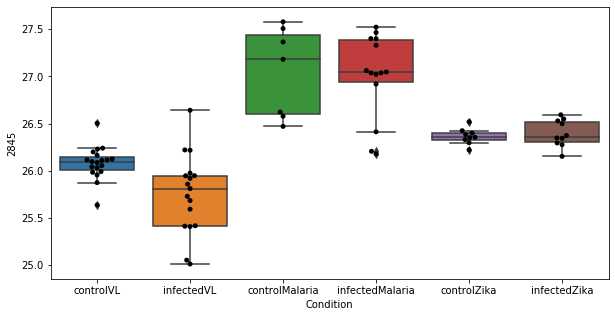

250 row m/z                 680.48
row retention time      3.2631
p-val                 0.804902
adj.P.Val             0.994953
custom_id                 2834
compound_names             NaN
Name: 2834, dtype: object


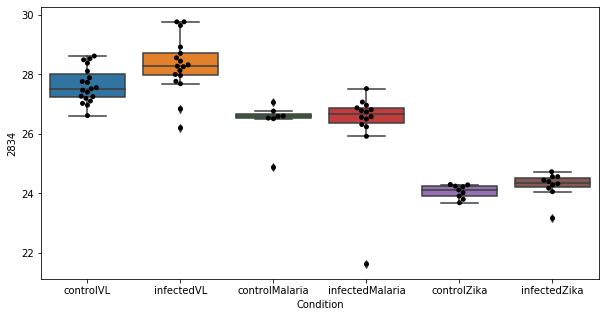

251 row m/z                     185.117
row retention time          4.64157
p-val                       0.80656
adj.P.Val                  0.994953
custom_id                      1149
compound_names        Perillic acid
Name: 1149, dtype: object


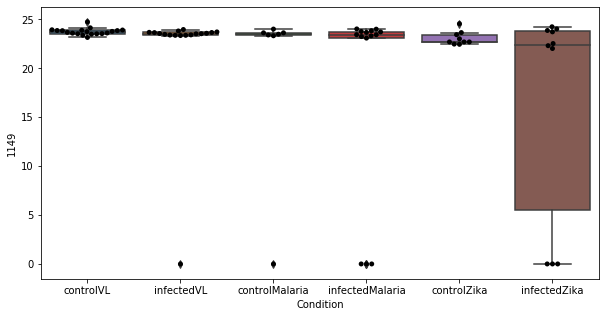

252 row m/z                340.882
row retention time     11.9358
p-val                 0.807863
adj.P.Val             0.994953
custom_id                 2464
compound_names             NaN
Name: 2464, dtype: object


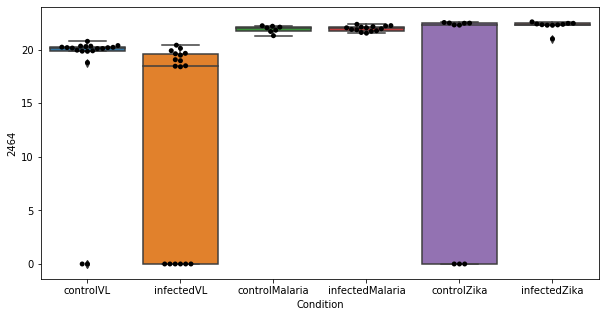

253 row m/z                757.621
row retention time     3.55323
p-val                 0.808923
adj.P.Val             0.994953
custom_id                 2896
compound_names             NaN
Name: 2896, dtype: object


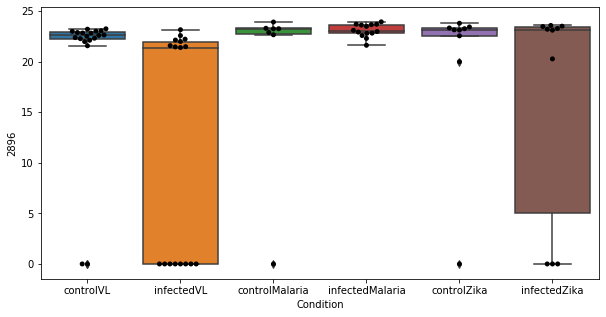

254 row m/z                                                         169.058
row retention time                                              12.0834
p-val                                                          0.810994
adj.P.Val                                                      0.994953
custom_id                                                           926
compound_names        D-Glutamine; D-2-Aminoglutaramic acid$L-Glutam...
Name: 926, dtype: object


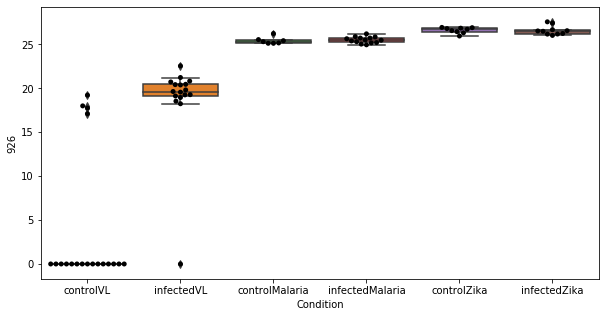

255 row m/z                111.117
row retention time      3.5372
p-val                 0.818279
adj.P.Val             0.994953
custom_id                  166
compound_names             NaN
Name: 166, dtype: object


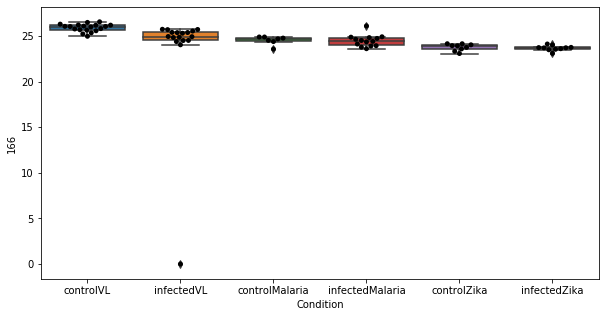

256 row m/z                181.122
row retention time     3.87335
p-val                 0.820827
adj.P.Val             0.994953
custom_id                 4792
compound_names             NaN
Name: 4792, dtype: object


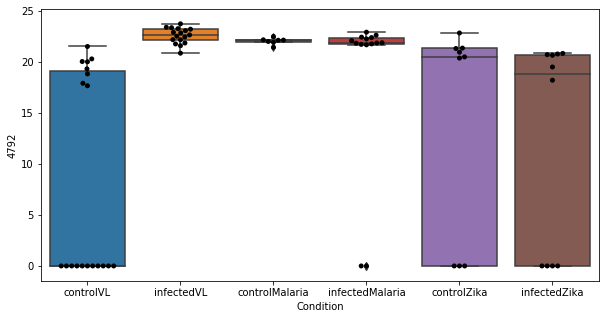

257 row m/z                 192.16
row retention time     4.69065
p-val                 0.826995
adj.P.Val             0.994953
custom_id                 1262
compound_names             NaN
Name: 1262, dtype: object


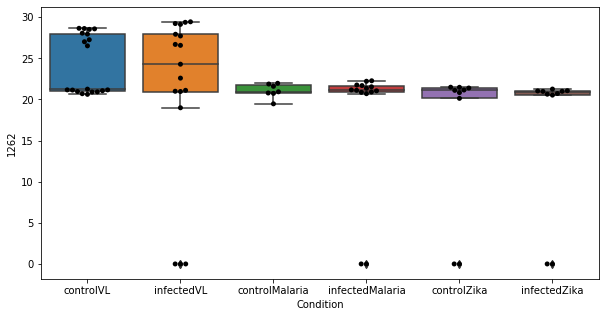

258 row m/z                595.493
row retention time      3.1998
p-val                  0.83524
adj.P.Val             0.994953
custom_id                 2781
compound_names             NaN
Name: 2781, dtype: object


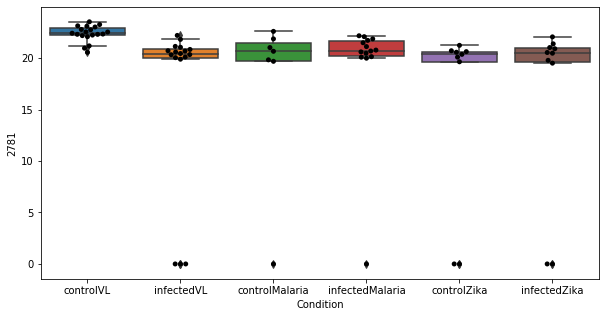

259 row m/z                177.055
row retention time       3.653
p-val                 0.835565
adj.P.Val             0.994953
custom_id                 1041
compound_names             NaN
Name: 1041, dtype: object


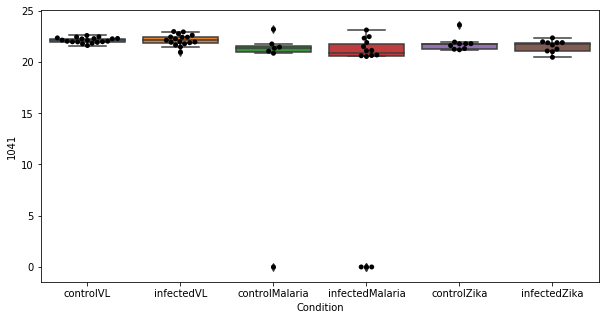

260 row m/z                788.612
row retention time     3.37189
p-val                 0.836675
adj.P.Val             0.994953
custom_id                 2949
compound_names             NaN
Name: 2949, dtype: object


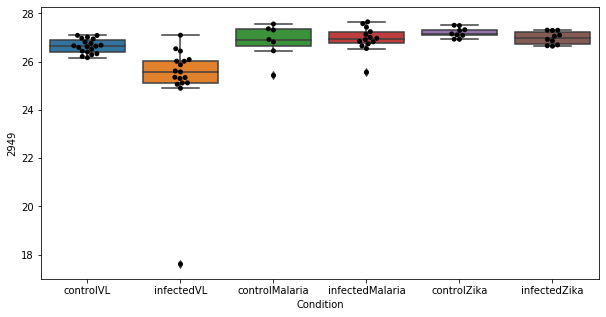

261 row m/z                762.591
row retention time     3.39056
p-val                 0.836747
adj.P.Val             0.994953
custom_id                 2904
compound_names             NaN
Name: 2904, dtype: object


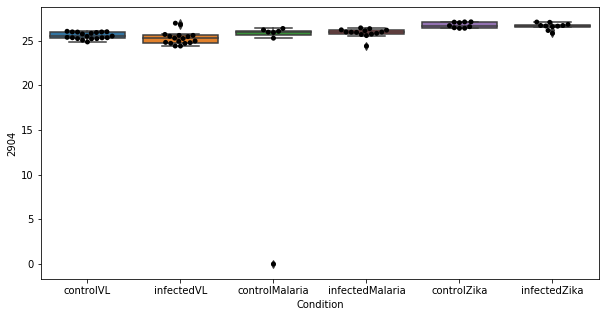

262 row m/z                195.123
row retention time     4.67303
p-val                 0.838261
adj.P.Val             0.994953
custom_id                 1317
compound_names             NaN
Name: 1317, dtype: object


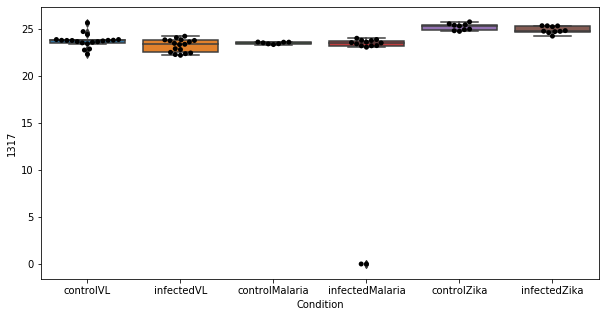

263 row m/z                                                         118.086
row retention time                                               10.836
p-val                                                          0.838295
adj.P.Val                                                      0.994953
custom_id                                                           241
compound_names        5-Aminopentanoate; 5-Aminopentanoic acid; 5-Am...
Name: 241, dtype: object


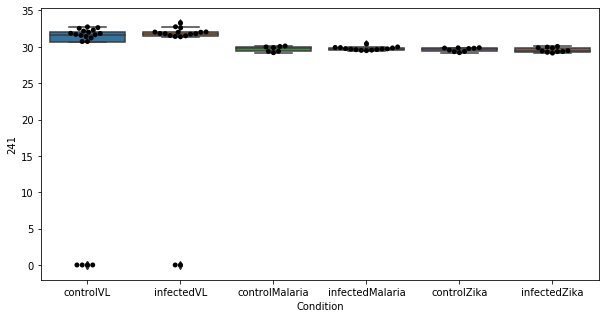

264 row m/z                342.264
row retention time     4.30707
p-val                 0.839204
adj.P.Val             0.994953
custom_id                 2469
compound_names             NaN
Name: 2469, dtype: object


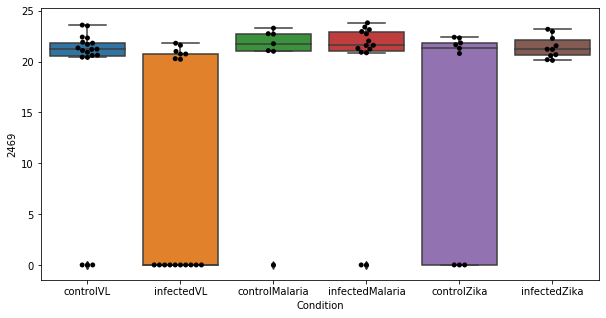

265 row m/z                 226.18
row retention time     3.97453
p-val                 0.839948
adj.P.Val             0.994953
custom_id                 1669
compound_names             NaN
Name: 1669, dtype: object


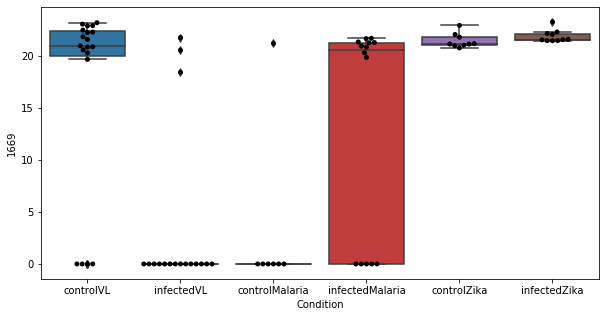

266 row m/z                                                         426.358
row retention time                                              3.85442
p-val                                                          0.841235
adj.P.Val                                                      0.994953
custom_id                                                          2629
compound_names        Elaidic carnitine$Vaccenyl carnitine$octadecen...
Name: 2629, dtype: object


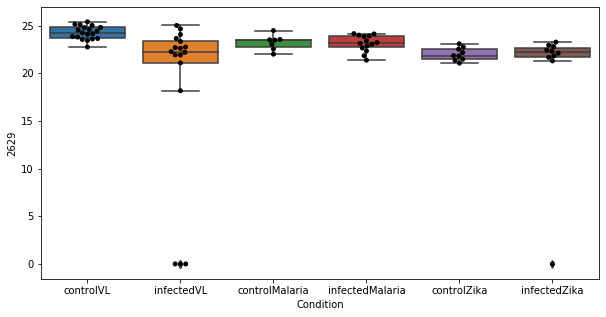

267 row m/z                129.127
row retention time     3.67199
p-val                 0.842747
adj.P.Val             0.994953
custom_id                  357
compound_names             NaN
Name: 357, dtype: object


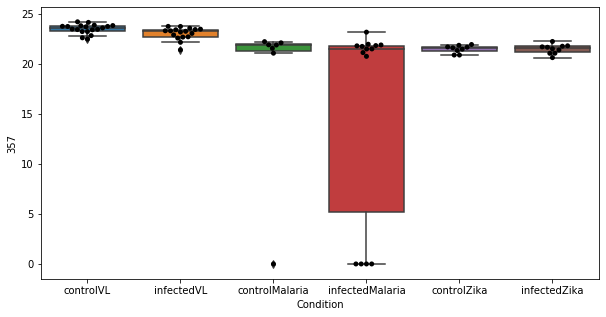

268 row m/z                402.882
row retention time     11.9156
p-val                 0.844201
adj.P.Val             0.994953
custom_id                 2607
compound_names             NaN
Name: 2607, dtype: object


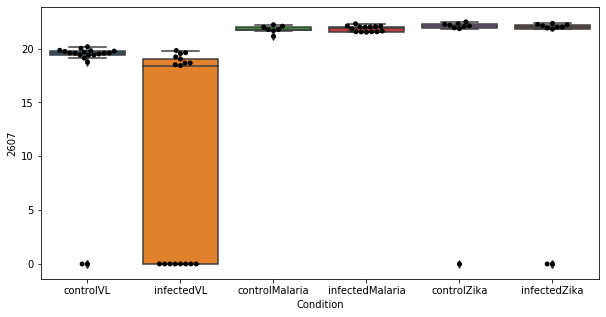

269 row m/z                196.154
row retention time     4.61676
p-val                 0.845069
adj.P.Val             0.994953
custom_id                 1327
compound_names             NaN
Name: 1327, dtype: object


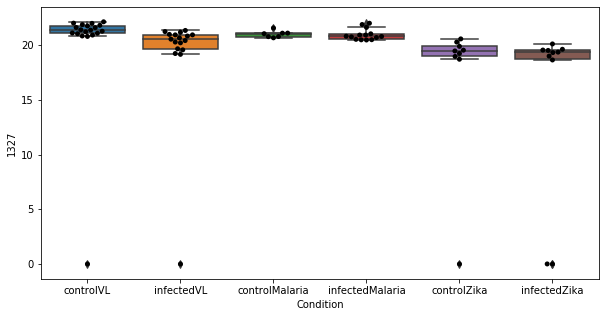

270 row m/z                288.225
row retention time      3.5182
p-val                 0.849379
adj.P.Val             0.994953
custom_id                 2237
compound_names             NaN
Name: 2237, dtype: object


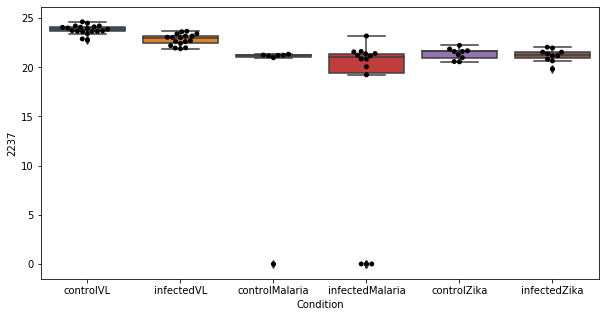

271 row m/z                204.123
row retention time     6.92219
p-val                 0.851304
adj.P.Val             0.994953
custom_id                 1420
compound_names             NaN
Name: 1420, dtype: object


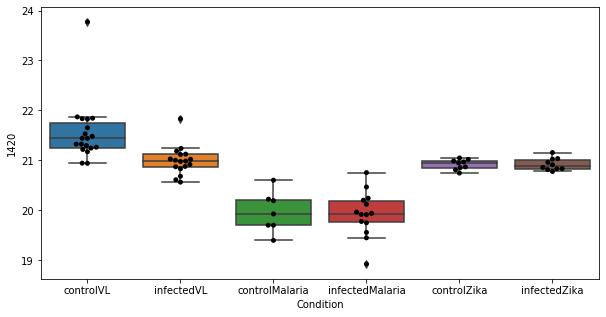

272 row m/z                                                         180.066
row retention time                                               4.7821
p-val                                                          0.851333
adj.P.Val                                                      0.994953
custom_id                                                          4782
compound_names        adrenochrome$Hippurate; Hippuric acid; N-Benzo...
Name: 4782, dtype: object


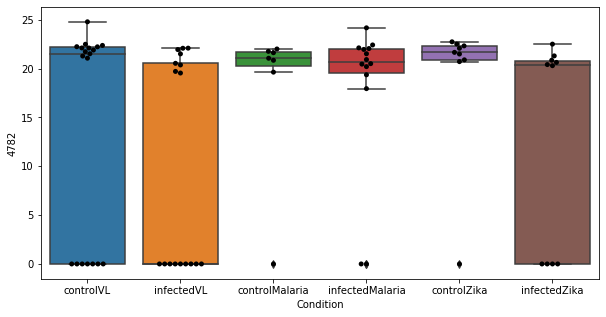

273 row m/z                769.593
row retention time     3.35804
p-val                 0.851826
adj.P.Val             0.994953
custom_id                 2918
compound_names             NaN
Name: 2918, dtype: object


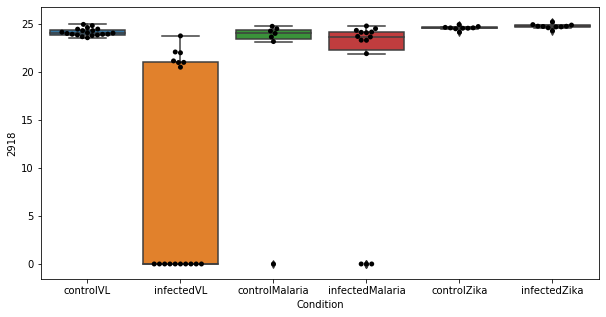

274 row m/z                           200.128
row retention time                6.93909
p-val                            0.853738
adj.P.Val                        0.994953
custom_id                            1366
compound_names        propionyl-carnitine
Name: 1366, dtype: object


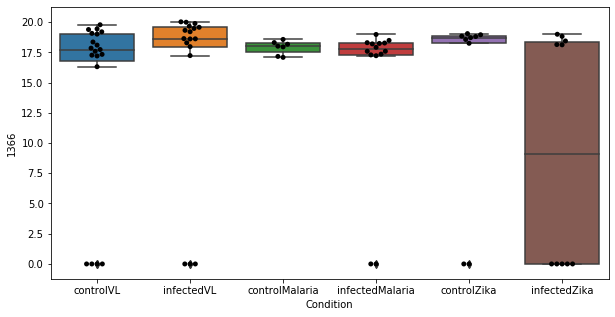

275 row m/z                627.535
row retention time     3.18681
p-val                 0.855025
adj.P.Val             0.994953
custom_id                 2804
compound_names             NaN
Name: 2804, dtype: object


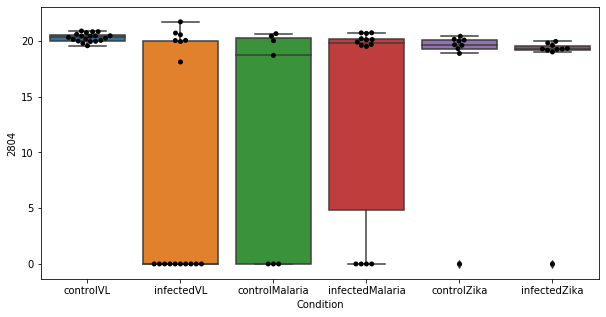

276 row m/z                304.212
row retention time     6.92105
p-val                 0.855807
adj.P.Val             0.994953
custom_id                 2320
compound_names             NaN
Name: 2320, dtype: object


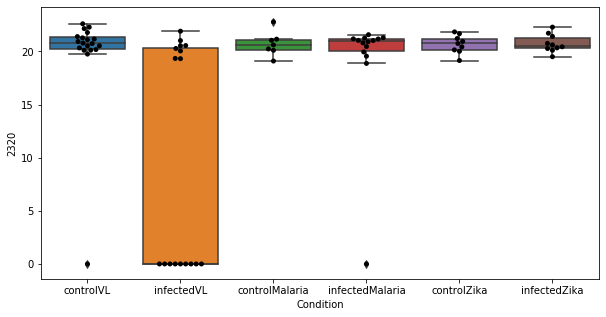

277 row m/z                145.097
row retention time     11.4185
p-val                  0.85791
adj.P.Val             0.994953
custom_id                  583
compound_names             NaN
Name: 583, dtype: object


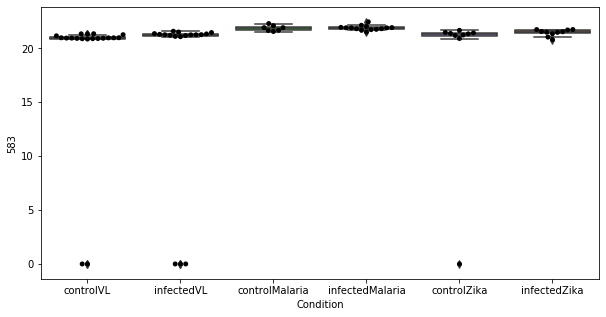

278 row m/z                768.589
row retention time     3.37843
p-val                 0.861913
adj.P.Val             0.994953
custom_id                 2915
compound_names             NaN
Name: 2915, dtype: object


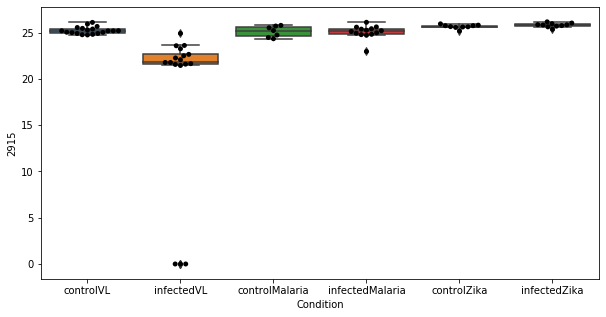

279 row m/z                267.172
row retention time     3.56122
p-val                 0.862035
adj.P.Val             0.994953
custom_id                 2051
compound_names             NaN
Name: 2051, dtype: object


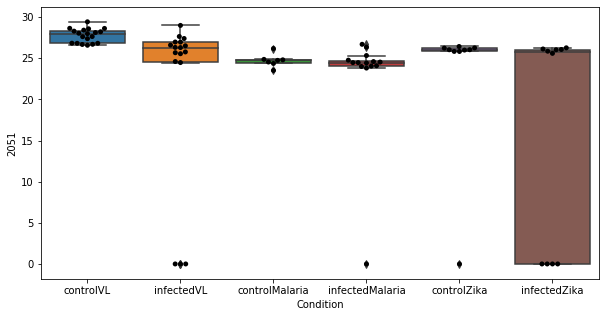

280 row m/z                                                         181.072
row retention time                                              6.90948
p-val                                                          0.868266
adj.P.Val                                                      0.994953
custom_id                                                          1100
compound_names        1,7-Dimethylxanthine; Paraxanthine$adrenochrom...
Name: 1100, dtype: object


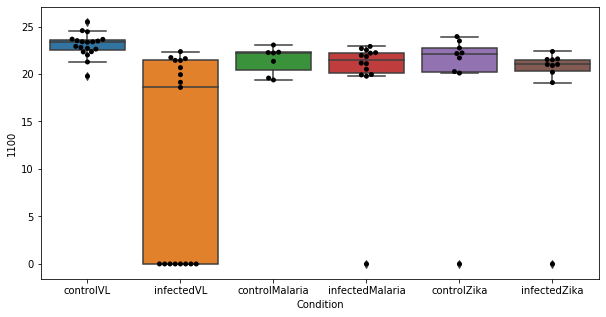

281 row m/z                287.222
row retention time     3.51858
p-val                 0.871844
adj.P.Val             0.994953
custom_id                 2230
compound_names             NaN
Name: 2230, dtype: object


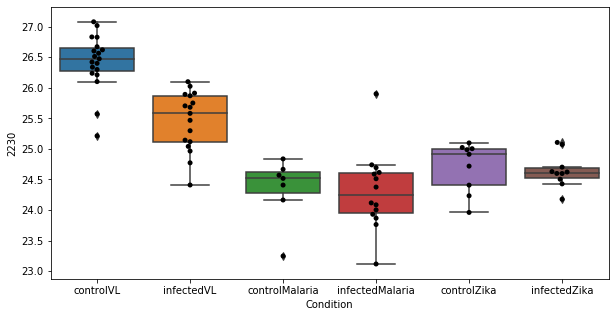

282 row m/z                159.113
row retention time     10.5791
p-val                 0.874349
adj.P.Val             0.994953
custom_id                  805
compound_names             NaN
Name: 805, dtype: object


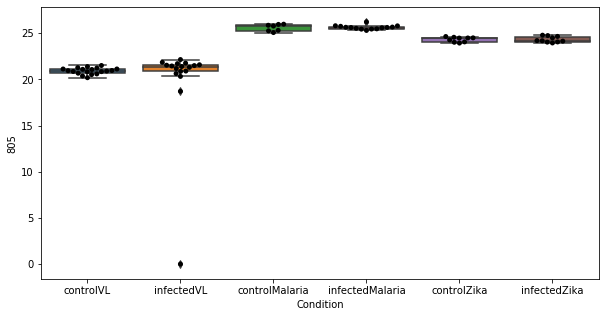

283 row m/z                284.331
row retention time     7.09322
p-val                 0.875188
adj.P.Val             0.994953
custom_id                 2207
compound_names             NaN
Name: 2207, dtype: object


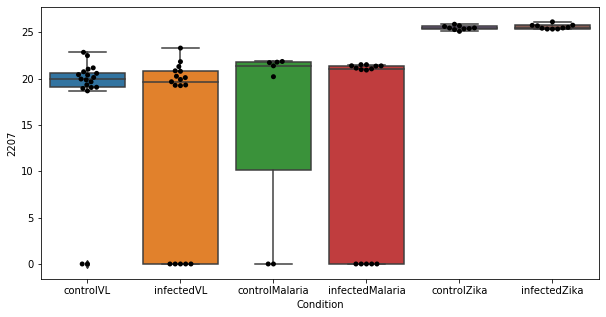

284 row m/z                                                         156.102
row retention time                                               6.9078
p-val                                                          0.875461
adj.P.Val                                                      0.994953
custom_id                                                           742
compound_names        L-Normetanephrine$L-Adrenaline; (R)-(-)-Adrena...
Name: 742, dtype: object


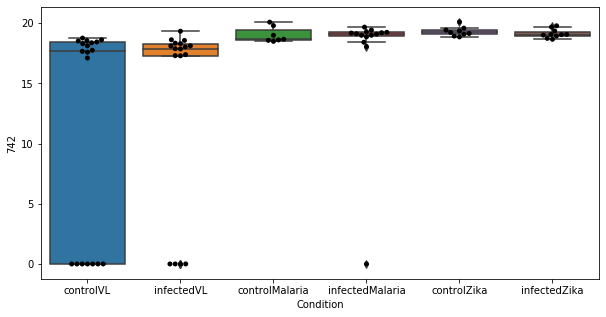

285 row m/z                196.126
row retention time     4.67656
p-val                 0.876402
adj.P.Val             0.994953
custom_id                 1325
compound_names             NaN
Name: 1325, dtype: object


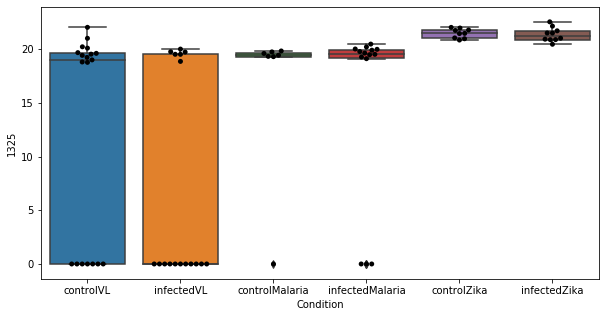

286 row m/z                151.097
row retention time     6.91018
p-val                 0.876693
adj.P.Val             0.994953
custom_id                  683
compound_names             NaN
Name: 683, dtype: object


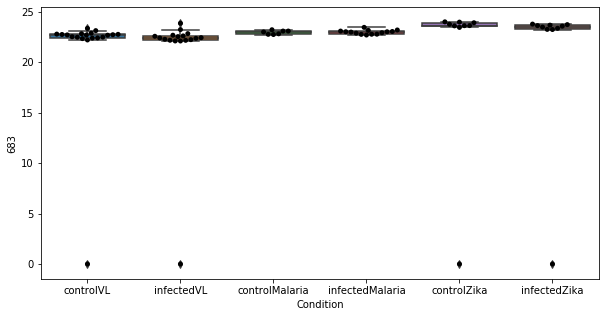

287 row m/z                120.972
row retention time      4.9277
p-val                 0.878495
adj.P.Val             0.994953
custom_id                 4489
compound_names             NaN
Name: 4489, dtype: object


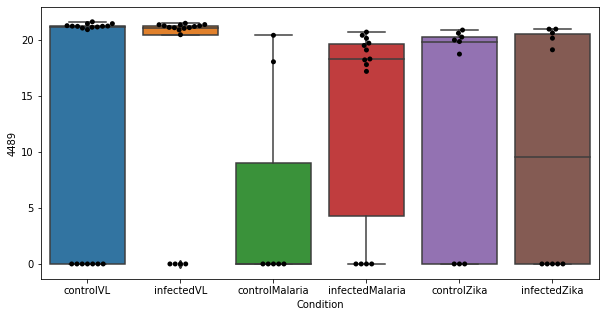

288 row m/z                784.584
row retention time      3.3816
p-val                 0.880383
adj.P.Val             0.994953
custom_id                 2938
compound_names             NaN
Name: 2938, dtype: object


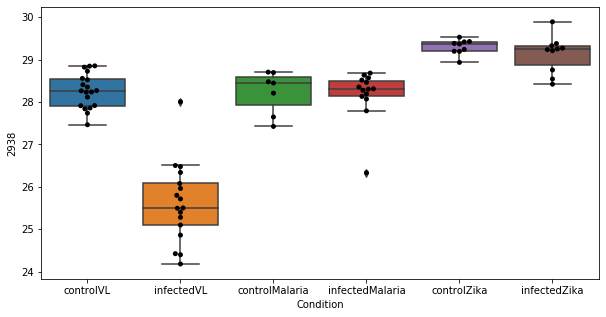

289 row m/z                239.149
row retention time     4.63439
p-val                 0.880521
adj.P.Val             0.994953
custom_id                 1828
compound_names             NaN
Name: 1828, dtype: object


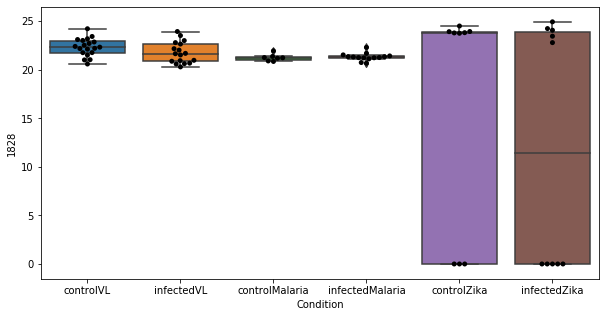

290 row m/z                780.553
row retention time     3.38498
p-val                 0.884898
adj.P.Val             0.994953
custom_id                 2932
compound_names             NaN
Name: 2932, dtype: object


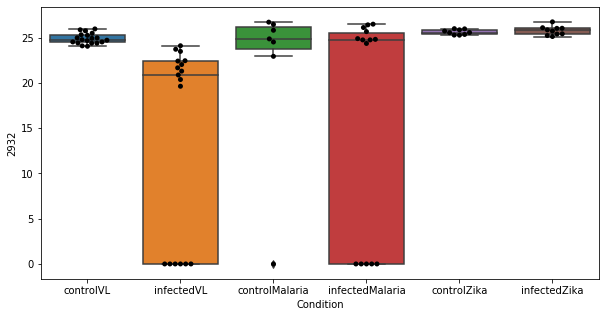

291 row m/z                558.473
row retention time     3.22191
p-val                 0.885219
adj.P.Val             0.994953
custom_id                 2757
compound_names             NaN
Name: 2757, dtype: object


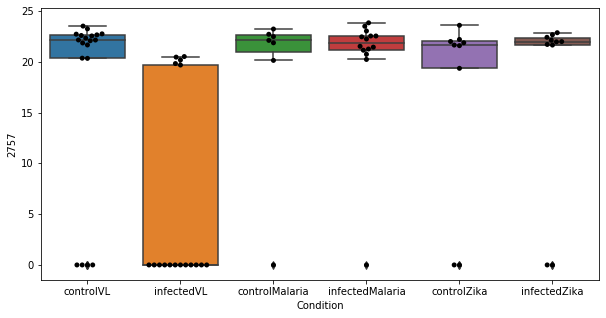

292 row m/z                260.185
row retention time     6.91448
p-val                 0.885459
adj.P.Val             0.994953
custom_id                 2006
compound_names             NaN
Name: 2006, dtype: object


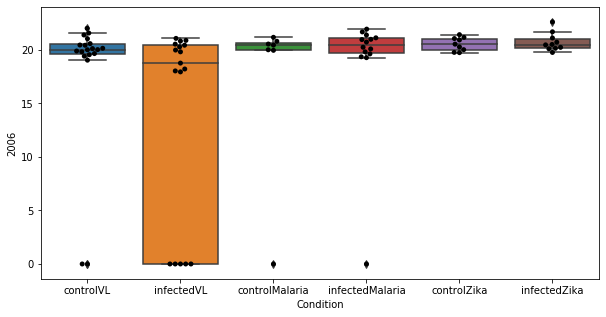

293 row m/z                                                        202.107
row retention time                                             6.91272
p-val                                                         0.886144
adj.P.Val                                                     0.994953
custom_id                                                         1389
compound_names        Pantothenate; Pantothenic acid; (R)-Pantothenate
Name: 1389, dtype: object


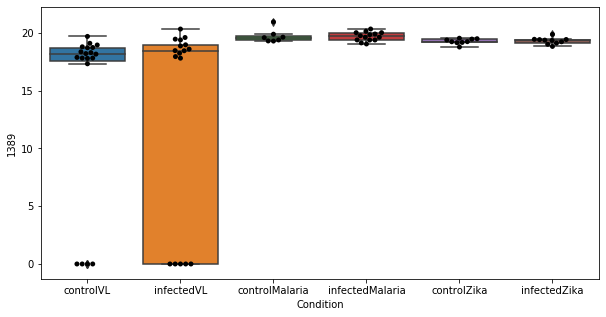

294 row m/z                202.144
row retention time     6.92495
p-val                 0.889266
adj.P.Val             0.994953
custom_id                 1394
compound_names             NaN
Name: 1394, dtype: object


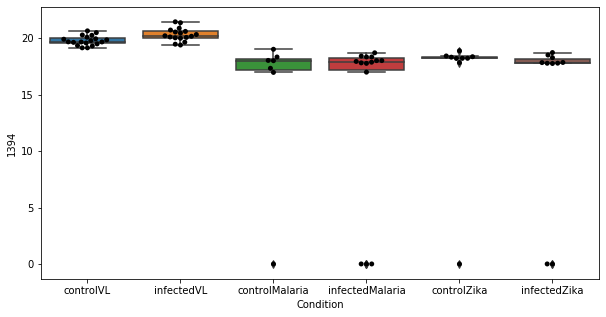

295 row m/z                180.159
row retention time     3.96897
p-val                 0.891033
adj.P.Val             0.994953
custom_id                 1089
compound_names             NaN
Name: 1089, dtype: object


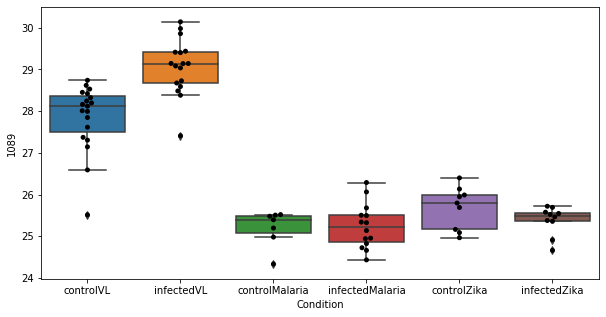

296 row m/z                149.117
row retention time     4.17529
p-val                 0.893734
adj.P.Val             0.994953
custom_id                  662
compound_names             NaN
Name: 662, dtype: object


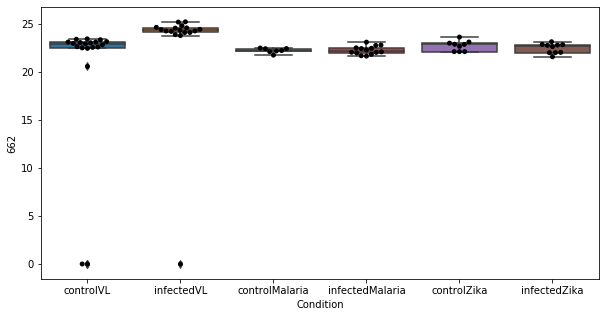

297 row m/z                 246.17
row retention time     7.08516
p-val                 0.894369
adj.P.Val             0.994953
custom_id                 1895
compound_names             NaN
Name: 1895, dtype: object


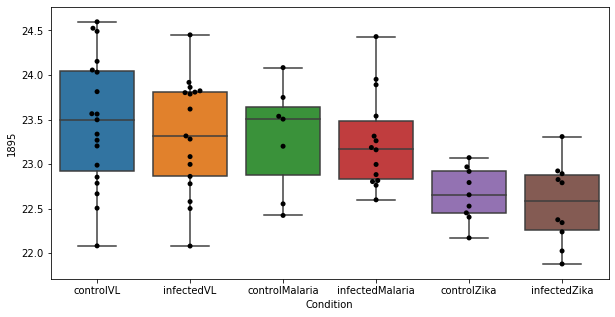

298 row m/z                705.582
row retention time     3.63469
p-val                 0.896893
adj.P.Val             0.994953
custom_id                 2848
compound_names             NaN
Name: 2848, dtype: object


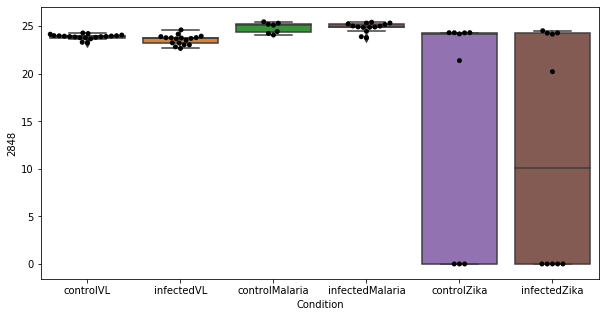

299 row m/z                164.136
row retention time     3.96968
p-val                  0.90445
adj.P.Val             0.994953
custom_id                  878
compound_names             NaN
Name: 878, dtype: object


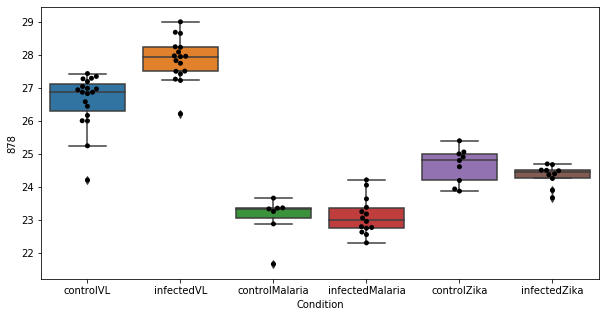

300 row m/z                                                         256.165
row retention time                                               6.9096
p-val                                                          0.908574
adj.P.Val                                                      0.994953
custom_id                                                          1970
compound_names        3-oxo-6(S)-hydroxy-tetradec-8Z-enoate$3-oxo-6(...
Name: 1970, dtype: object


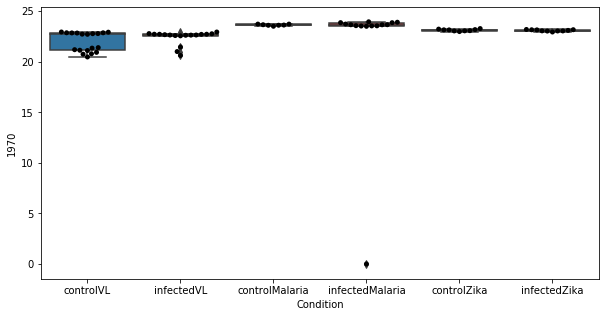

301 row m/z                305.252
row retention time      3.5251
p-val                 0.910075
adj.P.Val             0.994953
custom_id                 2332
compound_names             NaN
Name: 2332, dtype: object


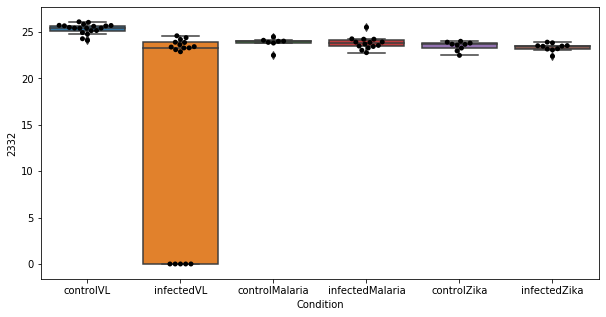

302 row m/z                183.078
row retention time     3.77591
p-val                 0.910698
adj.P.Val             0.994953
custom_id                 1112
compound_names             NaN
Name: 1112, dtype: object


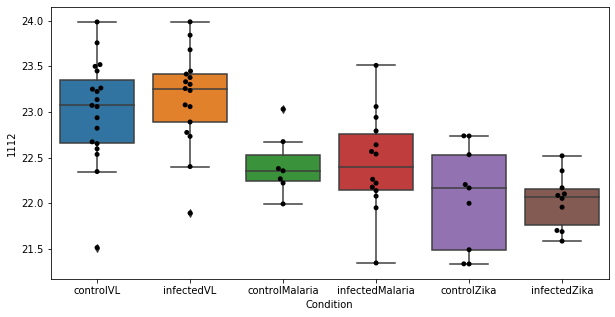

303 row m/z                663.453
row retention time     3.26067
p-val                 0.912683
adj.P.Val             0.994953
custom_id                 2824
compound_names             NaN
Name: 2824, dtype: object


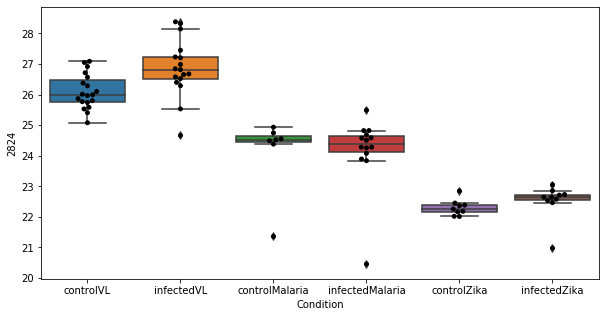

304 row m/z                                                         176.071
row retention time                                              8.68179
p-val                                                          0.913504
adj.P.Val                                                      0.994953
custom_id                                                          1033
compound_names        4-Hydroxy-5-phenyltetrahydro-1,3-oxazin-2-one$...
Name: 1033, dtype: object


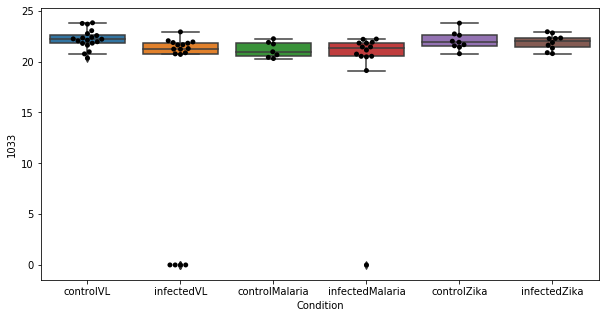

305 row m/z                286.201
row retention time     4.61367
p-val                 0.914314
adj.P.Val             0.994953
custom_id                 2226
compound_names             NaN
Name: 2226, dtype: object


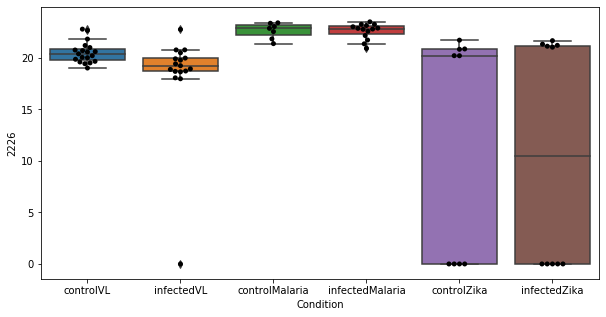

306 row m/z                216.123
row retention time     4.53879
p-val                 0.916822
adj.P.Val             0.994953
custom_id                 3786
compound_names             NaN
Name: 3786, dtype: object


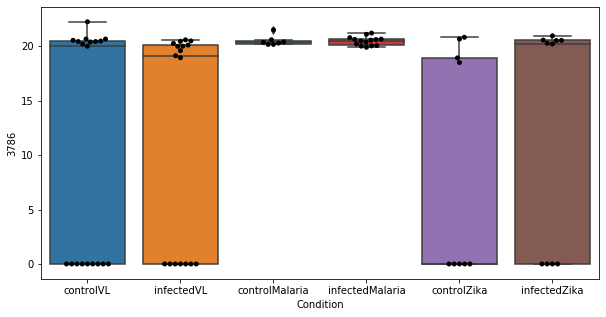

307 row m/z                      198.113
row retention time           6.91952
p-val                       0.918143
adj.P.Val                   0.994953
custom_id                       1341
compound_names        L-Metanephrine
Name: 1341, dtype: object


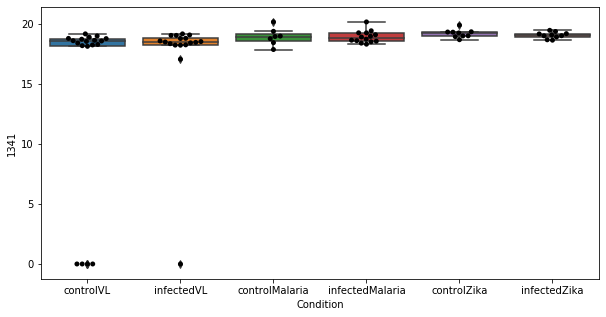

308 row m/z                314.232
row retention time     6.90654
p-val                 0.919004
adj.P.Val             0.994953
custom_id                 2372
compound_names             NaN
Name: 2372, dtype: object


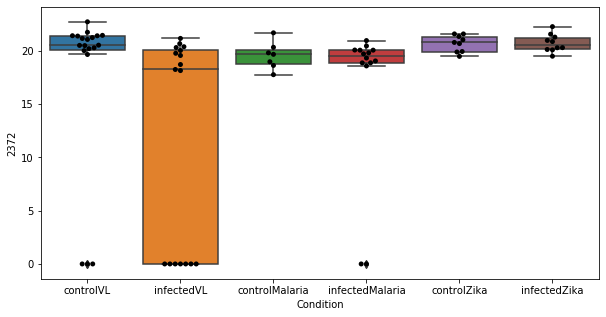

309 row m/z                148.097
row retention time     10.3468
p-val                 0.921249
adj.P.Val             0.994953
custom_id                  635
compound_names             NaN
Name: 635, dtype: object


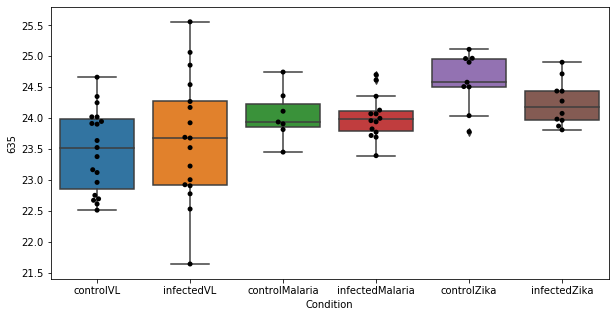

310 row m/z                         213.099
row retention time              4.82583
p-val                          0.921837
adj.P.Val                      0.994953
custom_id                          1520
compound_names        N-Methylserotonin
Name: 1520, dtype: object


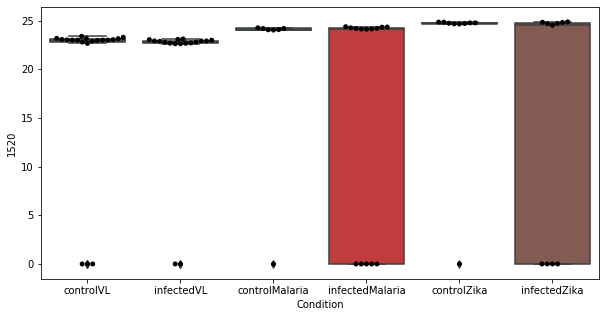

311 row m/z                251.185
row retention time     3.91539
p-val                 0.922136
adj.P.Val             0.994953
custom_id                 1931
compound_names             NaN
Name: 1931, dtype: object


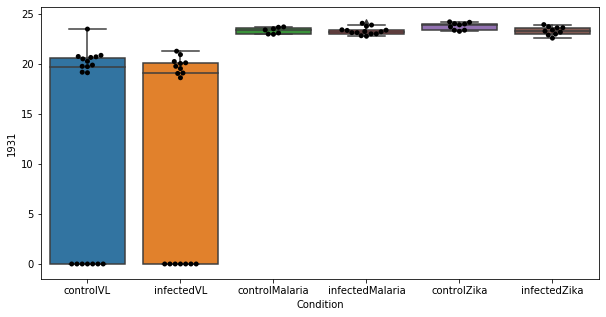

312 row m/z                163.133
row retention time     3.96907
p-val                 0.926789
adj.P.Val             0.994953
custom_id                  862
compound_names             NaN
Name: 862, dtype: object


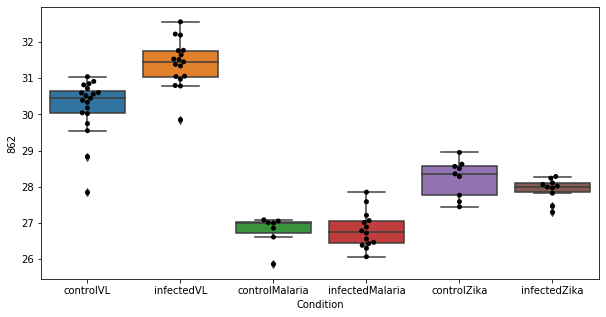

313 row m/z                542.323
row retention time     3.93039
p-val                  0.93285
adj.P.Val             0.994953
custom_id                 2743
compound_names             NaN
Name: 2743, dtype: object


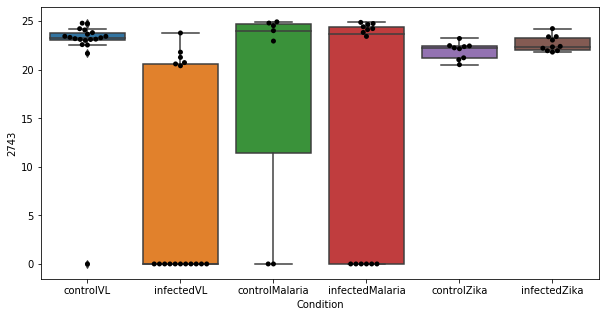

314 row m/z                785.588
row retention time     3.38821
p-val                  0.93467
adj.P.Val             0.994953
custom_id                 2939
compound_names             NaN
Name: 2939, dtype: object


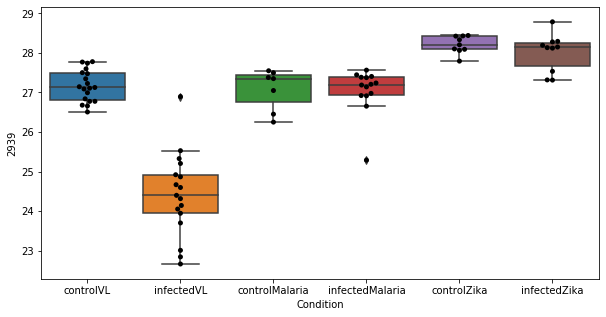

315 row m/z                188.128
row retention time     6.92066
p-val                 0.935901
adj.P.Val             0.994953
custom_id                 1196
compound_names             NaN
Name: 1196, dtype: object


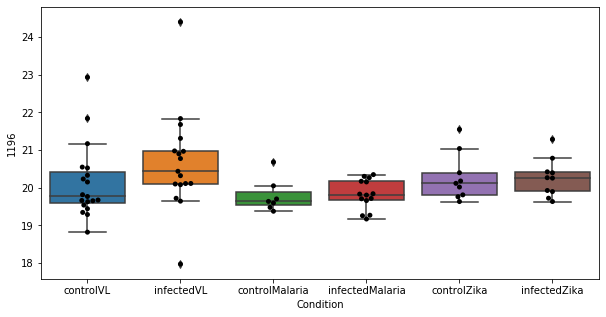

316 row m/z                           218.139
row retention time                4.57637
p-val                            0.936445
adj.P.Val                        0.994953
custom_id                            1594
compound_names        propionyl-carnitine
Name: 1594, dtype: object


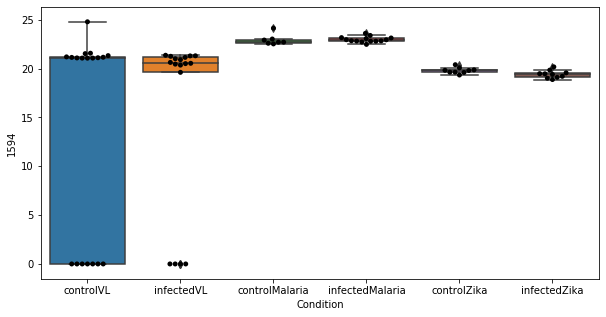

317 row m/z                701.559
row retention time     3.59986
p-val                 0.936719
adj.P.Val             0.994953
custom_id                 2842
compound_names             NaN
Name: 2842, dtype: object


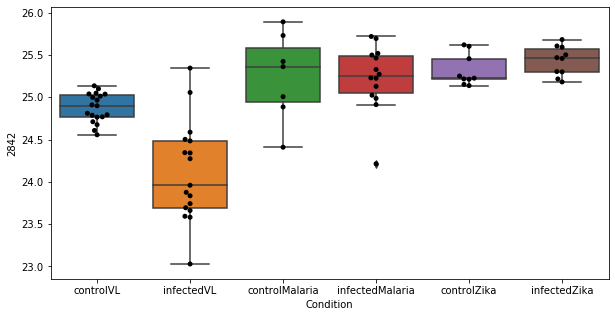

318 row m/z                158.154
row retention time     3.78918
p-val                 0.937282
adj.P.Val             0.994953
custom_id                  785
compound_names             NaN
Name: 785, dtype: object


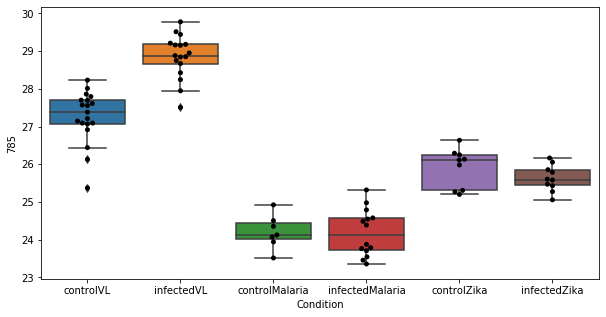

319 row m/z                                                        202.107
row retention time                                             4.63681
p-val                                                         0.943351
adj.P.Val                                                     0.994953
custom_id                                                         1390
compound_names        Pantothenate; Pantothenic acid; (R)-Pantothenate
Name: 1390, dtype: object


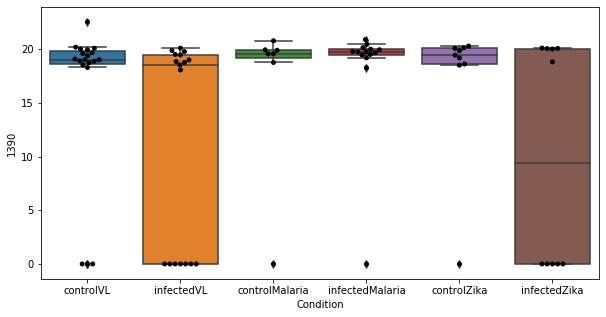

320 row m/z                262.144
row retention time     6.89358
p-val                 0.943491
adj.P.Val             0.994953
custom_id                 2019
compound_names             NaN
Name: 2019, dtype: object


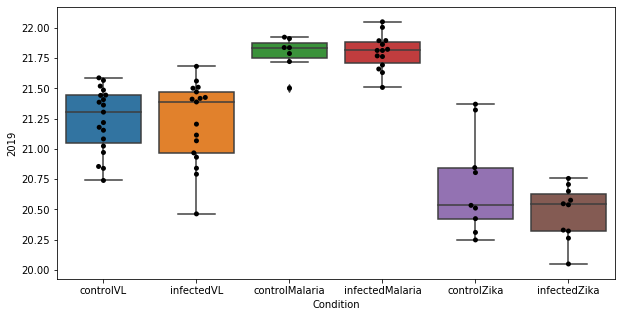

321 row m/z                272.185
row retention time     3.66337
p-val                 0.944256
adj.P.Val             0.994953
custom_id                 2093
compound_names             NaN
Name: 2093, dtype: object


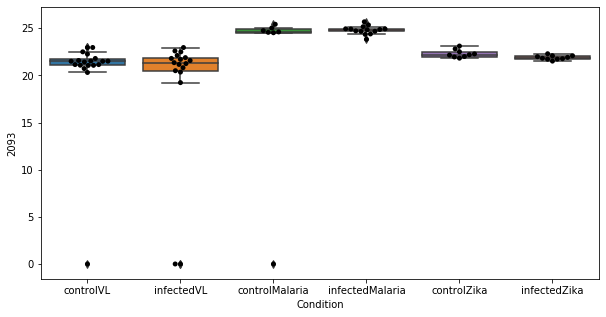

322 row m/z                 344.28
row retention time     4.27191
p-val                 0.945436
adj.P.Val             0.994953
custom_id                 2480
compound_names             NaN
Name: 2480, dtype: object


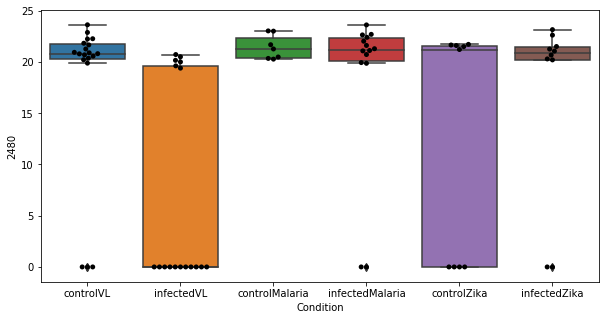

323 row m/z                                                         187.097
row retention time                                               6.9094
p-val                                                          0.945476
adj.P.Val                                                      0.994953
custom_id                                                          1174
compound_names        N-Trimethyl-2-aminoethylphosphonate; 2-Trimeth...
Name: 1174, dtype: object


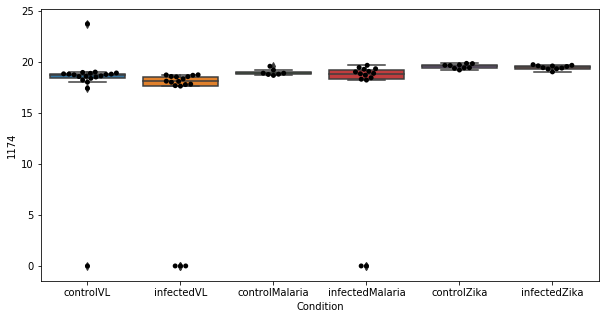

324 row m/z                                                         266.122
row retention time                                                4.677
p-val                                                          0.950212
adj.P.Val                                                      0.994953
custom_id                                                          2043
compound_names        Thiamin; Thiamine; Vitamin B1; Aneurin; Antibe...
Name: 2043, dtype: object


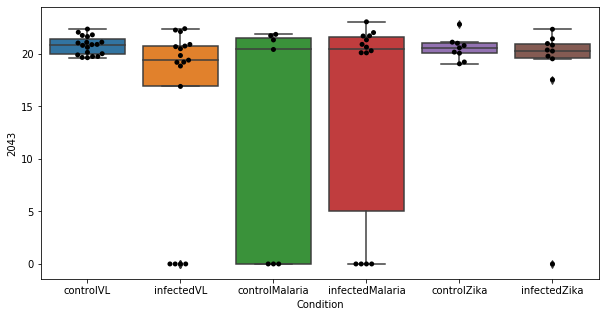

325 row m/z                212.149
row retention time     4.67119
p-val                 0.950867
adj.P.Val             0.994953
custom_id                 1503
compound_names             NaN
Name: 1503, dtype: object


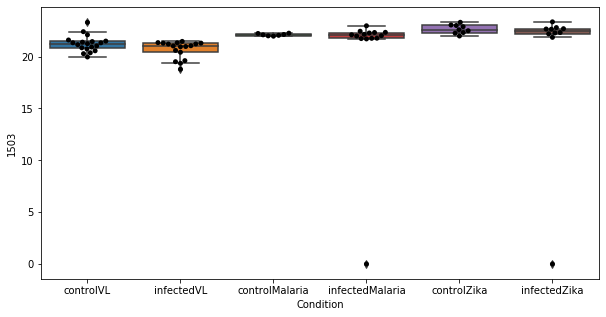

326 row m/z                763.595
row retention time     3.38039
p-val                 0.954641
adj.P.Val             0.994953
custom_id                 2906
compound_names             NaN
Name: 2906, dtype: object


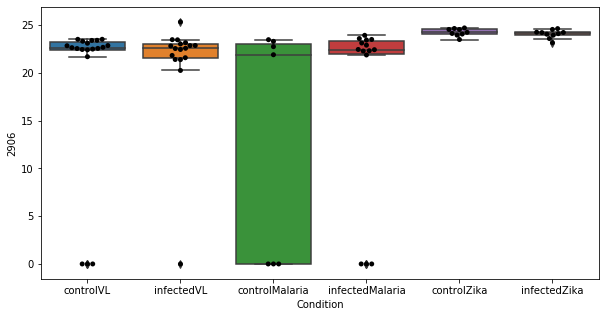

327 row m/z                165.112
row retention time     4.55043
p-val                 0.959131
adj.P.Val             0.994953
custom_id                  887
compound_names             NaN
Name: 887, dtype: object


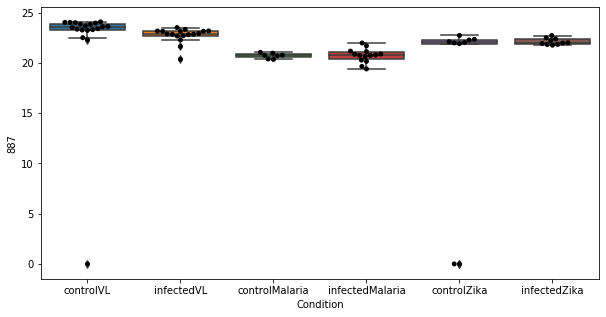

328 row m/z                275.103
row retention time     4.89831
p-val                  0.96128
adj.P.Val             0.994953
custom_id                 2116
compound_names             NaN
Name: 2116, dtype: object


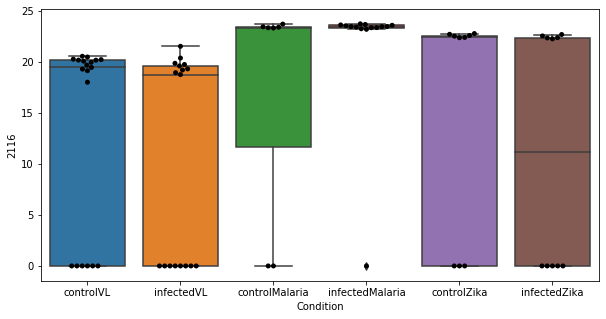

329 row m/z                197.129
row retention time      4.5875
p-val                 0.962599
adj.P.Val             0.994953
custom_id                 3684
compound_names             NaN
Name: 3684, dtype: object


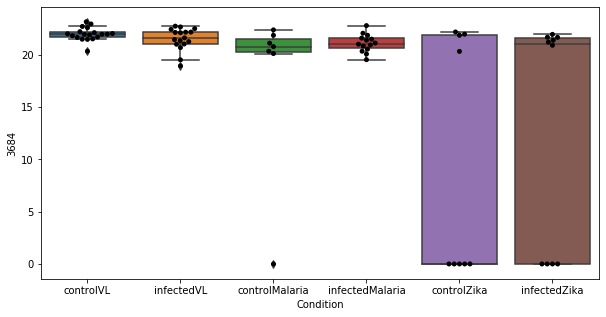

330 row m/z                212.095
row retention time     4.78512
p-val                 0.964469
adj.P.Val             0.994953
custom_id                 1499
compound_names             NaN
Name: 1499, dtype: object


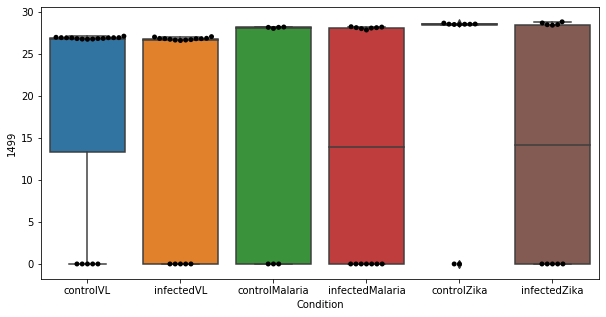

331 row m/z                                                         266.121
row retention time                                              6.90529
p-val                                                          0.965033
adj.P.Val                                                      0.994953
custom_id                                                          2042
compound_names        Thiamin; Thiamine; Vitamin B1; Aneurin; Antibe...
Name: 2042, dtype: object


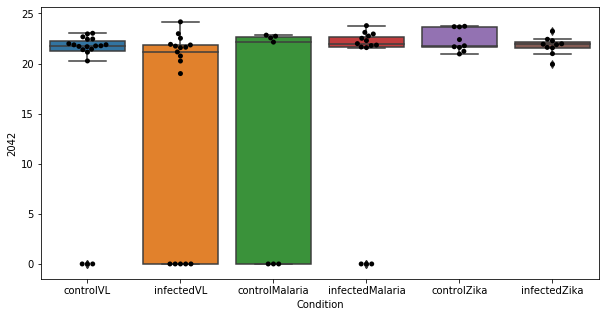

332 row m/z                                                         132.102
row retention time                                              6.91202
p-val                                                          0.967694
adj.P.Val                                                      0.994953
custom_id                                                           418
compound_names        L-Isoleucine; 2-Amino-3-methylvaleric acid$L-L...
Name: 418, dtype: object


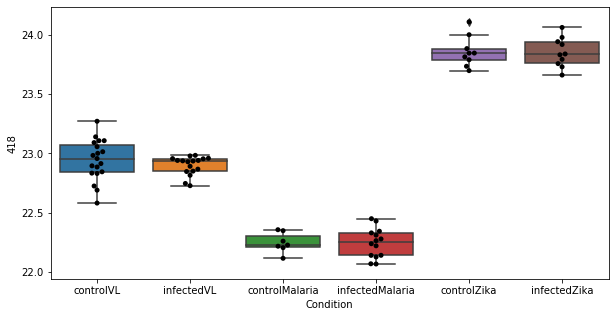

333 row m/z                246.243
row retention time     6.86942
p-val                 0.970252
adj.P.Val             0.994953
custom_id                 1898
compound_names             NaN
Name: 1898, dtype: object


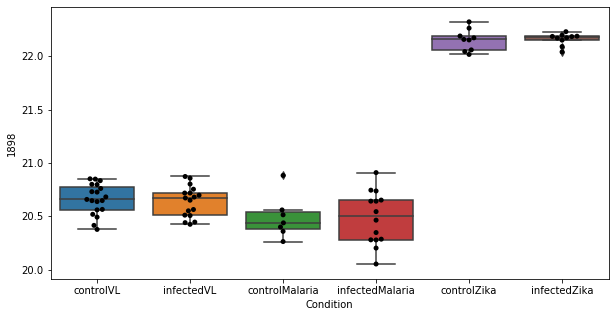

334 row m/z                                                         166.086
row retention time                                              6.90212
p-val                                                          0.972802
adj.P.Val                                                      0.994953
custom_id                                                           897
compound_names        L-Phenylalanine; (S)-alpha-Amino-beta-phenylpr...
Name: 897, dtype: object


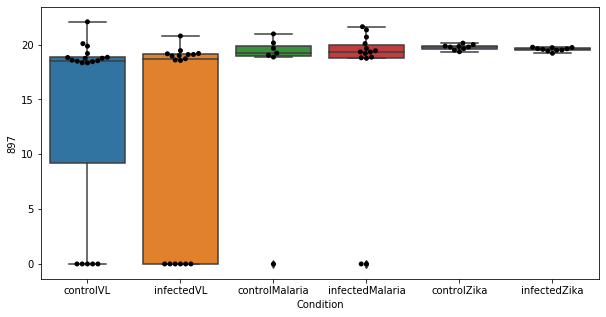

335 row m/z                                                         144.102
row retention time                                              6.90918
p-val                                                          0.975529
adj.P.Val                                                      0.994953
custom_id                                                           568
compound_names        6-Acetamido-2-oxohexanoate; 2-Oxo-6-acetamidoc...
Name: 568, dtype: object


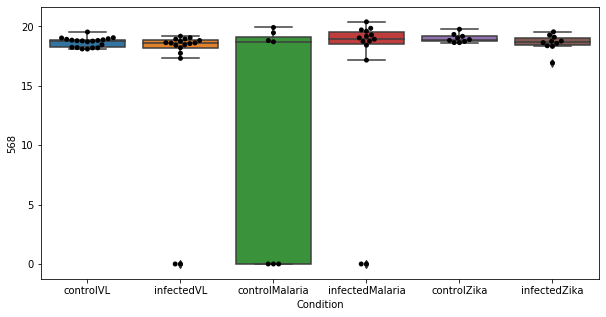

336 row m/z                732.554
row retention time     3.42745
p-val                 0.977549
adj.P.Val             0.994953
custom_id                 2863
compound_names             NaN
Name: 2863, dtype: object


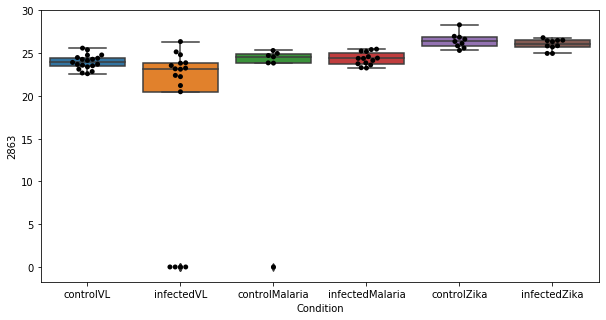

337 row m/z                 264.18
row retention time      3.6472
p-val                 0.981332
adj.P.Val             0.995849
custom_id                 2037
compound_names             NaN
Name: 2037, dtype: object


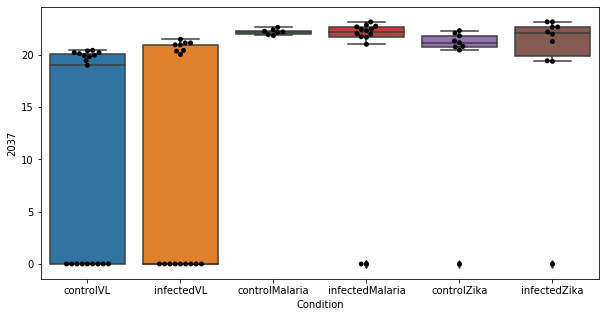

338 row m/z                682.486
row retention time      3.2696
p-val                 0.986527
adj.P.Val             0.998167
custom_id                 2836
compound_names             NaN
Name: 2836, dtype: object


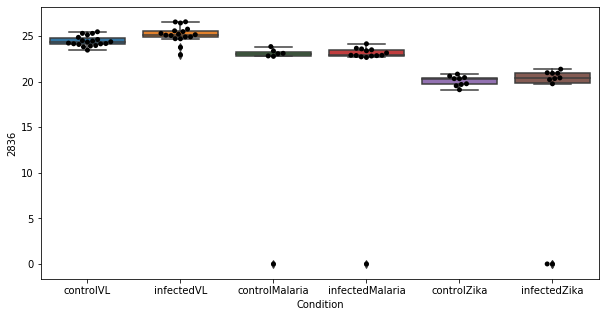

339 row m/z                186.113
row retention time     4.63573
p-val                  0.99382
adj.P.Val             0.999796
custom_id                 1153
compound_names             NaN
Name: 1153, dtype: object


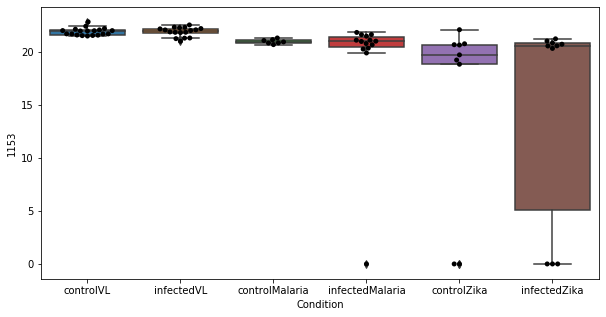

340 row m/z                187.096
row retention time     4.63844
p-val                  0.99573
adj.P.Val             0.999796
custom_id                 1178
compound_names             NaN
Name: 1178, dtype: object


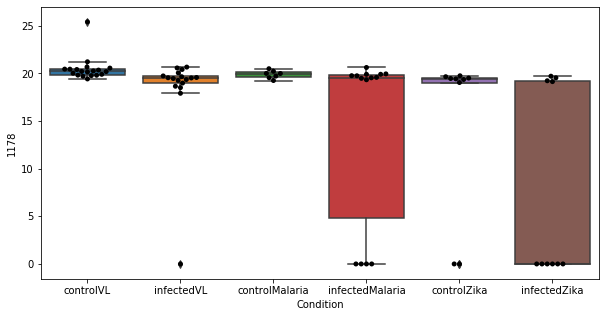

341 row m/z                  149.1
row retention time     10.3389
p-val                 0.998807
adj.P.Val             0.999796
custom_id                 4631
compound_names             NaN
Name: 4631, dtype: object


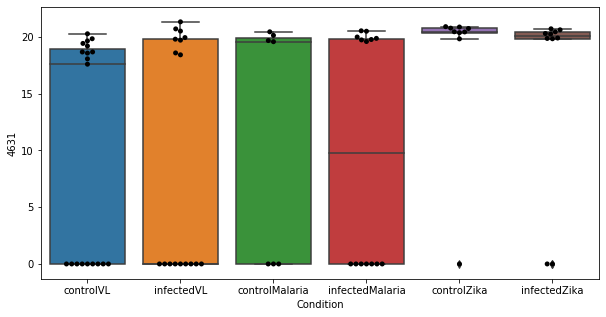

342 row m/z                286.201
row retention time     6.92035
p-val                 0.999796
adj.P.Val             0.999796
custom_id                 2225
compound_names             NaN
Name: 2225, dtype: object


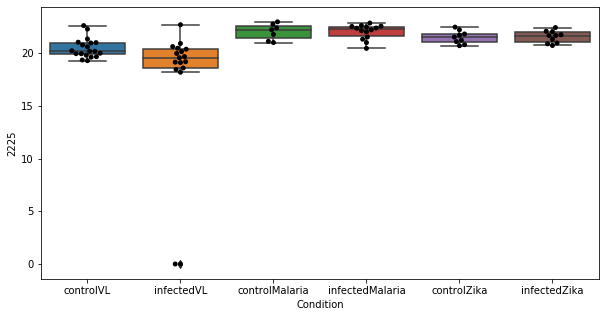

KeyError: 'Condition'

In [123]:
#limma_topfeatures = all_samples_log.loc[toptable.index]
limma_topfeatures = all_samples_log.loc[pdata.index]
limma_topfeatures = limma_topfeatures.transpose()
limma_topfeatures["Condition"] = np.array(sample_description["ConditionDataset"])
for i in range(len(list(limma_topfeatures.columns))):
    print(i,data.loc[list(limma_topfeatures.columns)[i]])
    plt.figure(figsize=(10,5))
    ax = sns.boxplot(y=list(limma_topfeatures.columns)[i], x="Condition", data = limma_topfeatures, order = ['controlVL','infectedVL','controlMalaria', 'infectedMalaria', 'controlZika','infectedZika'] )
    ax = sns.swarmplot(y=list(limma_topfeatures.columns)[i], x="Condition", data = limma_topfeatures, order = ['controlVL','infectedVL','controlMalaria', 'infectedMalaria', 'controlZika','infectedZika'], color="black")
    plt.show()

0 row m/z                    258.11
row retention time        11.3506
p-val                 9.07684e-07
adj.P.Val             0.000549149
custom_id                    2080
compound_names                NaN
Name: 2080, dtype: object


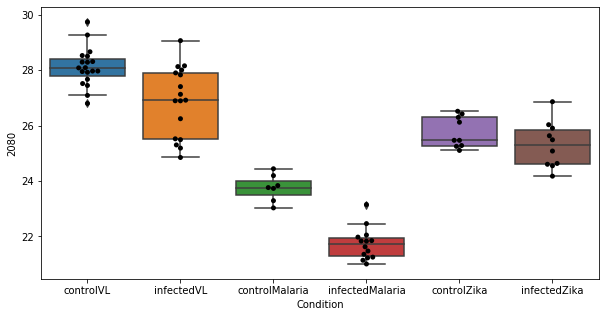

1 row m/z                   482.361
row retention time        3.86973
p-val                 2.52872e-05
adj.P.Val              0.00764939
custom_id                    2754
compound_names                NaN
Name: 2754, dtype: object


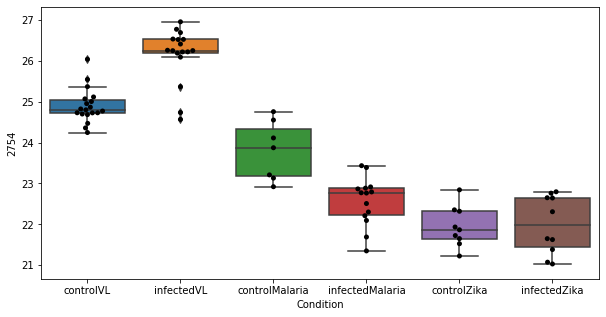

2 row m/z                                                         524.371
row retention time                                               3.7029
p-val                                                       0.000184762
adj.P.Val                                                     0.0235834
custom_id                                                          2798
compound_names        tetracosapentaenoyl carnitine$tetracosapentaen...
Name: 2798, dtype: object


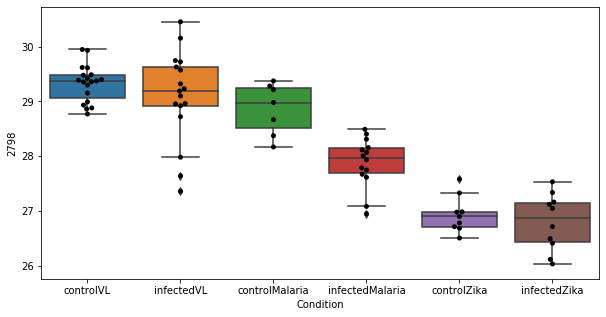

3 row m/z                   525.375
row retention time         3.7012
p-val                 0.000216906
adj.P.Val               0.0235834
custom_id                    2800
compound_names                NaN
Name: 2800, dtype: object


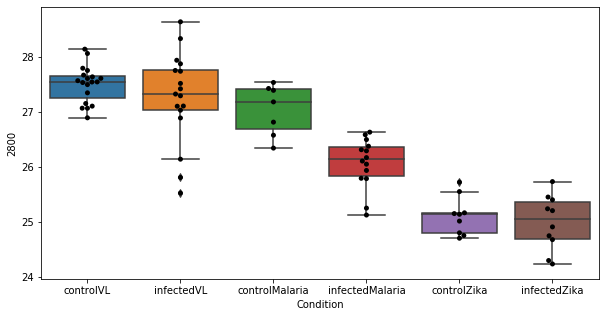

4 row m/z                   158.118
row retention time        8.65825
p-val                 0.000225119
adj.P.Val               0.0235834
custom_id                     862
compound_names                NaN
Name: 862, dtype: object


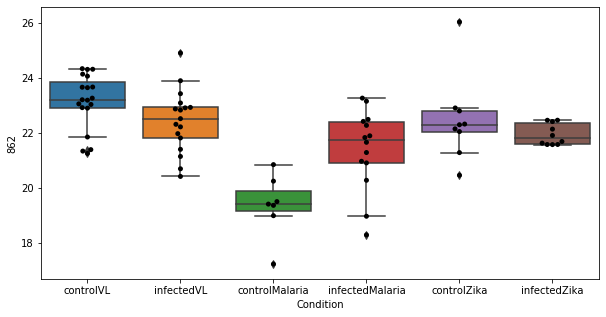

5 row m/z                   526.377
row retention time        3.70252
p-val                 0.000233885
adj.P.Val               0.0235834
custom_id                    2801
compound_names                NaN
Name: 2801, dtype: object


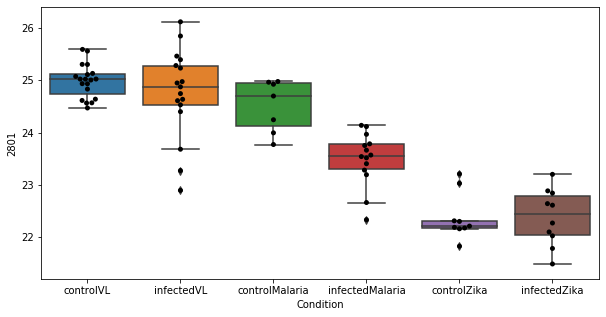

6 row m/z                                                         508.376
row retention time                                              3.77338
p-val                                                       0.000334879
adj.P.Val                                                     0.0289431
custom_id                                                          4264
compound_names        1-Acyl-sn-glycero-3-phosphocholine; 1-Acyl-sn-...
Name: 4264, dtype: object


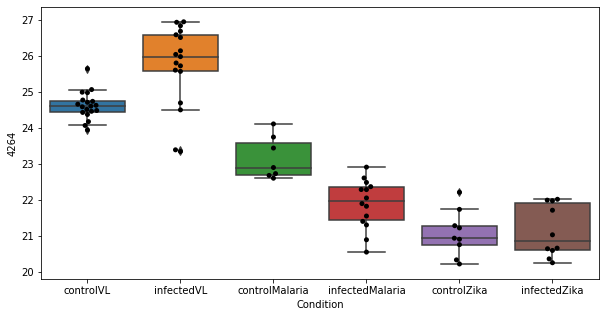

7 row m/z                  787.666
row retention time       3.99348
p-val                 0.00146278
adj.P.Val               0.110623
custom_id                   3027
compound_names               NaN
Name: 3027, dtype: object


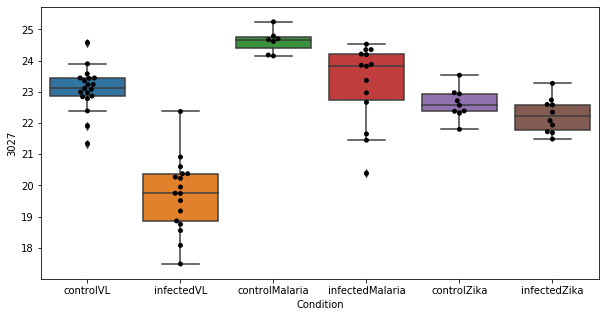

8 row m/z                  469.312
row retention time       3.97423
p-val                 0.00193935
adj.P.Val               0.130368
custom_id                   2743
compound_names               NaN
Name: 2743, dtype: object


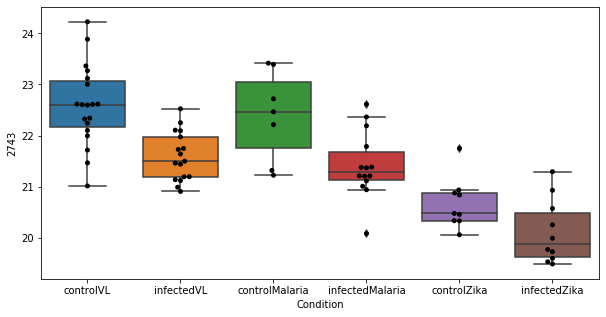

9 row m/z                  480.345
row retention time       3.77761
p-val                 0.00271502
adj.P.Val               0.164259
custom_id                   2751
compound_names               NaN
Name: 2751, dtype: object


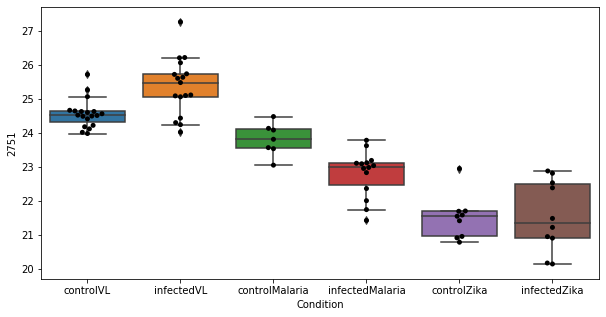

10 row m/z                                                         241.031
row retention time                                              12.5979
p-val                                                        0.00361738
adj.P.Val                                                      0.198956
custom_id                                                          1917
compound_names        L-Cystine; L-Dicysteine; L-alpha-Diamino-beta-...
Name: 1917, dtype: object


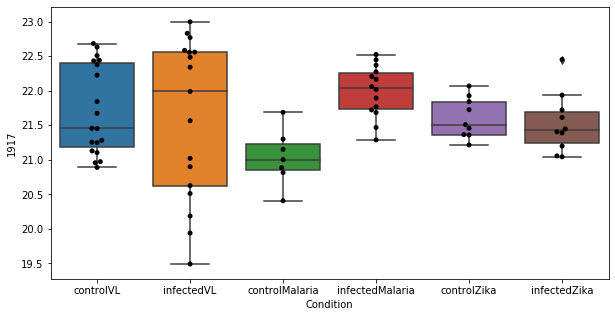

11 row m/z                  499.348
row retention time       3.82135
p-val                 0.00414578
adj.P.Val               0.205399
custom_id                   2773
compound_names               NaN
Name: 2773, dtype: object


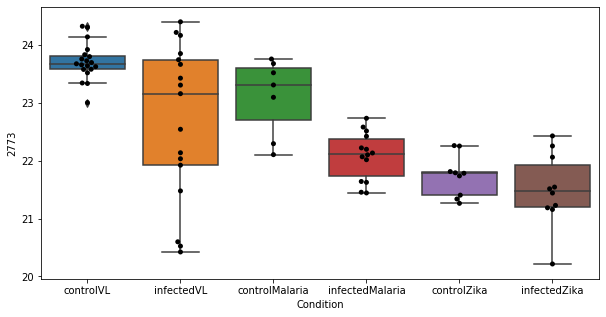

12 row m/z                  510.356
row retention time       3.75557
p-val                 0.00469477
adj.P.Val               0.205399
custom_id                   2779
compound_names               NaN
Name: 2779, dtype: object


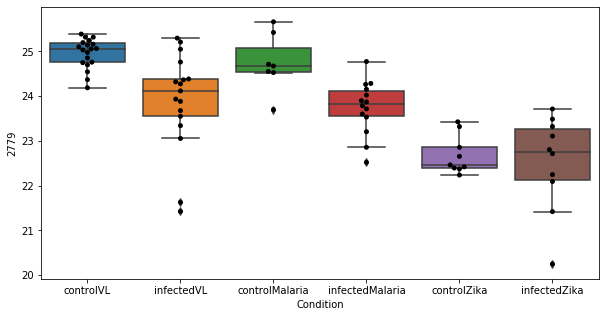

13 row m/z                  495.328
row retention time        3.8612
p-val                 0.00518985
adj.P.Val               0.205399
custom_id                   2766
compound_names               NaN
Name: 2766, dtype: object


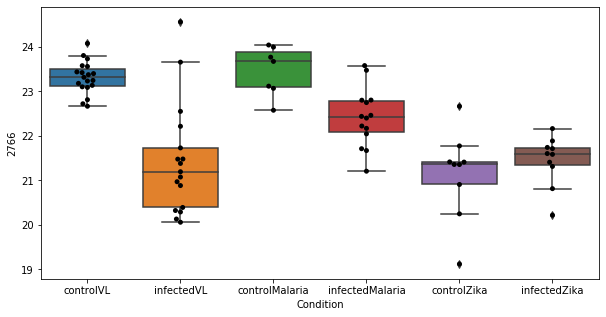

14 row m/z                  498.346
row retention time       3.81396
p-val                 0.00540066
adj.P.Val               0.205399
custom_id                   2771
compound_names               NaN
Name: 2771, dtype: object


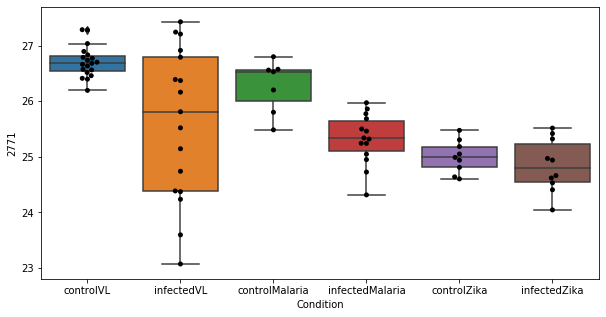

15 row m/z                  171.076
row retention time       9.23593
p-val                 0.00557835
adj.P.Val               0.205399
custom_id                   1045
compound_names               NaN
Name: 1045, dtype: object


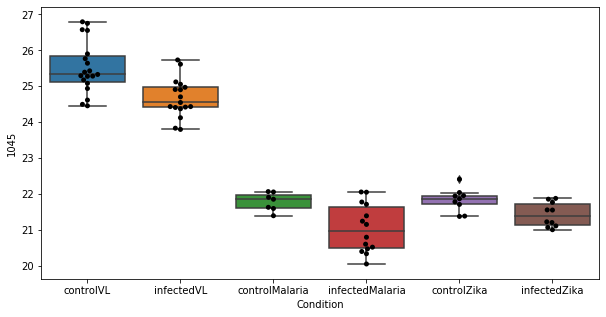

16 row m/z                  497.343
row retention time       3.82271
p-val                 0.00581514
adj.P.Val               0.205399
custom_id                   2769
compound_names               NaN
Name: 2769, dtype: object


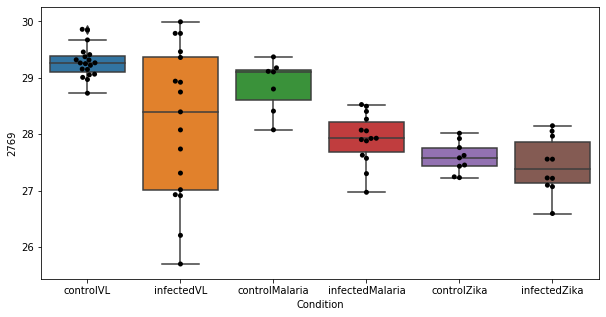

17 row m/z                                                          496.34
row retention time                                              3.81947
p-val                                                        0.00647208
adj.P.Val                                                      0.205399
custom_id                                                          2767
compound_names        docosa-4,7,10,13,16-pentaenoyl carnitine$clupa...
Name: 2767, dtype: object


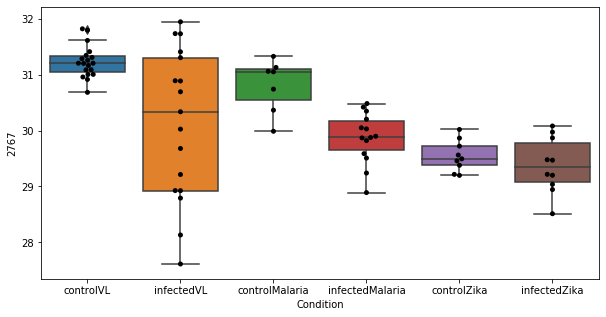

18 row m/z                                                         128.071
row retention time                                              9.77144
p-val                                                        0.00666647
adj.P.Val                                                      0.205399
custom_id                                                           383
compound_names        6-Amino-2-oxohexanoate; 2-Oxo-6-aminocaproate$...
Name: 383, dtype: object


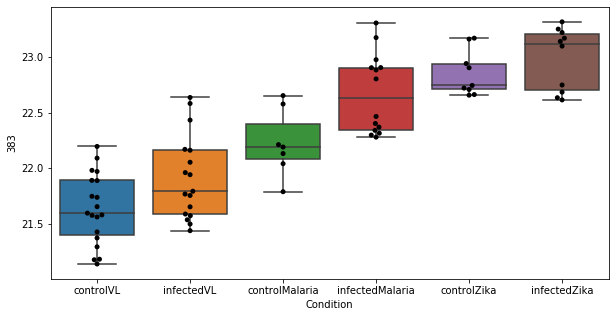

19 row m/z                                         151.112
row retention time                              3.98716
p-val                                        0.00754278
adj.P.Val                                      0.205399
custom_id                                           767
compound_names        Perillyl aldehyde; Perillaldehyde
Name: 767, dtype: object


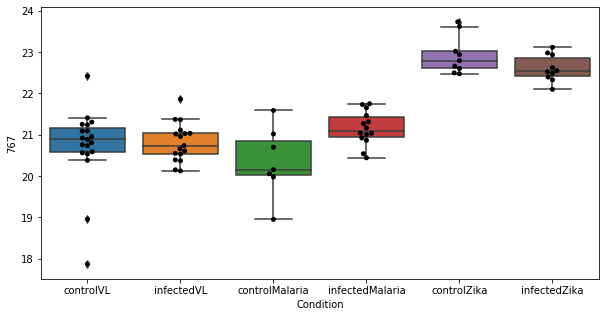

20 row m/z                                                          130.05
row retention time                                              9.23574
p-val                                                         0.0077333
adj.P.Val                                                      0.205399
custom_id                                                           411
compound_names        L-4-Hydroxyglutamate semialdehyde$D-Glutamate;...
Name: 411, dtype: object


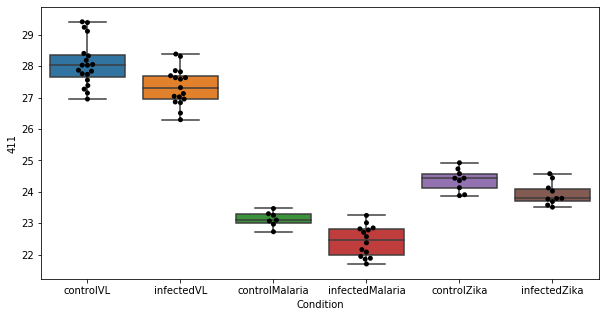

21 row m/z                  174.113
row retention time       9.82136
p-val                 0.00789959
adj.P.Val               0.205399
custom_id                   1089
compound_names               NaN
Name: 1089, dtype: object


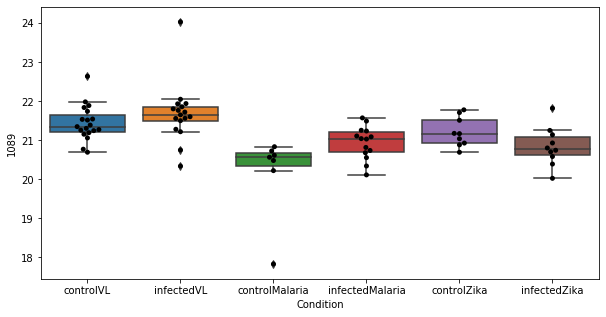

22 row m/z                                                          116.07
row retention time                                              8.61149
p-val                                                        0.00807123
adj.P.Val                                                      0.205399
custom_id                                                           256
compound_names        D-Proline$acetamidopropanal$L-Proline; 2-Pyrro...
Name: 256, dtype: object


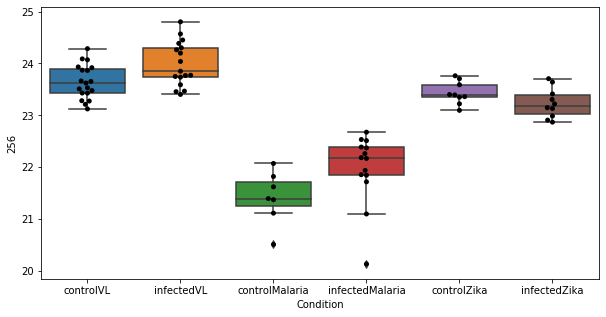

23 row m/z                            468.308
row retention time                 3.97058
p-val                           0.00814805
adj.P.Val                         0.205399
custom_id                             2741
compound_names        Timnodonyl carnitine
Name: 2741, dtype: object


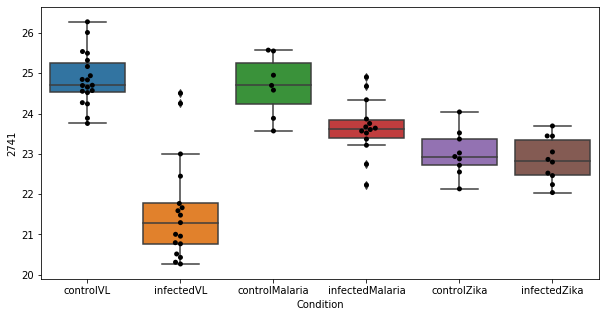

24 row m/z                                                          148.06
row retention time                                              9.59939
p-val                                                         0.0127764
adj.P.Val                                                      0.299096
custom_id                                                           710
compound_names        DL-Glutamate; DL-Glutaminic acid; 2-Aminogluta...
Name: 710, dtype: object


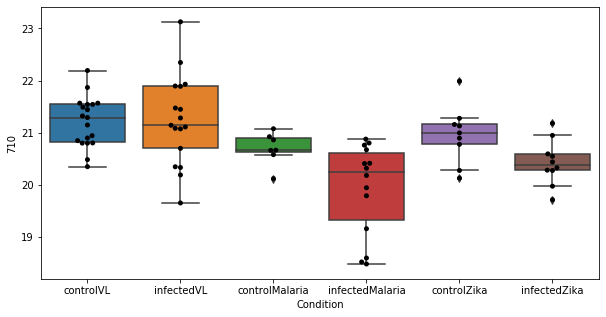

25 row m/z                 171.102
row retention time      4.37024
p-val                 0.0128537
adj.P.Val              0.299096
custom_id                  1049
compound_names              NaN
Name: 1049, dtype: object


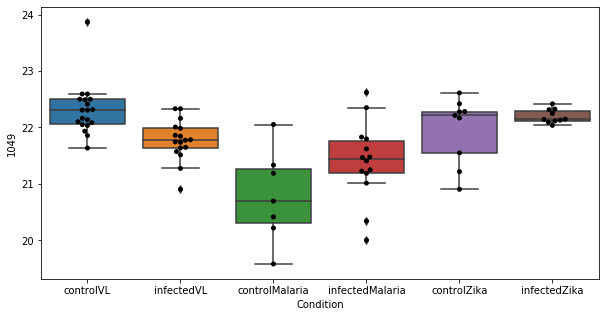

26 row m/z                            253.155
row retention time                 4.14302
p-val                            0.0142199
adj.P.Val                         0.318632
custom_id                             2042
compound_names        histidyl-prolinamide
Name: 2042, dtype: object


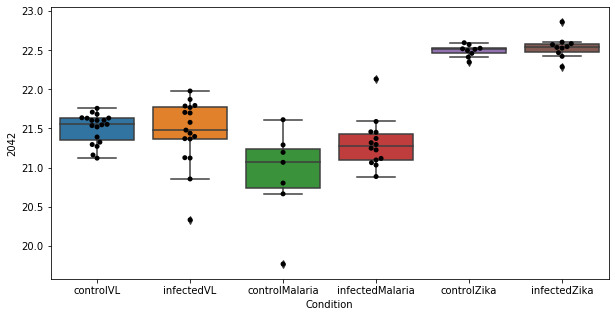

27 row m/z                482.324
row retention time     3.85737
p-val                 0.015164
adj.P.Val             0.327651
custom_id                 2752
compound_names             NaN
Name: 2752, dtype: object


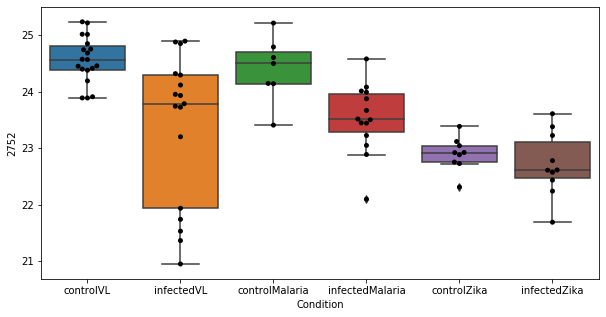

28 row m/z                  103.07
row retention time      9.63256
p-val                 0.0170748
adj.P.Val              0.356217
custom_id                   129
compound_names              NaN
Name: 129, dtype: object


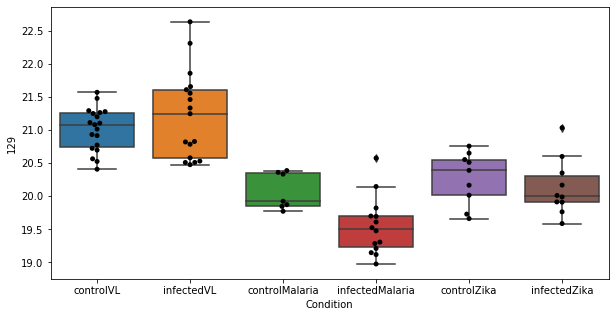

29 row m/z                 234.015
row retention time      9.79681
p-val                 0.0190455
adj.P.Val              0.384084
custom_id                  1836
compound_names              NaN
Name: 1836, dtype: object


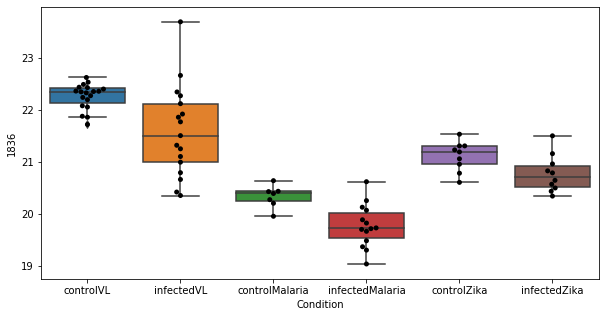

30 row m/z                                                          148.06
row retention time                                              11.7584
p-val                                                         0.0214812
adj.P.Val                                                      0.419229
custom_id                                                           709
compound_names        L-1-Pyrroline-3-hydroxy-5-carboxylate; 3-Hydro...
Name: 709, dtype: object


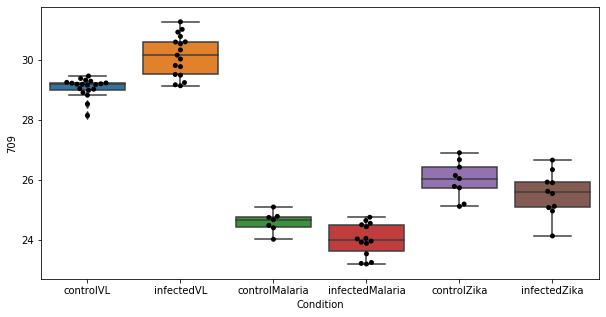

31 row m/z                          494.324
row retention time               3.86492
p-val                          0.0237557
adj.P.Val                       0.449132
custom_id                           2765
compound_names        cervonyl carnitine
Name: 2765, dtype: object


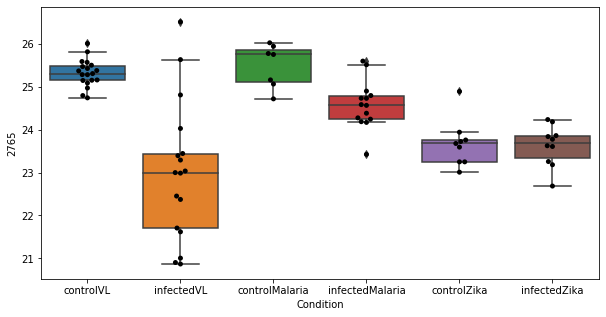

32 row m/z                                                         149.064
row retention time                                              11.7642
p-val                                                         0.0271968
adj.P.Val                                                      0.477806
custom_id                                                           730
compound_names        L-4-Hydroxyglutamate semialdehyde$D-Glutamate;...
Name: 730, dtype: object


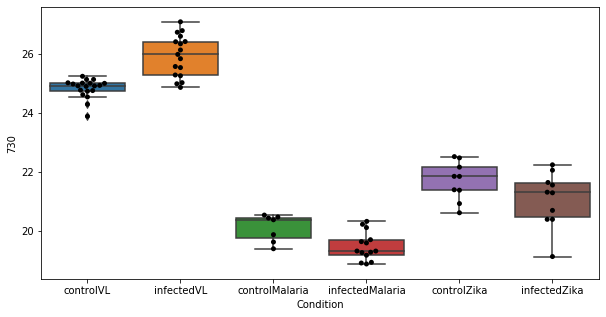

33 row m/z                                                        174.113
row retention time                                              4.3896
p-val                                                        0.0273622
adj.P.Val                                                     0.477806
custom_id                                                         1088
compound_names        Pantothenate; Pantothenic acid; (R)-Pantothenate
Name: 1088, dtype: object


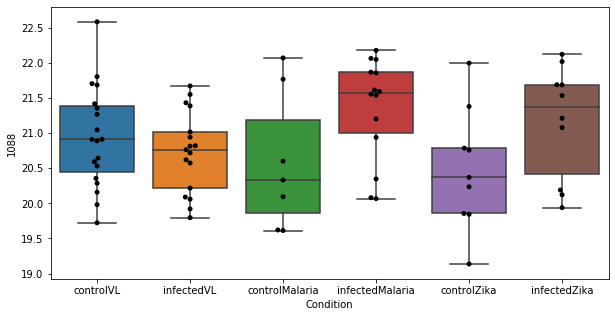

34 row m/z                  181.04
row retention time      9.67025
p-val                 0.0276417
adj.P.Val              0.477806
custom_id                  1172
compound_names              NaN
Name: 1172, dtype: object


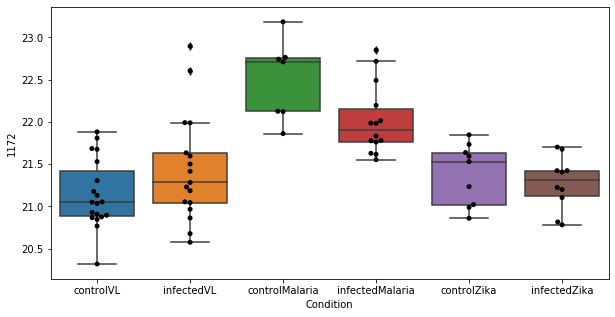

35 row m/z                                                         147.076
row retention time                                              6.87884
p-val                                                         0.0390834
adj.P.Val                                                      0.656819
custom_id                                                           690
compound_names        D-Glutamine; D-2-Aminoglutaramic acid$L-Glutam...
Name: 690, dtype: object


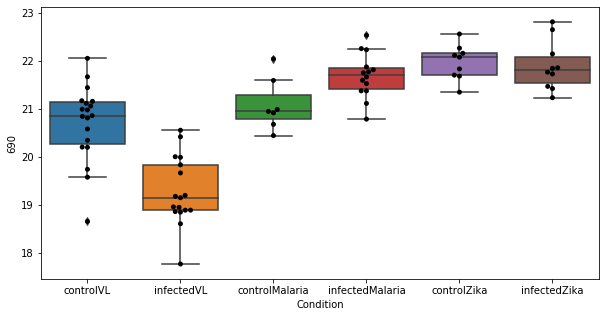

36 row m/z                 774.598
row retention time      3.19673
p-val                 0.0415036
adj.P.Val               0.67864
custom_id                  3000
compound_names              NaN
Name: 3000, dtype: object


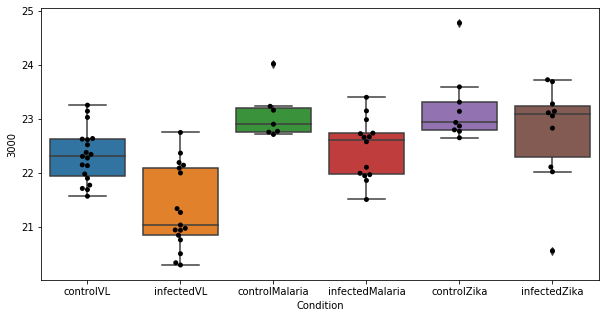

37 row m/z                 303.024
row retention time      10.4124
p-val                 0.0443632
adj.P.Val              0.691235
custom_id                  2395
compound_names              NaN
Name: 2395, dtype: object


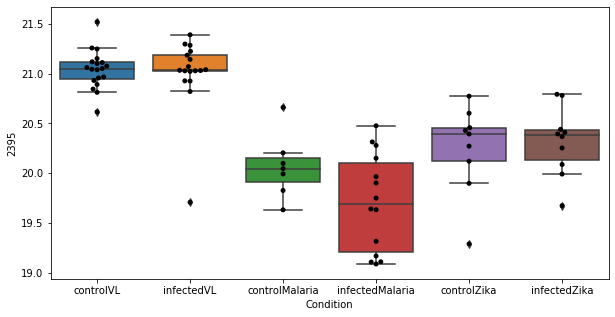

38 row m/z                 105.11
row retention time     16.7044
p-val                 0.044559
adj.P.Val             0.691235
custom_id                  159
compound_names             NaN
Name: 159, dtype: object


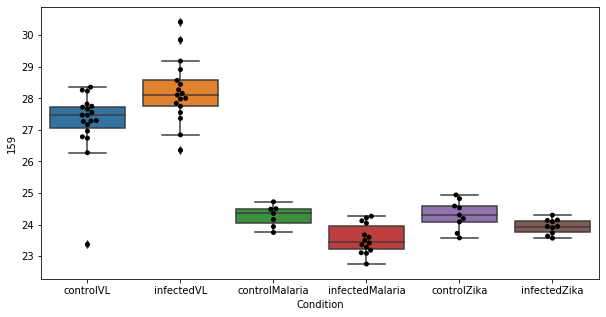

39 row m/z                                                         139.058
row retention time                                              9.88209
p-val                                                         0.0474282
adj.P.Val                                                      0.717352
custom_id                                                          4562
compound_names        Anthranilate; Anthranilic acid; o-Aminobenzoic...
Name: 4562, dtype: object


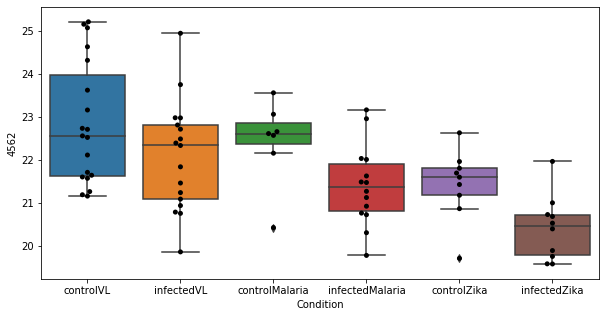

40 row m/z                 816.702
row retention time      3.30508
p-val                 0.0489516
adj.P.Val              0.722335
custom_id                  3093
compound_names              NaN
Name: 3093, dtype: object


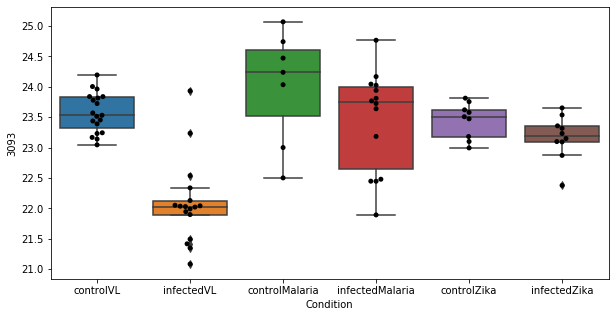

41 row m/z                                                         188.092
row retention time                                              6.71139
p-val                                                         0.0527749
adj.P.Val                                                       0.76021
custom_id                                                          1264
compound_names        6-Acetamido-2-oxohexanoate; 2-Oxo-6-acetamidoc...
Name: 1264, dtype: object


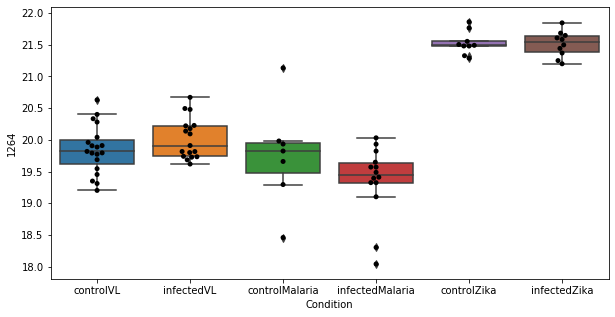

42 row m/z                 148.043
row retention time      6.71425
p-val                 0.0587151
adj.P.Val              0.826108
custom_id                   705
compound_names              NaN
Name: 705, dtype: object


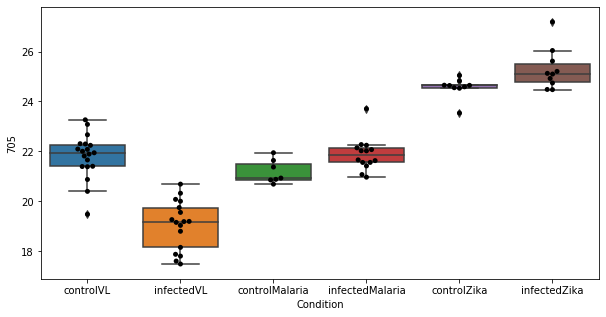

43 row m/z                 133.099
row retention time      9.28806
p-val                 0.0610063
adj.P.Val              0.829641
custom_id                   488
compound_names              NaN
Name: 488, dtype: object


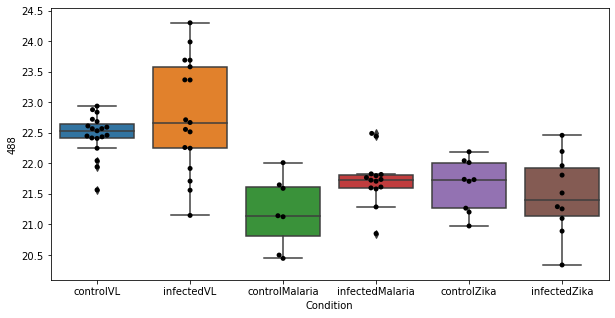

44 row m/z                 315.236
row retention time      4.37261
p-val                 0.0617088
adj.P.Val              0.829641
custom_id                  4139
compound_names              NaN
Name: 4139, dtype: object


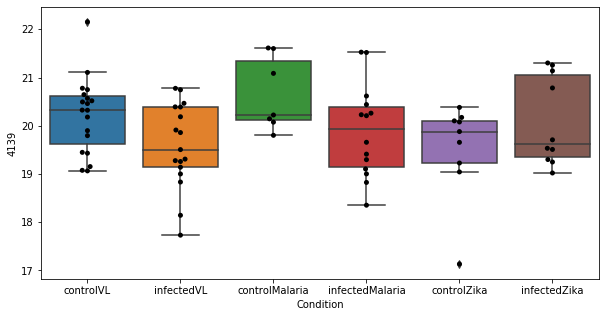

45 row m/z                 134.109
row retention time      9.30018
p-val                 0.0658805
adj.P.Val              0.866472
custom_id                   504
compound_names              NaN
Name: 504, dtype: object


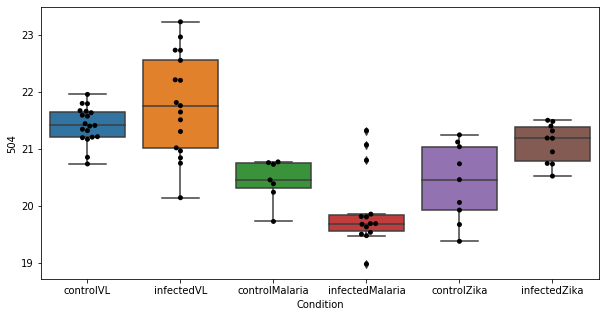

46 row m/z                                                         175.071
row retention time                                              9.92745
p-val                                                         0.0680899
adj.P.Val                                                      0.876476
custom_id                                                          1105
compound_names        4-Imidazolone-5-propanoate; 4-Imidazolone-5-pr...
Name: 1105, dtype: object


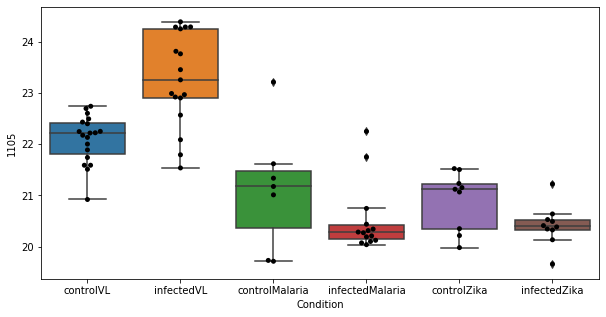

47 row m/z                 132.062
row retention time      9.28326
p-val                 0.0717451
adj.P.Val              0.897448
custom_id                   456
compound_names              NaN
Name: 456, dtype: object


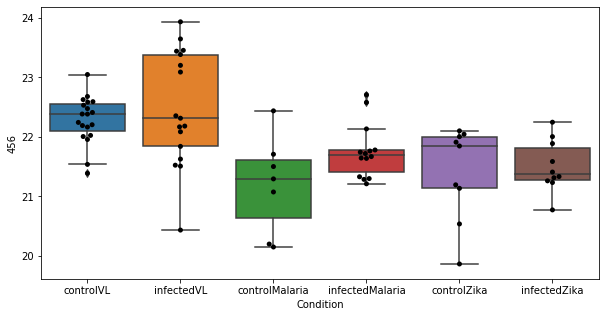

48 row m/z                 160.035
row retention time       10.568
p-val                 0.0726859
adj.P.Val              0.897448
custom_id                   896
compound_names              NaN
Name: 896, dtype: object


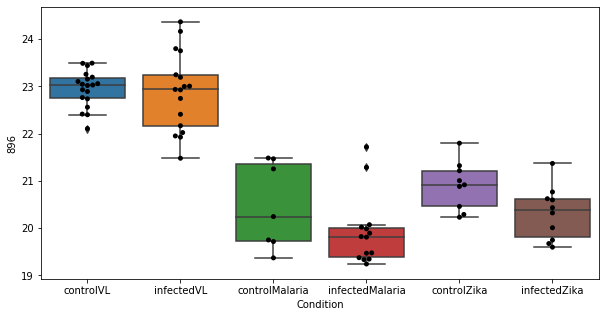

49 row m/z                 240.142
row retention time      6.70326
p-val                 0.0782452
adj.P.Val              0.946767
custom_id                  1911
compound_names              NaN
Name: 1911, dtype: object


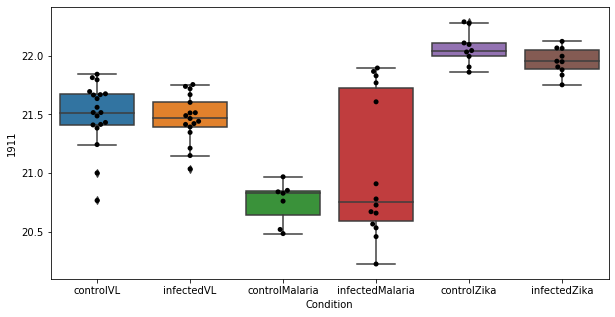

50 row m/z                518.322
row retention time     4.00668
p-val                 0.084109
adj.P.Val             0.982516
custom_id                 2785
compound_names             NaN
Name: 2785, dtype: object


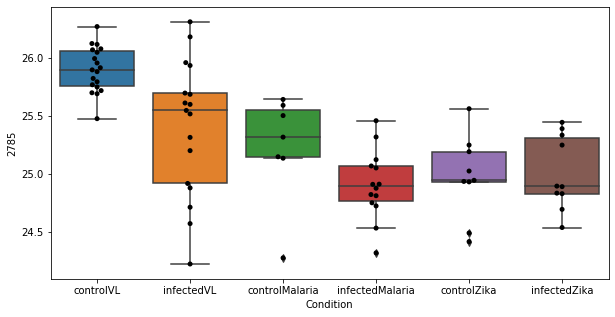

51 row m/z                                  112.051
row retention time                       9.76502
p-val                                  0.0844477
adj.P.Val                               0.982516
custom_id                                    209
compound_names        Cytosine (in DNA)$Cytosine
Name: 209, dtype: object


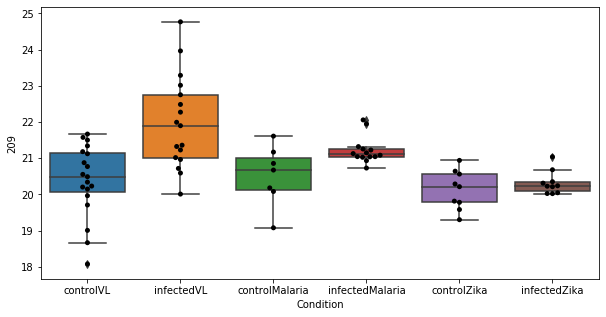

52 row m/z                  568.34
row retention time      3.67488
p-val                 0.0873664
adj.P.Val              0.990505
custom_id                  2832
compound_names              NaN
Name: 2832, dtype: object


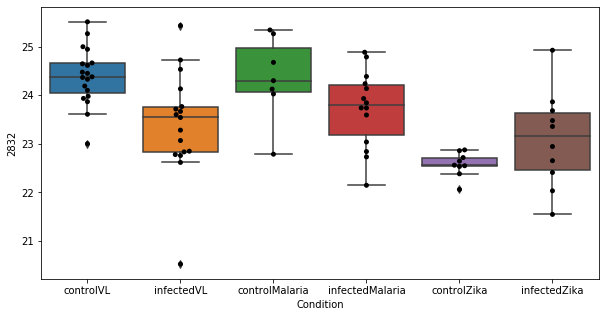

53 row m/z                 240.142
row retention time      4.38087
p-val                 0.0884087
adj.P.Val              0.990505
custom_id                  1912
compound_names              NaN
Name: 1912, dtype: object


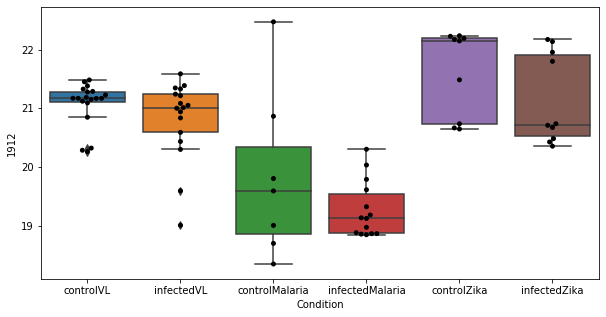

54 row m/z                 522.356
row retention time      3.73699
p-val                 0.0914825
adj.P.Val              0.993422
custom_id                  2794
compound_names              NaN
Name: 2794, dtype: object


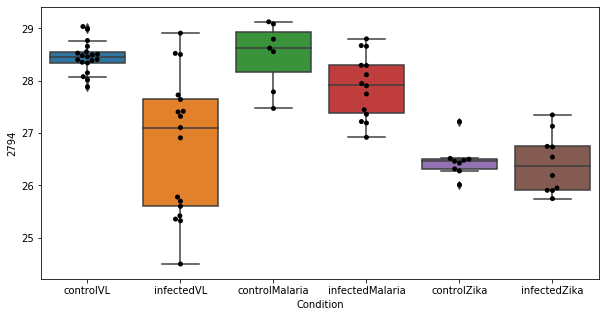

55 row m/z                  162.05
row retention time      10.4026
p-val                 0.0919531
adj.P.Val              0.993422
custom_id                   920
compound_names              NaN
Name: 920, dtype: object


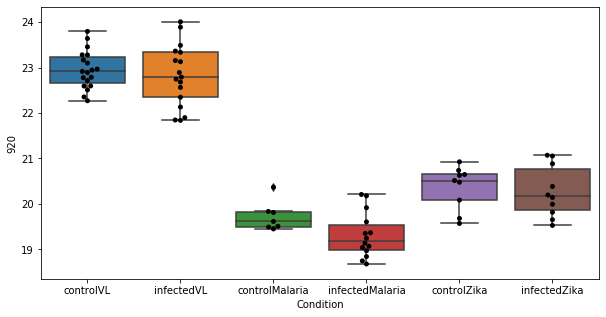

56 row m/z                 519.325
row retention time      3.99289
p-val                 0.0940943
adj.P.Val               0.99872
custom_id                  2787
compound_names              NaN
Name: 2787, dtype: object


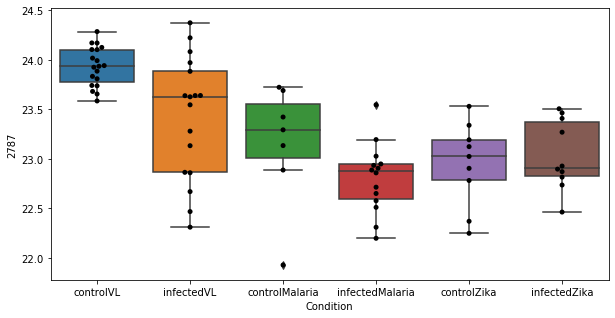

57 row m/z                               190.086
row retention time                    6.71757
p-val                               0.0974994
adj.P.Val                            0.999732
custom_id                                1291
compound_names        methyl indole-3-acetate
Name: 1291, dtype: object


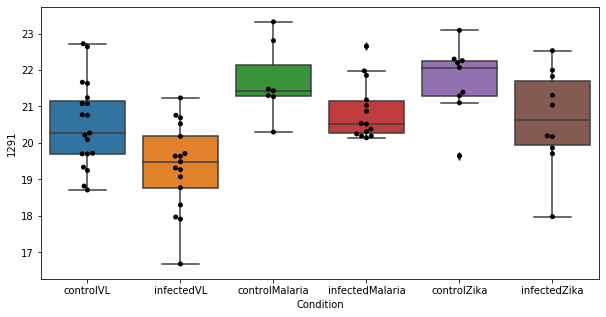

58 row m/z                 523.359
row retention time      3.73649
p-val                 0.0989123
adj.P.Val              0.999732
custom_id                  2796
compound_names              NaN
Name: 2796, dtype: object


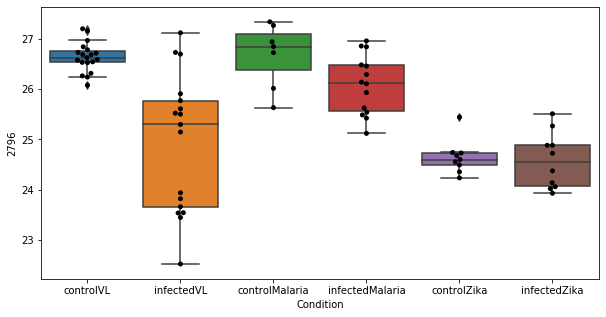

59 row m/z                                                         102.055
row retention time                                              9.79951
p-val                                                          0.099147
adj.P.Val                                                      0.999732
custom_id                                                           121
compound_names        L-Allothreonine; L-allo-Threonine$L-Threonine;...
Name: 121, dtype: object


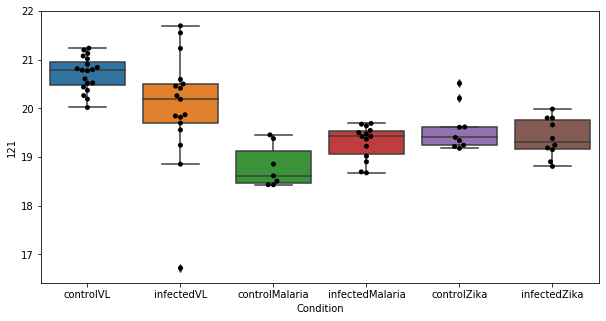

60 row m/z                                                        184.097
row retention time                                             4.41352
p-val                                                         0.103264
adj.P.Val                                                     0.999793
custom_id                                                         1206
compound_names        Pantothenate; Pantothenic acid; (R)-Pantothenate
Name: 1206, dtype: object


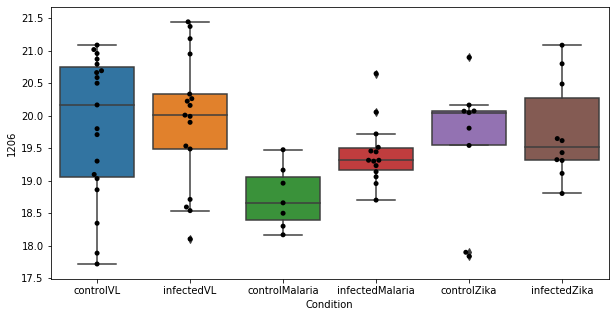

61 row m/z                136.048
row retention time     8.55757
p-val                 0.119736
adj.P.Val             0.999793
custom_id                  516
compound_names             NaN
Name: 516, dtype: object


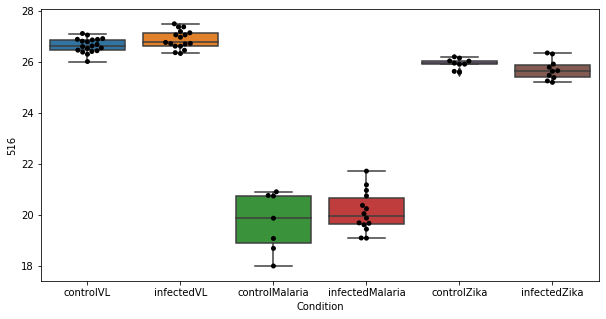

62 row m/z                815.697
row retention time     3.30551
p-val                 0.120947
adj.P.Val             0.999793
custom_id                 3091
compound_names             NaN
Name: 3091, dtype: object


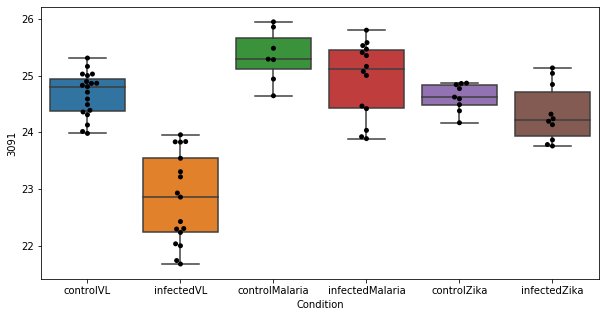

63 row m/z                132.142
row retention time      9.2814
p-val                 0.127186
adj.P.Val             0.999793
custom_id                  469
compound_names             NaN
Name: 469, dtype: object


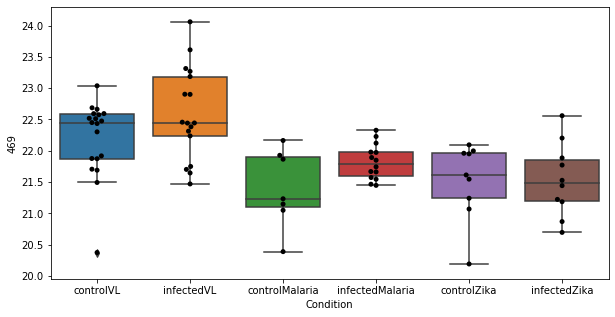

64 row m/z                547.358
row retention time     3.70293
p-val                 0.127451
adj.P.Val             0.999793
custom_id                 2818
compound_names             NaN
Name: 2818, dtype: object


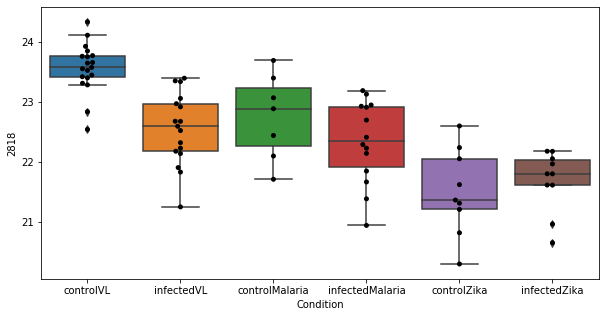

65 row m/z                                                         138.055
row retention time                                              6.72619
p-val                                                          0.140375
adj.P.Val                                                      0.999793
custom_id                                                           551
compound_names        Anthranilate; Anthranilic acid; o-Aminobenzoic...
Name: 551, dtype: object


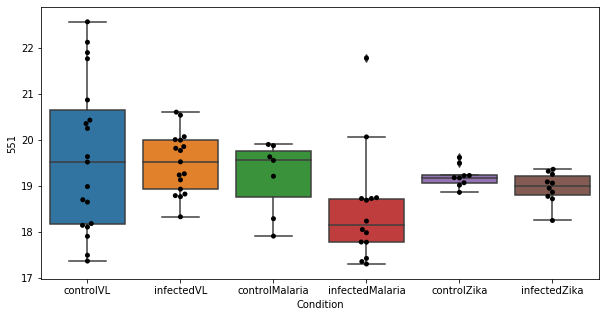

66 row m/z                141.091
row retention time     4.38297
p-val                  0.14757
adj.P.Val             0.999793
custom_id                  577
compound_names             NaN
Name: 577, dtype: object


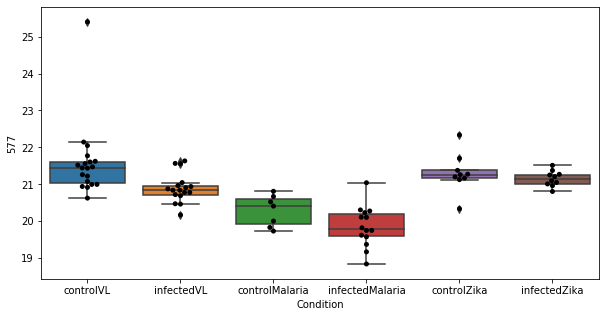

67 row m/z                                 159.028
row retention time                      9.03375
p-val                                  0.147835
adj.P.Val                              0.999793
custom_id                                   872
compound_names        Hypoxanthine; Purine-6-ol
Name: 872, dtype: object


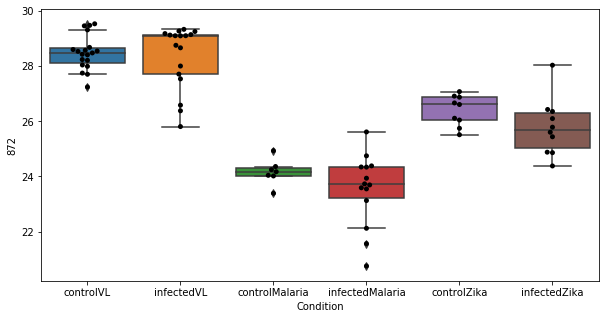

68 row m/z                                                          496.34
row retention time                                              6.67839
p-val                                                          0.149389
adj.P.Val                                                      0.999793
custom_id                                                          2768
compound_names        docosa-4,7,10,13,16-pentaenoyl carnitine$clupa...
Name: 2768, dtype: object


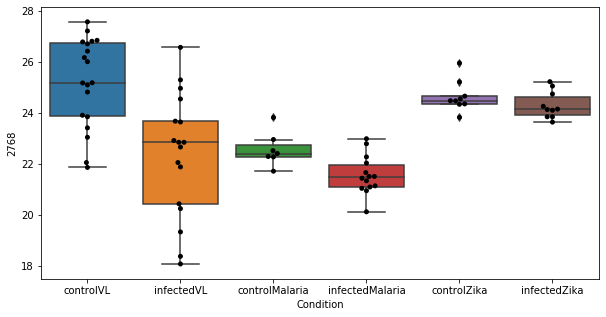

69 row m/z                                                         380.256
row retention time                                               6.7137
p-val                                                          0.150787
adj.P.Val                                                      0.999793
custom_id                                                          2627
compound_names        Sphingosine 1-phosphate; Sphing-4-enine 1-phos...
Name: 2627, dtype: object


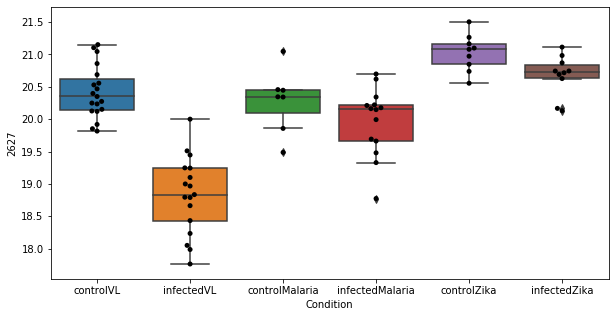

70 row m/z                545.343
row retention time     3.71694
p-val                 0.159861
adj.P.Val             0.999793
custom_id                 2816
compound_names             NaN
Name: 2816, dtype: object


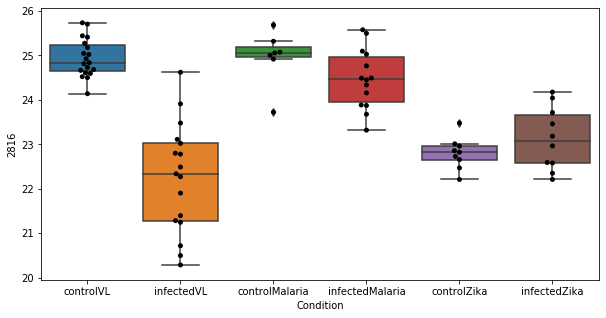

71 row m/z                                157.074
row retention time                     11.7755
p-val                                  0.16204
adj.P.Val                             0.999793
custom_id                                  840
compound_names        3-methylcrotonoylglycine
Name: 840, dtype: object


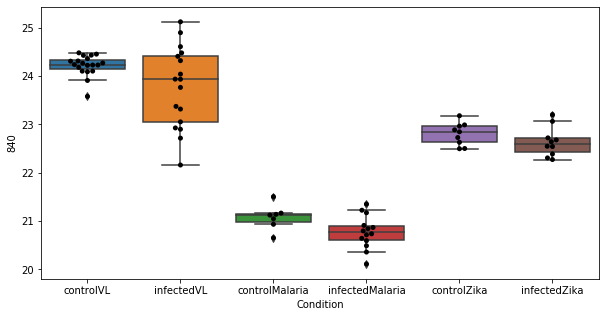

72 row m/z                185.129
row retention time     4.43511
p-val                 0.164857
adj.P.Val             0.999793
custom_id                 1228
compound_names             NaN
Name: 1228, dtype: object


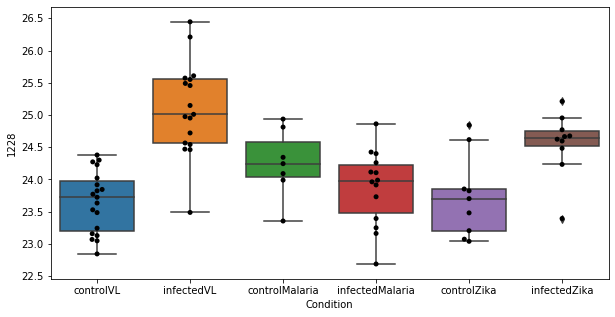

73 row m/z                497.343
row retention time     6.69023
p-val                 0.165314
adj.P.Val             0.999793
custom_id                 2770
compound_names             NaN
Name: 2770, dtype: object


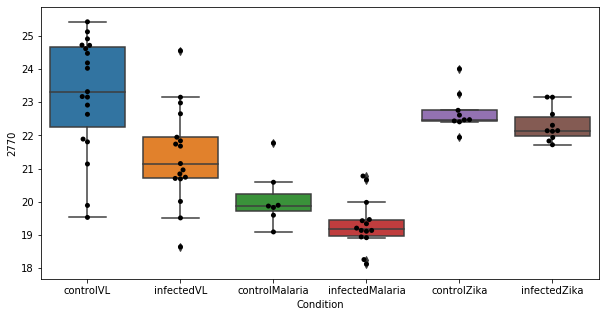

74 row m/z                797.624
row retention time     3.16025
p-val                 0.165793
adj.P.Val             0.999793
custom_id                 3047
compound_names             NaN
Name: 3047, dtype: object


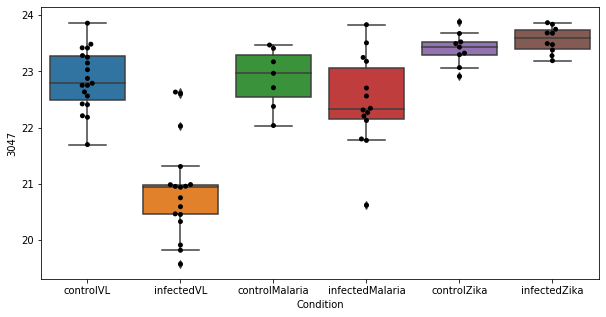

75 row m/z                155.093
row retention time     8.60588
p-val                 0.171762
adj.P.Val             0.999793
custom_id                  805
compound_names             NaN
Name: 805, dtype: object


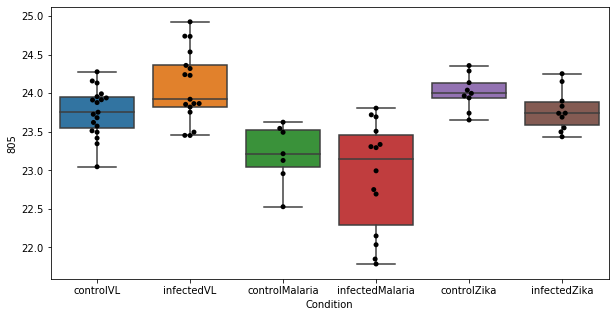

76 row m/z                176.038
row retention time     6.71438
p-val                 0.174743
adj.P.Val             0.999793
custom_id                 1116
compound_names             NaN
Name: 1116, dtype: object


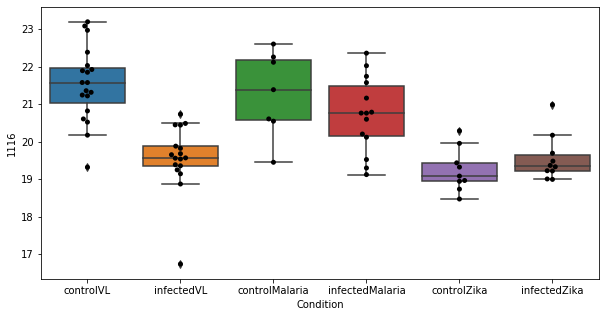

77 row m/z                159.157
row retention time     3.61379
p-val                 0.175496
adj.P.Val             0.999793
custom_id                  891
compound_names             NaN
Name: 891, dtype: object


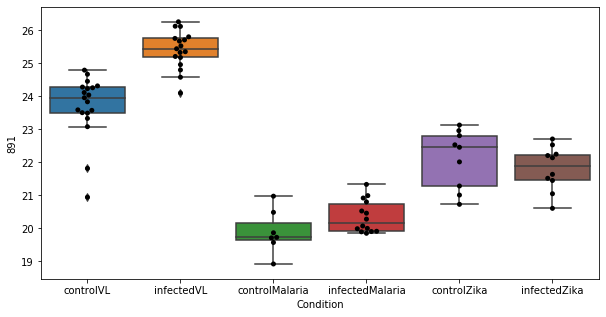

78 row m/z                                                           287.1
row retention time                                              6.72034
p-val                                                           0.17739
adj.P.Val                                                      0.999793
custom_id                                                          2299
compound_names        Formyl-N-acetyl-5-methoxykynurenamine$alpha-N-...
Name: 2299, dtype: object


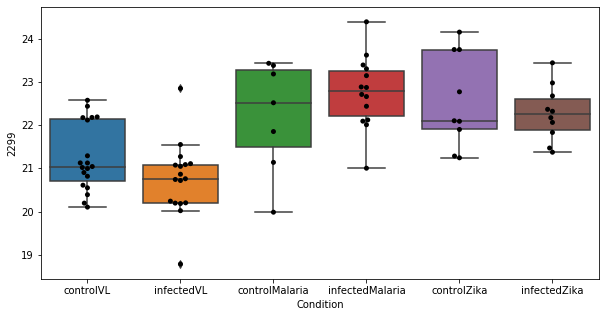

79 row m/z                 544.34
row retention time     3.71301
p-val                 0.180494
adj.P.Val             0.999793
custom_id                 2815
compound_names             NaN
Name: 2815, dtype: object


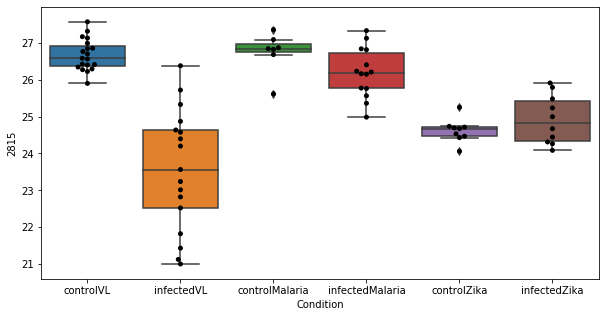

80 row m/z                                                157.097
row retention time                                      6.7351
p-val                                                 0.181982
adj.P.Val                                             0.999793
custom_id                                                  849
compound_names        N-Acetylornithine; N2-Acetyl-L-ornithine
Name: 849, dtype: object


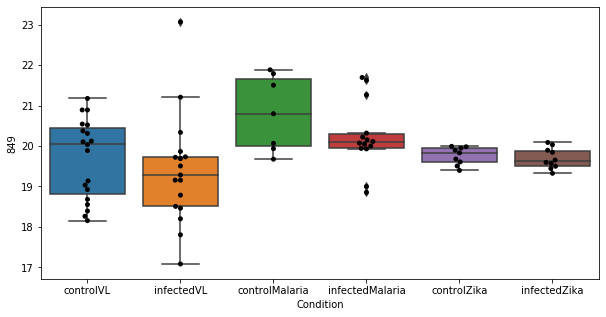

81 row m/z                788.671
row retention time     3.31523
p-val                 0.183613
adj.P.Val             0.999793
custom_id                 3031
compound_names             NaN
Name: 3031, dtype: object


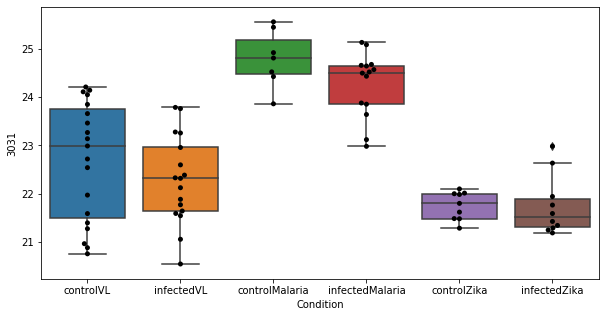

82 row m/z                                 175.002
row retention time                      9.03496
p-val                                  0.188451
adj.P.Val                              0.999793
custom_id                                  1100
compound_names        Hypoxanthine; Purine-6-ol
Name: 1100, dtype: object


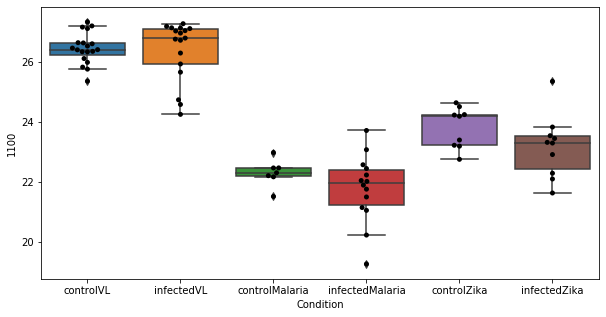

83 row m/z                203.139
row retention time     10.3352
p-val                 0.188712
adj.P.Val             0.999793
custom_id                 1465
compound_names             NaN
Name: 1465, dtype: object


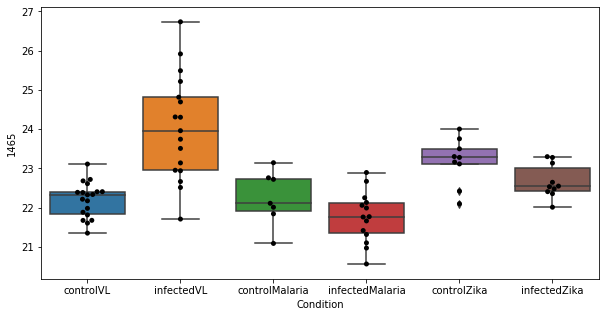

84 row m/z                200.054
row retention time     9.03912
p-val                 0.188829
adj.P.Val             0.999793
custom_id                 1417
compound_names             NaN
Name: 1417, dtype: object


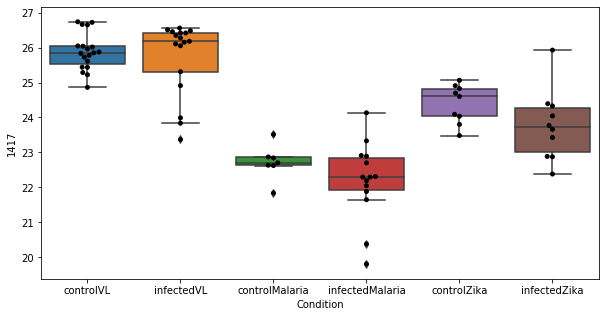

85 row m/z                610.504
row retention time     3.01402
p-val                 0.191067
adj.P.Val             0.999793
custom_id                 2866
compound_names             NaN
Name: 2866, dtype: object


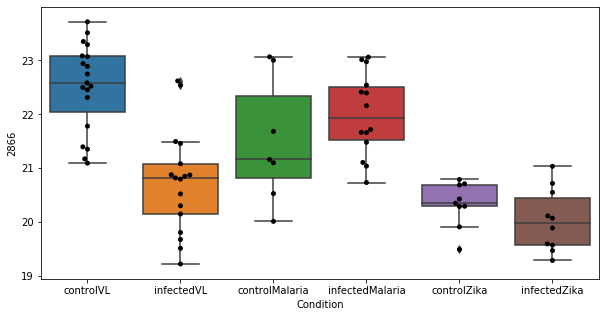

86 row m/z                              188.071
row retention time                    7.6959
p-val                               0.191605
adj.P.Val                           0.999793
custom_id                               1263
compound_names        5-Methoxyindoleacetate
Name: 1263, dtype: object


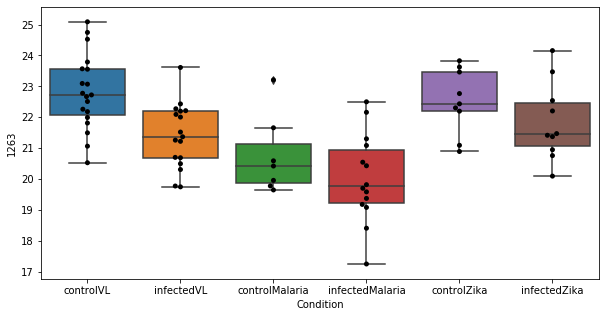

87 row m/z                171.076
row retention time     8.30023
p-val                 0.194064
adj.P.Val             0.999793
custom_id                 1046
compound_names             NaN
Name: 1046, dtype: object


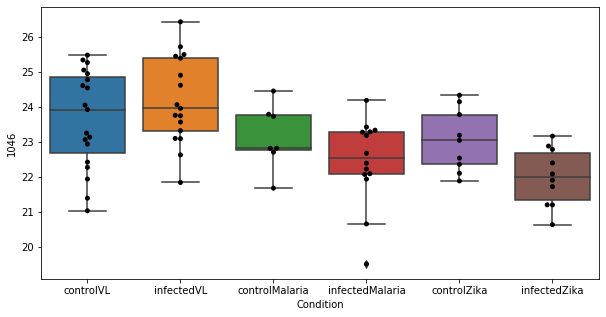

88 row m/z                                        246.124
row retention time                              9.9603
p-val                                         0.194961
adj.P.Val                                     0.999793
custom_id                                         1960
compound_names        gama-carboxyethyl-hydroxychroman
Name: 1960, dtype: object


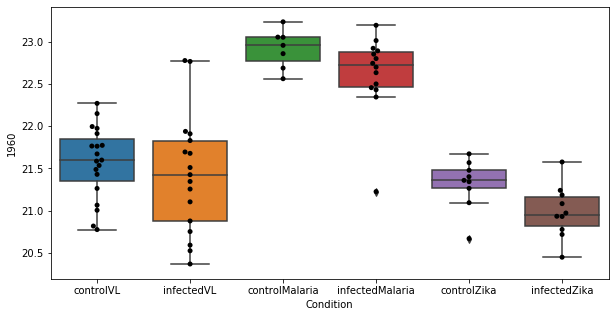

89 row m/z                837.618
row retention time     3.15077
p-val                 0.199822
adj.P.Val             0.999793
custom_id                 3119
compound_names             NaN
Name: 3119, dtype: object


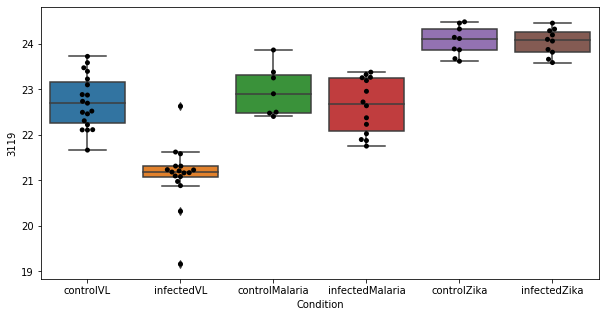

90 row m/z                195.088
row retention time     4.37565
p-val                 0.204854
adj.P.Val             0.999793
custom_id                 1362
compound_names             NaN
Name: 1362, dtype: object


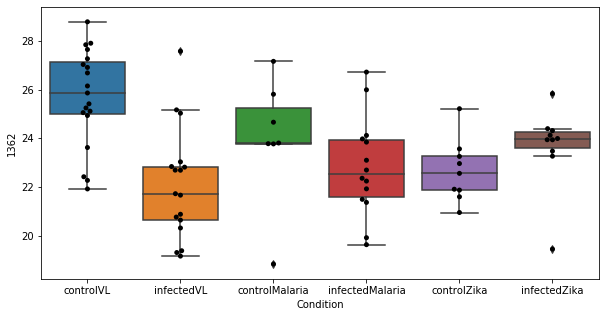

91 row m/z                792.589
row retention time     3.17424
p-val                  0.20734
adj.P.Val             0.999793
custom_id                 3038
compound_names             NaN
Name: 3038, dtype: object


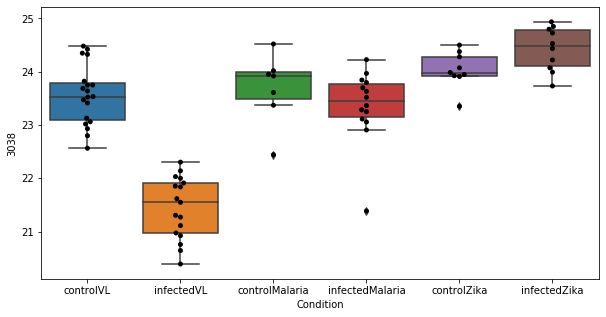

92 row m/z                199.108
row retention time     6.74436
p-val                 0.214626
adj.P.Val             0.999793
custom_id                 4868
compound_names             NaN
Name: 4868, dtype: object


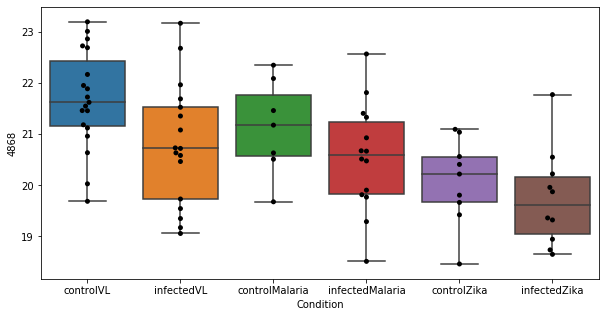

93 row m/z                                                         123.055
row retention time                                              6.71585
p-val                                                          0.214852
adj.P.Val                                                      0.999793
custom_id                                                           343
compound_names        Nicotinamide; Nicotinic acid amide; Niacinamid...
Name: 343, dtype: object


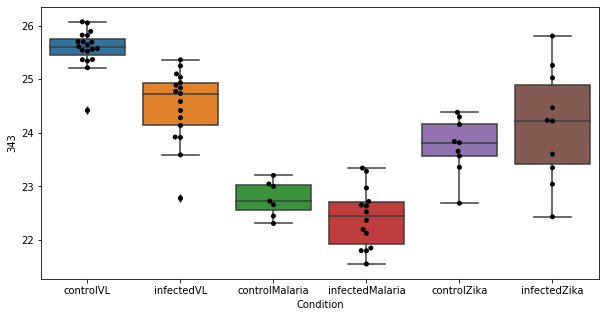

94 row m/z                230.096
row retention time      11.951
p-val                 0.216251
adj.P.Val             0.999793
custom_id                 1799
compound_names             NaN
Name: 1799, dtype: object


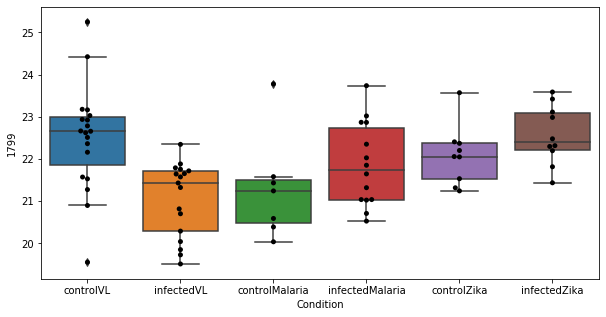

95 row m/z                202.043
row retention time     10.4068
p-val                 0.219339
adj.P.Val             0.999793
custom_id                 1442
compound_names             NaN
Name: 1442, dtype: object


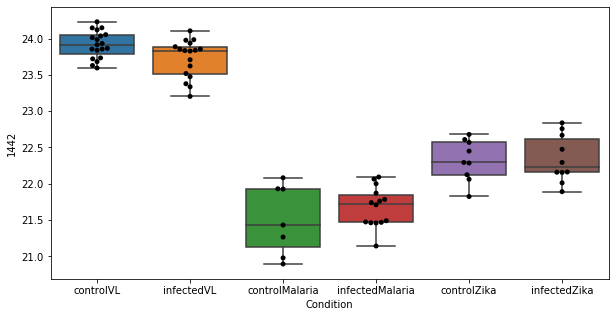

96 row m/z                142.123
row retention time     3.80346
p-val                 0.221752
adj.P.Val             0.999793
custom_id                  589
compound_names             NaN
Name: 589, dtype: object


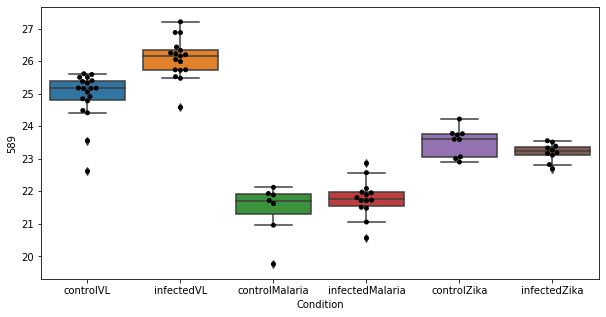

97 row m/z                                                   186.113
row retention time                                        6.71081
p-val                                                    0.224127
adj.P.Val                                                0.999793
custom_id                                                    1233
compound_names        3-Methoxytyramine$Epinine; Deoxyepinephrine
Name: 1233, dtype: object


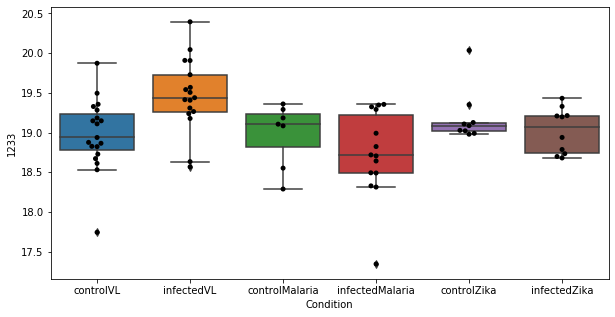

98 row m/z                188.128
row retention time     4.39418
p-val                 0.224502
adj.P.Val             0.999793
custom_id                 1268
compound_names             NaN
Name: 1268, dtype: object


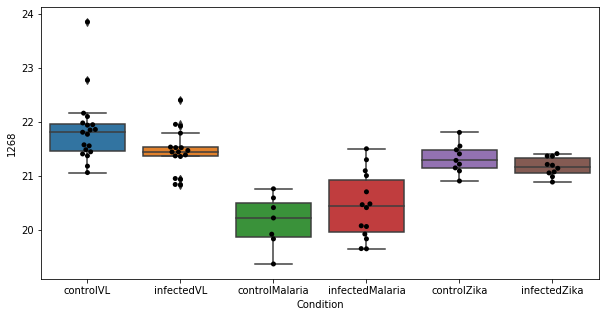

99 row m/z                                                          139.05
row retention time                                              7.04542
p-val                                                          0.225855
adj.P.Val                                                      0.999793
custom_id                                                           558
compound_names        4-Imidazolone-5-propanoate; 4-Imidazolone-5-pr...
Name: 558, dtype: object


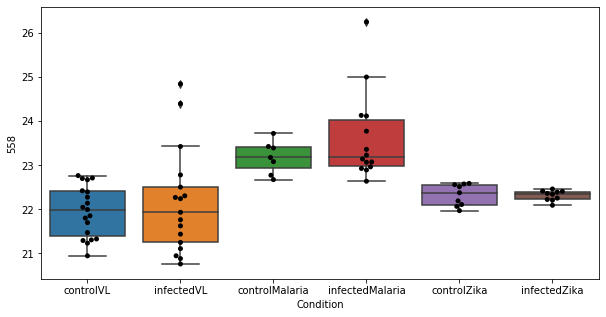

100 row m/z                302.233
row retention time     4.37099
p-val                  0.22726
adj.P.Val             0.999793
custom_id                 2391
compound_names             NaN
Name: 2391, dtype: object


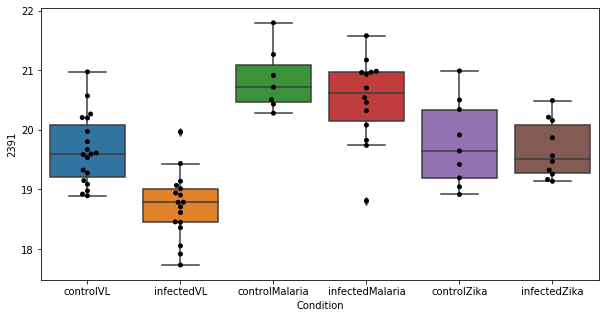

101 row m/z                120.091
row retention time     9.60833
p-val                 0.229433
adj.P.Val             0.999793
custom_id                  310
compound_names             NaN
Name: 310, dtype: object


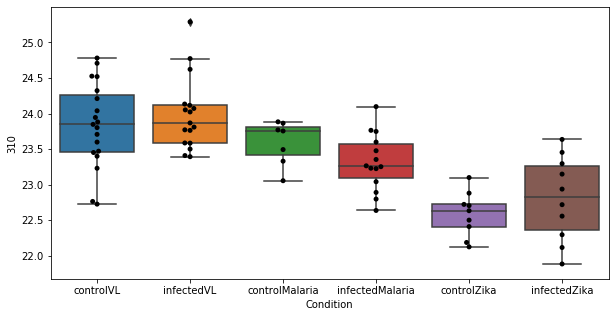

102 row m/z                176.074
row retention time     4.27691
p-val                 0.229485
adj.P.Val             0.999793
custom_id                 1119
compound_names             NaN
Name: 1119, dtype: object


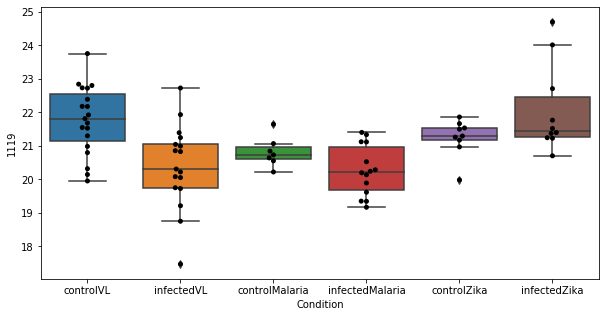

103 row m/z                                                         115.063
row retention time                                               8.6042
p-val                                                          0.229752
adj.P.Val                                                      0.999793
custom_id                                                           240
compound_names        D-Proline$acetamidopropanal$L-Proline; 2-Pyrro...
Name: 240, dtype: object


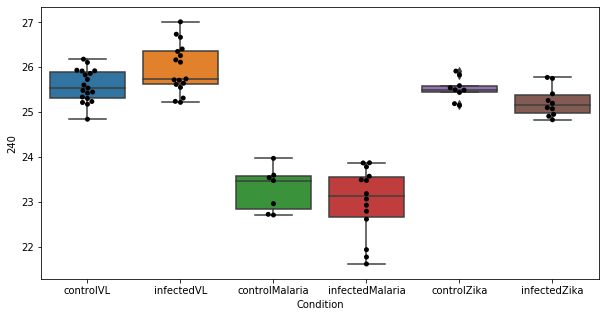

104 row m/z                                 138.049
row retention time                      9.04045
p-val                                  0.232476
adj.P.Val                              0.999793
custom_id                                   548
compound_names        Hypoxanthine; Purine-6-ol
Name: 548, dtype: object


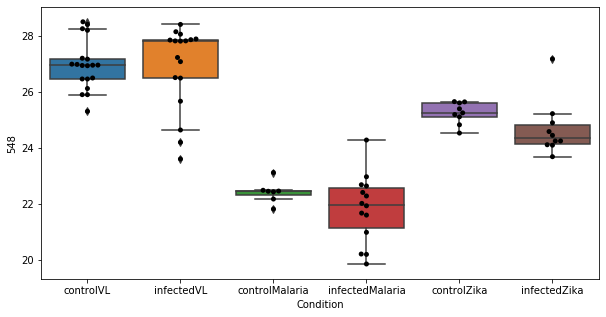

105 row m/z                343.295
row retention time     4.11481
p-val                 0.237352
adj.P.Val             0.999793
custom_id                 4179
compound_names             NaN
Name: 4179, dtype: object


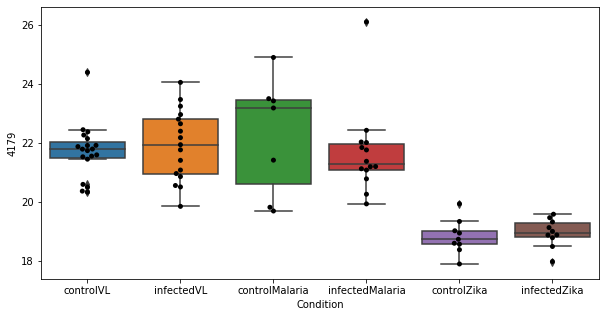

106 row m/z                835.603
row retention time     3.15813
p-val                   0.2395
adj.P.Val             0.999793
custom_id                 3117
compound_names             NaN
Name: 3117, dtype: object


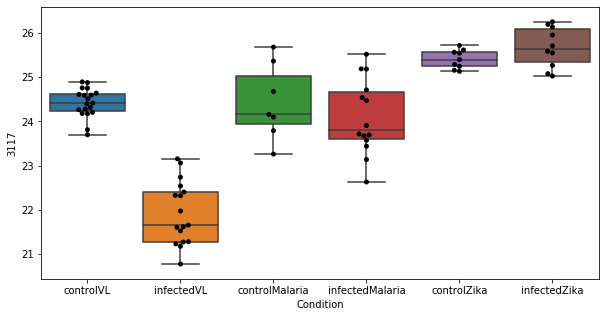

107 row m/z                120.093
row retention time     10.4045
p-val                 0.240337
adj.P.Val             0.999793
custom_id                  312
compound_names             NaN
Name: 312, dtype: object


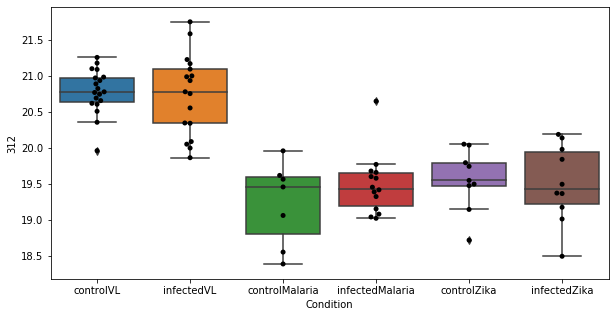

108 row m/z                                                         128.071
row retention time                                              6.71256
p-val                                                           0.24132
adj.P.Val                                                      0.999793
custom_id                                                          5798
compound_names        2,3,4,5-Tetrahydropyridine-2-carboxylate; delt...
Name: 5798, dtype: object


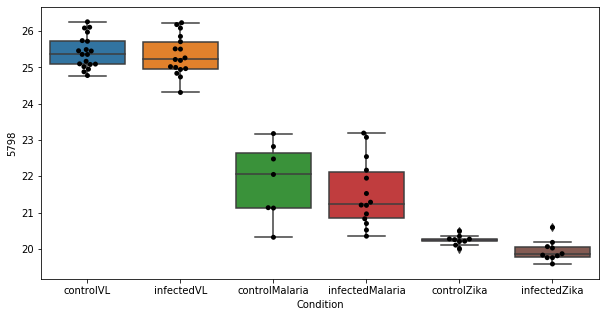

109 row m/z                178.072
row retention time     9.03938
p-val                 0.241591
adj.P.Val             0.999793
custom_id                 1142
compound_names             NaN
Name: 1142, dtype: object


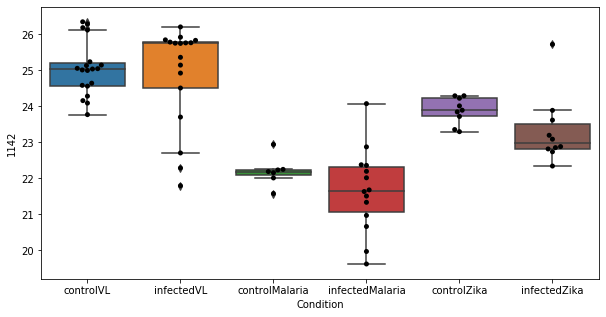

110 row m/z                193.095
row retention time     4.66242
p-val                  0.24185
adj.P.Val             0.999793
custom_id                 1325
compound_names             NaN
Name: 1325, dtype: object


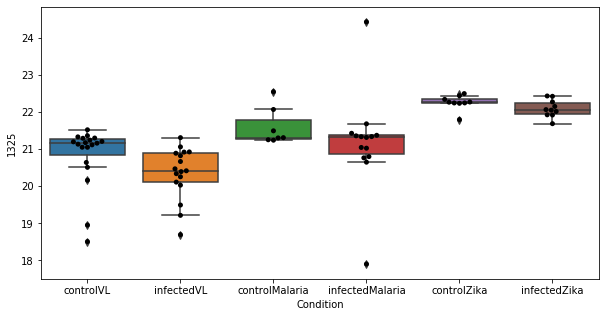

111 row m/z                                                         188.071
row retention time                                              9.95592
p-val                                                          0.242853
adj.P.Val                                                      0.999793
custom_id                                                          1262
compound_names        L-Tryptophan; Tryptophan; (S)-alpha-Amino-beta...
Name: 1262, dtype: object


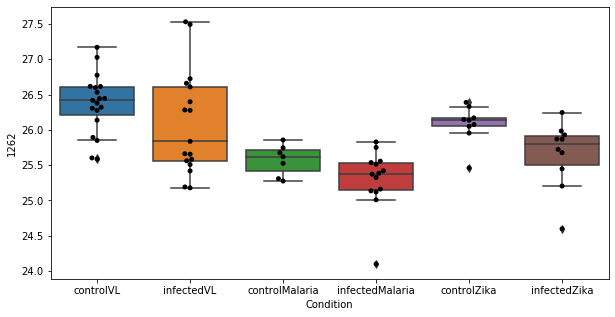

112 row m/z                592.493
row retention time     2.97532
p-val                 0.245424
adj.P.Val             0.999793
custom_id                 2852
compound_names             NaN
Name: 2852, dtype: object


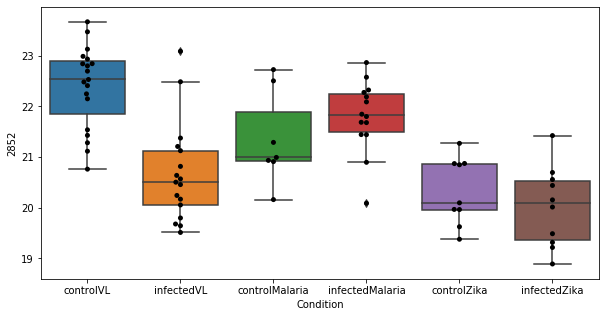

113 row m/z                199.181
row retention time       3.614
p-val                 0.246487
adj.P.Val             0.999793
custom_id                 1413
compound_names             NaN
Name: 1413, dtype: object


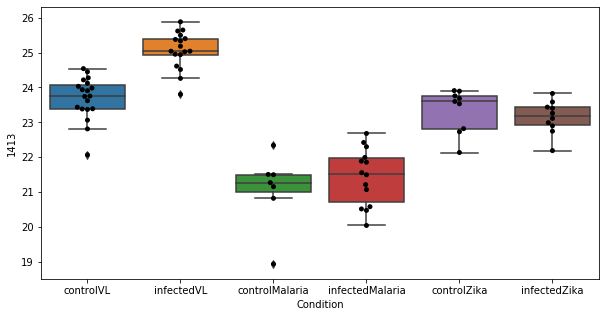

114 row m/z                                                         380.256
row retention time                                              4.24808
p-val                                                          0.250244
adj.P.Val                                                      0.999793
custom_id                                                          2626
compound_names        Sphingosine 1-phosphate; Sphing-4-enine 1-phos...
Name: 2626, dtype: object


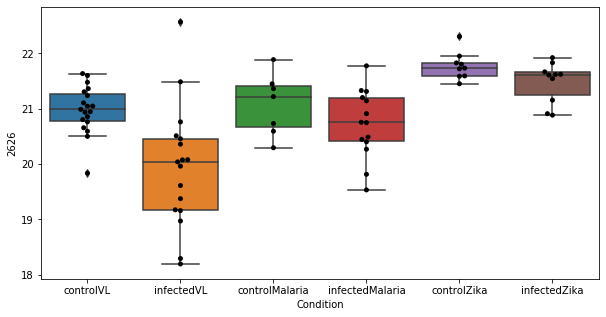

115 row m/z                127.087
row retention time      6.7179
p-val                 0.252363
adj.P.Val             0.999793
custom_id                  378
compound_names             NaN
Name: 378, dtype: object


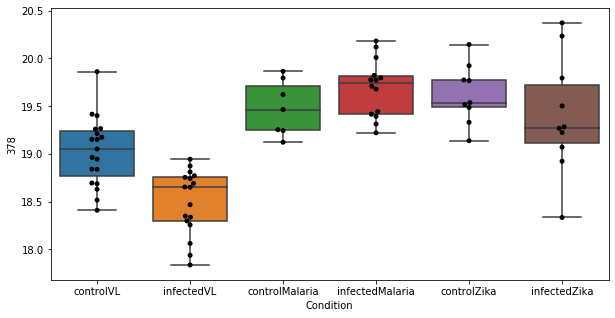

116 row m/z                189.074
row retention time     9.95318
p-val                 0.253875
adj.P.Val             0.999793
custom_id                 1276
compound_names             NaN
Name: 1276, dtype: object


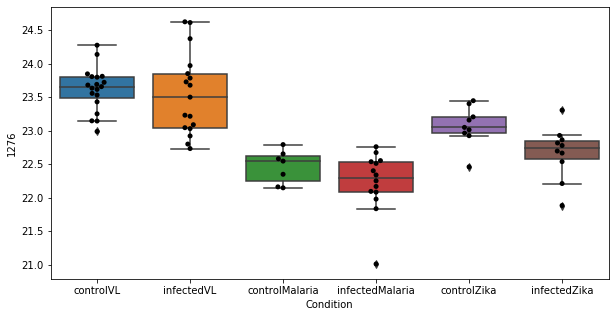

117 row m/z                                                          119.09
row retention time                                              9.60894
p-val                                                           0.25583
adj.P.Val                                                      0.999793
custom_id                                                           299
compound_names        5-Aminopentanoate; 5-Aminopentanoic acid; 5-Am...
Name: 299, dtype: object


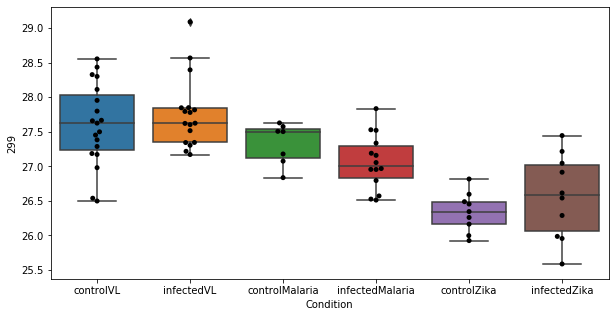

118 row m/z                                                         118.086
row retention time                                              9.60743
p-val                                                          0.258277
adj.P.Val                                                      0.999793
custom_id                                                           281
compound_names        6-Amino-2-oxohexanoate; 2-Oxo-6-aminocaproate$...
Name: 281, dtype: object


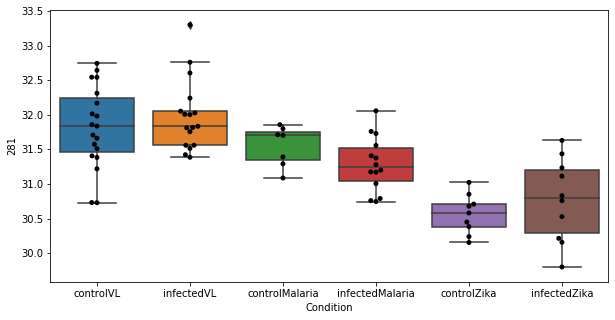

119 row m/z                120.093
row retention time       9.608
p-val                 0.259298
adj.P.Val             0.999793
custom_id                  313
compound_names             NaN
Name: 313, dtype: object


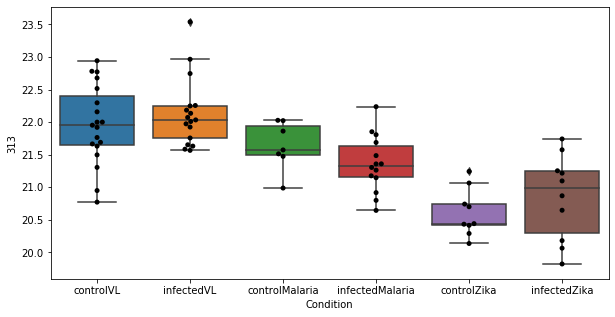

120 row m/z                664.457
row retention time     3.07828
p-val                 0.265202
adj.P.Val             0.999793
custom_id                 2898
compound_names             NaN
Name: 2898, dtype: object


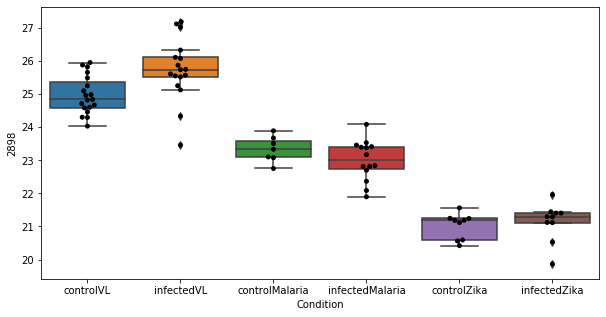

121 row m/z                 115.07
row retention time     8.60199
p-val                 0.265306
adj.P.Val             0.999793
custom_id                  241
compound_names             NaN
Name: 241, dtype: object


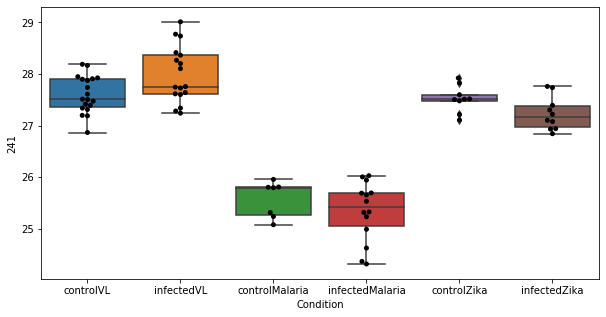

122 row m/z                134.081
row retention time      7.2337
p-val                 0.269499
adj.P.Val             0.999793
custom_id                  497
compound_names             NaN
Name: 497, dtype: object


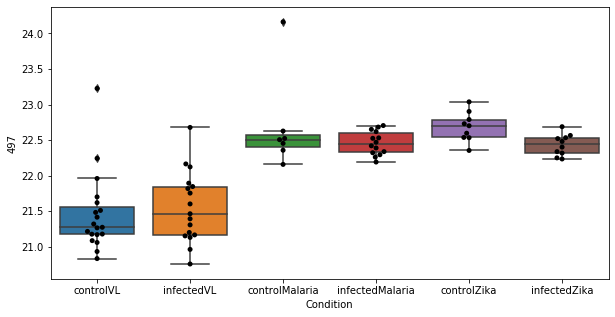

123 row m/z                                                         114.055
row retention time                                              6.71171
p-val                                                           0.26986
adj.P.Val                                                      0.999793
custom_id                                                          3282
compound_names        5-Aminolevulinate; 5-Amino-4-oxopentanoate; 5-...
Name: 3282, dtype: object


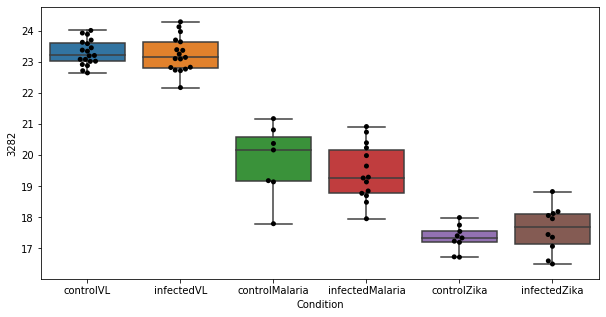

124 row m/z                 813.62
row retention time     3.16569
p-val                 0.271199
adj.P.Val             0.999793
custom_id                 3082
compound_names             NaN
Name: 3082, dtype: object


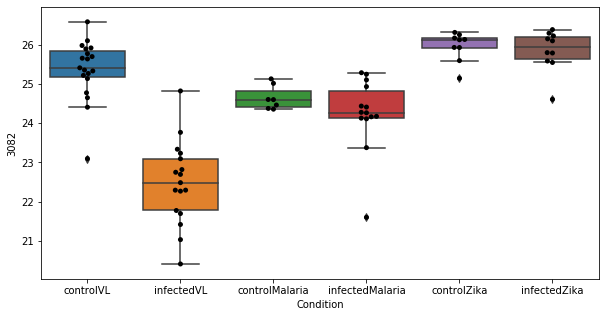

125 row m/z                214.091
row retention time     4.61405
p-val                 0.271958
adj.P.Val             0.999793
custom_id                 1596
compound_names             NaN
Name: 1596, dtype: object


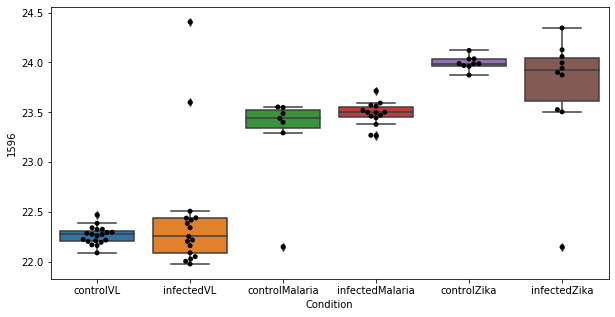

126 row m/z                746.604
row retention time     3.19127
p-val                 0.279516
adj.P.Val             0.999793
custom_id                 2959
compound_names             NaN
Name: 2959, dtype: object


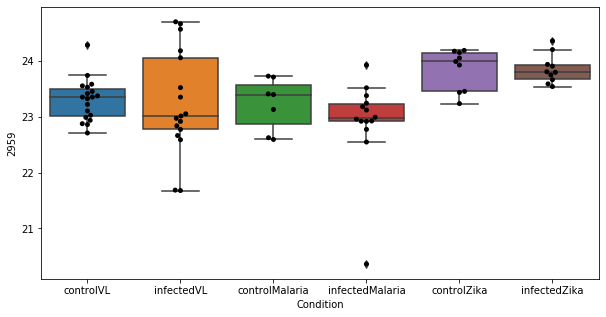

127 row m/z                 880.59
row retention time     3.00121
p-val                 0.282401
adj.P.Val             0.999793
custom_id                 3176
compound_names             NaN
Name: 3176, dtype: object


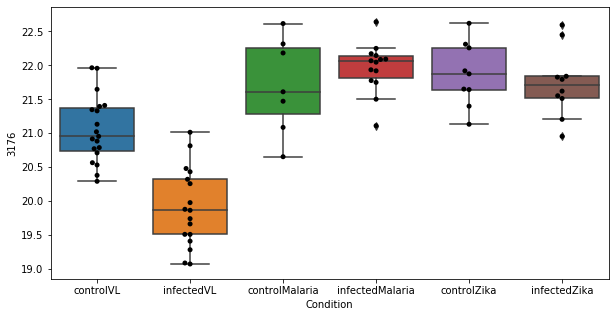

128 row m/z                                                         265.118
row retention time                                              4.43639
p-val                                                          0.283403
adj.P.Val                                                      0.999793
custom_id                                                          2141
compound_names        Formyl-N-acetyl-5-methoxykynurenamine$alpha-N-...
Name: 2141, dtype: object


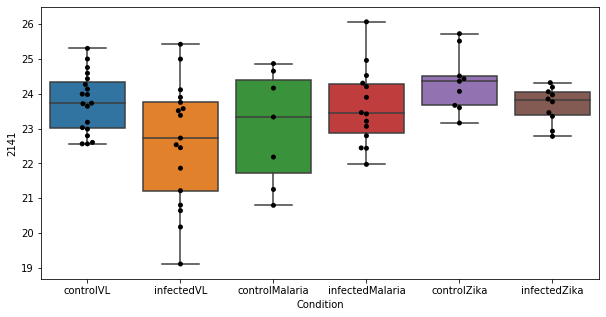

129 row m/z                           310.201
row retention time                 4.3724
p-val                            0.287009
adj.P.Val                        0.999793
custom_id                            2434
compound_names        L-Octanoylcarnitine
Name: 2434, dtype: object


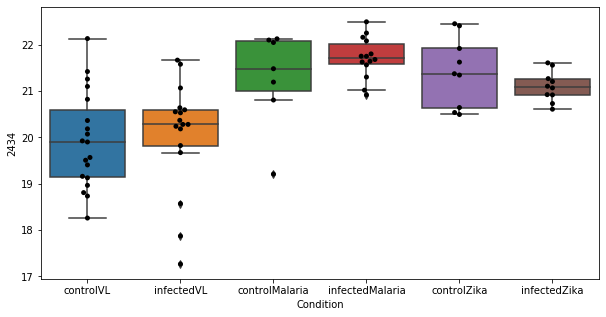

130 row m/z                                                237.052
row retention time                                     10.4106
p-val                                                 0.287772
adj.P.Val                                             0.999793
custom_id                                                 1883
compound_names        5-L-Glutamyl-taurine; 5-Glutamyl-taurine
Name: 1883, dtype: object


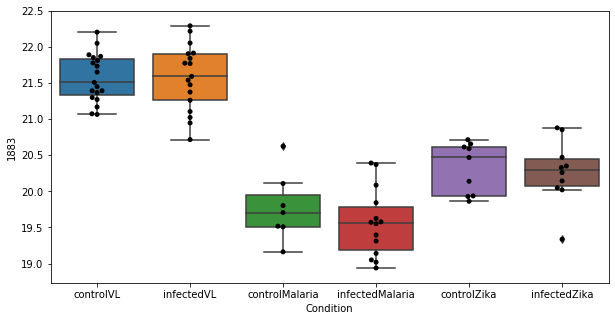

131 row m/z                730.593
row retention time     3.38229
p-val                  0.29046
adj.P.Val             0.999793
custom_id                 2934
compound_names             NaN
Name: 2934, dtype: object


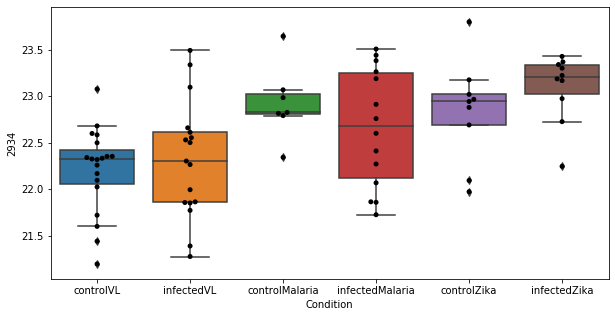

132 row m/z                                                         141.066
row retention time                                              8.53791
p-val                                                          0.290978
adj.P.Val                                                      0.999793
custom_id                                                           575
compound_names        Methylimidazoleacetic acid; Tele-methylimidazo...
Name: 575, dtype: object


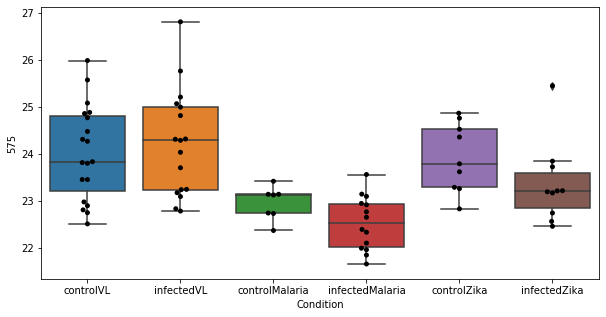

133 row m/z                                                          131.09
row retention time                                              10.3137
p-val                                                          0.291364
adj.P.Val                                                      0.999793
custom_id                                                           445
compound_names        N4-Acetylaminobutanal$L-Pipecolate; Pipecolini...
Name: 445, dtype: object


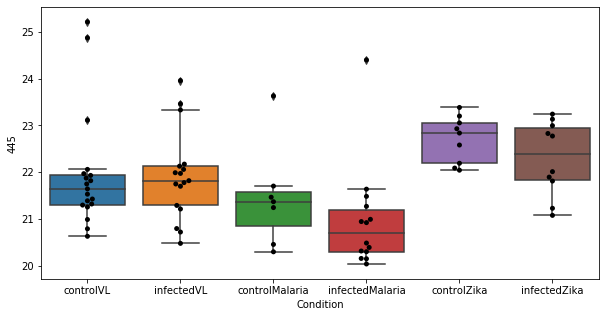

134 row m/z                681.483
row retention time     3.07408
p-val                 0.291501
adj.P.Val             0.999793
custom_id                 2908
compound_names             NaN
Name: 2908, dtype: object


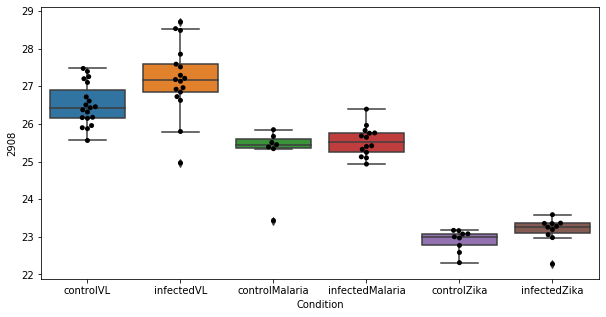

135 row m/z                                                         205.097
row retention time                                              9.95605
p-val                                                          0.292974
adj.P.Val                                                      0.999793
custom_id                                                          1502
compound_names        L-Tryptophan; Tryptophan; (S)-alpha-Amino-beta...
Name: 1502, dtype: object


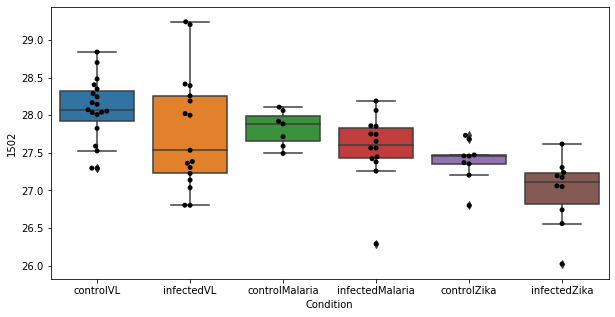

136 row m/z                 146.06
row retention time     9.95492
p-val                  0.29781
adj.P.Val             0.999793
custom_id                  664
compound_names             NaN
Name: 664, dtype: object


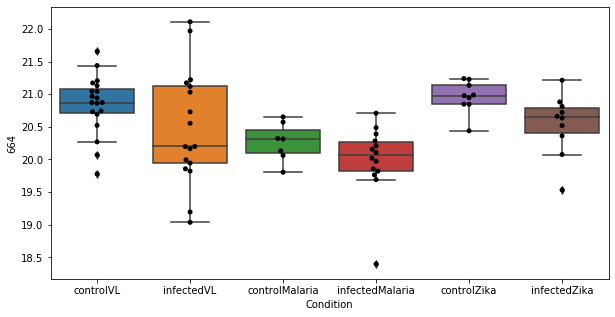

137 row m/z                                                         114.066
row retention time                                              8.59995
p-val                                                          0.301071
adj.P.Val                                                      0.999793
custom_id                                                           229
compound_names        Creatine; alpha-Methylguanidino acetic acid; M...
Name: 229, dtype: object


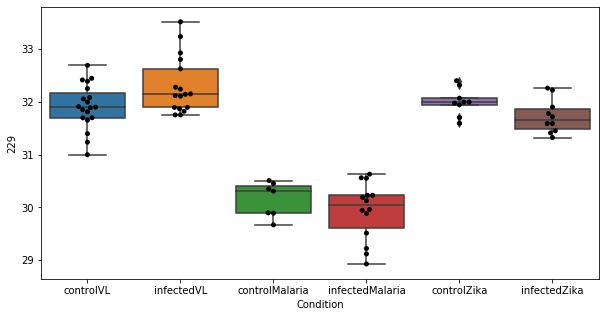

138 row m/z                247.092
row retention time     9.23847
p-val                 0.303336
adj.P.Val             0.999793
custom_id                 5039
compound_names             NaN
Name: 5039, dtype: object


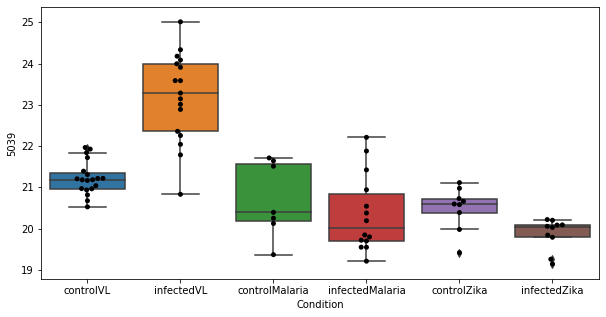

139 row m/z                161.092
row retention time     6.73059
p-val                 0.308222
adj.P.Val             0.999793
custom_id                  912
compound_names             NaN
Name: 912, dtype: object


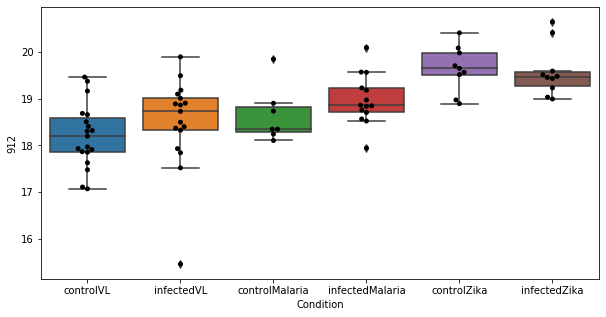

140 row m/z                                             190.05
row retention time                                 6.71104
p-val                                             0.311906
adj.P.Val                                         0.999793
custom_id                                             1289
compound_names        4-(2-Aminophenyl)-2,4-dioxobutanoate
Name: 1289, dtype: object


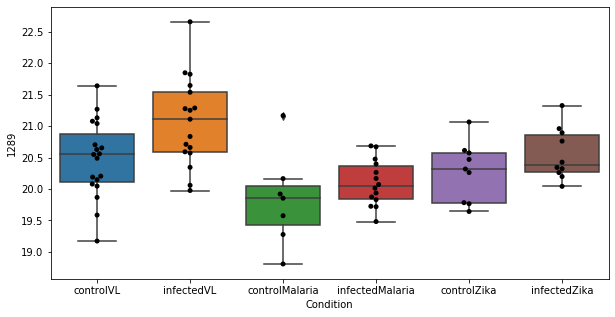

141 row m/z                                                         206.101
row retention time                                              9.95655
p-val                                                          0.313818
adj.P.Val                                                      0.999793
custom_id                                                          1506
compound_names        L-Tryptophan; Tryptophan; (S)-alpha-Amino-beta...
Name: 1506, dtype: object


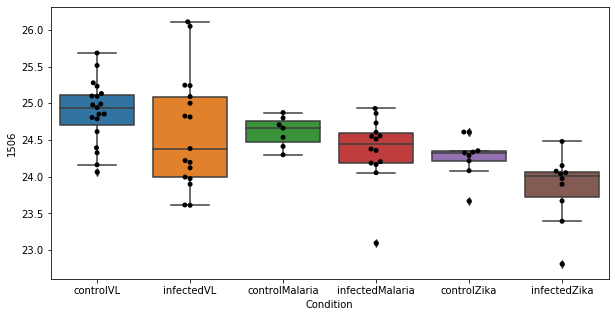

142 row m/z                334.295
row retention time     3.00561
p-val                 0.314533
adj.P.Val             0.999793
custom_id                 2517
compound_names             NaN
Name: 2517, dtype: object


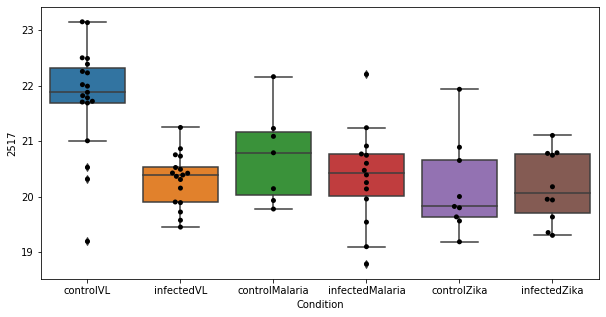

143 row m/z                                                         146.081
row retention time                                              8.32931
p-val                                                          0.317061
adj.P.Val                                                      0.999793
custom_id                                                           666
compound_names        6-Amino-2-oxohexanoate; 2-Oxo-6-aminocaproate$...
Name: 666, dtype: object


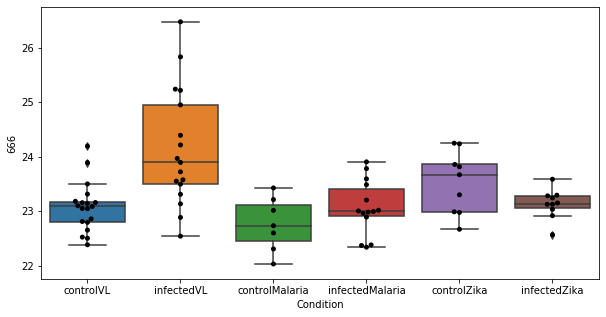

144 row m/z                                                         265.118
row retention time                                              6.71132
p-val                                                          0.318935
adj.P.Val                                                      0.999793
custom_id                                                          2140
compound_names        Formyl-N-acetyl-5-methoxykynurenamine$alpha-N-...
Name: 2140, dtype: object


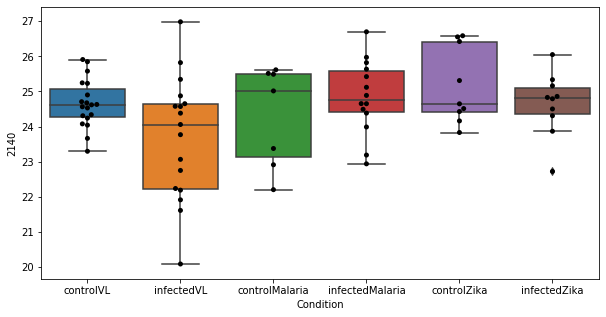

145 row m/z                155.107
row retention time     4.19565
p-val                 0.322003
adj.P.Val             0.999793
custom_id                  806
compound_names             NaN
Name: 806, dtype: object


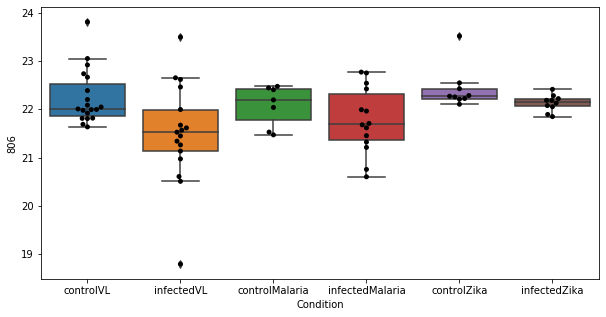

146 row m/z                                                424.342
row retention time                                     3.70254
p-val                                                 0.322718
adj.P.Val                                             0.999793
custom_id                                                 2693
compound_names        Linoleyl carnitine$Linoelaidyl carnitine
Name: 2693, dtype: object


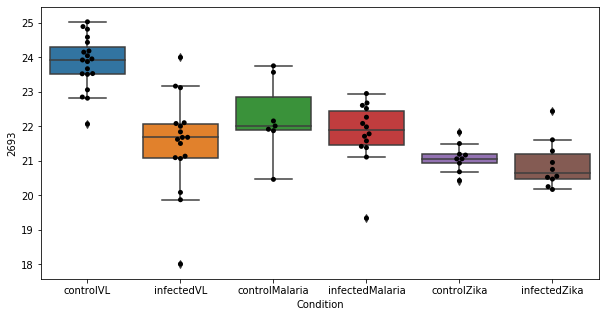

147 row m/z                139.018
row retention time     4.77225
p-val                  0.32391
adj.P.Val             0.999793
custom_id                 3389
compound_names             NaN
Name: 3389, dtype: object


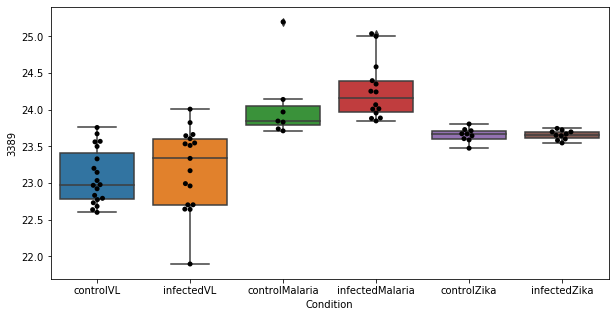

148 row m/z                119.083
row retention time     9.60849
p-val                 0.326919
adj.P.Val             0.999793
custom_id                  296
compound_names             NaN
Name: 296, dtype: object


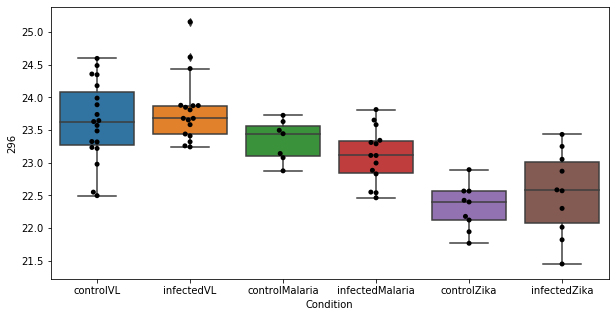

149 row m/z                                                          139.05
row retention time                                              9.67439
p-val                                                          0.327927
adj.P.Val                                                      0.999793
custom_id                                                           557
compound_names        4-Imidazolone-5-propanoate; 4-Imidazolone-5-pr...
Name: 557, dtype: object


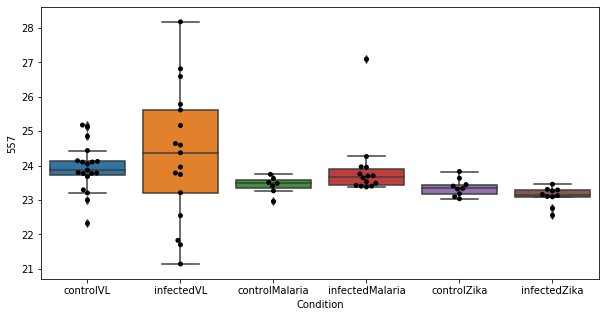

150 row m/z                                                         156.077
row retention time                                              11.7754
p-val                                                          0.332373
adj.P.Val                                                      0.999793
custom_id                                                           821
compound_names        5-Guanidino-2-oxopentanoate; 5-Guanidino-2-oxo...
Name: 821, dtype: object


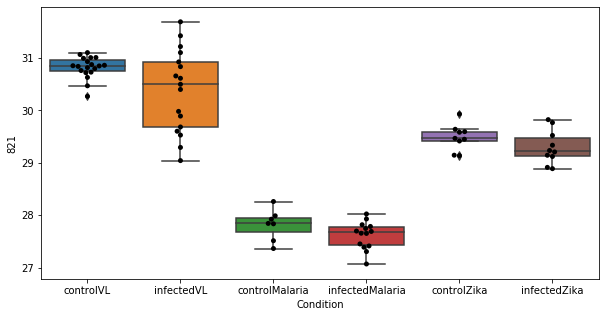

151 row m/z                                                          130.05
row retention time                                              6.71171
p-val                                                          0.333546
adj.P.Val                                                      0.999793
custom_id                                                           412
compound_names        L-4-Hydroxyglutamate semialdehyde$D-Glutamate;...
Name: 412, dtype: object


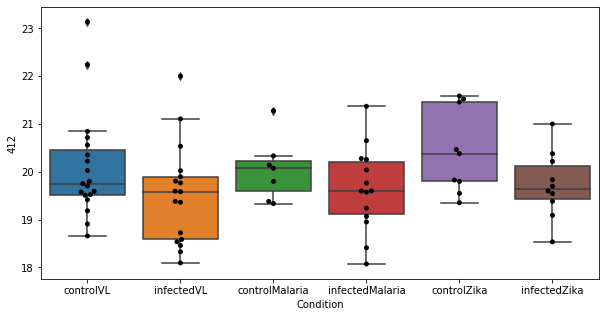

152 row m/z                239.164
row retention time     3.51225
p-val                 0.335704
adj.P.Val             0.999793
custom_id                 3915
compound_names             NaN
Name: 3915, dtype: object


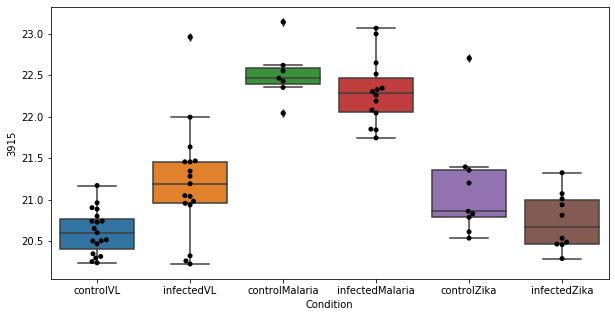

153 row m/z                                                           74.06
row retention time                                              11.6091
p-val                                                          0.340188
adj.P.Val                                                      0.999793
custom_id                                                            10
compound_names        L-Allothreonine; L-allo-Threonine$L-Threonine;...
Name: 10, dtype: object


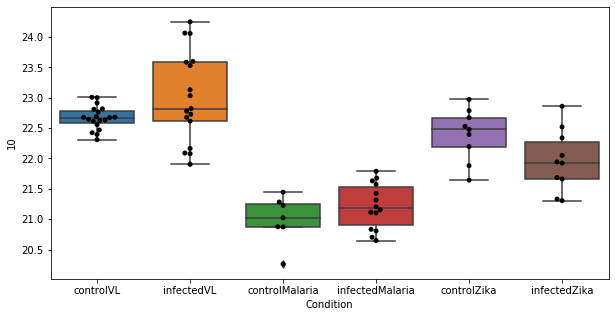

154 row m/z                280.235
row retention time     3.07719
p-val                 0.347068
adj.P.Val             0.999793
custom_id                 2250
compound_names             NaN
Name: 2250, dtype: object


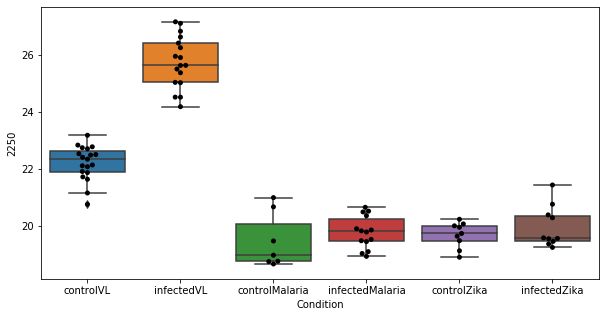

155 row m/z                 168.066
row retention time      6.71562
p-val                  0.348719
adj.P.Val              0.999793
custom_id                  3547
compound_names        Pyridoxal
Name: 3547, dtype: object


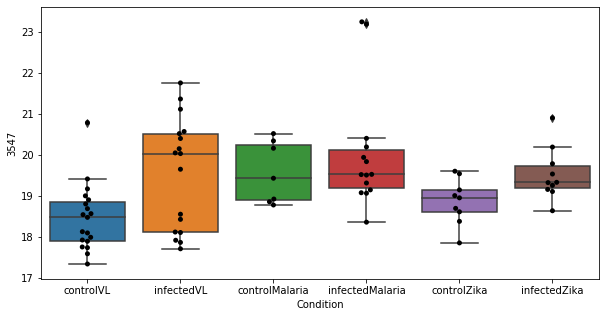

156 row m/z                                                         154.05
row retention time                                              6.7173
p-val                                                         0.354017
adj.P.Val                                                     0.999793
custom_id                                                          791
compound_names        3-Hydroxyanthranilate; 3-Hydroxyanthranilic acid
Name: 791, dtype: object


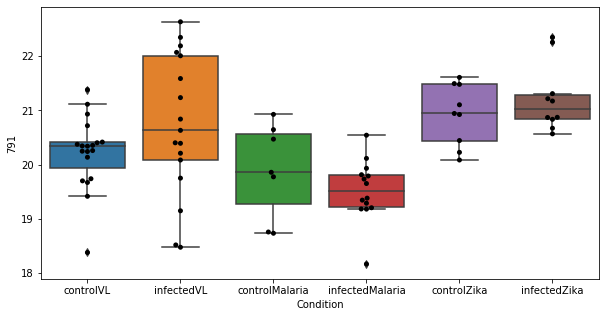

157 row m/z                772.584
row retention time     3.20902
p-val                 0.354484
adj.P.Val             0.999793
custom_id                 2995
compound_names             NaN
Name: 2995, dtype: object


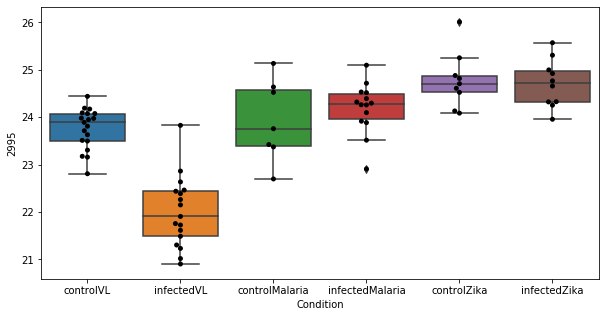

158 row m/z                454.293
row retention time     3.81597
p-val                 0.356678
adj.P.Val             0.999793
custom_id                 2723
compound_names             NaN
Name: 2723, dtype: object


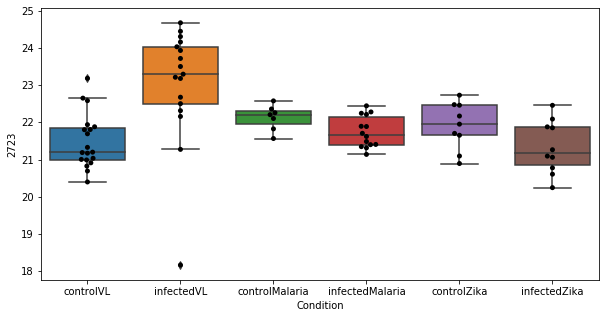

159 row m/z                229.155
row retention time     8.61265
p-val                  0.36144
adj.P.Val             0.999793
custom_id                 1790
compound_names             NaN
Name: 1790, dtype: object


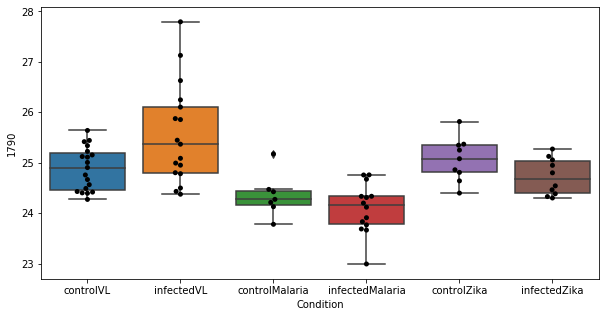

160 row m/z                      170.118
row retention time            4.3833
p-val                       0.364156
adj.P.Val                   0.999793
custom_id                       1033
compound_names        L-Metanephrine
Name: 1033, dtype: object


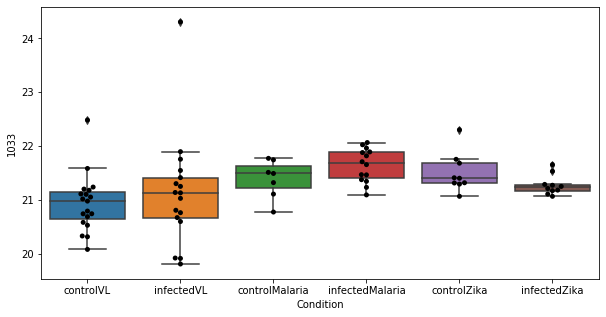

161 row m/z                158.081
row retention time      9.0109
p-val                  0.36606
adj.P.Val             0.999793
custom_id                  856
compound_names             NaN
Name: 856, dtype: object


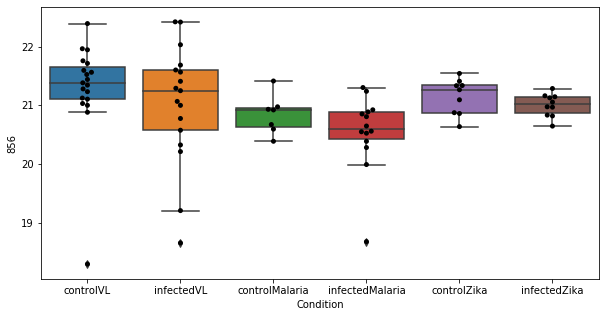

162 row m/z                232.118
row retention time     4.37089
p-val                 0.367944
adj.P.Val             0.999793
custom_id                 1822
compound_names             NaN
Name: 1822, dtype: object


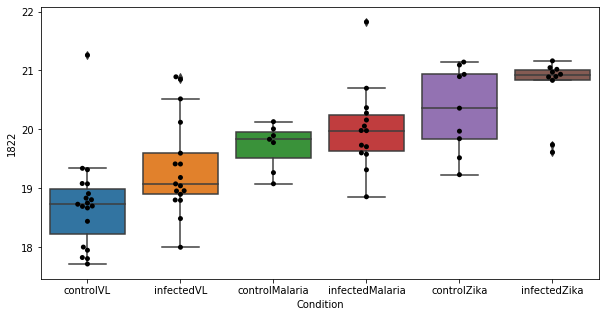

163 row m/z                             160.097
row retention time                  10.2328
p-val                              0.378932
adj.P.Val                          0.999793
custom_id                               898
compound_names        5-Acetamidopentanoate
Name: 898, dtype: object


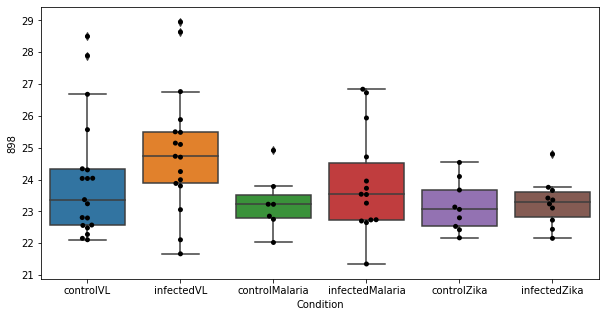

164 row m/z                143.082
row retention time     10.3312
p-val                 0.380166
adj.P.Val             0.999793
custom_id                  602
compound_names             NaN
Name: 602, dtype: object


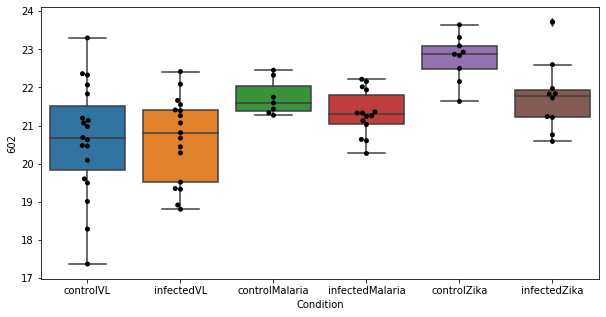

165 row m/z                                                         130.086
row retention time                                              10.3159
p-val                                                          0.380751
adj.P.Val                                                      0.999793
custom_id                                                           422
compound_names        N4-Acetylaminobutanal$L-Pipecolate; Pipecolini...
Name: 422, dtype: object


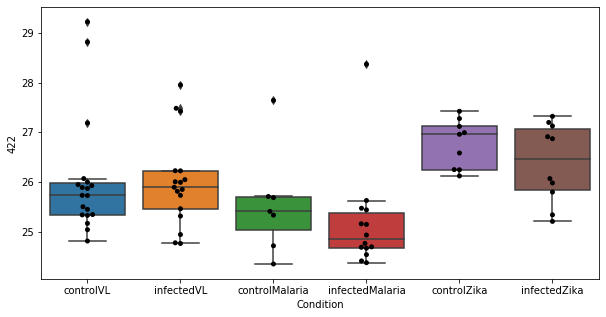

166 row m/z                239.139
row retention time     4.38046
p-val                 0.383329
adj.P.Val             0.999793
custom_id                 1898
compound_names             NaN
Name: 1898, dtype: object


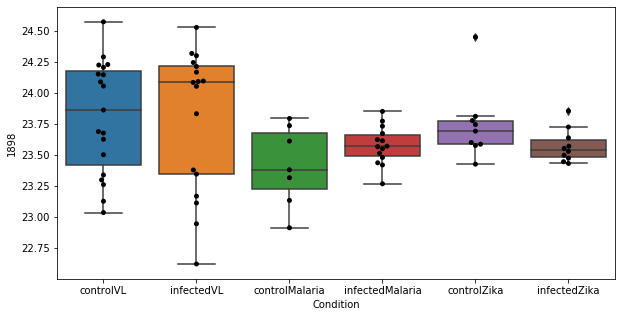

167 row m/z                            110.071
row retention time                 11.7798
p-val                             0.385312
adj.P.Val                         0.999793
custom_id                              194
compound_names        4-Guanidinobutanoate
Name: 194, dtype: object


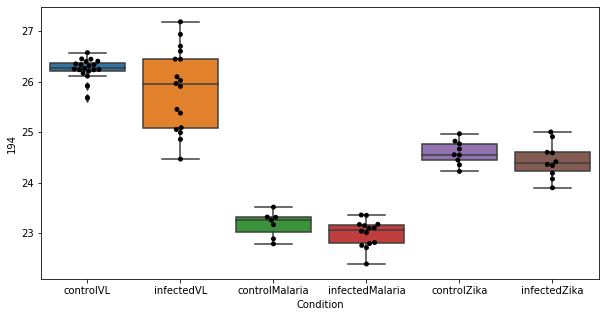

168 row m/z                                                         133.061
row retention time                                              10.3339
p-val                                                          0.385516
adj.P.Val                                                      0.999793
custom_id                                                           473
compound_names        3-Ureidopropionate; 3-Ureidopropanoate; beta-U...
Name: 473, dtype: object


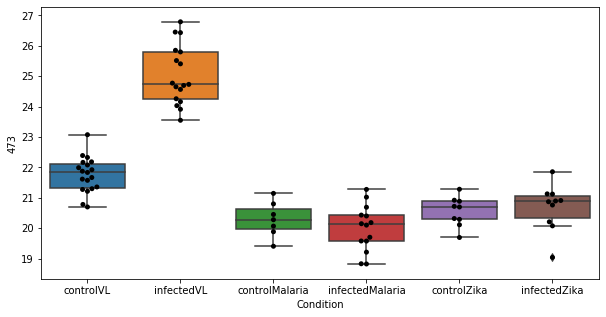

169 row m/z                216.058
row retention time     9.31753
p-val                 0.389546
adj.P.Val             0.999793
custom_id                 1626
compound_names             NaN
Name: 1626, dtype: object


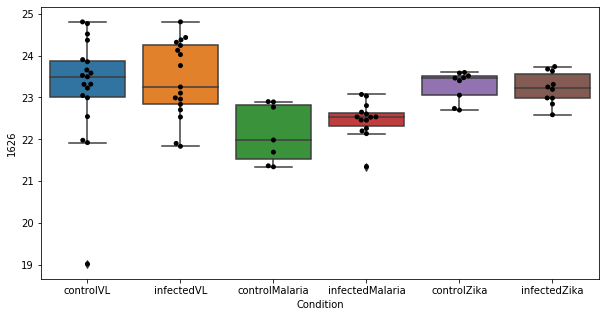

170 row m/z                161.092
row retention time     11.6037
p-val                 0.389778
adj.P.Val             0.999793
custom_id                  911
compound_names             NaN
Name: 911, dtype: object


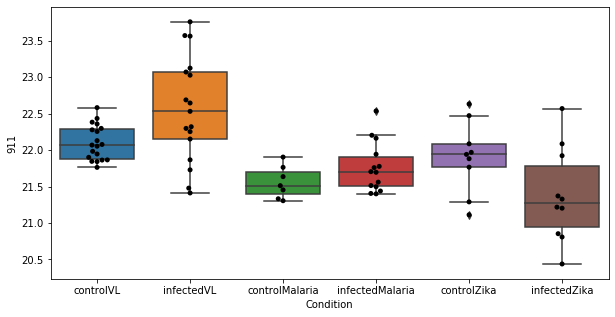

171 row m/z                153.091
row retention time       4.363
p-val                 0.392463
adj.P.Val             0.999793
custom_id                  787
compound_names             NaN
Name: 787, dtype: object


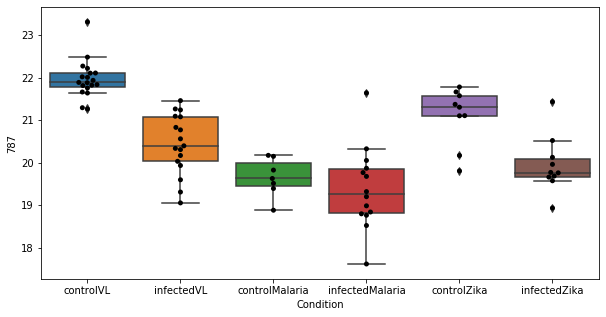

172 row m/z                 163.11
row retention time     10.7406
p-val                 0.394763
adj.P.Val             0.999793
custom_id                  931
compound_names             NaN
Name: 931, dtype: object


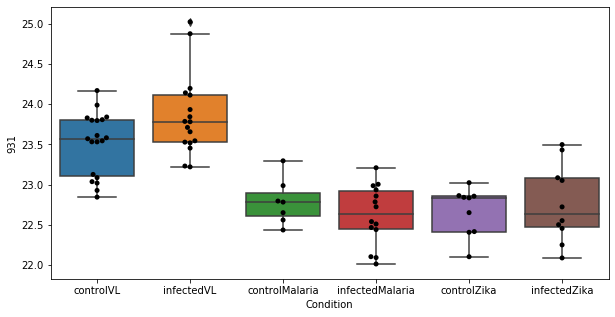

173 row m/z                204.951
row retention time     9.66439
p-val                 0.395499
adj.P.Val             0.999793
custom_id                 1495
compound_names             NaN
Name: 1495, dtype: object


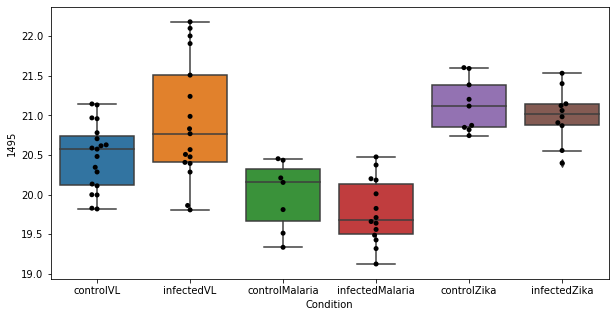

174 row m/z                                       328.248
row retention time                             4.3144
p-val                                        0.397911
adj.P.Val                                    0.999793
custom_id                                        2503
compound_names        2,6 dimethylheptanoyl carnitine
Name: 2503, dtype: object


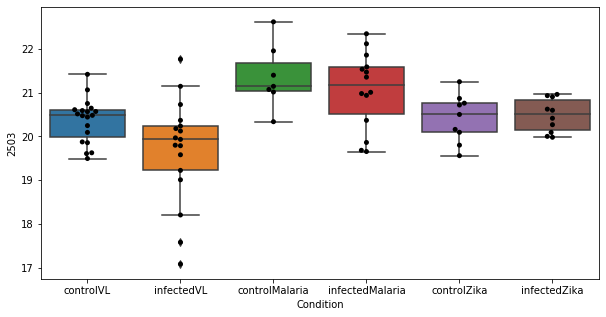

175 row m/z                814.626
row retention time      3.1529
p-val                 0.399115
adj.P.Val             0.999793
custom_id                 3086
compound_names             NaN
Name: 3086, dtype: object


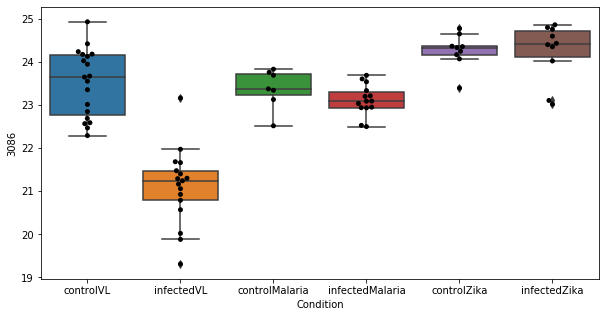

176 row m/z                789.618
row retention time     3.18516
p-val                 0.400087
adj.P.Val             0.999793
custom_id                 3033
compound_names             NaN
Name: 3033, dtype: object


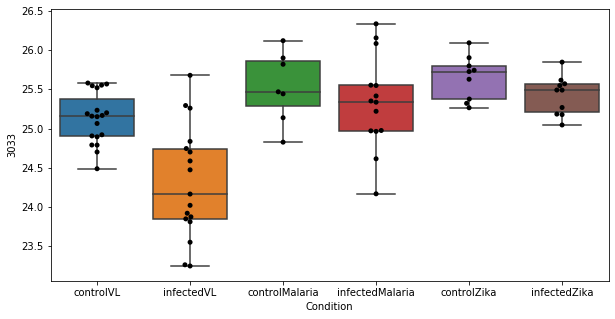

177 row m/z                202.144
row retention time     4.38168
p-val                 0.402387
adj.P.Val             0.999793
custom_id                 1449
compound_names             NaN
Name: 1449, dtype: object


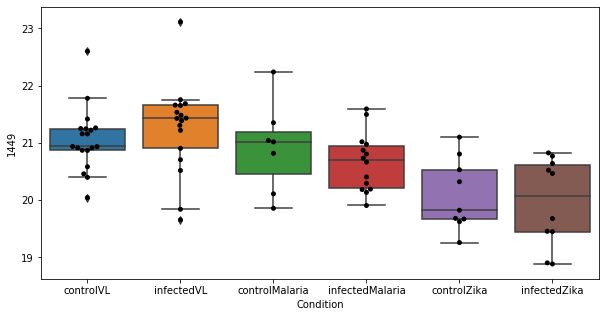

178 row m/z                613.523
row retention time     2.99142
p-val                 0.415355
adj.P.Val             0.999793
custom_id                 2871
compound_names             NaN
Name: 2871, dtype: object


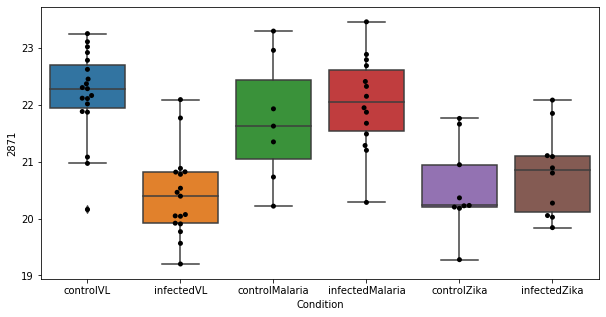

179 row m/z                223.097
row retention time     3.49122
p-val                 0.415367
adj.P.Val             0.999793
custom_id                 1715
compound_names             NaN
Name: 1715, dtype: object


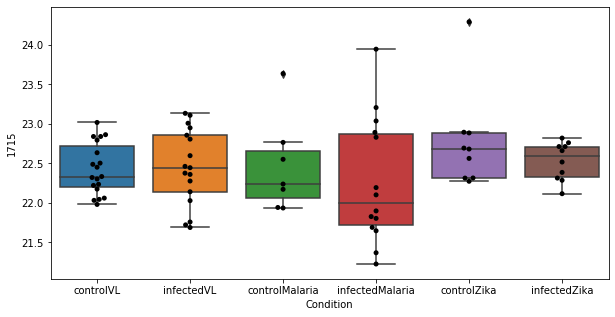

180 row m/z                                                         160.097
row retention time                                              6.71847
p-val                                                          0.417387
adj.P.Val                                                      0.999793
custom_id                                                           899
compound_names        6-Acetamido-2-oxohexanoate; 2-Oxo-6-acetamidoc...
Name: 899, dtype: object


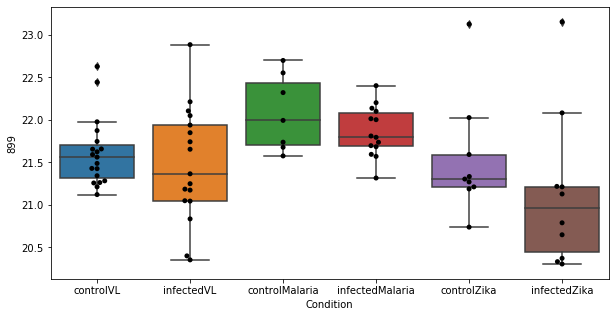

181 row m/z                                                         188.092
row retention time                                              4.43717
p-val                                                           0.41755
adj.P.Val                                                      0.999793
custom_id                                                          1265
compound_names        6-Acetamido-2-oxohexanoate; 2-Oxo-6-acetamidoc...
Name: 1265, dtype: object


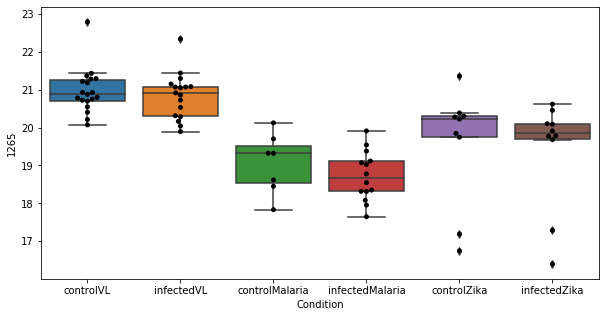

182 row m/z                                                        89.0597
row retention time                                             3.80364
p-val                                                         0.422065
adj.P.Val                                                     0.999793
custom_id                                                           75
compound_names        Butanoic acid; Butanoate; Butyrate; Butyric acid
Name: 75, dtype: object


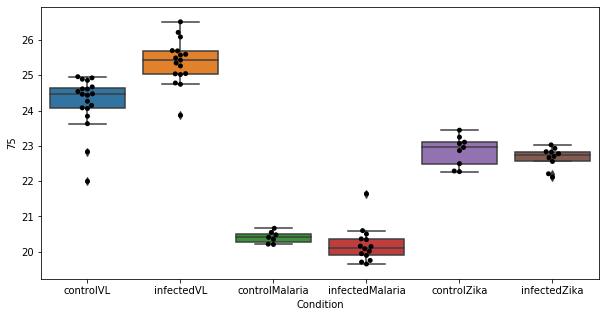

183 row m/z                773.588
row retention time     3.20318
p-val                 0.423486
adj.P.Val             0.999793
custom_id                 2997
compound_names             NaN
Name: 2997, dtype: object


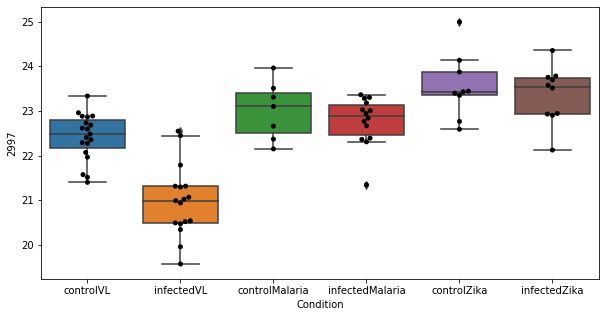

184 row m/z                142.948
row retention time     12.4757
p-val                 0.425582
adj.P.Val             0.999793
custom_id                  596
compound_names             NaN
Name: 596, dtype: object


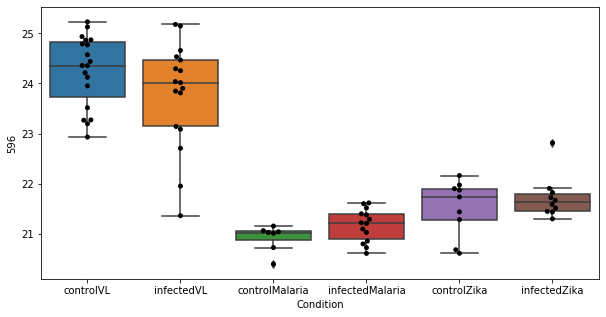

185 row m/z                512.335
row retention time     4.20079
p-val                 0.427049
adj.P.Val             0.999793
custom_id                 2782
compound_names             NaN
Name: 2782, dtype: object


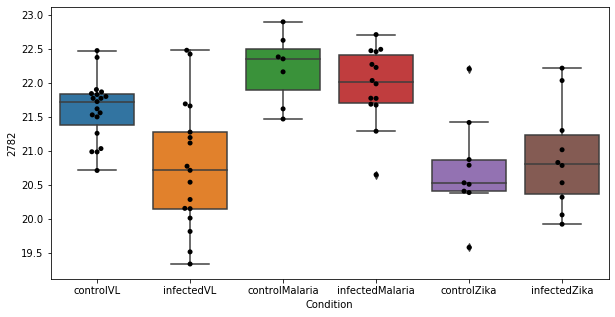

186 row m/z                811.604
row retention time     3.16645
p-val                  0.42989
adj.P.Val             0.999793
custom_id                 3075
compound_names             NaN
Name: 3075, dtype: object


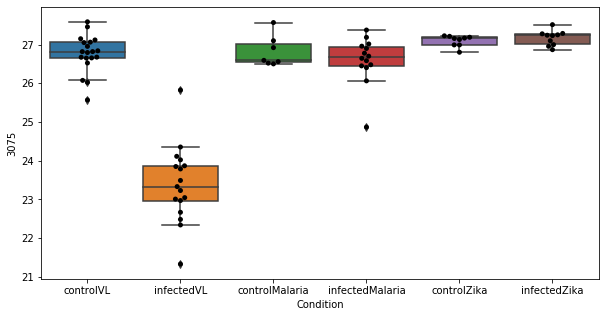

187 row m/z                239.139
row retention time     6.70223
p-val                 0.440437
adj.P.Val             0.999793
custom_id                 1897
compound_names             NaN
Name: 1897, dtype: object


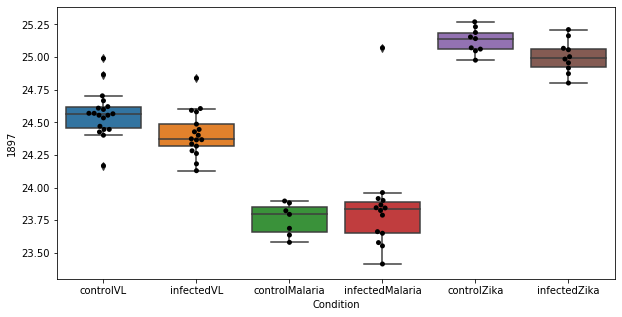

188 row m/z                124.087
row retention time     10.3561
p-val                 0.441283
adj.P.Val             0.999793
custom_id                  357
compound_names             NaN
Name: 357, dtype: object


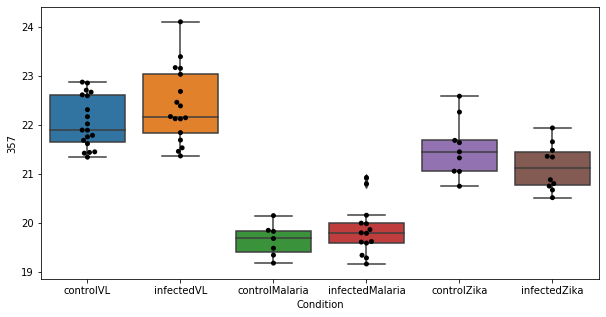

189 row m/z                87.0789
row retention time     11.7103
p-val                 0.446201
adj.P.Val             0.999793
custom_id                   65
compound_names             NaN
Name: 65, dtype: object


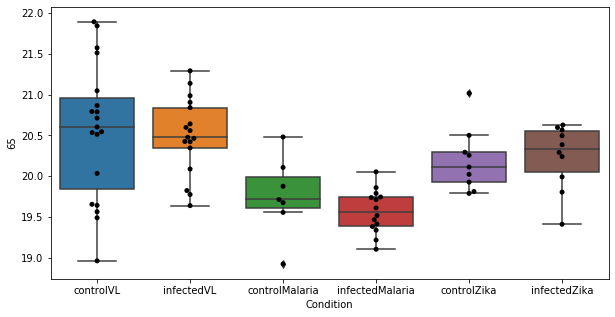

190 row m/z                 222.17
row retention time     3.48165
p-val                 0.446371
adj.P.Val             0.999793
custom_id                 1707
compound_names             NaN
Name: 1707, dtype: object


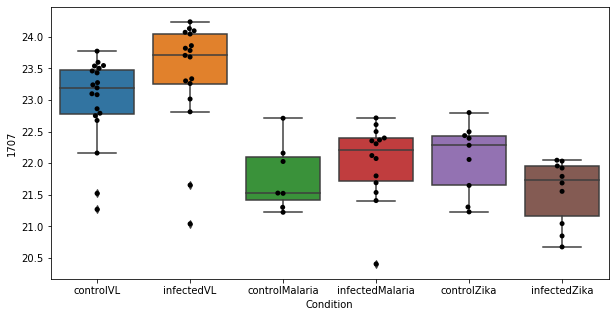

191 row m/z                                                         169.086
row retention time                                              6.70711
p-val                                                          0.456481
adj.P.Val                                                      0.999793
custom_id                                                          1012
compound_names        N-Trimethyl-2-aminoethylphosphonate; 2-Trimeth...
Name: 1012, dtype: object


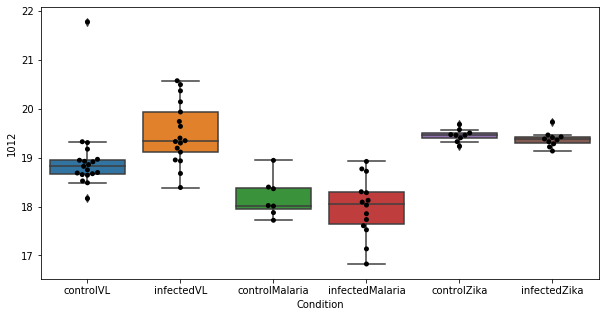

192 row m/z                615.539
row retention time     2.99217
p-val                 0.456767
adj.P.Val             0.999793
custom_id                 2874
compound_names             NaN
Name: 2874, dtype: object


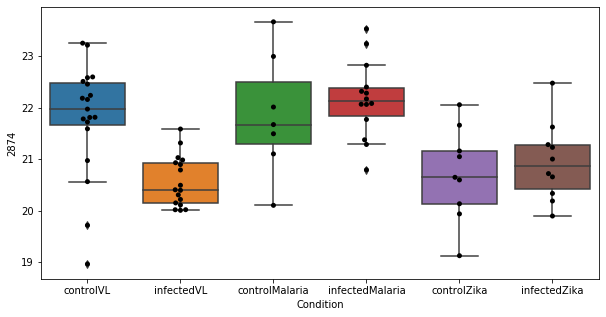

193 row m/z                595.493
row retention time     3.00049
p-val                 0.462647
adj.P.Val             0.999793
custom_id                 2855
compound_names             NaN
Name: 2855, dtype: object


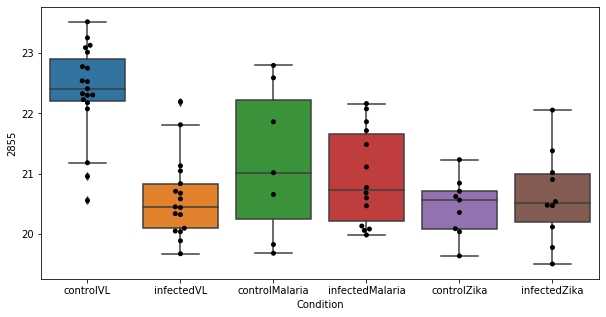

194 row m/z                                 137.046
row retention time                      9.04271
p-val                                  0.464114
adj.P.Val                              0.999793
custom_id                                   534
compound_names        Hypoxanthine; Purine-6-ol
Name: 534, dtype: object


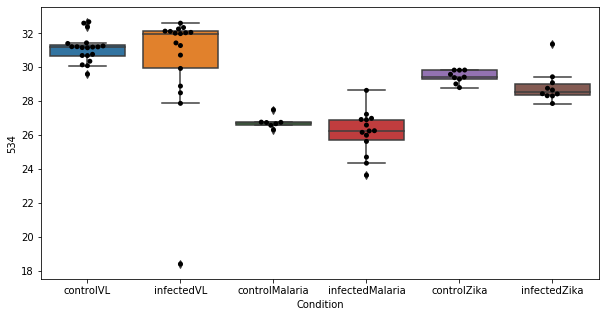

195 row m/z                228.123
row retention time     6.70606
p-val                 0.467864
adj.P.Val             0.999793
custom_id                 1769
compound_names             NaN
Name: 1769, dtype: object


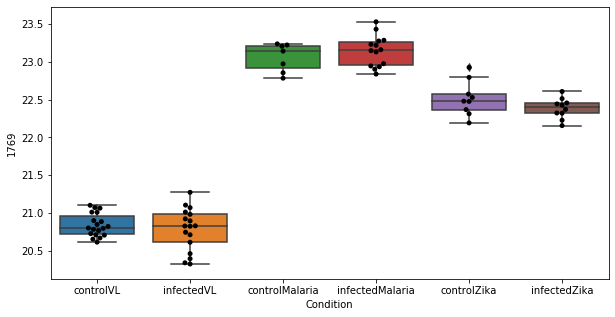

196 row m/z                232.118
row retention time     6.70933
p-val                 0.469006
adj.P.Val             0.999793
custom_id                 1821
compound_names             NaN
Name: 1821, dtype: object


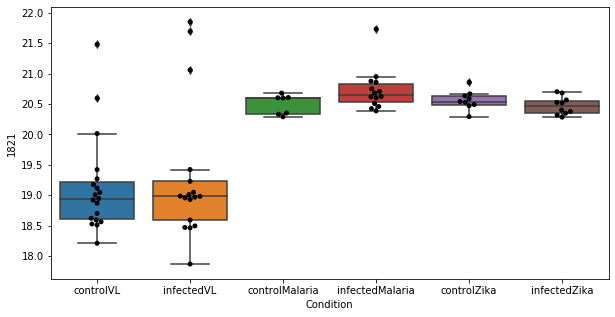

197 row m/z                785.651
row retention time     3.29657
p-val                 0.469296
adj.P.Val             0.999793
custom_id                 3017
compound_names             NaN
Name: 3017, dtype: object


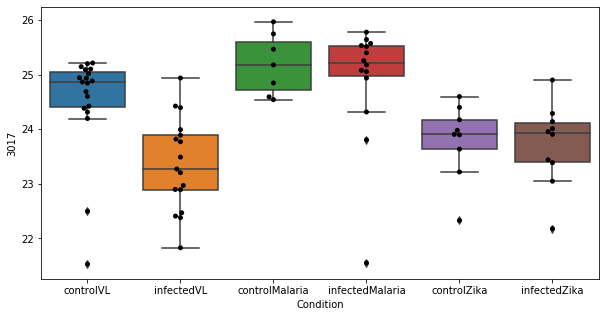

198 row m/z                                                   168.102
row retention time                                        6.71441
p-val                                                     0.47065
adj.P.Val                                                0.999793
custom_id                                                    4731
compound_names        3-Methoxytyramine$Epinine; Deoxyepinephrine
Name: 4731, dtype: object


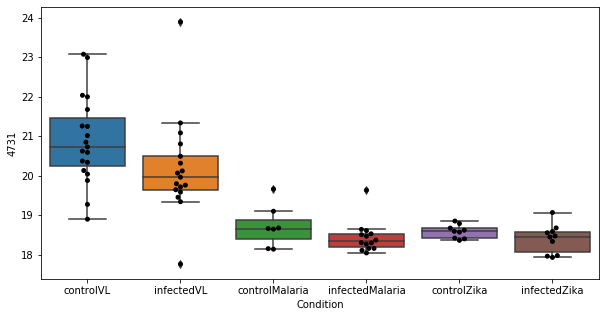

199 row m/z                                                         159.076
row retention time                                              12.4199
p-val                                                          0.471063
adj.P.Val                                                      0.999793
custom_id                                                           876
compound_names        L-Citrulline; 2-Amino-5-ureidovaleric acid; Ci...
Name: 876, dtype: object


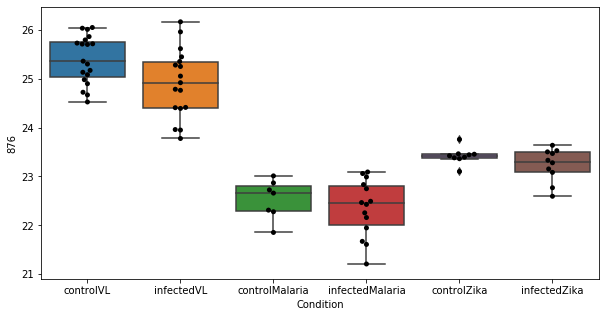

200 row m/z                                                         105.074
row retention time                                              10.2259
p-val                                                          0.484075
adj.P.Val                                                      0.999793
custom_id                                                           152
compound_names        N,N-Dimethylglycine; Dimethylglycine$(R)-3-Ami...
Name: 152, dtype: object


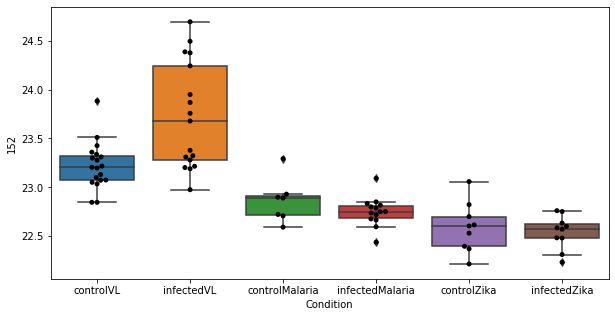

201 row m/z                                                         130.065
row retention time                                              6.72681
p-val                                                           0.48415
adj.P.Val                                                      0.999793
custom_id                                                           416
compound_names        L-Phenylalanine; (S)-alpha-Amino-beta-phenylpr...
Name: 416, dtype: object


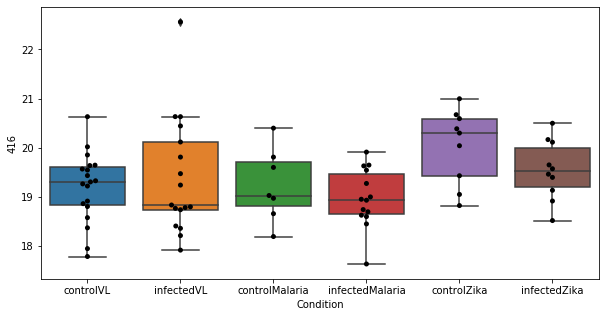

202 row m/z                134.106
row retention time     9.28237
p-val                 0.485758
adj.P.Val             0.999793
custom_id                  503
compound_names             NaN
Name: 503, dtype: object


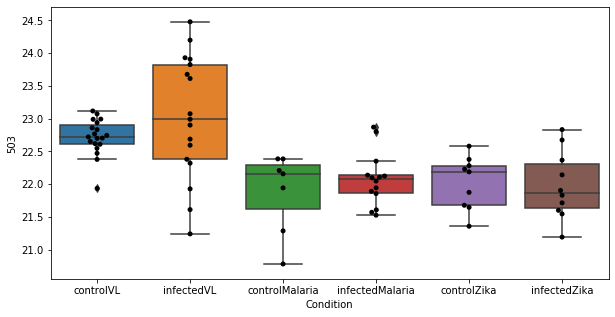

203 row m/z                733.557
row retention time      3.2348
p-val                 0.488577
adj.P.Val             0.999793
custom_id                 2944
compound_names             NaN
Name: 2944, dtype: object


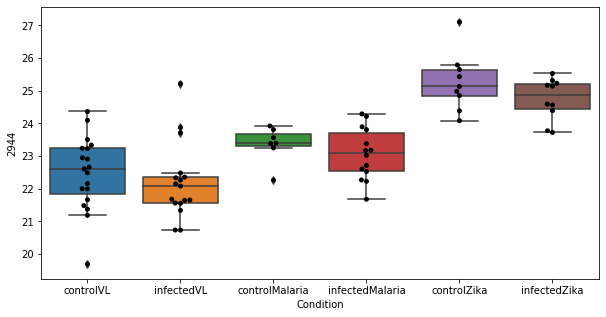

204 row m/z                  810.6
row retention time     3.17127
p-val                 0.490575
adj.P.Val             0.999793
custom_id                 3073
compound_names             NaN
Name: 3073, dtype: object


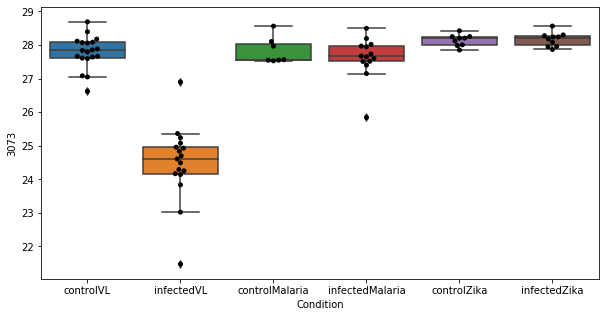

205 row m/z                832.584
row retention time     3.16211
p-val                 0.491544
adj.P.Val             0.999793
custom_id                 3114
compound_names             NaN
Name: 3114, dtype: object


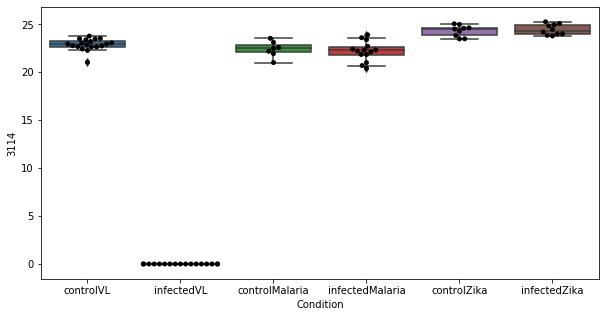

206 row m/z                                                         120.066
row retention time                                              9.57777
p-val                                                          0.493322
adj.P.Val                                                      0.999793
custom_id                                                           302
compound_names        L-4-Hydroxyglutamate semialdehyde$D-Glutamate;...
Name: 302, dtype: object


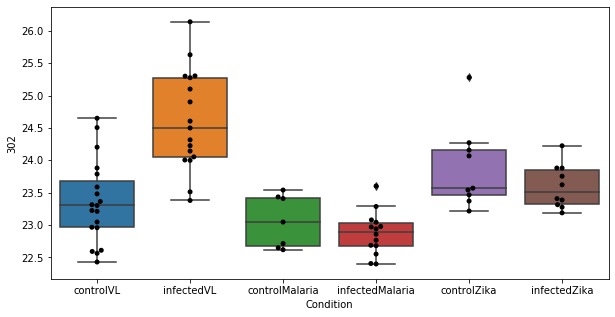

207 row m/z                                                         114.055
row retention time                                              8.43271
p-val                                                           0.49503
adj.P.Val                                                      0.999793
custom_id                                                           225
compound_names        1-Pyrroline-2-carboxylate; 1-Pyrroline-2-carbo...
Name: 225, dtype: object


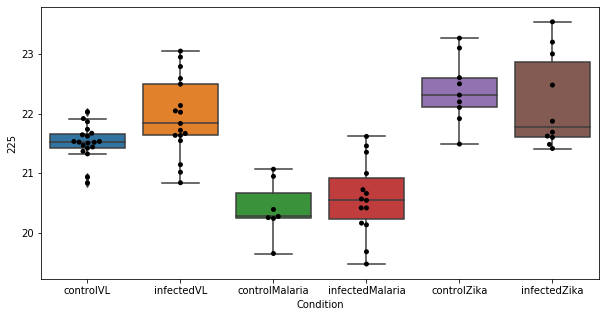

208 row m/z                                                         121.069
row retention time                                              11.6072
p-val                                                          0.495142
adj.P.Val                                                      0.999793
custom_id                                                           318
compound_names        L-Allothreonine; L-allo-Threonine$L-Threonine;...
Name: 318, dtype: object


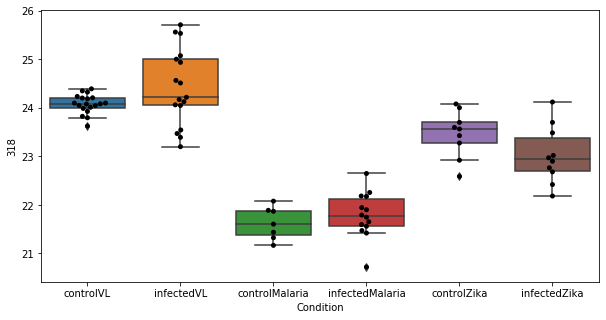

209 row m/z                  834.6
row retention time     3.15696
p-val                 0.496245
adj.P.Val             0.999793
custom_id                 3116
compound_names             NaN
Name: 3116, dtype: object


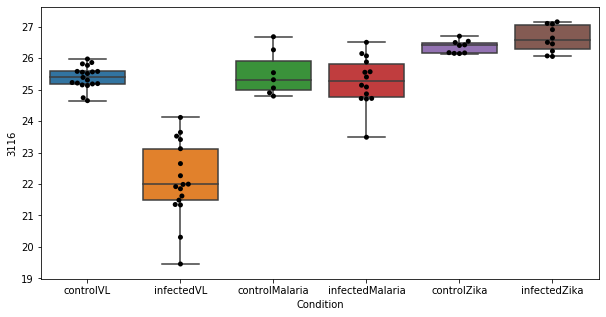

210 row m/z                905.594
row retention time     2.99894
p-val                 0.496526
adj.P.Val             0.999793
custom_id                 3200
compound_names             NaN
Name: 3200, dtype: object


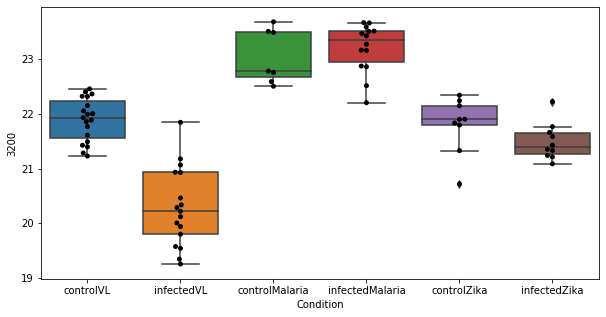

211 row m/z                288.225
row retention time     3.33908
p-val                 0.497084
adj.P.Val             0.999793
custom_id                 2310
compound_names             NaN
Name: 2310, dtype: object


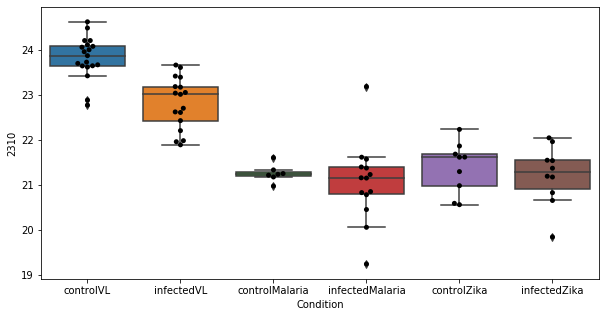

212 row m/z                676.547
row retention time     3.46451
p-val                 0.497455
adj.P.Val             0.999793
custom_id                 2905
compound_names             NaN
Name: 2905, dtype: object


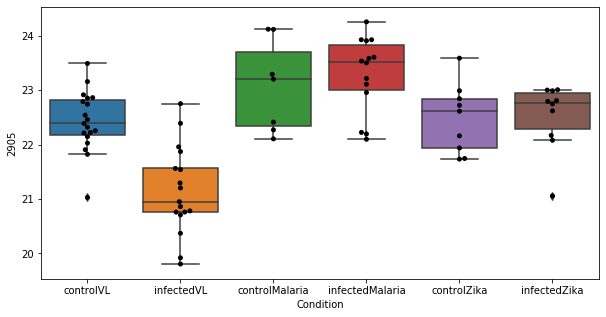

213 row m/z                214.253
row retention time     6.77671
p-val                 0.498285
adj.P.Val             0.999793
custom_id                 3803
compound_names             NaN
Name: 3803, dtype: object


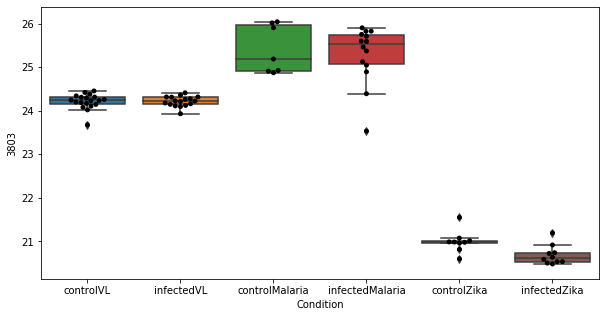

214 row m/z                289.053
row retention time     9.96725
p-val                 0.499107
adj.P.Val             0.999793
custom_id                 2319
compound_names             NaN
Name: 2319, dtype: object


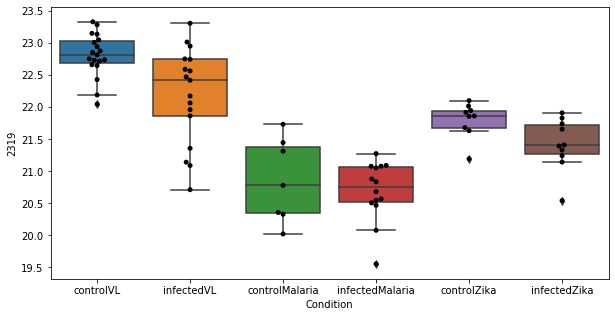

215 row m/z                                 139.05
row retention time                     9.04449
p-val                                 0.500101
adj.P.Val                             0.999793
custom_id                                 3392
compound_names        Urocanate; Urocanic acid
Name: 3392, dtype: object


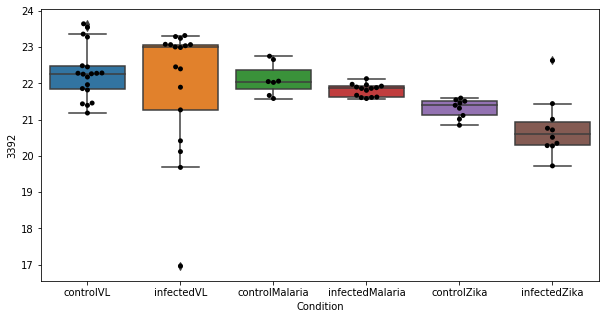

216 row m/z                807.572
row retention time     3.18235
p-val                 0.502438
adj.P.Val             0.999793
custom_id                 3065
compound_names             NaN
Name: 3065, dtype: object


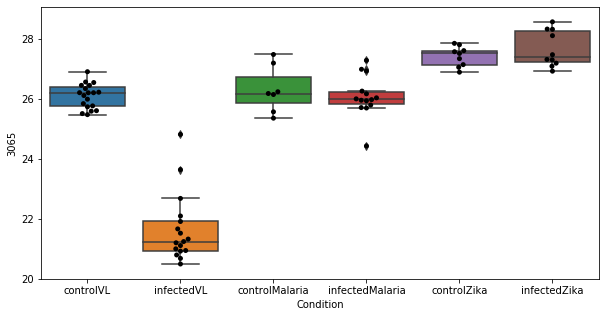

217 row m/z                191.085
row retention time     9.80185
p-val                 0.503305
adj.P.Val             0.999793
custom_id                 1299
compound_names             NaN
Name: 1299, dtype: object


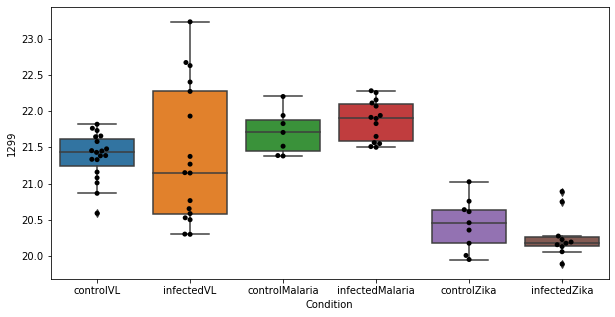

218 row m/z                143.107
row retention time     4.38606
p-val                 0.509237
adj.P.Val             0.999793
custom_id                  610
compound_names             NaN
Name: 610, dtype: object


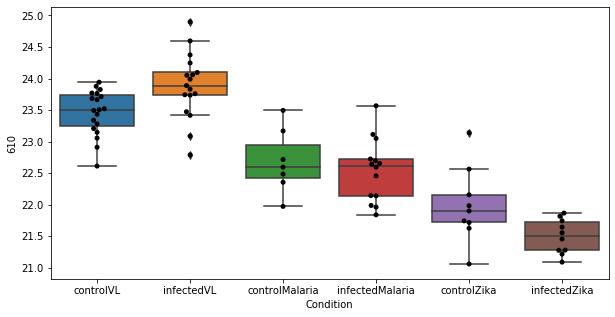

219 row m/z                163.116
row retention time     10.7419
p-val                 0.513173
adj.P.Val             0.999793
custom_id                  935
compound_names             NaN
Name: 935, dtype: object


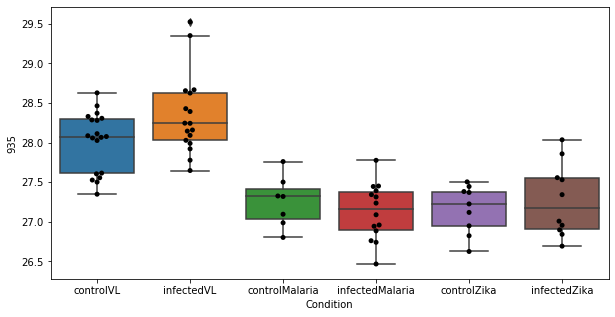

220 row m/z                      216.123
row retention time           6.72113
p-val                       0.515063
adj.P.Val                   0.999793
custom_id                       1633
compound_names        L-Metanephrine
Name: 1633, dtype: object


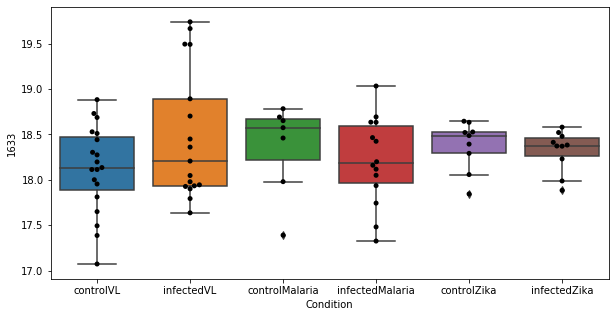

221 row m/z                                                          157.08
row retention time                                              11.7725
p-val                                                          0.519241
adj.P.Val                                                      0.999793
custom_id                                                           841
compound_names        L-Histidine; (S)-alpha-Amino-1H-imidazole-4-pr...
Name: 841, dtype: object


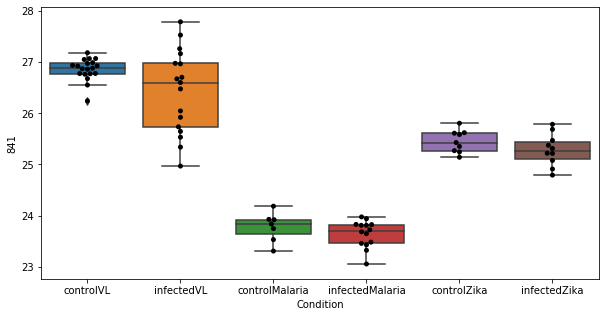

222 row m/z                575.467
row retention time     2.97972
p-val                 0.521695
adj.P.Val             0.999793
custom_id                 2836
compound_names             NaN
Name: 2836, dtype: object


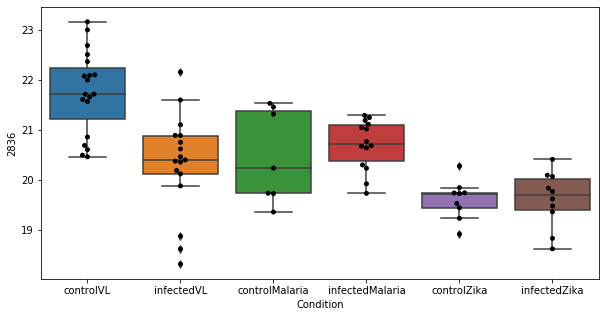

223 row m/z                76.0757
row retention time     9.35989
p-val                 0.524817
adj.P.Val             0.999793
custom_id                   19
compound_names             NaN
Name: 19, dtype: object


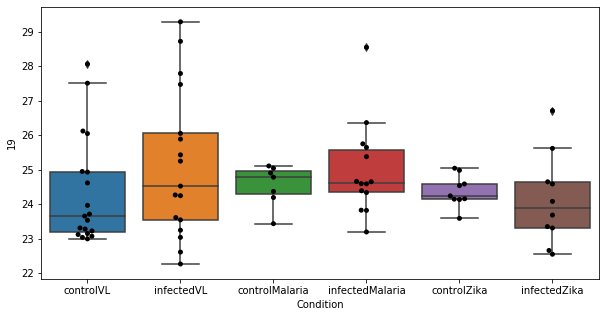

224 row m/z                229.155
row retention time     10.5569
p-val                 0.527825
adj.P.Val             0.999793
custom_id                 1791
compound_names             NaN
Name: 1791, dtype: object


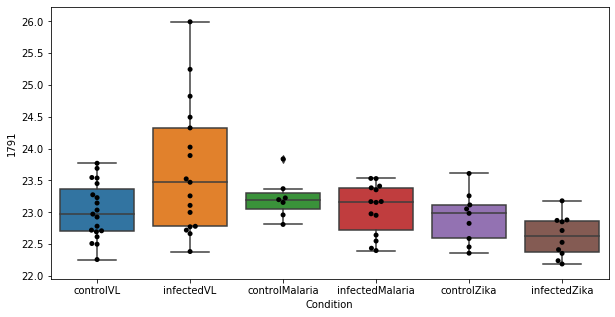

225 row m/z                247.144
row retention time     7.69256
p-val                 0.528263
adj.P.Val             0.999793
custom_id                 1973
compound_names             NaN
Name: 1973, dtype: object


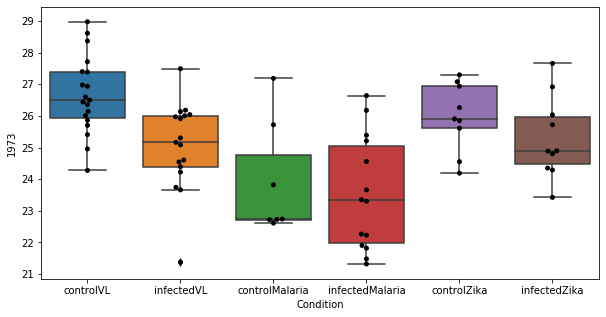

226 row m/z                                                         162.076
row retention time                                              9.36508
p-val                                                          0.529877
adj.P.Val                                                      0.999793
custom_id                                                           925
compound_names        D-Glucosamine; Chitosamine; 2-Amino-2-deoxy-D-...
Name: 925, dtype: object


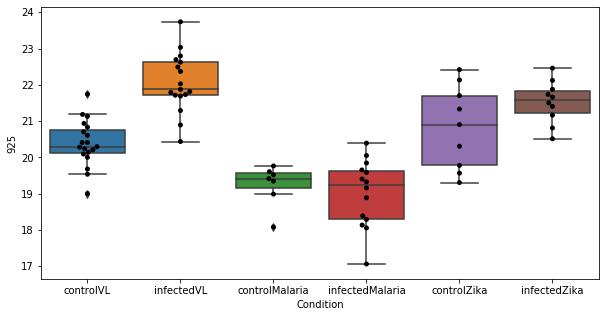

227 row m/z                                                         162.112
row retention time                                              10.7402
p-val                                                          0.529928
adj.P.Val                                                      0.999793
custom_id                                                           927
compound_names        L-Carnitine; L-gamma-Trimethyl-beta-hydroxybut...
Name: 927, dtype: object


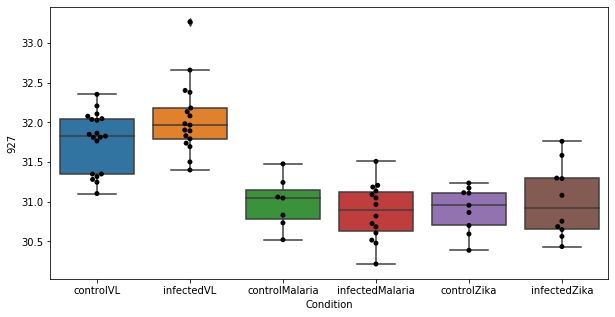

228 row m/z                244.191
row retention time     3.87308
p-val                  0.53371
adj.P.Val             0.999793
custom_id                 1944
compound_names             NaN
Name: 1944, dtype: object


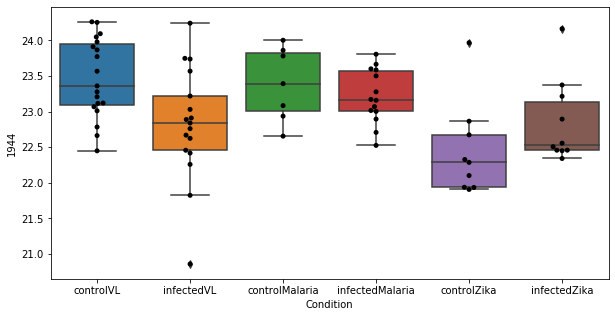

229 row m/z                 226.18
row retention time     3.89297
p-val                 0.539524
adj.P.Val             0.999793
custom_id                 1748
compound_names             NaN
Name: 1748, dtype: object


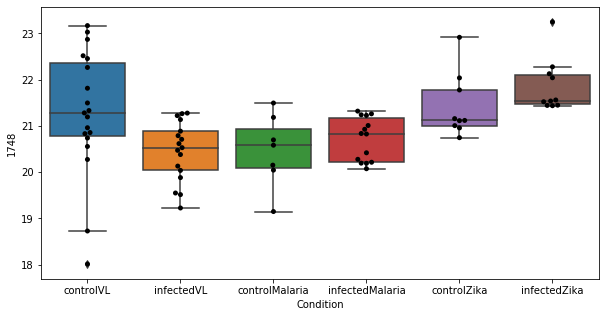

230 row m/z                132.054
row retention time     11.8975
p-val                 0.545874
adj.P.Val             0.999793
custom_id                  455
compound_names             NaN
Name: 455, dtype: object


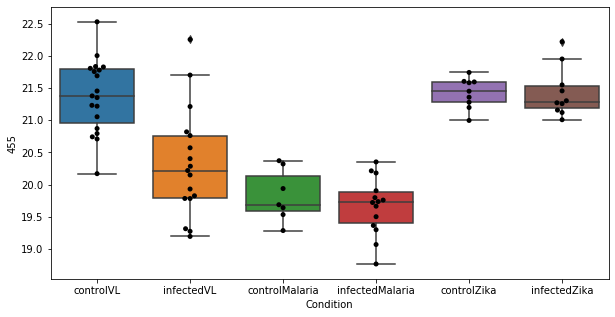

231 row m/z                174.132
row retention time      9.2893
p-val                 0.546504
adj.P.Val             0.999793
custom_id                 1096
compound_names             NaN
Name: 1096, dtype: object


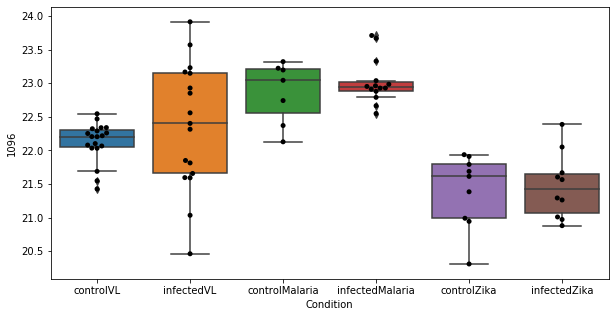

232 row m/z                             142.086
row retention time                  9.05916
p-val                              0.548533
adj.P.Val                          0.999793
custom_id                               584
compound_names        5-Acetamidopentanoate
Name: 584, dtype: object


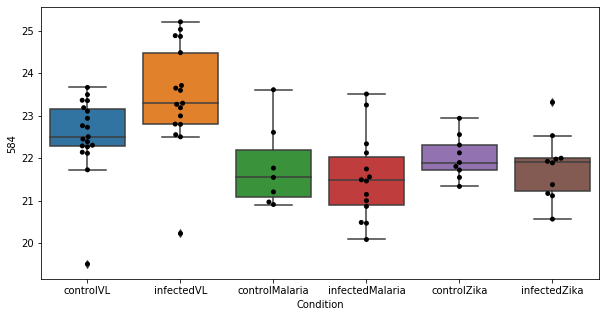

233 row m/z                812.614
row retention time     3.17385
p-val                 0.549159
adj.P.Val             0.999793
custom_id                 3079
compound_names             NaN
Name: 3079, dtype: object


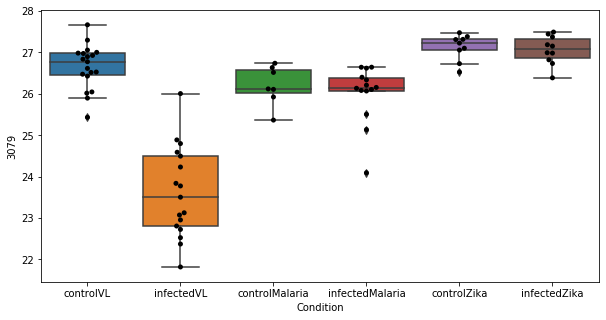

234 row m/z                183.113
row retention time     6.71641
p-val                 0.550576
adj.P.Val             0.999793
custom_id                 1197
compound_names             NaN
Name: 1197, dtype: object


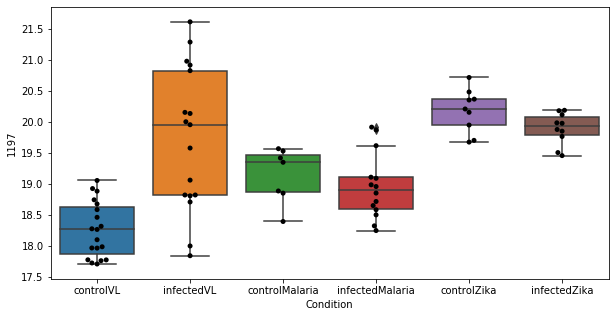

235 row m/z                            400.342
row retention time                 3.76884
p-val                             0.552457
adj.P.Val                         0.999793
custom_id                             2676
compound_names        L-Palmitoylcarnitine
Name: 2676, dtype: object


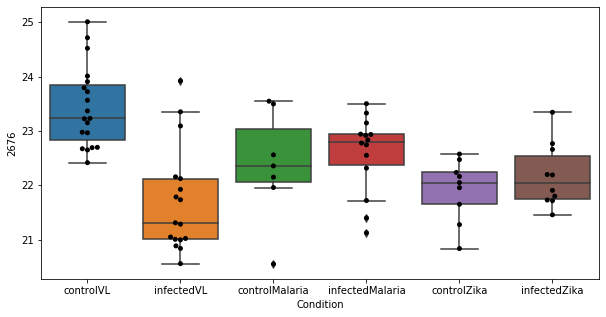

236 row m/z                164.119
row retention time     10.7393
p-val                 0.553988
adj.P.Val             0.999793
custom_id                  952
compound_names             NaN
Name: 952, dtype: object


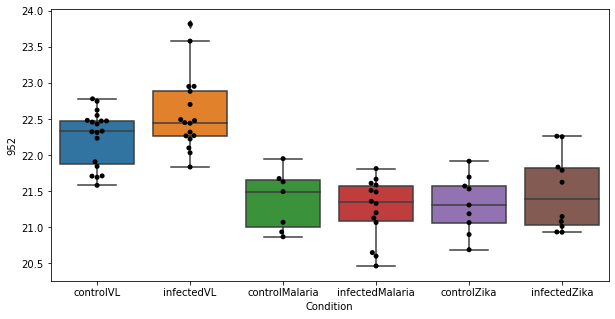

237 row m/z                158.081
row retention time     4.53391
p-val                 0.556928
adj.P.Val             0.999793
custom_id                  853
compound_names             NaN
Name: 853, dtype: object


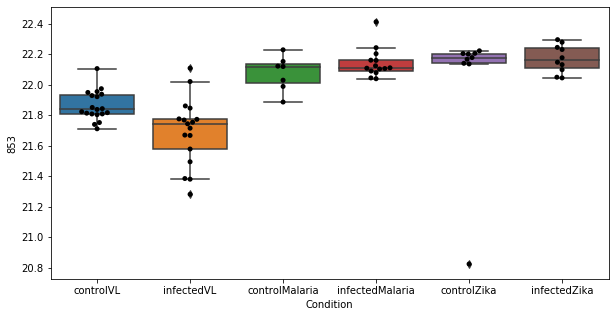

238 row m/z                770.603
row retention time     3.19827
p-val                 0.556976
adj.P.Val             0.999793
custom_id                 2992
compound_names             NaN
Name: 2992, dtype: object


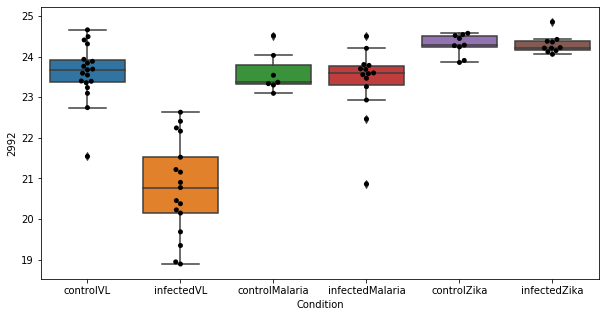

239 row m/z                                                         140.068
row retention time                                              9.59523
p-val                                                          0.557329
adj.P.Val                                                      0.999793
custom_id                                                           568
compound_names        5-Aminopentanoate; 5-Aminopentanoic acid; 5-Am...
Name: 568, dtype: object


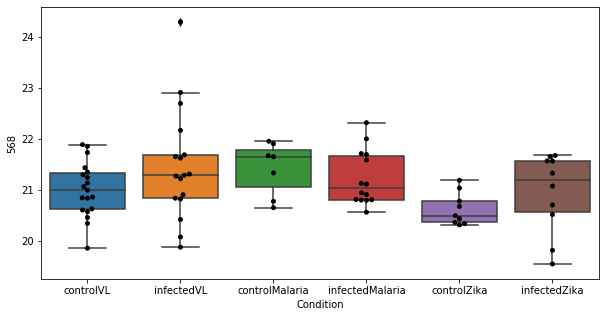

240 row m/z                806.569
row retention time     3.17983
p-val                 0.558478
adj.P.Val             0.999793
custom_id                 3063
compound_names             NaN
Name: 3063, dtype: object


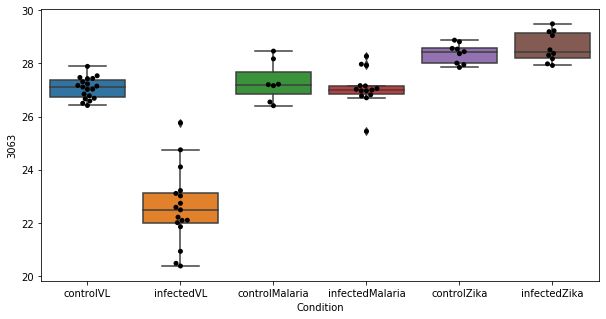

241 row m/z                                                        249.061
row retention time                                             9.95826
p-val                                                         0.559071
adj.P.Val                                                     0.999793
custom_id                                                         1987
compound_names        5-Acetylamino-6-formylamino-3-methyluracil; AFMU
Name: 1987, dtype: object


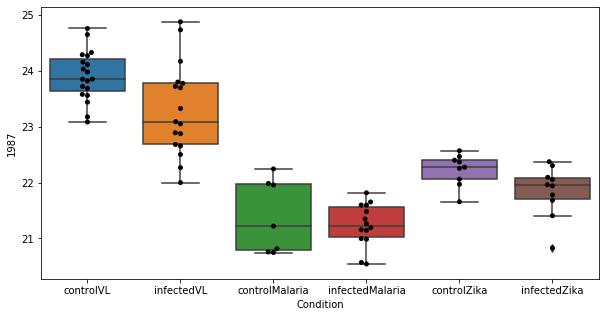

242 row m/z                329.174
row retention time     10.3999
p-val                 0.559448
adj.P.Val             0.999793
custom_id                 2506
compound_names             NaN
Name: 2506, dtype: object


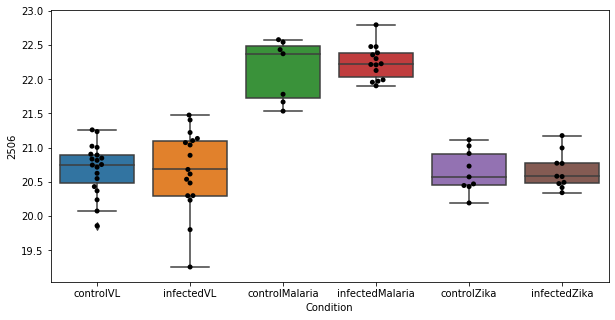

243 row m/z                790.622
row retention time     3.18252
p-val                 0.562162
adj.P.Val             0.999793
custom_id                 3036
compound_names             NaN
Name: 3036, dtype: object


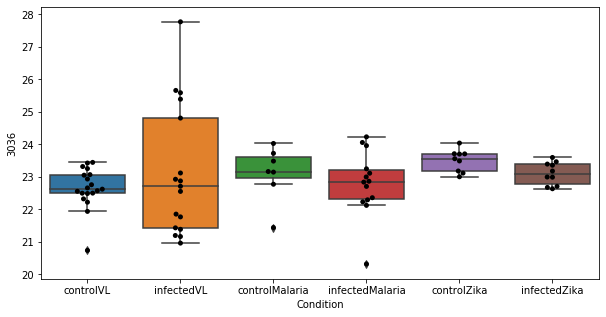

244 row m/z                            147.121
row retention time                 10.7328
p-val                             0.563068
adj.P.Val                         0.999793
custom_id                              698
compound_names        3-Dehydroxycarnitine
Name: 698, dtype: object


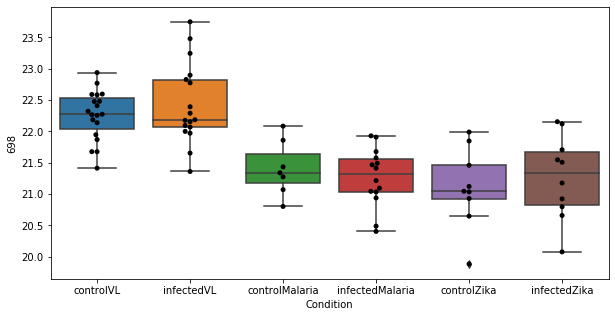

245 row m/z                154.072
row retention time     9.03698
p-val                 0.563375
adj.P.Val             0.999793
custom_id                  795
compound_names             NaN
Name: 795, dtype: object


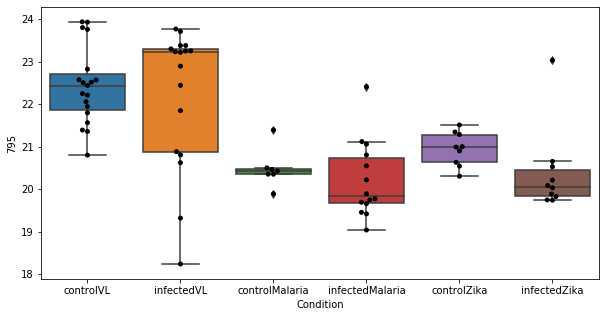

246 row m/z                                                          343.19
row retention time                                              9.29234
p-val                                                          0.565838
adj.P.Val                                                      0.999793
custom_id                                                          2544
compound_names        Cortisone; 17alpha,21-Dihydroxy-4-pregnene-3,1...
Name: 2544, dtype: object


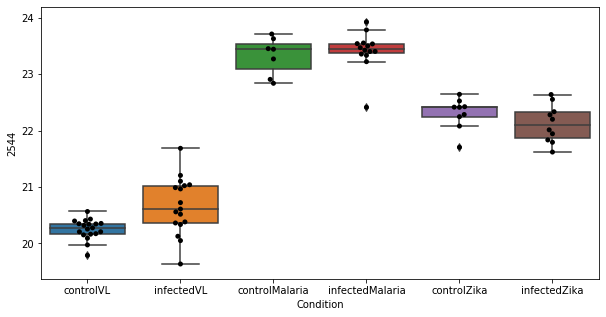

247 row m/z                735.572
row retention time     3.22431
p-val                 0.568637
adj.P.Val             0.999793
custom_id                 2946
compound_names             NaN
Name: 2946, dtype: object


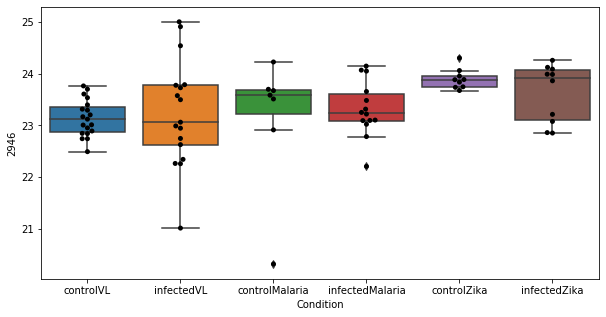

248 row m/z                164.116
row retention time     10.7397
p-val                 0.572741
adj.P.Val             0.999793
custom_id                  951
compound_names             NaN
Name: 951, dtype: object


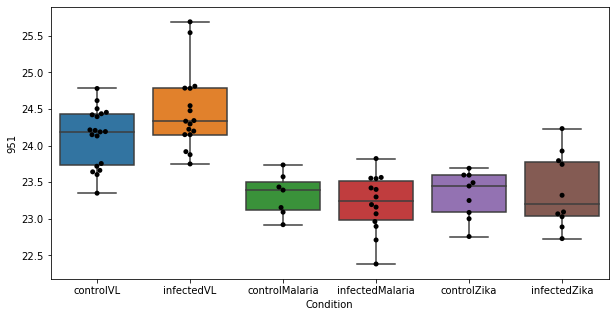

249 row m/z                 612.52
row retention time     2.99117
p-val                 0.573333
adj.P.Val             0.999793
custom_id                 2869
compound_names             NaN
Name: 2869, dtype: object


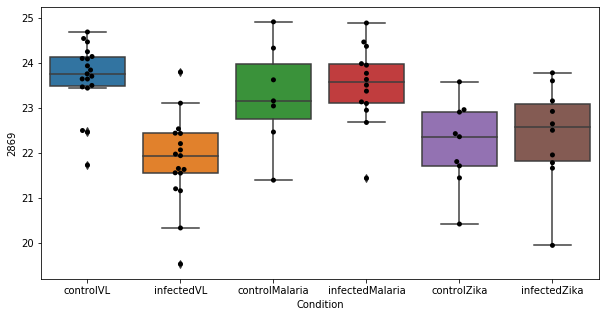

250 row m/z                                                         156.102
row retention time                                              4.37061
p-val                                                          0.573367
adj.P.Val                                                      0.999793
custom_id                                                          3479
compound_names        L-Normetanephrine$L-Adrenaline; (R)-(-)-Adrena...
Name: 3479, dtype: object


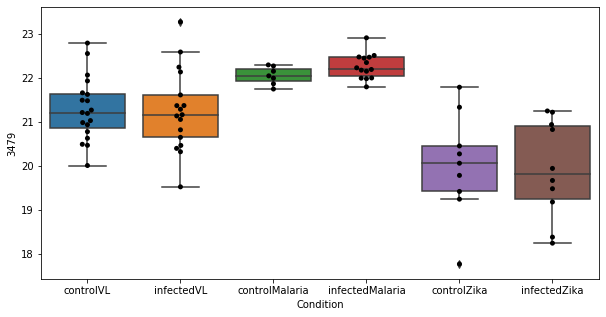

251 row m/z                211.133
row retention time     3.69812
p-val                 0.576311
adj.P.Val             0.999793
custom_id                 1563
compound_names             NaN
Name: 1563, dtype: object


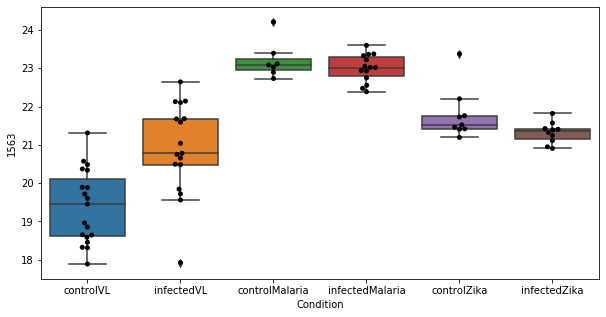

252 row m/z                173.117
row retention time     4.25529
p-val                 0.577178
adj.P.Val             0.999793
custom_id                 3578
compound_names             NaN
Name: 3578, dtype: object


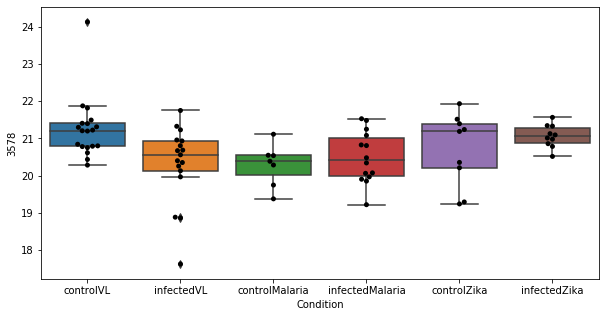

253 row m/z                                                         147.076
row retention time                                              10.1063
p-val                                                          0.577713
adj.P.Val                                                      0.999793
custom_id                                                           692
compound_names        D-Glutamine; D-2-Aminoglutaramic acid$L-Glutam...
Name: 692, dtype: object


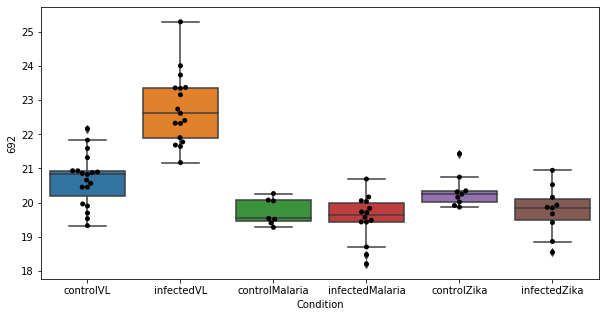

254 row m/z                786.657
row retention time     3.30119
p-val                 0.577727
adj.P.Val             0.999793
custom_id                 3023
compound_names             NaN
Name: 3023, dtype: object


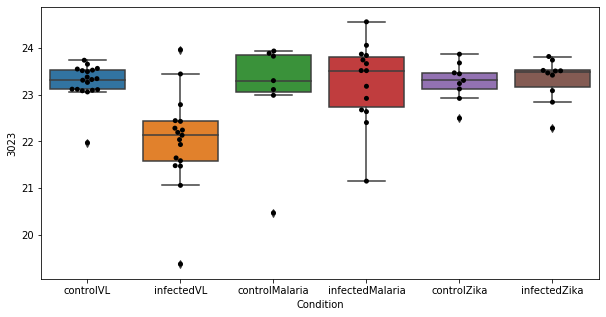

255 row m/z                                                         114.055
row retention time                                              9.62583
p-val                                                          0.580047
adj.P.Val                                                      0.999793
custom_id                                                           224
compound_names        1-Pyrroline-2-carboxylate; 1-Pyrroline-2-carbo...
Name: 224, dtype: object


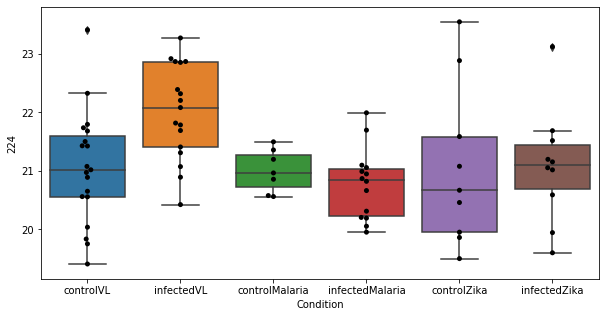

256 row m/z                150.113
row retention time     8.21405
p-val                 0.580438
adj.P.Val             0.999793
custom_id                  750
compound_names             NaN
Name: 750, dtype: object


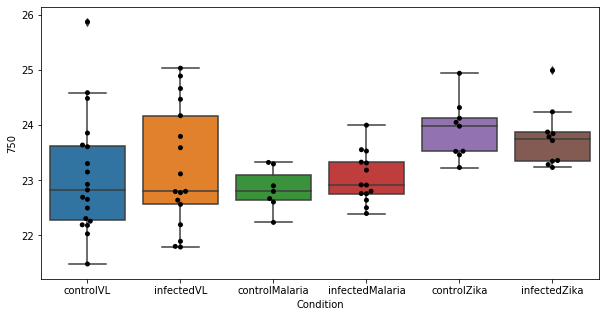

257 row m/z                756.553
row retention time     3.23797
p-val                 0.583193
adj.P.Val             0.999793
custom_id                 2967
compound_names             NaN
Name: 2967, dtype: object


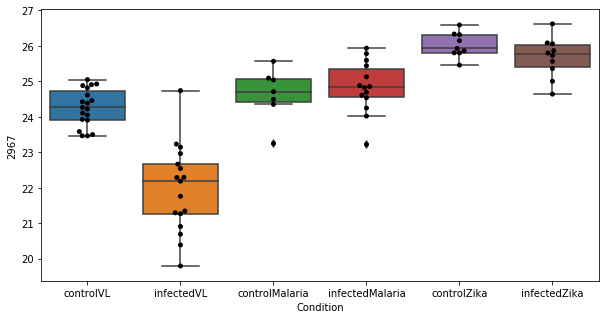

258 row m/z                782.569
row retention time     3.20424
p-val                 0.586946
adj.P.Val             0.999793
custom_id                 3009
compound_names             NaN
Name: 3009, dtype: object


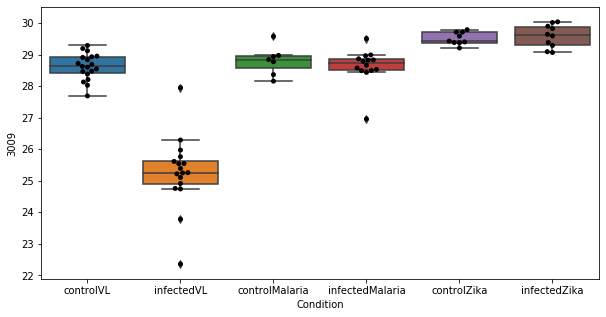

259 row m/z                809.588
row retention time     3.18517
p-val                 0.587036
adj.P.Val             0.999793
custom_id                 3070
compound_names             NaN
Name: 3070, dtype: object


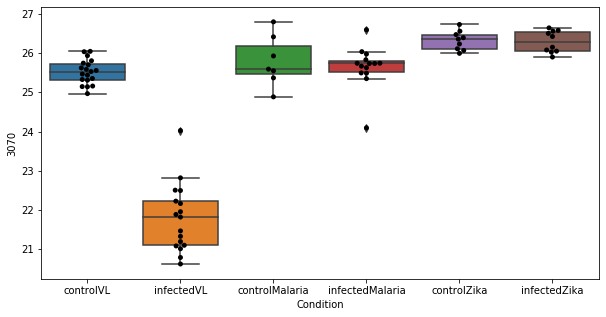

260 row m/z                182.139
row retention time     4.27109
p-val                 0.588605
adj.P.Val             0.999793
custom_id                 1185
compound_names             NaN
Name: 1185, dtype: object


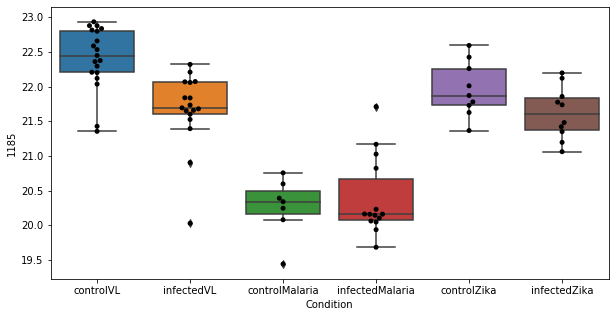

261 row m/z                546.355
row retention time     3.69144
p-val                 0.589183
adj.P.Val             0.999793
custom_id                 2817
compound_names             NaN
Name: 2817, dtype: object


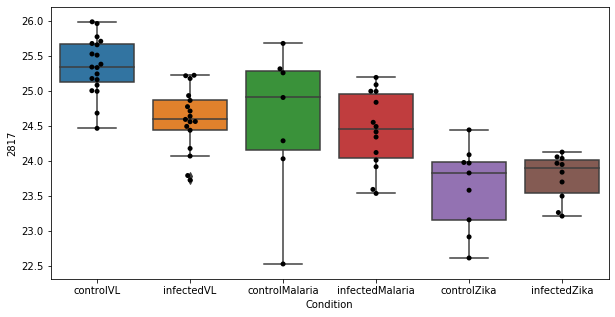

262 row m/z                119.016
row retention time     10.0976
p-val                 0.589368
adj.P.Val             0.999793
custom_id                  293
compound_names             NaN
Name: 293, dtype: object


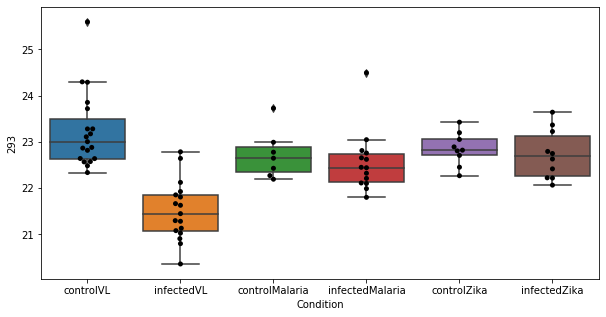

263 row m/z                 904.59
row retention time     2.99672
p-val                 0.590415
adj.P.Val             0.999793
custom_id                 3197
compound_names             NaN
Name: 3197, dtype: object


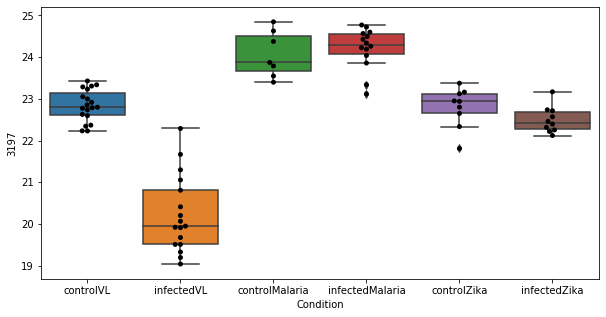

264 row m/z                200.027
row retention time     10.5774
p-val                 0.590514
adj.P.Val             0.999793
custom_id                 1416
compound_names             NaN
Name: 1416, dtype: object


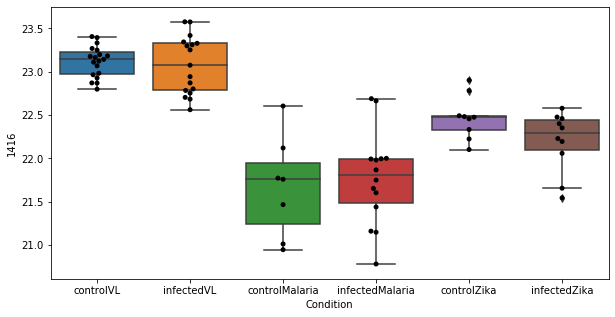

265 row m/z                316.248
row retention time     6.70854
p-val                 0.590764
adj.P.Val             0.999793
custom_id                 2465
compound_names             NaN
Name: 2465, dtype: object


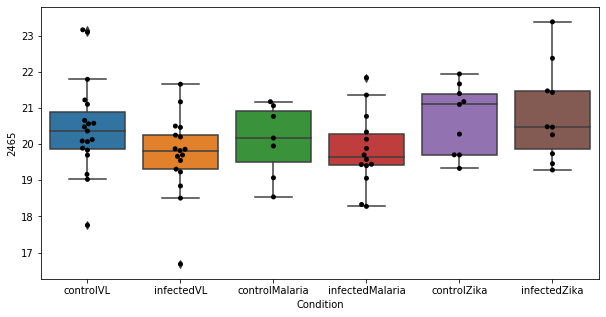

266 row m/z                                                         281.247
row retention time                                              3.01221
p-val                                                          0.591462
adj.P.Val                                                      0.999793
custom_id                                                          2259
compound_names        Linoleate; Linoleic acid; (9Z,12Z)-Octadecadie...
Name: 2259, dtype: object


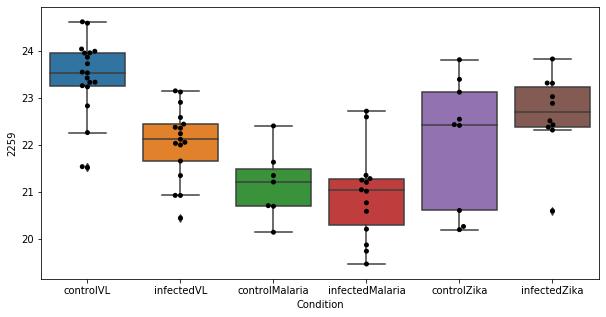

267 row m/z                781.556
row retention time     3.22257
p-val                 0.591482
adj.P.Val             0.999793
custom_id                 3007
compound_names             NaN
Name: 3007, dtype: object


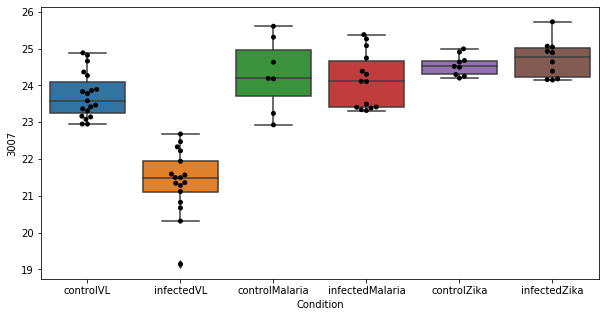

268 row m/z                239.128
row retention time     3.59802
p-val                 0.592008
adj.P.Val             0.999793
custom_id                 1894
compound_names             NaN
Name: 1894, dtype: object


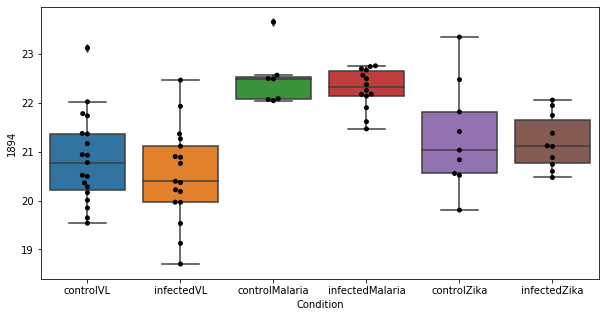

269 row m/z                                                         146.092
row retention time                                              11.9397
p-val                                                          0.593922
adj.P.Val                                                      0.999793
custom_id                                                           671
compound_names        5-Guanidino-2-oxopentanoate; 5-Guanidino-2-oxo...
Name: 671, dtype: object


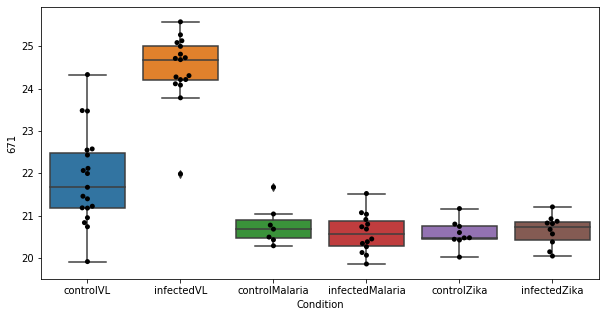

270 row m/z                156.138
row retention time     4.38882
p-val                  0.59543
adj.P.Val             0.999793
custom_id                  830
compound_names             NaN
Name: 830, dtype: object


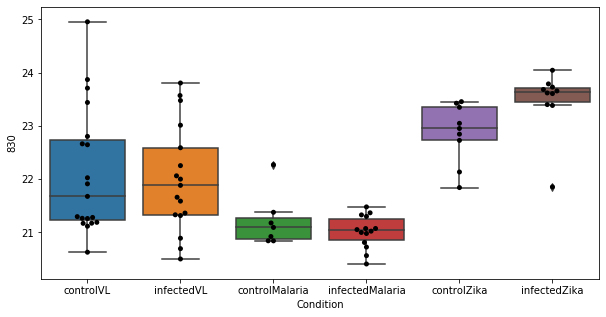

271 row m/z                332.331
row retention time     6.71606
p-val                 0.598004
adj.P.Val             0.999793
custom_id                 2515
compound_names             NaN
Name: 2515, dtype: object


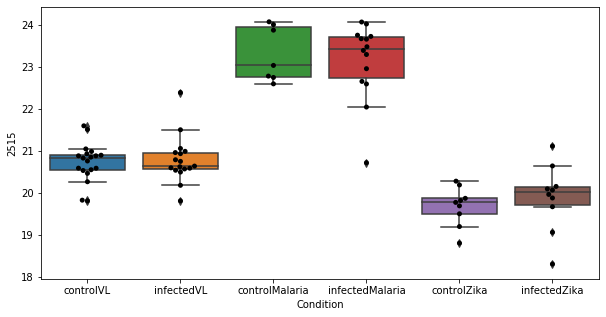

272 row m/z                185.117
row retention time     4.38696
p-val                 0.600151
adj.P.Val             0.999793
custom_id                 1224
compound_names             NaN
Name: 1224, dtype: object


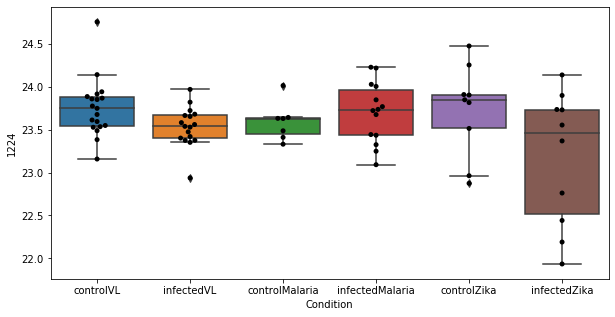

273 row m/z                246.133
row retention time     6.71118
p-val                 0.600461
adj.P.Val             0.999793
custom_id                 1961
compound_names             NaN
Name: 1961, dtype: object


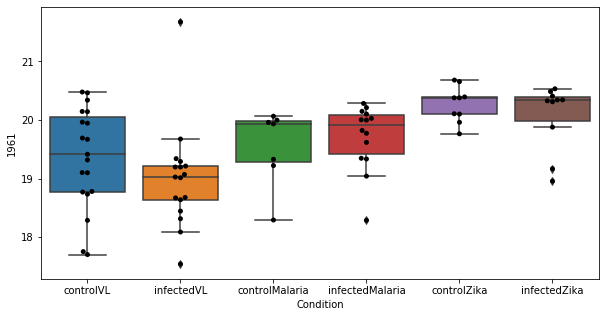

274 row m/z                242.284
row retention time     6.71102
p-val                 0.601169
adj.P.Val             0.999793
custom_id                 1921
compound_names             NaN
Name: 1921, dtype: object


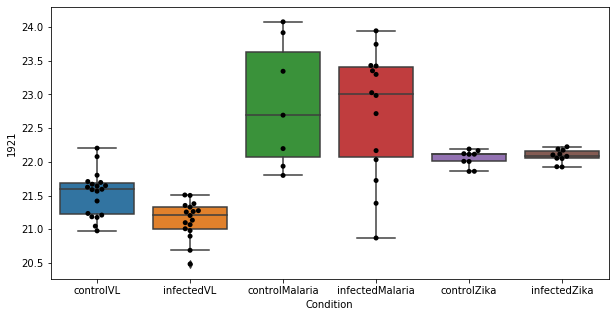

275 row m/z                                                         120.066
row retention time                                              11.6047
p-val                                                          0.603375
adj.P.Val                                                      0.999793
custom_id                                                           301
compound_names        L-Allothreonine; L-allo-Threonine$L-Threonine;...
Name: 301, dtype: object


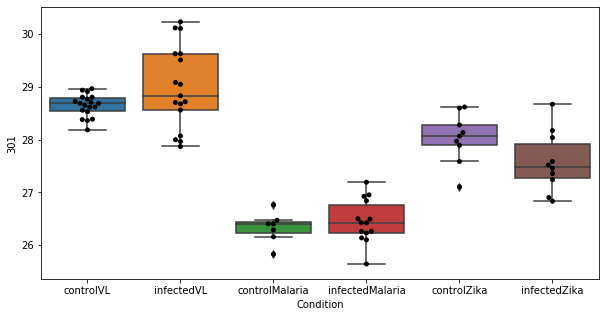

276 row m/z                                                       129.102
row retention time                                            10.1401
p-val                                                        0.603578
adj.P.Val                                                    0.999793
custom_id                                                         397
compound_names        L-Lysine; Lysine acid; 2,6-Diaminohexanoic acid
Name: 397, dtype: object


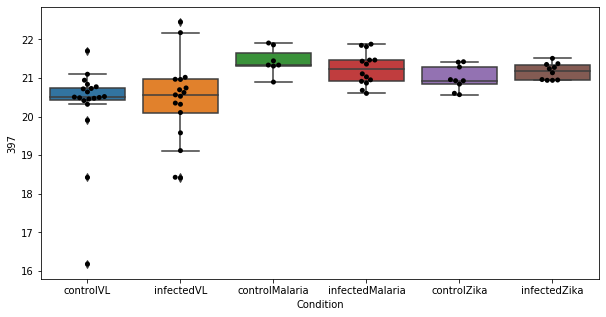

277 row m/z                                                         154.069
row retention time                                              6.76427
p-val                                                          0.604288
adj.P.Val                                                      0.999793
custom_id                                                           794
compound_names        N1-Methyl-2-pyridone-5-carboxamide; N'-Methyl-...
Name: 794, dtype: object


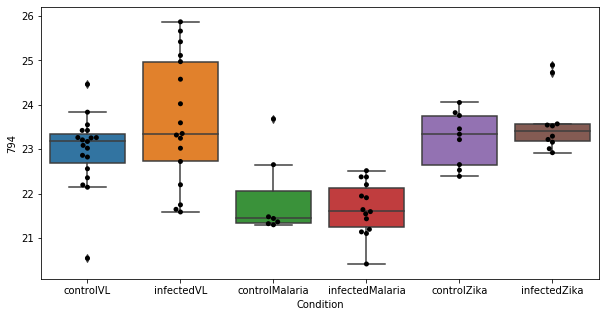

278 row m/z                836.614
row retention time     3.15613
p-val                 0.604317
adj.P.Val             0.999793
custom_id                 3118
compound_names             NaN
Name: 3118, dtype: object


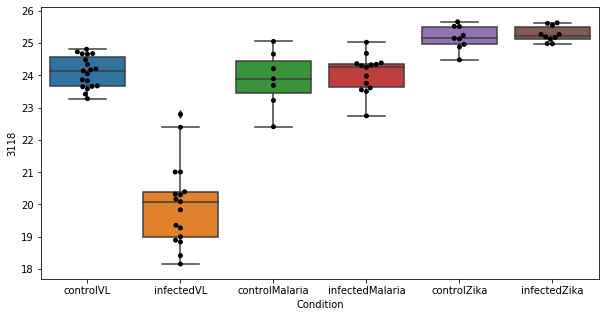

279 row m/z                272.185
row retention time     6.70999
p-val                 0.604751
adj.P.Val             0.999793
custom_id                 2186
compound_names             NaN
Name: 2186, dtype: object


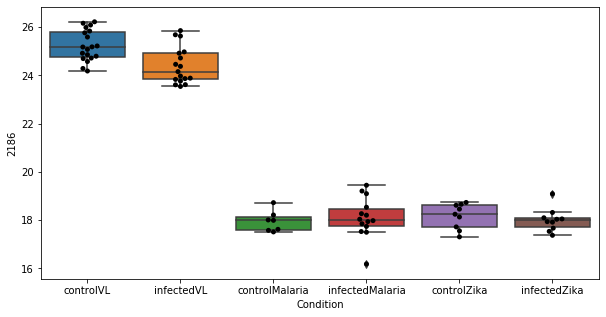

280 row m/z                114.034
row retention time     8.58987
p-val                 0.605021
adj.P.Val             0.999793
custom_id                  223
compound_names             NaN
Name: 223, dtype: object


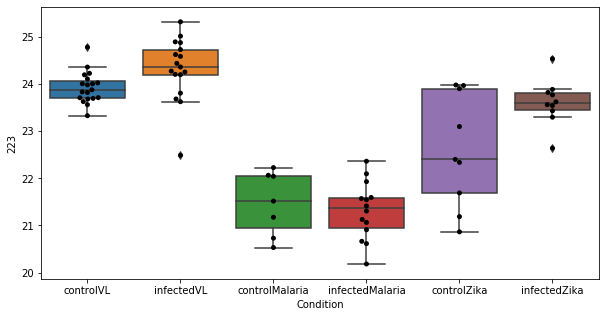

281 row m/z                      170.118
row retention time           6.71232
p-val                       0.606642
adj.P.Val                   0.999793
custom_id                       1034
compound_names        L-Metanephrine
Name: 1034, dtype: object


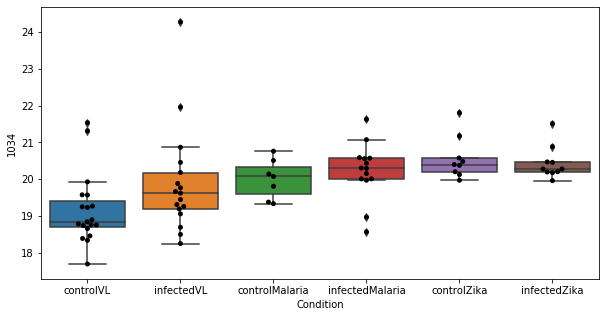

282 row m/z                158.118
row retention time     4.39119
p-val                 0.608341
adj.P.Val             0.999793
custom_id                  863
compound_names             NaN
Name: 863, dtype: object


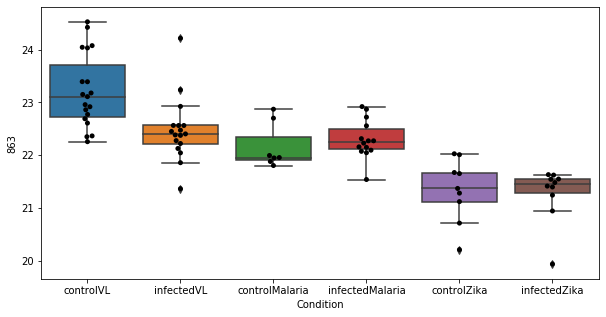

283 row m/z                                                         133.105
row retention time                                              9.28401
p-val                                                          0.609427
adj.P.Val                                                      0.999793
custom_id                                                           489
compound_names        L-Isoleucine; 2-Amino-3-methylvaleric acid$L-L...
Name: 489, dtype: object


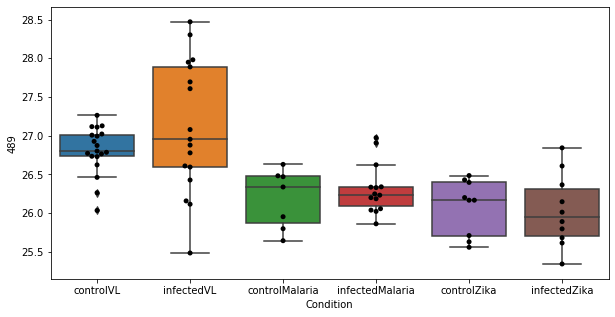

284 row m/z                125.096
row retention time     4.37678
p-val                 0.611708
adj.P.Val             0.999793
custom_id                  365
compound_names             NaN
Name: 365, dtype: object


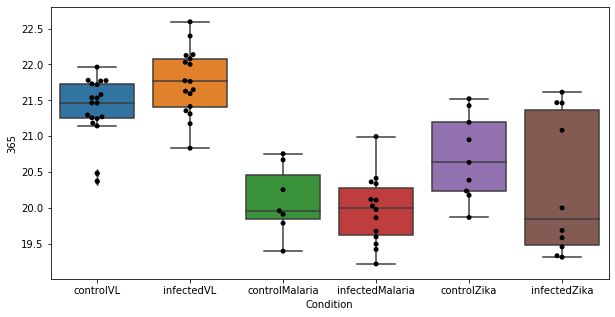

285 row m/z                                                         266.121
row retention time                                              6.71218
p-val                                                          0.612779
adj.P.Val                                                      0.999793
custom_id                                                          2144
compound_names        Thiamin; Thiamine; Vitamin B1; Aneurin; Antibe...
Name: 2144, dtype: object


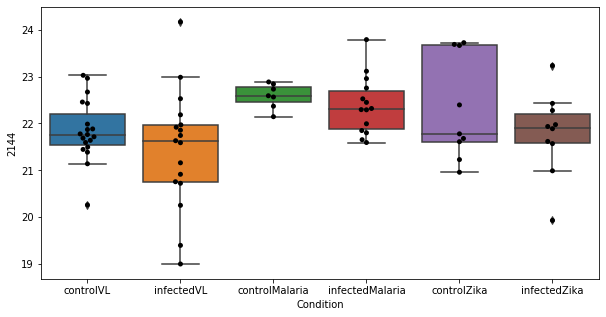

286 row m/z                                                         132.102
row retention time                                              9.28268
p-val                                                          0.615776
adj.P.Val                                                      0.999793
custom_id                                                           462
compound_names        L-Isoleucine; 2-Amino-3-methylvaleric acid$L-L...
Name: 462, dtype: object


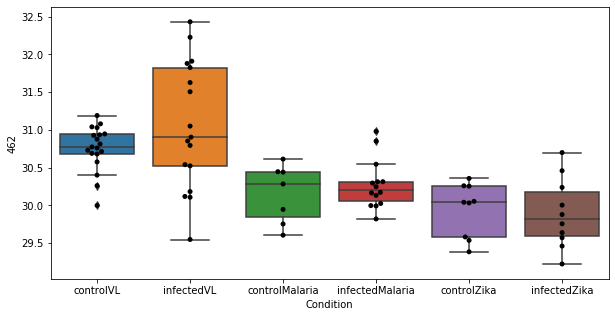

287 row m/z                                                         129.066
row retention time                                              11.7393
p-val                                                          0.616066
adj.P.Val                                                      0.999793
custom_id                                                           390
compound_names        D-Glutamine; D-2-Aminoglutaramic acid$L-Glutam...
Name: 390, dtype: object


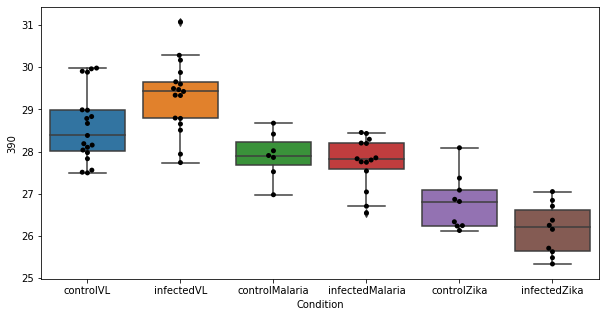

288 row m/z                                                        136.043
row retention time                                             10.0993
p-val                                                         0.617793
adj.P.Val                                                     0.999793
custom_id                                                          515
compound_names        L-Homocysteine; L-2-Amino-4-mercaptobutyric acid
Name: 515, dtype: object


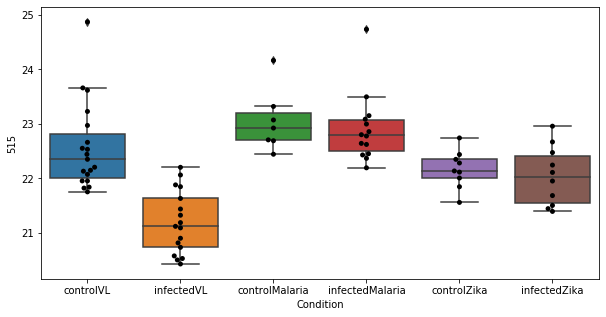

289 row m/z                742.574
row retention time     3.21016
p-val                 0.618038
adj.P.Val             0.999793
custom_id                 2951
compound_names             NaN
Name: 2951, dtype: object


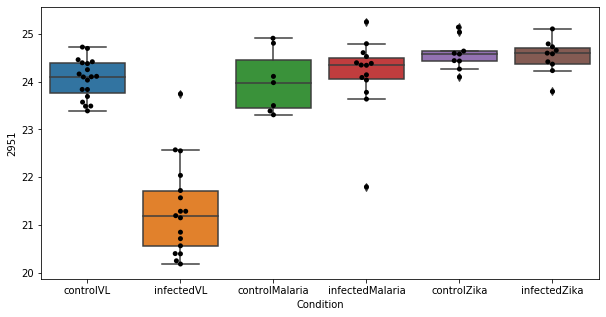

290 row m/z                758.569
row retention time     3.21358
p-val                 0.618484
adj.P.Val             0.999793
custom_id                 2970
compound_names             NaN
Name: 2970, dtype: object


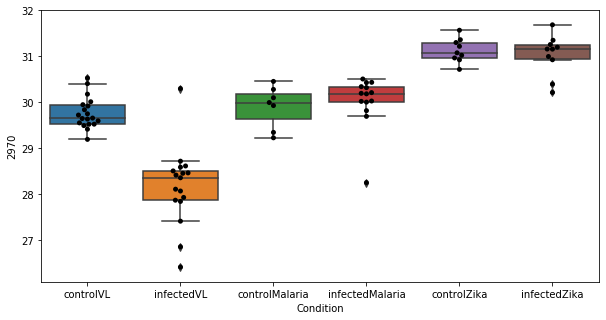

291 row m/z                191.164
row retention time     3.60632
p-val                 0.620303
adj.P.Val             0.999793
custom_id                 1311
compound_names             NaN
Name: 1311, dtype: object


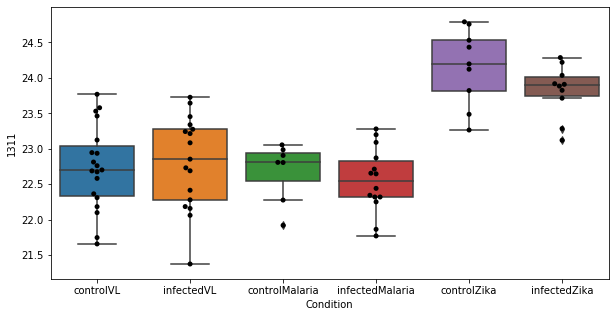

292 row m/z                627.535
row retention time     3.00661
p-val                 0.621582
adj.P.Val             0.999793
custom_id                 2879
compound_names             NaN
Name: 2879, dtype: object


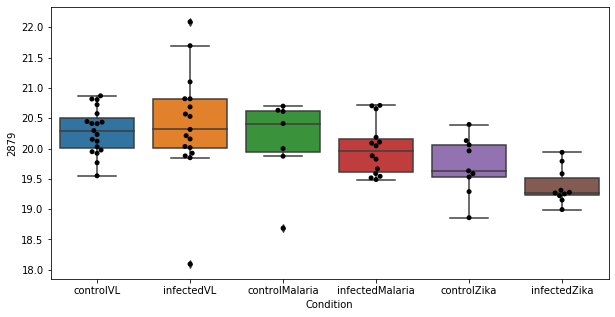

293 row m/z                734.569
row retention time     3.22582
p-val                 0.621834
adj.P.Val             0.999793
custom_id                 2945
compound_names             NaN
Name: 2945, dtype: object


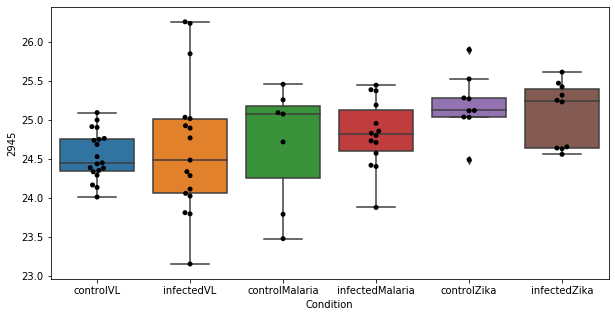

294 row m/z                594.509
row retention time     2.97821
p-val                  0.62575
adj.P.Val             0.999793
custom_id                 2854
compound_names             NaN
Name: 2854, dtype: object


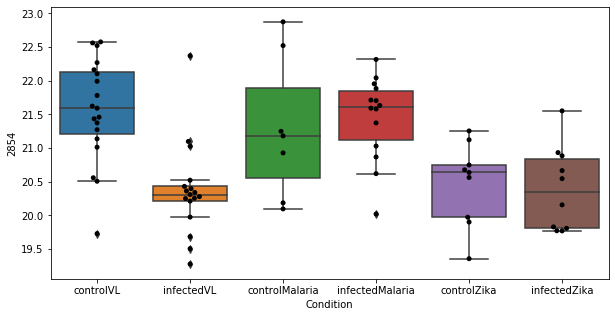

295 row m/z                           219.142
row retention time                8.41412
p-val                            0.627989
adj.P.Val                        0.999793
custom_id                            1686
compound_names        propionyl-carnitine
Name: 1686, dtype: object


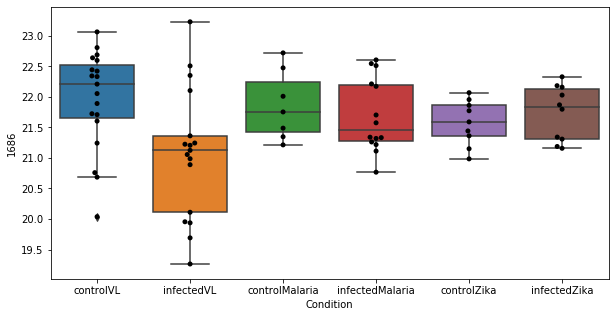

296 row m/z                 729.59
row retention time     3.38676
p-val                 0.628334
adj.P.Val             0.999793
custom_id                 2930
compound_names             NaN
Name: 2930, dtype: object


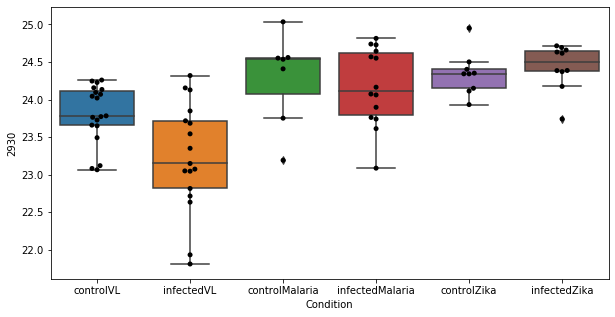

297 row m/z                218.211
row retention time     6.69938
p-val                 0.628683
adj.P.Val             0.999793
custom_id                 1669
compound_names             NaN
Name: 1669, dtype: object


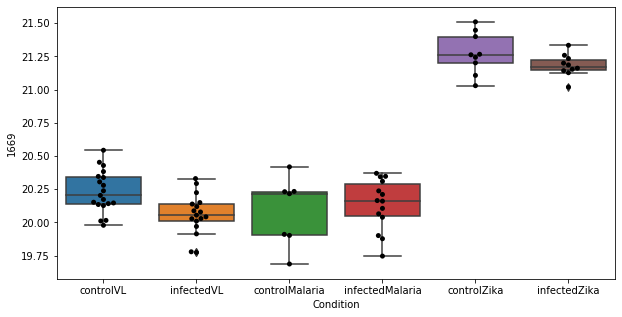

298 row m/z                                                         104.053
row retention time                                              9.80155
p-val                                                          0.630244
adj.P.Val                                                      0.999793
custom_id                                                           137
compound_names        L-Methionine; Methionine; L-2-Amino-4methylthi...
Name: 137, dtype: object


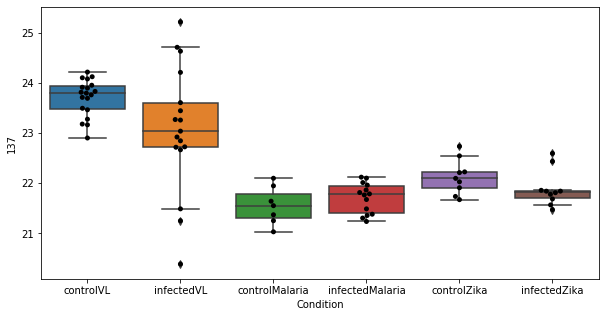

299 row m/z                 216.16
row retention time      4.3132
p-val                 0.630535
adj.P.Val             0.999793
custom_id                 1638
compound_names             NaN
Name: 1638, dtype: object


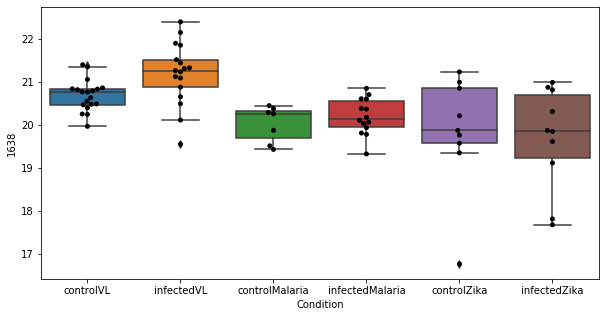

300 row m/z                181.163
row retention time     3.80665
p-val                 0.631906
adj.P.Val             0.999793
custom_id                 1177
compound_names             NaN
Name: 1177, dtype: object


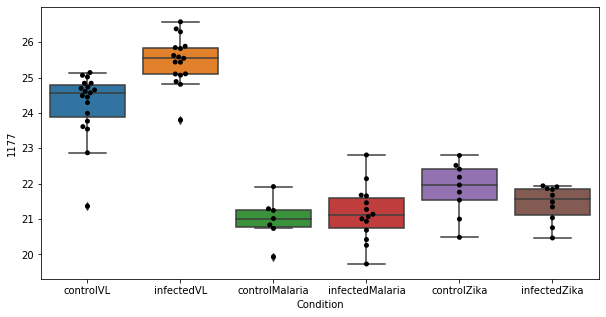

301 row m/z                743.577
row retention time     3.20198
p-val                 0.633272
adj.P.Val             0.999793
custom_id                 2952
compound_names             NaN
Name: 2952, dtype: object


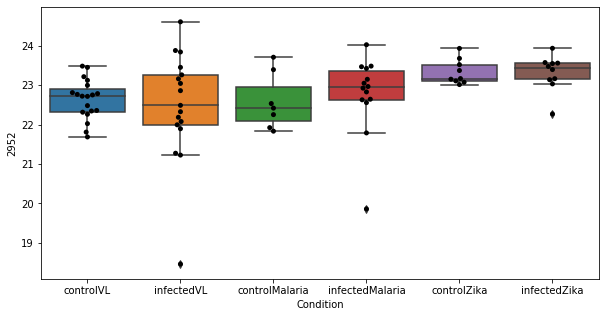

302 row m/z                808.583
row retention time     3.16917
p-val                 0.633403
adj.P.Val             0.999793
custom_id                 3068
compound_names             NaN
Name: 3068, dtype: object


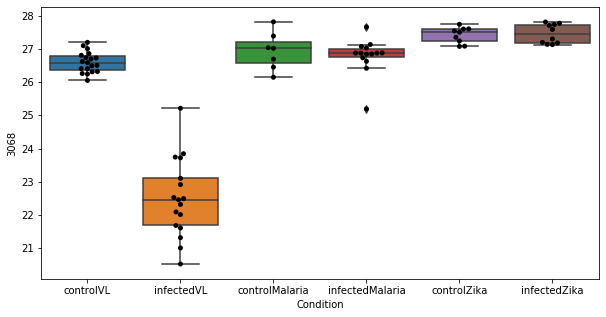

303 row m/z                521.343
row retention time     3.78543
p-val                 0.636431
adj.P.Val             0.999793
custom_id                 2791
compound_names             NaN
Name: 2791, dtype: object


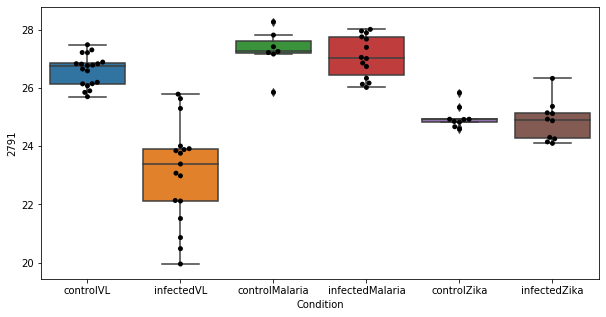

304 row m/z                558.473
row retention time     3.04166
p-val                 0.636667
adj.P.Val             0.999793
custom_id                 2826
compound_names             NaN
Name: 2826, dtype: object


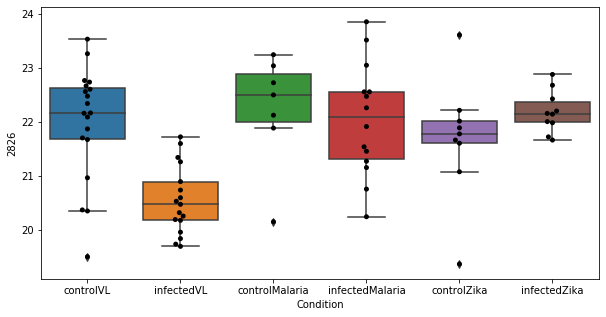

305 row m/z                783.572
row retention time     3.20447
p-val                 0.644611
adj.P.Val             0.999793
custom_id                 3010
compound_names             NaN
Name: 3010, dtype: object


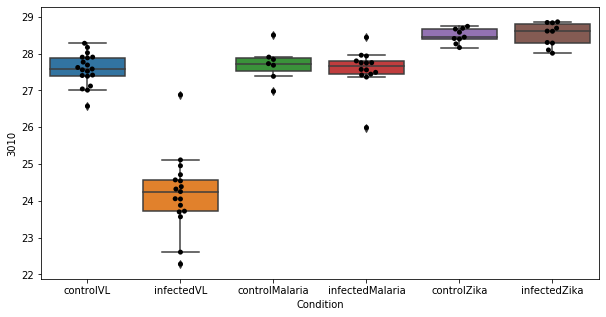

306 row m/z                                                         130.086
row retention time                                              6.71466
p-val                                                          0.645824
adj.P.Val                                                      0.999793
custom_id                                                           424
compound_names        N4-Acetylaminobutanal$L-Pipecolate; Pipecolini...
Name: 424, dtype: object


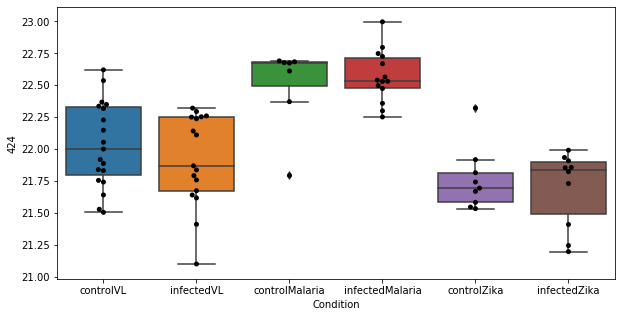

307 row m/z                469.389
row retention time     3.15979
p-val                 0.646817
adj.P.Val             0.999793
custom_id                 2744
compound_names             NaN
Name: 2744, dtype: object


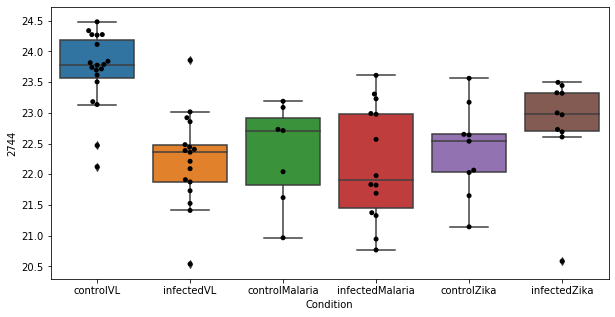

308 row m/z                                                         183.102
row retention time                                              6.70204
p-val                                                          0.649783
adj.P.Val                                                      0.999793
custom_id                                                          1192
compound_names        Ecgonine methyl ester; Methyl ecgonine$ecgonin...
Name: 1192, dtype: object


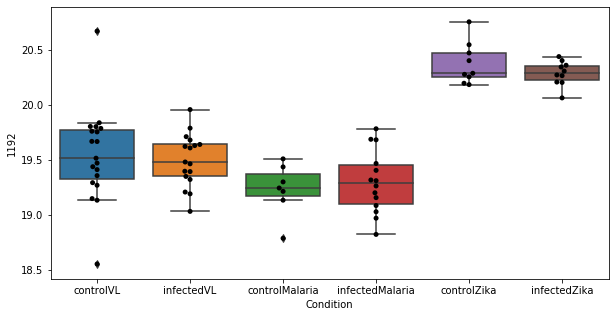

309 row m/z                796.619
row retention time     3.17773
p-val                 0.652228
adj.P.Val             0.999793
custom_id                 3045
compound_names             NaN
Name: 3045, dtype: object


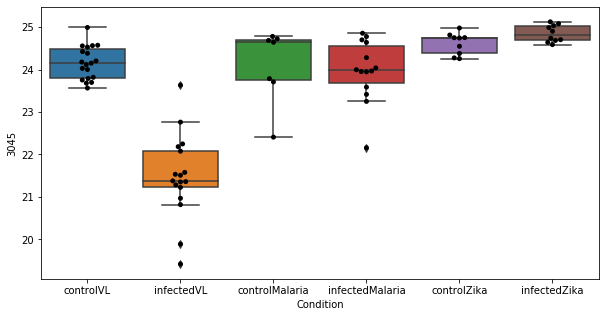

310 row m/z                 520.34
row retention time      3.7647
p-val                  0.65255
adj.P.Val             0.999793
custom_id                 2789
compound_names             NaN
Name: 2789, dtype: object


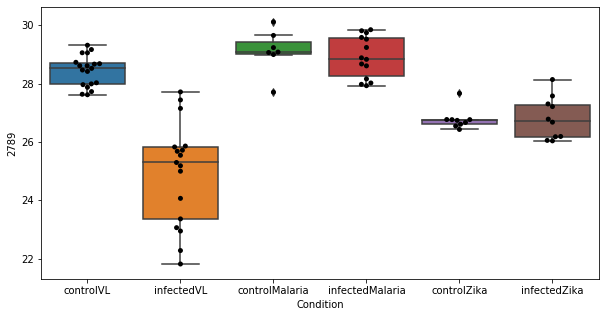

311 row m/z                194.092
row retention time     6.79009
p-val                 0.652552
adj.P.Val             0.999793
custom_id                 1351
compound_names             NaN
Name: 1351, dtype: object


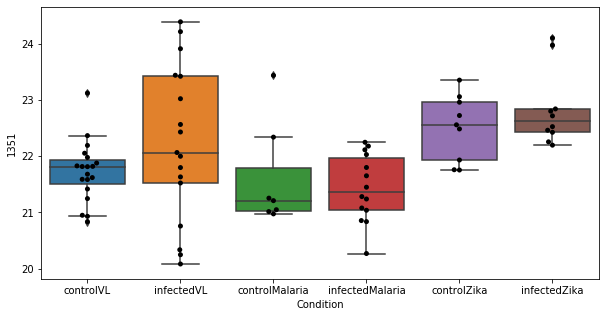

312 row m/z                766.574
row retention time     3.19285
p-val                 0.653705
adj.P.Val             0.999793
custom_id                 2983
compound_names             NaN
Name: 2983, dtype: object


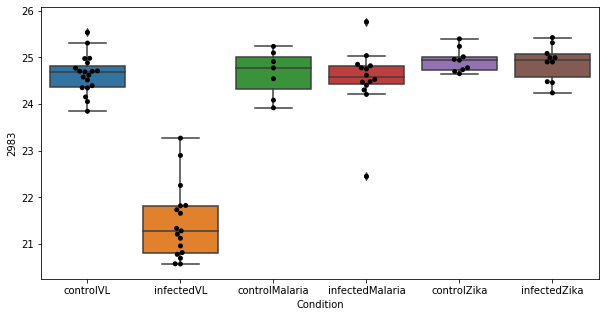

313 row m/z                102.066
row retention time     9.64807
p-val                 0.653936
adj.P.Val             0.999793
custom_id                  123
compound_names             NaN
Name: 123, dtype: object


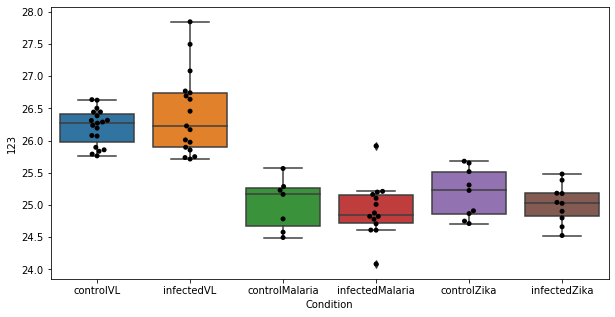

314 row m/z                                                         130.069
row retention time                                               11.738
p-val                                                          0.654603
adj.P.Val                                                      0.999793
custom_id                                                           420
compound_names        5,6-Dihydrothymine; Dihydrothymine; 5,6-Dihydr...
Name: 420, dtype: object


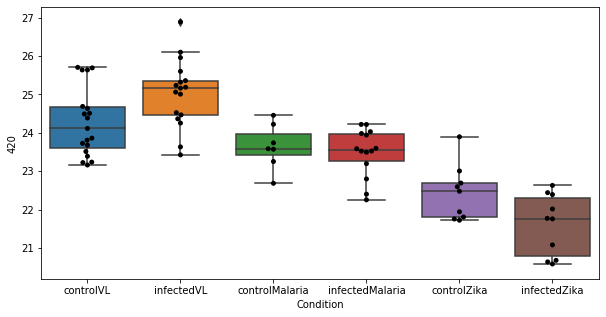

315 row m/z                788.612
row retention time     3.18832
p-val                 0.655123
adj.P.Val             0.999793
custom_id                 3028
compound_names             NaN
Name: 3028, dtype: object


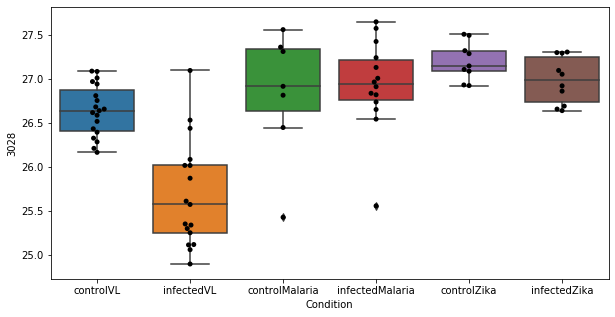

316 row m/z                                                         183.085
row retention time                                              10.8254
p-val                                                          0.657181
adj.P.Val                                                      0.999793
custom_id                                                          1190
compound_names        L-Tyrosine; (S)-3-(p-Hydroxyphenyl)alanine; (S...
Name: 1190, dtype: object


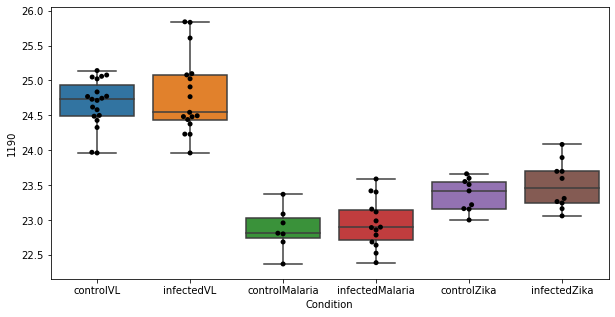

317 row m/z                144.102
row retention time     10.3128
p-val                 0.658673
adj.P.Val             0.999793
custom_id                  635
compound_names             NaN
Name: 635, dtype: object


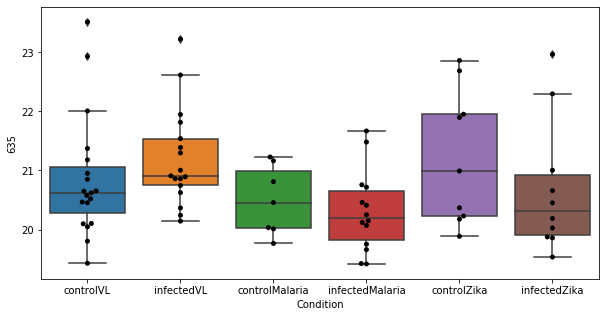

318 row m/z                                                         101.071
row retention time                                              11.9351
p-val                                                           0.66052
adj.P.Val                                                      0.999793
custom_id                                                           113
compound_names        D-Glutamine; D-2-Aminoglutaramic acid$L-Glutam...
Name: 113, dtype: object


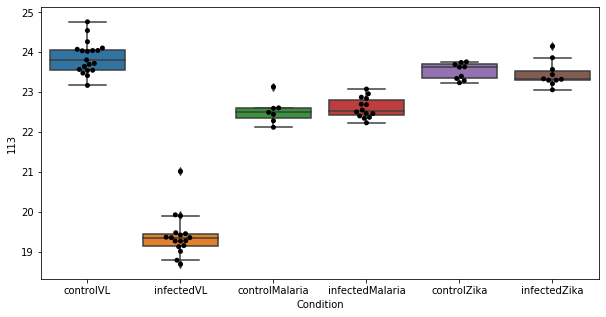

319 row m/z                542.323
row retention time     3.78322
p-val                 0.663391
adj.P.Val             0.999793
custom_id                 2814
compound_names             NaN
Name: 2814, dtype: object


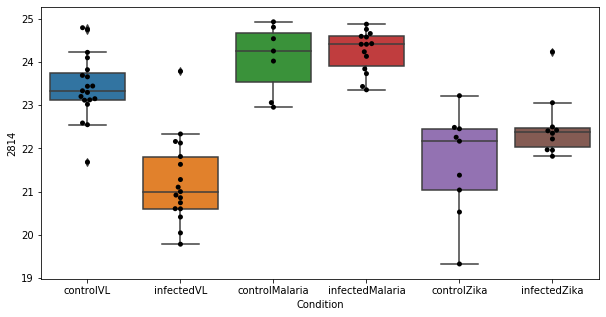

320 row m/z                 118.12
row retention time     10.4025
p-val                 0.663608
adj.P.Val             0.999793
custom_id                  286
compound_names             NaN
Name: 286, dtype: object


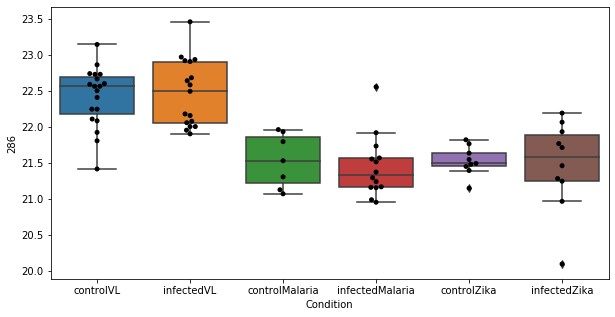

321 row m/z                                                          106.05
row retention time                                              12.4685
p-val                                                          0.664511
adj.P.Val                                                      0.999793
custom_id                                                           174
compound_names        L-Serine; L-2-Amino-3-hydroxypropionic acid; L...
Name: 174, dtype: object


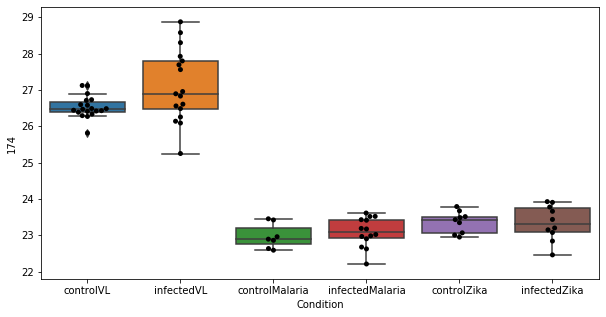

322 row m/z                759.572
row retention time     3.21587
p-val                 0.671665
adj.P.Val             0.999793
custom_id                 2971
compound_names             NaN
Name: 2971, dtype: object


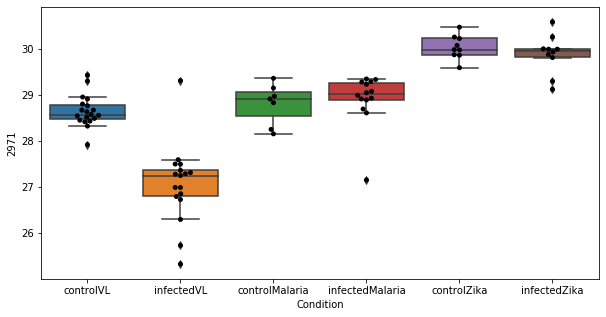

323 row m/z                      198.113
row retention time           4.38443
p-val                       0.673141
adj.P.Val                   0.999793
custom_id                       1396
compound_names        L-Metanephrine
Name: 1396, dtype: object


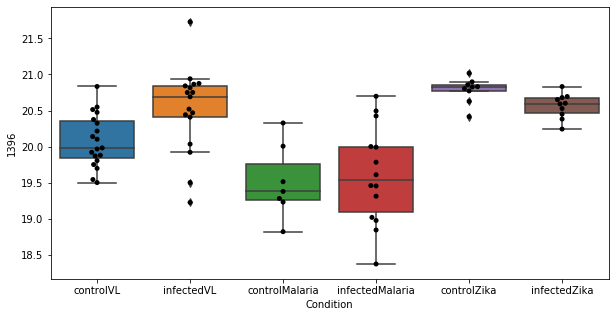

324 row m/z                213.123
row retention time      6.7136
p-val                 0.673277
adj.P.Val             0.999793
custom_id                 1592
compound_names             NaN
Name: 1592, dtype: object


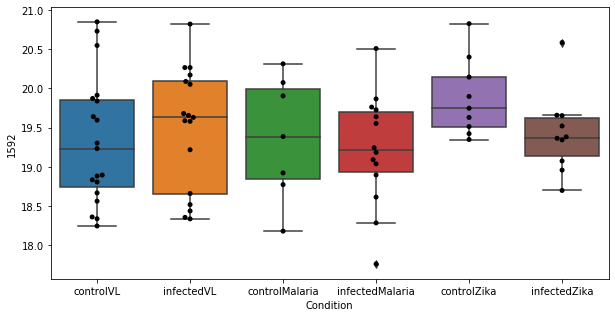

325 row m/z                168.123
row retention time     6.69643
p-val                 0.674176
adj.P.Val             0.999793
custom_id                 1005
compound_names             NaN
Name: 1005, dtype: object


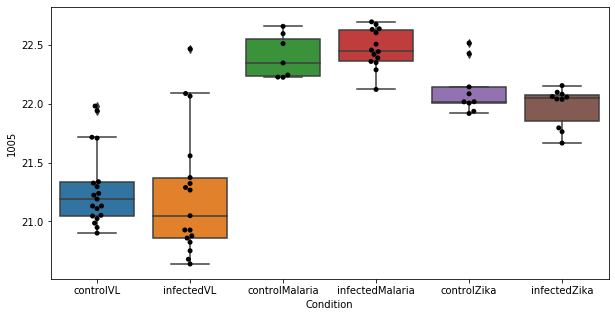

326 row m/z                                                         175.108
row retention time                                              10.8436
p-val                                                          0.675576
adj.P.Val                                                      0.999793
custom_id                                                          1108
compound_names        (+)-trans-Carveol; (4S,6R)-trans-Carveol$Peril...
Name: 1108, dtype: object


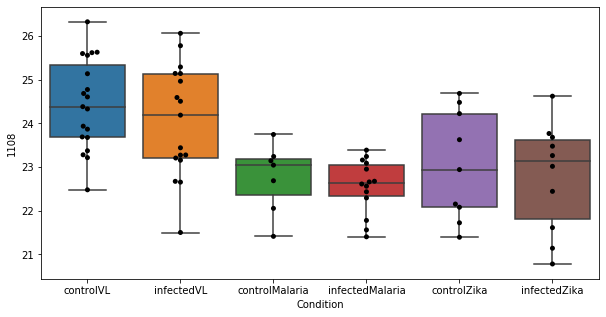

327 row m/z                272.185
row retention time     3.48876
p-val                 0.675943
adj.P.Val             0.999793
custom_id                 2185
compound_names             NaN
Name: 2185, dtype: object


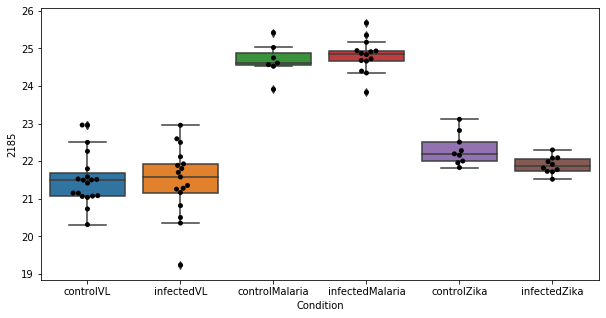

328 row m/z                243.948
row retention time     10.0775
p-val                 0.675991
adj.P.Val             0.999793
custom_id                 5027
compound_names             NaN
Name: 5027, dtype: object


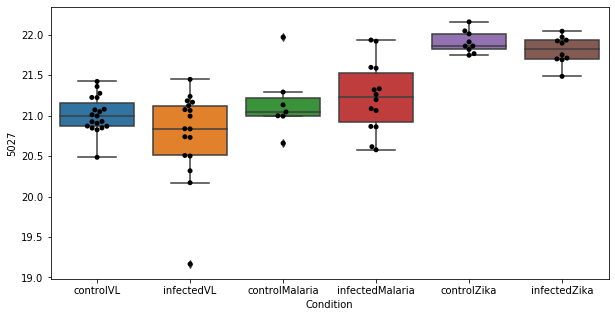

329 row m/z                                                        174.113
row retention time                                             6.71072
p-val                                                         0.676689
adj.P.Val                                                     0.999793
custom_id                                                         1090
compound_names        Pantothenate; Pantothenic acid; (R)-Pantothenate
Name: 1090, dtype: object


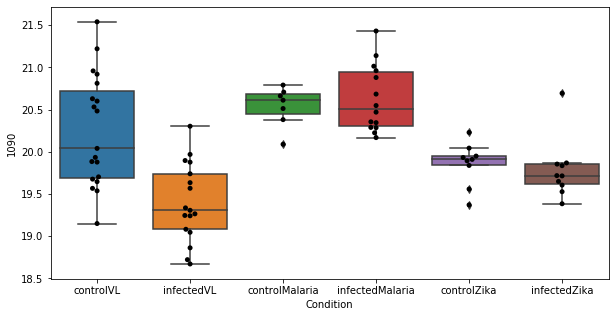

330 row m/z                173.129
row retention time     9.28048
p-val                 0.677529
adj.P.Val             0.999793
custom_id                 1080
compound_names             NaN
Name: 1080, dtype: object


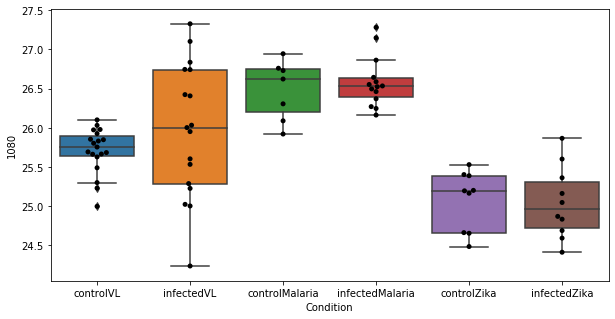

331 row m/z                689.559
row retention time      3.4459
p-val                  0.67864
adj.P.Val             0.999793
custom_id                 2910
compound_names             NaN
Name: 2910, dtype: object


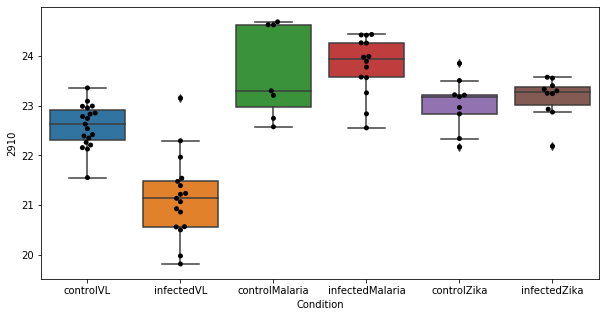

332 row m/z                619.491
row retention time     2.92792
p-val                 0.678722
adj.P.Val             0.999793
custom_id                 2876
compound_names             NaN
Name: 2876, dtype: object


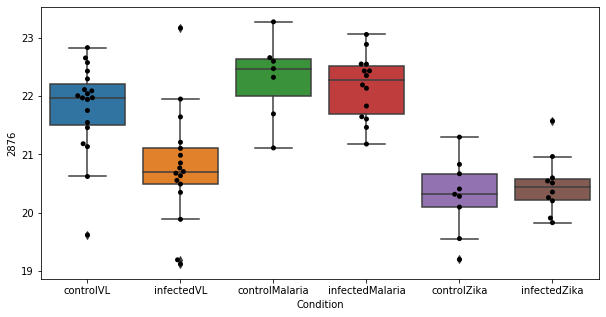

333 row m/z                                                         138.055
row retention time                                              9.88574
p-val                                                          0.681921
adj.P.Val                                                      0.999793
custom_id                                                           550
compound_names        Anthranilate; Anthranilic acid; o-Aminobenzoic...
Name: 550, dtype: object


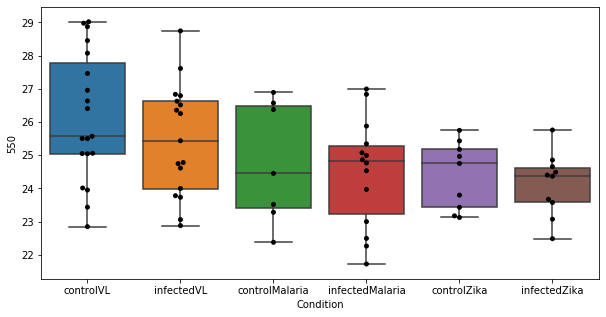

334 row m/z                217.107
row retention time     3.71855
p-val                 0.683018
adj.P.Val             0.999793
custom_id                 1648
compound_names             NaN
Name: 1648, dtype: object


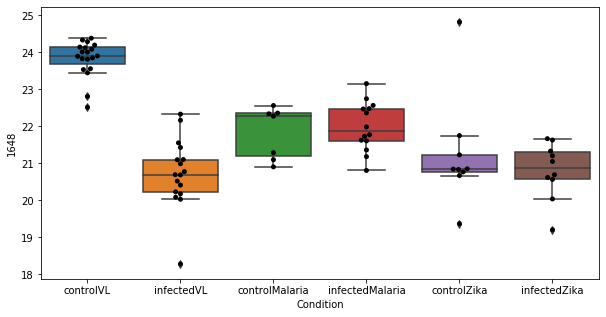

335 row m/z                261.121
row retention time     6.69969
p-val                 0.683835
adj.P.Val             0.999793
custom_id                 2108
compound_names             NaN
Name: 2108, dtype: object


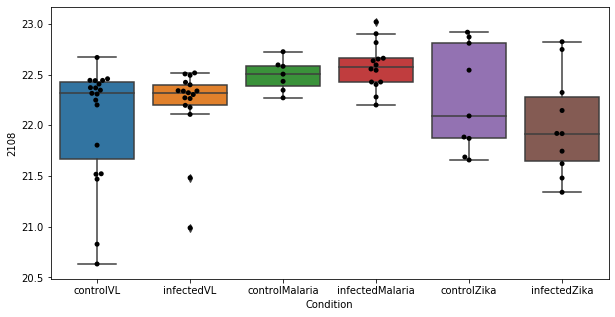

336 row m/z                148.097
row retention time     3.80394
p-val                 0.684369
adj.P.Val             0.999793
custom_id                  717
compound_names             NaN
Name: 717, dtype: object


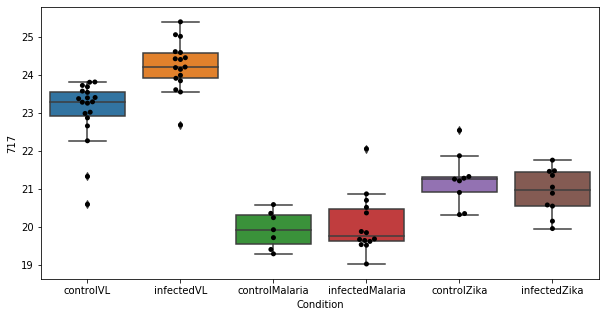

337 row m/z                794.605
row retention time     3.17332
p-val                 0.685348
adj.P.Val             0.999793
custom_id                 3040
compound_names             NaN
Name: 3040, dtype: object


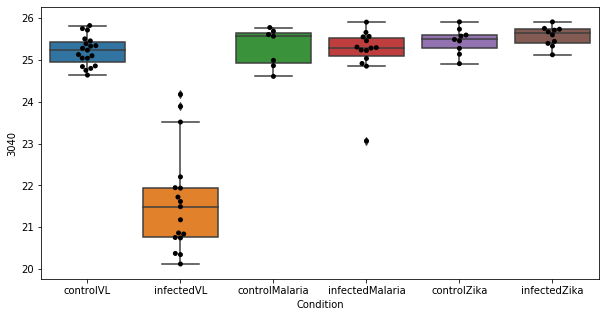

338 row m/z                                                         146.081
row retention time                                               10.355
p-val                                                          0.685444
adj.P.Val                                                      0.999793
custom_id                                                           668
compound_names        6-Amino-2-oxohexanoate; 2-Oxo-6-aminocaproate$...
Name: 668, dtype: object


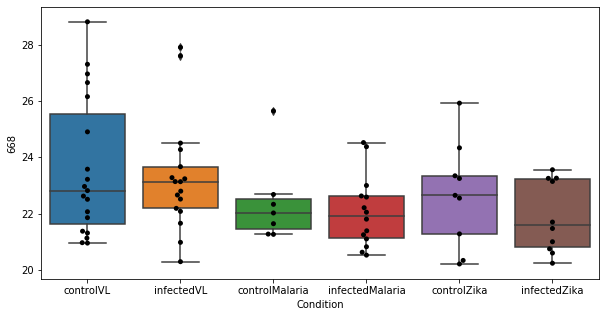

339 row m/z                                                         153.066
row retention time                                              6.75942
p-val                                                          0.687437
adj.P.Val                                                      0.999793
custom_id                                                           784
compound_names        N1-Methyl-2-pyridone-5-carboxamide; N'-Methyl-...
Name: 784, dtype: object


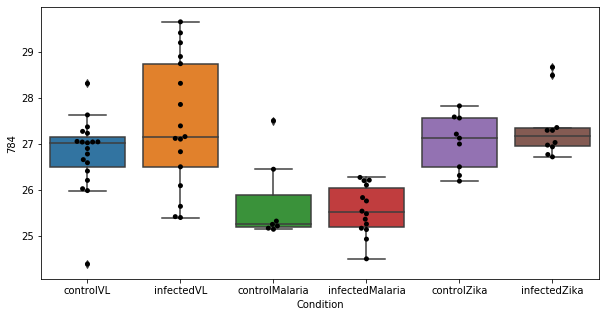

340 row m/z                                                         177.106
row retention time                                              12.4234
p-val                                                           0.68899
adj.P.Val                                                      0.999793
custom_id                                                          1134
compound_names        L-Citrulline; 2-Amino-5-ureidovaleric acid; Ci...
Name: 1134, dtype: object


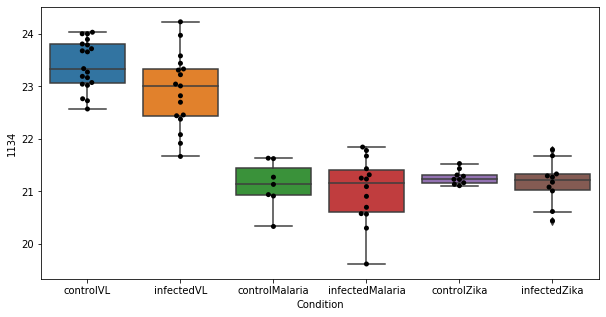

341 row m/z                                                         176.103
row retention time                                              12.4235
p-val                                                          0.690026
adj.P.Val                                                      0.999793
custom_id                                                          1122
compound_names        L-Citrulline; 2-Amino-5-ureidovaleric acid; Ci...
Name: 1122, dtype: object


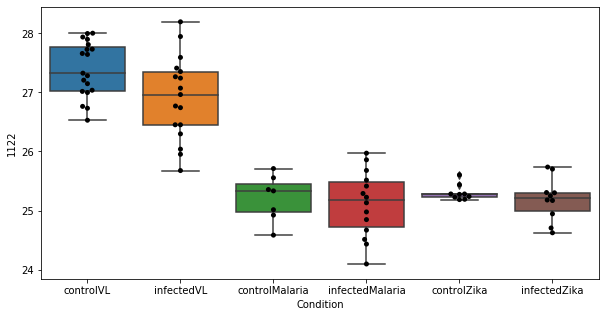

342 row m/z                                                         799.668
row retention time                                              3.29227
p-val                                                          0.691231
adj.P.Val                                                      0.999793
custom_id                                                          3052
compound_names        O-(4-Hydroxy-3,5-diidophenyl)-3,5-diiodo-L-tyr...
Name: 3052, dtype: object


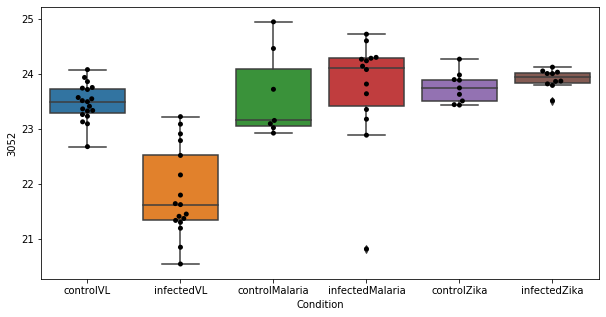

343 row m/z                                                         148.097
row retention time                                              6.83271
p-val                                                          0.691242
adj.P.Val                                                      0.999793
custom_id                                                           715
compound_names        N4-Acetylaminobutanal$L-Pipecolate; Pipecolini...
Name: 715, dtype: object


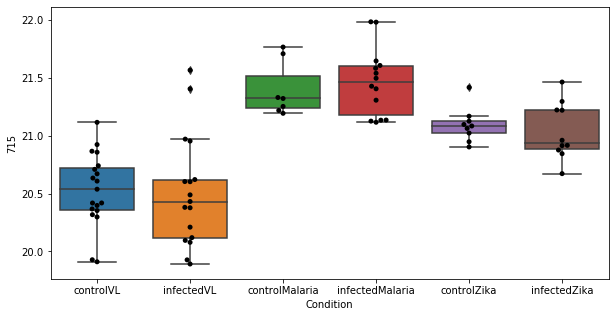

344 row m/z                                                         104.071
row retention time                                              10.2204
p-val                                                          0.692697
adj.P.Val                                                      0.999793
custom_id                                                           138
compound_names        N,N-Dimethylglycine; Dimethylglycine$(R)-3-Ami...
Name: 138, dtype: object


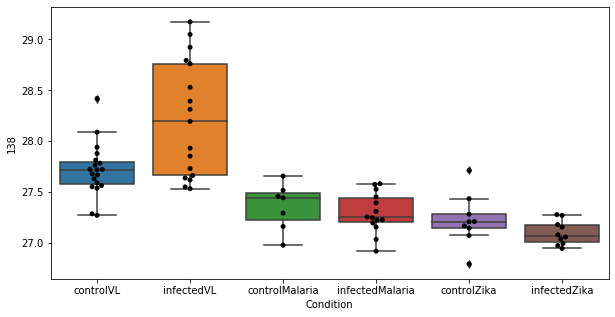

345 row m/z                                                         157.061
row retention time                                              9.81764
p-val                                                          0.696669
adj.P.Val                                                      0.999793
custom_id                                                           839
compound_names        4-Imidazolone-5-propanoate; 4-Imidazolone-5-pr...
Name: 839, dtype: object


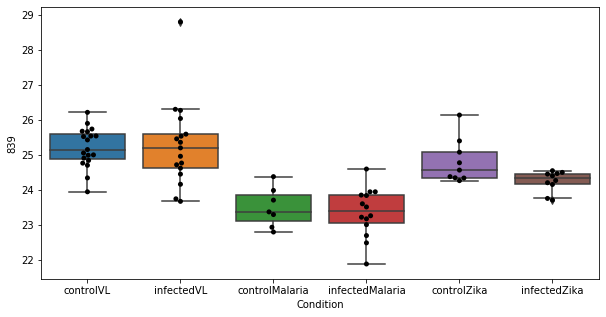

346 row m/z                                                          113.06
row retention time                                              3.46487
p-val                                                          0.696971
adj.P.Val                                                      0.999793
custom_id                                                           217
compound_names        Adipate semialdehyde; Hexan-1-one-6-carboxylat...
Name: 217, dtype: object


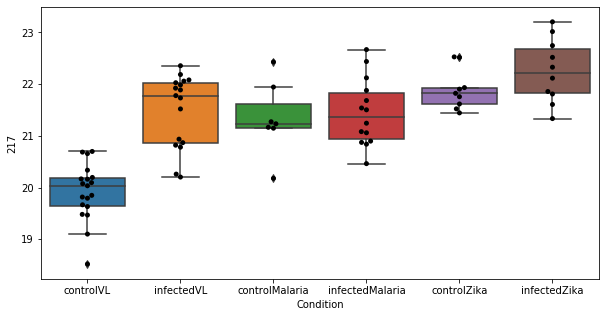

347 row m/z                                                         129.066
row retention time                                              10.9378
p-val                                                          0.697157
adj.P.Val                                                      0.999793
custom_id                                                          4517
compound_names        5,6-Dihydrothymine; Dihydrothymine; 5,6-Dihydr...
Name: 4517, dtype: object


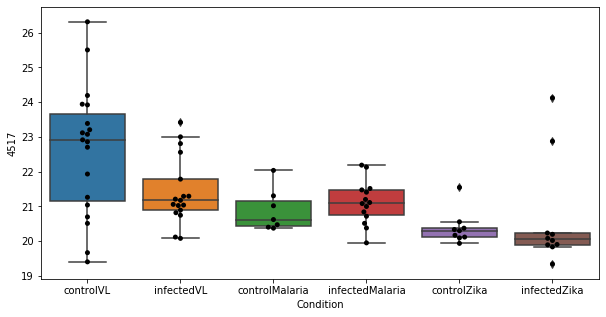

348 row m/z                170.062
row retention time     11.9025
p-val                 0.697651
adj.P.Val             0.999793
custom_id                 1029
compound_names             NaN
Name: 1029, dtype: object


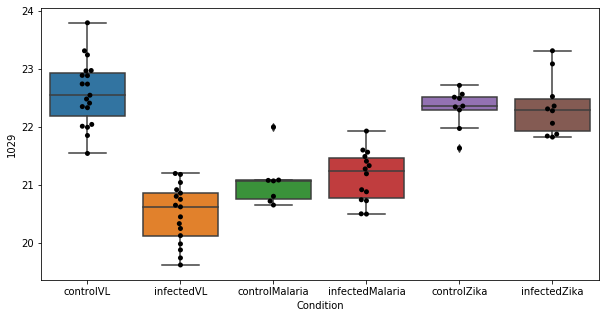

349 row m/z                                                         152.054
row retention time                                              9.80049
p-val                                                          0.701518
adj.P.Val                                                      0.999793
custom_id                                                           772
compound_names        L-Methionine; Methionine; L-2-Amino-4methylthi...
Name: 772, dtype: object


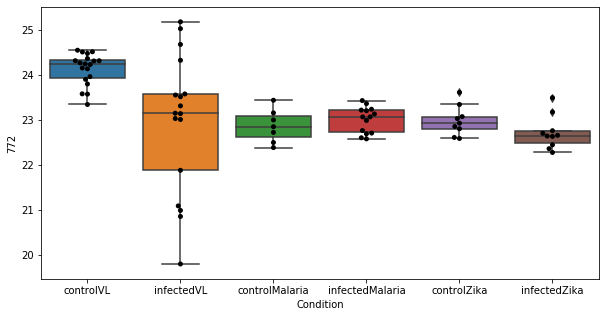

350 row m/z                176.066
row retention time     9.28789
p-val                 0.703608
adj.P.Val             0.999793
custom_id                 1117
compound_names             NaN
Name: 1117, dtype: object


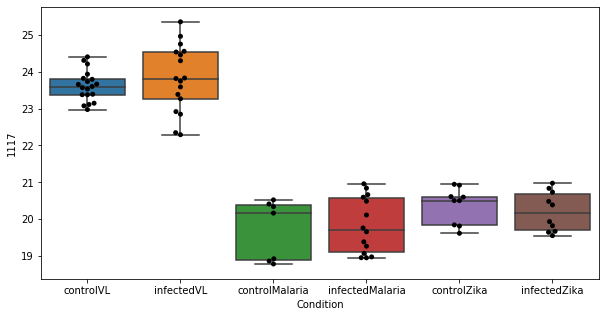

351 row m/z                                                         154.059
row retention time                                              11.7134
p-val                                                          0.704888
adj.P.Val                                                      0.999793
custom_id                                                           792
compound_names        Creatine; alpha-Methylguanidino acetic acid; M...
Name: 792, dtype: object


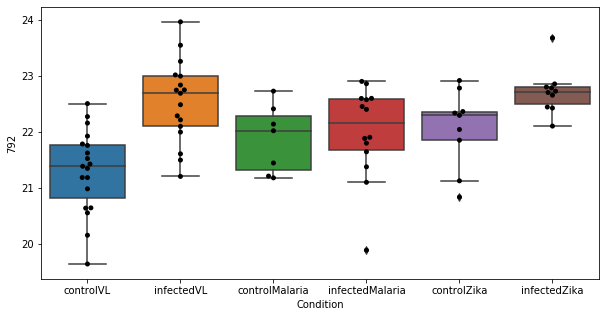

352 row m/z                            107.07
row retention time                3.80811
p-val                            0.705454
adj.P.Val                        0.999793
custom_id                             182
compound_names        1-Methylpyrrolinium
Name: 182, dtype: object


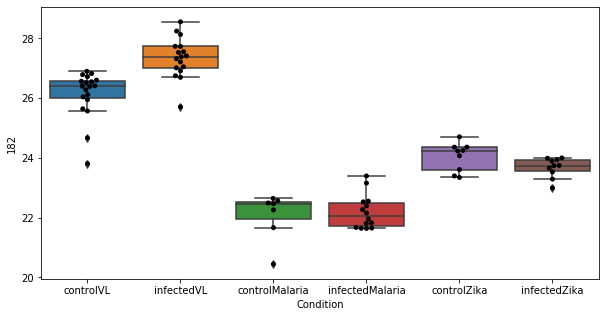

353 row m/z                                 151.062
row retention time                      9.79946
p-val                                  0.706765
adj.P.Val                              0.999793
custom_id                                   760
compound_names        aminochrome o-semiquinone
Name: 760, dtype: object


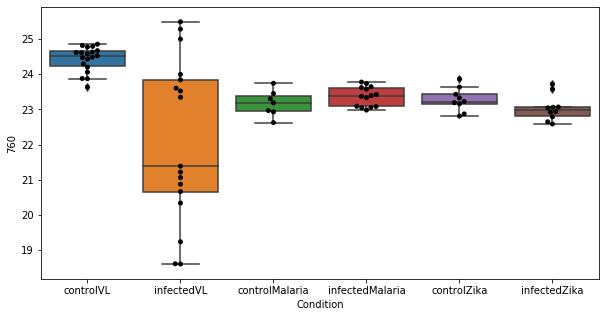

354 row m/z                194.147
row retention time      4.1319
p-val                 0.706808
adj.P.Val             0.999793
custom_id                 1355
compound_names             NaN
Name: 1355, dtype: object


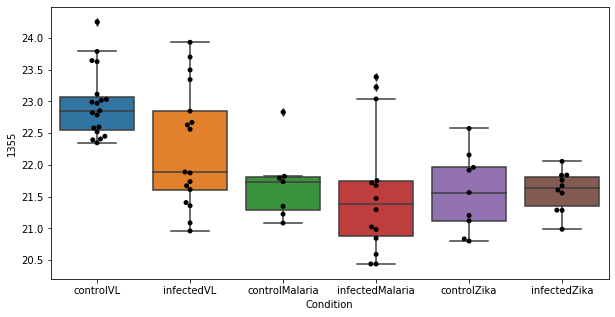

355 row m/z                                                         184.097
row retention time                                              6.71111
p-val                                                          0.709295
adj.P.Val                                                      0.999793
custom_id                                                          1205
compound_names        L-Phenylalanine; (S)-alpha-Amino-beta-phenylpr...
Name: 1205, dtype: object


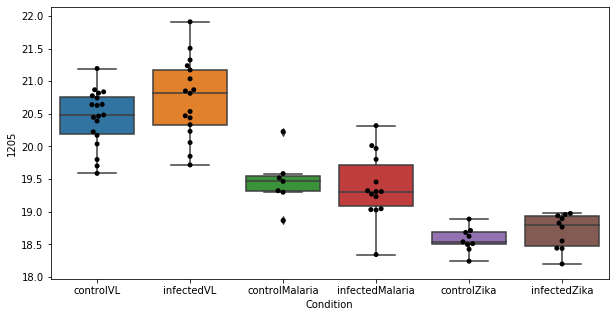

356 row m/z                117.091
row retention time     4.12309
p-val                 0.709673
adj.P.Val             0.999793
custom_id                  267
compound_names             NaN
Name: 267, dtype: object


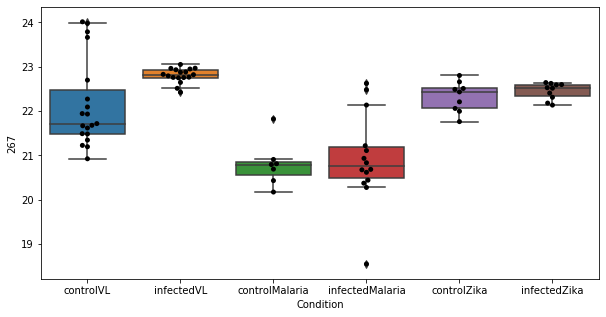

357 row m/z                140.011
row retention time     3.36234
p-val                 0.709714
adj.P.Val             0.999793
custom_id                  563
compound_names             NaN
Name: 563, dtype: object


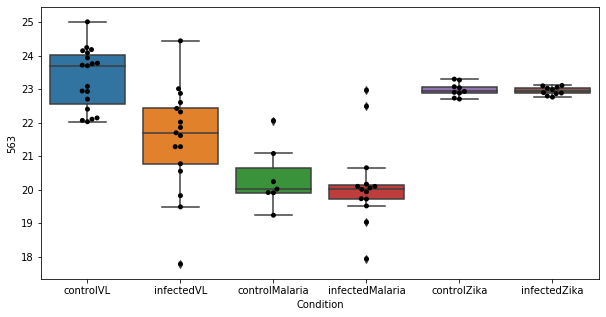

358 row m/z                205.144
row retention time     3.48202
p-val                 0.714379
adj.P.Val             0.999793
custom_id                 1504
compound_names             NaN
Name: 1504, dtype: object


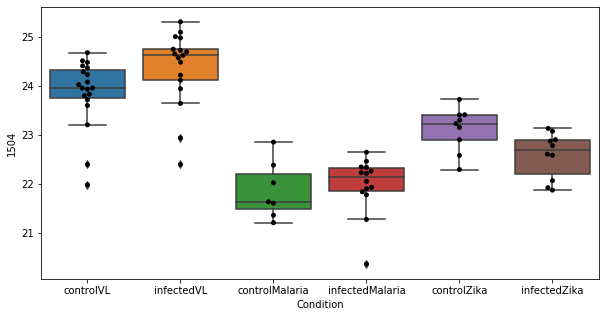

359 row m/z                236.113
row retention time     3.48747
p-val                  0.71476
adj.P.Val             0.999793
custom_id                 1875
compound_names             NaN
Name: 1875, dtype: object


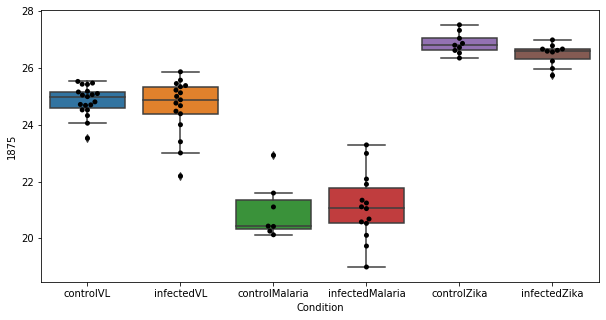

360 row m/z                           218.139
row retention time                8.41637
p-val                            0.716462
adj.P.Val                        0.999793
custom_id                            1661
compound_names        propionyl-carnitine
Name: 1661, dtype: object


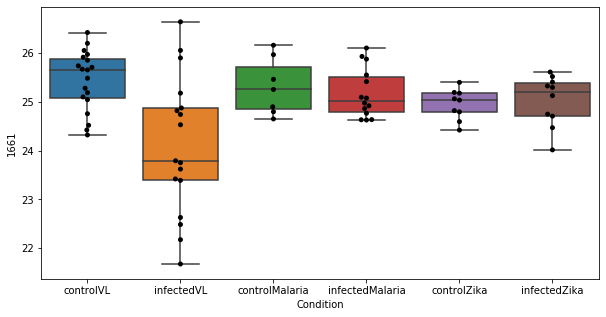

361 row m/z                                                         104.107
row retention time                                              6.57923
p-val                                                          0.718026
adj.P.Val                                                      0.999793
custom_id                                                           143
compound_names        L-Isoleucine; 2-Amino-3-methylvaleric acid$L-L...
Name: 143, dtype: object


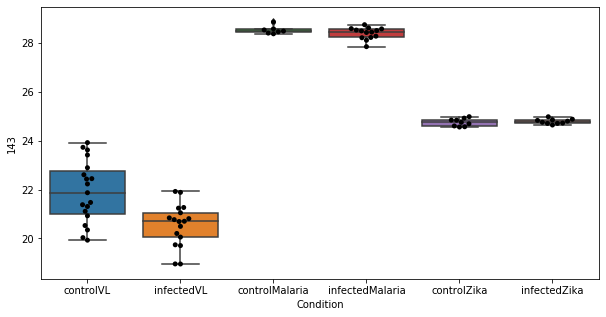

362 row m/z                106.086
row retention time     9.50445
p-val                 0.718125
adj.P.Val             0.999793
custom_id                  175
compound_names             NaN
Name: 175, dtype: object


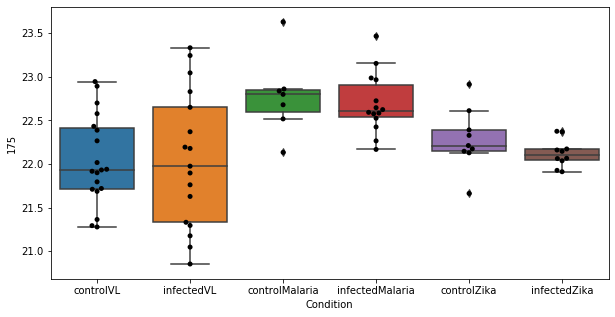

363 row m/z                                                         297.242
row retention time                                              3.21416
p-val                                                          0.718979
adj.P.Val                                                      0.999793
custom_id                                                          2360
compound_names        13(S)-HODE; (13S)-Hydroxyoctadecadienoic acid;...
Name: 2360, dtype: object


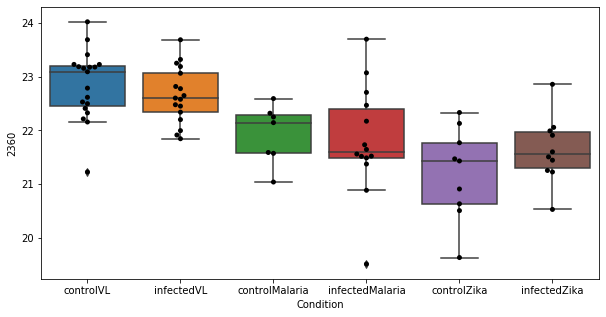

364 row m/z                 301.99
row retention time     10.4033
p-val                 0.719456
adj.P.Val             0.999793
custom_id                 2381
compound_names             NaN
Name: 2381, dtype: object


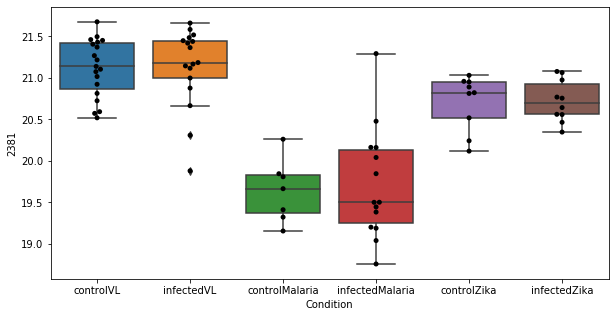

365 row m/z                744.553
row retention time       3.195
p-val                 0.722029
adj.P.Val             0.999793
custom_id                 2954
compound_names             NaN
Name: 2954, dtype: object


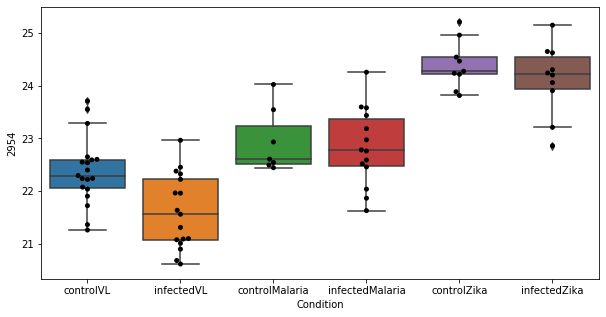

366 row m/z                787.604
row retention time     3.18287
p-val                 0.725478
adj.P.Val             0.999793
custom_id                 3024
compound_names             NaN
Name: 3024, dtype: object


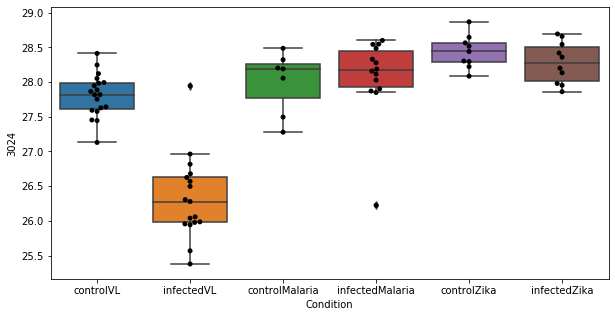

367 row m/z                                                         182.081
row retention time                                              10.8253
p-val                                                           0.72703
adj.P.Val                                                      0.999793
custom_id                                                          1179
compound_names        L-Tyrosine; (S)-3-(p-Hydroxyphenyl)alanine; (S...
Name: 1179, dtype: object


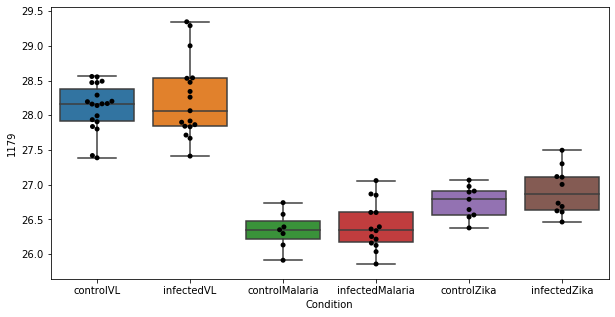

368 row m/z                757.621
row retention time     3.37542
p-val                 0.727416
adj.P.Val             0.999793
custom_id                 2969
compound_names             NaN
Name: 2969, dtype: object


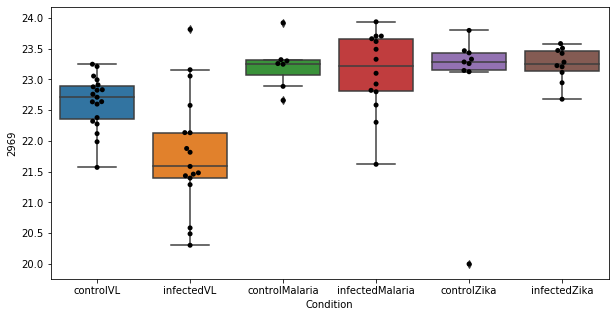

369 row m/z                703.574
row retention time     3.41257
p-val                  0.72748
adj.P.Val             0.999793
custom_id                 2918
compound_names             NaN
Name: 2918, dtype: object


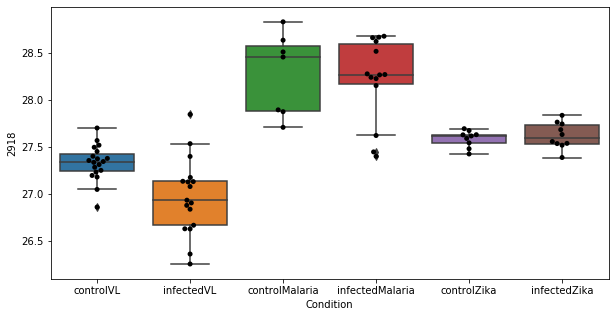

370 row m/z                 202.18
row retention time     6.86563
p-val                 0.728232
adj.P.Val             0.999793
custom_id                 1452
compound_names             NaN
Name: 1452, dtype: object


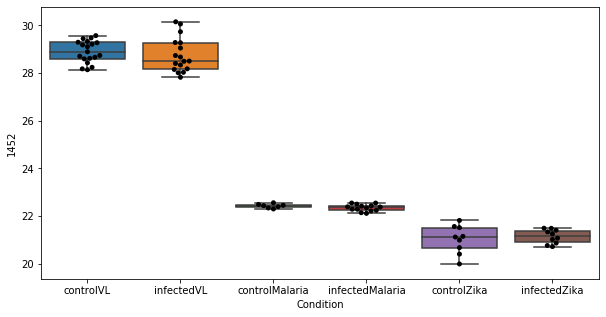

371 row m/z                                                         165.055
row retention time                                              10.8288
p-val                                                          0.732831
adj.P.Val                                                      0.999793
custom_id                                                           960
compound_names        3-Methoxy-4-hydroxyphenylglycolaldehyde$Homova...
Name: 960, dtype: object


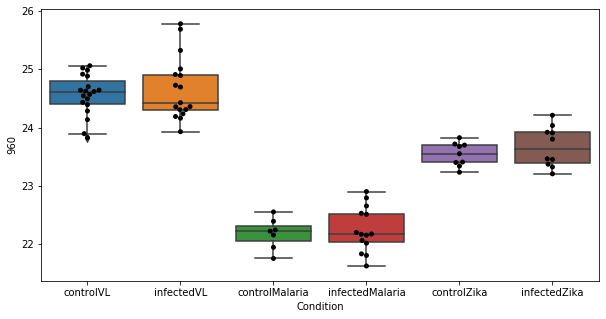

372 row m/z                344.228
row retention time      4.1966
p-val                  0.73546
adj.P.Val             0.999793
custom_id                 2548
compound_names             NaN
Name: 2548, dtype: object


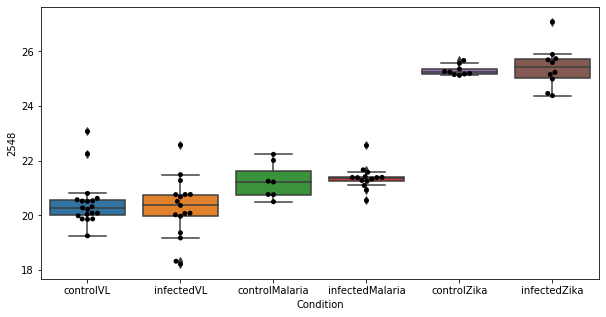

373 row m/z                257.113
row retention time     8.04659
p-val                 0.736438
adj.P.Val             0.999793
custom_id                 2068
compound_names             NaN
Name: 2068, dtype: object


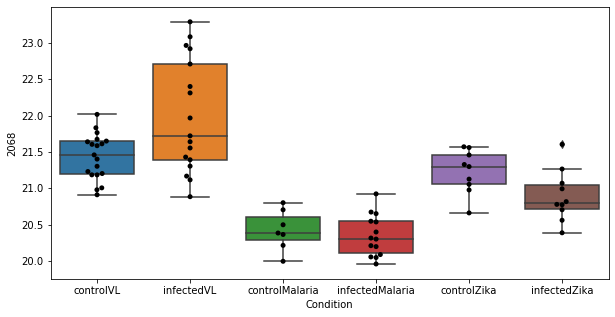

374 row m/z                148.097
row retention time     10.9468
p-val                  0.73831
adj.P.Val             0.999793
custom_id                  719
compound_names             NaN
Name: 719, dtype: object


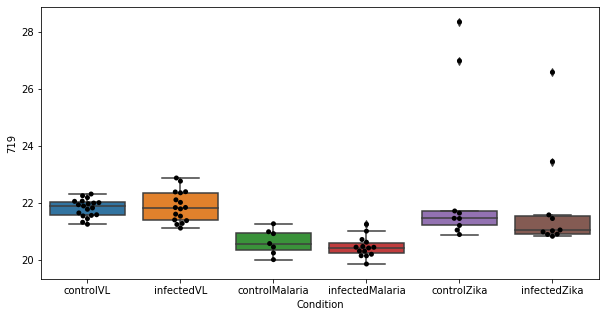

375 row m/z                                                         118.061
row retention time                                              12.5314
p-val                                                          0.738928
adj.P.Val                                                      0.999793
custom_id                                                           273
compound_names        Guanidinoacetate$Guanidinoacetate; Guanidinoac...
Name: 273, dtype: object


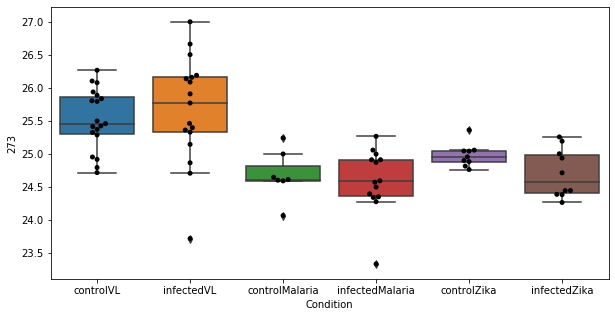

376 row m/z                745.593
row retention time     3.19691
p-val                 0.741292
adj.P.Val             0.999793
custom_id                 2957
compound_names             NaN
Name: 2957, dtype: object


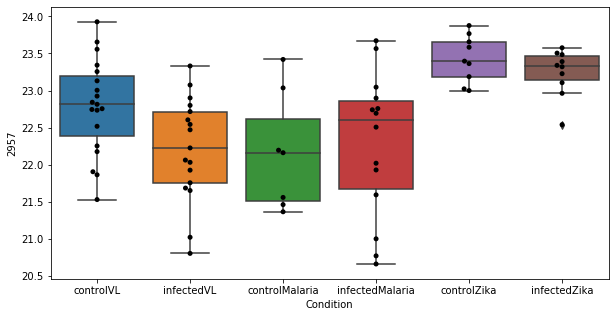

377 row m/z                256.175
row retention time     4.38253
p-val                 0.741826
adj.P.Val             0.999793
custom_id                 2057
compound_names             NaN
Name: 2057, dtype: object


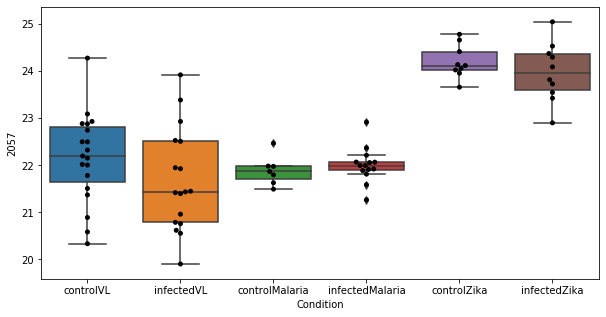

378 row m/z                                138.043
row retention time                      9.0432
p-val                                 0.742482
adj.P.Val                             0.999793
custom_id                                  547
compound_names        Urocanate; Urocanic acid
Name: 547, dtype: object


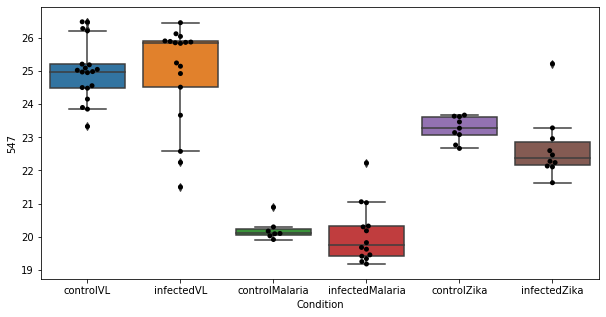

379 row m/z                236.073
row retention time     11.8556
p-val                 0.744731
adj.P.Val             0.999793
custom_id                 1869
compound_names             NaN
Name: 1869, dtype: object


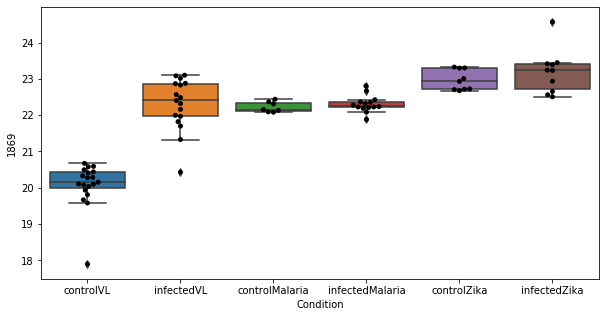

380 row m/z                105.074
row retention time       11.15
p-val                 0.747322
adj.P.Val             0.999793
custom_id                  154
compound_names             NaN
Name: 154, dtype: object


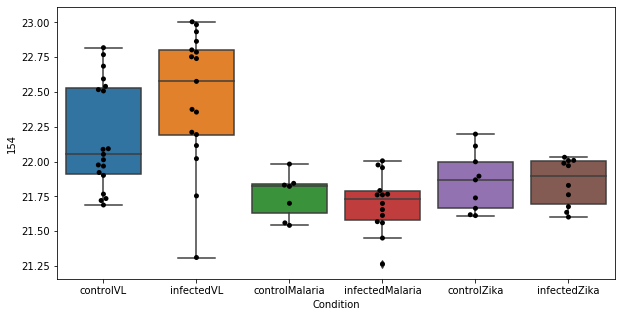

381 row m/z                702.562
row retention time     3.43509
p-val                 0.747425
adj.P.Val             0.999793
custom_id                 2917
compound_names             NaN
Name: 2917, dtype: object


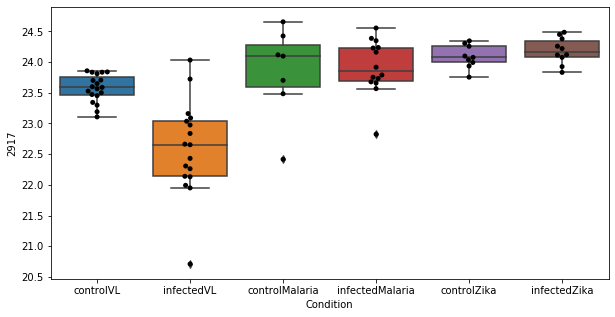

382 row m/z                221.154
row retention time      3.4093
p-val                 0.749075
adj.P.Val             0.999793
custom_id                 1702
compound_names             NaN
Name: 1702, dtype: object


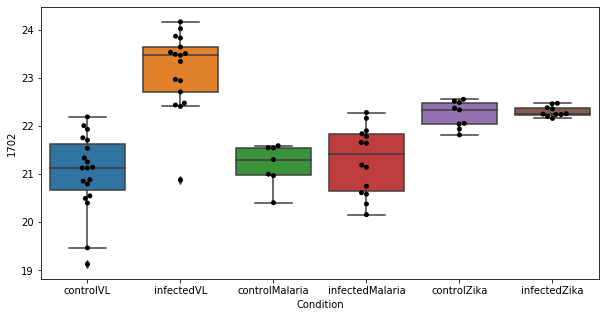

383 row m/z                  149.1
row retention time     10.1924
p-val                 0.751876
adj.P.Val             0.999793
custom_id                 4631
compound_names             NaN
Name: 4631, dtype: object


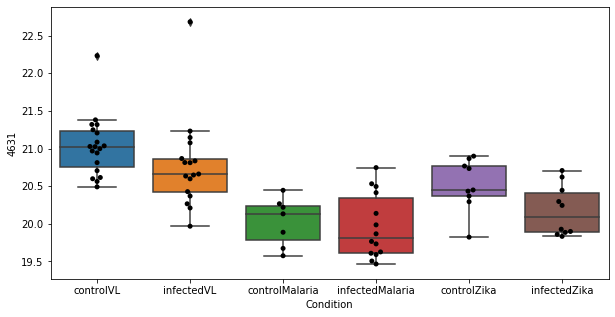

384 row m/z                732.554
row retention time     3.24734
p-val                 0.754368
adj.P.Val             0.999793
custom_id                 2938
compound_names             NaN
Name: 2938, dtype: object


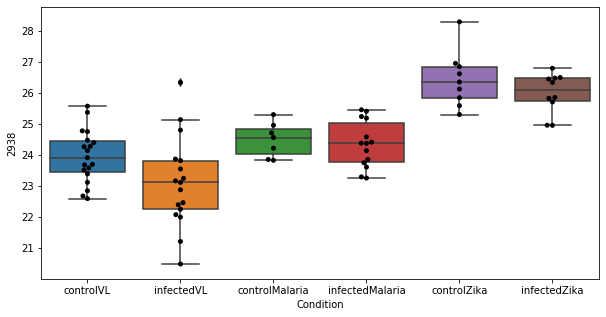

385 row m/z                304.248
row retention time     3.33835
p-val                 0.755043
adj.P.Val             0.999793
custom_id                 2398
compound_names             NaN
Name: 2398, dtype: object


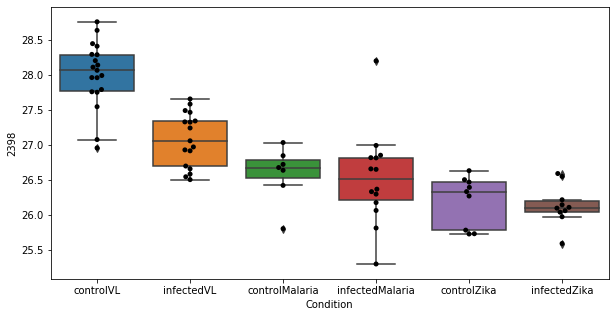

386 row m/z                198.087
row retention time     9.10321
p-val                 0.756876
adj.P.Val             0.999793
custom_id                 1394
compound_names             NaN
Name: 1394, dtype: object


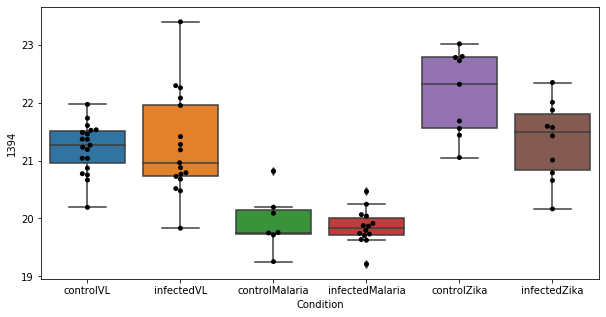

387 row m/z                172.097
row retention time     6.71038
p-val                 0.757968
adj.P.Val             0.999793
custom_id                 1062
compound_names             NaN
Name: 1062, dtype: object


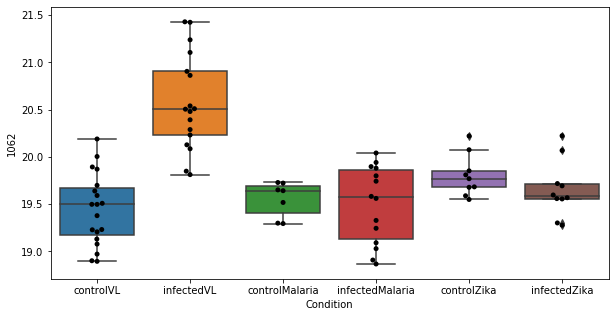

388 row m/z                761.588
row retention time     3.20233
p-val                 0.758087
adj.P.Val             0.999793
custom_id                 2976
compound_names             NaN
Name: 2976, dtype: object


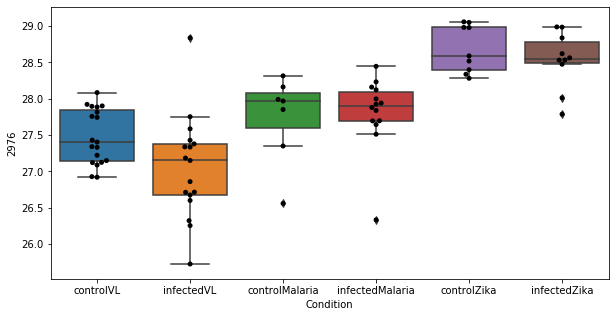

389 row m/z                228.123
row retention time     4.38993
p-val                 0.759708
adj.P.Val             0.999793
custom_id                 1770
compound_names             NaN
Name: 1770, dtype: object


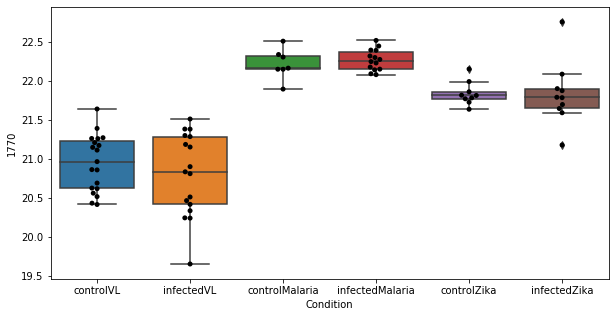

390 row m/z                204.123
row retention time     4.37371
p-val                 0.760585
adj.P.Val             0.999793
custom_id                 1486
compound_names             NaN
Name: 1486, dtype: object


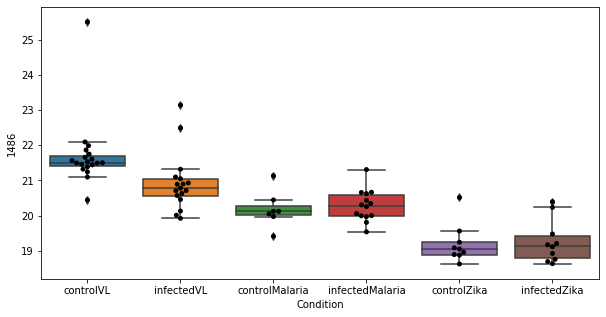

391 row m/z                                                         170.092
row retention time                                              10.5479
p-val                                                          0.761024
adj.P.Val                                                      0.999793
custom_id                                                         10774
compound_names        N(pi)-Methyl-L-histidine; 1-Methylhistidine; N...
Name: 10774, dtype: object


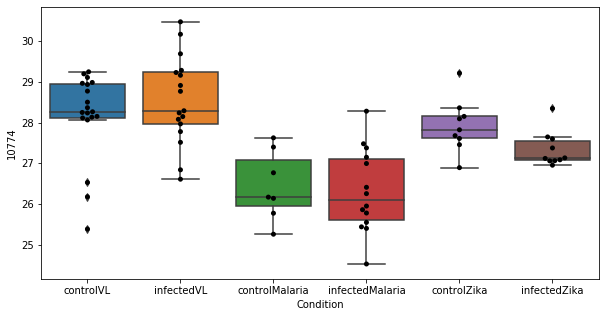

392 row m/z                                                         118.086
row retention time                                              10.4061
p-val                                                          0.761988
adj.P.Val                                                      0.999793
custom_id                                                           280
compound_names        6-Amino-2-oxohexanoate; 2-Oxo-6-aminocaproate$...
Name: 280, dtype: object


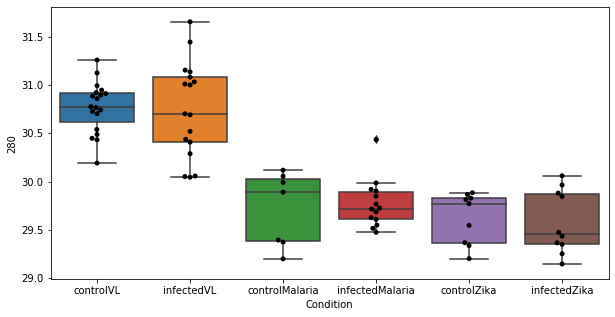

393 row m/z                316.248
row retention time     4.31512
p-val                 0.762581
adj.P.Val             0.999793
custom_id                 2464
compound_names             NaN
Name: 2464, dtype: object


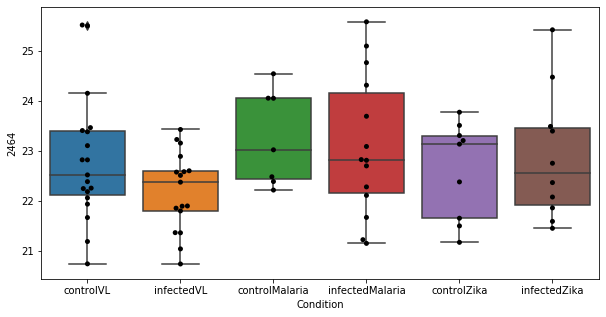

394 row m/z                199.097
row retention time     4.36912
p-val                 0.765043
adj.P.Val             0.999793
custom_id                 1409
compound_names             NaN
Name: 1409, dtype: object


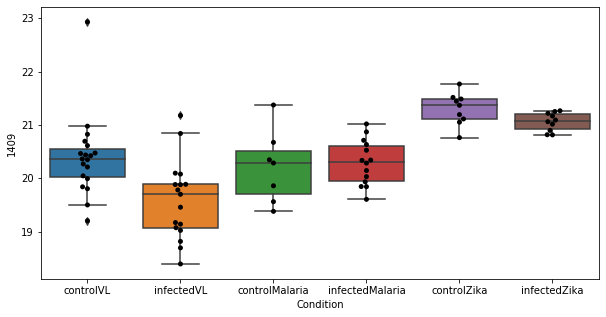

395 row m/z                177.055
row retention time     3.47783
p-val                 0.765241
adj.P.Val             0.999793
custom_id                 1125
compound_names             NaN
Name: 1125, dtype: object


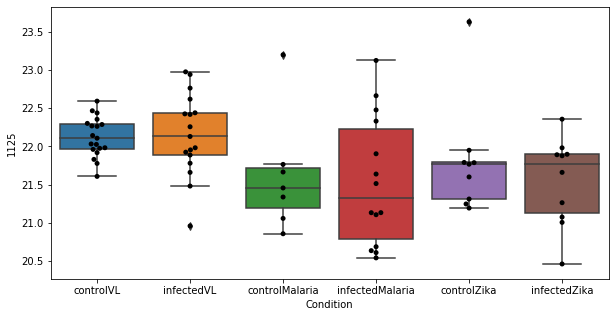

396 row m/z                780.553
row retention time     3.22229
p-val                 0.766755
adj.P.Val             0.999793
custom_id                 3004
compound_names             NaN
Name: 3004, dtype: object


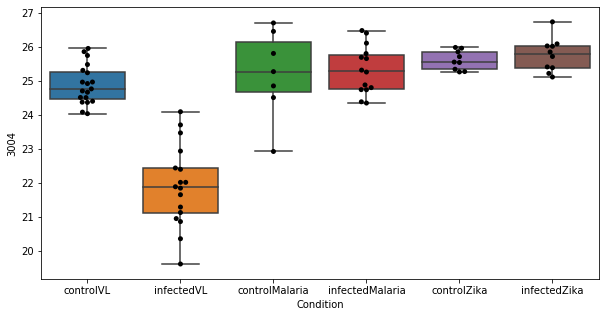

397 row m/z                                                         151.062
row retention time                                              7.64547
p-val                                                          0.767704
adj.P.Val                                                      0.999793
custom_id                                                           761
compound_names        L-Xylulose; L-threo-Pentulose; L-Lyxulose$D-Xy...
Name: 761, dtype: object


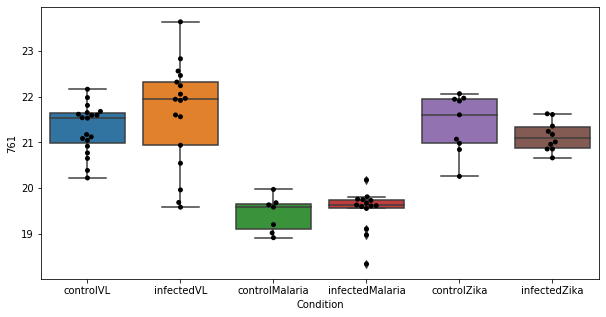

398 row m/z                300.201
row retention time     4.30861
p-val                 0.768704
adj.P.Val             0.999793
custom_id                 2369
compound_names             NaN
Name: 2369, dtype: object


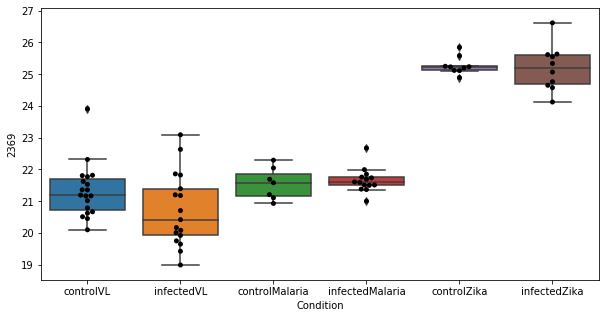

399 row m/z                 172.08
row retention time     11.8965
p-val                 0.769324
adj.P.Val             0.999793
custom_id                 1060
compound_names             NaN
Name: 1060, dtype: object


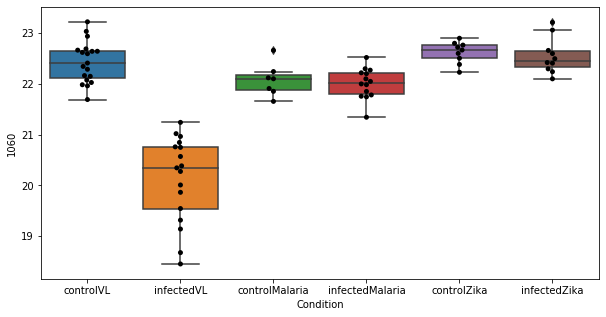

400 row m/z                           288.217
row retention time                6.71058
p-val                             0.76973
adj.P.Val                        0.999793
custom_id                            2309
compound_names        L-Octanoylcarnitine
Name: 2309, dtype: object


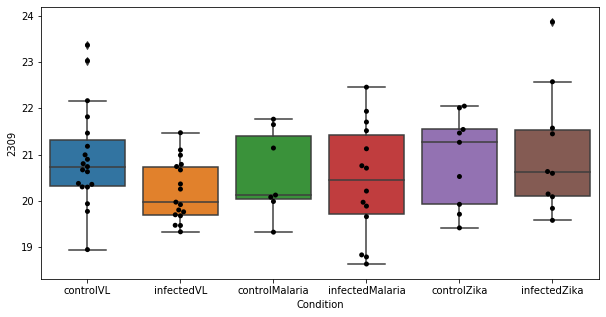

401 row m/z                232.154
row retention time     7.60698
p-val                 0.770165
adj.P.Val             0.999793
custom_id                 1825
compound_names             NaN
Name: 1825, dtype: object


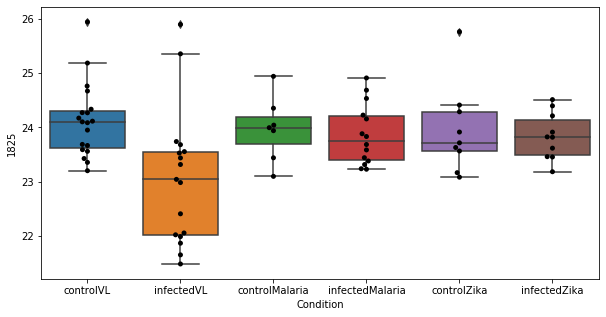

402 row m/z                200.173
row retention time     3.36251
p-val                 0.770207
adj.P.Val             0.999793
custom_id                 1424
compound_names             NaN
Name: 1424, dtype: object


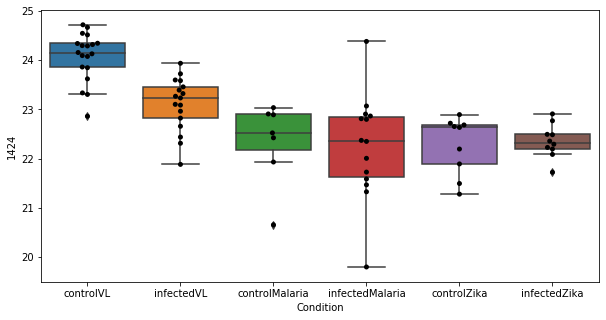

403 row m/z                268.175
row retention time     3.38427
p-val                 0.770877
adj.P.Val             0.999793
custom_id                 2156
compound_names             NaN
Name: 2156, dtype: object


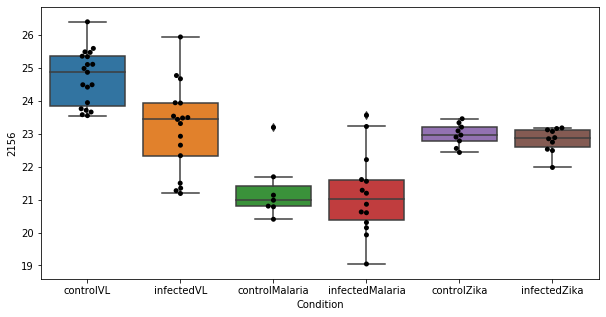

404 row m/z                                                         133.061
row retention time                                              12.1002
p-val                                                          0.772427
adj.P.Val                                                      0.999793
custom_id                                                           472
compound_names        3-Ureidopropionate; 3-Ureidopropanoate; beta-U...
Name: 472, dtype: object


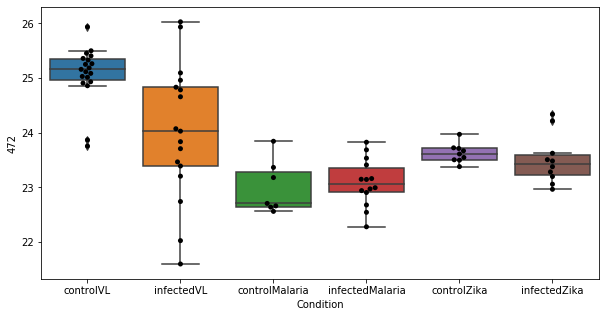

405 row m/z                212.095
row retention time     4.63104
p-val                 0.772598
adj.P.Val             0.999793
custom_id                 3780
compound_names             NaN
Name: 3780, dtype: object


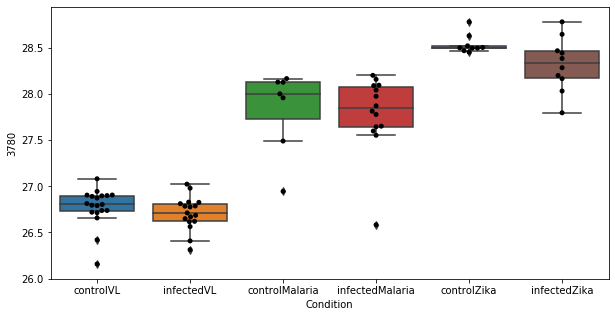

406 row m/z                144.102
row retention time     10.8185
p-val                 0.772603
adj.P.Val             0.999793
custom_id                  633
compound_names             NaN
Name: 633, dtype: object


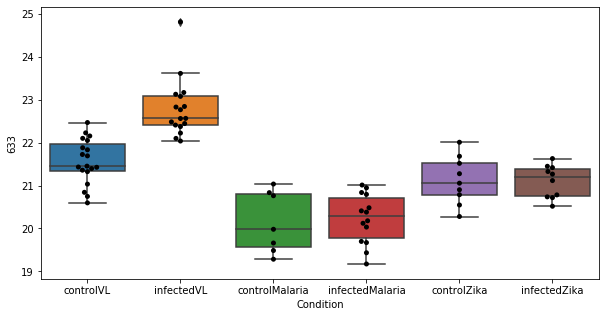

407 row m/z                  786.6
row retention time     3.18718
p-val                 0.773352
adj.P.Val             0.999793
custom_id                 3020
compound_names             NaN
Name: 3020, dtype: object


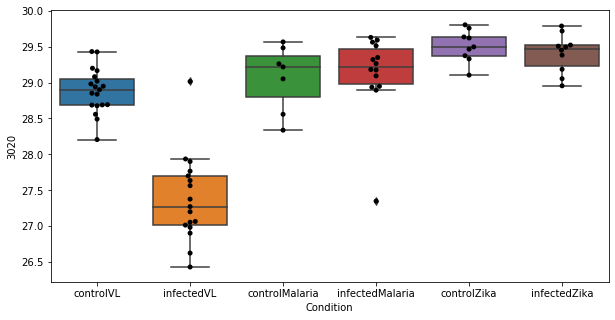

408 row m/z                                                129.102
row retention time                                     10.8821
p-val                                                  0.77393
adj.P.Val                                             0.999793
custom_id                                                 3342
compound_names        N-Acetylornithine; N2-Acetyl-L-ornithine
Name: 3342, dtype: object


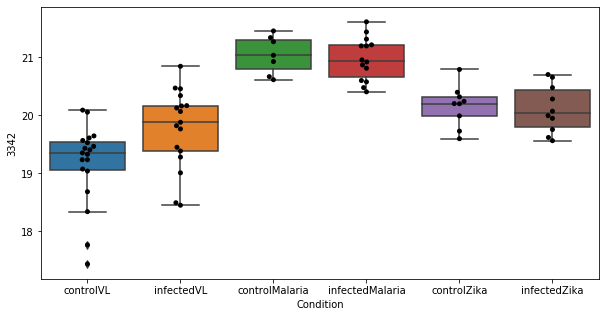

409 row m/z                248.149
row retention time     9.47753
p-val                 0.774109
adj.P.Val             0.999793
custom_id                 1985
compound_names             NaN
Name: 1985, dtype: object


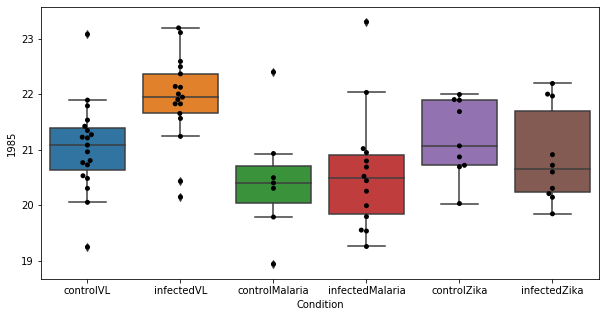

410 row m/z                267.172
row retention time     3.36788
p-val                 0.778126
adj.P.Val             0.999793
custom_id                 2151
compound_names             NaN
Name: 2151, dtype: object


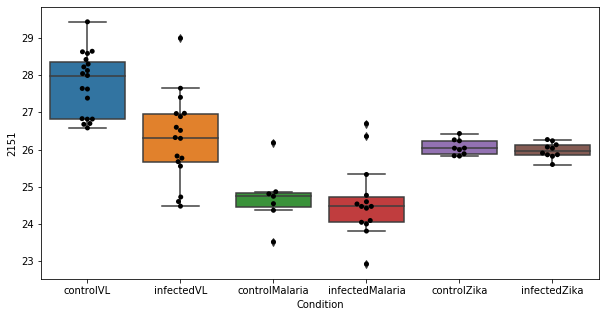

411 row m/z                199.169
row retention time     3.35541
p-val                 0.778446
adj.P.Val             0.999793
custom_id                 1412
compound_names             NaN
Name: 1412, dtype: object


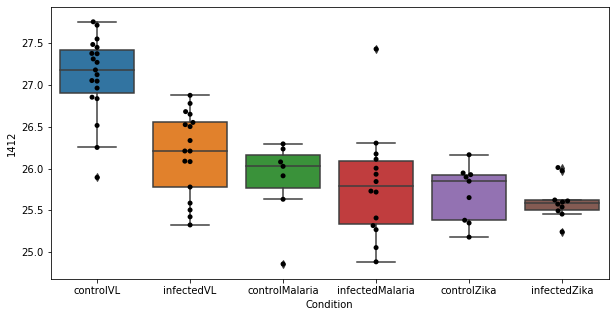

412 row m/z                                                         133.032
row retention time                                              9.80164
p-val                                                          0.781622
adj.P.Val                                                      0.999793
custom_id                                                           471
compound_names        L-Methionine; Methionine; L-2-Amino-4methylthi...
Name: 471, dtype: object


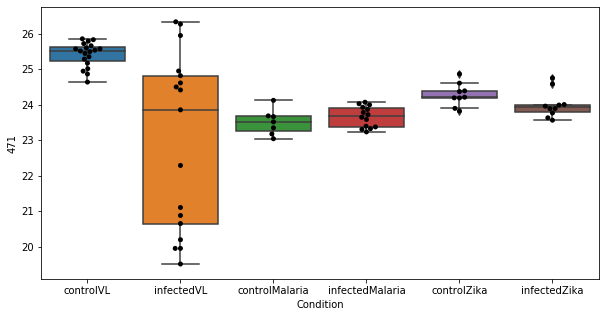

413 row m/z                127.073
row retention time     9.99674
p-val                 0.781626
adj.P.Val             0.999793
custom_id                  374
compound_names             NaN
Name: 374, dtype: object


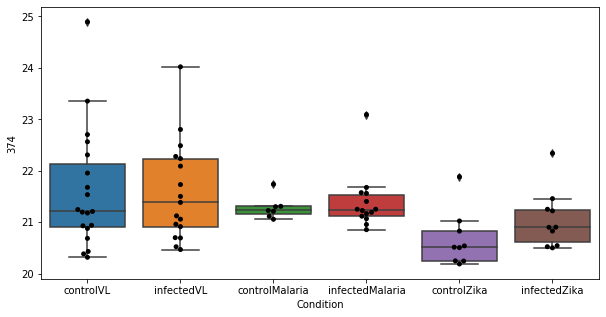

414 row m/z                614.535
row retention time      2.9848
p-val                 0.781828
adj.P.Val             0.999793
custom_id                 2873
compound_names             NaN
Name: 2873, dtype: object


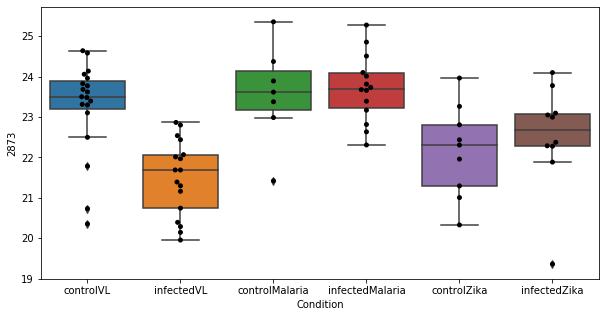

415 row m/z                682.486
row retention time     3.07538
p-val                 0.782055
adj.P.Val             0.999793
custom_id                 2909
compound_names             NaN
Name: 2909, dtype: object


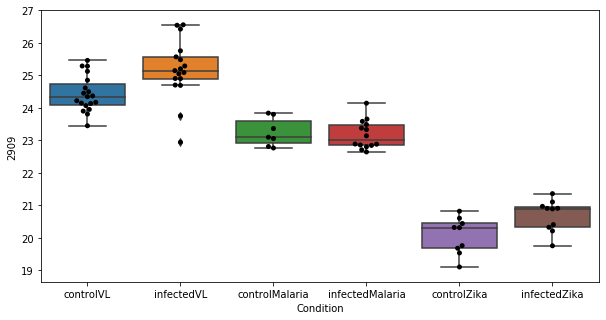

416 row m/z                            146.118
row retention time                 10.7265
p-val                             0.783786
adj.P.Val                         0.999793
custom_id                              674
compound_names        3-Dehydroxycarnitine
Name: 674, dtype: object


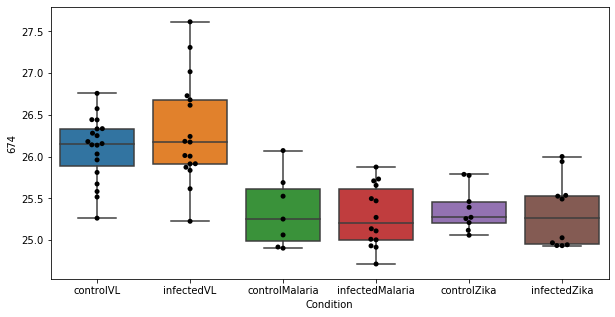

417 row m/z                                            180.066
row retention time                                 6.71078
p-val                                             0.784833
adj.P.Val                                         0.999793
custom_id                                             1159
compound_names        4-(2-Aminophenyl)-2,4-dioxobutanoate
Name: 1159, dtype: object


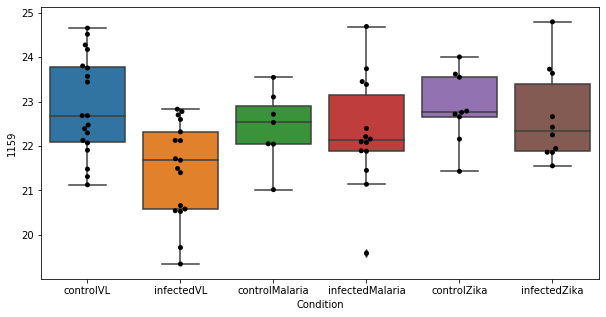

418 row m/z                284.331
row retention time     6.89412
p-val                 0.786986
adj.P.Val             0.999793
custom_id                 2280
compound_names             NaN
Name: 2280, dtype: object


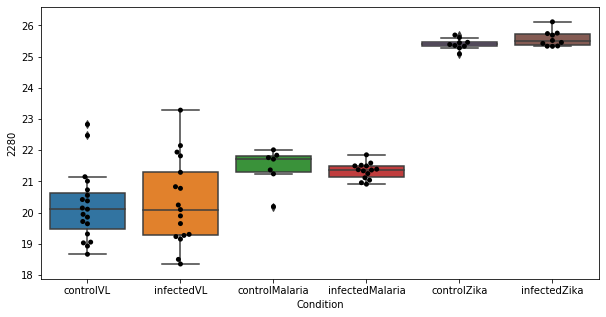

419 row m/z                114.098
row retention time     8.60432
p-val                 0.787618
adj.P.Val             0.999793
custom_id                  237
compound_names             NaN
Name: 237, dtype: object


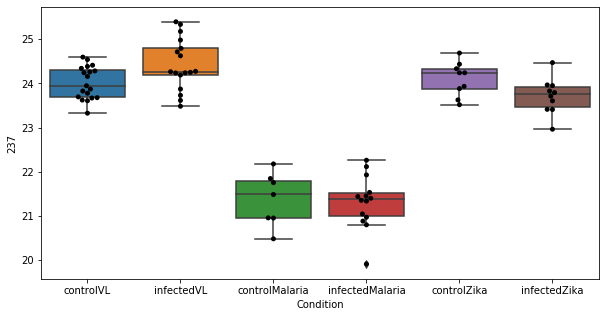

420 row m/z                236.073
row retention time     4.66101
p-val                 0.788082
adj.P.Val             0.999793
custom_id                 1871
compound_names             NaN
Name: 1871, dtype: object


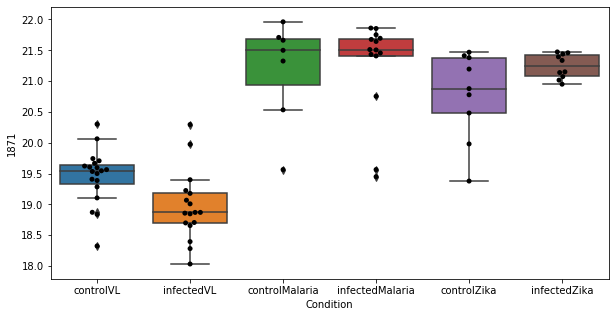

421 row m/z                249.185
row retention time     3.42338
p-val                 0.788806
adj.P.Val             0.999793
custom_id                 1989
compound_names             NaN
Name: 1989, dtype: object


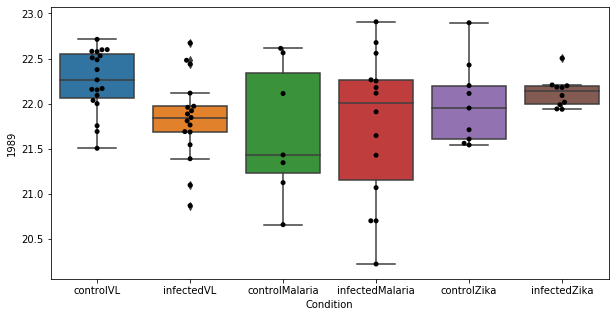

422 row m/z                279.159
row retention time      3.3597
p-val                 0.790346
adj.P.Val             0.999793
custom_id                 2230
compound_names             NaN
Name: 2230, dtype: object


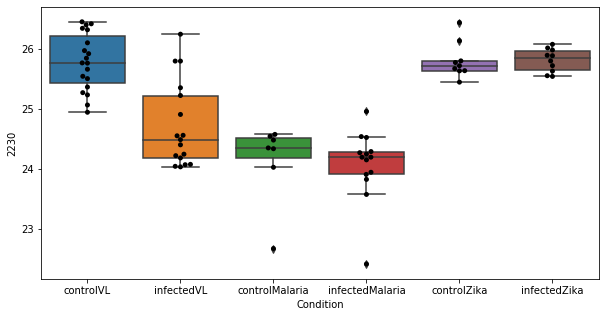

423 row m/z                157.086
row retention time     4.39371
p-val                 0.791497
adj.P.Val             0.999793
custom_id                  847
compound_names             NaN
Name: 847, dtype: object


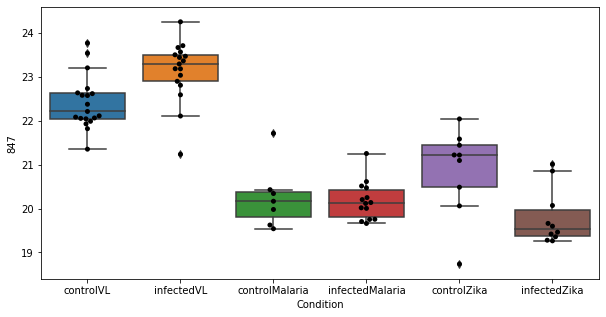

424 row m/z                760.584
row retention time     3.20659
p-val                 0.792419
adj.P.Val             0.999793
custom_id                 2975
compound_names             NaN
Name: 2975, dtype: object


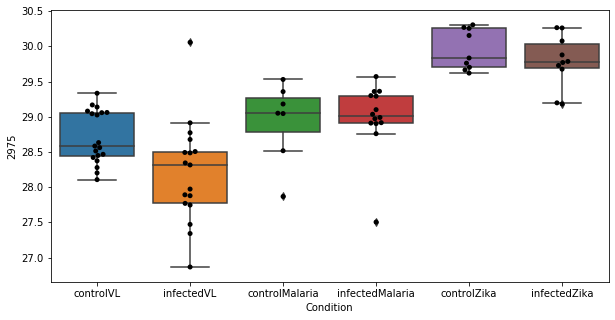

425 row m/z                234.134
row retention time     3.72693
p-val                 0.793241
adj.P.Val             0.999793
custom_id                 6920
compound_names             NaN
Name: 6920, dtype: object


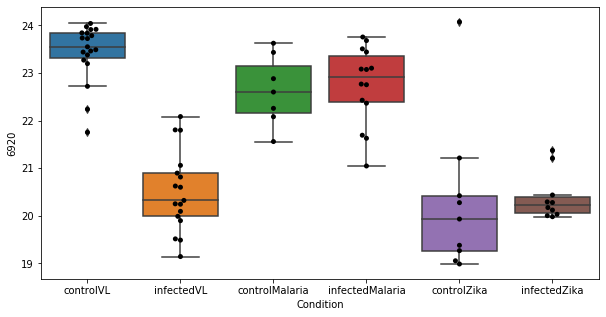

426 row m/z                134.081
row retention time     11.7055
p-val                 0.793853
adj.P.Val             0.999793
custom_id                  496
compound_names             NaN
Name: 496, dtype: object


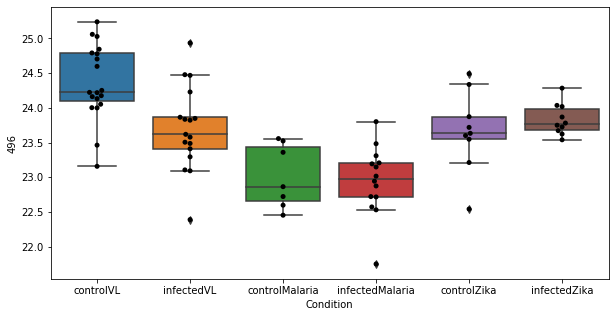

427 row m/z                                                         223.108
row retention time                                              10.8224
p-val                                                           0.79552
adj.P.Val                                                      0.999793
custom_id                                                          1720
compound_names        quinonoid dihydrobiopterin$O2'-4a-cyclic-tetra...
Name: 1720, dtype: object


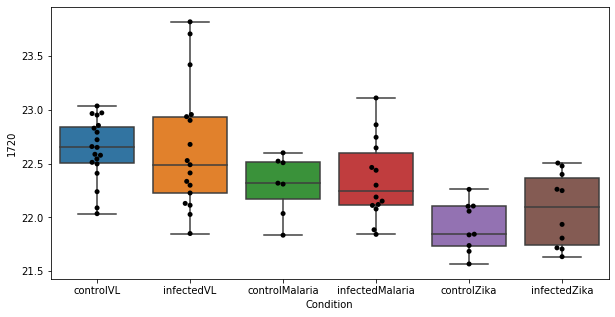

428 row m/z                119.083
row retention time     10.4069
p-val                 0.796709
adj.P.Val             0.999793
custom_id                  297
compound_names             NaN
Name: 297, dtype: object


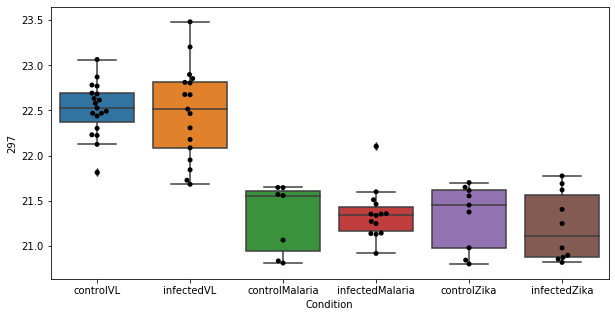

429 row m/z                              167.09
row retention time                  8.85715
p-val                               0.79676
adj.P.Val                          0.999793
custom_id                               995
compound_names        4-Guanidinobutanamide
Name: 995, dtype: object


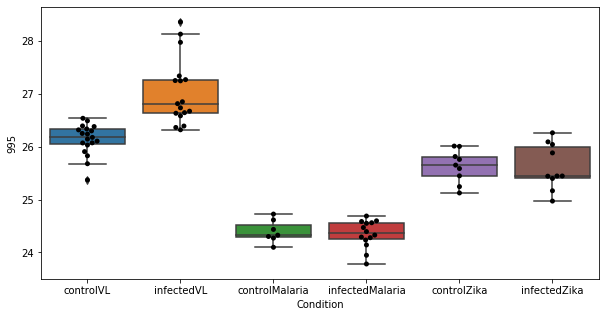

430 row m/z                                                         203.052
row retention time                                               12.051
p-val                                                          0.796885
adj.P.Val                                                      0.999793
custom_id                                                          1464
compound_names        D-Tagatose; lyxo-Hexulose$1,7-Dimethylxanthine...
Name: 1464, dtype: object


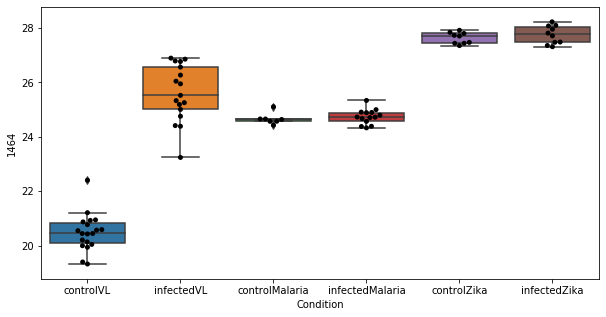

431 row m/z                228.123
row retention time     8.59395
p-val                 0.796894
adj.P.Val             0.999793
custom_id                 1771
compound_names             NaN
Name: 1771, dtype: object


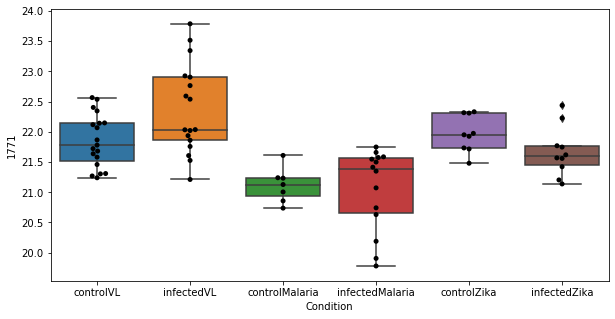

432 row m/z                                                         136.076
row retention time                                              10.8269
p-val                                                          0.797788
adj.P.Val                                                      0.999793
custom_id                                                           523
compound_names        L-Tyrosine; (S)-3-(p-Hydroxyphenyl)alanine; (S...
Name: 523, dtype: object


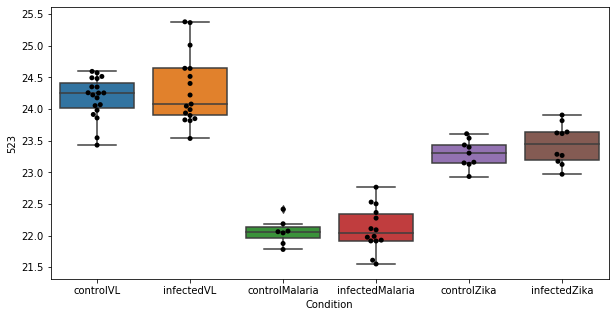

433 row m/z                814.687
row retention time     3.26715
p-val                  0.79816
adj.P.Val             0.999793
custom_id                 3087
compound_names             NaN
Name: 3087, dtype: object


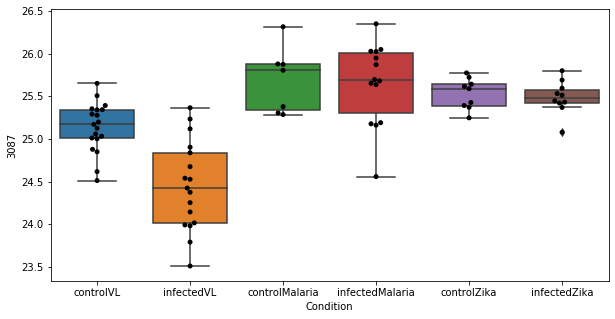

434 row m/z                                                         218.139
row retention time                                              6.70695
p-val                                                          0.798382
adj.P.Val                                                      0.999793
custom_id                                                          1664
compound_names        Ecgonine methyl ester; Methyl ecgonine$ecgonin...
Name: 1664, dtype: object


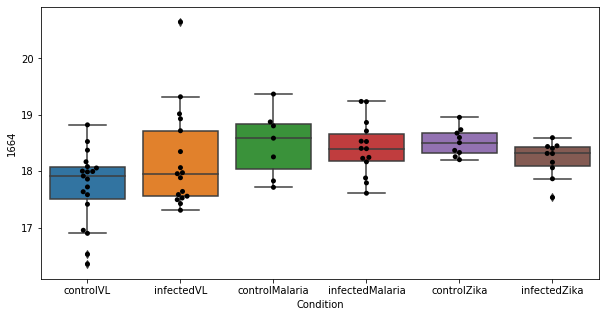

435 row m/z                317.269
row retention time     2.99278
p-val                 0.801556
adj.P.Val             0.999793
custom_id                 2470
compound_names             NaN
Name: 2470, dtype: object


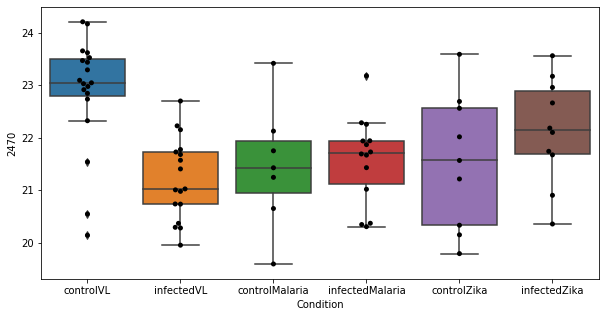

436 row m/z                704.578
row retention time     3.41484
p-val                 0.801943
adj.P.Val             0.999793
custom_id                 2919
compound_names             NaN
Name: 2919, dtype: object


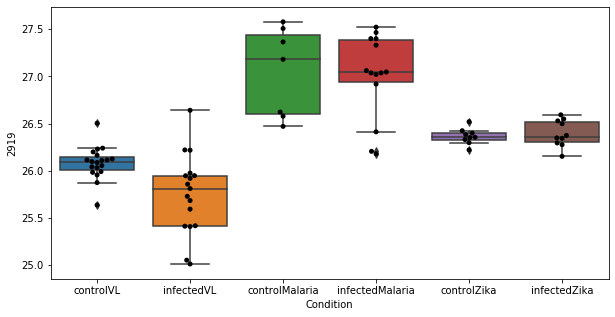

437 row m/z                 680.48
row retention time     3.07307
p-val                  0.80465
adj.P.Val             0.999793
custom_id                 2907
compound_names             NaN
Name: 2907, dtype: object


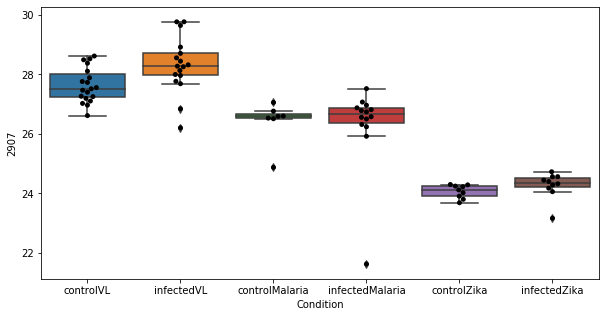

438 row m/z                                                          90.055
row retention time                                               11.795
p-val                                                          0.806409
adj.P.Val                                                      0.999793
custom_id                                                            84
compound_names        Sarcosine; N-Methylglycine$D-Alanine; D-2-Amin...
Name: 84, dtype: object


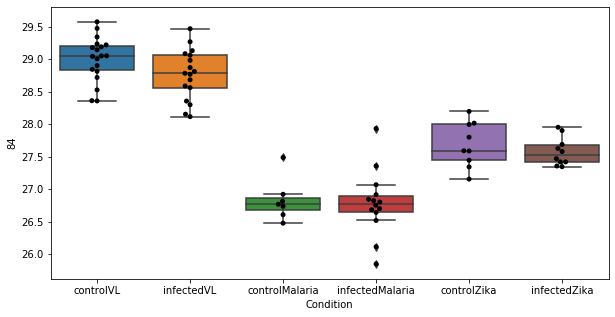

439 row m/z                795.609
row retention time     3.17042
p-val                 0.807266
adj.P.Val             0.999793
custom_id                 3043
compound_names             NaN
Name: 3043, dtype: object


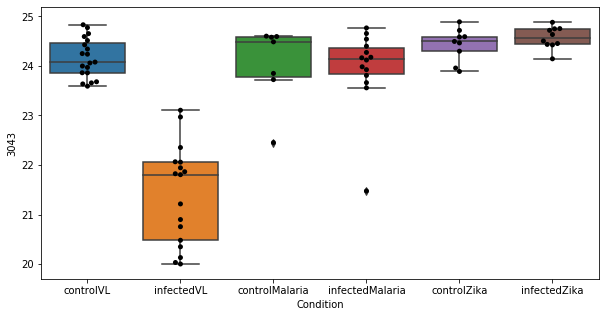

440 row m/z                         213.099
row retention time              4.63072
p-val                          0.808836
adj.P.Val                      0.999793
custom_id                          3790
compound_names        N-Methylserotonin
Name: 3790, dtype: object


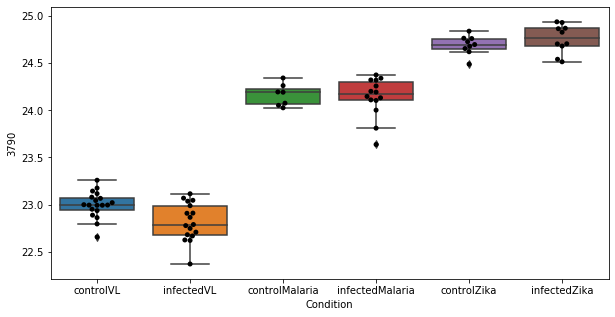

441 row m/z                120.091
row retention time     10.4043
p-val                 0.809133
adj.P.Val             0.999793
custom_id                  311
compound_names             NaN
Name: 311, dtype: object


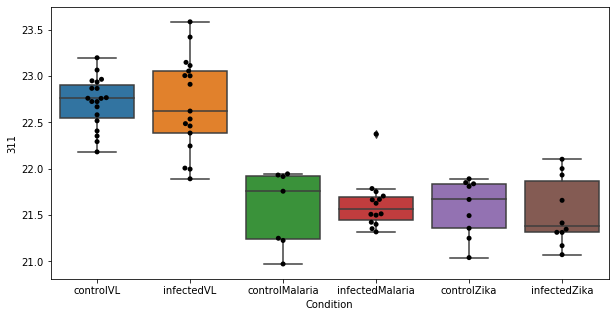

442 row m/z                                                         150.058
row retention time                                              9.80156
p-val                                                          0.812051
adj.P.Val                                                      0.999793
custom_id                                                           746
compound_names        L-Methionine; Methionine; L-2-Amino-4methylthi...
Name: 746, dtype: object


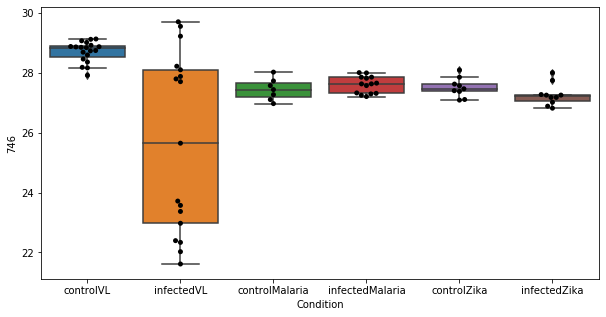

443 row m/z                                                        220.118
row retention time                                             7.99789
p-val                                                         0.816775
adj.P.Val                                                     0.999793
custom_id                                                         1692
compound_names        Pantothenate; Pantothenic acid; (R)-Pantothenate
Name: 1692, dtype: object


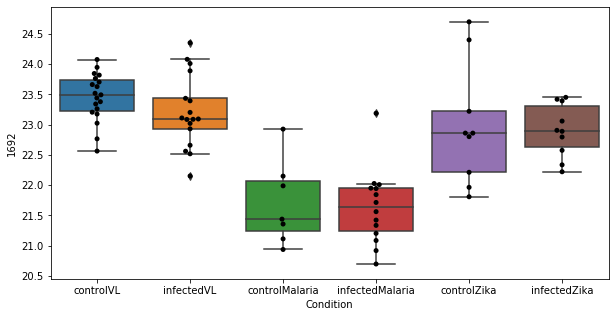

444 row m/z                                                         266.122
row retention time                                              4.45712
p-val                                                          0.817564
adj.P.Val                                                      0.999793
custom_id                                                          2145
compound_names        Thiamin; Thiamine; Vitamin B1; Aneurin; Antibe...
Name: 2145, dtype: object


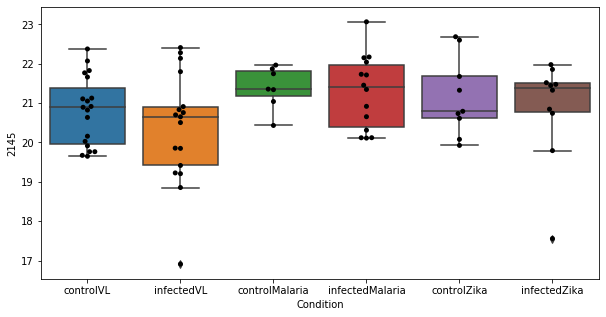

445 row m/z                111.117
row retention time     3.35659
p-val                 0.817946
adj.P.Val             0.999793
custom_id                  205
compound_names             NaN
Name: 205, dtype: object


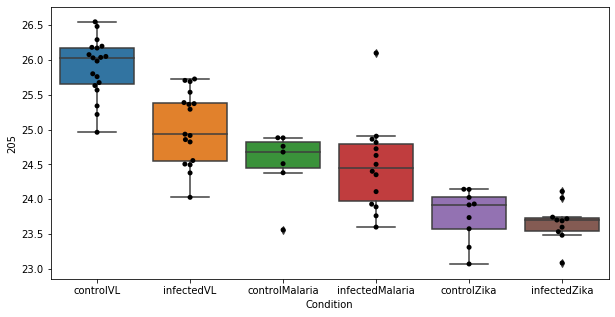

446 row m/z                                                         169.058
row retention time                                               11.897
p-val                                                          0.819258
adj.P.Val                                                      0.999793
custom_id                                                          1008
compound_names        D-Glutamine; D-2-Aminoglutaramic acid$L-Glutam...
Name: 1008, dtype: object


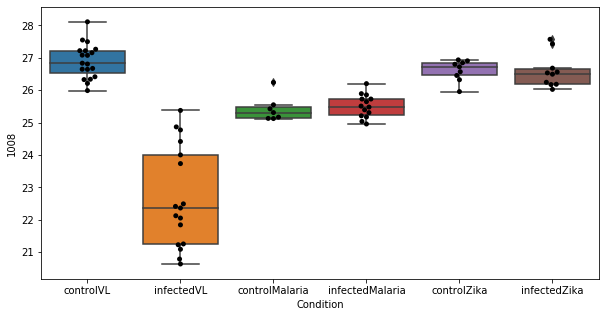

447 row m/z                                                         299.258
row retention time                                              3.05173
p-val                                                          0.819631
adj.P.Val                                                      0.999793
custom_id                                                          2366
compound_names        Linoleate; Linoleic acid; (9Z,12Z)-Octadecadie...
Name: 2366, dtype: object


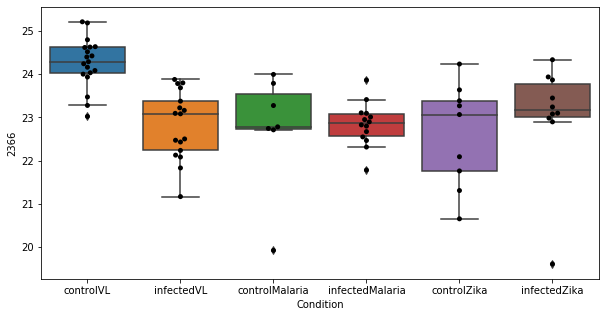

448 row m/z                338.342
row retention time     3.33679
p-val                 0.819838
adj.P.Val             0.999793
custom_id                 2522
compound_names             NaN
Name: 2522, dtype: object


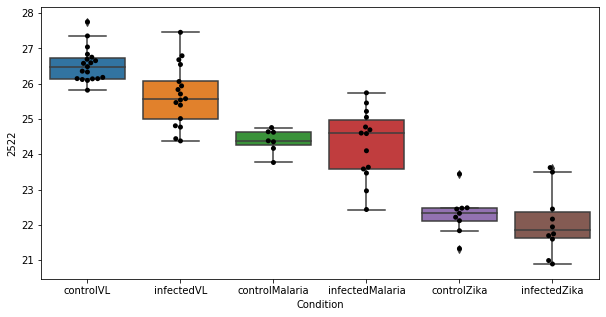

449 row m/z                757.557
row retention time     3.22221
p-val                 0.821626
adj.P.Val             0.999793
custom_id                 2968
compound_names             NaN
Name: 2968, dtype: object


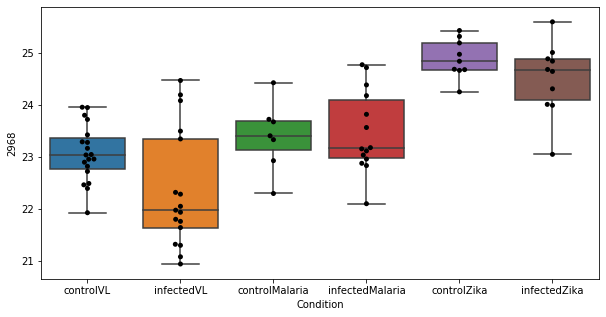

450 row m/z                326.378
row retention time     6.70674
p-val                 0.822109
adj.P.Val             0.999793
custom_id                 2492
compound_names             NaN
Name: 2492, dtype: object


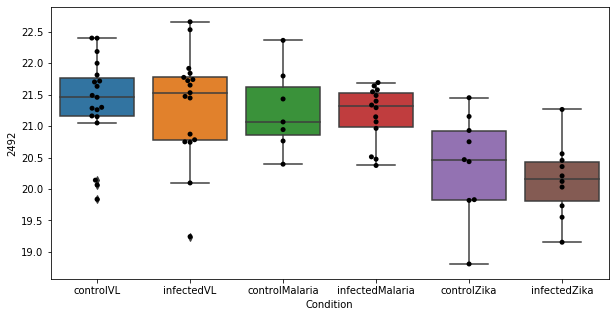

451 row m/z                283.103
row retention time     7.63894
p-val                  0.82467
adj.P.Val             0.999793
custom_id                 2265
compound_names             NaN
Name: 2265, dtype: object


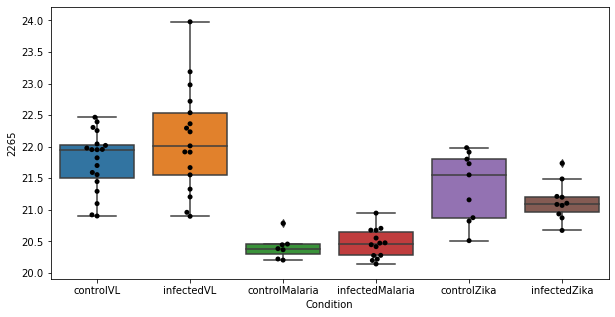

452 row m/z                                                         166.086
row retention time                                              8.85579
p-val                                                          0.825655
adj.P.Val                                                      0.999793
custom_id                                                           982
compound_names        L-Normetanephrine$L-Adrenaline; (R)-(-)-Adrena...
Name: 982, dtype: object


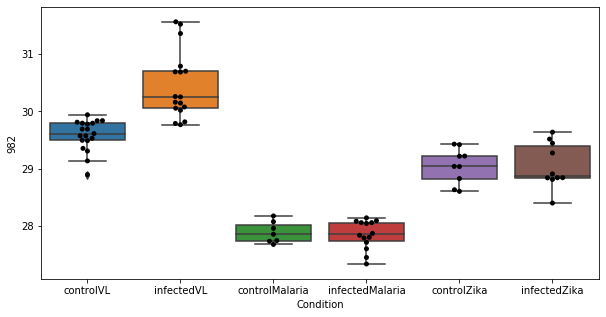

453 row m/z                705.582
row retention time     3.41385
p-val                 0.826095
adj.P.Val             0.999793
custom_id                 2920
compound_names             NaN
Name: 2920, dtype: object


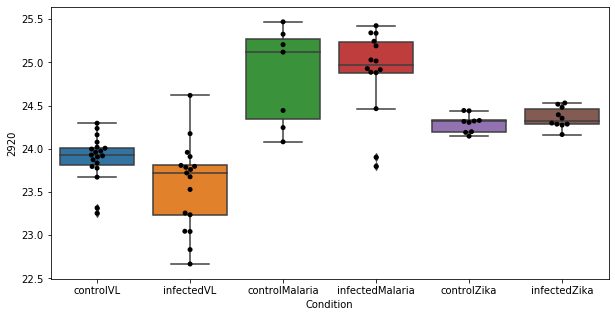

454 row m/z                           201.112
row retention time                6.70075
p-val                            0.827628
adj.P.Val                        0.999793
custom_id                            1435
compound_names        propionyl-carnitine
Name: 1435, dtype: object


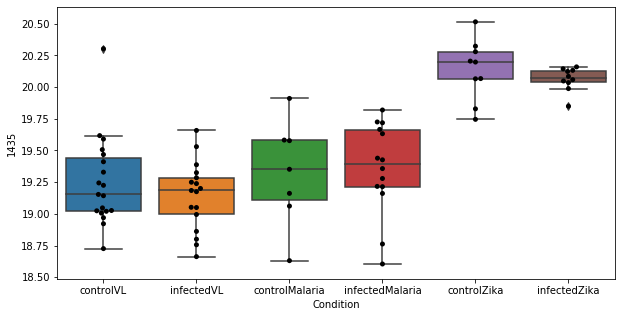

455 row m/z                159.113
row retention time      10.407
p-val                  0.82824
adj.P.Val             0.999793
custom_id                  883
compound_names             NaN
Name: 883, dtype: object


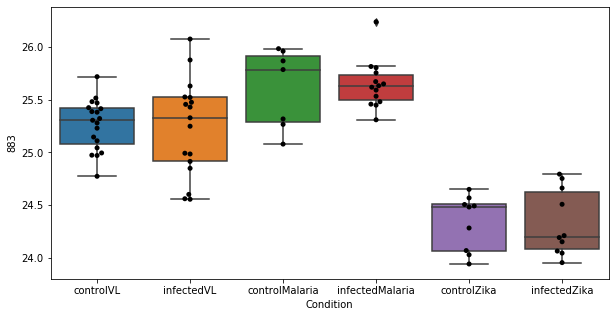

456 row m/z                                                         131.053
row retention time                                              11.8873
p-val                                                          0.830649
adj.P.Val                                                      0.999793
custom_id                                                           441
compound_names        L-1-Pyrroline-3-hydroxy-5-carboxylate; 3-Hydro...
Name: 441, dtype: object


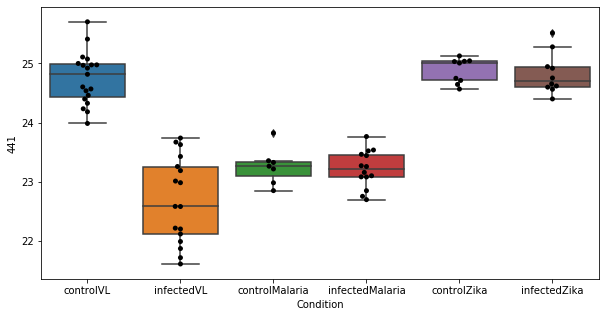

457 row m/z                   70.0651
row retention time         10.578
p-val                    0.831362
adj.P.Val                0.999793
custom_id                       1
compound_names        1-pyrroline
Name: 1, dtype: object


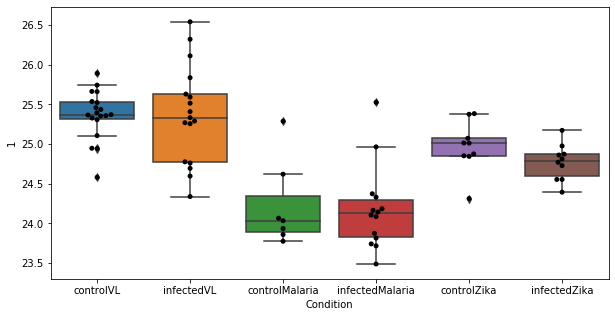

458 row m/z                762.591
row retention time     3.20571
p-val                 0.836458
adj.P.Val             0.999793
custom_id                 2977
compound_names             NaN
Name: 2977, dtype: object


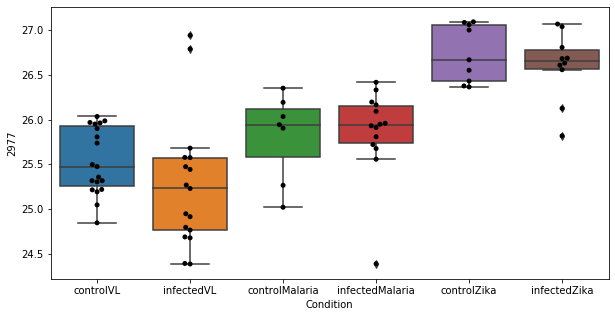

459 row m/z                206.127
row retention time      9.2812
p-val                 0.837563
adj.P.Val             0.999793
custom_id                 1507
compound_names             NaN
Name: 1507, dtype: object


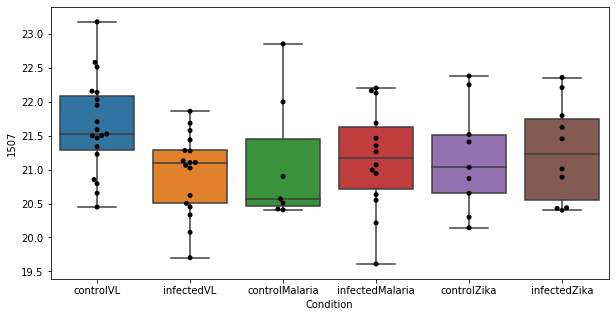

460 row m/z                                                         426.358
row retention time                                              3.68185
p-val                                                          0.841668
adj.P.Val                                                      0.999793
custom_id                                                          2699
compound_names        Elaidic carnitine$Vaccenyl carnitine$octadecen...
Name: 2699, dtype: object


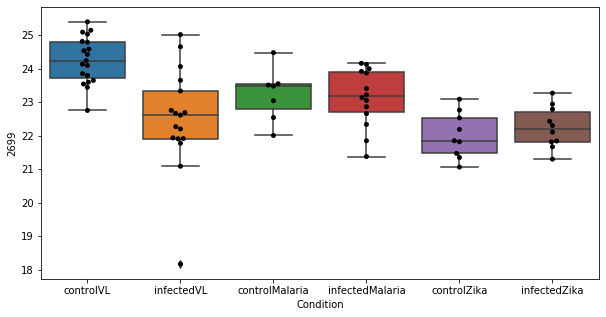

461 row m/z                132.077
row retention time     11.7119
p-val                 0.842331
adj.P.Val             0.999793
custom_id                  461
compound_names             NaN
Name: 461, dtype: object


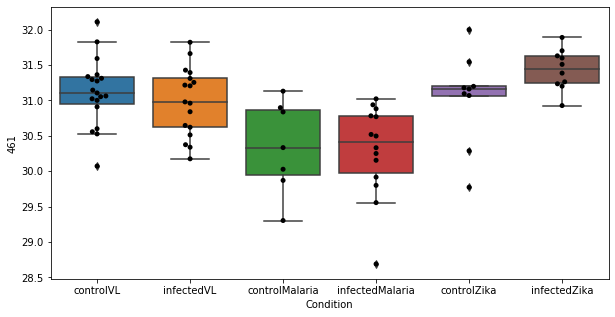

462 row m/z                                                         72.0808
row retention time                                              10.4047
p-val                                                          0.842537
adj.P.Val                                                      0.999793
custom_id                                                             6
compound_names        5-Aminopentanoate; 5-Aminopentanoic acid; 5-Am...
Name: 6, dtype: object


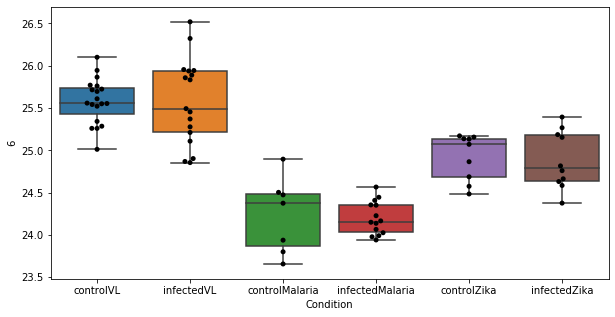

463 row m/z                231.134
row retention time     10.5776
p-val                 0.843553
adj.P.Val             0.999793
custom_id                 1813
compound_names             NaN
Name: 1813, dtype: object


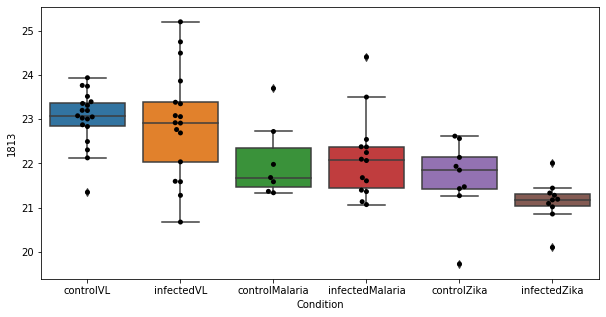

464 row m/z                                                          139.05
row retention time                                              8.15384
p-val                                                            0.8468
adj.P.Val                                                      0.999793
custom_id                                                          3390
compound_names        4-Imidazolone-5-propanoate; 4-Imidazolone-5-pr...
Name: 3390, dtype: object


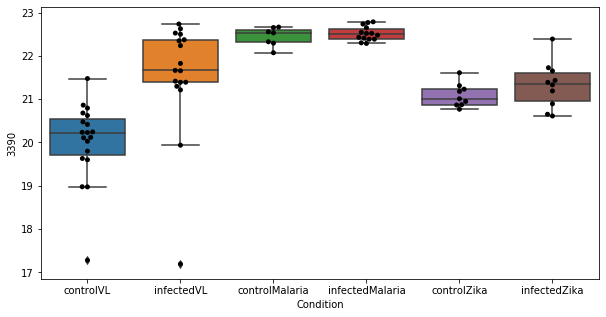

465 row m/z                239.149
row retention time     4.38228
p-val                 0.849404
adj.P.Val             0.999793
custom_id                 1902
compound_names             NaN
Name: 1902, dtype: object


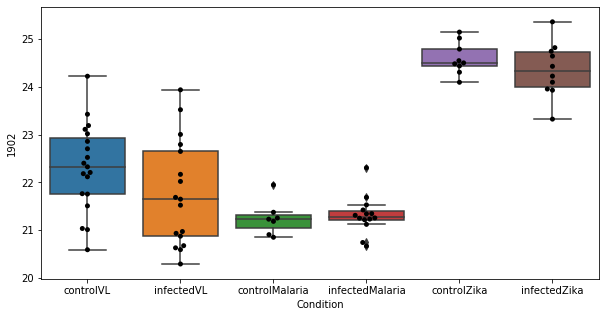

466 row m/z                           201.112
row retention time                4.34518
p-val                            0.849504
adj.P.Val                        0.999793
custom_id                            1434
compound_names        propionyl-carnitine
Name: 1434, dtype: object


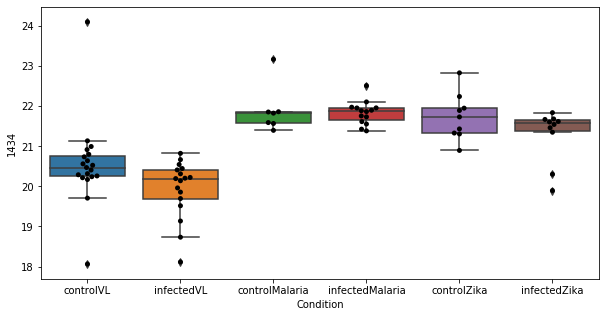

467 row m/z                                                         102.055
row retention time                                              11.6019
p-val                                                          0.850475
adj.P.Val                                                      0.999793
custom_id                                                           119
compound_names        L-Allothreonine; L-allo-Threonine$L-Threonine;...
Name: 119, dtype: object


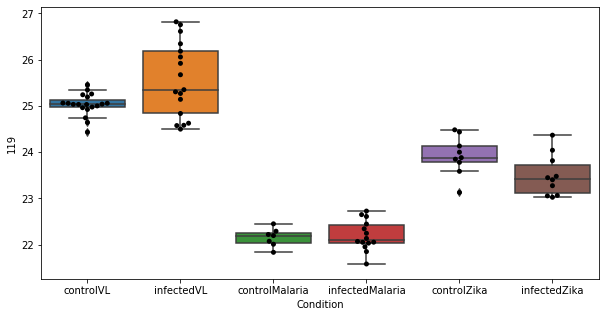

468 row m/z                204.123
row retention time     6.71267
p-val                 0.850993
adj.P.Val             0.999793
custom_id                 1481
compound_names             NaN
Name: 1481, dtype: object


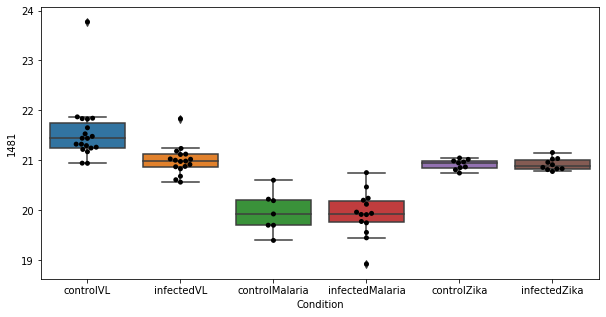

469 row m/z                158.101
row retention time     10.5739
p-val                  0.85437
adj.P.Val             0.999793
custom_id                  861
compound_names             NaN
Name: 861, dtype: object


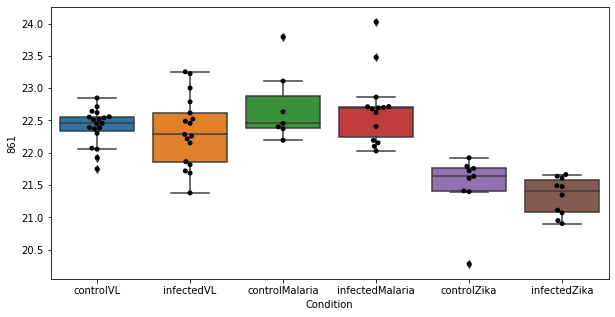

470 row m/z                202.144
row retention time     6.71119
p-val                 0.857805
adj.P.Val             0.999793
custom_id                 1450
compound_names             NaN
Name: 1450, dtype: object


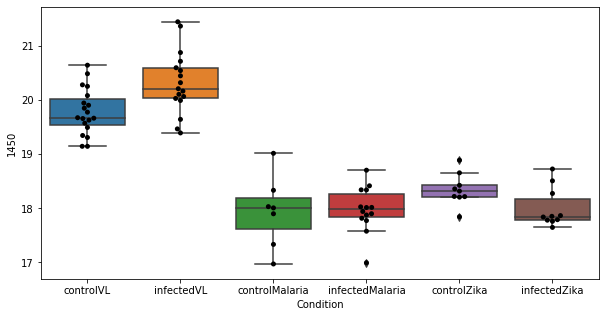

471 row m/z                151.058
row retention time     9.80728
p-val                 0.859961
adj.P.Val             0.999793
custom_id                  758
compound_names             NaN
Name: 758, dtype: object


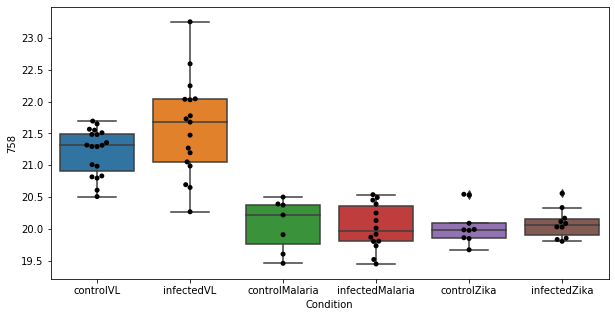

472 row m/z                                                         152.071
row retention time                                              6.71277
p-val                                                           0.86071
adj.P.Val                                                      0.999793
custom_id                                                           774
compound_names        6-Acetamido-2-oxohexanoate; 2-Oxo-6-acetamidoc...
Name: 774, dtype: object


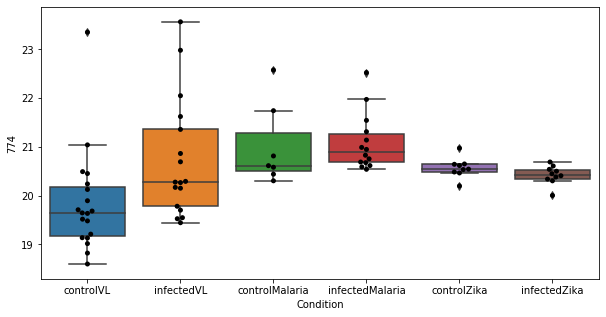

473 row m/z                179.128
row retention time     4.37518
p-val                 0.861806
adj.P.Val             0.999793
custom_id                 1154
compound_names             NaN
Name: 1154, dtype: object


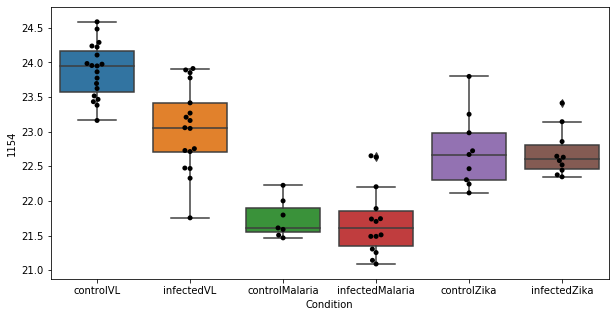

474 row m/z                160.116
row retention time     10.4075
p-val                 0.862166
adj.P.Val             0.999793
custom_id                  902
compound_names             NaN
Name: 902, dtype: object


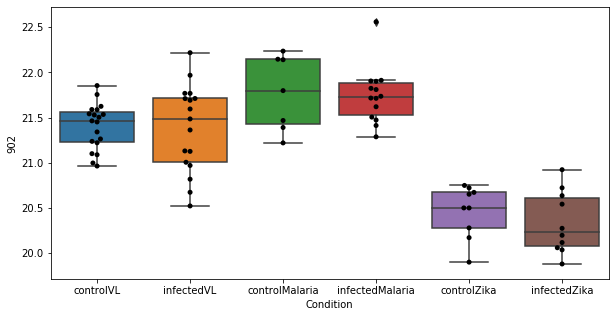

475 row m/z                768.589
row retention time      3.1957
p-val                 0.863307
adj.P.Val             0.999793
custom_id                 2988
compound_names             NaN
Name: 2988, dtype: object


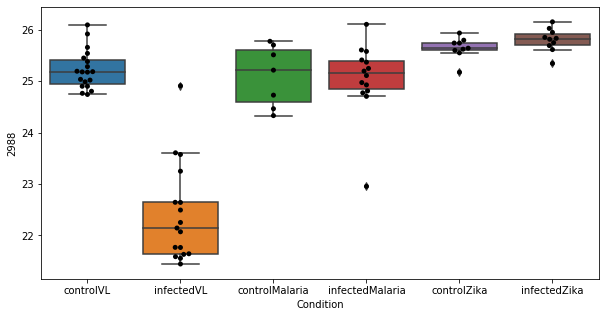

476 row m/z                                                         200.128
row retention time                                              6.73196
p-val                                                          0.863332
adj.P.Val                                                      0.999793
custom_id                                                          1420
compound_names        Ecgonine methyl ester; Methyl ecgonine$ecgonin...
Name: 1420, dtype: object


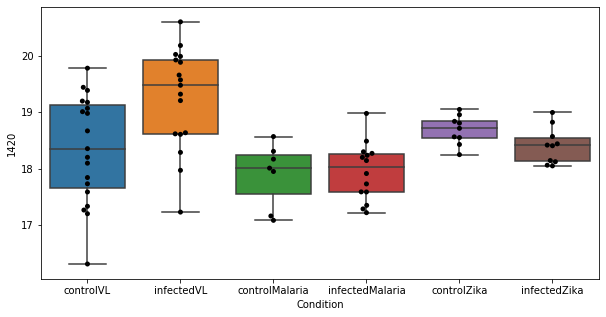

477 row m/z                                                         84.0443
row retention time                                              11.8824
p-val                                                          0.870547
adj.P.Val                                                      0.999793
custom_id                                                            44
compound_names        L-1-Pyrroline-3-hydroxy-5-carboxylate; 3-Hydro...
Name: 44, dtype: object


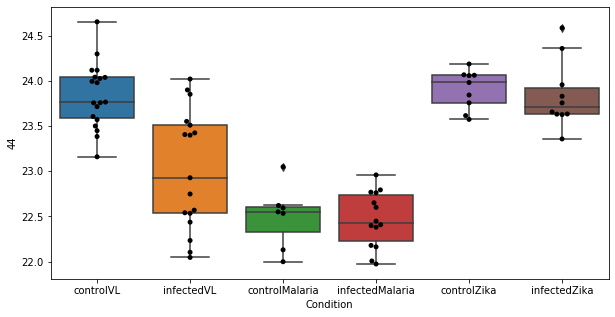

478 row m/z                151.097
row retention time      6.6976
p-val                 0.870851
adj.P.Val             0.999793
custom_id                  765
compound_names             NaN
Name: 765, dtype: object


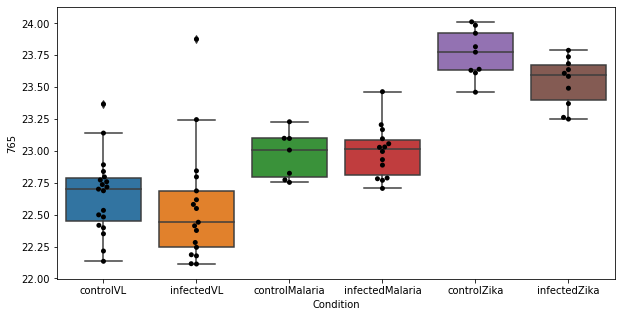

479 row m/z                160.133
row retention time     7.38486
p-val                  0.87153
adj.P.Val             0.999793
custom_id                  904
compound_names             NaN
Name: 904, dtype: object


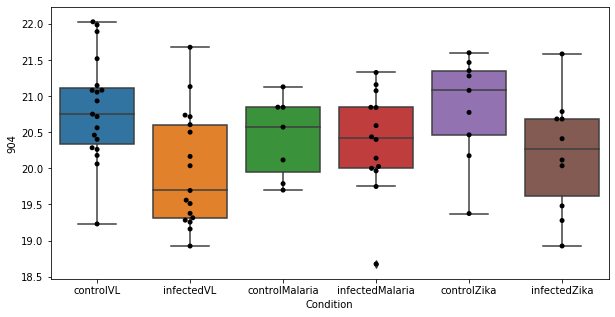

480 row m/z                287.222
row retention time     3.33673
p-val                  0.87161
adj.P.Val             0.999793
custom_id                 2304
compound_names             NaN
Name: 2304, dtype: object


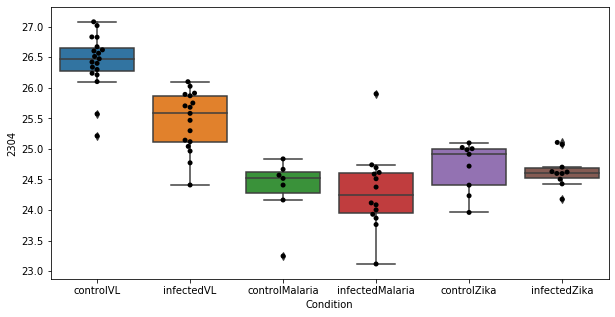

481 row m/z                                                          131.09
row retention time                                              9.51152
p-val                                                          0.872264
adj.P.Val                                                      0.999793
custom_id                                                           444
compound_names        N4-Acetylaminobutanal$L-Pipecolate; Pipecolini...
Name: 444, dtype: object


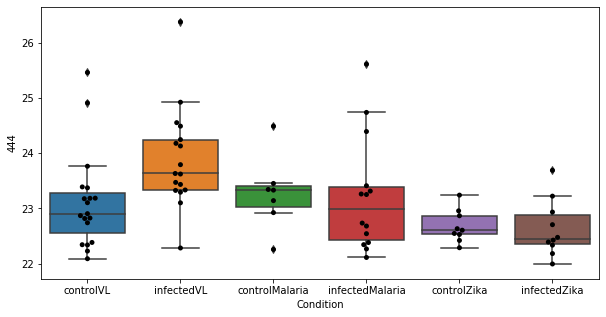

482 row m/z                                                         86.0964
row retention time                                              9.24833
p-val                                                          0.873211
adj.P.Val                                                      0.999793
custom_id                                                            60
compound_names        L-Isoleucine; 2-Amino-3-methylvaleric acid$L-L...
Name: 60, dtype: object


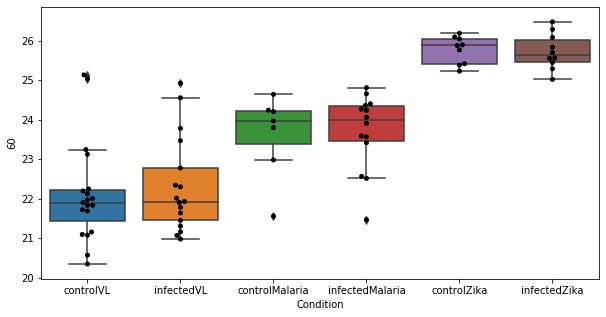

483 row m/z                                                         156.102
row retention time                                              6.71109
p-val                                                          0.873366
adj.P.Val                                                      0.999793
custom_id                                                           827
compound_names        L-Normetanephrine$L-Adrenaline; (R)-(-)-Adrena...
Name: 827, dtype: object


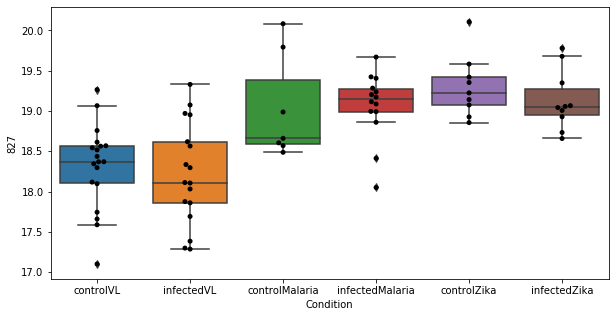

484 row m/z                                                         130.086
row retention time                                              9.51388
p-val                                                          0.873923
adj.P.Val                                                      0.999793
custom_id                                                           421
compound_names        N4-Acetylaminobutanal$L-Pipecolate; Pipecolini...
Name: 421, dtype: object


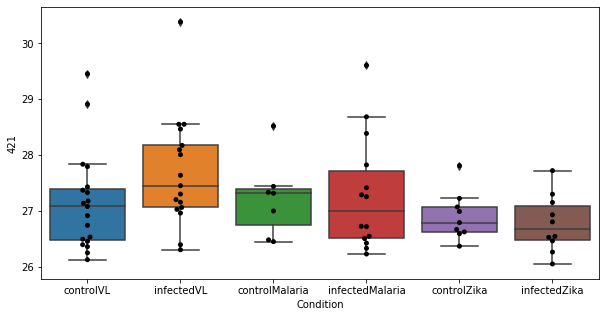

485 row m/z                166.053
row retention time     10.8401
p-val                 0.875237
adj.P.Val             0.999793
custom_id                  976
compound_names             NaN
Name: 976, dtype: object


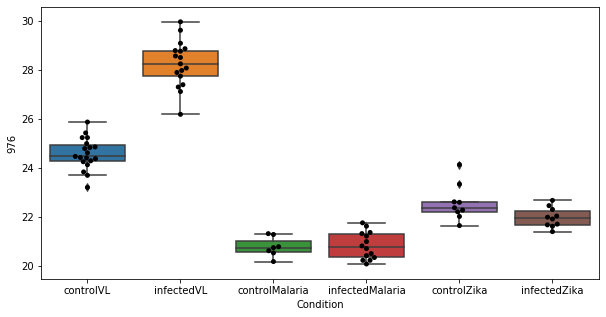

486 row m/z                187.096
row retention time     4.38444
p-val                 0.875631
adj.P.Val             0.999793
custom_id                 1251
compound_names             NaN
Name: 1251, dtype: object


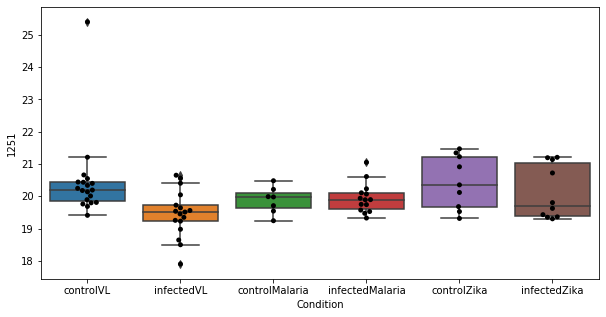

487 row m/z                                                         180.066
row retention time                                              4.60253
p-val                                                          0.877417
adj.P.Val                                                      0.999793
custom_id                                                          4782
compound_names        3,4-Dihydroxy-L-phenylalanine; L-Dopa; 3-Hydro...
Name: 4782, dtype: object


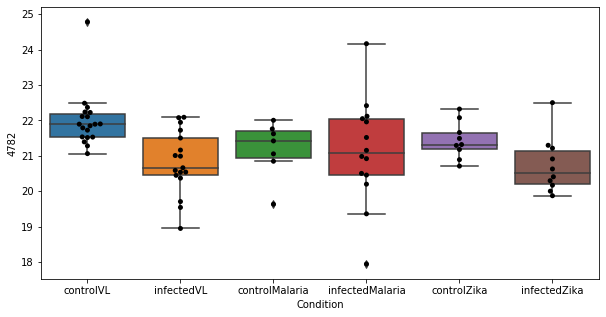

488 row m/z                171.076
row retention time     11.8928
p-val                 0.877676
adj.P.Val             0.999793
custom_id                 1044
compound_names             NaN
Name: 1044, dtype: object


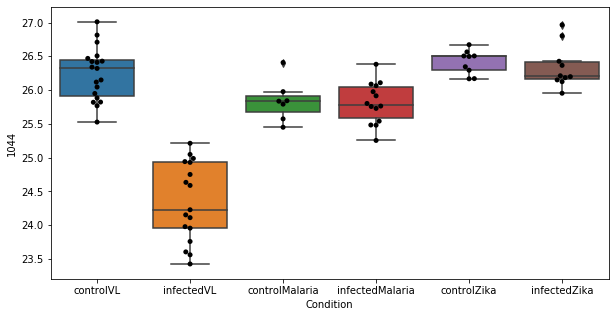

489 row m/z                118.052
row retention time     10.4173
p-val                 0.878176
adj.P.Val             0.999793
custom_id                  271
compound_names             NaN
Name: 271, dtype: object


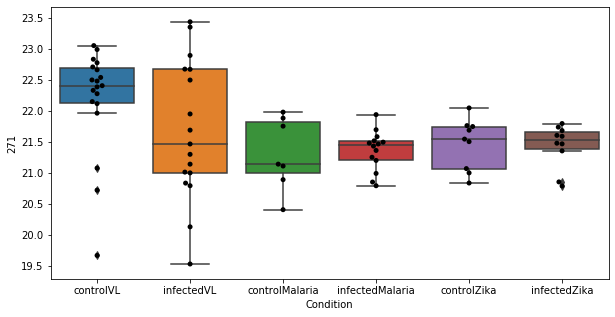

490 row m/z                196.154
row retention time      4.3551
p-val                 0.879965
adj.P.Val             0.999793
custom_id                 1383
compound_names             NaN
Name: 1383, dtype: object


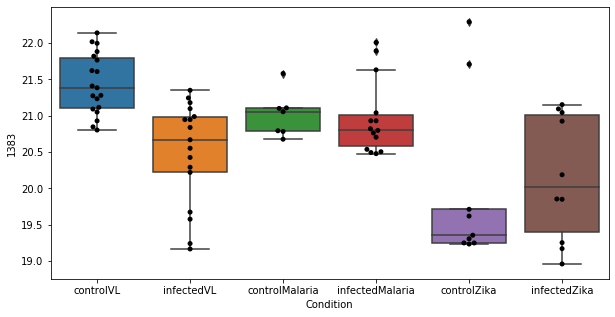

491 row m/z                784.584
row retention time     3.19568
p-val                 0.880195
adj.P.Val             0.999793
custom_id                 3012
compound_names             NaN
Name: 3012, dtype: object


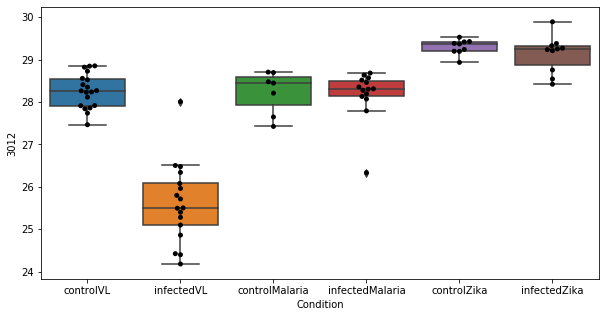

492 row m/z                                                          118.05
row retention time                                              9.11566
p-val                                                          0.880998
adj.P.Val                                                      0.999793
custom_id                                                           269
compound_names        2-Amino-3-oxobutanoate; 2-Amino-acetoacetate$L...
Name: 269, dtype: object


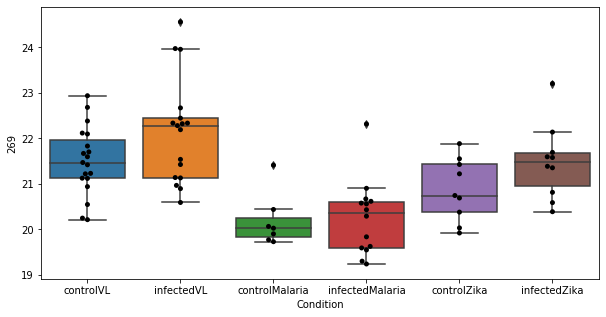

493 row m/z                186.113
row retention time     4.38939
p-val                 0.881636
adj.P.Val             0.999793
custom_id                 1232
compound_names             NaN
Name: 1232, dtype: object


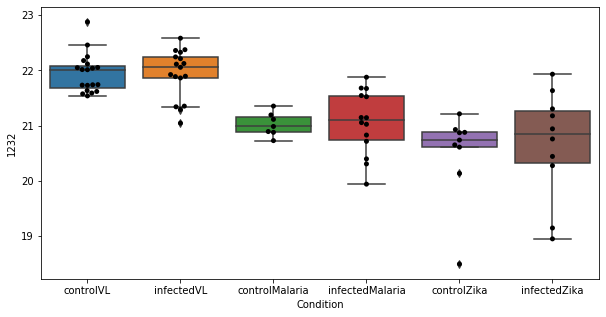

494 row m/z                 191.04
row retention time     11.9114
p-val                 0.881909
adj.P.Val             0.999793
custom_id                 1297
compound_names             NaN
Name: 1297, dtype: object


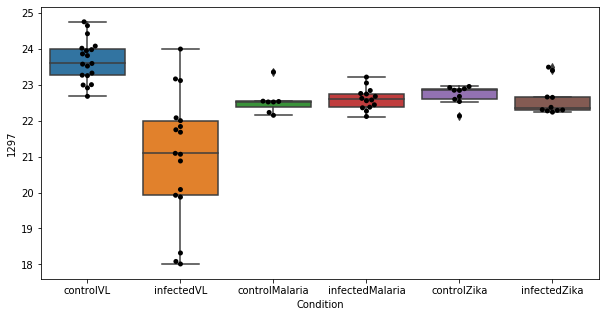

495 row m/z                                                         202.107
row retention time                                              6.71214
p-val                                                          0.882074
adj.P.Val                                                      0.999793
custom_id                                                          1443
compound_names        L-Normetanephrine$L-Adrenaline; (R)-(-)-Adrena...
Name: 1443, dtype: object


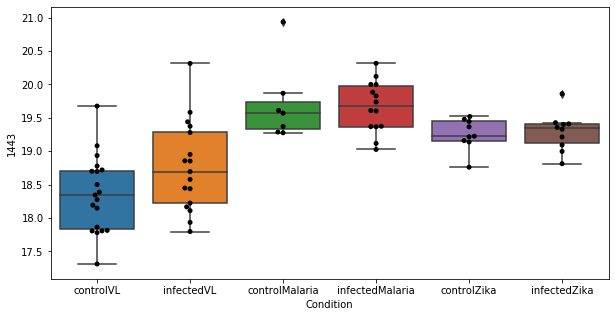

496 row m/z                                                        202.107
row retention time                                             4.37692
p-val                                                         0.883154
adj.P.Val                                                     0.999793
custom_id                                                         1447
compound_names        Pantothenate; Pantothenic acid; (R)-Pantothenate
Name: 1447, dtype: object


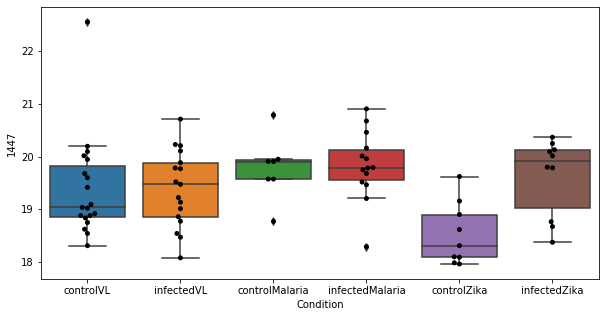

497 row m/z                260.185
row retention time     6.71453
p-val                 0.883772
adj.P.Val             0.999793
custom_id                 2101
compound_names             NaN
Name: 2101, dtype: object


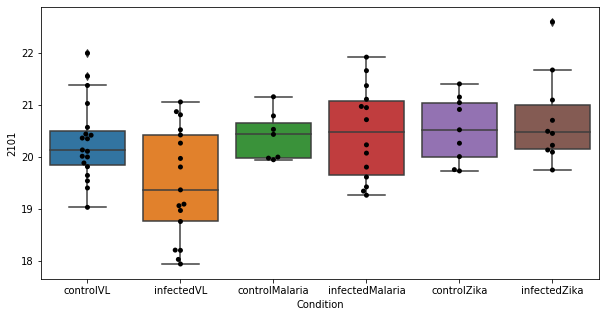

498 row m/z                                                         150.058
row retention time                                              6.72035
p-val                                                          0.884664
adj.P.Val                                                      0.999793
custom_id                                                           747
compound_names        L-Methionine; Methionine; L-2-Amino-4methylthi...
Name: 747, dtype: object


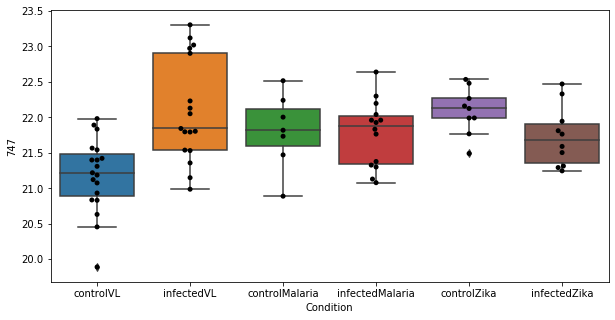

499 row m/z                118.075
row retention time     10.5768
p-val                 0.886639
adj.P.Val             0.999793
custom_id                  278
compound_names             NaN
Name: 278, dtype: object


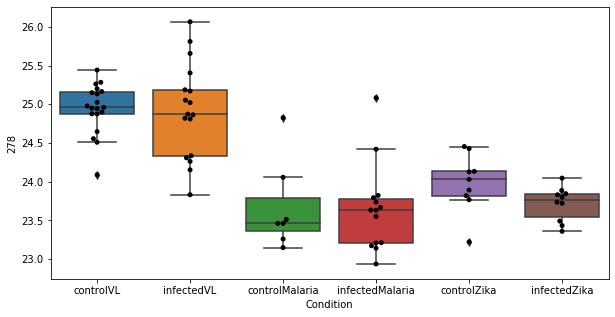

500 row m/z                145.097
row retention time     11.1439
p-val                 0.888677
adj.P.Val             0.999793
custom_id                  645
compound_names             NaN
Name: 645, dtype: object


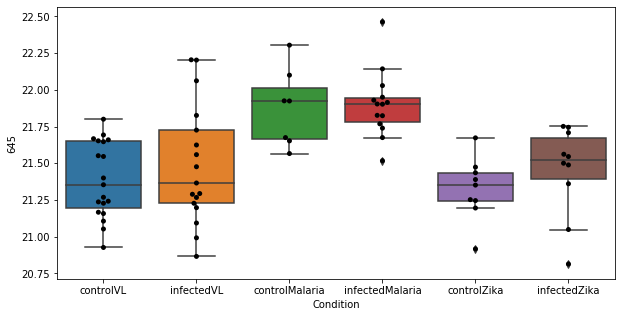

501 row m/z                314.232
row retention time     6.71001
p-val                 0.888896
adj.P.Val             0.999793
custom_id                 2452
compound_names             NaN
Name: 2452, dtype: object


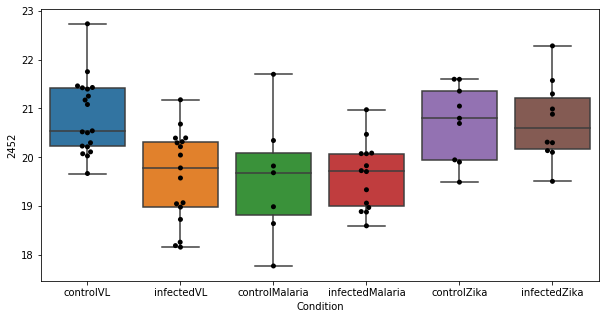

502 row m/z                                                         132.066
row retention time                                              11.5752
p-val                                                          0.889901
adj.P.Val                                                      0.999793
custom_id                                                           457
compound_names        5-Aminolevulinate; 5-Amino-4-oxopentanoate; 5-...
Name: 457, dtype: object


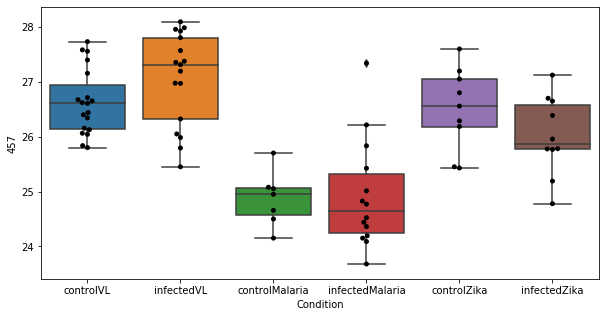

503 row m/z                180.159
row retention time     3.79938
p-val                 0.890864
adj.P.Val             0.999793
custom_id                 1165
compound_names             NaN
Name: 1165, dtype: object


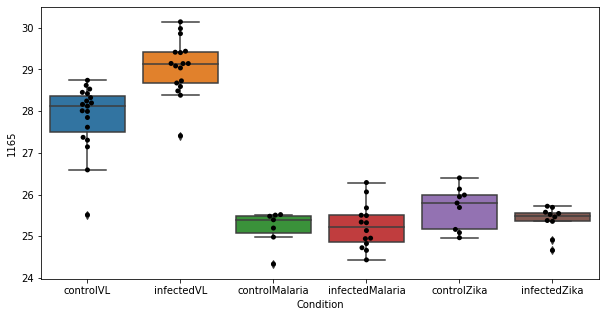

504 row m/z                148.097
row retention time     9.10577
p-val                 0.890917
adj.P.Val             0.999793
custom_id                  716
compound_names             NaN
Name: 716, dtype: object


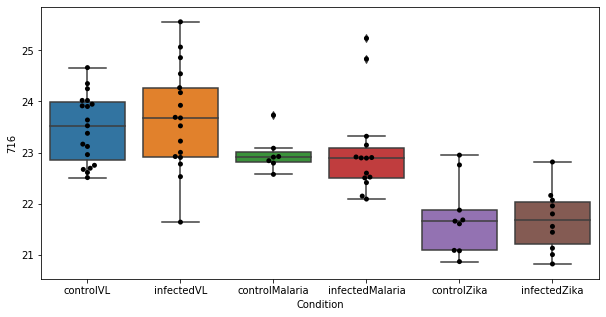

505 row m/z                133.074
row retention time     11.6911
p-val                   0.8924
adj.P.Val             0.999793
custom_id                  476
compound_names             NaN
Name: 476, dtype: object


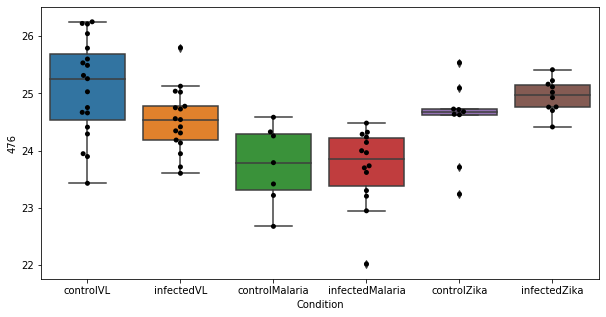

506 row m/z                275.103
row retention time     4.73098
p-val                 0.892781
adj.P.Val             0.999793
custom_id                 2207
compound_names             NaN
Name: 2207, dtype: object


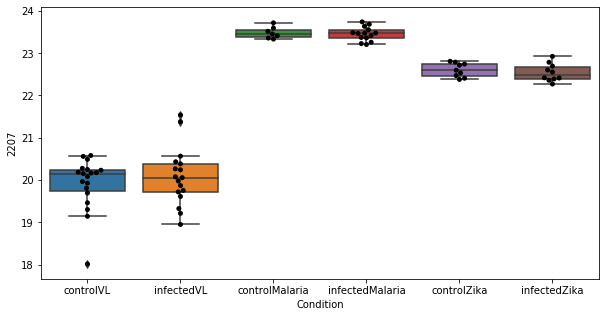

507 row m/z                 246.17
row retention time     6.86309
p-val                 0.894201
adj.P.Val             0.999793
custom_id                 1963
compound_names             NaN
Name: 1963, dtype: object


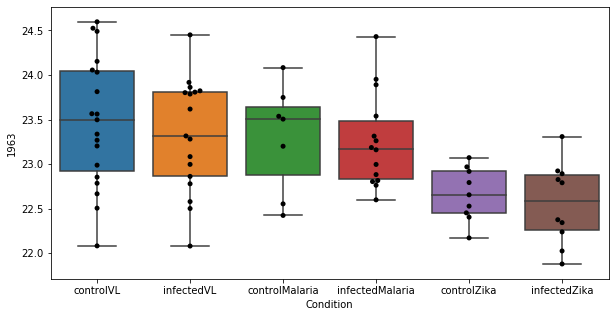

508 row m/z                149.117
row retention time     4.01666
p-val                 0.894446
adj.P.Val             0.999793
custom_id                  733
compound_names             NaN
Name: 733, dtype: object


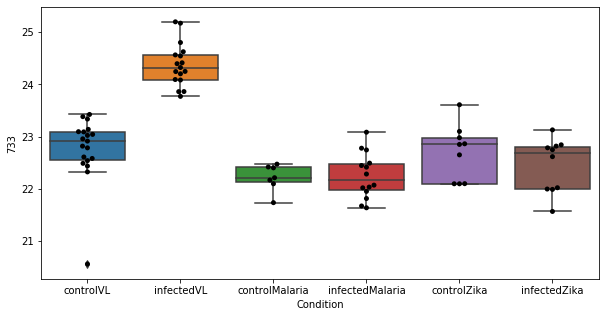

509 row m/z                                                          119.09
row retention time                                              10.4076
p-val                                                          0.894466
adj.P.Val                                                      0.999793
custom_id                                                           298
compound_names        5-Aminopentanoate; 5-Aminopentanoic acid; 5-Am...
Name: 298, dtype: object


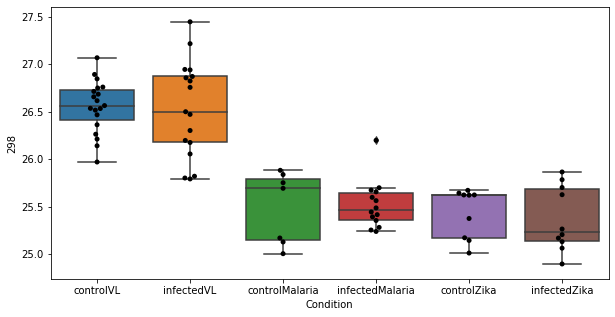

510 row m/z                342.264
row retention time     4.15032
p-val                 0.895293
adj.P.Val             0.999793
custom_id                 2542
compound_names             NaN
Name: 2542, dtype: object


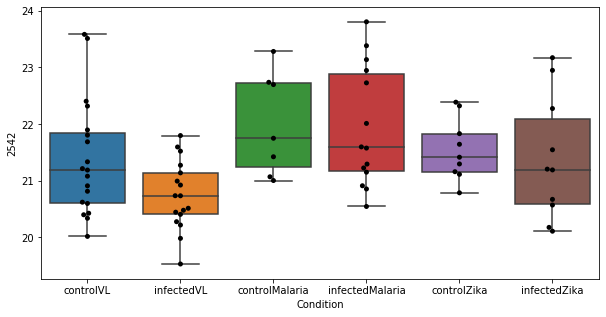

511 row m/z                 217.13
row retention time     11.6414
p-val                 0.896142
adj.P.Val             0.999793
custom_id                 1652
compound_names             NaN
Name: 1652, dtype: object


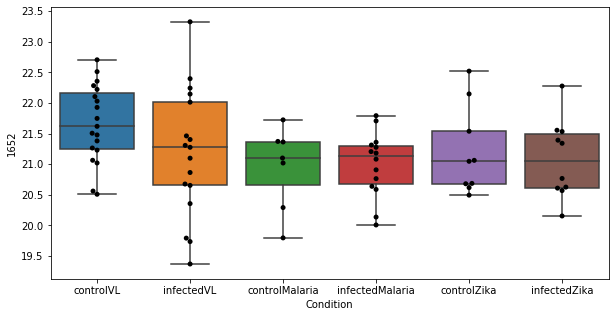

512 row m/z                                                         148.097
row retention time                                              10.1861
p-val                                                          0.897284
adj.P.Val                                                      0.999793
custom_id                                                           714
compound_names        N4-Acetylaminobutanal$L-Pipecolate; Pipecolini...
Name: 714, dtype: object


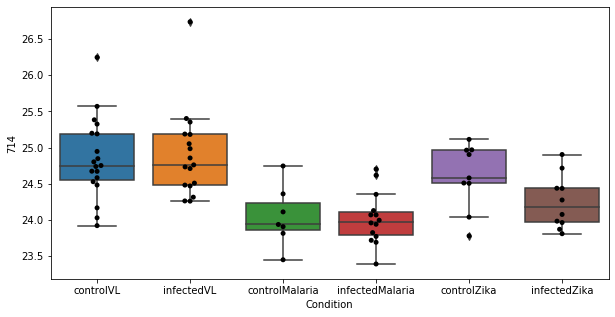

513 row m/z                186.113
row retention time     9.39741
p-val                 0.897622
adj.P.Val             0.999793
custom_id                 1234
compound_names             NaN
Name: 1234, dtype: object


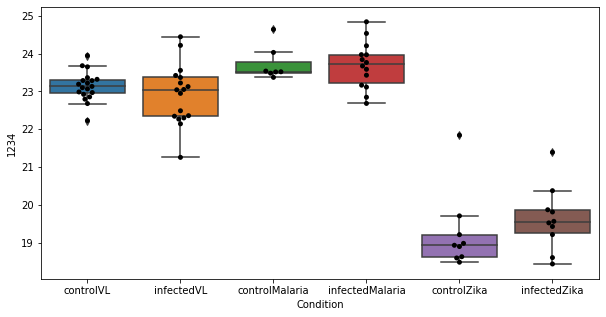

514 row m/z                 268.14
row retention time     9.21841
p-val                  0.89981
adj.P.Val             0.999793
custom_id                 2155
compound_names             NaN
Name: 2155, dtype: object


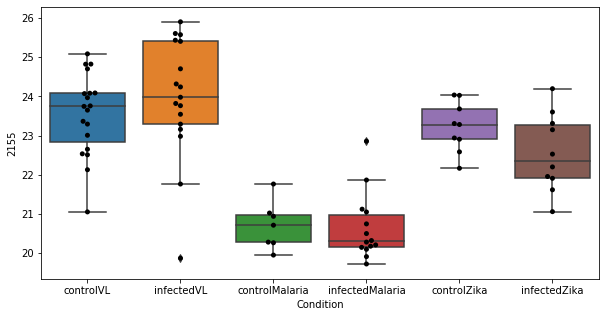

515 row m/z                314.232
row retention time     4.36989
p-val                 0.900925
adj.P.Val             0.999793
custom_id                 2451
compound_names             NaN
Name: 2451, dtype: object


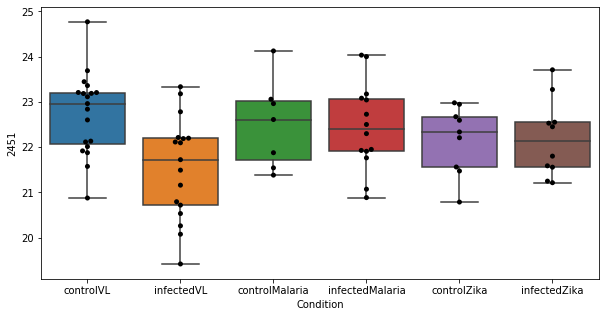

516 row m/z                                                          133.08
row retention time                                              11.6908
p-val                                                          0.903054
adj.P.Val                                                      0.999793
custom_id                                                           477
compound_names        Creatine; alpha-Methylguanidino acetic acid; M...
Name: 477, dtype: object


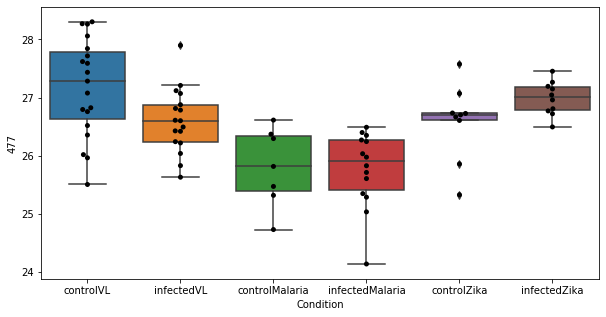

517 row m/z                131.082
row retention time     11.7969
p-val                 0.903847
adj.P.Val             0.999793
custom_id                  442
compound_names             NaN
Name: 442, dtype: object


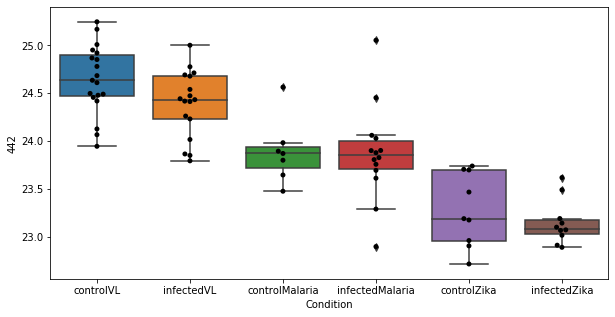

518 row m/z                164.136
row retention time     3.80014
p-val                 0.904306
adj.P.Val             0.999793
custom_id                  953
compound_names             NaN
Name: 953, dtype: object


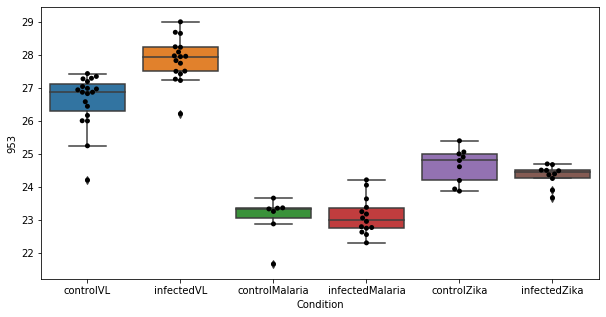

519 row m/z                                                         115.087
row retention time                                              9.18132
p-val                                                          0.905854
adj.P.Val                                                      0.999793
custom_id                                                           245
compound_names        L-Ornithine; (S)-2,5-Diaminovaleric acid; (S)-...
Name: 245, dtype: object


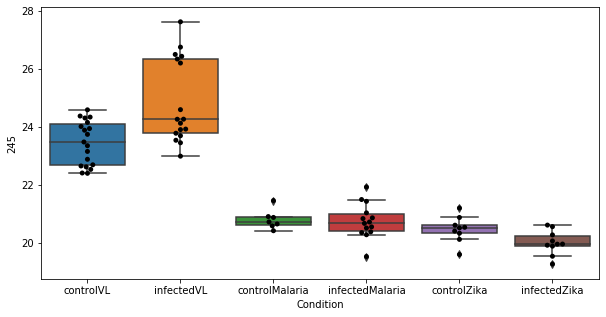

520 row m/z                327.158
row retention time     10.5766
p-val                 0.909018
adj.P.Val             0.999793
custom_id                 2495
compound_names             NaN
Name: 2495, dtype: object


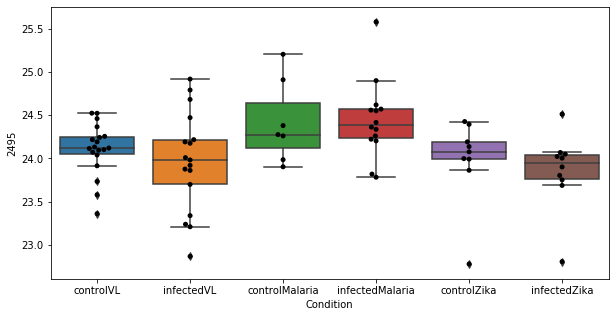

521 row m/z                195.123
row retention time     4.40422
p-val                 0.909306
adj.P.Val             0.999793
custom_id                 1372
compound_names             NaN
Name: 1372, dtype: object


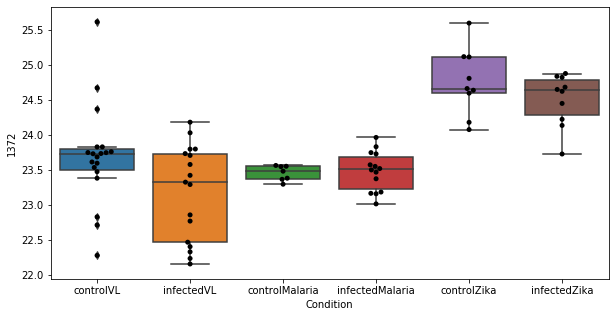

522 row m/z                305.252
row retention time     3.34847
p-val                 0.910408
adj.P.Val             0.999793
custom_id                 2402
compound_names             NaN
Name: 2402, dtype: object


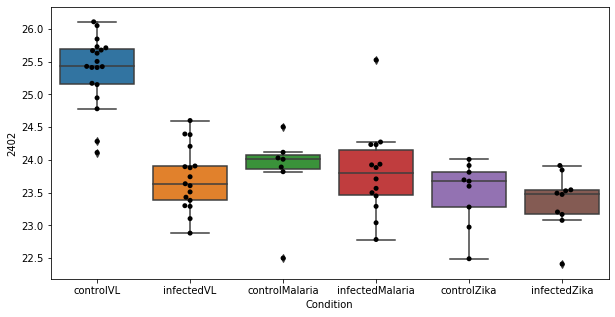

523 row m/z                117.074
row retention time     10.5785
p-val                 0.910499
adj.P.Val             0.999793
custom_id                  264
compound_names             NaN
Name: 264, dtype: object


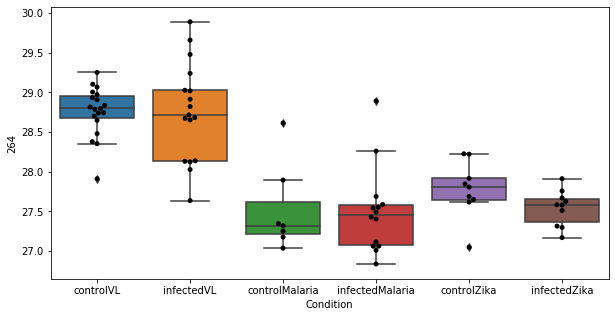

524 row m/z                183.078
row retention time     3.60118
p-val                  0.91054
adj.P.Val             0.999793
custom_id                 1187
compound_names             NaN
Name: 1187, dtype: object


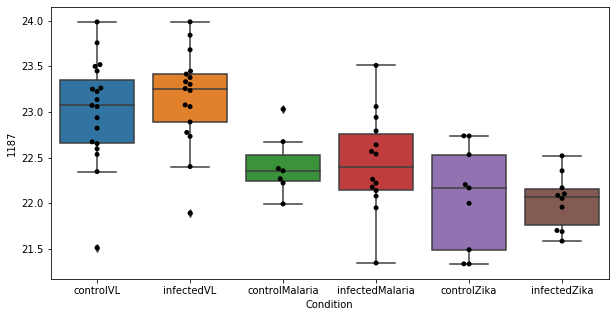

525 row m/z                663.453
row retention time     3.07059
p-val                 0.912567
adj.P.Val             0.999793
custom_id                 2896
compound_names             NaN
Name: 2896, dtype: object


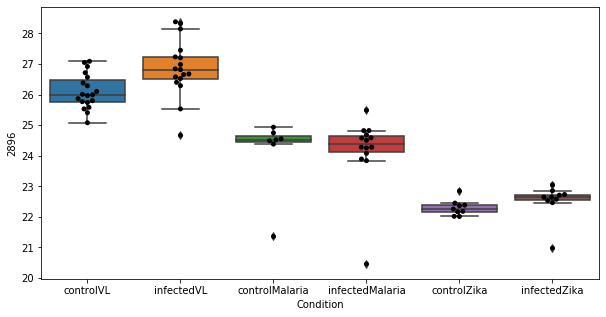

526 row m/z                251.185
row retention time     3.75476
p-val                 0.913179
adj.P.Val             0.999793
custom_id                 2017
compound_names             NaN
Name: 2017, dtype: object


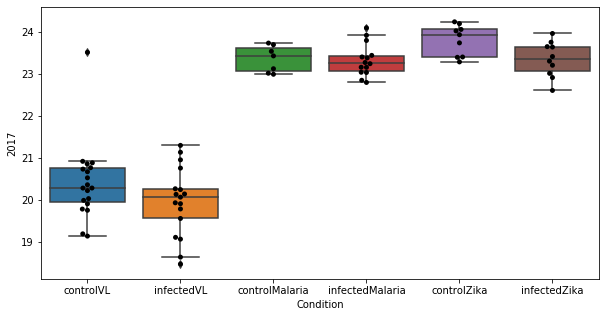

527 row m/z                286.201
row retention time     4.39654
p-val                 0.914499
adj.P.Val             0.999793
custom_id                 2296
compound_names             NaN
Name: 2296, dtype: object


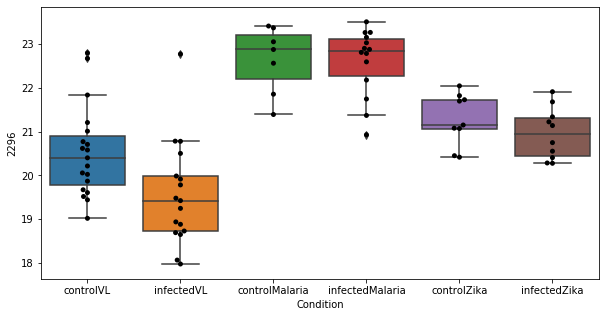

528 row m/z                                                         284.197
row retention time                                              6.69722
p-val                                                          0.914633
adj.P.Val                                                      0.999793
custom_id                                                          2275
compound_names        3(S),8(S)-dihydroxy-6E,10Z-hexadecadienoate$3(...
Name: 2275, dtype: object


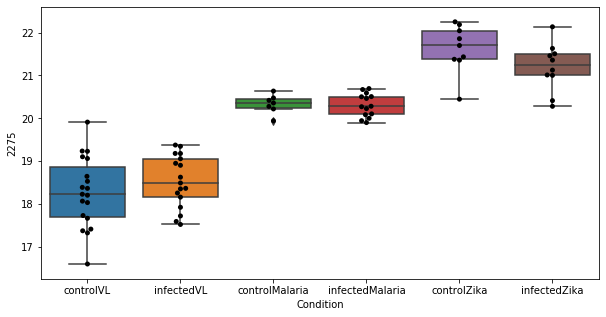

529 row m/z                                 328.162
row retention time                      10.5872
p-val                                  0.915038
adj.P.Val                              0.999793
custom_id                                  2501
compound_names        5'-carboxy-gama-chromanol
Name: 2501, dtype: object


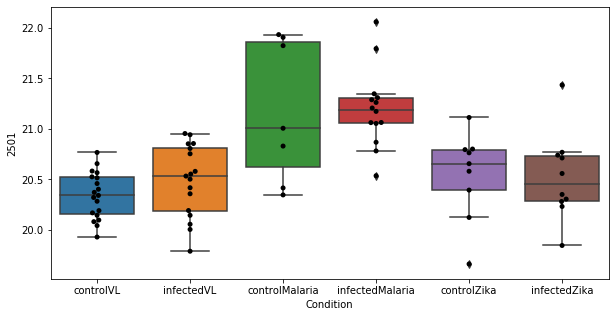

530 row m/z                675.543
row retention time     3.46379
p-val                  0.91546
adj.P.Val             0.999793
custom_id                 2904
compound_names             NaN
Name: 2904, dtype: object


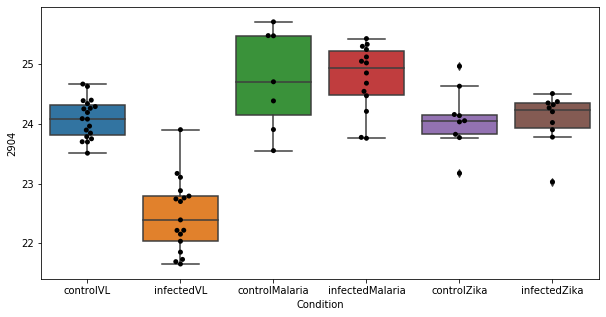

531 row m/z                731.606
row retention time     3.37124
p-val                 0.916212
adj.P.Val             0.999793
custom_id                 2936
compound_names             NaN
Name: 2936, dtype: object


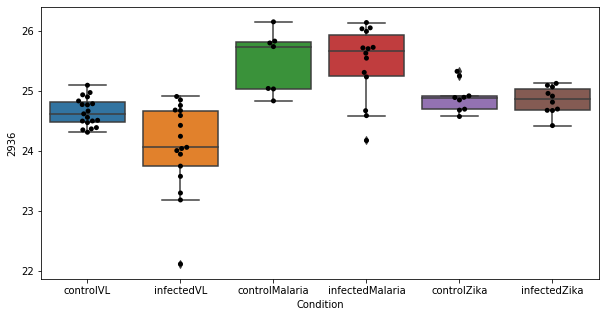

532 row m/z                      198.113
row retention time           6.71449
p-val                       0.918649
adj.P.Val                   0.999793
custom_id                       1397
compound_names        L-Metanephrine
Name: 1397, dtype: object


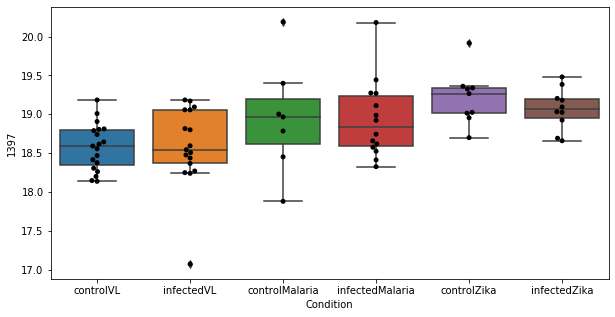

533 row m/z                                                         181.072
row retention time                                              6.70373
p-val                                                          0.918813
adj.P.Val                                                      0.999793
custom_id                                                          1174
compound_names        1,7-Dimethylxanthine; Paraxanthine$adrenochrom...
Name: 1174, dtype: object


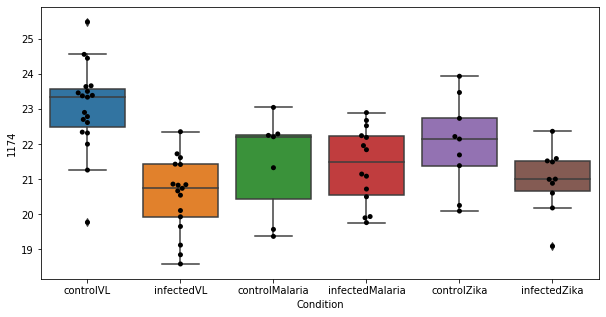

534 row m/z                                                         133.069
row retention time                                              11.5737
p-val                                                           0.92127
adj.P.Val                                                      0.999793
custom_id                                                           475
compound_names        5-Aminolevulinate; 5-Amino-4-oxopentanoate; 5-...
Name: 475, dtype: object


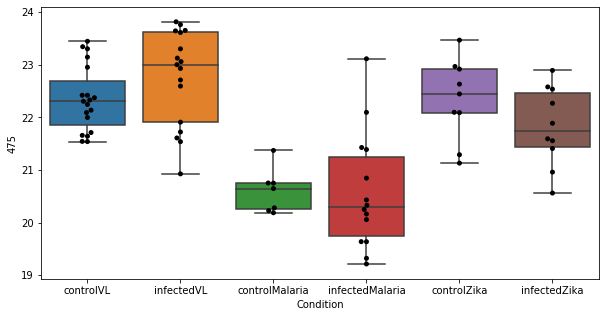

535 row m/z                597.509
row retention time     3.00226
p-val                 0.924278
adj.P.Val             0.999793
custom_id                 2857
compound_names             NaN
Name: 2857, dtype: object


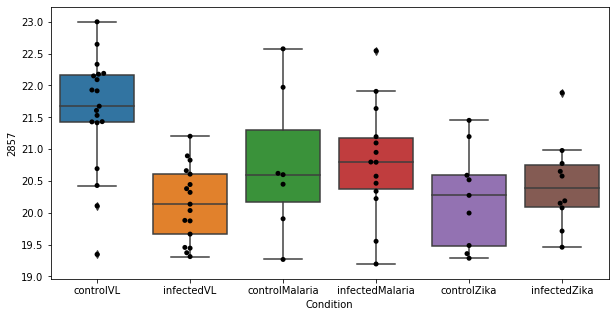

536 row m/z                          189.123
row retention time               10.4352
p-val                           0.925348
adj.P.Val                       0.999793
custom_id                           1281
compound_names        N6-Acetyl-L-lysine
Name: 1281, dtype: object


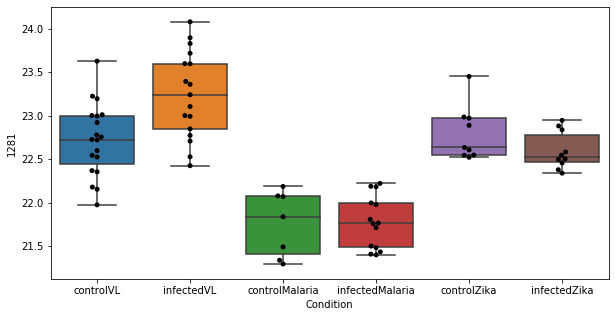

537 row m/z                           288.217
row retention time                4.38402
p-val                            0.925818
adj.P.Val                        0.999793
custom_id                            2308
compound_names        L-Octanoylcarnitine
Name: 2308, dtype: object


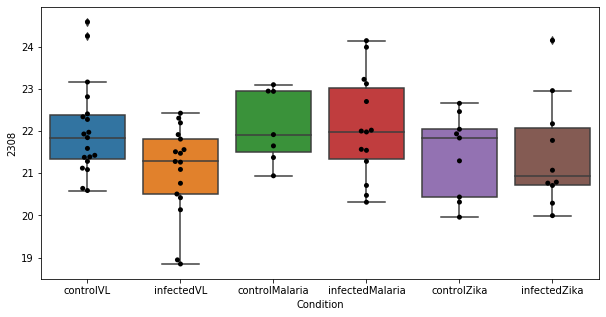

538 row m/z                                                         132.066
row retention time                                              8.34178
p-val                                                          0.925882
adj.P.Val                                                      0.999793
custom_id                                                           458
compound_names        1-Pyrroline-2-carboxylate; 1-Pyrroline-2-carbo...
Name: 458, dtype: object


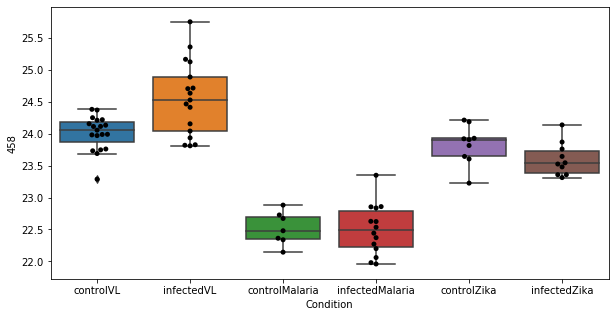

539 row m/z                163.133
row retention time     3.79947
p-val                 0.926674
adj.P.Val             0.999793
custom_id                  938
compound_names             NaN
Name: 938, dtype: object


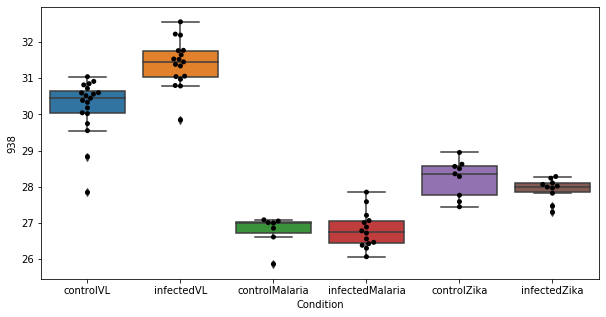

540 row m/z                164.029
row retention time        11.6
p-val                 0.928701
adj.P.Val             0.999793
custom_id                  945
compound_names             NaN
Name: 945, dtype: object


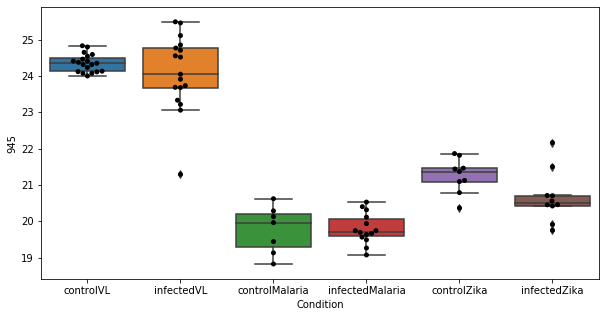

541 row m/z                275.103
row retention time     11.8913
p-val                 0.929171
adj.P.Val             0.999793
custom_id                 2205
compound_names             NaN
Name: 2205, dtype: object


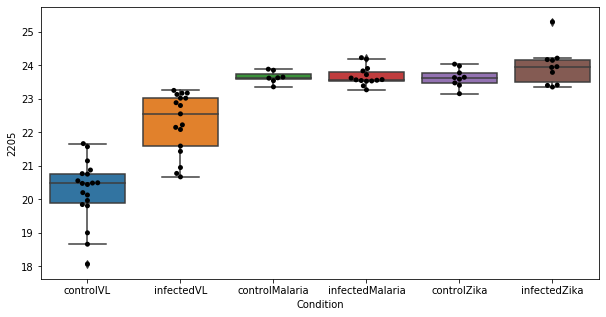

542 row m/z                                                         144.102
row retention time                                              6.70776
p-val                                                          0.929258
adj.P.Val                                                      0.999793
custom_id                                                           634
compound_names        6-Acetamido-2-oxohexanoate; 2-Oxo-6-acetamidoc...
Name: 634, dtype: object


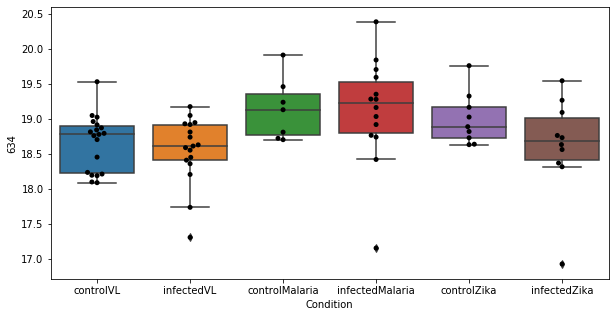

543 row m/z                                                         126.022
row retention time                                              12.2095
p-val                                                          0.929996
adj.P.Val                                                      0.999793
custom_id                                                           371
compound_names        Taurine; 2-Aminoethanesulfonic acid; Aminoethy...
Name: 371, dtype: object


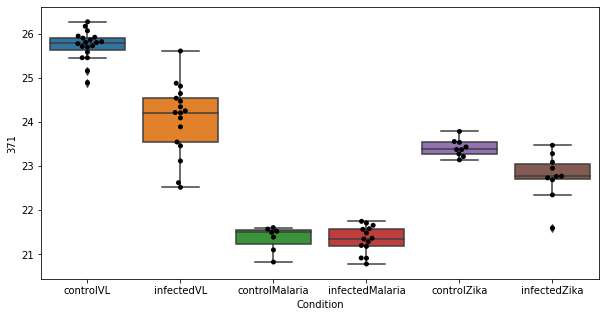

544 row m/z                                      76.0393
row retention time                           12.3886
p-val                                       0.932687
adj.P.Val                                   0.999793
custom_id                                         17
compound_names        Glycine; Aminoacetic acid; Gly
Name: 17, dtype: object


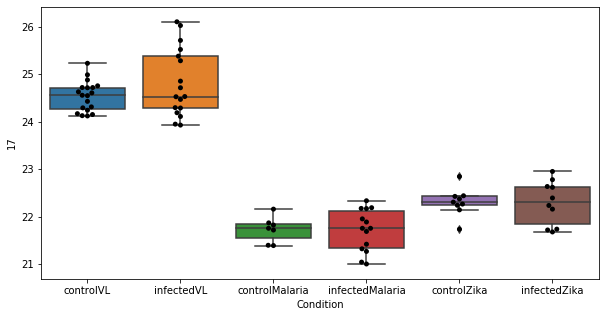

545 row m/z                160.133
row retention time     10.6993
p-val                 0.933814
adj.P.Val             0.999793
custom_id                  903
compound_names             NaN
Name: 903, dtype: object


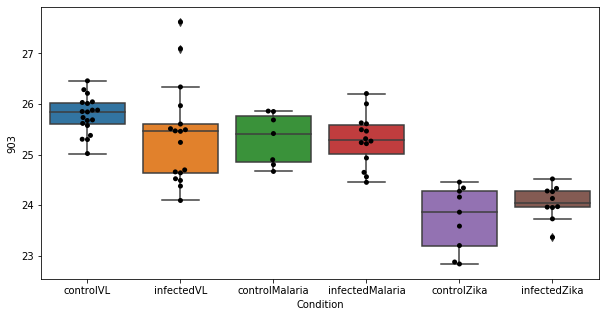

546 row m/z                117.068
row retention time     10.5804
p-val                 0.934244
adj.P.Val             0.999793
custom_id                  263
compound_names             NaN
Name: 263, dtype: object


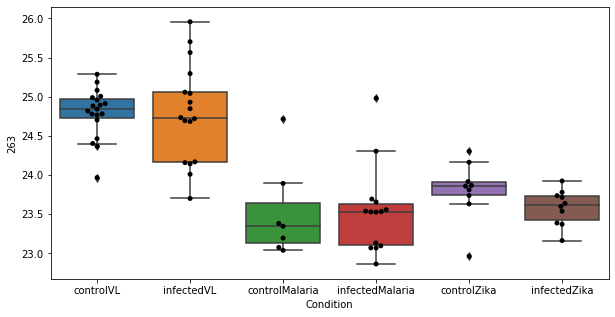

547 row m/z                785.588
row retention time     3.20243
p-val                 0.934572
adj.P.Val             0.999793
custom_id                 3013
compound_names             NaN
Name: 3013, dtype: object


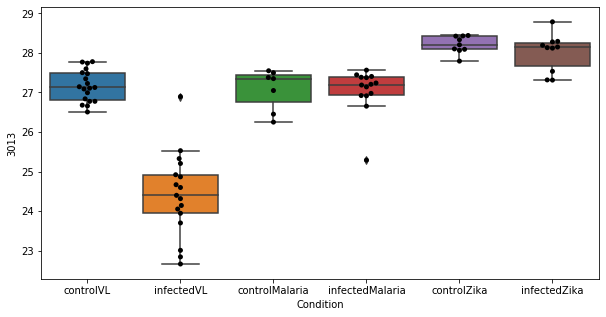

548 row m/z                188.128
row retention time     6.71156
p-val                 0.935817
adj.P.Val             0.999793
custom_id                 1269
compound_names             NaN
Name: 1269, dtype: object


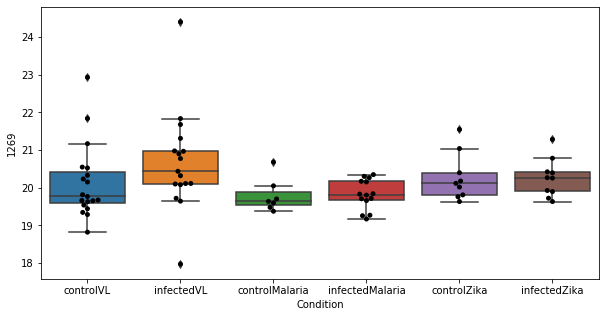

549 row m/z                                                         209.092
row retention time                                              9.32332
p-val                                                           0.93632
adj.P.Val                                                      0.999793
custom_id                                                          1521
compound_names        L-Kynurenine; 3-Anthraniloyl-L-alanine$Formyl-...
Name: 1521, dtype: object


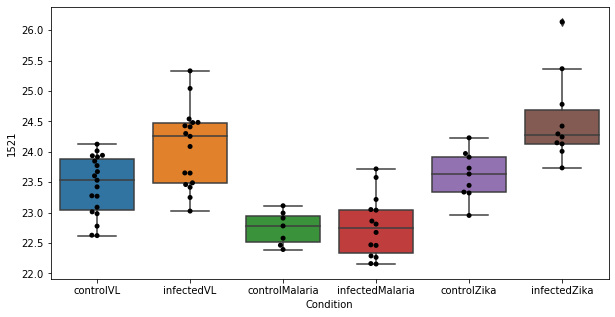

550 row m/z                701.559
row retention time     3.42053
p-val                 0.936575
adj.P.Val             0.999793
custom_id                 2916
compound_names             NaN
Name: 2916, dtype: object


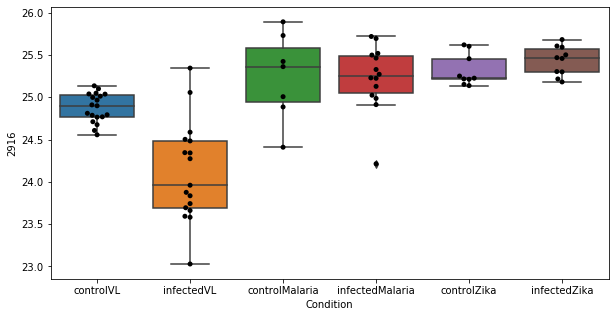

551 row m/z                158.154
row retention time     3.61479
p-val                 0.937181
adj.P.Val             0.999793
custom_id                  868
compound_names             NaN
Name: 868, dtype: object


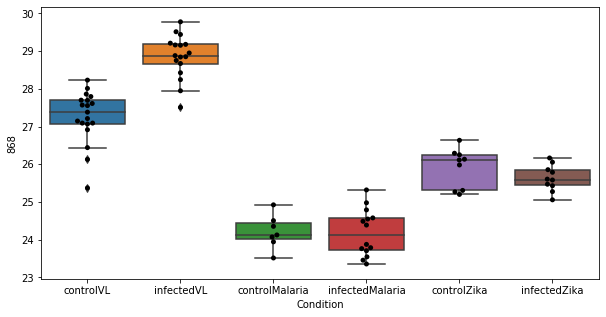

552 row m/z                                                         166.086
row retention time                                              6.71471
p-val                                                          0.938878
adj.P.Val                                                      0.999793
custom_id                                                           984
compound_names        L-Phenylalanine; (S)-alpha-Amino-beta-phenylpr...
Name: 984, dtype: object


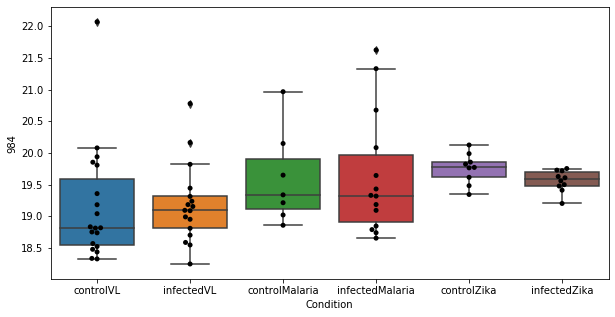

553 row m/z                207.113
row retention time     8.85047
p-val                 0.939069
adj.P.Val             0.999793
custom_id                 1508
compound_names             NaN
Name: 1508, dtype: object


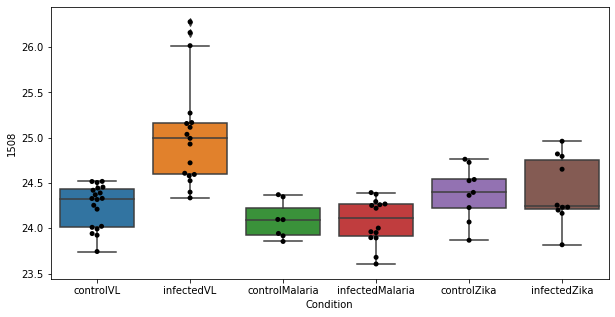

554 row m/z                 217.18
row retention time     3.49689
p-val                 0.939111
adj.P.Val             0.999793
custom_id                 1653
compound_names             NaN
Name: 1653, dtype: object


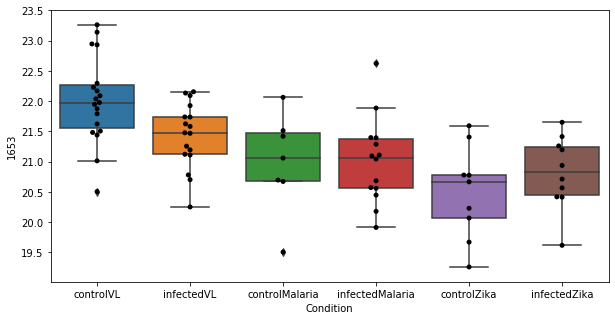

555 row m/z                212.149
row retention time     4.40798
p-val                 0.939479
adj.P.Val             0.999793
custom_id                 1575
compound_names             NaN
Name: 1575, dtype: object


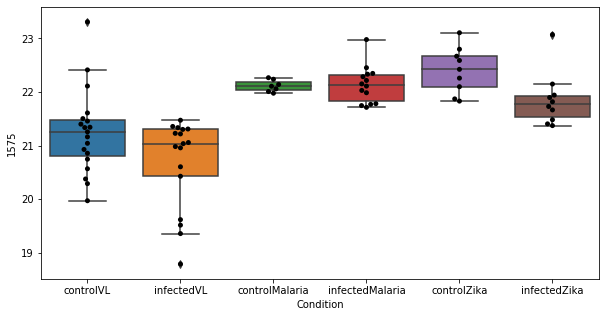

556 row m/z                                                         91.0583
row retention time                                               11.794
p-val                                                          0.939794
adj.P.Val                                                      0.999793
custom_id                                                            88
compound_names        Sarcosine; N-Methylglycine$D-Alanine; D-2-Amin...
Name: 88, dtype: object


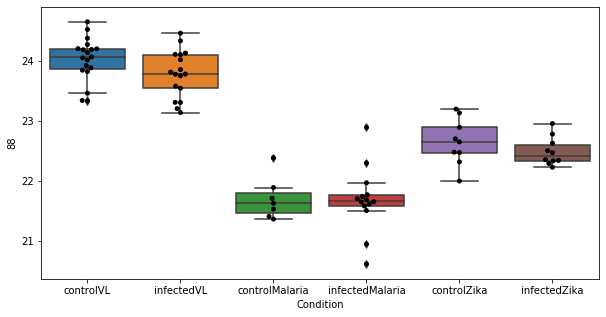

557 row m/z                225.149
row retention time     3.59688
p-val                 0.941103
adj.P.Val             0.999793
custom_id                 1734
compound_names             NaN
Name: 1734, dtype: object


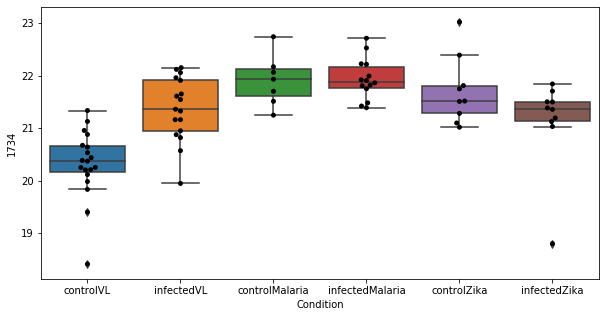

558 row m/z                262.144
row retention time     6.68582
p-val                 0.943313
adj.P.Val             0.999793
custom_id                 2117
compound_names             NaN
Name: 2117, dtype: object


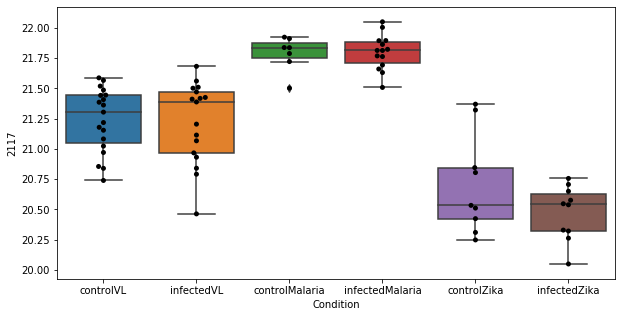

559 row m/z                                                         187.097
row retention time                                              6.70945
p-val                                                          0.945186
adj.P.Val                                                      0.999793
custom_id                                                          1252
compound_names        N-Trimethyl-2-aminoethylphosphonate; 2-Trimeth...
Name: 1252, dtype: object


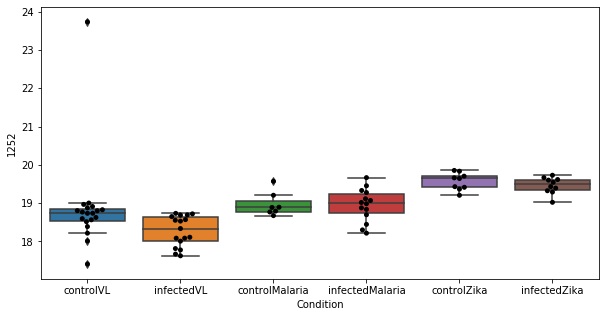

560 row m/z                                              213
row retention time                               10.8052
p-val                                           0.945347
adj.P.Val                                       0.999793
custom_id                                           1583
compound_names        Oxalosuccinate; Oxalosuccinic acid
Name: 1583, dtype: object


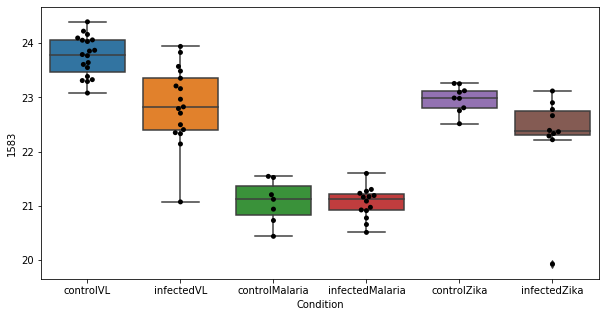

561 row m/z                129.127
row retention time     3.49848
p-val                 0.946198
adj.P.Val             0.999793
custom_id                  401
compound_names             NaN
Name: 401, dtype: object


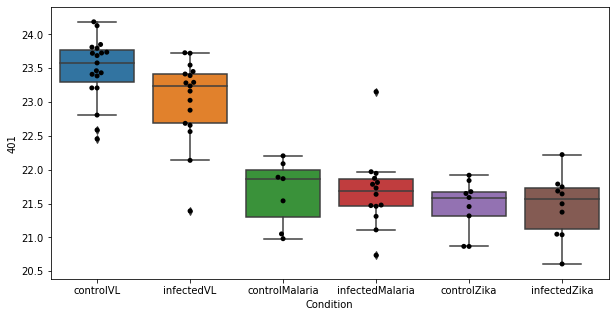

562 row m/z                                                157.097
row retention time                                     10.5789
p-val                                                  0.94756
adj.P.Val                                             0.999793
custom_id                                                  848
compound_names        N-Acetylornithine; N2-Acetyl-L-ornithine
Name: 848, dtype: object


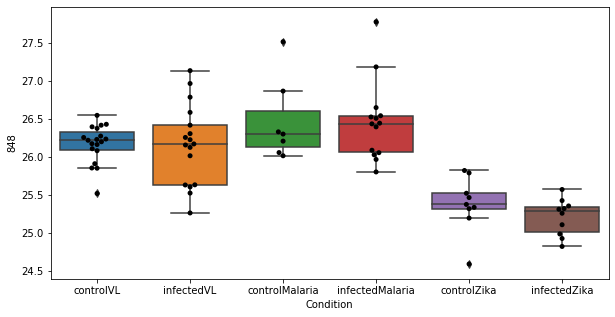

563 row m/z                                                         171.096
row retention time                                              10.5261
p-val                                                          0.948921
adj.P.Val                                                      0.999793
custom_id                                                          1048
compound_names        N(pi)-Methyl-L-histidine; 1-Methylhistidine; N...
Name: 1048, dtype: object


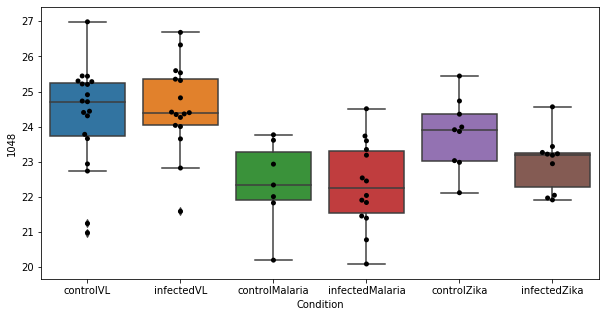

564 row m/z                145.105
row retention time      9.1985
p-val                  0.95241
adj.P.Val             0.999793
custom_id                  650
compound_names             NaN
Name: 650, dtype: object


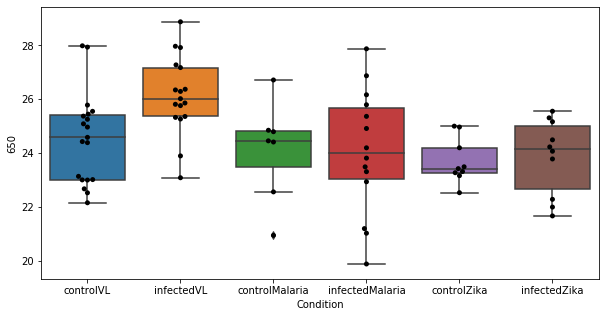

565 row m/z                                                         198.085
row retention time                                              12.4151
p-val                                                          0.952694
adj.P.Val                                                      0.999793
custom_id                                                          1393
compound_names        L-Citrulline; 2-Amino-5-ureidovaleric acid; Ci...
Name: 1393, dtype: object


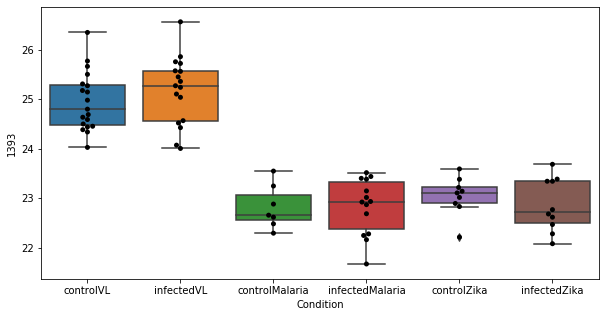

566 row m/z                763.595
row retention time     3.20319
p-val                 0.953824
adj.P.Val             0.999793
custom_id                 2979
compound_names             NaN
Name: 2979, dtype: object


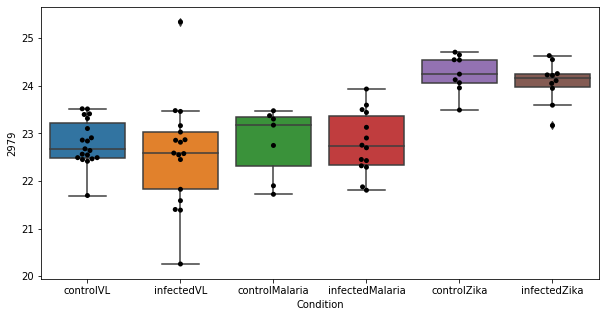

567 row m/z                                                   174.087
row retention time                                         11.518
p-val                                                    0.954064
adj.P.Val                                                0.999793
custom_id                                                    1087
compound_names        N-Methyltyramine$N-Methylphenylethanolamine
Name: 1087, dtype: object


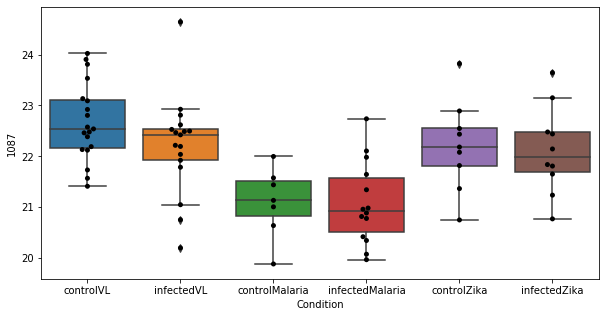

568 row m/z                165.112
row retention time     4.26748
p-val                 0.959929
adj.P.Val             0.999793
custom_id                  963
compound_names             NaN
Name: 963, dtype: object


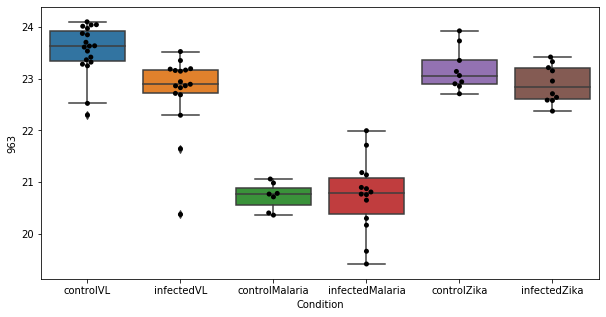

569 row m/z                                                   273.186
row retention time                                        3.45163
p-val                                                    0.960163
adj.P.Val                                                0.999793
custom_id                                                    2187
compound_names        Estradiol-17beta; beta-Estradiol; Estradiol
Name: 2187, dtype: object


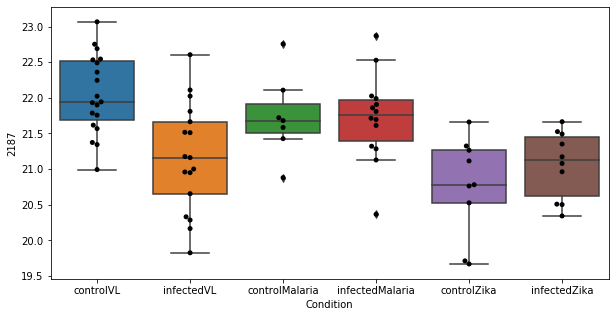

570 row m/z                                                         149.081
row retention time                                              11.9079
p-val                                                          0.961923
adj.P.Val                                                      0.999793
custom_id                                                           731
compound_names        (R)-Mevalonate; Mevalonic acid; 3,5-Dihydroxy-...
Name: 731, dtype: object


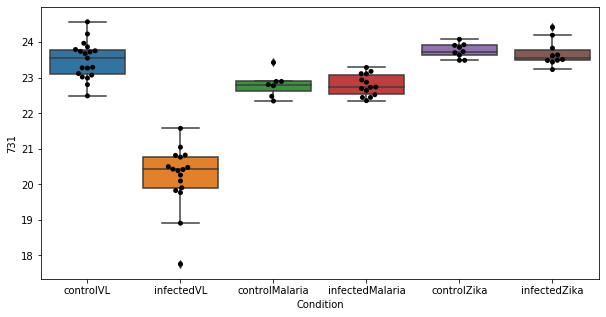

571 row m/z                236.073
row retention time     10.8693
p-val                 0.962319
adj.P.Val             0.999793
custom_id                 5002
compound_names             NaN
Name: 5002, dtype: object


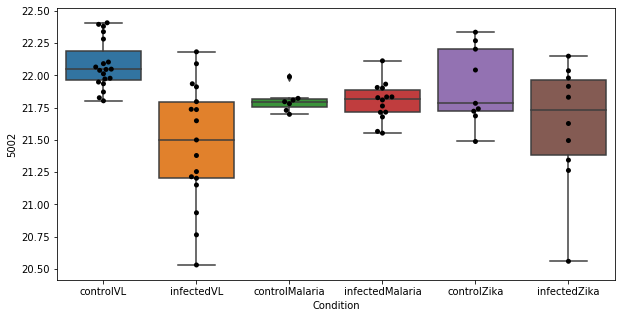

572 row m/z                                                         256.165
row retention time                                              6.70207
p-val                                                          0.963237
adj.P.Val                                                      0.999793
custom_id                                                          2053
compound_names        3-oxo-6(R)-hydroxy-tetradec-8-cis-enoate$3-oxo...
Name: 2053, dtype: object


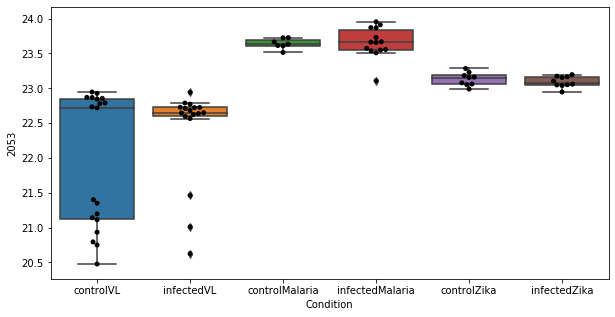

573 row m/z                           218.138
row retention time                 4.2172
p-val                             0.96384
adj.P.Val                        0.999793
custom_id                            1662
compound_names        propionyl-carnitine
Name: 1662, dtype: object


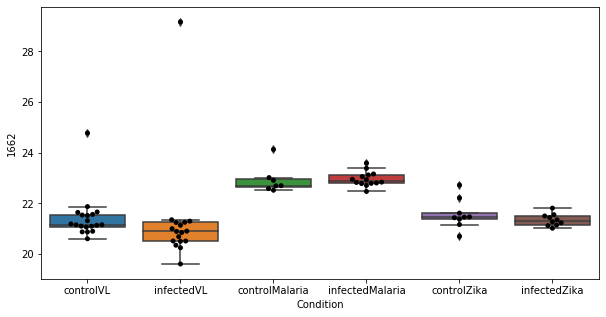

574 row m/z                                                          148.08
row retention time                                              11.9036
p-val                                                          0.967016
adj.P.Val                                                      0.999793
custom_id                                                           713
compound_names        D-Glutamine; D-2-Aminoglutaramic acid$L-Glutam...
Name: 713, dtype: object


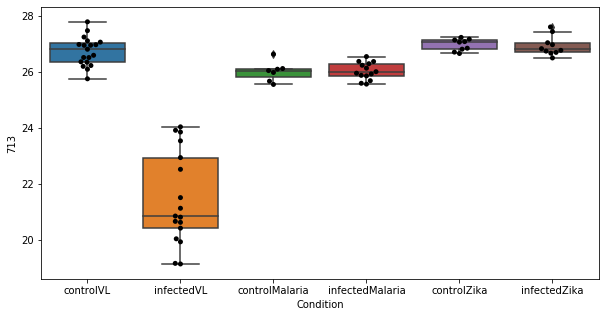

575 row m/z                                                         132.102
row retention time                                              6.70334
p-val                                                          0.967488
adj.P.Val                                                      0.999793
custom_id                                                           463
compound_names        L-Isoleucine; 2-Amino-3-methylvaleric acid$L-L...
Name: 463, dtype: object


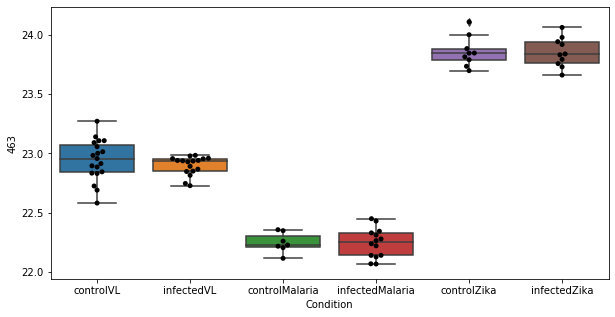

576 row m/z                204.123
row retention time     9.29506
p-val                 0.967848
adj.P.Val             0.999793
custom_id                 1480
compound_names             NaN
Name: 1480, dtype: object


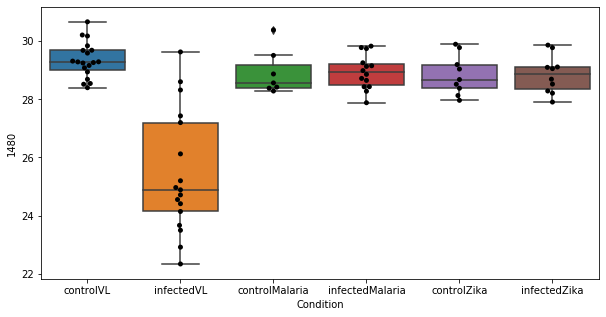

577 row m/z                246.243
row retention time     6.66364
p-val                 0.970096
adj.P.Val             0.999793
custom_id                 1969
compound_names             NaN
Name: 1969, dtype: object


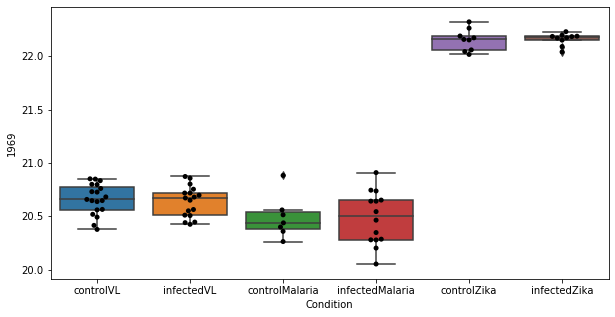

578 row m/z                                                          127.05
row retention time                                              10.0612
p-val                                                          0.970497
adj.P.Val                                                      0.999793
custom_id                                                           372
compound_names        Thymine; 5-Methyluracil$Imidazole-4-acetate; I...
Name: 372, dtype: object


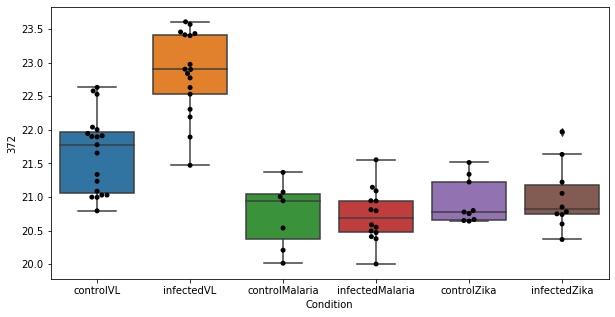

579 row m/z                219.019
row retention time     10.5758
p-val                 0.971113
adj.P.Val             0.999793
custom_id                 1680
compound_names             NaN
Name: 1680, dtype: object


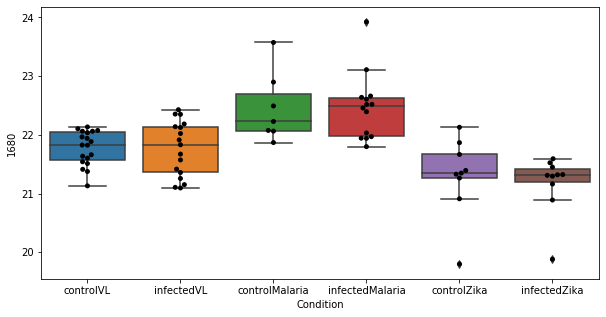

580 row m/z                                                          130.05
row retention time                                              11.8903
p-val                                                          0.971117
adj.P.Val                                                      0.999793
custom_id                                                           410
compound_names        D-Glutamine; D-2-Aminoglutaramic acid$L-Glutam...
Name: 410, dtype: object


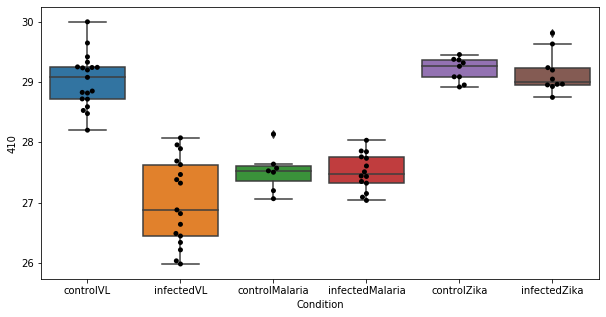

581 row m/z                230.158
row retention time      10.551
p-val                 0.971943
adj.P.Val             0.999793
custom_id                 3874
compound_names             NaN
Name: 3874, dtype: object


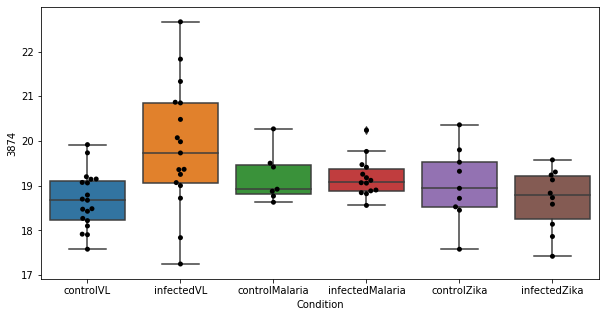

582 row m/z                769.593
row retention time      3.1881
p-val                 0.972295
adj.P.Val             0.999793
custom_id                 2989
compound_names             NaN
Name: 2989, dtype: object


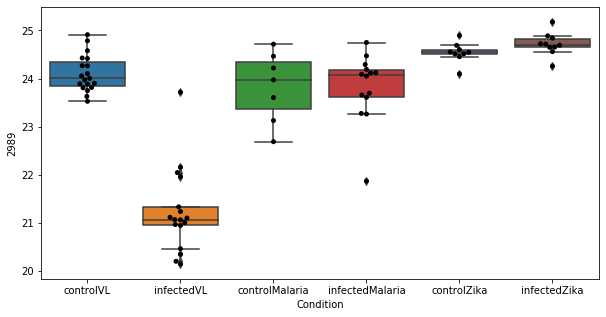

583 row m/z                254.026
row retention time     10.7961
p-val                  0.97278
adj.P.Val             0.999793
custom_id                 2044
compound_names             NaN
Name: 2044, dtype: object


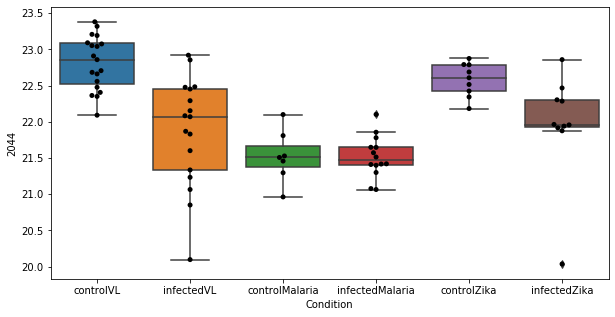

584 row m/z                                                         147.076
row retention time                                              11.9052
p-val                                                          0.974901
adj.P.Val                                                      0.999793
custom_id                                                           689
compound_names        D-Glutamine; D-2-Aminoglutaramic acid$L-Glutam...
Name: 689, dtype: object


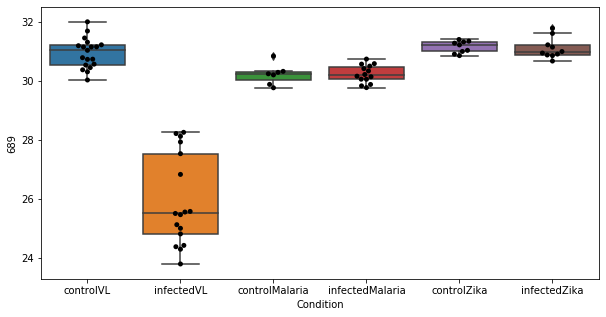

585 row m/z                144.102
row retention time     9.19626
p-val                 0.975215
adj.P.Val             0.999793
custom_id                  631
compound_names             NaN
Name: 631, dtype: object


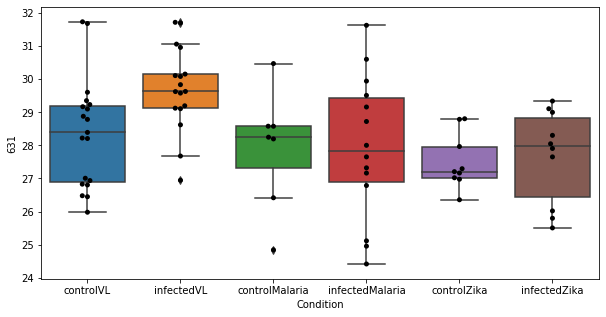

586 row m/z                 264.18
row retention time      3.4916
p-val                 0.976238
adj.P.Val             0.999793
custom_id                 2136
compound_names             NaN
Name: 2136, dtype: object


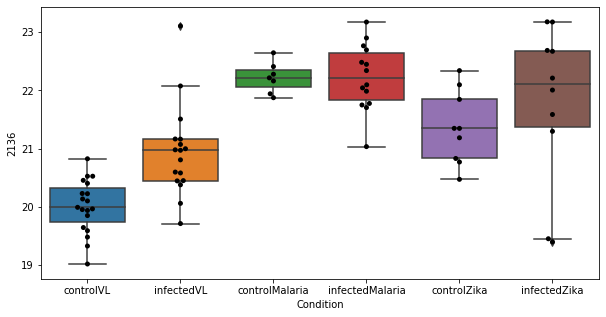

587 row m/z                744.589
row retention time     3.20892
p-val                 0.978092
adj.P.Val             0.999793
custom_id                 2955
compound_names             NaN
Name: 2955, dtype: object


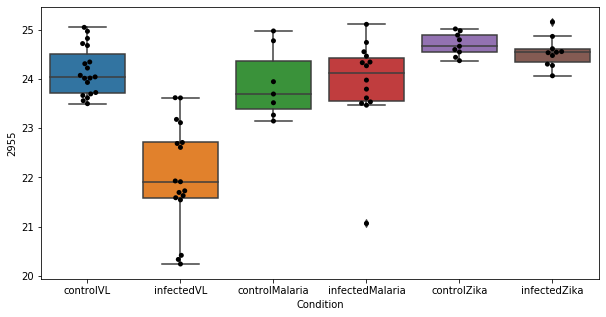

588 row m/z                213.022
row retention time     11.9045
p-val                 0.978099
adj.P.Val             0.999793
custom_id                 1584
compound_names             NaN
Name: 1584, dtype: object


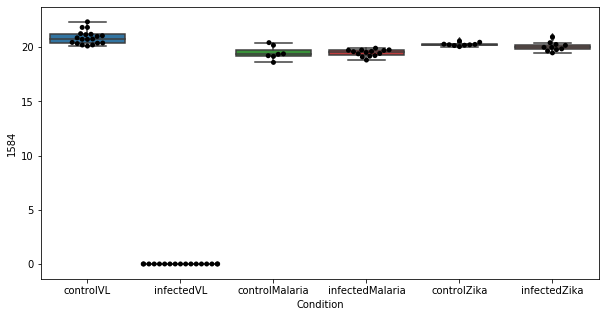

589 row m/z                209.154
row retention time     3.60987
p-val                 0.979855
adj.P.Val             0.999793
custom_id                 1531
compound_names             NaN
Name: 1531, dtype: object


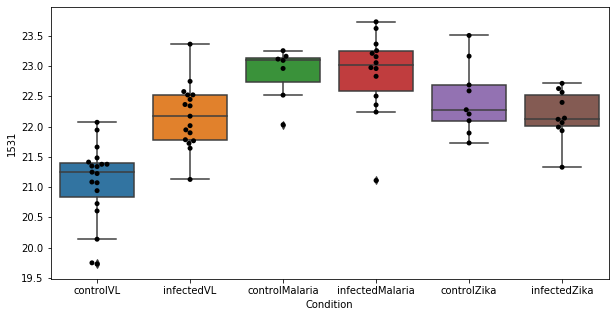

590 row m/z                767.577
row retention time     3.19097
p-val                 0.983457
adj.P.Val             0.999793
custom_id                 2985
compound_names             NaN
Name: 2985, dtype: object


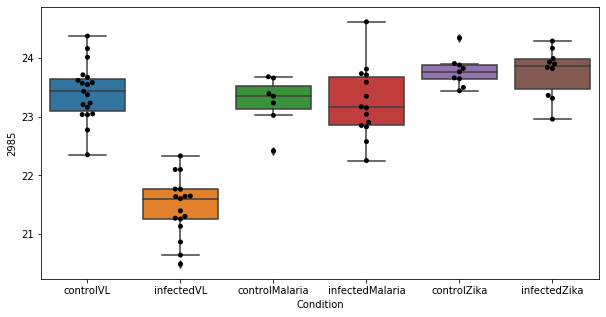

591 row m/z                                                         148.073
row retention time                                              11.9154
p-val                                                          0.985053
adj.P.Val                                                      0.999793
custom_id                                                           712
compound_names        (R)-Mevalonate; Mevalonic acid; 3,5-Dihydroxy-...
Name: 712, dtype: object


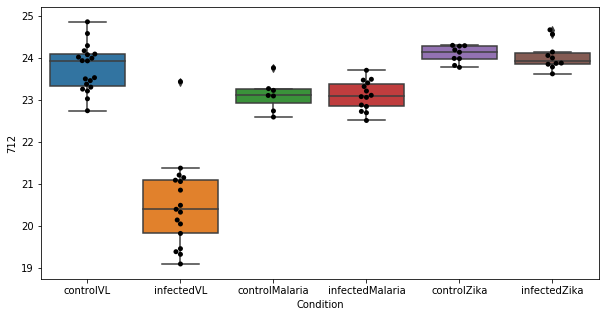

592 row m/z                                                          235.08
row retention time                                              11.8551
p-val                                                          0.986255
adj.P.Val                                                      0.999793
custom_id                                                          1854
compound_names        Nebularine; Purine riboside; N-D-Ribosylpurine...
Name: 1854, dtype: object


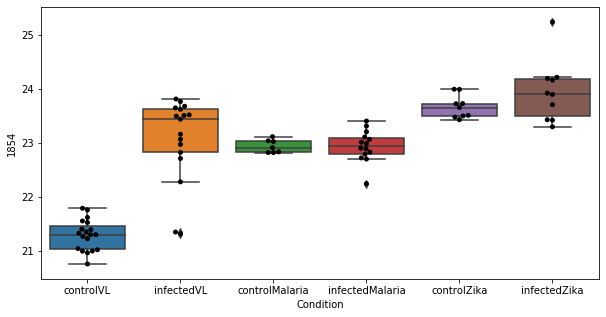

593 row m/z                 344.28
row retention time     4.10462
p-val                 0.986814
adj.P.Val             0.999793
custom_id                 2550
compound_names             NaN
Name: 2550, dtype: object


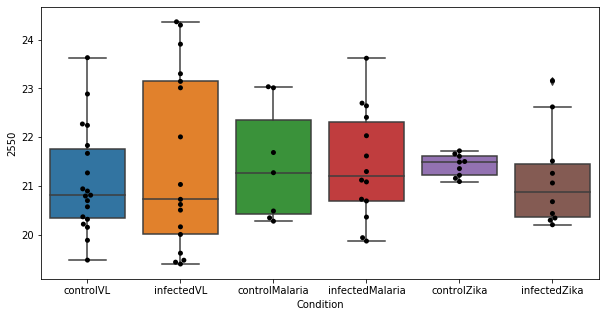

594 row m/z                235.119
row retention time      6.7165
p-val                 0.987362
adj.P.Val             0.999793
custom_id                 1858
compound_names             NaN
Name: 1858, dtype: object


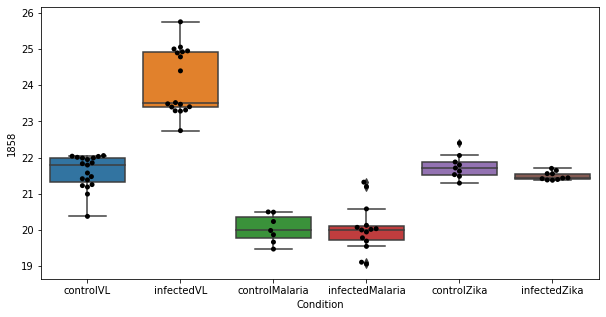

595 row m/z                118.077
row retention time      10.578
p-val                 0.988685
adj.P.Val             0.999793
custom_id                  279
compound_names             NaN
Name: 279, dtype: object


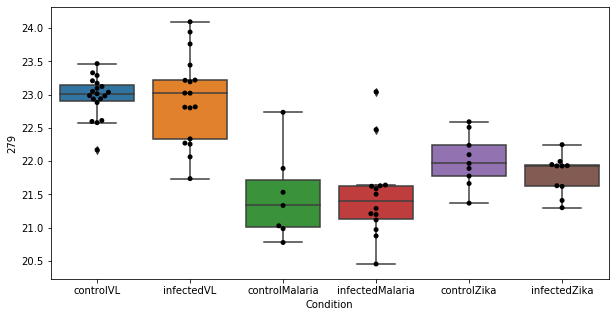

596 row m/z                                                         151.048
row retention time                                              11.8722
p-val                                                          0.988694
adj.P.Val                                                      0.999793
custom_id                                                           757
compound_names        5,6-Dihydrothymine; Dihydrothymine; 5,6-Dihydr...
Name: 757, dtype: object


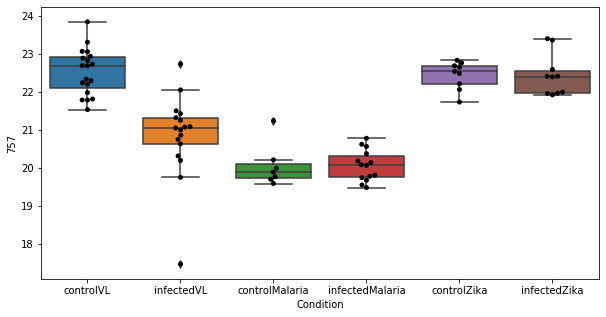

597 row m/z                304.212
row retention time     6.72258
p-val                 0.993405
adj.P.Val             0.999793
custom_id                 2396
compound_names             NaN
Name: 2396, dtype: object


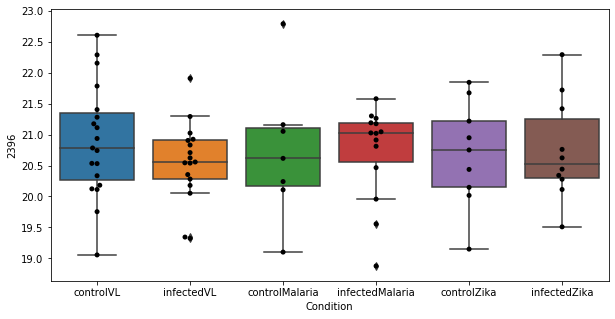

598 row m/z                205.126
row retention time      9.2928
p-val                 0.994335
adj.P.Val             0.999793
custom_id                 1503
compound_names             NaN
Name: 1503, dtype: object


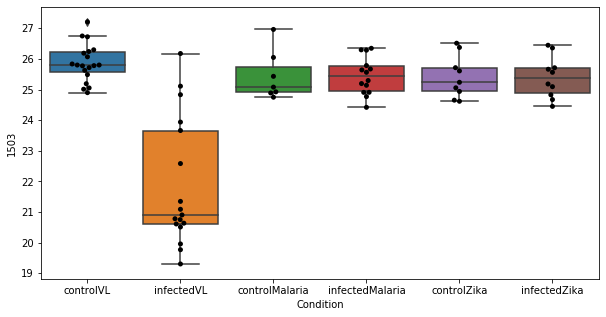

599 row m/z                114.066
row retention time     11.6879
p-val                 0.994362
adj.P.Val             0.999793
custom_id                  230
compound_names             NaN
Name: 230, dtype: object


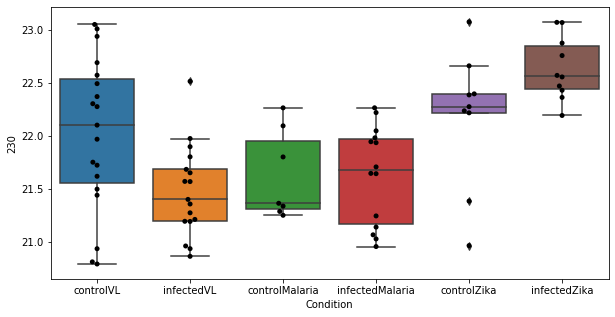

600 row m/z                248.147
row retention time     7.69265
p-val                  0.99583
adj.P.Val             0.999793
custom_id                 1984
compound_names             NaN
Name: 1984, dtype: object


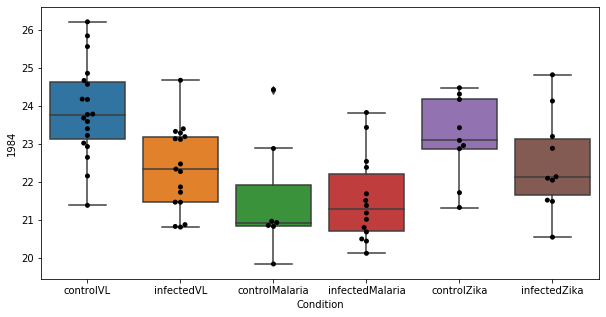

601 row m/z                                                         120.081
row retention time                                               8.8545
p-val                                                          0.996745
adj.P.Val                                                      0.999793
custom_id                                                           305
compound_names        L-Phenylalanine; (S)-alpha-Amino-beta-phenylpr...
Name: 305, dtype: object


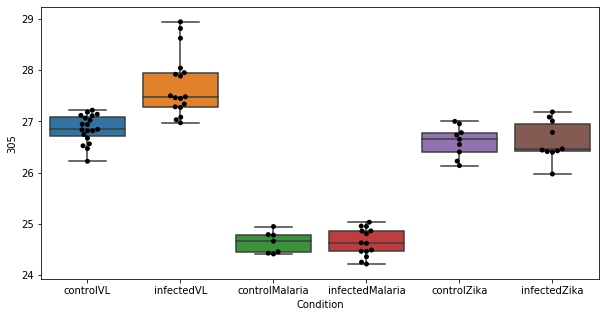

602 row m/z                                                         176.071
row retention time                                              8.29619
p-val                                                            0.9974
adj.P.Val                                                      0.999793
custom_id                                                          1118
compound_names        4-Hydroxy-5-phenyltetrahydro-1,3-oxazin-2-one$...
Name: 1118, dtype: object


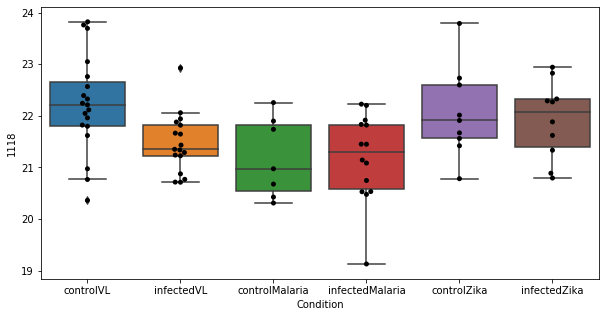

603 row m/z                801.683
row retention time     3.29424
p-val                 0.999607
adj.P.Val             0.999793
custom_id                 3056
compound_names             NaN
Name: 3056, dtype: object


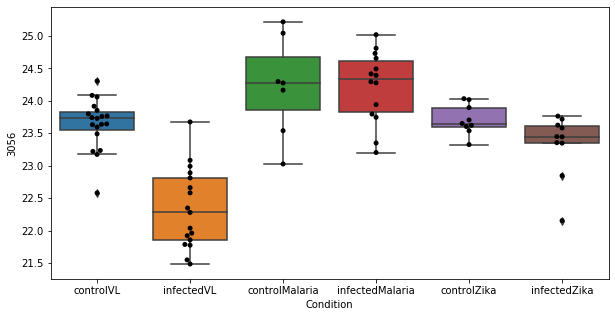

604 row m/z                286.201
row retention time     6.71285
p-val                 0.999793
adj.P.Val             0.999793
custom_id                 2295
compound_names             NaN
Name: 2295, dtype: object


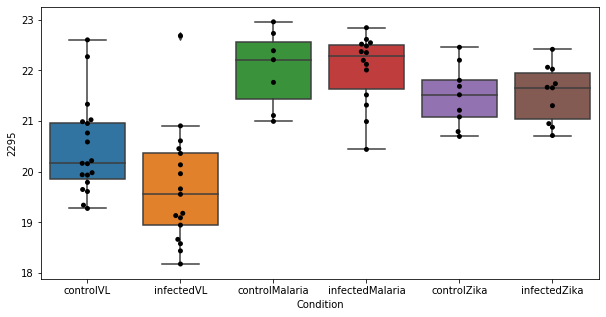

KeyError: 'Condition'

In [264]:
limma_topfeatures = all_samples_log_filled.loc[pdata.index]
limma_topfeatures = limma_topfeatures.transpose()
limma_topfeatures["Condition"] = np.array(sample_description["ConditionDataset"])
for i in range(len(list(limma_topfeatures.columns))):
    print(i,data.loc[list(limma_topfeatures.columns)[i]])
    plt.figure(figsize=(10,5))
    ax = sns.boxplot(y=list(limma_topfeatures.columns)[i], x="Condition", data = limma_topfeatures, order = ['controlVL','infectedVL','controlMalaria', 'infectedMalaria', 'controlZika','infectedZika'] )
    ax = sns.swarmplot(y=list(limma_topfeatures.columns)[i], x="Condition", data = limma_topfeatures, order = ['controlVL','infectedVL','controlMalaria', 'infectedMalaria', 'controlZika','infectedZika'], color="black")
    plt.show()

In [50]:
data.loc[1521]

row m/z                                                         209.092
row retention time                                              9.32332
p-val                                                           0.93632
adj.P.Val                                                      0.999793
custom_id                                                          1521
compound_names        L-Kynurenine; 3-Anthraniloyl-L-alanine$Formyl-...
Name: 1521, dtype: object

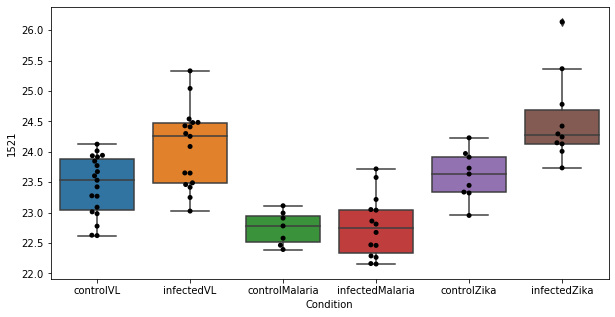

In [49]:
plot_boxplots(limma_topfeatures,1521, (20,24), False)